In [35]:
import itertools
import numpy as np
import torch
import torch.utils.data
from torch import nn
from torch.nn import functional as F
from torch.autograd import Variable
import matplotlib.pyplot as plt

In [132]:
"""Overall initialization"""

seed = 41

# Data types
dtype = torch.FloatTensor
np_dtype = np.float32

# Model parameters
hypersphere_n = 10
latent_size = 5
sigma_x = 0.05

# Training parameters
batch_size = 128
gen_learning_rate = 1e-4
dis_learning_rate = 0.5 * gen_learning_rate

# Data parameters
num_samples = 100000
sigma = 0.05

# Hidden layer units in generator and discriminator (each entry is one layer)
gen_hidden_units_list = [16, 16, 16]
dis_hidden_units_list = [16, 16, 16]

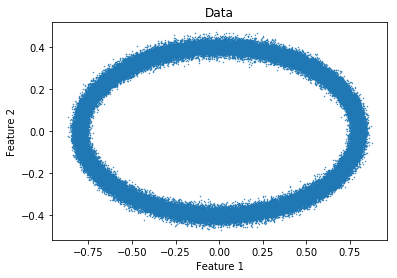

In [142]:
"""Datasets"""

torch.manual_seed(seed)
rng = np.random.RandomState(seed)
rng2 = np.random.RandomState(seed + 1)


def sample_latent_space(n):
    return rng2.randn(n, latent_size)


def sample_latent_space_torch(n):
    return torch.randn(n, latent_size, dtype=torch.float32)


# # Generate random data (Line)
# u = rng.rand(num_samples)[..., np.newaxis]
# eps1 = sigma * rng.randn(num_samples)[..., np.newaxis]
# eps2 = sigma * rng.randn(num_samples)[..., np.newaxis]
# data = 0.4 * (np.hstack([2 * u + eps1 + 0.2, u + eps2 + 0.5]))
# assert data.shape[0] == num_samples
# num_features = data.shape[1]

# Generate random data (Circle)
u = 2 * np.pi * rng.rand(num_samples)[..., np.newaxis]
eps1 = sigma * rng.randn(num_samples)[..., np.newaxis]
eps2 = sigma * rng.randn(num_samples)[..., np.newaxis]
data = 0.4 * np.hstack([2 * np.cos(u) + eps1, np.sin(u) + eps2])
assert data.shape[0] == num_samples
num_features = data.shape[1]

# Generate random data (Hypersphere)
# rng = np.random.RandomState(seed)
# u = rng.randn(num_samples, hypersphere_n)
# u /= np.sqrt(np.sum(u**2, axis=1))[:, np.newaxis]
# eps = sigma * rng.randn(num_samples, hypersphere_n)
# data = 0.8 * u + eps
# assert data.shape[0] == num_samples
# num_features = data.shape[1]

# # Generate random data (3 gaussians)
# torch.manual_seed(seed)
# rng = np.random.RandomState(seed)
# x1 = rng.multivariate_normal([1, 1], np.diag([0.1, 0.4]), size=num_samples // 2)
# x2 = rng.multivariate_normal([-1, -1], np.diag([0.1, 0.1]), size=num_samples // 4)
# x3 = rng.multivariate_normal([-1, 1], [[0.1, -0.3], [-0.3, 0.6]], size=num_samples // 4)
# data = 1 / 4 * np.vstack([x1, x2, x3])
# assert data.shape[0] == num_samples
# num_features = data.shape[1]

# Plot data
plt.clf()
plt.scatter(data[:, 0], data[:, 1], s=0.2)
plt.title("Data")
plt.xlabel("Feature 1")
plt.ylabel("Feature 2")
plt.show()

# Create a torch dataset (use zeros as dummy labels)
dataset = torch.utils.data.TensorDataset(torch.from_numpy(data).float(), torch.zeros(num_samples))
kwargs = {}
train_loader = torch.utils.data.DataLoader(
    dataset,
    batch_size=batch_size, shuffle=True, **kwargs)

In [143]:
"""Network models for generator and discriminator"""

class Generator(nn.Module):

    def __init__(self, latent_size, output_size, hidden_units_list):
        super(Generator, self).__init__()

        self.latent_size = latent_size

        # Generator layers
        layers = []
        prev_layer_size = latent_size
        for i, num_hidden_units in enumerate(hidden_units_list):
            layers.append(nn.Linear(prev_layer_size, num_hidden_units))
            if i > 0:
                layers.append(nn.BatchNorm1d(num_hidden_units))
            layers.append(nn.ReLU())
            prev_layer_size = num_hidden_units
        self.gen_fc_list = nn.Sequential(*layers)

        self.output_layer = nn.Linear(prev_layer_size, output_size)

    def forward(self, z):
        x = self.gen_fc_list(z)
        x = F.tanh(self.output_layer(x))
        return x


class Discriminator(nn.Module):

    def __init__(self, input_size, hidden_units_list):
        super(Discriminator, self).__init__()

        self.input_size = input_size

        # Discriminator layers
        layers = []
        prev_layer_size = input_size
        for i, num_hidden_units in enumerate(hidden_units_list):
            layers.append(nn.Linear(prev_layer_size, num_hidden_units))
            if i > 0:
                layers.append(nn.BatchNorm1d(num_hidden_units))
            layers.append(nn.LeakyReLU())
            prev_layer_size = num_hidden_units
        self.dis_fc_list = nn.Sequential(*layers)

        self.output_layer = nn.Linear(prev_layer_size, 1)

    def forward(self, x):
        y = self.dis_fc_list(x)
        y = F.sigmoid(self.output_layer(y))
        return y


class GAN(nn.Module):

    def __init__(self, generator, discriminator):
        super(GAN, self).__init__()

        self.generator = generator
        self.discriminator = discriminator

    def loss_real(self, z, x):
        y = self.discriminator(x)
        return torch.sum(torch.log(y)) + self.loss_fake(z)

    def loss_fake(self, z):
        x = self.generator(z)
        y = self.discriminator(x)
        return torch.sum(torch.log(1 - y))
    
gen = Generator(latent_size, num_features, gen_hidden_units_list)
dis = Discriminator(num_features, dis_hidden_units_list)
model = GAN(gen, dis)

In [157]:
"""Training"""

# Optimizer
optimizer_gen = torch.optim.Adam(gen.parameters(), lr=gen_learning_rate)
optimizer_dis = torch.optim.Adam(dis.parameters(), lr=dis_learning_rate)

model.train()

discriminator_train_steps = 2

num_epochs = 100000
for epoch in range(num_epochs):
    data_iter = iter(train_loader)
    train_loss_fake = 0
    train_loss_real = 0

    i = 0

    try:
        for k in range(discriminator_train_steps):
            x, _ = next(data_iter)
            z = sample_latent_space(x.size(0))
            z = torch.from_numpy(z).float()
            y_real = model.discriminator(x)
            y_fake = model.discriminator(model.generator(z))
            print("Discrimantor on real samples: {:.4f}, on fake samples: {:.4f}".format(
                torch.mean(y_real), torch.mean(y_fake)))
            optimizer_dis.zero_grad()
            loss = -model.loss_real(z, x)
            loss.backward()
            optimizer_dis.step()
            train_loss_fake += loss.data.item() / discriminator_train_steps

        z = sample_latent_space(batch_size)
        z = torch.from_numpy(z).float()
        optimizer_gen.zero_grad()
        loss = model.loss_fake(z)
        loss.backward()
        optimizer_gen.step()
        train_loss_real += loss.data.item()

        i += 1

#         x = Variable(x.type(dtype))

        if i % 100000 == 0:
            print("epoch={}, i={}".format(epoch, i))
            print("  loss_real: {:.4f}, loss_fake: {:.4f}".format(
                train_loss_real / (i + 1), train_loss_fake / (i + 1)))

    except StopIteration:
        pass

    print('====> Train set loss_real: {:.4f}, loss_fake: {:.4f}'.format(
        train_loss_real / (i + 1), train_loss_fake / (i + 1)))

Discrimantor on real samples: 0.5751, on fake samples: 0.4901
Discrimantor on real samples: 0.5881, on fake samples: 0.4782
====> Train set loss_real: -45.4693, loss_fake: 78.2906
Discrimantor on real samples: 0.5901, on fake samples: 0.4935
Discrimantor on real samples: 0.6031, on fake samples: 0.5439
====> Train set loss_real: -48.9332, loss_fake: 82.3385
Discrimantor on real samples: 0.5887, on fake samples: 0.5592
Discrimantor on real samples: 0.5581, on fake samples: 0.5444
====> Train set loss_real: -49.0215, loss_fake: 88.7969
Discrimantor on real samples: 0.4997, on fake samples: 0.4974
Discrimantor on real samples: 0.5029, on fake samples: 0.4916
====> Train set loss_real: -42.4070, loss_fake: 88.2404
Discrimantor on real samples: 0.5116, on fake samples: 0.4956
Discrimantor on real samples: 0.5292, on fake samples: 0.5149
====> Train set loss_real: -46.5391, loss_fake: 87.3118
Discrimantor on real samples: 0.5347, on fake samples: 0.4953
Discrimantor on real samples: 0.5043, 

Discrimantor on real samples: 0.5004, on fake samples: 0.4784
Discrimantor on real samples: 0.5196, on fake samples: 0.5037
====> Train set loss_real: -50.3615, loss_fake: 86.7658
Discrimantor on real samples: 0.4804, on fake samples: 0.4888
Discrimantor on real samples: 0.4803, on fake samples: 0.4766
====> Train set loss_real: -43.1391, loss_fake: 89.4544
Discrimantor on real samples: 0.4858, on fake samples: 0.4982
Discrimantor on real samples: 0.4873, on fake samples: 0.4948
====> Train set loss_real: -44.4906, loss_fake: 90.2671
Discrimantor on real samples: 0.4830, on fake samples: 0.5221
Discrimantor on real samples: 0.4726, on fake samples: 0.5012
====> Train set loss_real: -42.3725, loss_fake: 93.7777
Discrimantor on real samples: 0.4825, on fake samples: 0.5056
Discrimantor on real samples: 0.4843, on fake samples: 0.4928
====> Train set loss_real: -43.7097, loss_fake: 91.1545
Discrimantor on real samples: 0.5258, on fake samples: 0.4883
Discrimantor on real samples: 0.4833, 

====> Train set loss_real: -42.1959, loss_fake: 87.9235
Discrimantor on real samples: 0.4926, on fake samples: 0.4817
Discrimantor on real samples: 0.4954, on fake samples: 0.4827
====> Train set loss_real: -41.6918, loss_fake: 87.5391
Discrimantor on real samples: 0.4958, on fake samples: 0.4872
Discrimantor on real samples: 0.4998, on fake samples: 0.4865
====> Train set loss_real: -42.2031, loss_fake: 87.6991
Discrimantor on real samples: 0.4985, on fake samples: 0.4875
Discrimantor on real samples: 0.4883, on fake samples: 0.4865
====> Train set loss_real: -43.1148, loss_fake: 88.2018
Discrimantor on real samples: 0.4845, on fake samples: 0.4838
Discrimantor on real samples: 0.4928, on fake samples: 0.4810
====> Train set loss_real: -41.0049, loss_fake: 88.2806
Discrimantor on real samples: 0.4767, on fake samples: 0.4834
Discrimantor on real samples: 0.4739, on fake samples: 0.4894
====> Train set loss_real: -42.0192, loss_fake: 90.5548
Discrimantor on real samples: 0.5003, on fak

Discrimantor on real samples: 0.4886, on fake samples: 0.4814
====> Train set loss_real: -41.9360, loss_fake: 89.3554
Discrimantor on real samples: 0.5173, on fake samples: 0.4912
Discrimantor on real samples: 0.5207, on fake samples: 0.4921
====> Train set loss_real: -42.3269, loss_fake: 85.5707
Discrimantor on real samples: 0.4975, on fake samples: 0.4803
Discrimantor on real samples: 0.4824, on fake samples: 0.4861
====> Train set loss_real: -42.7288, loss_fake: 88.3563
Discrimantor on real samples: 0.5242, on fake samples: 0.4838
Discrimantor on real samples: 0.4917, on fake samples: 0.4690
====> Train set loss_real: -44.5295, loss_fake: 85.1360
Discrimantor on real samples: 0.5124, on fake samples: 0.4834
Discrimantor on real samples: 0.5143, on fake samples: 0.4924
====> Train set loss_real: -43.3655, loss_fake: 85.8533
Discrimantor on real samples: 0.5072, on fake samples: 0.5019
Discrimantor on real samples: 0.4920, on fake samples: 0.4946
====> Train set loss_real: -43.1425, l

====> Train set loss_real: -44.6572, loss_fake: 88.7289
Discrimantor on real samples: 0.5230, on fake samples: 0.4852
Discrimantor on real samples: 0.5199, on fake samples: 0.5056
====> Train set loss_real: -45.1917, loss_fake: 86.1501
Discrimantor on real samples: 0.5007, on fake samples: 0.4899
Discrimantor on real samples: 0.5229, on fake samples: 0.4951
====> Train set loss_real: -43.4237, loss_fake: 86.5737
Discrimantor on real samples: 0.5197, on fake samples: 0.4977
Discrimantor on real samples: 0.5156, on fake samples: 0.5145
====> Train set loss_real: -45.5263, loss_fake: 87.7925
Discrimantor on real samples: 0.5300, on fake samples: 0.4987
Discrimantor on real samples: 0.5292, on fake samples: 0.5048
====> Train set loss_real: -44.5496, loss_fake: 85.7243
Discrimantor on real samples: 0.5298, on fake samples: 0.5148
Discrimantor on real samples: 0.5068, on fake samples: 0.5042
====> Train set loss_real: -44.7501, loss_fake: 88.1059
Discrimantor on real samples: 0.5217, on fak

Discrimantor on real samples: 0.4938, on fake samples: 0.5036
====> Train set loss_real: -46.5039, loss_fake: 91.0658
Discrimantor on real samples: 0.4834, on fake samples: 0.4727
Discrimantor on real samples: 0.4852, on fake samples: 0.5050
====> Train set loss_real: -44.2006, loss_fake: 89.6639
Discrimantor on real samples: 0.5086, on fake samples: 0.4916
Discrimantor on real samples: 0.4825, on fake samples: 0.4975
====> Train set loss_real: -40.8081, loss_fake: 89.1241
Discrimantor on real samples: 0.4937, on fake samples: 0.4970
Discrimantor on real samples: 0.4953, on fake samples: 0.5025
====> Train set loss_real: -42.7510, loss_fake: 89.7723
Discrimantor on real samples: 0.4933, on fake samples: 0.4959
Discrimantor on real samples: 0.5329, on fake samples: 0.5103
====> Train set loss_real: -42.9369, loss_fake: 88.2705
Discrimantor on real samples: 0.5054, on fake samples: 0.4896
Discrimantor on real samples: 0.4939, on fake samples: 0.4789
====> Train set loss_real: -42.7029, l

====> Train set loss_real: -44.0410, loss_fake: 88.5418
Discrimantor on real samples: 0.4960, on fake samples: 0.4991
Discrimantor on real samples: 0.4986, on fake samples: 0.4934
====> Train set loss_real: -44.8090, loss_fake: 88.8313
Discrimantor on real samples: 0.4968, on fake samples: 0.4877
Discrimantor on real samples: 0.5011, on fake samples: 0.4953
====> Train set loss_real: -44.8364, loss_fake: 88.0889
Discrimantor on real samples: 0.4905, on fake samples: 0.4999
Discrimantor on real samples: 0.5031, on fake samples: 0.4993
====> Train set loss_real: -43.4157, loss_fake: 89.3033
Discrimantor on real samples: 0.4913, on fake samples: 0.4972
Discrimantor on real samples: 0.4988, on fake samples: 0.4962
====> Train set loss_real: -43.1026, loss_fake: 89.2593
Discrimantor on real samples: 0.4932, on fake samples: 0.4938
Discrimantor on real samples: 0.5048, on fake samples: 0.4908
====> Train set loss_real: -42.9028, loss_fake: 88.2009
Discrimantor on real samples: 0.4940, on fak

Discrimantor on real samples: 0.5240, on fake samples: 0.4930
Discrimantor on real samples: 0.5065, on fake samples: 0.4948
====> Train set loss_real: -43.8315, loss_fake: 86.3574
Discrimantor on real samples: 0.5008, on fake samples: 0.4936
Discrimantor on real samples: 0.4982, on fake samples: 0.4890
====> Train set loss_real: -44.9520, loss_fake: 87.9062
Discrimantor on real samples: 0.4994, on fake samples: 0.4896
Discrimantor on real samples: 0.4952, on fake samples: 0.4916
====> Train set loss_real: -43.4737, loss_fake: 88.0551
Discrimantor on real samples: 0.5038, on fake samples: 0.4909
Discrimantor on real samples: 0.5010, on fake samples: 0.4966
====> Train set loss_real: -42.5354, loss_fake: 87.9445
Discrimantor on real samples: 0.5163, on fake samples: 0.4916
Discrimantor on real samples: 0.4960, on fake samples: 0.4891
====> Train set loss_real: -43.1796, loss_fake: 87.0452
Discrimantor on real samples: 0.5194, on fake samples: 0.4876
Discrimantor on real samples: 0.5102, 

====> Train set loss_real: -47.6830, loss_fake: 91.3885
Discrimantor on real samples: 0.5225, on fake samples: 0.5226
Discrimantor on real samples: 0.5285, on fake samples: 0.5707
====> Train set loss_real: -46.1464, loss_fake: 93.3933
Discrimantor on real samples: 0.4853, on fake samples: 0.5255
Discrimantor on real samples: 0.4828, on fake samples: 0.5402
====> Train set loss_real: -42.2234, loss_fake: 96.3863
Discrimantor on real samples: 0.4767, on fake samples: 0.4952
Discrimantor on real samples: 0.5543, on fake samples: 0.4781
====> Train set loss_real: -48.3056, loss_fake: 85.8659
Discrimantor on real samples: 0.5108, on fake samples: 0.5089
Discrimantor on real samples: 0.4827, on fake samples: 0.5083
====> Train set loss_real: -41.9492, loss_fake: 90.7652
Discrimantor on real samples: 0.4969, on fake samples: 0.4764
Discrimantor on real samples: 0.5401, on fake samples: 0.4990
====> Train set loss_real: -42.8945, loss_fake: 85.4741
Discrimantor on real samples: 0.4867, on fak

Discrimantor on real samples: 0.4966, on fake samples: 0.4847
Discrimantor on real samples: 0.4983, on fake samples: 0.4888
====> Train set loss_real: -43.8197, loss_fake: 87.8073
Discrimantor on real samples: 0.4950, on fake samples: 0.4867
Discrimantor on real samples: 0.5014, on fake samples: 0.4927
====> Train set loss_real: -42.7262, loss_fake: 87.8755
Discrimantor on real samples: 0.4931, on fake samples: 0.4949
Discrimantor on real samples: 0.4923, on fake samples: 0.4937
====> Train set loss_real: -43.0295, loss_fake: 89.1753
Discrimantor on real samples: 0.4934, on fake samples: 0.4958
Discrimantor on real samples: 0.4924, on fake samples: 0.4910
====> Train set loss_real: -42.4004, loss_fake: 89.0204
Discrimantor on real samples: 0.4937, on fake samples: 0.4898
Discrimantor on real samples: 0.4982, on fake samples: 0.4829
====> Train set loss_real: -42.5642, loss_fake: 87.9163
Discrimantor on real samples: 0.4925, on fake samples: 0.4823
Discrimantor on real samples: 0.4940, 

Discrimantor on real samples: 0.5081, on fake samples: 0.5071
Discrimantor on real samples: 0.4936, on fake samples: 0.4954
====> Train set loss_real: -44.1431, loss_fake: 89.0798
Discrimantor on real samples: 0.4852, on fake samples: 0.4960
Discrimantor on real samples: 0.5219, on fake samples: 0.5174
====> Train set loss_real: -44.1348, loss_fake: 89.6859
Discrimantor on real samples: 0.5071, on fake samples: 0.5006
Discrimantor on real samples: 0.5371, on fake samples: 0.4851
====> Train set loss_real: -42.4209, loss_fake: 85.6793
Discrimantor on real samples: 0.5035, on fake samples: 0.4977
Discrimantor on real samples: 0.5237, on fake samples: 0.5197
====> Train set loss_real: -44.3972, loss_fake: 88.5806
Discrimantor on real samples: 0.5086, on fake samples: 0.5010
Discrimantor on real samples: 0.5444, on fake samples: 0.4881
====> Train set loss_real: -42.4280, loss_fake: 85.3587
Discrimantor on real samples: 0.4979, on fake samples: 0.4934
Discrimantor on real samples: 0.5209, 

Discrimantor on real samples: 0.4959, on fake samples: 0.4942
Discrimantor on real samples: 0.5390, on fake samples: 0.4994
====> Train set loss_real: -44.6668, loss_fake: 86.5752
Discrimantor on real samples: 0.5440, on fake samples: 0.5026
Discrimantor on real samples: 0.4875, on fake samples: 0.5002
====> Train set loss_real: -40.2508, loss_fake: 87.4400
Discrimantor on real samples: 0.5410, on fake samples: 0.4954
Discrimantor on real samples: 0.5137, on fake samples: 0.5033
====> Train set loss_real: -42.6998, loss_fake: 85.7055
Discrimantor on real samples: 0.4877, on fake samples: 0.4935
Discrimantor on real samples: 0.5097, on fake samples: 0.4994
====> Train set loss_real: -42.4110, loss_fake: 88.9207
Discrimantor on real samples: 0.4806, on fake samples: 0.4963
Discrimantor on real samples: 0.4982, on fake samples: 0.5107
====> Train set loss_real: -46.4667, loss_fake: 90.9380
Discrimantor on real samples: 0.5195, on fake samples: 0.4986
Discrimantor on real samples: 0.5362, 

====> Train set loss_real: -44.7539, loss_fake: 89.5332
Discrimantor on real samples: 0.4884, on fake samples: 0.4860
Discrimantor on real samples: 0.4822, on fake samples: 0.4931
====> Train set loss_real: -43.7584, loss_fake: 89.6456
Discrimantor on real samples: 0.4884, on fake samples: 0.4975
Discrimantor on real samples: 0.4897, on fake samples: 0.4988
====> Train set loss_real: -43.5804, loss_fake: 90.2126
Discrimantor on real samples: 0.4919, on fake samples: 0.4872
Discrimantor on real samples: 0.5017, on fake samples: 0.4877
====> Train set loss_real: -43.6497, loss_fake: 87.9104
Discrimantor on real samples: 0.4889, on fake samples: 0.4835
Discrimantor on real samples: 0.4843, on fake samples: 0.5006
====> Train set loss_real: -43.1846, loss_fake: 89.8310
Discrimantor on real samples: 0.4923, on fake samples: 0.4827
Discrimantor on real samples: 0.4860, on fake samples: 0.4945
====> Train set loss_real: -42.6834, loss_fake: 88.9965
Discrimantor on real samples: 0.4941, on fak

Discrimantor on real samples: 0.4948, on fake samples: 0.4879
====> Train set loss_real: -43.8286, loss_fake: 88.4356
Discrimantor on real samples: 0.4879, on fake samples: 0.4907
Discrimantor on real samples: 0.4905, on fake samples: 0.4946
====> Train set loss_real: -43.1599, loss_fake: 89.4674
Discrimantor on real samples: 0.4854, on fake samples: 0.4907
Discrimantor on real samples: 0.4897, on fake samples: 0.4848
====> Train set loss_real: -43.9601, loss_fake: 89.1263
Discrimantor on real samples: 0.4958, on fake samples: 0.4914
Discrimantor on real samples: 0.4923, on fake samples: 0.4858
====> Train set loss_real: -42.6419, loss_fake: 88.3283
Discrimantor on real samples: 0.5089, on fake samples: 0.4882
Discrimantor on real samples: 0.5124, on fake samples: 0.5020
====> Train set loss_real: -42.6823, loss_fake: 87.1355
Discrimantor on real samples: 0.4985, on fake samples: 0.4920
Discrimantor on real samples: 0.5029, on fake samples: 0.4959
====> Train set loss_real: -44.0549, l

Discrimantor on real samples: 0.5260, on fake samples: 0.5210
Discrimantor on real samples: 0.5154, on fake samples: 0.4929
====> Train set loss_real: -45.7931, loss_fake: 87.5722
Discrimantor on real samples: 0.4863, on fake samples: 0.4943
Discrimantor on real samples: 0.5791, on fake samples: 0.4743
====> Train set loss_real: -52.2392, loss_fake: 83.5288
Discrimantor on real samples: 0.5236, on fake samples: 0.4767
Discrimantor on real samples: 0.4793, on fake samples: 0.4818
====> Train set loss_real: -47.1547, loss_fake: 86.3977
Discrimantor on real samples: 0.4817, on fake samples: 0.4857
Discrimantor on real samples: 0.5022, on fake samples: 0.4896
====> Train set loss_real: -41.6605, loss_fake: 88.5235
Discrimantor on real samples: 0.4758, on fake samples: 0.5494
Discrimantor on real samples: 0.4774, on fake samples: 0.5204
====> Train set loss_real: -42.0813, loss_fake: 97.0793
Discrimantor on real samples: 0.5129, on fake samples: 0.4895
Discrimantor on real samples: 0.4901, 

Discrimantor on real samples: 0.4951, on fake samples: 0.4958
Discrimantor on real samples: 0.4992, on fake samples: 0.4875
====> Train set loss_real: -44.5133, loss_fake: 88.2539
Discrimantor on real samples: 0.4977, on fake samples: 0.4969
Discrimantor on real samples: 0.4890, on fake samples: 0.4942
====> Train set loss_real: -41.8271, loss_fake: 89.3092
Discrimantor on real samples: 0.5034, on fake samples: 0.4837
Discrimantor on real samples: 0.4923, on fake samples: 0.4941
====> Train set loss_real: -43.1206, loss_fake: 87.9475
Discrimantor on real samples: 0.4957, on fake samples: 0.4941
Discrimantor on real samples: 0.4984, on fake samples: 0.4835
====> Train set loss_real: -41.9212, loss_fake: 87.9378
Discrimantor on real samples: 0.4954, on fake samples: 0.4988
Discrimantor on real samples: 0.4866, on fake samples: 0.4880
====> Train set loss_real: -44.3332, loss_fake: 89.4075
Discrimantor on real samples: 0.4885, on fake samples: 0.4864
Discrimantor on real samples: 0.4978, 

Discrimantor on real samples: 0.4988, on fake samples: 0.4983
====> Train set loss_real: -43.5846, loss_fake: 87.4715
Discrimantor on real samples: 0.5037, on fake samples: 0.5000
Discrimantor on real samples: 0.4922, on fake samples: 0.4999
====> Train set loss_real: -43.7658, loss_fake: 89.1725
Discrimantor on real samples: 0.5218, on fake samples: 0.4918
Discrimantor on real samples: 0.5027, on fake samples: 0.4847
====> Train set loss_real: -43.6195, loss_fake: 86.1096
Discrimantor on real samples: 0.4937, on fake samples: 0.4916
Discrimantor on real samples: 0.5079, on fake samples: 0.4810
====> Train set loss_real: -43.2462, loss_fake: 87.2061
Discrimantor on real samples: 0.5050, on fake samples: 0.4956
Discrimantor on real samples: 0.4919, on fake samples: 0.4969
====> Train set loss_real: -44.1604, loss_fake: 88.6739
Discrimantor on real samples: 0.4967, on fake samples: 0.4937
Discrimantor on real samples: 0.5157, on fake samples: 0.4893
====> Train set loss_real: -44.9323, l

Discrimantor on real samples: 0.4860, on fake samples: 0.4836
====> Train set loss_real: -46.8639, loss_fake: 89.7024
Discrimantor on real samples: 0.5470, on fake samples: 0.5432
Discrimantor on real samples: 0.5292, on fake samples: 0.5168
====> Train set loss_real: -46.9014, loss_fake: 88.9469
Discrimantor on real samples: 0.5127, on fake samples: 0.5153
Discrimantor on real samples: 0.5409, on fake samples: 0.4997
====> Train set loss_real: -46.8764, loss_fake: 86.8443
Discrimantor on real samples: 0.5625, on fake samples: 0.4927
Discrimantor on real samples: 0.5315, on fake samples: 0.5242
====> Train set loss_real: -43.0400, loss_fake: 84.8791
Discrimantor on real samples: 0.4989, on fake samples: 0.5048
Discrimantor on real samples: 0.4917, on fake samples: 0.5039
====> Train set loss_real: -44.9074, loss_fake: 90.1877
Discrimantor on real samples: 0.5156, on fake samples: 0.5072
Discrimantor on real samples: 0.5061, on fake samples: 0.4939
====> Train set loss_real: -45.9695, l

====> Train set loss_real: -44.1647, loss_fake: 91.7910
Discrimantor on real samples: 0.4943, on fake samples: 0.4953
Discrimantor on real samples: 0.4904, on fake samples: 0.5019
====> Train set loss_real: -46.6117, loss_fake: 89.8420
Discrimantor on real samples: 0.4908, on fake samples: 0.5197
Discrimantor on real samples: 0.4851, on fake samples: 0.5077
====> Train set loss_real: -45.5916, loss_fake: 92.3626
Discrimantor on real samples: 0.5181, on fake samples: 0.5140
Discrimantor on real samples: 0.5091, on fake samples: 0.4940
====> Train set loss_real: -44.6614, loss_fake: 87.8433
Discrimantor on real samples: 0.4908, on fake samples: 0.4998
Discrimantor on real samples: 0.4820, on fake samples: 0.4894
====> Train set loss_real: -45.4702, loss_fake: 90.0870
Discrimantor on real samples: 0.4862, on fake samples: 0.5078
Discrimantor on real samples: 0.4823, on fake samples: 0.5067
====> Train set loss_real: -48.5017, loss_fake: 92.1526
Discrimantor on real samples: 0.4903, on fak

Discrimantor on real samples: 0.4909, on fake samples: 0.4847
====> Train set loss_real: -43.1820, loss_fake: 88.7009
Discrimantor on real samples: 0.4901, on fake samples: 0.4825
Discrimantor on real samples: 0.5351, on fake samples: 0.4783
====> Train set loss_real: -42.3695, loss_fake: 85.0399
Discrimantor on real samples: 0.5214, on fake samples: 0.4922
Discrimantor on real samples: 0.5014, on fake samples: 0.4868
====> Train set loss_real: -43.1196, loss_fake: 86.3250
Discrimantor on real samples: 0.5032, on fake samples: 0.4786
Discrimantor on real samples: 0.4882, on fake samples: 0.4878
====> Train set loss_real: -41.9087, loss_fake: 87.4895
Discrimantor on real samples: 0.4973, on fake samples: 0.4812
Discrimantor on real samples: 0.5418, on fake samples: 0.4911
====> Train set loss_real: -42.9428, loss_fake: 84.9425
Discrimantor on real samples: 0.4918, on fake samples: 0.4971
Discrimantor on real samples: 0.4958, on fake samples: 0.4857
====> Train set loss_real: -41.8017, l

Discrimantor on real samples: 0.5507, on fake samples: 0.5103
====> Train set loss_real: -41.7715, loss_fake: 86.6946
Discrimantor on real samples: 0.5557, on fake samples: 0.5344
Discrimantor on real samples: 0.4747, on fake samples: 0.4778
====> Train set loss_real: -41.9003, loss_fake: 88.5836
Discrimantor on real samples: 0.4835, on fake samples: 0.5008
Discrimantor on real samples: 0.4897, on fake samples: 0.4713
====> Train set loss_real: -41.2541, loss_fake: 89.2513
Discrimantor on real samples: 0.4820, on fake samples: 0.4737
Discrimantor on real samples: 0.5158, on fake samples: 0.4683
====> Train set loss_real: -45.9270, loss_fake: 85.7742
Discrimantor on real samples: 0.5060, on fake samples: 0.5338
Discrimantor on real samples: 0.4845, on fake samples: 0.4682
====> Train set loss_real: -50.5885, loss_fake: 90.3215
Discrimantor on real samples: 0.5360, on fake samples: 0.5187
Discrimantor on real samples: 0.4678, on fake samples: 0.4726
====> Train set loss_real: -40.5112, l

Discrimantor on real samples: 0.5316, on fake samples: 0.4883
====> Train set loss_real: -43.6440, loss_fake: 85.7049
Discrimantor on real samples: 0.5235, on fake samples: 0.4868
Discrimantor on real samples: 0.4950, on fake samples: 0.4797
====> Train set loss_real: -43.5362, loss_fake: 85.9237
Discrimantor on real samples: 0.4972, on fake samples: 0.4879
Discrimantor on real samples: 0.5066, on fake samples: 0.5104
====> Train set loss_real: -43.4816, loss_fake: 91.0130
Discrimantor on real samples: 0.5027, on fake samples: 0.4810
Discrimantor on real samples: 0.5021, on fake samples: 0.4861
====> Train set loss_real: -44.4247, loss_fake: 86.7316
Discrimantor on real samples: 0.5163, on fake samples: 0.4941
Discrimantor on real samples: 0.5031, on fake samples: 0.4828
====> Train set loss_real: -45.6873, loss_fake: 86.4962
Discrimantor on real samples: 0.5087, on fake samples: 0.4889
Discrimantor on real samples: 0.4971, on fake samples: 0.4996
====> Train set loss_real: -42.3201, l

====> Train set loss_real: -42.8767, loss_fake: 89.3244
Discrimantor on real samples: 0.4888, on fake samples: 0.4931
Discrimantor on real samples: 0.5216, on fake samples: 0.4858
====> Train set loss_real: -43.6492, loss_fake: 87.2583
Discrimantor on real samples: 0.4925, on fake samples: 0.4769
Discrimantor on real samples: 0.4859, on fake samples: 0.4902
====> Train set loss_real: -44.0359, loss_fake: 88.5951
Discrimantor on real samples: 0.5213, on fake samples: 0.4791
Discrimantor on real samples: 0.4989, on fake samples: 0.4856
====> Train set loss_real: -43.0523, loss_fake: 85.5843
Discrimantor on real samples: 0.4971, on fake samples: 0.4829
Discrimantor on real samples: 0.4663, on fake samples: 0.4928
====> Train set loss_real: -42.5054, loss_fake: 90.1106
Discrimantor on real samples: 0.5086, on fake samples: 0.4852
Discrimantor on real samples: 0.4873, on fake samples: 0.4668
====> Train set loss_real: -42.7388, loss_fake: 86.3830
Discrimantor on real samples: 0.5040, on fak

Discrimantor on real samples: 0.5104, on fake samples: 0.4950
Discrimantor on real samples: 0.5341, on fake samples: 0.4876
====> Train set loss_real: -44.4688, loss_fake: 85.3438
Discrimantor on real samples: 0.5290, on fake samples: 0.5049
Discrimantor on real samples: 0.5193, on fake samples: 0.4928
====> Train set loss_real: -43.9312, loss_fake: 85.8641
Discrimantor on real samples: 0.4917, on fake samples: 0.4928
Discrimantor on real samples: 0.5521, on fake samples: 0.4852
====> Train set loss_real: -45.0943, loss_fake: 85.2767
Discrimantor on real samples: 0.5528, on fake samples: 0.5020
Discrimantor on real samples: 0.5256, on fake samples: 0.4917
====> Train set loss_real: -44.3232, loss_fake: 83.9841
Discrimantor on real samples: 0.4827, on fake samples: 0.4921
Discrimantor on real samples: 0.5295, on fake samples: 0.4983
====> Train set loss_real: -46.6391, loss_fake: 88.0293
Discrimantor on real samples: 0.5500, on fake samples: 0.5034
Discrimantor on real samples: 0.4893, 

Discrimantor on real samples: 0.4923, on fake samples: 0.5090
====> Train set loss_real: -43.9262, loss_fake: 88.7299
Discrimantor on real samples: 0.5023, on fake samples: 0.4884
Discrimantor on real samples: 0.5031, on fake samples: 0.4974
====> Train set loss_real: -45.4063, loss_fake: 87.8678
Discrimantor on real samples: 0.5335, on fake samples: 0.4998
Discrimantor on real samples: 0.4959, on fake samples: 0.5215
====> Train set loss_real: -47.1886, loss_fake: 88.7359
Discrimantor on real samples: 0.4886, on fake samples: 0.5219
Discrimantor on real samples: 0.4991, on fake samples: 0.5114
====> Train set loss_real: -45.5045, loss_fake: 92.0482
Discrimantor on real samples: 0.4996, on fake samples: 0.5032
Discrimantor on real samples: 0.5025, on fake samples: 0.4998
====> Train set loss_real: -45.9352, loss_fake: 89.1413
Discrimantor on real samples: 0.5020, on fake samples: 0.5000
Discrimantor on real samples: 0.5338, on fake samples: 0.5150
====> Train set loss_real: -44.0609, l

Discrimantor on real samples: 0.4946, on fake samples: 0.4837
Discrimantor on real samples: 0.4934, on fake samples: 0.4871
====> Train set loss_real: -42.1076, loss_fake: 87.9032
Discrimantor on real samples: 0.4829, on fake samples: 0.4824
Discrimantor on real samples: 0.4942, on fake samples: 0.4770
====> Train set loss_real: -42.2841, loss_fake: 87.9570
Discrimantor on real samples: 0.4826, on fake samples: 0.4810
Discrimantor on real samples: 0.5174, on fake samples: 0.4818
====> Train set loss_real: -42.3864, loss_fake: 86.8307
Discrimantor on real samples: 0.4859, on fake samples: 0.4830
Discrimantor on real samples: 0.4817, on fake samples: 0.4781
====> Train set loss_real: -42.1876, loss_fake: 88.6479
Discrimantor on real samples: 0.4893, on fake samples: 0.4868
Discrimantor on real samples: 0.4817, on fake samples: 0.4752
====> Train set loss_real: -43.2451, loss_fake: 88.5377
Discrimantor on real samples: 0.4803, on fake samples: 0.4807
Discrimantor on real samples: 0.4816, 

Discrimantor on real samples: 0.5173, on fake samples: 0.4846
Discrimantor on real samples: 0.4844, on fake samples: 0.4877
====> Train set loss_real: -42.9785, loss_fake: 87.1787
Discrimantor on real samples: 0.5116, on fake samples: 0.4837
Discrimantor on real samples: 0.4996, on fake samples: 0.4874
====> Train set loss_real: -43.1893, loss_fake: 86.5395
Discrimantor on real samples: 0.5080, on fake samples: 0.4891
Discrimantor on real samples: 0.5047, on fake samples: 0.4999
====> Train set loss_real: -42.9582, loss_fake: 87.5042
Discrimantor on real samples: 0.5575, on fake samples: 0.4746
Discrimantor on real samples: 0.5043, on fake samples: 0.4865
====> Train set loss_real: -42.5434, loss_fake: 82.9574
Discrimantor on real samples: 0.5122, on fake samples: 0.4920
Discrimantor on real samples: 0.5331, on fake samples: 0.4915
====> Train set loss_real: -42.5680, loss_fake: 85.2850
Discrimantor on real samples: 0.5321, on fake samples: 0.4927
Discrimantor on real samples: 0.5076, 

Discrimantor on real samples: 0.4811, on fake samples: 0.5033
====> Train set loss_real: -47.8064, loss_fake: 88.5573
Discrimantor on real samples: 0.5171, on fake samples: 0.4756
Discrimantor on real samples: 0.4896, on fake samples: 0.5221
====> Train set loss_real: -42.4385, loss_fake: 88.6951
Discrimantor on real samples: 0.5875, on fake samples: 0.5482
Discrimantor on real samples: 0.5116, on fake samples: 0.5355
====> Train set loss_real: -40.5031, loss_fake: 89.4780
Discrimantor on real samples: 0.4977, on fake samples: 0.5114
Discrimantor on real samples: 0.4804, on fake samples: 0.5072
====> Train set loss_real: -52.2705, loss_fake: 91.7249
Discrimantor on real samples: 0.5198, on fake samples: 0.5014
Discrimantor on real samples: 0.5325, on fake samples: 0.5359
====> Train set loss_real: -55.1043, loss_fake: 88.4142
Discrimantor on real samples: 0.5046, on fake samples: 0.4865
Discrimantor on real samples: 0.4933, on fake samples: 0.4886
====> Train set loss_real: -43.1014, l

====> Train set loss_real: -41.5679, loss_fake: 88.4550
Discrimantor on real samples: 0.4805, on fake samples: 0.4747
Discrimantor on real samples: 0.4876, on fake samples: 0.4924
====> Train set loss_real: -41.5101, loss_fake: 89.0280
Discrimantor on real samples: 0.4933, on fake samples: 0.4898
Discrimantor on real samples: 0.4902, on fake samples: 0.4845
====> Train set loss_real: -42.7985, loss_fake: 88.5579
Discrimantor on real samples: 0.4816, on fake samples: 0.4899
Discrimantor on real samples: 0.4908, on fake samples: 0.4928
====> Train set loss_real: -43.2957, loss_fake: 89.6911
Discrimantor on real samples: 0.4918, on fake samples: 0.4771
Discrimantor on real samples: 0.4842, on fake samples: 0.4901
====> Train set loss_real: -44.0285, loss_fake: 88.6397
Discrimantor on real samples: 0.4792, on fake samples: 0.4685
Discrimantor on real samples: 0.4764, on fake samples: 0.4909
====> Train set loss_real: -42.2672, loss_fake: 89.5336
Discrimantor on real samples: 0.4840, on fak

Discrimantor on real samples: 0.4949, on fake samples: 0.4920
Discrimantor on real samples: 0.5064, on fake samples: 0.4960
====> Train set loss_real: -44.8312, loss_fake: 88.2977
Discrimantor on real samples: 0.5068, on fake samples: 0.5006
Discrimantor on real samples: 0.4964, on fake samples: 0.4844
====> Train set loss_real: -43.7324, loss_fake: 87.9967
Discrimantor on real samples: 0.4891, on fake samples: 0.5030
Discrimantor on real samples: 0.4818, on fake samples: 0.4725
====> Train set loss_real: -43.8015, loss_fake: 89.5138
Discrimantor on real samples: 0.4959, on fake samples: 0.4851
Discrimantor on real samples: 0.4936, on fake samples: 0.4854
====> Train set loss_real: -42.9488, loss_fake: 87.7904
Discrimantor on real samples: 0.4958, on fake samples: 0.4918
Discrimantor on real samples: 0.4866, on fake samples: 0.4869
====> Train set loss_real: -43.0610, loss_fake: 88.8993
Discrimantor on real samples: 0.5037, on fake samples: 0.4843
Discrimantor on real samples: 0.4861, 

====> Train set loss_real: -43.4650, loss_fake: 85.2141
Discrimantor on real samples: 0.5153, on fake samples: 0.4846
Discrimantor on real samples: 0.5535, on fake samples: 0.4880
====> Train set loss_real: -44.7998, loss_fake: 83.1163
Discrimantor on real samples: 0.5098, on fake samples: 0.4950
Discrimantor on real samples: 0.5392, on fake samples: 0.4943
====> Train set loss_real: -43.5340, loss_fake: 85.3698
Discrimantor on real samples: 0.5206, on fake samples: 0.4839
Discrimantor on real samples: 0.5003, on fake samples: 0.4942
====> Train set loss_real: -44.0359, loss_fake: 86.5493
Discrimantor on real samples: 0.4991, on fake samples: 0.4942
Discrimantor on real samples: 0.5135, on fake samples: 0.4979
====> Train set loss_real: -43.6855, loss_fake: 87.6854
Discrimantor on real samples: 0.5186, on fake samples: 0.5024
Discrimantor on real samples: 0.4738, on fake samples: 0.4942
====> Train set loss_real: -43.6643, loss_fake: 89.5359
Discrimantor on real samples: 0.5097, on fak

====> Train set loss_real: -44.8987, loss_fake: 89.6583
Discrimantor on real samples: 0.4923, on fake samples: 0.4896
Discrimantor on real samples: 0.4634, on fake samples: 0.5081
====> Train set loss_real: -43.7001, loss_fake: 91.9141
Discrimantor on real samples: 0.5209, on fake samples: 0.5034
Discrimantor on real samples: 0.4976, on fake samples: 0.4929
====> Train set loss_real: -45.4604, loss_fake: 87.7010
Discrimantor on real samples: 0.5005, on fake samples: 0.5119
Discrimantor on real samples: 0.5308, on fake samples: 0.4915
====> Train set loss_real: -44.2949, loss_fake: 87.5884
Discrimantor on real samples: 0.5224, on fake samples: 0.5012
Discrimantor on real samples: 0.5121, on fake samples: 0.4819
====> Train set loss_real: -44.4000, loss_fake: 86.1312
Discrimantor on real samples: 0.5068, on fake samples: 0.4962
Discrimantor on real samples: 0.4835, on fake samples: 0.4952
====> Train set loss_real: -45.7662, loss_fake: 89.1760
Discrimantor on real samples: 0.4775, on fak

Discrimantor on real samples: 0.5060, on fake samples: 0.4925
====> Train set loss_real: -42.8186, loss_fake: 89.0505
Discrimantor on real samples: 0.4885, on fake samples: 0.5024
Discrimantor on real samples: 0.4859, on fake samples: 0.5102
====> Train set loss_real: -43.5218, loss_fake: 91.5651
Discrimantor on real samples: 0.4929, on fake samples: 0.4927
Discrimantor on real samples: 0.4908, on fake samples: 0.4953
====> Train set loss_real: -44.2191, loss_fake: 89.2146
Discrimantor on real samples: 0.4935, on fake samples: 0.4932
Discrimantor on real samples: 0.5101, on fake samples: 0.5008
====> Train set loss_real: -45.2542, loss_fake: 88.5514
Discrimantor on real samples: 0.4974, on fake samples: 0.4945
Discrimantor on real samples: 0.4911, on fake samples: 0.4924
====> Train set loss_real: -45.4783, loss_fake: 88.9769
Discrimantor on real samples: 0.4938, on fake samples: 0.4947
Discrimantor on real samples: 0.4901, on fake samples: 0.4823
====> Train set loss_real: -44.8734, l

Discrimantor on real samples: 0.4858, on fake samples: 0.4951
Discrimantor on real samples: 0.5008, on fake samples: 0.4758
====> Train set loss_real: -42.3013, loss_fake: 88.1390
Discrimantor on real samples: 0.4813, on fake samples: 0.4895
Discrimantor on real samples: 0.4934, on fake samples: 0.4978
====> Train set loss_real: -41.7895, loss_fake: 89.8141
Discrimantor on real samples: 0.4883, on fake samples: 0.4888
Discrimantor on real samples: 0.5129, on fake samples: 0.4744
====> Train set loss_real: -41.4487, loss_fake: 86.6977
Discrimantor on real samples: 0.4985, on fake samples: 0.4852
Discrimantor on real samples: 0.4956, on fake samples: 0.4818
====> Train set loss_real: -42.4846, loss_fake: 87.2477
Discrimantor on real samples: 0.4898, on fake samples: 0.4954
Discrimantor on real samples: 0.4881, on fake samples: 0.4844
====> Train set loss_real: -42.7117, loss_fake: 89.0638
Discrimantor on real samples: 0.4859, on fake samples: 0.4913
Discrimantor on real samples: 0.4979, 

Discrimantor on real samples: 0.5024, on fake samples: 0.4844
Discrimantor on real samples: 0.4892, on fake samples: 0.4859
====> Train set loss_real: -43.7071, loss_fake: 87.6648
Discrimantor on real samples: 0.4958, on fake samples: 0.4853
Discrimantor on real samples: 0.4992, on fake samples: 0.4951
====> Train set loss_real: -44.3505, loss_fake: 87.9792
Discrimantor on real samples: 0.5201, on fake samples: 0.4880
Discrimantor on real samples: 0.4978, on fake samples: 0.4864
====> Train set loss_real: -43.8619, loss_fake: 86.2220
Discrimantor on real samples: 0.4908, on fake samples: 0.4872
Discrimantor on real samples: 0.5024, on fake samples: 0.4961
====> Train set loss_real: -43.9520, loss_fake: 88.3624
Discrimantor on real samples: 0.4960, on fake samples: 0.4891
Discrimantor on real samples: 0.5022, on fake samples: 0.4939
====> Train set loss_real: -42.7685, loss_fake: 87.9230
Discrimantor on real samples: 0.4927, on fake samples: 0.4979
Discrimantor on real samples: 0.5019, 

Discrimantor on real samples: 0.5481, on fake samples: 0.5086
Discrimantor on real samples: 0.4881, on fake samples: 0.5142
====> Train set loss_real: -49.6854, loss_fake: 88.7177
Discrimantor on real samples: 0.5395, on fake samples: 0.4865
Discrimantor on real samples: 0.5552, on fake samples: 0.4736
====> Train set loss_real: -44.9733, loss_fake: 80.9367
Discrimantor on real samples: 0.5514, on fake samples: 0.5201
Discrimantor on real samples: 0.4989, on fake samples: 0.5219
====> Train set loss_real: -44.4482, loss_fake: 89.0591
Discrimantor on real samples: 0.4910, on fake samples: 0.4925
Discrimantor on real samples: 0.5105, on fake samples: 0.5086
====> Train set loss_real: -43.2698, loss_fake: 89.1981
Discrimantor on real samples: 0.5140, on fake samples: 0.4983
Discrimantor on real samples: 0.5709, on fake samples: 0.5093
====> Train set loss_real: -42.7406, loss_fake: 84.8017
Discrimantor on real samples: 0.5211, on fake samples: 0.4995
Discrimantor on real samples: 0.5075, 

====> Train set loss_real: -44.0408, loss_fake: 87.9741
Discrimantor on real samples: 0.5050, on fake samples: 0.4882
Discrimantor on real samples: 0.4971, on fake samples: 0.4976
====> Train set loss_real: -43.8787, loss_fake: 87.9523
Discrimantor on real samples: 0.4982, on fake samples: 0.4946
Discrimantor on real samples: 0.4965, on fake samples: 0.4928
====> Train set loss_real: -43.2264, loss_fake: 88.5629
Discrimantor on real samples: 0.4995, on fake samples: 0.4909
Discrimantor on real samples: 0.4996, on fake samples: 0.4930
====> Train set loss_real: -42.2007, loss_fake: 88.0297
Discrimantor on real samples: 0.5112, on fake samples: 0.4987
Discrimantor on real samples: 0.4989, on fake samples: 0.4962
====> Train set loss_real: -44.9351, loss_fake: 88.3673
Discrimantor on real samples: 0.5053, on fake samples: 0.4982
Discrimantor on real samples: 0.5034, on fake samples: 0.4922
====> Train set loss_real: -43.3552, loss_fake: 87.8616
Discrimantor on real samples: 0.5018, on fak

====> Train set loss_real: -42.7143, loss_fake: 87.8262
Discrimantor on real samples: 0.5360, on fake samples: 0.4920
Discrimantor on real samples: 0.5140, on fake samples: 0.4784
====> Train set loss_real: -43.8871, loss_fake: 84.4534
Discrimantor on real samples: 0.5054, on fake samples: 0.5011
Discrimantor on real samples: 0.5039, on fake samples: 0.5005
====> Train set loss_real: -43.1690, loss_fake: 88.6181
Discrimantor on real samples: 0.4918, on fake samples: 0.4940
Discrimantor on real samples: 0.4934, on fake samples: 0.5039
====> Train set loss_real: -43.8715, loss_fake: 89.9410
Discrimantor on real samples: 0.5347, on fake samples: 0.4938
Discrimantor on real samples: 0.5268, on fake samples: 0.4993
====> Train set loss_real: -44.7513, loss_fake: 85.1062
Discrimantor on real samples: 0.4918, on fake samples: 0.4857
Discrimantor on real samples: 0.5180, on fake samples: 0.5086
====> Train set loss_real: -45.0672, loss_fake: 88.1149
Discrimantor on real samples: 0.4937, on fak

Discrimantor on real samples: 0.4640, on fake samples: 0.4856
Discrimantor on real samples: 0.4721, on fake samples: 0.5183
====> Train set loss_real: -43.7547, loss_fake: 93.8897
Discrimantor on real samples: 0.5281, on fake samples: 0.4903
Discrimantor on real samples: 0.4919, on fake samples: 0.4920
====> Train set loss_real: -46.7914, loss_fake: 86.9689
Discrimantor on real samples: 0.4988, on fake samples: 0.5047
Discrimantor on real samples: 0.4859, on fake samples: 0.4914
====> Train set loss_real: -42.0687, loss_fake: 89.8987
Discrimantor on real samples: 0.5154, on fake samples: 0.5017
Discrimantor on real samples: 0.4907, on fake samples: 0.4907
====> Train set loss_real: -45.3431, loss_fake: 88.4335
Discrimantor on real samples: 0.5021, on fake samples: 0.4781
Discrimantor on real samples: 0.4840, on fake samples: 0.5197
====> Train set loss_real: -45.0819, loss_fake: 90.1510
Discrimantor on real samples: 0.5516, on fake samples: 0.4848
Discrimantor on real samples: 0.4917, 

Discrimantor on real samples: 0.4970, on fake samples: 0.5056
Discrimantor on real samples: 0.4989, on fake samples: 0.5087
====> Train set loss_real: -43.2676, loss_fake: 90.3684
Discrimantor on real samples: 0.4975, on fake samples: 0.5062
Discrimantor on real samples: 0.5134, on fake samples: 0.4941
====> Train set loss_real: -44.3941, loss_fake: 88.7167
Discrimantor on real samples: 0.5002, on fake samples: 0.4980
Discrimantor on real samples: 0.4918, on fake samples: 0.4968
====> Train set loss_real: -43.6003, loss_fake: 89.4055
Discrimantor on real samples: 0.4968, on fake samples: 0.4925
Discrimantor on real samples: 0.4883, on fake samples: 0.5104
====> Train set loss_real: -44.7797, loss_fake: 90.3221
Discrimantor on real samples: 0.4986, on fake samples: 0.5018
Discrimantor on real samples: 0.4796, on fake samples: 0.4854
====> Train set loss_real: -42.8659, loss_fake: 89.8552
Discrimantor on real samples: 0.4958, on fake samples: 0.4891
Discrimantor on real samples: 0.4947, 

Discrimantor on real samples: 0.5009, on fake samples: 0.4899
Discrimantor on real samples: 0.4910, on fake samples: 0.4984
====> Train set loss_real: -44.4970, loss_fake: 88.8568
Discrimantor on real samples: 0.4960, on fake samples: 0.4926
Discrimantor on real samples: 0.5052, on fake samples: 0.4900
====> Train set loss_real: -41.7167, loss_fake: 87.9126
Discrimantor on real samples: 0.4976, on fake samples: 0.4985
Discrimantor on real samples: 0.4951, on fake samples: 0.4870
====> Train set loss_real: -44.0228, loss_fake: 88.5431
Discrimantor on real samples: 0.5195, on fake samples: 0.4912
Discrimantor on real samples: 0.5016, on fake samples: 0.4874
====> Train set loss_real: -44.0407, loss_fake: 86.4711
Discrimantor on real samples: 0.4998, on fake samples: 0.4839
Discrimantor on real samples: 0.5038, on fake samples: 0.4899
====> Train set loss_real: -43.7396, loss_fake: 87.1798
Discrimantor on real samples: 0.5070, on fake samples: 0.4861
Discrimantor on real samples: 0.5080, 

Discrimantor on real samples: 0.5149, on fake samples: 0.5186
Discrimantor on real samples: 0.4931, on fake samples: 0.5098
====> Train set loss_real: -42.7292, loss_fake: 90.6827
Discrimantor on real samples: 0.5651, on fake samples: 0.4907
Discrimantor on real samples: 0.4945, on fake samples: 0.4964
====> Train set loss_real: -42.2239, loss_fake: 85.0061
Discrimantor on real samples: 0.4911, on fake samples: 0.4824
Discrimantor on real samples: 0.4960, on fake samples: 0.4717
====> Train set loss_real: -44.7936, loss_fake: 87.2108
Discrimantor on real samples: 0.4990, on fake samples: 0.4836
Discrimantor on real samples: 0.5468, on fake samples: 0.4970
====> Train set loss_real: -42.7044, loss_fake: 85.2758
Discrimantor on real samples: 0.5381, on fake samples: 0.5068
Discrimantor on real samples: 0.4990, on fake samples: 0.5267
====> Train set loss_real: -43.2642, loss_fake: 89.4269
Discrimantor on real samples: 0.5066, on fake samples: 0.4807
Discrimantor on real samples: 0.5068, 

Discrimantor on real samples: 0.5086, on fake samples: 0.4948
====> Train set loss_real: -44.4185, loss_fake: 87.7082
Discrimantor on real samples: 0.5041, on fake samples: 0.4989
Discrimantor on real samples: 0.5016, on fake samples: 0.4902
====> Train set loss_real: -44.1743, loss_fake: 87.9606
Discrimantor on real samples: 0.4903, on fake samples: 0.4964
Discrimantor on real samples: 0.4987, on fake samples: 0.4985
====> Train set loss_real: -45.0479, loss_fake: 89.4305
Discrimantor on real samples: 0.5174, on fake samples: 0.4999
Discrimantor on real samples: 0.4950, on fake samples: 0.4913
====> Train set loss_real: -42.2158, loss_fake: 87.7678
Discrimantor on real samples: 0.4967, on fake samples: 0.5007
Discrimantor on real samples: 0.5033, on fake samples: 0.4989
====> Train set loss_real: -45.1673, loss_fake: 89.0113
Discrimantor on real samples: 0.4996, on fake samples: 0.4965
Discrimantor on real samples: 0.4909, on fake samples: 0.4964
====> Train set loss_real: -44.6163, l

Discrimantor on real samples: 0.5127, on fake samples: 0.5032
====> Train set loss_real: -42.8781, loss_fake: 86.8526
Discrimantor on real samples: 0.4923, on fake samples: 0.5116
Discrimantor on real samples: 0.4998, on fake samples: 0.4909
====> Train set loss_real: -43.1015, loss_fake: 89.6832
Discrimantor on real samples: 0.4924, on fake samples: 0.4959
Discrimantor on real samples: 0.5040, on fake samples: 0.5060
====> Train set loss_real: -43.0594, loss_fake: 89.3435
Discrimantor on real samples: 0.5017, on fake samples: 0.4947
Discrimantor on real samples: 0.4885, on fake samples: 0.4962
====> Train set loss_real: -44.0231, loss_fake: 89.0278
Discrimantor on real samples: 0.5228, on fake samples: 0.4996
Discrimantor on real samples: 0.5126, on fake samples: 0.4907
====> Train set loss_real: -42.6561, loss_fake: 86.1603
Discrimantor on real samples: 0.5006, on fake samples: 0.5031
Discrimantor on real samples: 0.4982, on fake samples: 0.5174
====> Train set loss_real: -44.6019, l

====> Train set loss_real: -43.1575, loss_fake: 87.6335
Discrimantor on real samples: 0.4968, on fake samples: 0.5076
Discrimantor on real samples: 0.5018, on fake samples: 0.5057
====> Train set loss_real: -45.2971, loss_fake: 89.9950
Discrimantor on real samples: 0.5219, on fake samples: 0.5191
Discrimantor on real samples: 0.4902, on fake samples: 0.5092
====> Train set loss_real: -43.6772, loss_fake: 90.5721
Discrimantor on real samples: 0.4988, on fake samples: 0.5139
Discrimantor on real samples: 0.4974, on fake samples: 0.5001
====> Train set loss_real: -44.3929, loss_fake: 90.3458
Discrimantor on real samples: 0.5179, on fake samples: 0.5083
Discrimantor on real samples: 0.4962, on fake samples: 0.5117
====> Train set loss_real: -44.4257, loss_fake: 89.5193
Discrimantor on real samples: 0.5009, on fake samples: 0.4725
Discrimantor on real samples: 0.5122, on fake samples: 0.5185
====> Train set loss_real: -44.0928, loss_fake: 87.9210
Discrimantor on real samples: 0.5211, on fak

Discrimantor on real samples: 0.4929, on fake samples: 0.4966
====> Train set loss_real: -45.2057, loss_fake: 90.0847
Discrimantor on real samples: 0.5134, on fake samples: 0.4962
Discrimantor on real samples: 0.5171, on fake samples: 0.4966
====> Train set loss_real: -43.9753, loss_fake: 86.7259
Discrimantor on real samples: 0.4962, on fake samples: 0.4834
Discrimantor on real samples: 0.5014, on fake samples: 0.4918
====> Train set loss_real: -43.7277, loss_fake: 87.7144
Discrimantor on real samples: 0.5008, on fake samples: 0.4966
Discrimantor on real samples: 0.5149, on fake samples: 0.4897
====> Train set loss_real: -41.9172, loss_fake: 87.3795
Discrimantor on real samples: 0.5119, on fake samples: 0.4953
Discrimantor on real samples: 0.5049, on fake samples: 0.4820
====> Train set loss_real: -43.5393, loss_fake: 86.5530
Discrimantor on real samples: 0.5049, on fake samples: 0.4941
Discrimantor on real samples: 0.5302, on fake samples: 0.5022
====> Train set loss_real: -43.9876, l

Discrimantor on real samples: 0.4920, on fake samples: 0.5112
====> Train set loss_real: -43.4740, loss_fake: 90.8953
Discrimantor on real samples: 0.4979, on fake samples: 0.4882
Discrimantor on real samples: 0.4951, on fake samples: 0.4951
====> Train set loss_real: -43.6735, loss_fake: 88.5300
Discrimantor on real samples: 0.5022, on fake samples: 0.4816
Discrimantor on real samples: 0.4968, on fake samples: 0.4954
====> Train set loss_real: -43.4298, loss_fake: 87.6881
Discrimantor on real samples: 0.5153, on fake samples: 0.5043
Discrimantor on real samples: 0.5061, on fake samples: 0.4927
====> Train set loss_real: -45.6594, loss_fake: 87.5991
Discrimantor on real samples: 0.5064, on fake samples: 0.4997
Discrimantor on real samples: 0.5072, on fake samples: 0.5177
====> Train set loss_real: -45.7166, loss_fake: 89.6108
Discrimantor on real samples: 0.5069, on fake samples: 0.4930
Discrimantor on real samples: 0.4914, on fake samples: 0.4949
====> Train set loss_real: -43.9671, l

====> Train set loss_real: -43.4656, loss_fake: 88.4433
Discrimantor on real samples: 0.4865, on fake samples: 0.5009
Discrimantor on real samples: 0.5002, on fake samples: 0.5012
====> Train set loss_real: -42.8382, loss_fake: 90.1342
Discrimantor on real samples: 0.4906, on fake samples: 0.4927
Discrimantor on real samples: 0.4981, on fake samples: 0.5037
====> Train set loss_real: -42.5593, loss_fake: 89.6711
Discrimantor on real samples: 0.4951, on fake samples: 0.4953
Discrimantor on real samples: 0.4944, on fake samples: 0.5060
====> Train set loss_real: -42.9135, loss_fake: 89.9041
Discrimantor on real samples: 0.5043, on fake samples: 0.4884
Discrimantor on real samples: 0.5061, on fake samples: 0.4933
====> Train set loss_real: -43.3094, loss_fake: 87.2643
Discrimantor on real samples: 0.4928, on fake samples: 0.4921
Discrimantor on real samples: 0.5442, on fake samples: 0.4931
====> Train set loss_real: -45.7950, loss_fake: 86.0967
Discrimantor on real samples: 0.4922, on fak

Discrimantor on real samples: 0.5227, on fake samples: 0.5043
====> Train set loss_real: -45.2265, loss_fake: 86.9818
Discrimantor on real samples: 0.4908, on fake samples: 0.4861
Discrimantor on real samples: 0.4882, on fake samples: 0.4941
====> Train set loss_real: -46.0920, loss_fake: 89.1875
Discrimantor on real samples: 0.4946, on fake samples: 0.4809
Discrimantor on real samples: 0.5005, on fake samples: 0.4870
====> Train set loss_real: -43.1996, loss_fake: 87.3502
Discrimantor on real samples: 0.4961, on fake samples: 0.4887
Discrimantor on real samples: 0.4919, on fake samples: 0.5109
====> Train set loss_real: -44.5216, loss_fake: 90.0102
Discrimantor on real samples: 0.4958, on fake samples: 0.4903
Discrimantor on real samples: 0.4926, on fake samples: 0.5009
====> Train set loss_real: -44.1437, loss_fake: 89.3537
Discrimantor on real samples: 0.4910, on fake samples: 0.5098
Discrimantor on real samples: 0.5315, on fake samples: 0.5128
====> Train set loss_real: -45.4219, l

Discrimantor on real samples: 0.5196, on fake samples: 0.4842
Discrimantor on real samples: 0.5009, on fake samples: 0.4873
====> Train set loss_real: -42.9070, loss_fake: 86.1285
Discrimantor on real samples: 0.5025, on fake samples: 0.4806
Discrimantor on real samples: 0.5048, on fake samples: 0.4771
====> Train set loss_real: -41.4076, loss_fake: 86.0618
Discrimantor on real samples: 0.5020, on fake samples: 0.4800
Discrimantor on real samples: 0.5192, on fake samples: 0.4836
====> Train set loss_real: -41.2808, loss_fake: 85.5567
Discrimantor on real samples: 0.5084, on fake samples: 0.4855
Discrimantor on real samples: 0.5027, on fake samples: 0.4918
====> Train set loss_real: -42.2386, loss_fake: 87.0194
Discrimantor on real samples: 0.4844, on fake samples: 0.4863
Discrimantor on real samples: 0.5131, on fake samples: 0.4798
====> Train set loss_real: -43.1851, loss_fake: 87.2905
Discrimantor on real samples: 0.5228, on fake samples: 0.4948
Discrimantor on real samples: 0.5043, 

====> Train set loss_real: -42.0029, loss_fake: 87.1538
Discrimantor on real samples: 0.4861, on fake samples: 0.5021
Discrimantor on real samples: 0.4841, on fake samples: 0.5003
====> Train set loss_real: -44.1765, loss_fake: 91.1514
Discrimantor on real samples: 0.4980, on fake samples: 0.5038
Discrimantor on real samples: 0.5000, on fake samples: 0.5039
====> Train set loss_real: -45.8036, loss_fake: 89.5756
Discrimantor on real samples: 0.5199, on fake samples: 0.5012
Discrimantor on real samples: 0.5169, on fake samples: 0.5027
====> Train set loss_real: -42.2715, loss_fake: 87.1460
Discrimantor on real samples: 0.4811, on fake samples: 0.4913
Discrimantor on real samples: 0.5035, on fake samples: 0.4884
====> Train set loss_real: -45.0802, loss_fake: 88.7669
Discrimantor on real samples: 0.5118, on fake samples: 0.5083
Discrimantor on real samples: 0.5015, on fake samples: 0.4975
====> Train set loss_real: -40.9111, loss_fake: 88.5299
Discrimantor on real samples: 0.4866, on fak

Discrimantor on real samples: 0.5033, on fake samples: 0.5077
Discrimantor on real samples: 0.5118, on fake samples: 0.5023
====> Train set loss_real: -45.6618, loss_fake: 88.7372
Discrimantor on real samples: 0.5101, on fake samples: 0.5104
Discrimantor on real samples: 0.5169, on fake samples: 0.5069
====> Train set loss_real: -44.6848, loss_fake: 88.5073
Discrimantor on real samples: 0.5059, on fake samples: 0.4990
Discrimantor on real samples: 0.5074, on fake samples: 0.5047
====> Train set loss_real: -44.9778, loss_fake: 88.4352
Discrimantor on real samples: 0.4978, on fake samples: 0.4956
Discrimantor on real samples: 0.5056, on fake samples: 0.5094
====> Train set loss_real: -45.3755, loss_fake: 89.0701
Discrimantor on real samples: 0.5002, on fake samples: 0.5063
Discrimantor on real samples: 0.4931, on fake samples: 0.5084
====> Train set loss_real: -45.3459, loss_fake: 90.4030
Discrimantor on real samples: 0.5037, on fake samples: 0.5085
Discrimantor on real samples: 0.5042, 

Discrimantor on real samples: 0.5054, on fake samples: 0.5043
Discrimantor on real samples: 0.5274, on fake samples: 0.5038
====> Train set loss_real: -45.4402, loss_fake: 87.6204
Discrimantor on real samples: 0.5046, on fake samples: 0.5026
Discrimantor on real samples: 0.5092, on fake samples: 0.5030
====> Train set loss_real: -45.4395, loss_fake: 88.5131
Discrimantor on real samples: 0.5100, on fake samples: 0.5068
Discrimantor on real samples: 0.5001, on fake samples: 0.5001
====> Train set loss_real: -46.2222, loss_fake: 88.8551
Discrimantor on real samples: 0.5131, on fake samples: 0.5089
Discrimantor on real samples: 0.5044, on fake samples: 0.5060
====> Train set loss_real: -45.4273, loss_fake: 88.8376
Discrimantor on real samples: 0.5035, on fake samples: 0.5009
Discrimantor on real samples: 0.4857, on fake samples: 0.4994
====> Train set loss_real: -45.9890, loss_fake: 89.8205
Discrimantor on real samples: 0.4986, on fake samples: 0.4978
Discrimantor on real samples: 0.5068, 

Discrimantor on real samples: 0.4964, on fake samples: 0.4987
Discrimantor on real samples: 0.4975, on fake samples: 0.4903
====> Train set loss_real: -44.5266, loss_fake: 88.6312
Discrimantor on real samples: 0.4957, on fake samples: 0.4954
Discrimantor on real samples: 0.5005, on fake samples: 0.4925
====> Train set loss_real: -44.2181, loss_fake: 88.5047
Discrimantor on real samples: 0.5010, on fake samples: 0.4973
Discrimantor on real samples: 0.5080, on fake samples: 0.5018
====> Train set loss_real: -44.6787, loss_fake: 88.3665
Discrimantor on real samples: 0.4954, on fake samples: 0.4961
Discrimantor on real samples: 0.4998, on fake samples: 0.4981
====> Train set loss_real: -44.8050, loss_fake: 88.8403
Discrimantor on real samples: 0.4981, on fake samples: 0.5007
Discrimantor on real samples: 0.4992, on fake samples: 0.4893
====> Train set loss_real: -43.5611, loss_fake: 88.5348
Discrimantor on real samples: 0.4987, on fake samples: 0.5010
Discrimantor on real samples: 0.5015, 

Discrimantor on real samples: 0.4913, on fake samples: 0.4838
====> Train set loss_real: -44.2153, loss_fake: 88.6533
Discrimantor on real samples: 0.5544, on fake samples: 0.5136
Discrimantor on real samples: 0.5085, on fake samples: 0.4810
====> Train set loss_real: -41.5898, loss_fake: 85.0167
Discrimantor on real samples: 0.5836, on fake samples: 0.4917
Discrimantor on real samples: 0.4919, on fake samples: 0.4940
====> Train set loss_real: -43.0083, loss_fake: 84.1898
Discrimantor on real samples: 0.4891, on fake samples: 0.4841
Discrimantor on real samples: 0.4946, on fake samples: 0.4878
====> Train set loss_real: -42.4854, loss_fake: 88.2074
Discrimantor on real samples: 0.4914, on fake samples: 0.4838
Discrimantor on real samples: 0.5359, on fake samples: 0.4837
====> Train set loss_real: -44.3617, loss_fake: 85.3169
Discrimantor on real samples: 0.4918, on fake samples: 0.4833
Discrimantor on real samples: 0.5178, on fake samples: 0.4854
====> Train set loss_real: -42.3075, l

====> Train set loss_real: -43.5397, loss_fake: 89.0347
Discrimantor on real samples: 0.4947, on fake samples: 0.4957
Discrimantor on real samples: 0.5048, on fake samples: 0.4879
====> Train set loss_real: -44.3896, loss_fake: 87.8839
Discrimantor on real samples: 0.5021, on fake samples: 0.4925
Discrimantor on real samples: 0.4953, on fake samples: 0.4913
====> Train set loss_real: -43.4045, loss_fake: 88.1300
Discrimantor on real samples: 0.4996, on fake samples: 0.4986
Discrimantor on real samples: 0.5020, on fake samples: 0.4938
====> Train set loss_real: -44.4119, loss_fake: 88.3596
Discrimantor on real samples: 0.4915, on fake samples: 0.4873
Discrimantor on real samples: 0.5107, on fake samples: 0.4991
====> Train set loss_real: -43.6034, loss_fake: 88.0979
Discrimantor on real samples: 0.4931, on fake samples: 0.4905
Discrimantor on real samples: 0.5002, on fake samples: 0.4850
====> Train set loss_real: -44.0435, loss_fake: 87.8679
Discrimantor on real samples: 0.4987, on fak

Discrimantor on real samples: 0.5066, on fake samples: 0.4988
Discrimantor on real samples: 0.5086, on fake samples: 0.4993
====> Train set loss_real: -43.9756, loss_fake: 87.8878
Discrimantor on real samples: 0.5094, on fake samples: 0.5047
Discrimantor on real samples: 0.5025, on fake samples: 0.4907
====> Train set loss_real: -45.0974, loss_fake: 87.9682
Discrimantor on real samples: 0.5200, on fake samples: 0.4974
Discrimantor on real samples: 0.5179, on fake samples: 0.4941
====> Train set loss_real: -42.9622, loss_fake: 86.0531
Discrimantor on real samples: 0.5214, on fake samples: 0.5040
Discrimantor on real samples: 0.5049, on fake samples: 0.5051
====> Train set loss_real: -44.6332, loss_fake: 87.9172
Discrimantor on real samples: 0.5087, on fake samples: 0.5110
Discrimantor on real samples: 0.5044, on fake samples: 0.4996
====> Train set loss_real: -43.8686, loss_fake: 88.7144
Discrimantor on real samples: 0.5163, on fake samples: 0.4918
Discrimantor on real samples: 0.5133, 

Discrimantor on real samples: 0.5226, on fake samples: 0.5118
Discrimantor on real samples: 0.5344, on fake samples: 0.4938
====> Train set loss_real: -45.7800, loss_fake: 86.1332
Discrimantor on real samples: 0.5313, on fake samples: 0.5056
Discrimantor on real samples: 0.5101, on fake samples: 0.5073
====> Train set loss_real: -44.5693, loss_fake: 87.3835
Discrimantor on real samples: 0.5151, on fake samples: 0.4892
Discrimantor on real samples: 0.5189, on fake samples: 0.4979
====> Train set loss_real: -44.2558, loss_fake: 86.1845
Discrimantor on real samples: 0.5074, on fake samples: 0.5081
Discrimantor on real samples: 0.5101, on fake samples: 0.5113
====> Train set loss_real: -43.6174, loss_fake: 89.1891
Discrimantor on real samples: 0.5163, on fake samples: 0.4909
Discrimantor on real samples: 0.5020, on fake samples: 0.5147
====> Train set loss_real: -44.7933, loss_fake: 88.2593
Discrimantor on real samples: 0.5126, on fake samples: 0.5003
Discrimantor on real samples: 0.5227, 

Discrimantor on real samples: 0.5013, on fake samples: 0.5104
Discrimantor on real samples: 0.5297, on fake samples: 0.5030
====> Train set loss_real: -44.4951, loss_fake: 88.0982
Discrimantor on real samples: 0.4944, on fake samples: 0.4820
Discrimantor on real samples: 0.5274, on fake samples: 0.5001
====> Train set loss_real: -44.3772, loss_fake: 86.6415
Discrimantor on real samples: 0.4963, on fake samples: 0.5118
Discrimantor on real samples: 0.5099, on fake samples: 0.5016
====> Train set loss_real: -45.3255, loss_fake: 89.5691
Discrimantor on real samples: 0.5162, on fake samples: 0.5076
Discrimantor on real samples: 0.5062, on fake samples: 0.4842
====> Train set loss_real: -44.3142, loss_fake: 87.1752
Discrimantor on real samples: 0.5008, on fake samples: 0.5092
Discrimantor on real samples: 0.4839, on fake samples: 0.5077
====> Train set loss_real: -45.8190, loss_fake: 91.2562
Discrimantor on real samples: 0.5068, on fake samples: 0.5029
Discrimantor on real samples: 0.5022, 

Discrimantor on real samples: 0.4973, on fake samples: 0.4938
Discrimantor on real samples: 0.4951, on fake samples: 0.4943
====> Train set loss_real: -43.6221, loss_fake: 88.6700
Discrimantor on real samples: 0.4941, on fake samples: 0.4905
Discrimantor on real samples: 0.4948, on fake samples: 0.4928
====> Train set loss_real: -43.7390, loss_fake: 88.6561
Discrimantor on real samples: 0.4897, on fake samples: 0.4936
Discrimantor on real samples: 0.4999, on fake samples: 0.4914
====> Train set loss_real: -42.2634, loss_fake: 88.6443
Discrimantor on real samples: 0.4933, on fake samples: 0.4901
Discrimantor on real samples: 0.4969, on fake samples: 0.5005
====> Train set loss_real: -43.8645, loss_fake: 89.0923
Discrimantor on real samples: 0.4891, on fake samples: 0.4946
Discrimantor on real samples: 0.4914, on fake samples: 0.4986
====> Train set loss_real: -44.0350, loss_fake: 89.7461
Discrimantor on real samples: 0.4933, on fake samples: 0.4962
Discrimantor on real samples: 0.4954, 

Discrimantor on real samples: 0.5401, on fake samples: 0.4926
====> Train set loss_real: -42.0997, loss_fake: 84.0463
Discrimantor on real samples: 0.4900, on fake samples: 0.4878
Discrimantor on real samples: 0.4919, on fake samples: 0.4798
====> Train set loss_real: -42.4679, loss_fake: 88.1353
Discrimantor on real samples: 0.5194, on fake samples: 0.4772
Discrimantor on real samples: 0.5021, on fake samples: 0.5140
====> Train set loss_real: -44.2779, loss_fake: 87.1359
Discrimantor on real samples: 0.4986, on fake samples: 0.4871
Discrimantor on real samples: 0.5194, on fake samples: 0.4921
====> Train set loss_real: -46.2659, loss_fake: 86.7054
Discrimantor on real samples: 0.4993, on fake samples: 0.4824
Discrimantor on real samples: 0.5725, on fake samples: 0.4759
====> Train set loss_real: -42.3036, loss_fake: 82.3748
Discrimantor on real samples: 0.5519, on fake samples: 0.4952
Discrimantor on real samples: 0.5126, on fake samples: 0.4823
====> Train set loss_real: -42.1474, l

Discrimantor on real samples: 0.4957, on fake samples: 0.5114
Discrimantor on real samples: 0.4893, on fake samples: 0.5155
====> Train set loss_real: -42.9024, loss_fake: 91.9010
Discrimantor on real samples: 0.4774, on fake samples: 0.5321
Discrimantor on real samples: 0.4821, on fake samples: 0.4976
====> Train set loss_real: -45.0864, loss_fake: 93.9249
Discrimantor on real samples: 0.4809, on fake samples: 0.5078
Discrimantor on real samples: 0.4859, on fake samples: 0.5043
====> Train set loss_real: -47.1951, loss_fake: 92.1159
Discrimantor on real samples: 0.4805, on fake samples: 0.4753
Discrimantor on real samples: 0.4852, on fake samples: 0.4882
====> Train set loss_real: -41.9715, loss_fake: 88.9939
Discrimantor on real samples: 0.4945, on fake samples: 0.5255
Discrimantor on real samples: 0.4726, on fake samples: 0.5115
====> Train set loss_real: -44.9868, loss_fake: 93.7715
Discrimantor on real samples: 0.4704, on fake samples: 0.4986
Discrimantor on real samples: 0.4726, 

Discrimantor on real samples: 0.4936, on fake samples: 0.4851
Discrimantor on real samples: 0.5062, on fake samples: 0.4961
====> Train set loss_real: -43.4579, loss_fake: 87.7874
Discrimantor on real samples: 0.4941, on fake samples: 0.4920
Discrimantor on real samples: 0.5149, on fake samples: 0.4946
====> Train set loss_real: -42.8114, loss_fake: 87.5893
Discrimantor on real samples: 0.5068, on fake samples: 0.4725
Discrimantor on real samples: 0.5091, on fake samples: 0.4952
====> Train set loss_real: -43.8532, loss_fake: 86.2710
Discrimantor on real samples: 0.4996, on fake samples: 0.4861
Discrimantor on real samples: 0.5026, on fake samples: 0.4820
====> Train set loss_real: -43.7390, loss_fake: 86.8855
Discrimantor on real samples: 0.4974, on fake samples: 0.5038
Discrimantor on real samples: 0.4952, on fake samples: 0.4906
====> Train set loss_real: -43.2088, loss_fake: 89.1116
Discrimantor on real samples: 0.5079, on fake samples: 0.4936
Discrimantor on real samples: 0.5036, 

====> Train set loss_real: -46.7948, loss_fake: 88.7855
Discrimantor on real samples: 0.5346, on fake samples: 0.4981
Discrimantor on real samples: 0.5133, on fake samples: 0.4971
====> Train set loss_real: -43.5523, loss_fake: 85.9917
Discrimantor on real samples: 0.5115, on fake samples: 0.5134
Discrimantor on real samples: 0.5233, on fake samples: 0.5031
====> Train set loss_real: -44.2652, loss_fake: 87.9217
Discrimantor on real samples: 0.4920, on fake samples: 0.5004
Discrimantor on real samples: 0.5128, on fake samples: 0.5093
====> Train set loss_real: -45.9108, loss_fake: 89.5110
Discrimantor on real samples: 0.5123, on fake samples: 0.5003
Discrimantor on real samples: 0.5213, on fake samples: 0.5191
====> Train set loss_real: -43.6462, loss_fake: 88.5292
Discrimantor on real samples: 0.5272, on fake samples: 0.5178
Discrimantor on real samples: 0.5365, on fake samples: 0.5021
====> Train set loss_real: -45.2446, loss_fake: 86.6578
Discrimantor on real samples: 0.4872, on fak

====> Train set loss_real: -45.2041, loss_fake: 91.6003
Discrimantor on real samples: 0.4929, on fake samples: 0.5098
Discrimantor on real samples: 0.5157, on fake samples: 0.5021
====> Train set loss_real: -45.9332, loss_fake: 89.3896
Discrimantor on real samples: 0.4838, on fake samples: 0.5272
Discrimantor on real samples: 0.4935, on fake samples: 0.5063
====> Train set loss_real: -43.3620, loss_fake: 92.8310
Discrimantor on real samples: 0.5204, on fake samples: 0.5211
Discrimantor on real samples: 0.5166, on fake samples: 0.5120
====> Train set loss_real: -44.2064, loss_fake: 88.9980
Discrimantor on real samples: 0.5189, on fake samples: 0.4978
Discrimantor on real samples: 0.4913, on fake samples: 0.5028
====> Train set loss_real: -44.2933, loss_fake: 88.5220
Discrimantor on real samples: 0.5033, on fake samples: 0.5143
Discrimantor on real samples: 0.4895, on fake samples: 0.4838
====> Train set loss_real: -46.5987, loss_fake: 89.5027
Discrimantor on real samples: 0.5050, on fak

====> Train set loss_real: -41.9071, loss_fake: 89.3964
Discrimantor on real samples: 0.4956, on fake samples: 0.4989
Discrimantor on real samples: 0.5000, on fake samples: 0.4923
====> Train set loss_real: -42.6211, loss_fake: 88.7486
Discrimantor on real samples: 0.4956, on fake samples: 0.4805
Discrimantor on real samples: 0.4911, on fake samples: 0.4940
====> Train set loss_real: -41.3002, loss_fake: 88.1898
Discrimantor on real samples: 0.5187, on fake samples: 0.4852
Discrimantor on real samples: 0.4904, on fake samples: 0.4831
====> Train set loss_real: -43.3732, loss_fake: 86.5236
Discrimantor on real samples: 0.4996, on fake samples: 0.4665
Discrimantor on real samples: 0.4912, on fake samples: 0.4733
====> Train set loss_real: -43.4365, loss_fake: 85.8763
Discrimantor on real samples: 0.4857, on fake samples: 0.4902
Discrimantor on real samples: 0.4911, on fake samples: 0.4832
====> Train set loss_real: -41.1631, loss_fake: 88.8776
Discrimantor on real samples: 0.4906, on fak

Discrimantor on real samples: 0.5018, on fake samples: 0.4957
Discrimantor on real samples: 0.4984, on fake samples: 0.4968
====> Train set loss_real: -43.6706, loss_fake: 88.5654
Discrimantor on real samples: 0.5018, on fake samples: 0.4876
Discrimantor on real samples: 0.5003, on fake samples: 0.4854
====> Train set loss_real: -43.4370, loss_fake: 87.1891
Discrimantor on real samples: 0.5033, on fake samples: 0.5055
Discrimantor on real samples: 0.4988, on fake samples: 0.4927
====> Train set loss_real: -42.8863, loss_fake: 88.7329
Discrimantor on real samples: 0.5178, on fake samples: 0.4947
Discrimantor on real samples: 0.5012, on fake samples: 0.4927
====> Train set loss_real: -42.6695, loss_fake: 87.1166
Discrimantor on real samples: 0.5014, on fake samples: 0.4939
Discrimantor on real samples: 0.5104, on fake samples: 0.4945
====> Train set loss_real: -45.0319, loss_fake: 87.5412
Discrimantor on real samples: 0.5058, on fake samples: 0.4900
Discrimantor on real samples: 0.5051, 

Discrimantor on real samples: 0.5187, on fake samples: 0.5022
====> Train set loss_real: -44.7236, loss_fake: 88.5158
Discrimantor on real samples: 0.4938, on fake samples: 0.4971
Discrimantor on real samples: 0.5133, on fake samples: 0.4956
====> Train set loss_real: -44.1923, loss_fake: 88.1088
Discrimantor on real samples: 0.5446, on fake samples: 0.5009
Discrimantor on real samples: 0.5028, on fake samples: 0.4951
====> Train set loss_real: -43.8719, loss_fake: 85.9427
Discrimantor on real samples: 0.5360, on fake samples: 0.4939
Discrimantor on real samples: 0.5203, on fake samples: 0.5056
====> Train set loss_real: -46.7012, loss_fake: 85.5222
Discrimantor on real samples: 0.4979, on fake samples: 0.5105
Discrimantor on real samples: 0.4866, on fake samples: 0.5130
====> Train set loss_real: -43.8534, loss_fake: 91.6257
Discrimantor on real samples: 0.4978, on fake samples: 0.4905
Discrimantor on real samples: 0.5101, on fake samples: 0.5072
====> Train set loss_real: -43.7766, l

Discrimantor on real samples: 0.4847, on fake samples: 0.4959
Discrimantor on real samples: 0.4903, on fake samples: 0.4922
====> Train set loss_real: -43.7453, loss_fake: 89.8701
Discrimantor on real samples: 0.4978, on fake samples: 0.4996
Discrimantor on real samples: 0.4911, on fake samples: 0.4998
====> Train set loss_real: -44.5835, loss_fake: 89.6191
Discrimantor on real samples: 0.5000, on fake samples: 0.5049
Discrimantor on real samples: 0.5002, on fake samples: 0.4986
====> Train set loss_real: -43.7578, loss_fake: 89.1904
Discrimantor on real samples: 0.4972, on fake samples: 0.5007
Discrimantor on real samples: 0.4955, on fake samples: 0.4914
====> Train set loss_real: -43.7571, loss_fake: 88.9145
Discrimantor on real samples: 0.4931, on fake samples: 0.5015
Discrimantor on real samples: 0.4973, on fake samples: 0.4961
====> Train set loss_real: -44.6298, loss_fake: 89.4928
Discrimantor on real samples: 0.4959, on fake samples: 0.5142
Discrimantor on real samples: 0.4934, 

====> Train set loss_real: -43.3027, loss_fake: 88.0071
Discrimantor on real samples: 0.5088, on fake samples: 0.5001
Discrimantor on real samples: 0.4939, on fake samples: 0.4941
====> Train set loss_real: -44.0289, loss_fake: 88.5785
Discrimantor on real samples: 0.4908, on fake samples: 0.4998
Discrimantor on real samples: 0.5006, on fake samples: 0.4912
====> Train set loss_real: -44.2187, loss_fake: 89.0041
Discrimantor on real samples: 0.4952, on fake samples: 0.4980
Discrimantor on real samples: 0.5026, on fake samples: 0.5047
====> Train set loss_real: -43.8017, loss_fake: 89.3306
Discrimantor on real samples: 0.5042, on fake samples: 0.4931
Discrimantor on real samples: 0.5042, on fake samples: 0.4894
====> Train set loss_real: -43.8749, loss_fake: 87.3220
Discrimantor on real samples: 0.4999, on fake samples: 0.5011
Discrimantor on real samples: 0.4973, on fake samples: 0.4937
====> Train set loss_real: -44.4344, loss_fake: 88.8119
Discrimantor on real samples: 0.4983, on fak

====> Train set loss_real: -44.3979, loss_fake: 87.6624
Discrimantor on real samples: 0.5100, on fake samples: 0.5044
Discrimantor on real samples: 0.5044, on fake samples: 0.4979
====> Train set loss_real: -45.2668, loss_fake: 88.1852
Discrimantor on real samples: 0.4988, on fake samples: 0.4846
Discrimantor on real samples: 0.5041, on fake samples: 0.5020
====> Train set loss_real: -44.1043, loss_fake: 87.9320
Discrimantor on real samples: 0.5080, on fake samples: 0.5012
Discrimantor on real samples: 0.5090, on fake samples: 0.4998
====> Train set loss_real: -44.3175, loss_fake: 87.9637
Discrimantor on real samples: 0.5161, on fake samples: 0.4902
Discrimantor on real samples: 0.4993, on fake samples: 0.4897
====> Train set loss_real: -44.8452, loss_fake: 86.7663
Discrimantor on real samples: 0.5007, on fake samples: 0.4912
Discrimantor on real samples: 0.5006, on fake samples: 0.4990
====> Train set loss_real: -43.0877, loss_fake: 88.3416
Discrimantor on real samples: 0.5153, on fak

Discrimantor on real samples: 0.5015, on fake samples: 0.4947
Discrimantor on real samples: 0.5182, on fake samples: 0.4854
====> Train set loss_real: -45.0989, loss_fake: 86.7414
Discrimantor on real samples: 0.5030, on fake samples: 0.4882
Discrimantor on real samples: 0.5069, on fake samples: 0.5006
====> Train set loss_real: -44.7847, loss_fake: 87.6873
Discrimantor on real samples: 0.4937, on fake samples: 0.4994
Discrimantor on real samples: 0.5152, on fake samples: 0.4970
====> Train set loss_real: -44.0999, loss_fake: 88.2363
Discrimantor on real samples: 0.5090, on fake samples: 0.5023
Discrimantor on real samples: 0.5064, on fake samples: 0.4905
====> Train set loss_real: -45.5206, loss_fake: 87.5335
Discrimantor on real samples: 0.5073, on fake samples: 0.5012
Discrimantor on real samples: 0.5079, on fake samples: 0.5015
====> Train set loss_real: -45.6096, loss_fake: 88.2610
Discrimantor on real samples: 0.4947, on fake samples: 0.4996
Discrimantor on real samples: 0.4951, 

====> Train set loss_real: -44.1209, loss_fake: 88.9895
Discrimantor on real samples: 0.5029, on fake samples: 0.4965
Discrimantor on real samples: 0.5012, on fake samples: 0.5023
====> Train set loss_real: -44.9770, loss_fake: 88.5707
Discrimantor on real samples: 0.4951, on fake samples: 0.4933
Discrimantor on real samples: 0.4969, on fake samples: 0.4987
====> Train set loss_real: -43.6895, loss_fake: 88.9163
Discrimantor on real samples: 0.4978, on fake samples: 0.4972
Discrimantor on real samples: 0.4912, on fake samples: 0.4987
====> Train set loss_real: -43.2419, loss_fake: 89.4602
Discrimantor on real samples: 0.4938, on fake samples: 0.4935
Discrimantor on real samples: 0.5121, on fake samples: 0.5011
====> Train set loss_real: -43.6790, loss_fake: 88.4203
Discrimantor on real samples: 0.5059, on fake samples: 0.4999
Discrimantor on real samples: 0.5065, on fake samples: 0.4972
====> Train set loss_real: -43.8467, loss_fake: 88.0014
Discrimantor on real samples: 0.4999, on fak

Discrimantor on real samples: 0.5059, on fake samples: 0.4931
Discrimantor on real samples: 0.5099, on fake samples: 0.4991
====> Train set loss_real: -43.9303, loss_fake: 87.7348
Discrimantor on real samples: 0.5000, on fake samples: 0.4914
Discrimantor on real samples: 0.4991, on fake samples: 0.4963
====> Train set loss_real: -43.7737, loss_fake: 88.1891
Discrimantor on real samples: 0.4913, on fake samples: 0.4888
Discrimantor on real samples: 0.5051, on fake samples: 0.5094
====> Train set loss_real: -44.4470, loss_fake: 89.1416
Discrimantor on real samples: 0.5034, on fake samples: 0.5006
Discrimantor on real samples: 0.5058, on fake samples: 0.4959
====> Train set loss_real: -45.0286, loss_fake: 88.1921
Discrimantor on real samples: 0.4969, on fake samples: 0.4993
Discrimantor on real samples: 0.4937, on fake samples: 0.4971
====> Train set loss_real: -44.3938, loss_fake: 89.3042
Discrimantor on real samples: 0.4980, on fake samples: 0.5077
Discrimantor on real samples: 0.4917, 

Discrimantor on real samples: 0.4959, on fake samples: 0.4973
Discrimantor on real samples: 0.4944, on fake samples: 0.4990
====> Train set loss_real: -44.0679, loss_fake: 89.3079
Discrimantor on real samples: 0.4995, on fake samples: 0.4944
Discrimantor on real samples: 0.4955, on fake samples: 0.4997
====> Train set loss_real: -43.6201, loss_fake: 88.8925
Discrimantor on real samples: 0.4887, on fake samples: 0.4977
Discrimantor on real samples: 0.4983, on fake samples: 0.5005
====> Train set loss_real: -41.9733, loss_fake: 89.6061
Discrimantor on real samples: 0.4974, on fake samples: 0.4962
Discrimantor on real samples: 0.4932, on fake samples: 0.4852
====> Train set loss_real: -43.4446, loss_fake: 88.3411
Discrimantor on real samples: 0.4965, on fake samples: 0.4919
Discrimantor on real samples: 0.4949, on fake samples: 0.4940
====> Train set loss_real: -44.6484, loss_fake: 88.6904
Discrimantor on real samples: 0.5079, on fake samples: 0.4955
Discrimantor on real samples: 0.5347, 

Discrimantor on real samples: 0.5037, on fake samples: 0.5032
Discrimantor on real samples: 0.5364, on fake samples: 0.4978
====> Train set loss_real: -42.8648, loss_fake: 86.8566
Discrimantor on real samples: 0.4924, on fake samples: 0.4838
Discrimantor on real samples: 0.5493, on fake samples: 0.5125
====> Train set loss_real: -45.1591, loss_fake: 86.5335
Discrimantor on real samples: 0.4891, on fake samples: 0.5095
Discrimantor on real samples: 0.4899, on fake samples: 0.5012
====> Train set loss_real: -43.7328, loss_fake: 91.0081
Discrimantor on real samples: 0.4894, on fake samples: 0.4780
Discrimantor on real samples: 0.5456, on fake samples: 0.4973
====> Train set loss_real: -47.5019, loss_fake: 85.5298
Discrimantor on real samples: 0.5201, on fake samples: 0.4873
Discrimantor on real samples: 0.4939, on fake samples: 0.5074
====> Train set loss_real: -42.4403, loss_fake: 87.8328
Discrimantor on real samples: 0.4860, on fake samples: 0.4809
Discrimantor on real samples: 0.5100, 

Discrimantor on real samples: 0.4879, on fake samples: 0.4913
====> Train set loss_real: -42.7331, loss_fake: 89.1947
Discrimantor on real samples: 0.4979, on fake samples: 0.4827
Discrimantor on real samples: 0.5080, on fake samples: 0.4949
====> Train set loss_real: -43.0240, loss_fake: 87.3146
Discrimantor on real samples: 0.5167, on fake samples: 0.4922
Discrimantor on real samples: 0.4940, on fake samples: 0.4870
====> Train set loss_real: -44.1637, loss_fake: 87.1275
Discrimantor on real samples: 0.5125, on fake samples: 0.4936
Discrimantor on real samples: 0.4978, on fake samples: 0.4913
====> Train set loss_real: -43.7722, loss_fake: 87.3496
Discrimantor on real samples: 0.4900, on fake samples: 0.4960
Discrimantor on real samples: 0.5123, on fake samples: 0.4903
====> Train set loss_real: -42.6992, loss_fake: 88.1556
Discrimantor on real samples: 0.5197, on fake samples: 0.4934
Discrimantor on real samples: 0.4930, on fake samples: 0.4992
====> Train set loss_real: -44.2353, l

====> Train set loss_real: -42.7174, loss_fake: 86.1612
Discrimantor on real samples: 0.4864, on fake samples: 0.4921
Discrimantor on real samples: 0.5395, on fake samples: 0.5016
====> Train set loss_real: -41.5699, loss_fake: 87.2358
Discrimantor on real samples: 0.4923, on fake samples: 0.5109
Discrimantor on real samples: 0.5370, on fake samples: 0.4952
====> Train set loss_real: -43.7855, loss_fake: 87.7468
Discrimantor on real samples: 0.4962, on fake samples: 0.4913
Discrimantor on real samples: 0.4956, on fake samples: 0.4932
====> Train set loss_real: -43.1391, loss_fake: 88.5467
Discrimantor on real samples: 0.5208, on fake samples: 0.5025
Discrimantor on real samples: 0.5165, on fake samples: 0.4938
====> Train set loss_real: -44.7657, loss_fake: 86.4064
Discrimantor on real samples: 0.4978, on fake samples: 0.4937
Discrimantor on real samples: 0.4835, on fake samples: 0.4992
====> Train set loss_real: -43.2581, loss_fake: 90.0478
Discrimantor on real samples: 0.4952, on fak

Discrimantor on real samples: 0.4983, on fake samples: 0.5065
Discrimantor on real samples: 0.4939, on fake samples: 0.5090
====> Train set loss_real: -46.5580, loss_fake: 90.6718
Discrimantor on real samples: 0.5070, on fake samples: 0.4943
Discrimantor on real samples: 0.4995, on fake samples: 0.5024
====> Train set loss_real: -44.5439, loss_fake: 88.4061
Discrimantor on real samples: 0.4984, on fake samples: 0.5113
Discrimantor on real samples: 0.4811, on fake samples: 0.4996
====> Train set loss_real: -44.6360, loss_fake: 91.1359
Discrimantor on real samples: 0.4874, on fake samples: 0.4835
Discrimantor on real samples: 0.5069, on fake samples: 0.5057
====> Train set loss_real: -44.5803, loss_fake: 88.6989
Discrimantor on real samples: 0.4826, on fake samples: 0.5126
Discrimantor on real samples: 0.5012, on fake samples: 0.5043
====> Train set loss_real: -45.1004, loss_fake: 91.1649
Discrimantor on real samples: 0.4969, on fake samples: 0.5071
Discrimantor on real samples: 0.5037, 

Discrimantor on real samples: 0.4882, on fake samples: 0.4987
====> Train set loss_real: -43.2423, loss_fake: 89.8447
Discrimantor on real samples: 0.4998, on fake samples: 0.5042
Discrimantor on real samples: 0.4970, on fake samples: 0.4948
====> Train set loss_real: -43.7510, loss_fake: 89.1403
Discrimantor on real samples: 0.4900, on fake samples: 0.4944
Discrimantor on real samples: 0.4920, on fake samples: 0.4919
====> Train set loss_real: -43.7339, loss_fake: 89.2318
Discrimantor on real samples: 0.5253, on fake samples: 0.4928
Discrimantor on real samples: 0.4965, on fake samples: 0.4921
====> Train set loss_real: -42.7633, loss_fake: 86.7703
Discrimantor on real samples: 0.4887, on fake samples: 0.4936
Discrimantor on real samples: 0.4972, on fake samples: 0.5082
====> Train set loss_real: -43.5892, loss_fake: 90.1269
Discrimantor on real samples: 0.4983, on fake samples: 0.4877
Discrimantor on real samples: 0.4974, on fake samples: 0.4880
====> Train set loss_real: -42.5035, l

====> Train set loss_real: -42.7172, loss_fake: 87.6374
Discrimantor on real samples: 0.4957, on fake samples: 0.4902
Discrimantor on real samples: 0.4960, on fake samples: 0.4847
====> Train set loss_real: -43.1547, loss_fake: 88.0135
Discrimantor on real samples: 0.5048, on fake samples: 0.4905
Discrimantor on real samples: 0.4953, on fake samples: 0.4854
====> Train set loss_real: -42.1167, loss_fake: 87.5011
Discrimantor on real samples: 0.5254, on fake samples: 0.4897
Discrimantor on real samples: 0.5102, on fake samples: 0.4951
====> Train set loss_real: -42.4228, loss_fake: 85.8557
Discrimantor on real samples: 0.4902, on fake samples: 0.4815
Discrimantor on real samples: 0.4949, on fake samples: 0.4993
====> Train set loss_real: -43.4243, loss_fake: 88.7636
Discrimantor on real samples: 0.4972, on fake samples: 0.4875
Discrimantor on real samples: 0.5046, on fake samples: 0.4899
====> Train set loss_real: -42.9140, loss_fake: 87.5243
Discrimantor on real samples: 0.4974, on fak

====> Train set loss_real: -42.0305, loss_fake: 93.4699
Discrimantor on real samples: 0.4879, on fake samples: 0.5350
Discrimantor on real samples: 0.5013, on fake samples: 0.4817
====> Train set loss_real: -42.5194, loss_fake: 91.0459
Discrimantor on real samples: 0.4810, on fake samples: 0.4757
Discrimantor on real samples: 0.4832, on fake samples: 0.4867
====> Train set loss_real: -44.5405, loss_fake: 89.0799
Discrimantor on real samples: 0.4831, on fake samples: 0.5123
Discrimantor on real samples: 0.4806, on fake samples: 0.4906
====> Train set loss_real: -42.4600, loss_fake: 91.7675
Discrimantor on real samples: 0.5308, on fake samples: 0.4966
Discrimantor on real samples: 0.5075, on fake samples: 0.4943
====> Train set loss_real: -45.1298, loss_fake: 86.1253
Discrimantor on real samples: 0.5407, on fake samples: 0.4853
Discrimantor on real samples: 0.4836, on fake samples: 0.5045
====> Train set loss_real: -45.8664, loss_fake: 86.9613
Discrimantor on real samples: 0.4894, on fak

Discrimantor on real samples: 0.5100, on fake samples: 0.4836
====> Train set loss_real: -43.0462, loss_fake: 87.5713
Discrimantor on real samples: 0.4937, on fake samples: 0.4928
Discrimantor on real samples: 0.4953, on fake samples: 0.4860
====> Train set loss_real: -42.3750, loss_fake: 88.3743
Discrimantor on real samples: 0.4883, on fake samples: 0.4791
Discrimantor on real samples: 0.4909, on fake samples: 0.4802
====> Train set loss_real: -43.8433, loss_fake: 87.8455
Discrimantor on real samples: 0.4876, on fake samples: 0.4908
Discrimantor on real samples: 0.4903, on fake samples: 0.4887
====> Train set loss_real: -42.4037, loss_fake: 89.1212
Discrimantor on real samples: 0.5141, on fake samples: 0.4915
Discrimantor on real samples: 0.4867, on fake samples: 0.4781
====> Train set loss_real: -43.6159, loss_fake: 87.1760
Discrimantor on real samples: 0.4941, on fake samples: 0.4848
Discrimantor on real samples: 0.4970, on fake samples: 0.4922
====> Train set loss_real: -42.9604, l

Discrimantor on real samples: 0.5507, on fake samples: 0.4931
Discrimantor on real samples: 0.5095, on fake samples: 0.4895
====> Train set loss_real: -42.4223, loss_fake: 84.7237
Discrimantor on real samples: 0.5084, on fake samples: 0.4941
Discrimantor on real samples: 0.5066, on fake samples: 0.4964
====> Train set loss_real: -43.0081, loss_fake: 87.4543
Discrimantor on real samples: 0.4962, on fake samples: 0.4917
Discrimantor on real samples: 0.4962, on fake samples: 0.5047
====> Train set loss_real: -43.3105, loss_fake: 89.5649
Discrimantor on real samples: 0.4937, on fake samples: 0.4879
Discrimantor on real samples: 0.5052, on fake samples: 0.4793
====> Train set loss_real: -43.3957, loss_fake: 87.0690
Discrimantor on real samples: 0.4966, on fake samples: 0.4980
Discrimantor on real samples: 0.4986, on fake samples: 0.4938
====> Train set loss_real: -43.3027, loss_fake: 88.7406
Discrimantor on real samples: 0.5089, on fake samples: 0.4994
Discrimantor on real samples: 0.5032, 

Discrimantor on real samples: 0.5105, on fake samples: 0.4934
Discrimantor on real samples: 0.5123, on fake samples: 0.4891
====> Train set loss_real: -45.0287, loss_fake: 86.4865
Discrimantor on real samples: 0.4900, on fake samples: 0.4950
Discrimantor on real samples: 0.4893, on fake samples: 0.4949
====> Train set loss_real: -42.0715, loss_fake: 89.9228
Discrimantor on real samples: 0.5157, on fake samples: 0.4995
Discrimantor on real samples: 0.4965, on fake samples: 0.4937
====> Train set loss_real: -43.0989, loss_fake: 87.8340
Discrimantor on real samples: 0.5066, on fake samples: 0.4947
Discrimantor on real samples: 0.5270, on fake samples: 0.4979
====> Train set loss_real: -43.5583, loss_fake: 86.5745
Discrimantor on real samples: 0.5028, on fake samples: 0.5033
Discrimantor on real samples: 0.4954, on fake samples: 0.4985
====> Train set loss_real: -44.5190, loss_fake: 89.2722
Discrimantor on real samples: 0.5447, on fake samples: 0.5018
Discrimantor on real samples: 0.5197, 

====> Train set loss_real: -46.2060, loss_fake: 89.2559
Discrimantor on real samples: 0.5123, on fake samples: 0.5052
Discrimantor on real samples: 0.5255, on fake samples: 0.4932
====> Train set loss_real: -44.3046, loss_fake: 86.6367
Discrimantor on real samples: 0.4910, on fake samples: 0.4931
Discrimantor on real samples: 0.5179, on fake samples: 0.5232
====> Train set loss_real: -46.1447, loss_fake: 89.6800
Discrimantor on real samples: 0.5118, on fake samples: 0.4920
Discrimantor on real samples: 0.5060, on fake samples: 0.5066
====> Train set loss_real: -44.2557, loss_fake: 87.8883
Discrimantor on real samples: 0.5044, on fake samples: 0.4889
Discrimantor on real samples: 0.4879, on fake samples: 0.5060
====> Train set loss_real: -43.5814, loss_fake: 89.2835
Discrimantor on real samples: 0.4985, on fake samples: 0.5196
Discrimantor on real samples: 0.5033, on fake samples: 0.5060
====> Train set loss_real: -45.3718, loss_fake: 90.6694
Discrimantor on real samples: 0.4863, on fak

Discrimantor on real samples: 0.5001, on fake samples: 0.4815
====> Train set loss_real: -42.7196, loss_fake: 87.8009
Discrimantor on real samples: 0.4998, on fake samples: 0.4962
Discrimantor on real samples: 0.4914, on fake samples: 0.5015
====> Train set loss_real: -43.5709, loss_fake: 89.6426
Discrimantor on real samples: 0.5055, on fake samples: 0.5045
Discrimantor on real samples: 0.5155, on fake samples: 0.4771
====> Train set loss_real: -42.9866, loss_fake: 86.7313
Discrimantor on real samples: 0.4952, on fake samples: 0.4947
Discrimantor on real samples: 0.4998, on fake samples: 0.4966
====> Train set loss_real: -43.8847, loss_fake: 88.8531
Discrimantor on real samples: 0.4944, on fake samples: 0.4931
Discrimantor on real samples: 0.4744, on fake samples: 0.4752
====> Train set loss_real: -44.1490, loss_fake: 89.1771
Discrimantor on real samples: 0.4987, on fake samples: 0.4937
Discrimantor on real samples: 0.5071, on fake samples: 0.4848
====> Train set loss_real: -43.4041, l

Discrimantor on real samples: 0.5110, on fake samples: 0.4948
Discrimantor on real samples: 0.5464, on fake samples: 0.4880
====> Train set loss_real: -46.7085, loss_fake: 84.5734
Discrimantor on real samples: 0.5025, on fake samples: 0.4923
Discrimantor on real samples: 0.5291, on fake samples: 0.5210
====> Train set loss_real: -43.3743, loss_fake: 88.3334
Discrimantor on real samples: 0.4981, on fake samples: 0.4836
Discrimantor on real samples: 0.4852, on fake samples: 0.5238
====> Train set loss_real: -41.9568, loss_fake: 90.8755
Discrimantor on real samples: 0.5061, on fake samples: 0.5031
Discrimantor on real samples: 0.4918, on fake samples: 0.4943
====> Train set loss_real: -43.3010, loss_fake: 89.3029
Discrimantor on real samples: 0.5066, on fake samples: 0.4816
Discrimantor on real samples: 0.5307, on fake samples: 0.4852
====> Train set loss_real: -43.3075, loss_fake: 84.7425
Discrimantor on real samples: 0.5028, on fake samples: 0.4893
Discrimantor on real samples: 0.4894, 

Discrimantor on real samples: 0.5007, on fake samples: 0.4802
====> Train set loss_real: -44.5204, loss_fake: 84.7035
Discrimantor on real samples: 0.5174, on fake samples: 0.5058
Discrimantor on real samples: 0.5112, on fake samples: 0.5095
====> Train set loss_real: -42.7984, loss_fake: 88.3645
Discrimantor on real samples: 0.5260, on fake samples: 0.4894
Discrimantor on real samples: 0.4804, on fake samples: 0.4912
====> Train set loss_real: -41.4261, loss_fake: 87.6576
Discrimantor on real samples: 0.5090, on fake samples: 0.4770
Discrimantor on real samples: 0.4896, on fake samples: 0.5213
====> Train set loss_real: -43.4164, loss_fake: 89.7625
Discrimantor on real samples: 0.4873, on fake samples: 0.4829
Discrimantor on real samples: 0.5478, on fake samples: 0.4967
====> Train set loss_real: -41.2075, loss_fake: 85.9282
Discrimantor on real samples: 0.4935, on fake samples: 0.5043
Discrimantor on real samples: 0.4866, on fake samples: 0.5044
====> Train set loss_real: -43.5882, l

Discrimantor on real samples: 0.4931, on fake samples: 0.4826
Discrimantor on real samples: 0.4947, on fake samples: 0.4782
====> Train set loss_real: -39.7070, loss_fake: 87.3996
Discrimantor on real samples: 0.4904, on fake samples: 0.4765
Discrimantor on real samples: 0.4952, on fake samples: 0.4807
====> Train set loss_real: -41.3453, loss_fake: 87.2526
Discrimantor on real samples: 0.4917, on fake samples: 0.4830
Discrimantor on real samples: 0.4875, on fake samples: 0.4763
====> Train set loss_real: -40.0795, loss_fake: 87.9059
Discrimantor on real samples: 0.4785, on fake samples: 0.4854
Discrimantor on real samples: 0.4945, on fake samples: 0.4866
====> Train set loss_real: -42.6438, loss_fake: 88.9587
Discrimantor on real samples: 0.4981, on fake samples: 0.4775
Discrimantor on real samples: 0.4923, on fake samples: 0.4874
====> Train set loss_real: -42.2902, loss_fake: 87.5234
Discrimantor on real samples: 0.4848, on fake samples: 0.4770
Discrimantor on real samples: 0.4760, 

Discrimantor on real samples: 0.5122, on fake samples: 0.4808
====> Train set loss_real: -44.2020, loss_fake: 87.0213
Discrimantor on real samples: 0.5026, on fake samples: 0.4969
Discrimantor on real samples: 0.4954, on fake samples: 0.5044
====> Train set loss_real: -43.9000, loss_fake: 89.1198
Discrimantor on real samples: 0.5097, on fake samples: 0.4948
Discrimantor on real samples: 0.5017, on fake samples: 0.4785
====> Train set loss_real: -43.1915, loss_fake: 86.6850
Discrimantor on real samples: 0.5029, on fake samples: 0.4845
Discrimantor on real samples: 0.4875, on fake samples: 0.4864
====> Train set loss_real: -44.0917, loss_fake: 87.8143
Discrimantor on real samples: 0.5016, on fake samples: 0.5052
Discrimantor on real samples: 0.5000, on fake samples: 0.4968
====> Train set loss_real: -42.8962, loss_fake: 89.0158
Discrimantor on real samples: 0.5040, on fake samples: 0.4807
Discrimantor on real samples: 0.5059, on fake samples: 0.5081
====> Train set loss_real: -42.5010, l

====> Train set loss_real: -45.2100, loss_fake: 89.2988
Discrimantor on real samples: 0.4978, on fake samples: 0.4967
Discrimantor on real samples: 0.5043, on fake samples: 0.5039
====> Train set loss_real: -45.5256, loss_fake: 88.8769
Discrimantor on real samples: 0.5147, on fake samples: 0.4938
Discrimantor on real samples: 0.4954, on fake samples: 0.4988
====> Train set loss_real: -44.5341, loss_fake: 87.8700
Discrimantor on real samples: 0.5078, on fake samples: 0.4951
Discrimantor on real samples: 0.4962, on fake samples: 0.5058
====> Train set loss_real: -43.1122, loss_fake: 89.1152
Discrimantor on real samples: 0.5080, on fake samples: 0.5000
Discrimantor on real samples: 0.4815, on fake samples: 0.5043
====> Train set loss_real: -44.2150, loss_fake: 90.0867
Discrimantor on real samples: 0.4962, on fake samples: 0.5051
Discrimantor on real samples: 0.5075, on fake samples: 0.4973
====> Train set loss_real: -44.0972, loss_fake: 88.9096
Discrimantor on real samples: 0.5205, on fak

====> Train set loss_real: -44.5666, loss_fake: 89.9361
Discrimantor on real samples: 0.5144, on fake samples: 0.5028
Discrimantor on real samples: 0.5053, on fake samples: 0.5010
====> Train set loss_real: -44.1137, loss_fake: 88.0267
Discrimantor on real samples: 0.4969, on fake samples: 0.5026
Discrimantor on real samples: 0.5256, on fake samples: 0.4965
====> Train set loss_real: -45.2140, loss_fake: 87.6210
Discrimantor on real samples: 0.5073, on fake samples: 0.4984
Discrimantor on real samples: 0.5119, on fake samples: 0.5017
====> Train set loss_real: -44.5159, loss_fake: 87.9298
Discrimantor on real samples: 0.5063, on fake samples: 0.5055
Discrimantor on real samples: 0.4970, on fake samples: 0.5055
====> Train set loss_real: -45.8966, loss_fake: 89.4704
Discrimantor on real samples: 0.4966, on fake samples: 0.5002
Discrimantor on real samples: 0.5050, on fake samples: 0.4981
====> Train set loss_real: -44.7881, loss_fake: 88.7624
Discrimantor on real samples: 0.5163, on fak

Discrimantor on real samples: 0.4980, on fake samples: 0.4993
====> Train set loss_real: -44.1434, loss_fake: 89.5520
Discrimantor on real samples: 0.5083, on fake samples: 0.5013
Discrimantor on real samples: 0.4878, on fake samples: 0.4975
====> Train set loss_real: -45.5895, loss_fake: 89.1724
Discrimantor on real samples: 0.5012, on fake samples: 0.4933
Discrimantor on real samples: 0.4927, on fake samples: 0.5000
====> Train set loss_real: -44.4777, loss_fake: 88.8665
Discrimantor on real samples: 0.4954, on fake samples: 0.4988
Discrimantor on real samples: 0.5054, on fake samples: 0.4969
====> Train set loss_real: -44.0028, loss_fake: 88.5647
Discrimantor on real samples: 0.5025, on fake samples: 0.4936
Discrimantor on real samples: 0.5027, on fake samples: 0.4962
====> Train set loss_real: -43.5928, loss_fake: 87.8971
Discrimantor on real samples: 0.4899, on fake samples: 0.4931
Discrimantor on real samples: 0.4859, on fake samples: 0.4988
====> Train set loss_real: -43.9308, l

Discrimantor on real samples: 0.5025, on fake samples: 0.5014
Discrimantor on real samples: 0.5004, on fake samples: 0.5156
====> Train set loss_real: -44.6410, loss_fake: 90.0065
Discrimantor on real samples: 0.4997, on fake samples: 0.4977
Discrimantor on real samples: 0.4984, on fake samples: 0.4951
====> Train set loss_real: -44.0566, loss_fake: 88.5601
Discrimantor on real samples: 0.4985, on fake samples: 0.4916
Discrimantor on real samples: 0.5040, on fake samples: 0.4972
====> Train set loss_real: -44.5886, loss_fake: 88.0420
Discrimantor on real samples: 0.5015, on fake samples: 0.4987
Discrimantor on real samples: 0.5004, on fake samples: 0.4981
====> Train set loss_real: -45.0442, loss_fake: 88.5536
Discrimantor on real samples: 0.5013, on fake samples: 0.5045
Discrimantor on real samples: 0.5207, on fake samples: 0.4991
====> Train set loss_real: -44.1193, loss_fake: 87.9709
Discrimantor on real samples: 0.5029, on fake samples: 0.4982
Discrimantor on real samples: 0.4998, 

Discrimantor on real samples: 0.4967, on fake samples: 0.4992
Discrimantor on real samples: 0.5022, on fake samples: 0.4937
====> Train set loss_real: -44.0503, loss_fake: 88.5306
Discrimantor on real samples: 0.5059, on fake samples: 0.4918
Discrimantor on real samples: 0.5142, on fake samples: 0.4949
====> Train set loss_real: -43.9246, loss_fake: 86.8630
Discrimantor on real samples: 0.4970, on fake samples: 0.4984
Discrimantor on real samples: 0.5010, on fake samples: 0.4963
====> Train set loss_real: -43.7879, loss_fake: 88.6804
Discrimantor on real samples: 0.4942, on fake samples: 0.4967
Discrimantor on real samples: 0.4903, on fake samples: 0.4965
====> Train set loss_real: -44.2157, loss_fake: 89.4979
Discrimantor on real samples: 0.4976, on fake samples: 0.4989
Discrimantor on real samples: 0.4952, on fake samples: 0.4943
====> Train set loss_real: -44.1068, loss_fake: 88.9551
Discrimantor on real samples: 0.5020, on fake samples: 0.4908
Discrimantor on real samples: 0.4950, 

====> Train set loss_real: -43.8157, loss_fake: 87.0513
Discrimantor on real samples: 0.4903, on fake samples: 0.4892
Discrimantor on real samples: 0.5018, on fake samples: 0.4892
====> Train set loss_real: -43.6544, loss_fake: 88.1107
Discrimantor on real samples: 0.4981, on fake samples: 0.4996
Discrimantor on real samples: 0.5018, on fake samples: 0.4782
====> Train set loss_real: -43.9072, loss_fake: 87.6670
Discrimantor on real samples: 0.5016, on fake samples: 0.4840
Discrimantor on real samples: 0.5019, on fake samples: 0.4971
====> Train set loss_real: -44.2689, loss_fake: 87.4833
Discrimantor on real samples: 0.5156, on fake samples: 0.4972
Discrimantor on real samples: 0.5446, on fake samples: 0.4883
====> Train set loss_real: -44.4981, loss_fake: 84.4555
Discrimantor on real samples: 0.5069, on fake samples: 0.4903
Discrimantor on real samples: 0.4970, on fake samples: 0.4874
====> Train set loss_real: -43.6555, loss_fake: 87.3175
Discrimantor on real samples: 0.5037, on fak

Discrimantor on real samples: 0.5280, on fake samples: 0.5180
====> Train set loss_real: -49.1615, loss_fake: 89.0432
Discrimantor on real samples: 0.5290, on fake samples: 0.4933
Discrimantor on real samples: 0.4865, on fake samples: 0.5214
====> Train set loss_real: -44.3061, loss_fake: 89.1308
Discrimantor on real samples: 0.4868, on fake samples: 0.5177
Discrimantor on real samples: 0.4959, on fake samples: 0.5069
====> Train set loss_real: -44.7872, loss_fake: 91.8719
Discrimantor on real samples: 0.5188, on fake samples: 0.5085
Discrimantor on real samples: 0.4857, on fake samples: 0.5178
====> Train set loss_real: -45.0728, loss_fake: 90.4566
Discrimantor on real samples: 0.5205, on fake samples: 0.5056
Discrimantor on real samples: 0.5648, on fake samples: 0.4853
====> Train set loss_real: -46.2681, loss_fake: 83.4642
Discrimantor on real samples: 0.5235, on fake samples: 0.5295
Discrimantor on real samples: 0.4931, on fake samples: 0.5375
====> Train set loss_real: -50.9280, l

Discrimantor on real samples: 0.5009, on fake samples: 0.5040
====> Train set loss_real: -43.7650, loss_fake: 89.6193
Discrimantor on real samples: 0.5035, on fake samples: 0.4927
Discrimantor on real samples: 0.5061, on fake samples: 0.4936
====> Train set loss_real: -44.0354, loss_fake: 87.5746
Discrimantor on real samples: 0.5017, on fake samples: 0.4843
Discrimantor on real samples: 0.4929, on fake samples: 0.4899
====> Train set loss_real: -43.1834, loss_fake: 87.7337
Discrimantor on real samples: 0.5037, on fake samples: 0.4964
Discrimantor on real samples: 0.5026, on fake samples: 0.4915
====> Train set loss_real: -43.5278, loss_fake: 87.8182
Discrimantor on real samples: 0.4970, on fake samples: 0.4903
Discrimantor on real samples: 0.4999, on fake samples: 0.4879
====> Train set loss_real: -44.1717, loss_fake: 87.7791
Discrimantor on real samples: 0.4989, on fake samples: 0.4855
Discrimantor on real samples: 0.5082, on fake samples: 0.4904
====> Train set loss_real: -44.0007, l

====> Train set loss_real: -43.4286, loss_fake: 86.2442
Discrimantor on real samples: 0.5021, on fake samples: 0.4833
Discrimantor on real samples: 0.4976, on fake samples: 0.4947
====> Train set loss_real: -43.2497, loss_fake: 87.6172
Discrimantor on real samples: 0.5044, on fake samples: 0.4982
Discrimantor on real samples: 0.5203, on fake samples: 0.4927
====> Train set loss_real: -43.1724, loss_fake: 86.9034
Discrimantor on real samples: 0.5148, on fake samples: 0.4989
Discrimantor on real samples: 0.5075, on fake samples: 0.4968
====> Train set loss_real: -42.3298, loss_fake: 87.4630
Discrimantor on real samples: 0.5140, on fake samples: 0.5012
Discrimantor on real samples: 0.5304, on fake samples: 0.4915
====> Train set loss_real: -44.3596, loss_fake: 85.9685
Discrimantor on real samples: 0.5294, on fake samples: 0.4982
Discrimantor on real samples: 0.5007, on fake samples: 0.4959
====> Train set loss_real: -44.5667, loss_fake: 86.8035
Discrimantor on real samples: 0.5046, on fak

Discrimantor on real samples: 0.4983, on fake samples: 0.4927
====> Train set loss_real: -43.8446, loss_fake: 89.4203
Discrimantor on real samples: 0.5024, on fake samples: 0.5077
Discrimantor on real samples: 0.5147, on fake samples: 0.5114
====> Train set loss_real: -45.5306, loss_fake: 89.4194
Discrimantor on real samples: 0.5295, on fake samples: 0.4977
Discrimantor on real samples: 0.5033, on fake samples: 0.5059
====> Train set loss_real: -46.0627, loss_fake: 87.3113
Discrimantor on real samples: 0.5208, on fake samples: 0.5102
Discrimantor on real samples: 0.5383, on fake samples: 0.5121
====> Train set loss_real: -43.9182, loss_fake: 87.4552
Discrimantor on real samples: 0.4779, on fake samples: 0.4856
Discrimantor on real samples: 0.5146, on fake samples: 0.4973
====> Train set loss_real: -46.2134, loss_fake: 88.6085
Discrimantor on real samples: 0.4893, on fake samples: 0.5100
Discrimantor on real samples: 0.4940, on fake samples: 0.5097
====> Train set loss_real: -44.1201, l

Discrimantor on real samples: 0.5061, on fake samples: 0.4907
Discrimantor on real samples: 0.5012, on fake samples: 0.4914
====> Train set loss_real: -44.4157, loss_fake: 87.4715
Discrimantor on real samples: 0.4880, on fake samples: 0.5104
Discrimantor on real samples: 0.4997, on fake samples: 0.4938
====> Train set loss_real: -45.8001, loss_fake: 90.1215
Discrimantor on real samples: 0.4929, on fake samples: 0.4930
Discrimantor on real samples: 0.5009, on fake samples: 0.5016
====> Train set loss_real: -45.5396, loss_fake: 89.4687
Discrimantor on real samples: 0.5134, on fake samples: 0.4956
Discrimantor on real samples: 0.4997, on fake samples: 0.4924
====> Train set loss_real: -45.7570, loss_fake: 87.4535
Discrimantor on real samples: 0.4919, on fake samples: 0.5035
Discrimantor on real samples: 0.5042, on fake samples: 0.5170
====> Train set loss_real: -44.9730, loss_fake: 90.6337
Discrimantor on real samples: 0.4929, on fake samples: 0.5045
Discrimantor on real samples: 0.4933, 

====> Train set loss_real: -44.1274, loss_fake: 87.8174
Discrimantor on real samples: 0.4998, on fake samples: 0.4899
Discrimantor on real samples: 0.4956, on fake samples: 0.4929
====> Train set loss_real: -44.9672, loss_fake: 88.2780
Discrimantor on real samples: 0.4905, on fake samples: 0.4917
Discrimantor on real samples: 0.4907, on fake samples: 0.4949
====> Train set loss_real: -44.0052, loss_fake: 89.3292
Discrimantor on real samples: 0.4978, on fake samples: 0.4959
Discrimantor on real samples: 0.4917, on fake samples: 0.4883
====> Train set loss_real: -44.2048, loss_fake: 88.6833
Discrimantor on real samples: 0.5144, on fake samples: 0.4957
Discrimantor on real samples: 0.5006, on fake samples: 0.4941
====> Train set loss_real: -43.7949, loss_fake: 87.5617
Discrimantor on real samples: 0.5057, on fake samples: 0.4950
Discrimantor on real samples: 0.5022, on fake samples: 0.4870
====> Train set loss_real: -43.0872, loss_fake: 87.4440
Discrimantor on real samples: 0.4963, on fak

Discrimantor on real samples: 0.5264, on fake samples: 0.4785
Discrimantor on real samples: 0.4890, on fake samples: 0.4918
====> Train set loss_real: -41.8862, loss_fake: 86.4091
Discrimantor on real samples: 0.5228, on fake samples: 0.4798
Discrimantor on real samples: 0.5200, on fake samples: 0.5048
====> Train set loss_real: -43.8643, loss_fake: 85.8441
Discrimantor on real samples: 0.5050, on fake samples: 0.4831
Discrimantor on real samples: 0.4892, on fake samples: 0.4887
====> Train set loss_real: -47.4241, loss_fake: 87.8580
Discrimantor on real samples: 0.5587, on fake samples: 0.4761
Discrimantor on real samples: 0.5309, on fake samples: 0.4825
====> Train set loss_real: -45.0677, loss_fake: 81.4941
Discrimantor on real samples: 0.4955, on fake samples: 0.4815
Discrimantor on real samples: 0.5231, on fake samples: 0.4834
====> Train set loss_real: -43.1174, loss_fake: 85.8794
Discrimantor on real samples: 0.4935, on fake samples: 0.4842
Discrimantor on real samples: 0.4963, 

Discrimantor on real samples: 0.5399, on fake samples: 0.5167
====> Train set loss_real: -43.9434, loss_fake: 85.8041
Discrimantor on real samples: 0.5474, on fake samples: 0.5178
Discrimantor on real samples: 0.5082, on fake samples: 0.5005
====> Train set loss_real: -48.1524, loss_fake: 87.5099
Discrimantor on real samples: 0.5194, on fake samples: 0.4875
Discrimantor on real samples: 0.5174, on fake samples: 0.5040
====> Train set loss_real: -47.5465, loss_fake: 86.4166
Discrimantor on real samples: 0.5663, on fake samples: 0.5295
Discrimantor on real samples: 0.5122, on fake samples: 0.4980
====> Train set loss_real: -48.3788, loss_fake: 86.9165
Discrimantor on real samples: 0.5450, on fake samples: 0.5109
Discrimantor on real samples: 0.5392, on fake samples: 0.4973
====> Train set loss_real: -43.9877, loss_fake: 84.7345
Discrimantor on real samples: 0.5665, on fake samples: 0.5095
Discrimantor on real samples: 0.4791, on fake samples: 0.4914
====> Train set loss_real: -48.3419, l

Discrimantor on real samples: 0.4792, on fake samples: 0.4837
====> Train set loss_real: -42.7886, loss_fake: 88.7655
Discrimantor on real samples: 0.4817, on fake samples: 0.4901
Discrimantor on real samples: 0.4924, on fake samples: 0.4895
====> Train set loss_real: -42.9510, loss_fake: 89.3477
Discrimantor on real samples: 0.4891, on fake samples: 0.4851
Discrimantor on real samples: 0.4920, on fake samples: 0.4942
====> Train set loss_real: -43.3902, loss_fake: 88.8328
Discrimantor on real samples: 0.4839, on fake samples: 0.4823
Discrimantor on real samples: 0.4912, on fake samples: 0.4880
====> Train set loss_real: -41.7710, loss_fake: 88.7235
Discrimantor on real samples: 0.4894, on fake samples: 0.4868
Discrimantor on real samples: 0.4866, on fake samples: 0.4950
====> Train set loss_real: -43.0694, loss_fake: 89.2617
Discrimantor on real samples: 0.4885, on fake samples: 0.4930
Discrimantor on real samples: 0.4850, on fake samples: 0.4909
====> Train set loss_real: -42.5482, l

Discrimantor on real samples: 0.4943, on fake samples: 0.4941
Discrimantor on real samples: 0.5068, on fake samples: 0.4847
====> Train set loss_real: -44.2144, loss_fake: 87.6701
Discrimantor on real samples: 0.5005, on fake samples: 0.4887
Discrimantor on real samples: 0.4999, on fake samples: 0.5000
====> Train set loss_real: -44.4438, loss_fake: 88.3643
Discrimantor on real samples: 0.4967, on fake samples: 0.4931
Discrimantor on real samples: 0.4994, on fake samples: 0.4923
====> Train set loss_real: -43.5607, loss_fake: 88.2952
Discrimantor on real samples: 0.4973, on fake samples: 0.5038
Discrimantor on real samples: 0.4937, on fake samples: 0.4885
====> Train set loss_real: -43.1308, loss_fake: 89.2551
Discrimantor on real samples: 0.4999, on fake samples: 0.5071
Discrimantor on real samples: 0.5091, on fake samples: 0.4985
====> Train set loss_real: -44.5258, loss_fake: 88.8726
Discrimantor on real samples: 0.5054, on fake samples: 0.4952
Discrimantor on real samples: 0.4975, 

Discrimantor on real samples: 0.4935, on fake samples: 0.4977
Discrimantor on real samples: 0.5105, on fake samples: 0.4989
====> Train set loss_real: -44.4457, loss_fake: 88.5430
Discrimantor on real samples: 0.5071, on fake samples: 0.4993
Discrimantor on real samples: 0.5054, on fake samples: 0.5058
====> Train set loss_real: -44.5968, loss_fake: 88.6343
Discrimantor on real samples: 0.5092, on fake samples: 0.4989
Discrimantor on real samples: 0.5058, on fake samples: 0.5040
====> Train set loss_real: -43.5437, loss_fake: 88.5445
Discrimantor on real samples: 0.4957, on fake samples: 0.4868
Discrimantor on real samples: 0.5144, on fake samples: 0.4991
====> Train set loss_real: -44.1454, loss_fake: 87.5091
Discrimantor on real samples: 0.5025, on fake samples: 0.4964
Discrimantor on real samples: 0.5152, on fake samples: 0.4935
====> Train set loss_real: -43.3030, loss_fake: 87.3869
Discrimantor on real samples: 0.5090, on fake samples: 0.5074
Discrimantor on real samples: 0.5007, 

Discrimantor on real samples: 0.4968, on fake samples: 0.4968
Discrimantor on real samples: 0.5153, on fake samples: 0.4997
====> Train set loss_real: -43.6121, loss_fake: 88.0893
Discrimantor on real samples: 0.4938, on fake samples: 0.4874
Discrimantor on real samples: 0.5078, on fake samples: 0.4905
====> Train set loss_real: -43.6718, loss_fake: 87.5138
Discrimantor on real samples: 0.5073, on fake samples: 0.4921
Discrimantor on real samples: 0.5127, on fake samples: 0.4804
====> Train set loss_real: -43.5311, loss_fake: 86.0566
Discrimantor on real samples: 0.5101, on fake samples: 0.4952
Discrimantor on real samples: 0.4753, on fake samples: 0.4890
====> Train set loss_real: -43.2565, loss_fake: 89.0820
Discrimantor on real samples: 0.4990, on fake samples: 0.4790
Discrimantor on real samples: 0.5038, on fake samples: 0.4962
====> Train set loss_real: -44.1278, loss_fake: 87.2557
Discrimantor on real samples: 0.4813, on fake samples: 0.4962
Discrimantor on real samples: 0.5008, 

====> Train set loss_real: -43.7038, loss_fake: 88.7453
Discrimantor on real samples: 0.5103, on fake samples: 0.5035
Discrimantor on real samples: 0.5204, on fake samples: 0.4938
====> Train set loss_real: -45.4396, loss_fake: 86.9426
Discrimantor on real samples: 0.5059, on fake samples: 0.4998
Discrimantor on real samples: 0.4957, on fake samples: 0.5003
====> Train set loss_real: -46.6518, loss_fake: 88.9083
Discrimantor on real samples: 0.5127, on fake samples: 0.5013
Discrimantor on real samples: 0.4996, on fake samples: 0.4868
====> Train set loss_real: -46.4183, loss_fake: 87.5554
Discrimantor on real samples: 0.5136, on fake samples: 0.4914
Discrimantor on real samples: 0.5036, on fake samples: 0.5075
====> Train set loss_real: -44.5070, loss_fake: 87.8542
Discrimantor on real samples: 0.5105, on fake samples: 0.5026
Discrimantor on real samples: 0.5136, on fake samples: 0.5010
====> Train set loss_real: -43.8141, loss_fake: 87.6789
Discrimantor on real samples: 0.5085, on fak

Discrimantor on real samples: 0.4909, on fake samples: 0.4966
====> Train set loss_real: -44.3351, loss_fake: 89.5459
Discrimantor on real samples: 0.4962, on fake samples: 0.4965
Discrimantor on real samples: 0.5072, on fake samples: 0.5086
====> Train set loss_real: -42.4824, loss_fake: 89.4476
Discrimantor on real samples: 0.5037, on fake samples: 0.4877
Discrimantor on real samples: 0.4954, on fake samples: 0.4942
====> Train set loss_real: -44.1676, loss_fake: 88.0045
Discrimantor on real samples: 0.4867, on fake samples: 0.5018
Discrimantor on real samples: 0.4974, on fake samples: 0.4982
====> Train set loss_real: -44.3246, loss_fake: 90.0656
Discrimantor on real samples: 0.5009, on fake samples: 0.5094
Discrimantor on real samples: 0.4898, on fake samples: 0.4896
====> Train set loss_real: -44.5078, loss_fake: 89.6215
Discrimantor on real samples: 0.5055, on fake samples: 0.5085
Discrimantor on real samples: 0.4912, on fake samples: 0.5020
====> Train set loss_real: -43.4284, l

Discrimantor on real samples: 0.4958, on fake samples: 0.4983
Discrimantor on real samples: 0.5059, on fake samples: 0.5032
====> Train set loss_real: -44.1581, loss_fake: 88.9706
Discrimantor on real samples: 0.5018, on fake samples: 0.4935
Discrimantor on real samples: 0.5034, on fake samples: 0.4969
====> Train set loss_real: -44.0004, loss_fake: 88.0793
Discrimantor on real samples: 0.5012, on fake samples: 0.4965
Discrimantor on real samples: 0.4957, on fake samples: 0.4921
====> Train set loss_real: -44.9211, loss_fake: 88.4183
Discrimantor on real samples: 0.5035, on fake samples: 0.4921
Discrimantor on real samples: 0.5001, on fake samples: 0.5017
====> Train set loss_real: -43.4675, loss_fake: 88.3116
Discrimantor on real samples: 0.5011, on fake samples: 0.4912
Discrimantor on real samples: 0.4997, on fake samples: 0.5000
====> Train set loss_real: -44.1692, loss_fake: 88.3054
Discrimantor on real samples: 0.5012, on fake samples: 0.4989
Discrimantor on real samples: 0.4980, 

Discrimantor on real samples: 0.4994, on fake samples: 0.4896
Discrimantor on real samples: 0.4978, on fake samples: 0.4815
====> Train set loss_real: -42.9843, loss_fake: 87.2935
Discrimantor on real samples: 0.5225, on fake samples: 0.4870
Discrimantor on real samples: 0.5007, on fake samples: 0.4935
====> Train set loss_real: -43.0446, loss_fake: 86.2749
Discrimantor on real samples: 0.4966, on fake samples: 0.4958
Discrimantor on real samples: 0.4987, on fake samples: 0.4931
====> Train set loss_real: -42.7218, loss_fake: 88.5444
Discrimantor on real samples: 0.5043, on fake samples: 0.4927
Discrimantor on real samples: 0.5011, on fake samples: 0.4981
====> Train set loss_real: -43.7297, loss_fake: 88.0047
Discrimantor on real samples: 0.5024, on fake samples: 0.4974
Discrimantor on real samples: 0.5147, on fake samples: 0.4944
====> Train set loss_real: -43.1667, loss_fake: 87.3307
Discrimantor on real samples: 0.4878, on fake samples: 0.4964
Discrimantor on real samples: 0.5026, 

====> Train set loss_real: -45.1589, loss_fake: 87.5364
Discrimantor on real samples: 0.5247, on fake samples: 0.4996
Discrimantor on real samples: 0.5110, on fake samples: 0.4884
====> Train set loss_real: -45.7020, loss_fake: 86.1138
Discrimantor on real samples: 0.5345, on fake samples: 0.4815
Discrimantor on real samples: 0.5066, on fake samples: 0.4931
====> Train set loss_real: -43.5249, loss_fake: 85.0247
Discrimantor on real samples: 0.5638, on fake samples: 0.5167
Discrimantor on real samples: 0.5128, on fake samples: 0.4999
====> Train set loss_real: -42.4484, loss_fake: 85.8750
Discrimantor on real samples: 0.5076, on fake samples: 0.4964
Discrimantor on real samples: 0.5479, on fake samples: 0.4826
====> Train set loss_real: -48.4766, loss_fake: 84.4342
Discrimantor on real samples: 0.4880, on fake samples: 0.5129
Discrimantor on real samples: 0.5459, on fake samples: 0.4947
====> Train set loss_real: -48.7934, loss_fake: 87.7431
Discrimantor on real samples: 0.4876, on fak

Discrimantor on real samples: 0.4962, on fake samples: 0.4815
====> Train set loss_real: -43.8627, loss_fake: 88.3735
Discrimantor on real samples: 0.4979, on fake samples: 0.5010
Discrimantor on real samples: 0.5059, on fake samples: 0.4986
====> Train set loss_real: -45.2914, loss_fake: 88.6325
Discrimantor on real samples: 0.5012, on fake samples: 0.4954
Discrimantor on real samples: 0.4958, on fake samples: 0.4925
====> Train set loss_real: -44.3062, loss_fake: 88.4713
Discrimantor on real samples: 0.5025, on fake samples: 0.4926
Discrimantor on real samples: 0.4930, on fake samples: 0.4984
====> Train set loss_real: -43.2333, loss_fake: 88.6899
Discrimantor on real samples: 0.4959, on fake samples: 0.4941
Discrimantor on real samples: 0.5021, on fake samples: 0.4897
====> Train set loss_real: -44.1981, loss_fake: 88.0942
Discrimantor on real samples: 0.4852, on fake samples: 0.4877
Discrimantor on real samples: 0.4865, on fake samples: 0.4960
====> Train set loss_real: -43.8592, l

====> Train set loss_real: -43.4434, loss_fake: 87.8481
Discrimantor on real samples: 0.4763, on fake samples: 0.5049
Discrimantor on real samples: 0.5321, on fake samples: 0.5017
====> Train set loss_real: -43.2644, loss_fake: 89.0397
Discrimantor on real samples: 0.5031, on fake samples: 0.4764
Discrimantor on real samples: 0.5060, on fake samples: 0.4916
====> Train set loss_real: -44.1017, loss_fake: 86.3374
Discrimantor on real samples: 0.5129, on fake samples: 0.5042
Discrimantor on real samples: 0.4894, on fake samples: 0.4881
====> Train set loss_real: -44.7534, loss_fake: 88.4082
Discrimantor on real samples: 0.5092, on fake samples: 0.4994
Discrimantor on real samples: 0.5050, on fake samples: 0.4866
====> Train set loss_real: -42.7217, loss_fake: 87.2169
Discrimantor on real samples: 0.5143, on fake samples: 0.4925
Discrimantor on real samples: 0.5071, on fake samples: 0.4788
====> Train set loss_real: -44.3140, loss_fake: 86.0863
Discrimantor on real samples: 0.5290, on fak

Discrimantor on real samples: 0.5319, on fake samples: 0.5022
====> Train set loss_real: -45.7991, loss_fake: 87.0652
Discrimantor on real samples: 0.5032, on fake samples: 0.5046
Discrimantor on real samples: 0.5027, on fake samples: 0.5080
====> Train set loss_real: -43.3118, loss_fake: 89.5939
Discrimantor on real samples: 0.5448, on fake samples: 0.5087
Discrimantor on real samples: 0.5019, on fake samples: 0.5215
====> Train set loss_real: -44.2138, loss_fake: 88.2955
Discrimantor on real samples: 0.4882, on fake samples: 0.5101
Discrimantor on real samples: 0.4785, on fake samples: 0.5069
====> Train set loss_real: -46.2663, loss_fake: 92.6773
Discrimantor on real samples: 0.4749, on fake samples: 0.5030
Discrimantor on real samples: 0.5235, on fake samples: 0.4820
====> Train set loss_real: -44.5715, loss_fake: 88.5574
Discrimantor on real samples: 0.5078, on fake samples: 0.4878
Discrimantor on real samples: 0.5138, on fake samples: 0.5035
====> Train set loss_real: -44.9618, l

Discrimantor on real samples: 0.5031, on fake samples: 0.5064
====> Train set loss_real: -45.2632, loss_fake: 89.1875
Discrimantor on real samples: 0.5040, on fake samples: 0.5036
Discrimantor on real samples: 0.5026, on fake samples: 0.4874
====> Train set loss_real: -44.5193, loss_fake: 87.9779
Discrimantor on real samples: 0.5019, on fake samples: 0.5074
Discrimantor on real samples: 0.5081, on fake samples: 0.5061
====> Train set loss_real: -44.9055, loss_fake: 89.2017
Discrimantor on real samples: 0.4864, on fake samples: 0.5017
Discrimantor on real samples: 0.5045, on fake samples: 0.4976
====> Train set loss_real: -43.8233, loss_fake: 89.6201
Discrimantor on real samples: 0.4999, on fake samples: 0.4925
Discrimantor on real samples: 0.4995, on fake samples: 0.5050
====> Train set loss_real: -44.8961, loss_fake: 88.8635
Discrimantor on real samples: 0.5012, on fake samples: 0.5047
Discrimantor on real samples: 0.4911, on fake samples: 0.4973
====> Train set loss_real: -45.5666, l

Discrimantor on real samples: 0.4978, on fake samples: 0.4918
====> Train set loss_real: -43.9872, loss_fake: 88.4927
Discrimantor on real samples: 0.5105, on fake samples: 0.4940
Discrimantor on real samples: 0.5023, on fake samples: 0.4896
====> Train set loss_real: -43.2917, loss_fake: 87.2569
Discrimantor on real samples: 0.4976, on fake samples: 0.4881
Discrimantor on real samples: 0.4897, on fake samples: 0.4855
====> Train set loss_real: -43.4604, loss_fake: 88.2323
Discrimantor on real samples: 0.4927, on fake samples: 0.4855
Discrimantor on real samples: 0.4948, on fake samples: 0.4877
====> Train set loss_real: -43.4034, loss_fake: 88.0786
Discrimantor on real samples: 0.4968, on fake samples: 0.4918
Discrimantor on real samples: 0.4948, on fake samples: 0.4942
====> Train set loss_real: -43.9391, loss_fake: 88.6939
Discrimantor on real samples: 0.4938, on fake samples: 0.4936
Discrimantor on real samples: 0.5193, on fake samples: 0.4896
====> Train set loss_real: -42.8978, l

====> Train set loss_real: -45.0004, loss_fake: 90.1726
Discrimantor on real samples: 0.4909, on fake samples: 0.4836
Discrimantor on real samples: 0.4847, on fake samples: 0.5140
====> Train set loss_real: -43.8235, loss_fake: 90.6186
Discrimantor on real samples: 0.4923, on fake samples: 0.4914
Discrimantor on real samples: 0.4854, on fake samples: 0.4836
====> Train set loss_real: -42.6241, loss_fake: 88.8254
Discrimantor on real samples: 0.5111, on fake samples: 0.4839
Discrimantor on real samples: 0.4873, on fake samples: 0.4786
====> Train set loss_real: -42.9308, loss_fake: 86.7716
Discrimantor on real samples: 0.4850, on fake samples: 0.5092
Discrimantor on real samples: 0.4976, on fake samples: 0.4880
====> Train set loss_real: -43.1048, loss_fake: 89.9936
Discrimantor on real samples: 0.5135, on fake samples: 0.4936
Discrimantor on real samples: 0.4898, on fake samples: 0.4852
====> Train set loss_real: -44.7054, loss_fake: 87.4875
Discrimantor on real samples: 0.4962, on fak

====> Train set loss_real: -43.7251, loss_fake: 85.4423
Discrimantor on real samples: 0.5076, on fake samples: 0.4920
Discrimantor on real samples: 0.5208, on fake samples: 0.4987
====> Train set loss_real: -44.4409, loss_fake: 86.6046
Discrimantor on real samples: 0.5316, on fake samples: 0.5012
Discrimantor on real samples: 0.5048, on fake samples: 0.4887
====> Train set loss_real: -43.5598, loss_fake: 86.1166
Discrimantor on real samples: 0.5184, on fake samples: 0.4984
Discrimantor on real samples: 0.4999, on fake samples: 0.4954
====> Train set loss_real: -42.9631, loss_fake: 87.4205
Discrimantor on real samples: 0.4968, on fake samples: 0.4936
Discrimantor on real samples: 0.5070, on fake samples: 0.4962
====> Train set loss_real: -44.6321, loss_fake: 88.0709
Discrimantor on real samples: 0.4763, on fake samples: 0.4865
Discrimantor on real samples: 0.4922, on fake samples: 0.4903
====> Train set loss_real: -43.8314, loss_fake: 89.6835
Discrimantor on real samples: 0.5108, on fak

====> Train set loss_real: -43.1408, loss_fake: 87.9543
Discrimantor on real samples: 0.4895, on fake samples: 0.4920
Discrimantor on real samples: 0.4973, on fake samples: 0.4943
====> Train set loss_real: -44.0168, loss_fake: 88.9095
Discrimantor on real samples: 0.4858, on fake samples: 0.4976
Discrimantor on real samples: 0.4968, on fake samples: 0.4946
====> Train set loss_real: -44.4416, loss_fake: 89.5981
Discrimantor on real samples: 0.5148, on fake samples: 0.5002
Discrimantor on real samples: 0.5010, on fake samples: 0.4987
====> Train set loss_real: -42.7701, loss_fake: 87.9324
Discrimantor on real samples: 0.4970, on fake samples: 0.5019
Discrimantor on real samples: 0.4920, on fake samples: 0.4971
====> Train set loss_real: -44.4952, loss_fake: 89.5956
Discrimantor on real samples: 0.4990, on fake samples: 0.5000
Discrimantor on real samples: 0.4962, on fake samples: 0.5027
====> Train set loss_real: -42.6519, loss_fake: 89.3813
Discrimantor on real samples: 0.5147, on fak

Discrimantor on real samples: 0.5046, on fake samples: 0.5001
Discrimantor on real samples: 0.5060, on fake samples: 0.4969
====> Train set loss_real: -44.4752, loss_fake: 88.0398
Discrimantor on real samples: 0.5075, on fake samples: 0.4977
Discrimantor on real samples: 0.5110, on fake samples: 0.5000
====> Train set loss_real: -45.1924, loss_fake: 87.6405
Discrimantor on real samples: 0.5013, on fake samples: 0.5080
Discrimantor on real samples: 0.5086, on fake samples: 0.5057
====> Train set loss_real: -45.6057, loss_fake: 89.2176
Discrimantor on real samples: 0.5079, on fake samples: 0.5095
Discrimantor on real samples: 0.5116, on fake samples: 0.5043
====> Train set loss_real: -45.2381, loss_fake: 88.6417
Discrimantor on real samples: 0.4999, on fake samples: 0.4841
Discrimantor on real samples: 0.5020, on fake samples: 0.5053
====> Train set loss_real: -44.1317, loss_fake: 88.1392
Discrimantor on real samples: 0.5065, on fake samples: 0.5271
Discrimantor on real samples: 0.5029, 

Discrimantor on real samples: 0.5046, on fake samples: 0.5065
Discrimantor on real samples: 0.5493, on fake samples: 0.4909
====> Train set loss_real: -45.5514, loss_fake: 85.6370
Discrimantor on real samples: 0.5453, on fake samples: 0.4931
Discrimantor on real samples: 0.5438, on fake samples: 0.4955
====> Train set loss_real: -47.2653, loss_fake: 82.9997
Discrimantor on real samples: 0.5036, on fake samples: 0.4900
Discrimantor on real samples: 0.4909, on fake samples: 0.5212
====> Train set loss_real: -48.0356, loss_fake: 90.2420
Discrimantor on real samples: 0.5181, on fake samples: 0.5187
Discrimantor on real samples: 0.5942, on fake samples: 0.5163
====> Train set loss_real: -43.7033, loss_fake: 85.0984
Discrimantor on real samples: 0.5438, on fake samples: 0.5088
Discrimantor on real samples: 0.5602, on fake samples: 0.4823
====> Train set loss_real: -45.1834, loss_fake: 82.8097
Discrimantor on real samples: 0.5512, on fake samples: 0.4968
Discrimantor on real samples: 0.4943, 

Discrimantor on real samples: 0.5024, on fake samples: 0.4902
====> Train set loss_real: -42.6432, loss_fake: 87.9755
Discrimantor on real samples: 0.4915, on fake samples: 0.4969
Discrimantor on real samples: 0.5052, on fake samples: 0.4944
====> Train set loss_real: -42.7683, loss_fake: 88.5379
Discrimantor on real samples: 0.5012, on fake samples: 0.4931
Discrimantor on real samples: 0.5056, on fake samples: 0.4944
====> Train set loss_real: -43.1779, loss_fake: 87.7200
Discrimantor on real samples: 0.5094, on fake samples: 0.4955
Discrimantor on real samples: 0.5102, on fake samples: 0.4968
====> Train set loss_real: -44.3607, loss_fake: 87.3161
Discrimantor on real samples: 0.5178, on fake samples: 0.4922
Discrimantor on real samples: 0.4910, on fake samples: 0.4948
====> Train set loss_real: -43.0230, loss_fake: 87.6538
Discrimantor on real samples: 0.5081, on fake samples: 0.4931
Discrimantor on real samples: 0.5028, on fake samples: 0.4850
====> Train set loss_real: -43.1507, l

Discrimantor on real samples: 0.5053, on fake samples: 0.4991
====> Train set loss_real: -41.9800, loss_fake: 86.2613
Discrimantor on real samples: 0.5278, on fake samples: 0.5030
Discrimantor on real samples: 0.4859, on fake samples: 0.5060
====> Train set loss_real: -44.4864, loss_fake: 88.7913
Discrimantor on real samples: 0.5121, on fake samples: 0.5093
Discrimantor on real samples: 0.5280, on fake samples: 0.4954
====> Train set loss_real: -44.2721, loss_fake: 86.9866
Discrimantor on real samples: 0.5351, on fake samples: 0.5075
Discrimantor on real samples: 0.5412, on fake samples: 0.5044
====> Train set loss_real: -44.9899, loss_fake: 85.2928
Discrimantor on real samples: 0.5142, on fake samples: 0.4966
Discrimantor on real samples: 0.4869, on fake samples: 0.4985
====> Train set loss_real: -42.8586, loss_fake: 88.7381
Discrimantor on real samples: 0.5564, on fake samples: 0.5037
Discrimantor on real samples: 0.5024, on fake samples: 0.4894
====> Train set loss_real: -42.0676, l

====> Train set loss_real: -43.0071, loss_fake: 91.1576
Discrimantor on real samples: 0.5000, on fake samples: 0.5035
Discrimantor on real samples: 0.4756, on fake samples: 0.4912
====> Train set loss_real: -42.8046, loss_fake: 90.2314
Discrimantor on real samples: 0.4970, on fake samples: 0.4822
Discrimantor on real samples: 0.4851, on fake samples: 0.4872
====> Train set loss_real: -42.9149, loss_fake: 88.2471
Discrimantor on real samples: 0.4761, on fake samples: 0.5053
Discrimantor on real samples: 0.4914, on fake samples: 0.5137
====> Train set loss_real: -45.2170, loss_fake: 92.3709
Discrimantor on real samples: 0.4954, on fake samples: 0.4978
Discrimantor on real samples: 0.4870, on fake samples: 0.4926
====> Train set loss_real: -42.8180, loss_fake: 89.5272
Discrimantor on real samples: 0.4848, on fake samples: 0.4746
Discrimantor on real samples: 0.5058, on fake samples: 0.4959
====> Train set loss_real: -43.1747, loss_fake: 87.9657
Discrimantor on real samples: 0.4954, on fak

Discrimantor on real samples: 0.5004, on fake samples: 0.4933
Discrimantor on real samples: 0.5123, on fake samples: 0.4892
====> Train set loss_real: -43.8041, loss_fake: 87.1148
Discrimantor on real samples: 0.4904, on fake samples: 0.4977
Discrimantor on real samples: 0.4971, on fake samples: 0.4899
====> Train set loss_real: -43.7053, loss_fake: 89.0691
Discrimantor on real samples: 0.5013, on fake samples: 0.4813
Discrimantor on real samples: 0.5089, on fake samples: 0.4983
====> Train set loss_real: -44.2351, loss_fake: 87.1447
Discrimantor on real samples: 0.5256, on fake samples: 0.4989
Discrimantor on real samples: 0.5014, on fake samples: 0.4958
====> Train set loss_real: -44.0353, loss_fake: 87.1297
Discrimantor on real samples: 0.4947, on fake samples: 0.4882
Discrimantor on real samples: 0.4984, on fake samples: 0.4960
====> Train set loss_real: -44.2004, loss_fake: 88.5407
Discrimantor on real samples: 0.5559, on fake samples: 0.4957
Discrimantor on real samples: 0.4917, 

====> Train set loss_real: -48.1646, loss_fake: 93.1746
Discrimantor on real samples: 0.4822, on fake samples: 0.4854
Discrimantor on real samples: 0.5386, on fake samples: 0.5051
====> Train set loss_real: -47.9428, loss_fake: 87.3888
Discrimantor on real samples: 0.4809, on fake samples: 0.4748
Discrimantor on real samples: 0.5207, on fake samples: 0.5084
====> Train set loss_real: -48.3811, loss_fake: 88.1177
Discrimantor on real samples: 0.5258, on fake samples: 0.5068
Discrimantor on real samples: 0.4844, on fake samples: 0.5065
====> Train set loss_real: -46.4200, loss_fake: 89.3050
Discrimantor on real samples: 0.4937, on fake samples: 0.4877
Discrimantor on real samples: 0.4830, on fake samples: 0.5018
====> Train set loss_real: -48.6737, loss_fake: 89.9472
Discrimantor on real samples: 0.4816, on fake samples: 0.5068
Discrimantor on real samples: 0.5374, on fake samples: 0.5357
====> Train set loss_real: -47.5078, loss_fake: 91.3276
Discrimantor on real samples: 0.5069, on fak

Discrimantor on real samples: 0.4937, on fake samples: 0.4670
====> Train set loss_real: -42.3613, loss_fake: 87.1701
Discrimantor on real samples: 0.4796, on fake samples: 0.4802
Discrimantor on real samples: 0.4880, on fake samples: 0.4878
====> Train set loss_real: -40.8528, loss_fake: 89.0471
Discrimantor on real samples: 0.4980, on fake samples: 0.4681
Discrimantor on real samples: 0.5061, on fake samples: 0.4904
====> Train set loss_real: -42.4523, loss_fake: 86.3437
Discrimantor on real samples: 0.4864, on fake samples: 0.4874
Discrimantor on real samples: 0.4924, on fake samples: 0.4822
====> Train set loss_real: -41.5673, loss_fake: 88.3754
Discrimantor on real samples: 0.4950, on fake samples: 0.4801
Discrimantor on real samples: 0.4976, on fake samples: 0.4803
====> Train set loss_real: -41.7861, loss_fake: 87.0201
Discrimantor on real samples: 0.4888, on fake samples: 0.4850
Discrimantor on real samples: 0.4850, on fake samples: 0.4812
====> Train set loss_real: -42.2741, l

Discrimantor on real samples: 0.5127, on fake samples: 0.4905
Discrimantor on real samples: 0.5377, on fake samples: 0.4958
====> Train set loss_real: -43.3681, loss_fake: 85.2757
Discrimantor on real samples: 0.4992, on fake samples: 0.5180
Discrimantor on real samples: 0.5194, on fake samples: 0.4823
====> Train set loss_real: -42.4074, loss_fake: 88.0797
Discrimantor on real samples: 0.5165, on fake samples: 0.4892
Discrimantor on real samples: 0.5044, on fake samples: 0.4949
====> Train set loss_real: -42.8430, loss_fake: 86.6338
Discrimantor on real samples: 0.5039, on fake samples: 0.5250
Discrimantor on real samples: 0.5343, on fake samples: 0.4838
====> Train set loss_real: -46.5360, loss_fake: 87.5048
Discrimantor on real samples: 0.4966, on fake samples: 0.4884
Discrimantor on real samples: 0.5182, on fake samples: 0.4946
====> Train set loss_real: -45.1742, loss_fake: 87.1837
Discrimantor on real samples: 0.5038, on fake samples: 0.4964
Discrimantor on real samples: 0.5284, 

Discrimantor on real samples: 0.4903, on fake samples: 0.5077
Discrimantor on real samples: 0.5414, on fake samples: 0.4945
====> Train set loss_real: -43.5704, loss_fake: 87.4296
Discrimantor on real samples: 0.5190, on fake samples: 0.4929
Discrimantor on real samples: 0.5088, on fake samples: 0.4942
====> Train set loss_real: -45.9728, loss_fake: 86.6174
Discrimantor on real samples: 0.4831, on fake samples: 0.5114
Discrimantor on real samples: 0.5384, on fake samples: 0.4951
====> Train set loss_real: -42.0866, loss_fake: 88.3927
Discrimantor on real samples: 0.5621, on fake samples: 0.4999
Discrimantor on real samples: 0.5545, on fake samples: 0.5082
====> Train set loss_real: -45.0979, loss_fake: 82.7309
Discrimantor on real samples: 0.4991, on fake samples: 0.4962
Discrimantor on real samples: 0.5272, on fake samples: 0.4998
====> Train set loss_real: -45.3636, loss_fake: 87.1718
Discrimantor on real samples: 0.5136, on fake samples: 0.4936
Discrimantor on real samples: 0.5149, 

Discrimantor on real samples: 0.5326, on fake samples: 0.5025
====> Train set loss_real: -46.0733, loss_fake: 87.0453
Discrimantor on real samples: 0.4893, on fake samples: 0.5036
Discrimantor on real samples: 0.5000, on fake samples: 0.5087
====> Train set loss_real: -46.0109, loss_fake: 90.7294
Discrimantor on real samples: 0.4929, on fake samples: 0.5191
Discrimantor on real samples: 0.5046, on fake samples: 0.5043
====> Train set loss_real: -45.6594, loss_fake: 90.7666
Discrimantor on real samples: 0.5327, on fake samples: 0.4844
Discrimantor on real samples: 0.5053, on fake samples: 0.4886
====> Train set loss_real: -48.4707, loss_fake: 85.1002
Discrimantor on real samples: 0.5198, on fake samples: 0.5110
Discrimantor on real samples: 0.5166, on fake samples: 0.5101
====> Train set loss_real: -46.2488, loss_fake: 88.3273
Discrimantor on real samples: 0.4768, on fake samples: 0.4846
Discrimantor on real samples: 0.4931, on fake samples: 0.5090
====> Train set loss_real: -47.7965, l

Discrimantor on real samples: 0.4977, on fake samples: 0.4963
Discrimantor on real samples: 0.4884, on fake samples: 0.4969
====> Train set loss_real: -44.0287, loss_fake: 89.5151
Discrimantor on real samples: 0.5021, on fake samples: 0.4891
Discrimantor on real samples: 0.4915, on fake samples: 0.4928
====> Train set loss_real: -43.7050, loss_fake: 88.3717
Discrimantor on real samples: 0.4944, on fake samples: 0.4782
Discrimantor on real samples: 0.5026, on fake samples: 0.4919
====> Train set loss_real: -43.6851, loss_fake: 87.3763
Discrimantor on real samples: 0.5201, on fake samples: 0.4832
Discrimantor on real samples: 0.5199, on fake samples: 0.4910
====> Train set loss_real: -44.5230, loss_fake: 85.1788
Discrimantor on real samples: 0.4977, on fake samples: 0.4987
Discrimantor on real samples: 0.5041, on fake samples: 0.4844
====> Train set loss_real: -44.7878, loss_fake: 88.0533
Discrimantor on real samples: 0.5009, on fake samples: 0.4835
Discrimantor on real samples: 0.4978, 

Discrimantor on real samples: 0.4889, on fake samples: 0.5269
Discrimantor on real samples: 0.5475, on fake samples: 0.5190
====> Train set loss_real: -42.2595, loss_fake: 90.7171
Discrimantor on real samples: 0.5314, on fake samples: 0.5007
Discrimantor on real samples: 0.5220, on fake samples: 0.4802
====> Train set loss_real: -41.8731, loss_fake: 84.8526
Discrimantor on real samples: 0.5747, on fake samples: 0.4762
Discrimantor on real samples: 0.4746, on fake samples: 0.5092
====> Train set loss_real: -45.3144, loss_fake: 85.7043
Discrimantor on real samples: 0.5375, on fake samples: 0.4975
Discrimantor on real samples: 0.5096, on fake samples: 0.5260
====> Train set loss_real: -41.3690, loss_fake: 88.0790
Discrimantor on real samples: 0.4954, on fake samples: 0.5221
Discrimantor on real samples: 0.5327, on fake samples: 0.4690
====> Train set loss_real: -53.7873, loss_fake: 87.4008
Discrimantor on real samples: 0.5191, on fake samples: 0.5166
Discrimantor on real samples: 0.5022, 

Discrimantor on real samples: 0.5218, on fake samples: 0.4848
Discrimantor on real samples: 0.4876, on fake samples: 0.4788
====> Train set loss_real: -43.5945, loss_fake: 86.3374
Discrimantor on real samples: 0.4766, on fake samples: 0.4841
Discrimantor on real samples: 0.4953, on fake samples: 0.4665
====> Train set loss_real: -42.1776, loss_fake: 87.9160
Discrimantor on real samples: 0.4854, on fake samples: 0.4767
Discrimantor on real samples: 0.4825, on fake samples: 0.4684
====> Train set loss_real: -41.9128, loss_fake: 87.8390
Discrimantor on real samples: 0.4766, on fake samples: 0.4754
Discrimantor on real samples: 0.4900, on fake samples: 0.4868
====> Train set loss_real: -43.1010, loss_fake: 89.0416
Discrimantor on real samples: 0.4962, on fake samples: 0.4927
Discrimantor on real samples: 0.4899, on fake samples: 0.4755
====> Train set loss_real: -41.9353, loss_fake: 88.0785
Discrimantor on real samples: 0.4868, on fake samples: 0.4800
Discrimantor on real samples: 0.5019, 

Discrimantor on real samples: 0.4918, on fake samples: 0.4908
Discrimantor on real samples: 0.4997, on fake samples: 0.4740
====> Train set loss_real: -43.0284, loss_fake: 87.3359
Discrimantor on real samples: 0.4799, on fake samples: 0.4779
Discrimantor on real samples: 0.4981, on fake samples: 0.4936
====> Train set loss_real: -43.6694, loss_fake: 88.6709
Discrimantor on real samples: 0.4758, on fake samples: 0.4923
Discrimantor on real samples: 0.5048, on fake samples: 0.4776
====> Train set loss_real: -43.6356, loss_fake: 88.4850
Discrimantor on real samples: 0.4933, on fake samples: 0.4742
Discrimantor on real samples: 0.5027, on fake samples: 0.4891
====> Train set loss_real: -42.8410, loss_fake: 86.9265
Discrimantor on real samples: 0.4902, on fake samples: 0.4774
Discrimantor on real samples: 0.4855, on fake samples: 0.4789
====> Train set loss_real: -43.3009, loss_fake: 88.0532
Discrimantor on real samples: 0.4687, on fake samples: 0.4919
Discrimantor on real samples: 0.4709, 

====> Train set loss_real: -44.6304, loss_fake: 85.4930
Discrimantor on real samples: 0.4977, on fake samples: 0.5017
Discrimantor on real samples: 0.5428, on fake samples: 0.5062
====> Train set loss_real: -42.2211, loss_fake: 87.4773
Discrimantor on real samples: 0.4954, on fake samples: 0.4939
Discrimantor on real samples: 0.5200, on fake samples: 0.5093
====> Train set loss_real: -46.4193, loss_fake: 88.4653
Discrimantor on real samples: 0.5281, on fake samples: 0.5060
Discrimantor on real samples: 0.5292, on fake samples: 0.5104
====> Train set loss_real: -44.3764, loss_fake: 86.8397
Discrimantor on real samples: 0.5143, on fake samples: 0.5146
Discrimantor on real samples: 0.5237, on fake samples: 0.5008
====> Train set loss_real: -45.4650, loss_fake: 87.7445
Discrimantor on real samples: 0.5266, on fake samples: 0.4991
Discrimantor on real samples: 0.5113, on fake samples: 0.5096
====> Train set loss_real: -45.2102, loss_fake: 87.2714
Discrimantor on real samples: 0.4952, on fak

Discrimantor on real samples: 0.5067, on fake samples: 0.4832
====> Train set loss_real: -44.1053, loss_fake: 87.2378
Discrimantor on real samples: 0.5230, on fake samples: 0.5041
Discrimantor on real samples: 0.5083, on fake samples: 0.4972
====> Train set loss_real: -44.3534, loss_fake: 87.2186
Discrimantor on real samples: 0.5039, on fake samples: 0.4896
Discrimantor on real samples: 0.4995, on fake samples: 0.4983
====> Train set loss_real: -43.7430, loss_fake: 88.0144
Discrimantor on real samples: 0.5056, on fake samples: 0.5086
Discrimantor on real samples: 0.5053, on fake samples: 0.4997
====> Train set loss_real: -44.1101, loss_fake: 88.8750
Discrimantor on real samples: 0.5026, on fake samples: 0.5031
Discrimantor on real samples: 0.5084, on fake samples: 0.5052
====> Train set loss_real: -44.5395, loss_fake: 88.9123
Discrimantor on real samples: 0.5060, on fake samples: 0.5017
Discrimantor on real samples: 0.5040, on fake samples: 0.4965
====> Train set loss_real: -44.2094, l

Discrimantor on real samples: 0.5039, on fake samples: 0.5048
Discrimantor on real samples: 0.5401, on fake samples: 0.5000
====> Train set loss_real: -43.7504, loss_fake: 86.6987
Discrimantor on real samples: 0.5090, on fake samples: 0.5061
Discrimantor on real samples: 0.5050, on fake samples: 0.4970
====> Train set loss_real: -44.8499, loss_fake: 88.3120
Discrimantor on real samples: 0.4964, on fake samples: 0.4876
Discrimantor on real samples: 0.4938, on fake samples: 0.4996
====> Train set loss_real: -44.2125, loss_fake: 88.8078
Discrimantor on real samples: 0.5026, on fake samples: 0.5074
Discrimantor on real samples: 0.5070, on fake samples: 0.5074
====> Train set loss_real: -44.1282, loss_fake: 89.3808
Discrimantor on real samples: 0.5006, on fake samples: 0.5081
Discrimantor on real samples: 0.5018, on fake samples: 0.4901
====> Train set loss_real: -43.7576, loss_fake: 88.7367
Discrimantor on real samples: 0.5059, on fake samples: 0.4955
Discrimantor on real samples: 0.5086, 

Discrimantor on real samples: 0.4997, on fake samples: 0.5235
Discrimantor on real samples: 0.5218, on fake samples: 0.4988
====> Train set loss_real: -44.6521, loss_fake: 89.2244
Discrimantor on real samples: 0.4994, on fake samples: 0.5042
Discrimantor on real samples: 0.4941, on fake samples: 0.5238
====> Train set loss_real: -44.1511, loss_fake: 91.5451
Discrimantor on real samples: 0.5091, on fake samples: 0.5016
Discrimantor on real samples: 0.5264, on fake samples: 0.5121
====> Train set loss_real: -48.5142, loss_fake: 87.7358
Discrimantor on real samples: 0.4933, on fake samples: 0.4967
Discrimantor on real samples: 0.5149, on fake samples: 0.5012
====> Train set loss_real: -43.0623, loss_fake: 88.5034
Discrimantor on real samples: 0.5268, on fake samples: 0.5114
Discrimantor on real samples: 0.5031, on fake samples: 0.5172
====> Train set loss_real: -44.1312, loss_fake: 89.1189
Discrimantor on real samples: 0.5344, on fake samples: 0.4894
Discrimantor on real samples: 0.5633, 

====> Train set loss_real: -44.0266, loss_fake: 89.6879
Discrimantor on real samples: 0.4985, on fake samples: 0.4876
Discrimantor on real samples: 0.4978, on fake samples: 0.4867
====> Train set loss_real: -43.0202, loss_fake: 87.5088
Discrimantor on real samples: 0.4931, on fake samples: 0.4933
Discrimantor on real samples: 0.4956, on fake samples: 0.4972
====> Train set loss_real: -43.2914, loss_fake: 89.0439
Discrimantor on real samples: 0.4926, on fake samples: 0.4919
Discrimantor on real samples: 0.4934, on fake samples: 0.4944
====> Train set loss_real: -44.2797, loss_fake: 88.9160
Discrimantor on real samples: 0.5132, on fake samples: 0.4946
Discrimantor on real samples: 0.4996, on fake samples: 0.4837
====> Train set loss_real: -44.1362, loss_fake: 86.8960
Discrimantor on real samples: 0.4969, on fake samples: 0.4855
Discrimantor on real samples: 0.4946, on fake samples: 0.4924
====> Train set loss_real: -42.9994, loss_fake: 88.1584
Discrimantor on real samples: 0.5044, on fak

Discrimantor on real samples: 0.5138, on fake samples: 0.5019
====> Train set loss_real: -43.5358, loss_fake: 85.3373
Discrimantor on real samples: 0.5182, on fake samples: 0.4970
Discrimantor on real samples: 0.4884, on fake samples: 0.5008
====> Train set loss_real: -45.1742, loss_fake: 88.5390
Discrimantor on real samples: 0.4983, on fake samples: 0.5075
Discrimantor on real samples: 0.4991, on fake samples: 0.4916
====> Train set loss_real: -43.9408, loss_fake: 89.1779
Discrimantor on real samples: 0.5076, on fake samples: 0.4946
Discrimantor on real samples: 0.4990, on fake samples: 0.4948
====> Train set loss_real: -43.8009, loss_fake: 88.1381
Discrimantor on real samples: 0.5517, on fake samples: 0.4927
Discrimantor on real samples: 0.4939, on fake samples: 0.5054
====> Train set loss_real: -43.7826, loss_fake: 86.4360
Discrimantor on real samples: 0.5185, on fake samples: 0.5065
Discrimantor on real samples: 0.5357, on fake samples: 0.5049
====> Train set loss_real: -44.1810, l

Discrimantor on real samples: 0.4973, on fake samples: 0.4856
Discrimantor on real samples: 0.5100, on fake samples: 0.5011
====> Train set loss_real: -44.7844, loss_fake: 87.7367
Discrimantor on real samples: 0.5375, on fake samples: 0.4981
Discrimantor on real samples: 0.4951, on fake samples: 0.4937
====> Train set loss_real: -41.6273, loss_fake: 86.6096
Discrimantor on real samples: 0.4969, on fake samples: 0.4771
Discrimantor on real samples: 0.5120, on fake samples: 0.4851
====> Train set loss_real: -43.2477, loss_fake: 86.1204
Discrimantor on real samples: 0.4849, on fake samples: 0.4981
Discrimantor on real samples: 0.5399, on fake samples: 0.4909
====> Train set loss_real: -44.8860, loss_fake: 86.9550
Discrimantor on real samples: 0.5020, on fake samples: 0.4943
Discrimantor on real samples: 0.5326, on fake samples: 0.5014
====> Train set loss_real: -44.4256, loss_fake: 86.9005
Discrimantor on real samples: 0.5280, on fake samples: 0.5060
Discrimantor on real samples: 0.4925, 

====> Train set loss_real: -44.1077, loss_fake: 88.3544
Discrimantor on real samples: 0.4979, on fake samples: 0.4978
Discrimantor on real samples: 0.5047, on fake samples: 0.4931
====> Train set loss_real: -43.4929, loss_fake: 88.3516
Discrimantor on real samples: 0.5097, on fake samples: 0.5106
Discrimantor on real samples: 0.4950, on fake samples: 0.5004
====> Train set loss_real: -45.5011, loss_fake: 89.6449
Discrimantor on real samples: 0.5006, on fake samples: 0.5049
Discrimantor on real samples: 0.4924, on fake samples: 0.4900
====> Train set loss_real: -43.4037, loss_fake: 89.2839
Discrimantor on real samples: 0.4955, on fake samples: 0.5003
Discrimantor on real samples: 0.4948, on fake samples: 0.4964
====> Train set loss_real: -44.1132, loss_fake: 89.4146
Discrimantor on real samples: 0.4954, on fake samples: 0.5005
Discrimantor on real samples: 0.5007, on fake samples: 0.5095
====> Train set loss_real: -44.0589, loss_fake: 90.0050
Discrimantor on real samples: 0.4965, on fak

Discrimantor on real samples: 0.4945, on fake samples: 0.4983
====> Train set loss_real: -44.3659, loss_fake: 88.4224
Discrimantor on real samples: 0.4985, on fake samples: 0.4916
Discrimantor on real samples: 0.5342, on fake samples: 0.4942
====> Train set loss_real: -43.5626, loss_fake: 86.2576
Discrimantor on real samples: 0.5586, on fake samples: 0.5105
Discrimantor on real samples: 0.5015, on fake samples: 0.4915
====> Train set loss_real: -45.3673, loss_fake: 85.9143
Discrimantor on real samples: 0.5605, on fake samples: 0.4852
Discrimantor on real samples: 0.5127, on fake samples: 0.5024
====> Train set loss_real: -43.4747, loss_fake: 84.2090
Discrimantor on real samples: 0.5260, on fake samples: 0.4955
Discrimantor on real samples: 0.4988, on fake samples: 0.4933
====> Train set loss_real: -43.2785, loss_fake: 86.9334
Discrimantor on real samples: 0.4992, on fake samples: 0.4982
Discrimantor on real samples: 0.5067, on fake samples: 0.4883
====> Train set loss_real: -43.2600, l

====> Train set loss_real: -43.1805, loss_fake: 87.8979
Discrimantor on real samples: 0.4893, on fake samples: 0.4904
Discrimantor on real samples: 0.4954, on fake samples: 0.4876
====> Train set loss_real: -43.4579, loss_fake: 88.7770
Discrimantor on real samples: 0.4881, on fake samples: 0.5032
Discrimantor on real samples: 0.4915, on fake samples: 0.4827
====> Train set loss_real: -43.0098, loss_fake: 89.6206
Discrimantor on real samples: 0.4931, on fake samples: 0.4941
Discrimantor on real samples: 0.4889, on fake samples: 0.4921
====> Train set loss_real: -43.1170, loss_fake: 89.3610
Discrimantor on real samples: 0.4905, on fake samples: 0.5001
Discrimantor on real samples: 0.4910, on fake samples: 0.4894
====> Train set loss_real: -44.5671, loss_fake: 89.8282
Discrimantor on real samples: 0.4905, on fake samples: 0.4874
Discrimantor on real samples: 0.5005, on fake samples: 0.5029
====> Train set loss_real: -43.1364, loss_fake: 88.9051
Discrimantor on real samples: 0.4969, on fak

====> Train set loss_real: -43.7502, loss_fake: 88.2055
Discrimantor on real samples: 0.4871, on fake samples: 0.4901
Discrimantor on real samples: 0.4928, on fake samples: 0.4870
====> Train set loss_real: -44.1912, loss_fake: 88.7877
Discrimantor on real samples: 0.4941, on fake samples: 0.4962
Discrimantor on real samples: 0.4965, on fake samples: 0.4858
====> Train set loss_real: -43.6835, loss_fake: 88.3656
Discrimantor on real samples: 0.4828, on fake samples: 0.5019
Discrimantor on real samples: 0.5074, on fake samples: 0.4992
====> Train set loss_real: -44.9714, loss_fake: 89.6881
Discrimantor on real samples: 0.4897, on fake samples: 0.4800
Discrimantor on real samples: 0.5034, on fake samples: 0.4822
====> Train set loss_real: -43.8089, loss_fake: 87.1366
Discrimantor on real samples: 0.4947, on fake samples: 0.4940
Discrimantor on real samples: 0.5045, on fake samples: 0.4952
====> Train set loss_real: -42.8717, loss_fake: 88.2948
Discrimantor on real samples: 0.4965, on fak

Discrimantor on real samples: 0.5023, on fake samples: 0.5051
====> Train set loss_real: -44.6497, loss_fake: 88.7662
Discrimantor on real samples: 0.4955, on fake samples: 0.4871
Discrimantor on real samples: 0.5106, on fake samples: 0.4877
====> Train set loss_real: -43.7921, loss_fake: 87.1141
Discrimantor on real samples: 0.4996, on fake samples: 0.5008
Discrimantor on real samples: 0.5044, on fake samples: 0.5021
====> Train set loss_real: -44.9666, loss_fake: 88.8128
Discrimantor on real samples: 0.5099, on fake samples: 0.4965
Discrimantor on real samples: 0.5098, on fake samples: 0.5059
====> Train set loss_real: -44.5315, loss_fake: 87.8678
Discrimantor on real samples: 0.4999, on fake samples: 0.4897
Discrimantor on real samples: 0.5122, on fake samples: 0.4984
====> Train set loss_real: -44.0448, loss_fake: 87.3786
Discrimantor on real samples: 0.5198, on fake samples: 0.4947
Discrimantor on real samples: 0.5094, on fake samples: 0.5010
====> Train set loss_real: -45.5719, l

Discrimantor on real samples: 0.5014, on fake samples: 0.4851
====> Train set loss_real: -44.6250, loss_fake: 88.8614
Discrimantor on real samples: 0.4942, on fake samples: 0.4984
Discrimantor on real samples: 0.4970, on fake samples: 0.4974
====> Train set loss_real: -43.8829, loss_fake: 89.2693
Discrimantor on real samples: 0.5045, on fake samples: 0.5064
Discrimantor on real samples: 0.4982, on fake samples: 0.4893
====> Train set loss_real: -44.2028, loss_fake: 88.5844
Discrimantor on real samples: 0.4994, on fake samples: 0.5231
Discrimantor on real samples: 0.4921, on fake samples: 0.5001
====> Train set loss_real: -44.1151, loss_fake: 91.1706
Discrimantor on real samples: 0.4919, on fake samples: 0.5020
Discrimantor on real samples: 0.5065, on fake samples: 0.4886
====> Train set loss_real: -45.9083, loss_fake: 88.5105
Discrimantor on real samples: 0.4918, on fake samples: 0.4941
Discrimantor on real samples: 0.4939, on fake samples: 0.4941
====> Train set loss_real: -44.7511, l

Discrimantor on real samples: 0.5016, on fake samples: 0.4954
Discrimantor on real samples: 0.5008, on fake samples: 0.4917
====> Train set loss_real: -44.0837, loss_fake: 87.9928
Discrimantor on real samples: 0.5017, on fake samples: 0.4941
Discrimantor on real samples: 0.4989, on fake samples: 0.4919
====> Train set loss_real: -43.4595, loss_fake: 87.9776
Discrimantor on real samples: 0.4918, on fake samples: 0.4989
Discrimantor on real samples: 0.4954, on fake samples: 0.4905
====> Train set loss_real: -42.8716, loss_fake: 89.0985
Discrimantor on real samples: 0.5031, on fake samples: 0.4940
Discrimantor on real samples: 0.4995, on fake samples: 0.4992
====> Train set loss_real: -43.7304, loss_fake: 88.2890
Discrimantor on real samples: 0.4901, on fake samples: 0.4957
Discrimantor on real samples: 0.4986, on fake samples: 0.4910
====> Train set loss_real: -43.2658, loss_fake: 88.7565
Discrimantor on real samples: 0.4971, on fake samples: 0.4941
Discrimantor on real samples: 0.5018, 

Discrimantor on real samples: 0.5304, on fake samples: 0.4941
====> Train set loss_real: -44.1643, loss_fake: 86.6830
Discrimantor on real samples: 0.4975, on fake samples: 0.4996
Discrimantor on real samples: 0.5190, on fake samples: 0.4904
====> Train set loss_real: -43.3712, loss_fake: 87.3422
Discrimantor on real samples: 0.5138, on fake samples: 0.4939
Discrimantor on real samples: 0.5121, on fake samples: 0.4965
====> Train set loss_real: -43.4556, loss_fake: 86.8459
Discrimantor on real samples: 0.4916, on fake samples: 0.4875
Discrimantor on real samples: 0.5133, on fake samples: 0.4924
====> Train set loss_real: -44.8242, loss_fake: 87.4178
Discrimantor on real samples: 0.4993, on fake samples: 0.4887
Discrimantor on real samples: 0.5081, on fake samples: 0.4953
====> Train set loss_real: -44.5509, loss_fake: 87.4407
Discrimantor on real samples: 0.4990, on fake samples: 0.4900
Discrimantor on real samples: 0.4879, on fake samples: 0.5015
====> Train set loss_real: -43.9444, l

Discrimantor on real samples: 0.4927, on fake samples: 0.4974
Discrimantor on real samples: 0.5097, on fake samples: 0.4943
====> Train set loss_real: -44.6435, loss_fake: 88.3472
Discrimantor on real samples: 0.4885, on fake samples: 0.5038
Discrimantor on real samples: 0.5580, on fake samples: 0.5054
====> Train set loss_real: -44.1229, loss_fake: 87.0376
Discrimantor on real samples: 0.5018, on fake samples: 0.4929
Discrimantor on real samples: 0.5263, on fake samples: 0.4945
====> Train set loss_real: -43.3556, loss_fake: 86.5236
Discrimantor on real samples: 0.5057, on fake samples: 0.5014
Discrimantor on real samples: 0.5152, on fake samples: 0.4974
====> Train set loss_real: -45.9894, loss_fake: 87.6306
Discrimantor on real samples: 0.5860, on fake samples: 0.5125
Discrimantor on real samples: 0.5093, on fake samples: 0.4942
====> Train set loss_real: -45.1646, loss_fake: 84.2222
Discrimantor on real samples: 0.5051, on fake samples: 0.4970
Discrimantor on real samples: 0.4926, 

Discrimantor on real samples: 0.4856, on fake samples: 0.5257
====> Train set loss_real: -47.6149, loss_fake: 92.7137
Discrimantor on real samples: 0.4892, on fake samples: 0.5079
Discrimantor on real samples: 0.5592, on fake samples: 0.5088
====> Train set loss_real: -43.9462, loss_fake: 87.4568
Discrimantor on real samples: 0.5186, on fake samples: 0.5054
Discrimantor on real samples: 0.5370, on fake samples: 0.5191
====> Train set loss_real: -44.1494, loss_fake: 87.3822
Discrimantor on real samples: 0.5061, on fake samples: 0.5000
Discrimantor on real samples: 0.4759, on fake samples: 0.4966
====> Train set loss_real: -43.9496, loss_fake: 89.9855
Discrimantor on real samples: 0.5248, on fake samples: 0.5236
Discrimantor on real samples: 0.4839, on fake samples: 0.5033
====> Train set loss_real: -43.4797, loss_fake: 90.6090
Discrimantor on real samples: 0.4954, on fake samples: 0.4862
Discrimantor on real samples: 0.5056, on fake samples: 0.4913
====> Train set loss_real: -43.7886, l

Discrimantor on real samples: 0.4992, on fake samples: 0.4774
Discrimantor on real samples: 0.4940, on fake samples: 0.4744
====> Train set loss_real: -43.2005, loss_fake: 86.5251
Discrimantor on real samples: 0.5027, on fake samples: 0.4817
Discrimantor on real samples: 0.4846, on fake samples: 0.4980
====> Train set loss_real: -42.5327, loss_fake: 88.8223
Discrimantor on real samples: 0.4898, on fake samples: 0.4967
Discrimantor on real samples: 0.5061, on fake samples: 0.4830
====> Train set loss_real: -43.0460, loss_fake: 88.0126
Discrimantor on real samples: 0.4966, on fake samples: 0.4792
Discrimantor on real samples: 0.5082, on fake samples: 0.4867
====> Train set loss_real: -42.5878, loss_fake: 86.5243
Discrimantor on real samples: 0.4943, on fake samples: 0.4831
Discrimantor on real samples: 0.4866, on fake samples: 0.4778
====> Train set loss_real: -43.8196, loss_fake: 87.8799
Discrimantor on real samples: 0.4944, on fake samples: 0.4905
Discrimantor on real samples: 0.4930, 

Discrimantor on real samples: 0.4986, on fake samples: 0.5039
Discrimantor on real samples: 0.4939, on fake samples: 0.4836
====> Train set loss_real: -43.8963, loss_fake: 88.7325
Discrimantor on real samples: 0.5178, on fake samples: 0.4906
Discrimantor on real samples: 0.5137, on fake samples: 0.4982
====> Train set loss_real: -43.5164, loss_fake: 86.3188
Discrimantor on real samples: 0.5077, on fake samples: 0.5053
Discrimantor on real samples: 0.4970, on fake samples: 0.4990
====> Train set loss_real: -45.8251, loss_fake: 88.9724
Discrimantor on real samples: 0.5135, on fake samples: 0.5063
Discrimantor on real samples: 0.5288, on fake samples: 0.4973
====> Train set loss_real: -42.7164, loss_fake: 86.7130
Discrimantor on real samples: 0.4859, on fake samples: 0.5170
Discrimantor on real samples: 0.5057, on fake samples: 0.4782
====> Train set loss_real: -44.9041, loss_fake: 89.6842
Discrimantor on real samples: 0.5013, on fake samples: 0.4849
Discrimantor on real samples: 0.4990, 

Discrimantor on real samples: 0.4962, on fake samples: 0.5114
====> Train set loss_real: -43.4308, loss_fake: 89.4148
Discrimantor on real samples: 0.4982, on fake samples: 0.5235
Discrimantor on real samples: 0.5199, on fake samples: 0.5194
====> Train set loss_real: -46.0607, loss_fake: 90.7592
Discrimantor on real samples: 0.5075, on fake samples: 0.5145
Discrimantor on real samples: 0.5460, on fake samples: 0.5031
====> Train set loss_real: -44.9946, loss_fake: 87.1209
Discrimantor on real samples: 0.4980, on fake samples: 0.5041
Discrimantor on real samples: 0.4999, on fake samples: 0.5158
====> Train set loss_real: -46.2476, loss_fake: 90.4157
Discrimantor on real samples: 0.5076, on fake samples: 0.5176
Discrimantor on real samples: 0.5483, on fake samples: 0.4851
====> Train set loss_real: -46.0607, loss_fake: 86.2105
Discrimantor on real samples: 0.5460, on fake samples: 0.5071
Discrimantor on real samples: 0.5110, on fake samples: 0.5055
====> Train set loss_real: -45.1740, l

Discrimantor on real samples: 0.5027, on fake samples: 0.5064
====> Train set loss_real: -42.7072, loss_fake: 90.2852
Discrimantor on real samples: 0.4820, on fake samples: 0.4994
Discrimantor on real samples: 0.5025, on fake samples: 0.4979
====> Train set loss_real: -43.6133, loss_fake: 89.8244
Discrimantor on real samples: 0.5026, on fake samples: 0.4888
Discrimantor on real samples: 0.4905, on fake samples: 0.4967
====> Train set loss_real: -44.7784, loss_fake: 88.5474
Discrimantor on real samples: 0.4984, on fake samples: 0.5020
Discrimantor on real samples: 0.5008, on fake samples: 0.4936
====> Train set loss_real: -44.7965, loss_fake: 88.8328
Discrimantor on real samples: 0.5037, on fake samples: 0.4953
Discrimantor on real samples: 0.5003, on fake samples: 0.4978
====> Train set loss_real: -43.6753, loss_fake: 88.3020
Discrimantor on real samples: 0.5020, on fake samples: 0.4878
Discrimantor on real samples: 0.5153, on fake samples: 0.5060
====> Train set loss_real: -44.9651, l

Discrimantor on real samples: 0.5325, on fake samples: 0.4950
====> Train set loss_real: -44.7100, loss_fake: 84.5955
Discrimantor on real samples: 0.5114, on fake samples: 0.5096
Discrimantor on real samples: 0.4999, on fake samples: 0.4874
====> Train set loss_real: -43.0893, loss_fake: 88.2489
Discrimantor on real samples: 0.5337, on fake samples: 0.4841
Discrimantor on real samples: 0.4975, on fake samples: 0.4985
====> Train set loss_real: -44.7354, loss_fake: 86.0495
Discrimantor on real samples: 0.4951, on fake samples: 0.5027
Discrimantor on real samples: 0.5243, on fake samples: 0.4857
====> Train set loss_real: -44.5331, loss_fake: 87.1435
Discrimantor on real samples: 0.5143, on fake samples: 0.4814
Discrimantor on real samples: 0.5049, on fake samples: 0.4905
====> Train set loss_real: -44.1845, loss_fake: 86.1774
Discrimantor on real samples: 0.5048, on fake samples: 0.5172
Discrimantor on real samples: 0.5425, on fake samples: 0.4899
====> Train set loss_real: -42.5522, l

Discrimantor on real samples: 0.4870, on fake samples: 0.4968
Discrimantor on real samples: 0.4895, on fake samples: 0.4870
====> Train set loss_real: -45.4859, loss_fake: 89.5021
Discrimantor on real samples: 0.4909, on fake samples: 0.4889
Discrimantor on real samples: 0.4880, on fake samples: 0.4907
====> Train set loss_real: -43.3691, loss_fake: 89.0430
Discrimantor on real samples: 0.4922, on fake samples: 0.5188
Discrimantor on real samples: 0.5348, on fake samples: 0.4801
====> Train set loss_real: -44.0394, loss_fake: 87.7733
Discrimantor on real samples: 0.5340, on fake samples: 0.4914
Discrimantor on real samples: 0.4927, on fake samples: 0.4980
====> Train set loss_real: -43.5775, loss_fake: 86.7125
Discrimantor on real samples: 0.4943, on fake samples: 0.5048
Discrimantor on real samples: 0.5361, on fake samples: 0.4878
====> Train set loss_real: -42.2869, loss_fake: 86.7647
Discrimantor on real samples: 0.5069, on fake samples: 0.4803
Discrimantor on real samples: 0.4924, 

====> Train set loss_real: -44.4506, loss_fake: 88.1483
Discrimantor on real samples: 0.4993, on fake samples: 0.5039
Discrimantor on real samples: 0.4994, on fake samples: 0.4978
====> Train set loss_real: -45.1529, loss_fake: 89.0836
Discrimantor on real samples: 0.4980, on fake samples: 0.4983
Discrimantor on real samples: 0.4969, on fake samples: 0.4913
====> Train set loss_real: -44.2663, loss_fake: 88.6208
Discrimantor on real samples: 0.4945, on fake samples: 0.4931
Discrimantor on real samples: 0.4984, on fake samples: 0.4946
====> Train set loss_real: -43.3745, loss_fake: 88.5872
Discrimantor on real samples: 0.4992, on fake samples: 0.4943
Discrimantor on real samples: 0.5003, on fake samples: 0.5057
====> Train set loss_real: -43.5008, loss_fake: 88.9155
Discrimantor on real samples: 0.5060, on fake samples: 0.4941
Discrimantor on real samples: 0.4953, on fake samples: 0.5030
====> Train set loss_real: -43.6531, loss_fake: 88.6315
Discrimantor on real samples: 0.5021, on fak

Discrimantor on real samples: 0.5061, on fake samples: 0.4953
====> Train set loss_real: -43.3880, loss_fake: 89.2232
Discrimantor on real samples: 0.5058, on fake samples: 0.4950
Discrimantor on real samples: 0.4977, on fake samples: 0.5008
====> Train set loss_real: -43.6230, loss_fake: 88.5307
Discrimantor on real samples: 0.5016, on fake samples: 0.4795
Discrimantor on real samples: 0.4885, on fake samples: 0.4995
====> Train set loss_real: -44.0366, loss_fake: 88.2821
Discrimantor on real samples: 0.5220, on fake samples: 0.5030
Discrimantor on real samples: 0.5224, on fake samples: 0.5019
====> Train set loss_real: -40.9954, loss_fake: 86.6183
Discrimantor on real samples: 0.5096, on fake samples: 0.5006
Discrimantor on real samples: 0.4889, on fake samples: 0.4918
====> Train set loss_real: -45.3340, loss_fake: 88.6171
Discrimantor on real samples: 0.5077, on fake samples: 0.4852
Discrimantor on real samples: 0.5062, on fake samples: 0.4815
====> Train set loss_real: -45.0959, l

Discrimantor on real samples: 0.5255, on fake samples: 0.5048
====> Train set loss_real: -43.7177, loss_fake: 85.2757
Discrimantor on real samples: 0.5027, on fake samples: 0.5015
Discrimantor on real samples: 0.5330, on fake samples: 0.4990
====> Train set loss_real: -46.2783, loss_fake: 87.0672
Discrimantor on real samples: 0.5037, on fake samples: 0.5110
Discrimantor on real samples: 0.4780, on fake samples: 0.5022
====> Train set loss_real: -44.4365, loss_fake: 91.2001
Discrimantor on real samples: 0.5106, on fake samples: 0.5101
Discrimantor on real samples: 0.5200, on fake samples: 0.4985
====> Train set loss_real: -45.8936, loss_fake: 87.7300
Discrimantor on real samples: 0.5265, on fake samples: 0.5089
Discrimantor on real samples: 0.5187, on fake samples: 0.5000
====> Train set loss_real: -44.5700, loss_fake: 87.0418
Discrimantor on real samples: 0.5065, on fake samples: 0.5127
Discrimantor on real samples: 0.5144, on fake samples: 0.5073
====> Train set loss_real: -45.4584, l

Discrimantor on real samples: 0.4973, on fake samples: 0.4885
====> Train set loss_real: -43.7927, loss_fake: 89.1796
Discrimantor on real samples: 0.4814, on fake samples: 0.5013
Discrimantor on real samples: 0.5086, on fake samples: 0.4821
====> Train set loss_real: -43.5323, loss_fake: 88.6631
Discrimantor on real samples: 0.4874, on fake samples: 0.4935
Discrimantor on real samples: 0.4958, on fake samples: 0.4904
====> Train set loss_real: -43.0537, loss_fake: 89.0118
Discrimantor on real samples: 0.4913, on fake samples: 0.5021
Discrimantor on real samples: 0.4964, on fake samples: 0.4838
====> Train set loss_real: -41.4836, loss_fake: 88.8736
Discrimantor on real samples: 0.4940, on fake samples: 0.5234
Discrimantor on real samples: 0.4882, on fake samples: 0.5052
====> Train set loss_real: -44.2215, loss_fake: 92.0842
Discrimantor on real samples: 0.4896, on fake samples: 0.4984
Discrimantor on real samples: 0.4896, on fake samples: 0.4983
====> Train set loss_real: -43.1117, l

====> Train set loss_real: -43.8172, loss_fake: 87.0680
Discrimantor on real samples: 0.4985, on fake samples: 0.4927
Discrimantor on real samples: 0.5021, on fake samples: 0.4902
====> Train set loss_real: -43.5960, loss_fake: 87.8863
Discrimantor on real samples: 0.5130, on fake samples: 0.4901
Discrimantor on real samples: 0.4944, on fake samples: 0.4942
====> Train set loss_real: -44.3079, loss_fake: 87.5168
Discrimantor on real samples: 0.5121, on fake samples: 0.4939
Discrimantor on real samples: 0.4965, on fake samples: 0.4950
====> Train set loss_real: -43.1244, loss_fake: 87.8233
Discrimantor on real samples: 0.5091, on fake samples: 0.4885
Discrimantor on real samples: 0.5054, on fake samples: 0.4931
====> Train set loss_real: -44.1695, loss_fake: 86.9338
Discrimantor on real samples: 0.5023, on fake samples: 0.4927
Discrimantor on real samples: 0.5009, on fake samples: 0.4970
====> Train set loss_real: -42.9171, loss_fake: 88.0762
Discrimantor on real samples: 0.5119, on fak

Discrimantor on real samples: 0.5443, on fake samples: 0.4846
Discrimantor on real samples: 0.4991, on fake samples: 0.4936
====> Train set loss_real: -45.1300, loss_fake: 85.0502
Discrimantor on real samples: 0.4945, on fake samples: 0.4936
Discrimantor on real samples: 0.5415, on fake samples: 0.5239
====> Train set loss_real: -42.7660, loss_fake: 88.1067
Discrimantor on real samples: 0.5727, on fake samples: 0.4968
Discrimantor on real samples: 0.4953, on fake samples: 0.4834
====> Train set loss_real: -46.8159, loss_fake: 84.1203
Discrimantor on real samples: 0.5303, on fake samples: 0.5453
Discrimantor on real samples: 0.5465, on fake samples: 0.4898
====> Train set loss_real: -43.7264, loss_fake: 87.3761
Discrimantor on real samples: 0.4986, on fake samples: 0.5392
Discrimantor on real samples: 0.5821, on fake samples: 0.4824
====> Train set loss_real: -43.9736, loss_fake: 86.2680
Discrimantor on real samples: 0.4986, on fake samples: 0.5037
Discrimantor on real samples: 0.5101, 

Discrimantor on real samples: 0.5023, on fake samples: 0.4827
====> Train set loss_real: -43.5687, loss_fake: 88.1075
Discrimantor on real samples: 0.4941, on fake samples: 0.4809
Discrimantor on real samples: 0.4900, on fake samples: 0.4920
====> Train set loss_real: -44.1162, loss_fake: 88.2376
Discrimantor on real samples: 0.4963, on fake samples: 0.4842
Discrimantor on real samples: 0.4795, on fake samples: 0.5013
====> Train set loss_real: -44.0106, loss_fake: 89.6612
Discrimantor on real samples: 0.5050, on fake samples: 0.4839
Discrimantor on real samples: 0.4874, on fake samples: 0.4837
====> Train set loss_real: -42.6531, loss_fake: 87.4380
Discrimantor on real samples: 0.4971, on fake samples: 0.4900
Discrimantor on real samples: 0.4884, on fake samples: 0.4982
====> Train set loss_real: -43.4986, loss_fake: 89.1637
Discrimantor on real samples: 0.4914, on fake samples: 0.4940
Discrimantor on real samples: 0.4986, on fake samples: 0.4940
====> Train set loss_real: -43.4628, l

Discrimantor on real samples: 0.5075, on fake samples: 0.4863
Discrimantor on real samples: 0.4988, on fake samples: 0.4946
====> Train set loss_real: -44.5813, loss_fake: 87.3853
Discrimantor on real samples: 0.5049, on fake samples: 0.4834
Discrimantor on real samples: 0.4963, on fake samples: 0.4757
====> Train set loss_real: -43.3014, loss_fake: 86.4227
Discrimantor on real samples: 0.5025, on fake samples: 0.4834
Discrimantor on real samples: 0.5082, on fake samples: 0.4967
====> Train set loss_real: -41.0652, loss_fake: 87.0973
Discrimantor on real samples: 0.4944, on fake samples: 0.4801
Discrimantor on real samples: 0.4986, on fake samples: 0.4820
====> Train set loss_real: -43.7111, loss_fake: 87.1733
Discrimantor on real samples: 0.4884, on fake samples: 0.4941
Discrimantor on real samples: 0.4999, on fake samples: 0.4918
====> Train set loss_real: -43.2124, loss_fake: 88.8354
Discrimantor on real samples: 0.4907, on fake samples: 0.4749
Discrimantor on real samples: 0.4957, 

====> Train set loss_real: -43.6009, loss_fake: 89.1935
Discrimantor on real samples: 0.5064, on fake samples: 0.4956
Discrimantor on real samples: 0.5136, on fake samples: 0.4904
====> Train set loss_real: -42.5403, loss_fake: 86.8479
Discrimantor on real samples: 0.4931, on fake samples: 0.4988
Discrimantor on real samples: 0.5058, on fake samples: 0.4822
====> Train set loss_real: -43.4522, loss_fake: 88.0252
Discrimantor on real samples: 0.4968, on fake samples: 0.5001
Discrimantor on real samples: 0.5139, on fake samples: 0.4836
====> Train set loss_real: -44.6119, loss_fake: 87.5212
Discrimantor on real samples: 0.5409, on fake samples: 0.4958
Discrimantor on real samples: 0.5096, on fake samples: 0.4983
====> Train set loss_real: -44.5645, loss_fake: 85.5004
Discrimantor on real samples: 0.5153, on fake samples: 0.4890
Discrimantor on real samples: 0.5250, on fake samples: 0.4919
====> Train set loss_real: -44.6133, loss_fake: 85.4293
Discrimantor on real samples: 0.5201, on fak

Discrimantor on real samples: 0.4782, on fake samples: 0.4989
Discrimantor on real samples: 0.5062, on fake samples: 0.5014
====> Train set loss_real: -44.7516, loss_fake: 90.1144
Discrimantor on real samples: 0.5008, on fake samples: 0.4957
Discrimantor on real samples: 0.4960, on fake samples: 0.5043
====> Train set loss_real: -47.5504, loss_fake: 89.3487
Discrimantor on real samples: 0.5169, on fake samples: 0.5030
Discrimantor on real samples: 0.5107, on fake samples: 0.5012
====> Train set loss_real: -43.0918, loss_fake: 87.6665
Discrimantor on real samples: 0.4866, on fake samples: 0.5043
Discrimantor on real samples: 0.5301, on fake samples: 0.5058
====> Train set loss_real: -43.3951, loss_fake: 88.8819
Discrimantor on real samples: 0.5046, on fake samples: 0.5035
Discrimantor on real samples: 0.5223, on fake samples: 0.4950
====> Train set loss_real: -46.3061, loss_fake: 87.3436
Discrimantor on real samples: 0.4978, on fake samples: 0.5101
Discrimantor on real samples: 0.5043, 

Discrimantor on real samples: 0.4977, on fake samples: 0.4973
====> Train set loss_real: -43.8639, loss_fake: 88.3638
Discrimantor on real samples: 0.4937, on fake samples: 0.4914
Discrimantor on real samples: 0.4954, on fake samples: 0.4925
====> Train set loss_real: -43.7323, loss_fake: 88.6101
Discrimantor on real samples: 0.4929, on fake samples: 0.4955
Discrimantor on real samples: 0.4898, on fake samples: 0.4954
====> Train set loss_real: -43.2276, loss_fake: 89.4368
Discrimantor on real samples: 0.4961, on fake samples: 0.4937
Discrimantor on real samples: 0.4944, on fake samples: 0.4928
====> Train set loss_real: -43.4102, loss_fake: 88.7610
Discrimantor on real samples: 0.4953, on fake samples: 0.4954
Discrimantor on real samples: 0.5088, on fake samples: 0.4933
====> Train set loss_real: -43.8781, loss_fake: 87.9726
Discrimantor on real samples: 0.4974, on fake samples: 0.4984
Discrimantor on real samples: 0.4983, on fake samples: 0.4959
====> Train set loss_real: -43.7921, l

Discrimantor on real samples: 0.5078, on fake samples: 0.4895
====> Train set loss_real: -43.3994, loss_fake: 87.6142
Discrimantor on real samples: 0.5018, on fake samples: 0.4907
Discrimantor on real samples: 0.5010, on fake samples: 0.4939
====> Train set loss_real: -44.1315, loss_fake: 87.7897
Discrimantor on real samples: 0.4960, on fake samples: 0.4861
Discrimantor on real samples: 0.4966, on fake samples: 0.4974
====> Train set loss_real: -43.6723, loss_fake: 88.3482
Discrimantor on real samples: 0.5265, on fake samples: 0.4920
Discrimantor on real samples: 0.4983, on fake samples: 0.4958
====> Train set loss_real: -43.8049, loss_fake: 86.6797
Discrimantor on real samples: 0.5410, on fake samples: 0.4953
Discrimantor on real samples: 0.5033, on fake samples: 0.4955
====> Train set loss_real: -43.5581, loss_fake: 85.7418
Discrimantor on real samples: 0.5050, on fake samples: 0.4982
Discrimantor on real samples: 0.5128, on fake samples: 0.4857
====> Train set loss_real: -43.4353, l

Discrimantor on real samples: 0.5406, on fake samples: 0.5151
====> Train set loss_real: -43.7624, loss_fake: 87.4927
Discrimantor on real samples: 0.4825, on fake samples: 0.5217
Discrimantor on real samples: 0.5350, on fake samples: 0.4935
====> Train set loss_real: -45.6196, loss_fake: 89.1505
Discrimantor on real samples: 0.5072, on fake samples: 0.5161
Discrimantor on real samples: 0.5250, on fake samples: 0.5089
====> Train set loss_real: -43.8941, loss_fake: 88.7125
Discrimantor on real samples: 0.4859, on fake samples: 0.4884
Discrimantor on real samples: 0.5161, on fake samples: 0.5021
====> Train set loss_real: -42.9497, loss_fake: 88.3262
Discrimantor on real samples: 0.4921, on fake samples: 0.5099
Discrimantor on real samples: 0.4844, on fake samples: 0.5184
====> Train set loss_real: -45.3211, loss_fake: 92.4258
Discrimantor on real samples: 0.4890, on fake samples: 0.5236
Discrimantor on real samples: 0.4865, on fake samples: 0.5003
====> Train set loss_real: -43.3818, l

Discrimantor on real samples: 0.4939, on fake samples: 0.5025
Discrimantor on real samples: 0.4920, on fake samples: 0.4916
====> Train set loss_real: -43.7165, loss_fake: 89.4240
Discrimantor on real samples: 0.5145, on fake samples: 0.4936
Discrimantor on real samples: 0.5003, on fake samples: 0.4983
====> Train set loss_real: -43.5691, loss_fake: 87.6178
Discrimantor on real samples: 0.4918, on fake samples: 0.5009
Discrimantor on real samples: 0.4919, on fake samples: 0.5029
====> Train set loss_real: -44.0550, loss_fake: 90.1802
Discrimantor on real samples: 0.5118, on fake samples: 0.4979
Discrimantor on real samples: 0.5020, on fake samples: 0.4928
====> Train set loss_real: -43.7210, loss_fake: 87.5127
Discrimantor on real samples: 0.5050, on fake samples: 0.5005
Discrimantor on real samples: 0.4974, on fake samples: 0.5003
====> Train set loss_real: -43.5749, loss_fake: 88.7919
Discrimantor on real samples: 0.5310, on fake samples: 0.5019
Discrimantor on real samples: 0.5001, 

Discrimantor on real samples: 0.5074, on fake samples: 0.4952
Discrimantor on real samples: 0.5075, on fake samples: 0.4867
====> Train set loss_real: -41.9689, loss_fake: 86.8116
Discrimantor on real samples: 0.4956, on fake samples: 0.4893
Discrimantor on real samples: 0.4947, on fake samples: 0.4999
====> Train set loss_real: -44.3898, loss_fake: 88.8019
Discrimantor on real samples: 0.4994, on fake samples: 0.4863
Discrimantor on real samples: 0.5032, on fake samples: 0.4954
====> Train set loss_real: -42.7567, loss_fake: 87.5399
Discrimantor on real samples: 0.5031, on fake samples: 0.4727
Discrimantor on real samples: 0.4955, on fake samples: 0.4841
====> Train set loss_real: -44.5591, loss_fake: 86.3042
Discrimantor on real samples: 0.4985, on fake samples: 0.4916
Discrimantor on real samples: 0.4990, on fake samples: 0.4916
====> Train set loss_real: -44.2105, loss_fake: 88.0201
Discrimantor on real samples: 0.5065, on fake samples: 0.5068
Discrimantor on real samples: 0.5069, 

Discrimantor on real samples: 0.4850, on fake samples: 0.5066
Discrimantor on real samples: 0.5240, on fake samples: 0.4912
====> Train set loss_real: -45.5043, loss_fake: 88.3328
Discrimantor on real samples: 0.5362, on fake samples: 0.4994
Discrimantor on real samples: 0.5133, on fake samples: 0.4971
====> Train set loss_real: -45.4137, loss_fake: 85.7110
Discrimantor on real samples: 0.5298, on fake samples: 0.5020
Discrimantor on real samples: 0.4908, on fake samples: 0.4846
====> Train set loss_real: -43.8080, loss_fake: 86.9455
Discrimantor on real samples: 0.4978, on fake samples: 0.5183
Discrimantor on real samples: 0.5029, on fake samples: 0.4998
====> Train set loss_real: -45.4554, loss_fake: 90.1609
Discrimantor on real samples: 0.4892, on fake samples: 0.4967
Discrimantor on real samples: 0.5041, on fake samples: 0.5041
====> Train set loss_real: -45.0027, loss_fake: 89.5213
Discrimantor on real samples: 0.5109, on fake samples: 0.4884
Discrimantor on real samples: 0.4850, 

Discrimantor on real samples: 0.4933, on fake samples: 0.5052
Discrimantor on real samples: 0.5086, on fake samples: 0.4977
====> Train set loss_real: -44.4775, loss_fake: 89.0280
Discrimantor on real samples: 0.5057, on fake samples: 0.4984
Discrimantor on real samples: 0.5044, on fake samples: 0.4835
====> Train set loss_real: -43.2582, loss_fake: 87.2546
Discrimantor on real samples: 0.5027, on fake samples: 0.5009
Discrimantor on real samples: 0.5000, on fake samples: 0.4927
====> Train set loss_real: -44.9617, loss_fake: 88.3451
Discrimantor on real samples: 0.4914, on fake samples: 0.4941
Discrimantor on real samples: 0.5041, on fake samples: 0.4980
====> Train set loss_real: -44.9001, loss_fake: 88.7420
Discrimantor on real samples: 0.4946, on fake samples: 0.4984
Discrimantor on real samples: 0.5126, on fake samples: 0.4994
====> Train set loss_real: -43.3580, loss_fake: 88.3834
Discrimantor on real samples: 0.5038, on fake samples: 0.4944
Discrimantor on real samples: 0.5089, 

====> Train set loss_real: -44.2170, loss_fake: 88.1292
Discrimantor on real samples: 0.5135, on fake samples: 0.4920
Discrimantor on real samples: 0.4978, on fake samples: 0.4997
====> Train set loss_real: -43.9135, loss_fake: 87.7361
Discrimantor on real samples: 0.4910, on fake samples: 0.4800
Discrimantor on real samples: 0.5677, on fake samples: 0.4968
====> Train set loss_real: -42.2131, loss_fake: 84.3618
Discrimantor on real samples: 0.4894, on fake samples: 0.4892
Discrimantor on real samples: 0.4983, on fake samples: 0.4903
====> Train set loss_real: -43.8191, loss_fake: 88.4923
Discrimantor on real samples: 0.5421, on fake samples: 0.4966
Discrimantor on real samples: 0.4999, on fake samples: 0.4887
====> Train set loss_real: -46.3587, loss_fake: 85.7488
Discrimantor on real samples: 0.5519, on fake samples: 0.4898
Discrimantor on real samples: 0.4881, on fake samples: 0.4911
====> Train set loss_real: -45.4833, loss_fake: 85.4851
Discrimantor on real samples: 0.5002, on fak

Discrimantor on real samples: 0.4979, on fake samples: 0.4927
Discrimantor on real samples: 0.5183, on fake samples: 0.4954
====> Train set loss_real: -43.1670, loss_fake: 87.2609
Discrimantor on real samples: 0.5088, on fake samples: 0.5069
Discrimantor on real samples: 0.4881, on fake samples: 0.4906
====> Train set loss_real: -43.9245, loss_fake: 89.2419
Discrimantor on real samples: 0.5095, on fake samples: 0.4780
Discrimantor on real samples: 0.4906, on fake samples: 0.4854
====> Train set loss_real: -44.3449, loss_fake: 86.7715
Discrimantor on real samples: 0.5020, on fake samples: 0.4922
Discrimantor on real samples: 0.5136, on fake samples: 0.4959
====> Train set loss_real: -42.2251, loss_fake: 87.2721
Discrimantor on real samples: 0.5135, on fake samples: 0.5092
Discrimantor on real samples: 0.5154, on fake samples: 0.5127
====> Train set loss_real: -44.2692, loss_fake: 88.9857
Discrimantor on real samples: 0.4953, on fake samples: 0.4915
Discrimantor on real samples: 0.4956, 

Discrimantor on real samples: 0.4989, on fake samples: 0.4879
====> Train set loss_real: -43.7372, loss_fake: 87.8710
Discrimantor on real samples: 0.4910, on fake samples: 0.4954
Discrimantor on real samples: 0.5204, on fake samples: 0.5075
====> Train set loss_real: -43.7823, loss_fake: 88.6696
Discrimantor on real samples: 0.4985, on fake samples: 0.5045
Discrimantor on real samples: 0.4972, on fake samples: 0.4857
====> Train set loss_real: -42.8347, loss_fake: 88.9131
Discrimantor on real samples: 0.5019, on fake samples: 0.4879
Discrimantor on real samples: 0.5267, on fake samples: 0.4940
====> Train set loss_real: -46.6602, loss_fake: 86.1248
Discrimantor on real samples: 0.5099, on fake samples: 0.4944
Discrimantor on real samples: 0.4981, on fake samples: 0.4941
====> Train set loss_real: -43.7403, loss_fake: 87.7668
Discrimantor on real samples: 0.5285, on fake samples: 0.5165
Discrimantor on real samples: 0.4879, on fake samples: 0.4991
====> Train set loss_real: -48.9294, l

====> Train set loss_real: -44.0060, loss_fake: 85.7656
Discrimantor on real samples: 0.5286, on fake samples: 0.4963
Discrimantor on real samples: 0.5310, on fake samples: 0.4932
====> Train set loss_real: -45.0269, loss_fake: 84.7063
Discrimantor on real samples: 0.5176, on fake samples: 0.5009
Discrimantor on real samples: 0.5400, on fake samples: 0.4981
====> Train set loss_real: -44.8255, loss_fake: 85.5042
Discrimantor on real samples: 0.5049, on fake samples: 0.4923
Discrimantor on real samples: 0.5058, on fake samples: 0.4990
====> Train set loss_real: -41.5163, loss_fake: 87.8163
Discrimantor on real samples: 0.4915, on fake samples: 0.4870
Discrimantor on real samples: 0.5106, on fake samples: 0.5060
====> Train set loss_real: -45.8823, loss_fake: 88.5443
Discrimantor on real samples: 0.5390, on fake samples: 0.5051
Discrimantor on real samples: 0.5388, on fake samples: 0.4918
====> Train set loss_real: -43.9209, loss_fake: 84.1038
Discrimantor on real samples: 0.5139, on fak

Discrimantor on real samples: 0.4919, on fake samples: 0.5059
====> Train set loss_real: -44.6921, loss_fake: 89.6578
Discrimantor on real samples: 0.5004, on fake samples: 0.5008
Discrimantor on real samples: 0.4873, on fake samples: 0.4933
====> Train set loss_real: -42.5297, loss_fake: 89.4687
Discrimantor on real samples: 0.4943, on fake samples: 0.4725
Discrimantor on real samples: 0.5160, on fake samples: 0.4786
====> Train set loss_real: -42.1142, loss_fake: 85.3008
Discrimantor on real samples: 0.5246, on fake samples: 0.4785
Discrimantor on real samples: 0.4948, on fake samples: 0.4910
====> Train set loss_real: -41.9798, loss_fake: 86.0531
Discrimantor on real samples: 0.5109, on fake samples: 0.5065
Discrimantor on real samples: 0.5084, on fake samples: 0.5004
====> Train set loss_real: -43.4597, loss_fake: 88.3534
Discrimantor on real samples: 0.4908, on fake samples: 0.4905
Discrimantor on real samples: 0.4866, on fake samples: 0.4783
====> Train set loss_real: -45.4300, l

Discrimantor on real samples: 0.4946, on fake samples: 0.4891
Discrimantor on real samples: 0.5028, on fake samples: 0.4997
====> Train set loss_real: -44.0506, loss_fake: 88.4596
Discrimantor on real samples: 0.4969, on fake samples: 0.4704
Discrimantor on real samples: 0.4942, on fake samples: 0.4982
====> Train set loss_real: -43.4486, loss_fake: 87.7433
Discrimantor on real samples: 0.4967, on fake samples: 0.4979
Discrimantor on real samples: 0.4906, on fake samples: 0.4820
====> Train set loss_real: -43.1014, loss_fake: 88.5759
Discrimantor on real samples: 0.4957, on fake samples: 0.4980
Discrimantor on real samples: 0.5018, on fake samples: 0.4918
====> Train set loss_real: -43.0554, loss_fake: 88.5159
Discrimantor on real samples: 0.5025, on fake samples: 0.4938
Discrimantor on real samples: 0.5001, on fake samples: 0.4939
====> Train set loss_real: -43.6815, loss_fake: 88.0143
Discrimantor on real samples: 0.4958, on fake samples: 0.4910
Discrimantor on real samples: 0.5037, 

Discrimantor on real samples: 0.4848, on fake samples: 0.4837
====> Train set loss_real: -45.4192, loss_fake: 86.8510
Discrimantor on real samples: 0.4872, on fake samples: 0.5144
Discrimantor on real samples: 0.5299, on fake samples: 0.4785
====> Train set loss_real: -43.8302, loss_fake: 87.8761
Discrimantor on real samples: 0.4814, on fake samples: 0.5103
Discrimantor on real samples: 0.5540, on fake samples: 0.4932
====> Train set loss_real: -41.2915, loss_fake: 87.4760
Discrimantor on real samples: 0.5007, on fake samples: 0.4857
Discrimantor on real samples: 0.4918, on fake samples: 0.4911
====> Train set loss_real: -45.7109, loss_fake: 88.1064
Discrimantor on real samples: 0.4948, on fake samples: 0.4857
Discrimantor on real samples: 0.4904, on fake samples: 0.5036
====> Train set loss_real: -42.4300, loss_fake: 89.4266
Discrimantor on real samples: 0.5184, on fake samples: 0.4860
Discrimantor on real samples: 0.4830, on fake samples: 0.5012
====> Train set loss_real: -44.5030, l

Discrimantor on real samples: 0.4860, on fake samples: 0.4793
Discrimantor on real samples: 0.4978, on fake samples: 0.4859
====> Train set loss_real: -43.2155, loss_fake: 87.8794
Discrimantor on real samples: 0.4804, on fake samples: 0.4795
Discrimantor on real samples: 0.5093, on fake samples: 0.4899
====> Train set loss_real: -42.4699, loss_fake: 87.8614
Discrimantor on real samples: 0.4860, on fake samples: 0.4861
Discrimantor on real samples: 0.4970, on fake samples: 0.4673
====> Train set loss_real: -43.5879, loss_fake: 87.3836
Discrimantor on real samples: 0.4927, on fake samples: 0.4908
Discrimantor on real samples: 0.4758, on fake samples: 0.4811
====> Train set loss_real: -42.8113, loss_fake: 89.2657
Discrimantor on real samples: 0.4941, on fake samples: 0.4909
Discrimantor on real samples: 0.4833, on fake samples: 0.4738
====> Train set loss_real: -42.3104, loss_fake: 88.2413
Discrimantor on real samples: 0.5037, on fake samples: 0.4800
Discrimantor on real samples: 0.4829, 

Discrimantor on real samples: 0.5013, on fake samples: 0.5119
====> Train set loss_real: -46.0228, loss_fake: 88.3154
Discrimantor on real samples: 0.5005, on fake samples: 0.4983
Discrimantor on real samples: 0.5001, on fake samples: 0.5052
====> Train set loss_real: -46.1715, loss_fake: 89.2102
Discrimantor on real samples: 0.5010, on fake samples: 0.5121
Discrimantor on real samples: 0.5031, on fake samples: 0.5025
====> Train set loss_real: -43.6674, loss_fake: 89.5664
Discrimantor on real samples: 0.5209, on fake samples: 0.5033
Discrimantor on real samples: 0.5103, on fake samples: 0.5031
====> Train set loss_real: -45.7436, loss_fake: 87.4189
Discrimantor on real samples: 0.4996, on fake samples: 0.5041
Discrimantor on real samples: 0.5149, on fake samples: 0.5008
====> Train set loss_real: -43.9234, loss_fake: 88.2833
Discrimantor on real samples: 0.4927, on fake samples: 0.5002
Discrimantor on real samples: 0.4921, on fake samples: 0.5103
====> Train set loss_real: -44.0984, l

Discrimantor on real samples: 0.4932, on fake samples: 0.4963
====> Train set loss_real: -43.6380, loss_fake: 89.6183
Discrimantor on real samples: 0.5000, on fake samples: 0.5122
Discrimantor on real samples: 0.4968, on fake samples: 0.5060
====> Train set loss_real: -45.7692, loss_fake: 90.2905
Discrimantor on real samples: 0.5027, on fake samples: 0.4979
Discrimantor on real samples: 0.5069, on fake samples: 0.5095
====> Train set loss_real: -46.5236, loss_fake: 88.7836
Discrimantor on real samples: 0.5190, on fake samples: 0.4980
Discrimantor on real samples: 0.5170, on fake samples: 0.5079
====> Train set loss_real: -47.7211, loss_fake: 87.0764
Discrimantor on real samples: 0.5711, on fake samples: 0.5048
Discrimantor on real samples: 0.4877, on fake samples: 0.5086
====> Train set loss_real: -44.5828, loss_fake: 86.7209
Discrimantor on real samples: 0.5186, on fake samples: 0.4895
Discrimantor on real samples: 0.5248, on fake samples: 0.5156
====> Train set loss_real: -45.4295, l

Discrimantor on real samples: 0.5026, on fake samples: 0.5033
Discrimantor on real samples: 0.4949, on fake samples: 0.5114
====> Train set loss_real: -43.7596, loss_fake: 90.3842
Discrimantor on real samples: 0.5062, on fake samples: 0.4944
Discrimantor on real samples: 0.4995, on fake samples: 0.4945
====> Train set loss_real: -43.2807, loss_fake: 87.8880
Discrimantor on real samples: 0.4958, on fake samples: 0.5027
Discrimantor on real samples: 0.5057, on fake samples: 0.5051
====> Train set loss_real: -43.5554, loss_fake: 89.3858
Discrimantor on real samples: 0.5058, on fake samples: 0.4941
Discrimantor on real samples: 0.4998, on fake samples: 0.4958
====> Train set loss_real: -44.8493, loss_fake: 87.9771
Discrimantor on real samples: 0.5060, on fake samples: 0.4971
Discrimantor on real samples: 0.5067, on fake samples: 0.4973
====> Train set loss_real: -42.7506, loss_fake: 87.8224
Discrimantor on real samples: 0.4943, on fake samples: 0.4911
Discrimantor on real samples: 0.5073, 

Discrimantor on real samples: 0.5110, on fake samples: 0.4919
====> Train set loss_real: -45.0467, loss_fake: 87.7086
Discrimantor on real samples: 0.5021, on fake samples: 0.4967
Discrimantor on real samples: 0.4950, on fake samples: 0.4925
====> Train set loss_real: -43.8219, loss_fake: 88.5080
Discrimantor on real samples: 0.4940, on fake samples: 0.4933
Discrimantor on real samples: 0.5017, on fake samples: 0.4896
====> Train set loss_real: -44.1586, loss_fake: 88.1211
Discrimantor on real samples: 0.5030, on fake samples: 0.4906
Discrimantor on real samples: 0.4957, on fake samples: 0.4994
====> Train set loss_real: -44.5396, loss_fake: 88.4232
Discrimantor on real samples: 0.4951, on fake samples: 0.4898
Discrimantor on real samples: 0.4938, on fake samples: 0.4988
====> Train set loss_real: -44.6456, loss_fake: 88.9895
Discrimantor on real samples: 0.5057, on fake samples: 0.5007
Discrimantor on real samples: 0.5102, on fake samples: 0.4967
====> Train set loss_real: -43.2995, l

Discrimantor on real samples: 0.5111, on fake samples: 0.4907
====> Train set loss_real: -44.5410, loss_fake: 88.1108
Discrimantor on real samples: 0.5101, on fake samples: 0.5046
Discrimantor on real samples: 0.5141, on fake samples: 0.4944
====> Train set loss_real: -53.3006, loss_fake: 87.7153
Discrimantor on real samples: 0.5370, on fake samples: 0.5034
Discrimantor on real samples: 0.4914, on fake samples: 0.5103
====> Train set loss_real: -43.8236, loss_fake: 88.5775
Discrimantor on real samples: 0.5233, on fake samples: 0.4878
Discrimantor on real samples: 0.5629, on fake samples: 0.4999
====> Train set loss_real: -43.9254, loss_fake: 83.2721
Discrimantor on real samples: 0.4941, on fake samples: 0.4958
Discrimantor on real samples: 0.5087, on fake samples: 0.4907
====> Train set loss_real: -43.3177, loss_fake: 88.2472
Discrimantor on real samples: 0.5285, on fake samples: 0.4986
Discrimantor on real samples: 0.5208, on fake samples: 0.4881
====> Train set loss_real: -43.1012, l

Discrimantor on real samples: 0.5047, on fake samples: 0.5048
Discrimantor on real samples: 0.5125, on fake samples: 0.4995
====> Train set loss_real: -45.3140, loss_fake: 88.2183
Discrimantor on real samples: 0.4901, on fake samples: 0.4961
Discrimantor on real samples: 0.4790, on fake samples: 0.4968
====> Train set loss_real: -44.6010, loss_fake: 90.6103
Discrimantor on real samples: 0.4884, on fake samples: 0.4975
Discrimantor on real samples: 0.4935, on fake samples: 0.4820
====> Train set loss_real: -43.4040, loss_fake: 88.8770
Discrimantor on real samples: 0.4827, on fake samples: 0.4977
Discrimantor on real samples: 0.4893, on fake samples: 0.4858
====> Train set loss_real: -41.7170, loss_fake: 89.7991
Discrimantor on real samples: 0.4899, on fake samples: 0.5042
Discrimantor on real samples: 0.4896, on fake samples: 0.4907
====> Train set loss_real: -43.4632, loss_fake: 89.9789
Discrimantor on real samples: 0.4868, on fake samples: 0.5000
Discrimantor on real samples: 0.5063, 

====> Train set loss_real: -42.0992, loss_fake: 86.2203
Discrimantor on real samples: 0.4933, on fake samples: 0.4832
Discrimantor on real samples: 0.5123, on fake samples: 0.4910
====> Train set loss_real: -42.0380, loss_fake: 86.9874
Discrimantor on real samples: 0.5059, on fake samples: 0.4809
Discrimantor on real samples: 0.4889, on fake samples: 0.4949
====> Train set loss_real: -42.4873, loss_fake: 87.7786
Discrimantor on real samples: 0.4936, on fake samples: 0.4887
Discrimantor on real samples: 0.5025, on fake samples: 0.4907
====> Train set loss_real: -42.4494, loss_fake: 87.8510
Discrimantor on real samples: 0.4930, on fake samples: 0.4988
Discrimantor on real samples: 0.4825, on fake samples: 0.4764
====> Train set loss_real: -42.0587, loss_fake: 89.4752
Discrimantor on real samples: 0.4939, on fake samples: 0.4891
Discrimantor on real samples: 0.4970, on fake samples: 0.4857
====> Train set loss_real: -43.3003, loss_fake: 87.9300
Discrimantor on real samples: 0.4969, on fak

Discrimantor on real samples: 0.5232, on fake samples: 0.4914
Discrimantor on real samples: 0.5202, on fake samples: 0.4953
====> Train set loss_real: -44.5008, loss_fake: 85.4678
Discrimantor on real samples: 0.5111, on fake samples: 0.5017
Discrimantor on real samples: 0.5455, on fake samples: 0.5101
====> Train set loss_real: -44.4131, loss_fake: 86.7074
Discrimantor on real samples: 0.5113, on fake samples: 0.4891
Discrimantor on real samples: 0.4979, on fake samples: 0.5043
====> Train set loss_real: -45.5749, loss_fake: 87.9751
Discrimantor on real samples: 0.5239, on fake samples: 0.4963
Discrimantor on real samples: 0.5159, on fake samples: 0.5021
====> Train set loss_real: -44.1714, loss_fake: 86.5633
Discrimantor on real samples: 0.5254, on fake samples: 0.4990
Discrimantor on real samples: 0.5086, on fake samples: 0.4789
====> Train set loss_real: -44.2067, loss_fake: 85.5506
Discrimantor on real samples: 0.4831, on fake samples: 0.4731
Discrimantor on real samples: 0.4918, 

Discrimantor on real samples: 0.4943, on fake samples: 0.4863
Discrimantor on real samples: 0.4828, on fake samples: 0.5005
====> Train set loss_real: -43.5644, loss_fake: 89.6861
Discrimantor on real samples: 0.4932, on fake samples: 0.4914
Discrimantor on real samples: 0.5065, on fake samples: 0.5000
====> Train set loss_real: -42.9660, loss_fake: 88.4646
Discrimantor on real samples: 0.4922, on fake samples: 0.4851
Discrimantor on real samples: 0.4963, on fake samples: 0.4957
====> Train set loss_real: -44.8755, loss_fake: 88.6563
Discrimantor on real samples: 0.4938, on fake samples: 0.4899
Discrimantor on real samples: 0.4989, on fake samples: 0.4952
====> Train set loss_real: -41.7720, loss_fake: 88.4420
Discrimantor on real samples: 0.4904, on fake samples: 0.4948
Discrimantor on real samples: 0.5063, on fake samples: 0.4898
====> Train set loss_real: -43.3165, loss_fake: 88.2247
Discrimantor on real samples: 0.4914, on fake samples: 0.5028
Discrimantor on real samples: 0.4899, 

Discrimantor on real samples: 0.5078, on fake samples: 0.4955
Discrimantor on real samples: 0.5173, on fake samples: 0.4902
====> Train set loss_real: -45.8122, loss_fake: 86.5661
Discrimantor on real samples: 0.5579, on fake samples: 0.4853
Discrimantor on real samples: 0.5144, on fake samples: 0.4933
====> Train set loss_real: -44.2528, loss_fake: 83.6603
Discrimantor on real samples: 0.5045, on fake samples: 0.5017
Discrimantor on real samples: 0.5710, on fake samples: 0.4832
====> Train set loss_real: -49.5157, loss_fake: 84.1805
Discrimantor on real samples: 0.5718, on fake samples: 0.4899
Discrimantor on real samples: 0.5829, on fake samples: 0.5036
====> Train set loss_real: -43.7498, loss_fake: 79.9286
Discrimantor on real samples: 0.5291, on fake samples: 0.5115
Discrimantor on real samples: 0.5702, on fake samples: 0.4807
====> Train set loss_real: -46.2955, loss_fake: 83.2393
Discrimantor on real samples: 0.5783, on fake samples: 0.5299
Discrimantor on real samples: 0.5609, 

Discrimantor on real samples: 0.4937, on fake samples: 0.4824
====> Train set loss_real: -42.6241, loss_fake: 88.3460
Discrimantor on real samples: 0.4931, on fake samples: 0.4900
Discrimantor on real samples: 0.4872, on fake samples: 0.4954
====> Train set loss_real: -41.2671, loss_fake: 89.2840
Discrimantor on real samples: 0.4945, on fake samples: 0.4917
Discrimantor on real samples: 0.5227, on fake samples: 0.4887
====> Train set loss_real: -43.0401, loss_fake: 86.6753
Discrimantor on real samples: 0.4928, on fake samples: 0.4861
Discrimantor on real samples: 0.5050, on fake samples: 0.4948
====> Train set loss_real: -41.9834, loss_fake: 87.9110
Discrimantor on real samples: 0.4851, on fake samples: 0.4863
Discrimantor on real samples: 0.4792, on fake samples: 0.4763
====> Train set loss_real: -43.0179, loss_fake: 89.0502
Discrimantor on real samples: 0.4953, on fake samples: 0.4862
Discrimantor on real samples: 0.4887, on fake samples: 0.4856
====> Train set loss_real: -43.1776, l

====> Train set loss_real: -43.4947, loss_fake: 89.7673
Discrimantor on real samples: 0.4880, on fake samples: 0.5024
Discrimantor on real samples: 0.4990, on fake samples: 0.4968
====> Train set loss_real: -44.4766, loss_fake: 89.7006
Discrimantor on real samples: 0.4959, on fake samples: 0.4855
Discrimantor on real samples: 0.4980, on fake samples: 0.4914
====> Train set loss_real: -43.5110, loss_fake: 87.9649
Discrimantor on real samples: 0.4923, on fake samples: 0.4916
Discrimantor on real samples: 0.4971, on fake samples: 0.4988
====> Train set loss_real: -42.9439, loss_fake: 88.9933
Discrimantor on real samples: 0.5029, on fake samples: 0.5045
Discrimantor on real samples: 0.4981, on fake samples: 0.5000
====> Train set loss_real: -42.4601, loss_fake: 89.1369
Discrimantor on real samples: 0.5100, on fake samples: 0.4944
Discrimantor on real samples: 0.4942, on fake samples: 0.4991
====> Train set loss_real: -43.8433, loss_fake: 88.3928
Discrimantor on real samples: 0.5017, on fak

Discrimantor on real samples: 0.5096, on fake samples: 0.4898
====> Train set loss_real: -42.6931, loss_fake: 86.9692
Discrimantor on real samples: 0.4890, on fake samples: 0.4960
Discrimantor on real samples: 0.5052, on fake samples: 0.4861
====> Train set loss_real: -44.0801, loss_fake: 88.1590
Discrimantor on real samples: 0.5024, on fake samples: 0.4856
Discrimantor on real samples: 0.5029, on fake samples: 0.4986
====> Train set loss_real: -43.2244, loss_fake: 87.6178
Discrimantor on real samples: 0.4927, on fake samples: 0.4920
Discrimantor on real samples: 0.4966, on fake samples: 0.4979
====> Train set loss_real: -44.0017, loss_fake: 88.9186
Discrimantor on real samples: 0.5025, on fake samples: 0.4889
Discrimantor on real samples: 0.5014, on fake samples: 0.4792
====> Train set loss_real: -42.8787, loss_fake: 86.7474
Discrimantor on real samples: 0.4835, on fake samples: 0.4963
Discrimantor on real samples: 0.4927, on fake samples: 0.4917
====> Train set loss_real: -42.1625, l

Discrimantor on real samples: 0.4886, on fake samples: 0.5109
====> Train set loss_real: -43.8162, loss_fake: 87.9380
Discrimantor on real samples: 0.4978, on fake samples: 0.5003
Discrimantor on real samples: 0.5015, on fake samples: 0.4959
====> Train set loss_real: -45.7140, loss_fake: 88.8770
Discrimantor on real samples: 0.4936, on fake samples: 0.5055
Discrimantor on real samples: 0.4897, on fake samples: 0.5149
====> Train set loss_real: -45.3299, loss_fake: 91.5295
Discrimantor on real samples: 0.5368, on fake samples: 0.4955
Discrimantor on real samples: 0.5205, on fake samples: 0.5170
====> Train set loss_real: -44.9358, loss_fake: 86.5074
Discrimantor on real samples: 0.5213, on fake samples: 0.5052
Discrimantor on real samples: 0.5281, on fake samples: 0.5155
====> Train set loss_real: -45.1478, loss_fake: 87.3717
Discrimantor on real samples: 0.5547, on fake samples: 0.5118
Discrimantor on real samples: 0.5604, on fake samples: 0.5223
====> Train set loss_real: -45.0415, l

Discrimantor on real samples: 0.4899, on fake samples: 0.5069
====> Train set loss_real: -43.9133, loss_fake: 91.4610
Discrimantor on real samples: 0.5012, on fake samples: 0.5022
Discrimantor on real samples: 0.4945, on fake samples: 0.4861
====> Train set loss_real: -43.0452, loss_fake: 88.5573
Discrimantor on real samples: 0.4792, on fake samples: 0.4930
Discrimantor on real samples: 0.4895, on fake samples: 0.4923
====> Train set loss_real: -45.0253, loss_fake: 90.0764
Discrimantor on real samples: 0.5062, on fake samples: 0.4909
Discrimantor on real samples: 0.4915, on fake samples: 0.4886
====> Train set loss_real: -46.4131, loss_fake: 87.9103
Discrimantor on real samples: 0.4967, on fake samples: 0.5035
Discrimantor on real samples: 0.4764, on fake samples: 0.5016
====> Train set loss_real: -44.9827, loss_fake: 91.0502
Discrimantor on real samples: 0.4959, on fake samples: 0.4985
Discrimantor on real samples: 0.4894, on fake samples: 0.4954
====> Train set loss_real: -43.7778, l

Discrimantor on real samples: 0.4866, on fake samples: 0.4928
Discrimantor on real samples: 0.5084, on fake samples: 0.5099
====> Train set loss_real: -41.2547, loss_fake: 89.6676
Discrimantor on real samples: 0.4989, on fake samples: 0.4881
Discrimantor on real samples: 0.5034, on fake samples: 0.4862
====> Train set loss_real: -43.6926, loss_fake: 87.2886
Discrimantor on real samples: 0.5332, on fake samples: 0.4986
Discrimantor on real samples: 0.5436, on fake samples: 0.4878
====> Train set loss_real: -42.7208, loss_fake: 83.7128
Discrimantor on real samples: 0.5237, on fake samples: 0.5026
Discrimantor on real samples: 0.5037, on fake samples: 0.4904
====> Train set loss_real: -44.0846, loss_fake: 86.9521
Discrimantor on real samples: 0.5245, on fake samples: 0.4762
Discrimantor on real samples: 0.5493, on fake samples: 0.5199
====> Train set loss_real: -49.2697, loss_fake: 84.8803
Discrimantor on real samples: 0.4974, on fake samples: 0.4838
Discrimantor on real samples: 0.4920, 

Discrimantor on real samples: 0.5175, on fake samples: 0.4735
====> Train set loss_real: -41.9847, loss_fake: 86.6628
Discrimantor on real samples: 0.5175, on fake samples: 0.4920
Discrimantor on real samples: 0.4925, on fake samples: 0.4965
====> Train set loss_real: -43.2253, loss_fake: 87.7805
Discrimantor on real samples: 0.4829, on fake samples: 0.4964
Discrimantor on real samples: 0.5405, on fake samples: 0.4823
====> Train set loss_real: -42.0747, loss_fake: 86.5885
Discrimantor on real samples: 0.5197, on fake samples: 0.4839
Discrimantor on real samples: 0.5040, on fake samples: 0.4804
====> Train set loss_real: -41.8555, loss_fake: 85.5134
Discrimantor on real samples: 0.4849, on fake samples: 0.4986
Discrimantor on real samples: 0.4954, on fake samples: 0.4982
====> Train set loss_real: -42.6605, loss_fake: 90.1681
Discrimantor on real samples: 0.5406, on fake samples: 0.4808
Discrimantor on real samples: 0.4933, on fake samples: 0.4813
====> Train set loss_real: -43.0258, l

Discrimantor on real samples: 0.4865, on fake samples: 0.4941
====> Train set loss_real: -43.6665, loss_fake: 89.6964
Discrimantor on real samples: 0.4919, on fake samples: 0.4975
Discrimantor on real samples: 0.5114, on fake samples: 0.4809
====> Train set loss_real: -42.6764, loss_fake: 87.5272
Discrimantor on real samples: 0.5062, on fake samples: 0.4986
Discrimantor on real samples: 0.5114, on fake samples: 0.4868
====> Train set loss_real: -42.0159, loss_fake: 87.0351
Discrimantor on real samples: 0.4933, on fake samples: 0.4829
Discrimantor on real samples: 0.4976, on fake samples: 0.4891
====> Train set loss_real: -44.1050, loss_fake: 87.8050
Discrimantor on real samples: 0.4922, on fake samples: 0.4885
Discrimantor on real samples: 0.5142, on fake samples: 0.4939
====> Train set loss_real: -44.7533, loss_fake: 87.5974
Discrimantor on real samples: 0.4917, on fake samples: 0.4878
Discrimantor on real samples: 0.4875, on fake samples: 0.4906
====> Train set loss_real: -43.4991, l

Discrimantor on real samples: 0.5040, on fake samples: 0.4957
====> Train set loss_real: -43.4894, loss_fake: 89.9304
Discrimantor on real samples: 0.4937, on fake samples: 0.5028
Discrimantor on real samples: 0.4998, on fake samples: 0.5016
====> Train set loss_real: -43.5421, loss_fake: 89.6519
Discrimantor on real samples: 0.5229, on fake samples: 0.4997
Discrimantor on real samples: 0.5242, on fake samples: 0.4856
====> Train set loss_real: -45.0198, loss_fake: 85.4105
Discrimantor on real samples: 0.4976, on fake samples: 0.4843
Discrimantor on real samples: 0.5100, on fake samples: 0.5048
====> Train set loss_real: -47.9921, loss_fake: 87.8240
Discrimantor on real samples: 0.5067, on fake samples: 0.5070
Discrimantor on real samples: 0.4998, on fake samples: 0.4998
====> Train set loss_real: -44.3140, loss_fake: 89.0722
Discrimantor on real samples: 0.5001, on fake samples: 0.4944
Discrimantor on real samples: 0.5041, on fake samples: 0.4822
====> Train set loss_real: -42.5299, l

====> Train set loss_real: -44.7569, loss_fake: 85.4599
Discrimantor on real samples: 0.5064, on fake samples: 0.4907
Discrimantor on real samples: 0.5378, on fake samples: 0.5040
====> Train set loss_real: -43.5106, loss_fake: 86.1869
Discrimantor on real samples: 0.5446, on fake samples: 0.4757
Discrimantor on real samples: 0.5268, on fake samples: 0.5087
====> Train set loss_real: -43.9269, loss_fake: 83.8180
Discrimantor on real samples: 0.5367, on fake samples: 0.4936
Discrimantor on real samples: 0.4951, on fake samples: 0.5282
====> Train set loss_real: -42.8791, loss_fake: 88.8730
Discrimantor on real samples: 0.5201, on fake samples: 0.5067
Discrimantor on real samples: 0.5152, on fake samples: 0.4935
====> Train set loss_real: -44.4581, loss_fake: 86.9185
Discrimantor on real samples: 0.5301, on fake samples: 0.4941
Discrimantor on real samples: 0.5016, on fake samples: 0.5170
====> Train set loss_real: -45.5098, loss_fake: 88.6169
Discrimantor on real samples: 0.5482, on fak

====> Train set loss_real: -44.3801, loss_fake: 91.2681
Discrimantor on real samples: 0.5681, on fake samples: 0.5118
Discrimantor on real samples: 0.5243, on fake samples: 0.4997
====> Train set loss_real: -43.3175, loss_fake: 84.4205
Discrimantor on real samples: 0.5404, on fake samples: 0.5045
Discrimantor on real samples: 0.4892, on fake samples: 0.4969
====> Train set loss_real: -43.4412, loss_fake: 87.7448
Discrimantor on real samples: 0.4866, on fake samples: 0.4912
Discrimantor on real samples: 0.5263, on fake samples: 0.4922
====> Train set loss_real: -46.4050, loss_fake: 87.7356
Discrimantor on real samples: 0.5225, on fake samples: 0.4846
Discrimantor on real samples: 0.5088, on fake samples: 0.5025
====> Train set loss_real: -43.3767, loss_fake: 86.5199
Discrimantor on real samples: 0.5556, on fake samples: 0.4995
Discrimantor on real samples: 0.4787, on fake samples: 0.4981
====> Train set loss_real: -44.9011, loss_fake: 87.1409
Discrimantor on real samples: 0.5322, on fak

Discrimantor on real samples: 0.4789, on fake samples: 0.5031
Discrimantor on real samples: 0.4994, on fake samples: 0.5031
====> Train set loss_real: -42.8162, loss_fake: 90.8859
Discrimantor on real samples: 0.4948, on fake samples: 0.4886
Discrimantor on real samples: 0.4862, on fake samples: 0.4997
====> Train set loss_real: -41.9357, loss_fake: 89.5262
Discrimantor on real samples: 0.4750, on fake samples: 0.4841
Discrimantor on real samples: 0.4968, on fake samples: 0.4777
====> Train set loss_real: -43.8361, loss_fake: 88.5355
Discrimantor on real samples: 0.5000, on fake samples: 0.4680
Discrimantor on real samples: 0.4866, on fake samples: 0.4706
====> Train set loss_real: -42.9890, loss_fake: 86.0830
Discrimantor on real samples: 0.4951, on fake samples: 0.4881
Discrimantor on real samples: 0.5089, on fake samples: 0.5034
====> Train set loss_real: -43.2548, loss_fake: 88.3006
Discrimantor on real samples: 0.4967, on fake samples: 0.4817
Discrimantor on real samples: 0.5074, 

Discrimantor on real samples: 0.5020, on fake samples: 0.4762
Discrimantor on real samples: 0.4880, on fake samples: 0.4826
====> Train set loss_real: -42.2611, loss_fake: 87.0636
Discrimantor on real samples: 0.5177, on fake samples: 0.4677
Discrimantor on real samples: 0.4967, on fake samples: 0.4847
====> Train set loss_real: -42.7162, loss_fake: 85.3460
Discrimantor on real samples: 0.5013, on fake samples: 0.4726
Discrimantor on real samples: 0.5672, on fake samples: 0.4755
====> Train set loss_real: -42.3476, loss_fake: 82.2691
Discrimantor on real samples: 0.5467, on fake samples: 0.4932
Discrimantor on real samples: 0.4851, on fake samples: 0.4838
====> Train set loss_real: -40.8956, loss_fake: 85.9404
Discrimantor on real samples: 0.4986, on fake samples: 0.4796
Discrimantor on real samples: 0.5069, on fake samples: 0.4810
====> Train set loss_real: -42.0561, loss_fake: 86.3918
Discrimantor on real samples: 0.4916, on fake samples: 0.4862
Discrimantor on real samples: 0.4947, 

Discrimantor on real samples: 0.5086, on fake samples: 0.4776
====> Train set loss_real: -43.2064, loss_fake: 81.6179
Discrimantor on real samples: 0.5156, on fake samples: 0.4817
Discrimantor on real samples: 0.5458, on fake samples: 0.5030
====> Train set loss_real: -43.9768, loss_fake: 84.6343
Discrimantor on real samples: 0.4930, on fake samples: 0.4674
Discrimantor on real samples: 0.5350, on fake samples: 0.5239
====> Train set loss_real: -43.3632, loss_fake: 87.5145
Discrimantor on real samples: 0.4879, on fake samples: 0.4856
Discrimantor on real samples: 0.4903, on fake samples: 0.4722
====> Train set loss_real: -41.3659, loss_fake: 88.1256
Discrimantor on real samples: 0.5176, on fake samples: 0.4809
Discrimantor on real samples: 0.5888, on fake samples: 0.5194
====> Train set loss_real: -44.7936, loss_fake: 83.3927
Discrimantor on real samples: 0.5074, on fake samples: 0.4706
Discrimantor on real samples: 0.4841, on fake samples: 0.4669
====> Train set loss_real: -44.9452, l

Discrimantor on real samples: 0.4871, on fake samples: 0.4731
====> Train set loss_real: -42.6299, loss_fake: 87.7273
Discrimantor on real samples: 0.4829, on fake samples: 0.4759
Discrimantor on real samples: 0.4901, on fake samples: 0.4729
====> Train set loss_real: -42.0854, loss_fake: 87.7310
Discrimantor on real samples: 0.4942, on fake samples: 0.4842
Discrimantor on real samples: 0.4879, on fake samples: 0.4768
====> Train set loss_real: -42.1591, loss_fake: 87.8454
Discrimantor on real samples: 0.4860, on fake samples: 0.4822
Discrimantor on real samples: 0.4945, on fake samples: 0.4784
====> Train set loss_real: -41.0810, loss_fake: 87.8415
Discrimantor on real samples: 0.4882, on fake samples: 0.4699
Discrimantor on real samples: 0.4912, on fake samples: 0.4677
====> Train set loss_real: -41.5430, loss_fake: 86.8408
Discrimantor on real samples: 0.4854, on fake samples: 0.4720
Discrimantor on real samples: 0.4980, on fake samples: 0.4754
====> Train set loss_real: -41.1373, l

====> Train set loss_real: -44.2533, loss_fake: 87.2624
Discrimantor on real samples: 0.5134, on fake samples: 0.4766
Discrimantor on real samples: 0.4952, on fake samples: 0.4884
====> Train set loss_real: -42.2960, loss_fake: 86.3971
Discrimantor on real samples: 0.5233, on fake samples: 0.5069
Discrimantor on real samples: 0.4878, on fake samples: 0.4875
====> Train set loss_real: -42.1176, loss_fake: 88.2362
Discrimantor on real samples: 0.4986, on fake samples: 0.4979
Discrimantor on real samples: 0.5015, on fake samples: 0.5011
====> Train set loss_real: -43.3265, loss_fake: 88.8724
Discrimantor on real samples: 0.5008, on fake samples: 0.4918
Discrimantor on real samples: 0.4843, on fake samples: 0.4923
====> Train set loss_real: -43.8113, loss_fake: 88.8726
Discrimantor on real samples: 0.4954, on fake samples: 0.4904
Discrimantor on real samples: 0.5081, on fake samples: 0.4947
====> Train set loss_real: -43.6936, loss_fake: 87.8752
Discrimantor on real samples: 0.5199, on fak

====> Train set loss_real: -45.2595, loss_fake: 88.9345
Discrimantor on real samples: 0.5035, on fake samples: 0.5170
Discrimantor on real samples: 0.5187, on fake samples: 0.4971
====> Train set loss_real: -43.9653, loss_fake: 88.8851
Discrimantor on real samples: 0.5062, on fake samples: 0.4853
Discrimantor on real samples: 0.5009, on fake samples: 0.5129
====> Train set loss_real: -43.7347, loss_fake: 88.3715
Discrimantor on real samples: 0.5116, on fake samples: 0.5021
Discrimantor on real samples: 0.4995, on fake samples: 0.4975
====> Train set loss_real: -44.5952, loss_fake: 88.2126
Discrimantor on real samples: 0.5025, on fake samples: 0.5039
Discrimantor on real samples: 0.4988, on fake samples: 0.4976
====> Train set loss_real: -45.6917, loss_fake: 88.9445
Discrimantor on real samples: 0.4995, on fake samples: 0.5013
Discrimantor on real samples: 0.5106, on fake samples: 0.4899
====> Train set loss_real: -44.2961, loss_fake: 87.7605
Discrimantor on real samples: 0.5082, on fak

Discrimantor on real samples: 0.5136, on fake samples: 0.4860
Discrimantor on real samples: 0.5105, on fake samples: 0.5045
====> Train set loss_real: -43.2774, loss_fake: 86.8812
Discrimantor on real samples: 0.4952, on fake samples: 0.4957
Discrimantor on real samples: 0.5206, on fake samples: 0.4997
====> Train set loss_real: -47.0498, loss_fake: 87.7786
Discrimantor on real samples: 0.5101, on fake samples: 0.4925
Discrimantor on real samples: 0.4899, on fake samples: 0.5179
====> Train set loss_real: -43.2361, loss_fake: 89.8244
Discrimantor on real samples: 0.4943, on fake samples: 0.4845
Discrimantor on real samples: 0.5084, on fake samples: 0.5090
====> Train set loss_real: -46.9683, loss_fake: 88.5136
Discrimantor on real samples: 0.4932, on fake samples: 0.4986
Discrimantor on real samples: 0.4879, on fake samples: 0.4906
====> Train set loss_real: -44.6873, loss_fake: 89.4727
Discrimantor on real samples: 0.5069, on fake samples: 0.5127
Discrimantor on real samples: 0.4763, 

====> Train set loss_real: -43.4809, loss_fake: 88.6109
Discrimantor on real samples: 0.4853, on fake samples: 0.4982
Discrimantor on real samples: 0.5094, on fake samples: 0.4830
====> Train set loss_real: -43.2249, loss_fake: 88.2400
Discrimantor on real samples: 0.4898, on fake samples: 0.4945
Discrimantor on real samples: 0.4895, on fake samples: 0.5000
====> Train set loss_real: -42.5673, loss_fake: 89.9633
Discrimantor on real samples: 0.4893, on fake samples: 0.4908
Discrimantor on real samples: 0.4809, on fake samples: 0.4919
====> Train set loss_real: -44.8465, loss_fake: 89.7982
Discrimantor on real samples: 0.5027, on fake samples: 0.4904
Discrimantor on real samples: 0.4869, on fake samples: 0.4958
====> Train set loss_real: -43.3464, loss_fake: 88.8021
Discrimantor on real samples: 0.4927, on fake samples: 0.4900
Discrimantor on real samples: 0.4936, on fake samples: 0.4893
====> Train set loss_real: -43.5899, loss_fake: 88.4856
Discrimantor on real samples: 0.5011, on fak

Discrimantor on real samples: 0.5144, on fake samples: 0.4959
====> Train set loss_real: -44.8025, loss_fake: 87.0441
Discrimantor on real samples: 0.5095, on fake samples: 0.4840
Discrimantor on real samples: 0.5245, on fake samples: 0.5010
====> Train set loss_real: -44.9517, loss_fake: 86.0114
Discrimantor on real samples: 0.5034, on fake samples: 0.4959
Discrimantor on real samples: 0.4980, on fake samples: 0.4984
====> Train set loss_real: -43.6078, loss_fake: 88.6421
Discrimantor on real samples: 0.5000, on fake samples: 0.4973
Discrimantor on real samples: 0.5037, on fake samples: 0.4900
====> Train set loss_real: -43.3003, loss_fake: 87.9422
Discrimantor on real samples: 0.5245, on fake samples: 0.4917
Discrimantor on real samples: 0.5324, on fake samples: 0.4962
====> Train set loss_real: -43.6966, loss_fake: 84.9530
Discrimantor on real samples: 0.5353, on fake samples: 0.4980
Discrimantor on real samples: 0.4981, on fake samples: 0.4936
====> Train set loss_real: -45.0535, l

Discrimantor on real samples: 0.5519, on fake samples: 0.5099
Discrimantor on real samples: 0.5604, on fake samples: 0.5012
====> Train set loss_real: -44.5634, loss_fake: 83.2052
Discrimantor on real samples: 0.4932, on fake samples: 0.4993
Discrimantor on real samples: 0.5506, on fake samples: 0.4989
====> Train set loss_real: -44.3181, loss_fake: 86.3271
Discrimantor on real samples: 0.4984, on fake samples: 0.5083
Discrimantor on real samples: 0.5362, on fake samples: 0.4863
====> Train set loss_real: -43.8527, loss_fake: 86.6116
Discrimantor on real samples: 0.5462, on fake samples: 0.5052
Discrimantor on real samples: 0.5058, on fake samples: 0.4986
====> Train set loss_real: -47.4842, loss_fake: 86.2520
Discrimantor on real samples: 0.5177, on fake samples: 0.4977
Discrimantor on real samples: 0.5229, on fake samples: 0.4903
====> Train set loss_real: -46.0807, loss_fake: 85.8623
Discrimantor on real samples: 0.5000, on fake samples: 0.4889
Discrimantor on real samples: 0.5113, 

Discrimantor on real samples: 0.4913, on fake samples: 0.5077
====> Train set loss_real: -42.6745, loss_fake: 91.1249
Discrimantor on real samples: 0.4974, on fake samples: 0.4959
Discrimantor on real samples: 0.4835, on fake samples: 0.5050
====> Train set loss_real: -43.9360, loss_fake: 90.5498
Discrimantor on real samples: 0.4821, on fake samples: 0.4981
Discrimantor on real samples: 0.4959, on fake samples: 0.5084
====> Train set loss_real: -44.2227, loss_fake: 90.9271
Discrimantor on real samples: 0.5107, on fake samples: 0.5023
Discrimantor on real samples: 0.4831, on fake samples: 0.5324
====> Train set loss_real: -43.3252, loss_fake: 91.8803
Discrimantor on real samples: 0.4796, on fake samples: 0.5174
Discrimantor on real samples: 0.4781, on fake samples: 0.5229
====> Train set loss_real: -44.6500, loss_fake: 94.5219
Discrimantor on real samples: 0.4930, on fake samples: 0.5149
Discrimantor on real samples: 0.4913, on fake samples: 0.4934
====> Train set loss_real: -44.8429, l

Discrimantor on real samples: 0.5027, on fake samples: 0.4770
====> Train set loss_real: -42.9950, loss_fake: 84.8724
Discrimantor on real samples: 0.4901, on fake samples: 0.4744
Discrimantor on real samples: 0.4990, on fake samples: 0.4762
====> Train set loss_real: -40.1462, loss_fake: 86.6802
Discrimantor on real samples: 0.4917, on fake samples: 0.4775
Discrimantor on real samples: 0.4663, on fake samples: 0.4743
====> Train set loss_real: -42.8055, loss_fake: 88.8496
Discrimantor on real samples: 0.5008, on fake samples: 0.4754
Discrimantor on real samples: 0.5051, on fake samples: 0.4727
====> Train set loss_real: -41.6275, loss_fake: 85.6003
Discrimantor on real samples: 0.4942, on fake samples: 0.4717
Discrimantor on real samples: 0.4841, on fake samples: 0.4777
====> Train set loss_real: -42.3707, loss_fake: 87.3374
Discrimantor on real samples: 0.4657, on fake samples: 0.4606
Discrimantor on real samples: 0.5023, on fake samples: 0.4887
====> Train set loss_real: -42.8350, l

Discrimantor on real samples: 0.5222, on fake samples: 0.5059
Discrimantor on real samples: 0.4858, on fake samples: 0.4899
====> Train set loss_real: -42.6503, loss_fake: 88.5073
Discrimantor on real samples: 0.5060, on fake samples: 0.4718
Discrimantor on real samples: 0.4962, on fake samples: 0.5090
====> Train set loss_real: -42.2237, loss_fake: 87.9832
Discrimantor on real samples: 0.5242, on fake samples: 0.4944
Discrimantor on real samples: 0.5441, on fake samples: 0.4777
====> Train set loss_real: -43.4534, loss_fake: 83.2752
Discrimantor on real samples: 0.5113, on fake samples: 0.4983
Discrimantor on real samples: 0.5159, on fake samples: 0.4977
====> Train set loss_real: -44.0127, loss_fake: 87.2748
Discrimantor on real samples: 0.5025, on fake samples: 0.4878
Discrimantor on real samples: 0.5261, on fake samples: 0.5023
====> Train set loss_real: -43.0040, loss_fake: 86.8852
Discrimantor on real samples: 0.4844, on fake samples: 0.4858
Discrimantor on real samples: 0.4662, 

Discrimantor on real samples: 0.5078, on fake samples: 0.5048
====> Train set loss_real: -45.1134, loss_fake: 88.5259
Discrimantor on real samples: 0.4804, on fake samples: 0.5021
Discrimantor on real samples: 0.4985, on fake samples: 0.5048
====> Train set loss_real: -44.7161, loss_fake: 90.9291
Discrimantor on real samples: 0.4885, on fake samples: 0.4812
Discrimantor on real samples: 0.4903, on fake samples: 0.5108
====> Train set loss_real: -41.9821, loss_fake: 89.9526
Discrimantor on real samples: 0.4982, on fake samples: 0.5035
Discrimantor on real samples: 0.4932, on fake samples: 0.5023
====> Train set loss_real: -45.1694, loss_fake: 89.9947
Discrimantor on real samples: 0.5098, on fake samples: 0.4834
Discrimantor on real samples: 0.5216, on fake samples: 0.5168
====> Train set loss_real: -43.5074, loss_fake: 87.4757
Discrimantor on real samples: 0.4706, on fake samples: 0.4956
Discrimantor on real samples: 0.4975, on fake samples: 0.4925
====> Train set loss_real: -44.8575, l

Discrimantor on real samples: 0.5018, on fake samples: 0.5009
Discrimantor on real samples: 0.4950, on fake samples: 0.4993
====> Train set loss_real: -44.0824, loss_fake: 89.1921
Discrimantor on real samples: 0.4962, on fake samples: 0.5017
Discrimantor on real samples: 0.4974, on fake samples: 0.4956
====> Train set loss_real: -44.4019, loss_fake: 89.1813
Discrimantor on real samples: 0.4967, on fake samples: 0.5015
Discrimantor on real samples: 0.4811, on fake samples: 0.4972
====> Train set loss_real: -44.7903, loss_fake: 90.3081
Discrimantor on real samples: 0.5002, on fake samples: 0.4950
Discrimantor on real samples: 0.4798, on fake samples: 0.5008
====> Train set loss_real: -44.8782, loss_fake: 90.0926
Discrimantor on real samples: 0.5085, on fake samples: 0.5167
Discrimantor on real samples: 0.5316, on fake samples: 0.5029
====> Train set loss_real: -44.5174, loss_fake: 87.8597
Discrimantor on real samples: 0.5014, on fake samples: 0.5052
Discrimantor on real samples: 0.4976, 

Discrimantor on real samples: 0.5048, on fake samples: 0.4986
Discrimantor on real samples: 0.5002, on fake samples: 0.4852
====> Train set loss_real: -43.6675, loss_fake: 87.6050
Discrimantor on real samples: 0.4975, on fake samples: 0.4964
Discrimantor on real samples: 0.5008, on fake samples: 0.4940
====> Train set loss_real: -43.5762, loss_fake: 88.4333
Discrimantor on real samples: 0.5037, on fake samples: 0.4894
Discrimantor on real samples: 0.5027, on fake samples: 0.4924
====> Train set loss_real: -43.7588, loss_fake: 87.3620
Discrimantor on real samples: 0.5031, on fake samples: 0.4944
Discrimantor on real samples: 0.4962, on fake samples: 0.4929
====> Train set loss_real: -43.6866, loss_fake: 88.1299
Discrimantor on real samples: 0.5061, on fake samples: 0.4874
Discrimantor on real samples: 0.4978, on fake samples: 0.4866
====> Train set loss_real: -44.4626, loss_fake: 87.0625
Discrimantor on real samples: 0.5011, on fake samples: 0.5020
Discrimantor on real samples: 0.5054, 

Discrimantor on real samples: 0.5026, on fake samples: 0.4927
====> Train set loss_real: -44.3739, loss_fake: 88.5060
Discrimantor on real samples: 0.4993, on fake samples: 0.4938
Discrimantor on real samples: 0.4975, on fake samples: 0.4854
====> Train set loss_real: -43.6480, loss_fake: 87.8210
Discrimantor on real samples: 0.5025, on fake samples: 0.4897
Discrimantor on real samples: 0.4915, on fake samples: 0.4968
====> Train set loss_real: -43.7735, loss_fake: 88.4397
Discrimantor on real samples: 0.4927, on fake samples: 0.5017
Discrimantor on real samples: 0.5251, on fake samples: 0.4924
====> Train set loss_real: -43.5931, loss_fake: 87.4926
Discrimantor on real samples: 0.5018, on fake samples: 0.4887
Discrimantor on real samples: 0.5055, on fake samples: 0.4847
====> Train set loss_real: -43.3999, loss_fake: 86.8063
Discrimantor on real samples: 0.5001, on fake samples: 0.4904
Discrimantor on real samples: 0.5102, on fake samples: 0.4977
====> Train set loss_real: -43.6668, l

====> Train set loss_real: -47.5164, loss_fake: 88.5381
Discrimantor on real samples: 0.5190, on fake samples: 0.5136
Discrimantor on real samples: 0.5590, on fake samples: 0.5281
====> Train set loss_real: -46.3231, loss_fake: 87.2892
Discrimantor on real samples: 0.4922, on fake samples: 0.5002
Discrimantor on real samples: 0.4977, on fake samples: 0.5098
====> Train set loss_real: -49.3984, loss_fake: 90.2991
Discrimantor on real samples: 0.4956, on fake samples: 0.5108
Discrimantor on real samples: 0.5047, on fake samples: 0.4974
====> Train set loss_real: -43.9997, loss_fake: 89.4746
Discrimantor on real samples: 0.4950, on fake samples: 0.5275
Discrimantor on real samples: 0.4925, on fake samples: 0.5239
====> Train set loss_real: -46.2113, loss_fake: 93.3412
Discrimantor on real samples: 0.5013, on fake samples: 0.5001
Discrimantor on real samples: 0.5011, on fake samples: 0.4909
====> Train set loss_real: -43.9106, loss_fake: 88.2125
Discrimantor on real samples: 0.5630, on fak

Discrimantor on real samples: 0.5072, on fake samples: 0.4932
====> Train set loss_real: -43.9263, loss_fake: 88.4605
Discrimantor on real samples: 0.5071, on fake samples: 0.5043
Discrimantor on real samples: 0.4971, on fake samples: 0.5007
====> Train set loss_real: -44.9751, loss_fake: 88.9870
Discrimantor on real samples: 0.4997, on fake samples: 0.5089
Discrimantor on real samples: 0.5007, on fake samples: 0.5015
====> Train set loss_real: -44.0485, loss_fake: 89.5499
Discrimantor on real samples: 0.4951, on fake samples: 0.4977
Discrimantor on real samples: 0.4984, on fake samples: 0.4925
====> Train set loss_real: -43.4152, loss_fake: 88.7642
Discrimantor on real samples: 0.5041, on fake samples: 0.4943
Discrimantor on real samples: 0.5028, on fake samples: 0.5130
====> Train set loss_real: -45.5894, loss_fake: 89.1103
Discrimantor on real samples: 0.5181, on fake samples: 0.4861
Discrimantor on real samples: 0.4943, on fake samples: 0.5072
====> Train set loss_real: -46.6950, l

Discrimantor on real samples: 0.4963, on fake samples: 0.4983
Discrimantor on real samples: 0.5170, on fake samples: 0.5076
====> Train set loss_real: -47.1681, loss_fake: 88.6088
Discrimantor on real samples: 0.5288, on fake samples: 0.5031
Discrimantor on real samples: 0.5076, on fake samples: 0.5091
====> Train set loss_real: -43.6169, loss_fake: 87.6576
Discrimantor on real samples: 0.5002, on fake samples: 0.5078
Discrimantor on real samples: 0.4920, on fake samples: 0.5000
====> Train set loss_real: -45.9572, loss_fake: 90.0105
Discrimantor on real samples: 0.4932, on fake samples: 0.5003
Discrimantor on real samples: 0.5169, on fake samples: 0.4989
====> Train set loss_real: -43.8544, loss_fake: 88.3670
Discrimantor on real samples: 0.5397, on fake samples: 0.4899
Discrimantor on real samples: 0.5189, on fake samples: 0.4962
====> Train set loss_real: -43.4224, loss_fake: 84.7388
Discrimantor on real samples: 0.5416, on fake samples: 0.5067
Discrimantor on real samples: 0.5155, 

====> Train set loss_real: -43.4078, loss_fake: 85.5393
Discrimantor on real samples: 0.5242, on fake samples: 0.4932
Discrimantor on real samples: 0.5060, on fake samples: 0.4985
====> Train set loss_real: -43.5860, loss_fake: 86.7530
Discrimantor on real samples: 0.5450, on fake samples: 0.5107
Discrimantor on real samples: 0.5120, on fake samples: 0.4989
====> Train set loss_real: -43.7727, loss_fake: 86.2548
Discrimantor on real samples: 0.5519, on fake samples: 0.5046
Discrimantor on real samples: 0.5023, on fake samples: 0.5121
====> Train set loss_real: -44.3011, loss_fake: 86.9953
Discrimantor on real samples: 0.5233, on fake samples: 0.5050
Discrimantor on real samples: 0.5046, on fake samples: 0.4998
====> Train set loss_real: -44.1100, loss_fake: 87.7670
Discrimantor on real samples: 0.5191, on fake samples: 0.4979
Discrimantor on real samples: 0.5256, on fake samples: 0.5021
====> Train set loss_real: -44.8488, loss_fake: 86.3189
Discrimantor on real samples: 0.5645, on fak

Discrimantor on real samples: 0.4834, on fake samples: 0.4956
Discrimantor on real samples: 0.4803, on fake samples: 0.4760
====> Train set loss_real: -42.0084, loss_fake: 89.5492
Discrimantor on real samples: 0.4912, on fake samples: 0.4921
Discrimantor on real samples: 0.4775, on fake samples: 0.4902
====> Train set loss_real: -42.7213, loss_fake: 89.8372
Discrimantor on real samples: 0.4843, on fake samples: 0.4823
Discrimantor on real samples: 0.4892, on fake samples: 0.4814
====> Train set loss_real: -41.4581, loss_fake: 88.5256
Discrimantor on real samples: 0.4888, on fake samples: 0.4941
Discrimantor on real samples: 0.4860, on fake samples: 0.4856
====> Train set loss_real: -43.7280, loss_fake: 89.3548
Discrimantor on real samples: 0.4782, on fake samples: 0.4920
Discrimantor on real samples: 0.4811, on fake samples: 0.4955
====> Train set loss_real: -43.6063, loss_fake: 90.8568
Discrimantor on real samples: 0.4857, on fake samples: 0.4767
Discrimantor on real samples: 0.4819, 

====> Train set loss_real: -42.8960, loss_fake: 87.3507
Discrimantor on real samples: 0.4933, on fake samples: 0.4891
Discrimantor on real samples: 0.4845, on fake samples: 0.4846
====> Train set loss_real: -43.3674, loss_fake: 88.6751
Discrimantor on real samples: 0.4892, on fake samples: 0.4881
Discrimantor on real samples: 0.5273, on fake samples: 0.4855
====> Train set loss_real: -41.6674, loss_fake: 86.3384
Discrimantor on real samples: 0.4812, on fake samples: 0.4826
Discrimantor on real samples: 0.5011, on fake samples: 0.4844
====> Train set loss_real: -42.3474, loss_fake: 87.9835
Discrimantor on real samples: 0.4925, on fake samples: 0.4837
Discrimantor on real samples: 0.4950, on fake samples: 0.4788
====> Train set loss_real: -42.5544, loss_fake: 87.4011
Discrimantor on real samples: 0.4942, on fake samples: 0.4851
Discrimantor on real samples: 0.4964, on fake samples: 0.4843
====> Train set loss_real: -42.2107, loss_fake: 87.6226
Discrimantor on real samples: 0.4952, on fak

Discrimantor on real samples: 0.4868, on fake samples: 0.4750
Discrimantor on real samples: 0.5851, on fake samples: 0.4996
====> Train set loss_real: -43.6122, loss_fake: 83.7500
Discrimantor on real samples: 0.5036, on fake samples: 0.5086
Discrimantor on real samples: 0.5553, on fake samples: 0.5186
====> Train set loss_real: -43.9600, loss_fake: 87.4999
Discrimantor on real samples: 0.5712, on fake samples: 0.4872
Discrimantor on real samples: 0.5384, on fake samples: 0.5395
====> Train set loss_real: -44.0721, loss_fake: 84.8156
Discrimantor on real samples: 0.5953, on fake samples: 0.4821
Discrimantor on real samples: 0.5584, on fake samples: 0.5453
====> Train set loss_real: -43.4959, loss_fake: 82.9565
Discrimantor on real samples: 0.5644, on fake samples: 0.5106
Discrimantor on real samples: 0.5438, on fake samples: 0.4792
====> Train set loss_real: -44.2036, loss_fake: 82.2669
Discrimantor on real samples: 0.5352, on fake samples: 0.5091
Discrimantor on real samples: 0.5169, 

Discrimantor on real samples: 0.4931, on fake samples: 0.4947
====> Train set loss_real: -43.9418, loss_fake: 88.3135
Discrimantor on real samples: 0.4904, on fake samples: 0.4843
Discrimantor on real samples: 0.5081, on fake samples: 0.4984
====> Train set loss_real: -44.7360, loss_fake: 88.0703
Discrimantor on real samples: 0.5051, on fake samples: 0.4888
Discrimantor on real samples: 0.5057, on fake samples: 0.4893
====> Train set loss_real: -43.7988, loss_fake: 87.0315
Discrimantor on real samples: 0.4980, on fake samples: 0.4910
Discrimantor on real samples: 0.4920, on fake samples: 0.4937
====> Train set loss_real: -44.1930, loss_fake: 88.6428
Discrimantor on real samples: 0.4911, on fake samples: 0.4949
Discrimantor on real samples: 0.4927, on fake samples: 0.4829
====> Train set loss_real: -42.7254, loss_fake: 88.5900
Discrimantor on real samples: 0.4984, on fake samples: 0.5067
Discrimantor on real samples: 0.5163, on fake samples: 0.4882
====> Train set loss_real: -45.2912, l

Discrimantor on real samples: 0.5268, on fake samples: 0.4960
====> Train set loss_real: -44.1040, loss_fake: 88.4310
Discrimantor on real samples: 0.5014, on fake samples: 0.5253
Discrimantor on real samples: 0.5152, on fake samples: 0.5042
====> Train set loss_real: -45.3003, loss_fake: 90.3880
Discrimantor on real samples: 0.5000, on fake samples: 0.4997
Discrimantor on real samples: 0.5087, on fake samples: 0.5190
====> Train set loss_real: -45.2415, loss_fake: 89.9248
Discrimantor on real samples: 0.4920, on fake samples: 0.5179
Discrimantor on real samples: 0.5102, on fake samples: 0.5043
====> Train set loss_real: -42.0145, loss_fake: 90.4981
Discrimantor on real samples: 0.5034, on fake samples: 0.4895
Discrimantor on real samples: 0.5285, on fake samples: 0.4924
====> Train set loss_real: -45.6713, loss_fake: 86.2651
Discrimantor on real samples: 0.5137, on fake samples: 0.4957
Discrimantor on real samples: 0.5178, on fake samples: 0.5100
====> Train set loss_real: -47.7792, l

Discrimantor on real samples: 0.5508, on fake samples: 0.4879
====> Train set loss_real: -42.7383, loss_fake: 84.3848
Discrimantor on real samples: 0.4957, on fake samples: 0.5064
Discrimantor on real samples: 0.4851, on fake samples: 0.4806
====> Train set loss_real: -44.2662, loss_fake: 89.5676
Discrimantor on real samples: 0.5124, on fake samples: 0.5019
Discrimantor on real samples: 0.5224, on fake samples: 0.4809
====> Train set loss_real: -41.9860, loss_fake: 85.7600
Discrimantor on real samples: 0.4945, on fake samples: 0.4817
Discrimantor on real samples: 0.5185, on fake samples: 0.4864
====> Train set loss_real: -43.1987, loss_fake: 86.3100
Discrimantor on real samples: 0.5184, on fake samples: 0.4838
Discrimantor on real samples: 0.5035, on fake samples: 0.4775
====> Train set loss_real: -42.5320, loss_fake: 85.2974
Discrimantor on real samples: 0.5309, on fake samples: 0.4838
Discrimantor on real samples: 0.5213, on fake samples: 0.4902
====> Train set loss_real: -44.7602, l

Discrimantor on real samples: 0.4957, on fake samples: 0.5050
Discrimantor on real samples: 0.5070, on fake samples: 0.5010
====> Train set loss_real: -45.3432, loss_fake: 89.3036
Discrimantor on real samples: 0.5240, on fake samples: 0.5124
Discrimantor on real samples: 0.4930, on fake samples: 0.5079
====> Train set loss_real: -44.6842, loss_fake: 89.5035
Discrimantor on real samples: 0.5066, on fake samples: 0.5101
Discrimantor on real samples: 0.5187, on fake samples: 0.5080
====> Train set loss_real: -46.9630, loss_fake: 88.7922
Discrimantor on real samples: 0.5048, on fake samples: 0.5111
Discrimantor on real samples: 0.5358, on fake samples: 0.4952
====> Train set loss_real: -41.2982, loss_fake: 86.9714
Discrimantor on real samples: 0.4896, on fake samples: 0.5119
Discrimantor on real samples: 0.5144, on fake samples: 0.5031
====> Train set loss_real: -45.9140, loss_fake: 89.9014
Discrimantor on real samples: 0.5104, on fake samples: 0.5199
Discrimantor on real samples: 0.4843, 

====> Train set loss_real: -42.5715, loss_fake: 88.8835
Discrimantor on real samples: 0.4880, on fake samples: 0.4888
Discrimantor on real samples: 0.4801, on fake samples: 0.4927
====> Train set loss_real: -42.9334, loss_fake: 89.8841
Discrimantor on real samples: 0.4831, on fake samples: 0.4915
Discrimantor on real samples: 0.5065, on fake samples: 0.4907
====> Train set loss_real: -43.9996, loss_fake: 88.5339
Discrimantor on real samples: 0.5049, on fake samples: 0.4888
Discrimantor on real samples: 0.5067, on fake samples: 0.4923
====> Train set loss_real: -43.7324, loss_fake: 87.2117
Discrimantor on real samples: 0.5423, on fake samples: 0.4742
Discrimantor on real samples: 0.5024, on fake samples: 0.4922
====> Train set loss_real: -42.3017, loss_fake: 84.3675
Discrimantor on real samples: 0.4870, on fake samples: 0.4892
Discrimantor on real samples: 0.4947, on fake samples: 0.4856
====> Train set loss_real: -42.9897, loss_fake: 88.5582
Discrimantor on real samples: 0.4904, on fak

Discrimantor on real samples: 0.5350, on fake samples: 0.4742
====> Train set loss_real: -50.3509, loss_fake: 83.3086
Discrimantor on real samples: 0.5064, on fake samples: 0.4745
Discrimantor on real samples: 0.4763, on fake samples: 0.4776
====> Train set loss_real: -48.7849, loss_fake: 87.3009
Discrimantor on real samples: 0.4994, on fake samples: 0.5049
Discrimantor on real samples: 0.5140, on fake samples: 0.5118
====> Train set loss_real: -42.7786, loss_fake: 89.3815
Discrimantor on real samples: 0.5439, on fake samples: 0.4852
Discrimantor on real samples: 0.5269, on fake samples: 0.4817
====> Train set loss_real: -43.5156, loss_fake: 82.9341
Discrimantor on real samples: 0.4821, on fake samples: 0.4991
Discrimantor on real samples: 0.4866, on fake samples: 0.4704
====> Train set loss_real: -43.2817, loss_fake: 89.3573
Discrimantor on real samples: 0.5380, on fake samples: 0.5075
Discrimantor on real samples: 0.5460, on fake samples: 0.5032
====> Train set loss_real: -47.3642, l

Discrimantor on real samples: 0.4963, on fake samples: 0.4814
Discrimantor on real samples: 0.4770, on fake samples: 0.4841
====> Train set loss_real: -41.5176, loss_fake: 88.6390
Discrimantor on real samples: 0.4961, on fake samples: 0.4794
Discrimantor on real samples: 0.4711, on fake samples: 0.4750
====> Train set loss_real: -42.4592, loss_fake: 88.4803
Discrimantor on real samples: 0.4942, on fake samples: 0.4866
Discrimantor on real samples: 0.4886, on fake samples: 0.4835
====> Train set loss_real: -41.9176, loss_fake: 88.2264
Discrimantor on real samples: 0.4982, on fake samples: 0.4808
Discrimantor on real samples: 0.4986, on fake samples: 0.4830
====> Train set loss_real: -42.4119, loss_fake: 86.9572
Discrimantor on real samples: 0.4954, on fake samples: 0.4793
Discrimantor on real samples: 0.5270, on fake samples: 0.4674
====> Train set loss_real: -41.8205, loss_fake: 84.5568
Discrimantor on real samples: 0.4926, on fake samples: 0.4881
Discrimantor on real samples: 0.4876, 

====> Train set loss_real: -42.7103, loss_fake: 88.0835
Discrimantor on real samples: 0.5253, on fake samples: 0.4861
Discrimantor on real samples: 0.4914, on fake samples: 0.5035
====> Train set loss_real: -44.6227, loss_fake: 87.3365
Discrimantor on real samples: 0.5032, on fake samples: 0.4927
Discrimantor on real samples: 0.5140, on fake samples: 0.4965
====> Train set loss_real: -43.1252, loss_fake: 87.2433
Discrimantor on real samples: 0.4996, on fake samples: 0.5018
Discrimantor on real samples: 0.5585, on fake samples: 0.5087
====> Train set loss_real: -44.6376, loss_fake: 86.2761
Discrimantor on real samples: 0.4922, on fake samples: 0.4929
Discrimantor on real samples: 0.5059, on fake samples: 0.4972
====> Train set loss_real: -45.6964, loss_fake: 88.4052
Discrimantor on real samples: 0.5052, on fake samples: 0.5043
Discrimantor on real samples: 0.5001, on fake samples: 0.5009
====> Train set loss_real: -44.5599, loss_fake: 88.9286
Discrimantor on real samples: 0.5047, on fak

====> Train set loss_real: -44.5904, loss_fake: 85.2369
Discrimantor on real samples: 0.4934, on fake samples: 0.4895
Discrimantor on real samples: 0.5065, on fake samples: 0.5091
====> Train set loss_real: -46.2045, loss_fake: 88.9295
Discrimantor on real samples: 0.5012, on fake samples: 0.5114
Discrimantor on real samples: 0.4959, on fake samples: 0.4978
====> Train set loss_real: -43.8305, loss_fake: 89.8239
Discrimantor on real samples: 0.4917, on fake samples: 0.4984
Discrimantor on real samples: 0.4946, on fake samples: 0.5038
====> Train set loss_real: -45.8788, loss_fake: 90.0854
Discrimantor on real samples: 0.5116, on fake samples: 0.5116
Discrimantor on real samples: 0.4924, on fake samples: 0.5058
====> Train set loss_real: -43.4359, loss_fake: 90.0503
Discrimantor on real samples: 0.5109, on fake samples: 0.4993
Discrimantor on real samples: 0.4968, on fake samples: 0.5099
====> Train set loss_real: -46.2914, loss_fake: 89.2011
Discrimantor on real samples: 0.5131, on fak

Discrimantor on real samples: 0.4988, on fake samples: 0.4943
Discrimantor on real samples: 0.5093, on fake samples: 0.4927
====> Train set loss_real: -43.9832, loss_fake: 87.6551
Discrimantor on real samples: 0.5054, on fake samples: 0.4977
Discrimantor on real samples: 0.5120, on fake samples: 0.4951
====> Train set loss_real: -43.9413, loss_fake: 87.4496
Discrimantor on real samples: 0.4987, on fake samples: 0.4907
Discrimantor on real samples: 0.4921, on fake samples: 0.4949
====> Train set loss_real: -43.9407, loss_fake: 88.6503
Discrimantor on real samples: 0.5056, on fake samples: 0.4860
Discrimantor on real samples: 0.4925, on fake samples: 0.4951
====> Train set loss_real: -43.6975, loss_fake: 87.8801
Discrimantor on real samples: 0.5042, on fake samples: 0.5007
Discrimantor on real samples: 0.5070, on fake samples: 0.4912
====> Train set loss_real: -43.8937, loss_fake: 87.7766
Discrimantor on real samples: 0.5070, on fake samples: 0.4866
Discrimantor on real samples: 0.5025, 

Discrimantor on real samples: 0.5037, on fake samples: 0.5172
Discrimantor on real samples: 0.5584, on fake samples: 0.4855
====> Train set loss_real: -42.4255, loss_fake: 85.9469
Discrimantor on real samples: 0.5181, on fake samples: 0.4932
Discrimantor on real samples: 0.4990, on fake samples: 0.5048
====> Train set loss_real: -44.4705, loss_fake: 87.8308
Discrimantor on real samples: 0.5093, on fake samples: 0.5025
Discrimantor on real samples: 0.4833, on fake samples: 0.5225
====> Train set loss_real: -46.8818, loss_fake: 91.2704
Discrimantor on real samples: 0.4976, on fake samples: 0.5144
Discrimantor on real samples: 0.5112, on fake samples: 0.5041
====> Train set loss_real: -43.2065, loss_fake: 89.8486
Discrimantor on real samples: 0.5172, on fake samples: 0.4936
Discrimantor on real samples: 0.5216, on fake samples: 0.5155
====> Train set loss_real: -45.0204, loss_fake: 87.3383
Discrimantor on real samples: 0.5214, on fake samples: 0.4986
Discrimantor on real samples: 0.4909, 

Discrimantor on real samples: 0.5016, on fake samples: 0.4846
====> Train set loss_real: -41.5145, loss_fake: 87.5555
Discrimantor on real samples: 0.5020, on fake samples: 0.4841
Discrimantor on real samples: 0.4981, on fake samples: 0.4933
====> Train set loss_real: -42.7747, loss_fake: 87.5128
Discrimantor on real samples: 0.4941, on fake samples: 0.4768
Discrimantor on real samples: 0.5010, on fake samples: 0.4773
====> Train set loss_real: -42.7506, loss_fake: 86.4142
Discrimantor on real samples: 0.4887, on fake samples: 0.4800
Discrimantor on real samples: 0.5022, on fake samples: 0.4866
====> Train set loss_real: -43.6602, loss_fake: 87.5551
Discrimantor on real samples: 0.4967, on fake samples: 0.4861
Discrimantor on real samples: 0.4998, on fake samples: 0.4883
====> Train set loss_real: -43.6921, loss_fake: 87.6626
Discrimantor on real samples: 0.5029, on fake samples: 0.4942
Discrimantor on real samples: 0.5078, on fake samples: 0.4850
====> Train set loss_real: -42.6919, l

Discrimantor on real samples: 0.5339, on fake samples: 0.4893
Discrimantor on real samples: 0.5185, on fake samples: 0.4988
====> Train set loss_real: -43.8704, loss_fake: 85.1752
Discrimantor on real samples: 0.4958, on fake samples: 0.5038
Discrimantor on real samples: 0.5010, on fake samples: 0.4930
====> Train set loss_real: -41.8264, loss_fake: 89.1159
Discrimantor on real samples: 0.5024, on fake samples: 0.5054
Discrimantor on real samples: 0.4990, on fake samples: 0.4840
====> Train set loss_real: -43.3989, loss_fake: 88.3663
Discrimantor on real samples: 0.5340, on fake samples: 0.4822
Discrimantor on real samples: 0.5213, on fake samples: 0.4921
====> Train set loss_real: -40.8726, loss_fake: 84.3522
Discrimantor on real samples: 0.5566, on fake samples: 0.4896
Discrimantor on real samples: 0.4887, on fake samples: 0.4996
====> Train set loss_real: -44.3321, loss_fake: 85.7811
Discrimantor on real samples: 0.5089, on fake samples: 0.4844
Discrimantor on real samples: 0.5180, 

Discrimantor on real samples: 0.5191, on fake samples: 0.5074
====> Train set loss_real: -43.7411, loss_fake: 85.9421
Discrimantor on real samples: 0.4922, on fake samples: 0.4978
Discrimantor on real samples: 0.5108, on fake samples: 0.4843
====> Train set loss_real: -40.1703, loss_fake: 87.6842
Discrimantor on real samples: 0.4853, on fake samples: 0.4941
Discrimantor on real samples: 0.5331, on fake samples: 0.4945
====> Train set loss_real: -43.7733, loss_fake: 87.4509
Discrimantor on real samples: 0.5152, on fake samples: 0.5048
Discrimantor on real samples: 0.5203, on fake samples: 0.4838
====> Train set loss_real: -42.2969, loss_fake: 86.0931
Discrimantor on real samples: 0.5021, on fake samples: 0.4975
Discrimantor on real samples: 0.4781, on fake samples: 0.4898
====> Train set loss_real: -43.9628, loss_fake: 89.5825
Discrimantor on real samples: 0.5168, on fake samples: 0.4807
Discrimantor on real samples: 0.4921, on fake samples: 0.5037
====> Train set loss_real: -43.1686, l

Discrimantor on real samples: 0.5054, on fake samples: 0.5039
====> Train set loss_real: -43.5575, loss_fake: 89.2167
Discrimantor on real samples: 0.5014, on fake samples: 0.4997
Discrimantor on real samples: 0.4989, on fake samples: 0.5047
====> Train set loss_real: -46.3269, loss_fake: 89.6049
Discrimantor on real samples: 0.4849, on fake samples: 0.5109
Discrimantor on real samples: 0.4953, on fake samples: 0.4939
====> Train set loss_real: -45.4119, loss_fake: 90.7361
Discrimantor on real samples: 0.5115, on fake samples: 0.5134
Discrimantor on real samples: 0.5043, on fake samples: 0.5057
====> Train set loss_real: -45.1356, loss_fake: 89.3831
Discrimantor on real samples: 0.5180, on fake samples: 0.5061
Discrimantor on real samples: 0.4998, on fake samples: 0.4967
====> Train set loss_real: -45.4994, loss_fake: 88.1886
Discrimantor on real samples: 0.5086, on fake samples: 0.5076
Discrimantor on real samples: 0.4991, on fake samples: 0.5076
====> Train set loss_real: -44.1023, l

Discrimantor on real samples: 0.5026, on fake samples: 0.4782
====> Train set loss_real: -46.5053, loss_fake: 84.3612
Discrimantor on real samples: 0.4882, on fake samples: 0.4967
Discrimantor on real samples: 0.4996, on fake samples: 0.4805
====> Train set loss_real: -47.0855, loss_fake: 88.4405
Discrimantor on real samples: 0.4999, on fake samples: 0.5002
Discrimantor on real samples: 0.5078, on fake samples: 0.4824
====> Train set loss_real: -43.3750, loss_fake: 87.8641
Discrimantor on real samples: 0.5134, on fake samples: 0.4969
Discrimantor on real samples: 0.5200, on fake samples: 0.5020
====> Train set loss_real: -44.4981, loss_fake: 86.9110
Discrimantor on real samples: 0.4955, on fake samples: 0.4793
Discrimantor on real samples: 0.5214, on fake samples: 0.5025
====> Train set loss_real: -41.4830, loss_fake: 87.0667
Discrimantor on real samples: 0.5306, on fake samples: 0.4793
Discrimantor on real samples: 0.4913, on fake samples: 0.4896
====> Train set loss_real: -43.8513, l

Discrimantor on real samples: 0.4956, on fake samples: 0.4805
====> Train set loss_real: -42.0443, loss_fake: 87.7502
Discrimantor on real samples: 0.5009, on fake samples: 0.4853
Discrimantor on real samples: 0.4946, on fake samples: 0.4848
====> Train set loss_real: -41.9082, loss_fake: 87.4341
Discrimantor on real samples: 0.4980, on fake samples: 0.4897
Discrimantor on real samples: 0.5157, on fake samples: 0.4812
====> Train set loss_real: -43.6951, loss_fake: 86.3659
Discrimantor on real samples: 0.4985, on fake samples: 0.4840
Discrimantor on real samples: 0.4833, on fake samples: 0.4963
====> Train set loss_real: -42.0912, loss_fake: 88.9287
Discrimantor on real samples: 0.4977, on fake samples: 0.4778
Discrimantor on real samples: 0.4931, on fake samples: 0.4915
====> Train set loss_real: -43.3533, loss_fake: 87.6289
Discrimantor on real samples: 0.4946, on fake samples: 0.4930
Discrimantor on real samples: 0.4977, on fake samples: 0.4900
====> Train set loss_real: -43.1590, l

====> Train set loss_real: -43.7093, loss_fake: 88.8957
Discrimantor on real samples: 0.4960, on fake samples: 0.4972
Discrimantor on real samples: 0.4999, on fake samples: 0.4850
====> Train set loss_real: -42.7680, loss_fake: 88.0752
Discrimantor on real samples: 0.5127, on fake samples: 0.4968
Discrimantor on real samples: 0.5240, on fake samples: 0.4923
====> Train set loss_real: -43.1294, loss_fake: 86.1663
Discrimantor on real samples: 0.4984, on fake samples: 0.5017
Discrimantor on real samples: 0.5029, on fake samples: 0.4926
====> Train set loss_real: -44.4136, loss_fake: 88.5064
Discrimantor on real samples: 0.4940, on fake samples: 0.4963
Discrimantor on real samples: 0.5087, on fake samples: 0.4959
====> Train set loss_real: -42.2567, loss_fake: 88.3649
Discrimantor on real samples: 0.5041, on fake samples: 0.5001
Discrimantor on real samples: 0.4989, on fake samples: 0.4905
====> Train set loss_real: -43.9638, loss_fake: 88.1144
Discrimantor on real samples: 0.4983, on fak

====> Train set loss_real: -46.4398, loss_fake: 89.9484
Discrimantor on real samples: 0.4832, on fake samples: 0.4909
Discrimantor on real samples: 0.5203, on fake samples: 0.5058
====> Train set loss_real: -46.0460, loss_fake: 88.8361
Discrimantor on real samples: 0.5206, on fake samples: 0.5069
Discrimantor on real samples: 0.5286, on fake samples: 0.5075
====> Train set loss_real: -44.8803, loss_fake: 86.9523
Discrimantor on real samples: 0.5093, on fake samples: 0.5006
Discrimantor on real samples: 0.5021, on fake samples: 0.5135
====> Train set loss_real: -45.5442, loss_fake: 89.2244
Discrimantor on real samples: 0.5002, on fake samples: 0.5056
Discrimantor on real samples: 0.5350, on fake samples: 0.5097
====> Train set loss_real: -45.6208, loss_fake: 87.9056
Discrimantor on real samples: 0.5336, on fake samples: 0.5132
Discrimantor on real samples: 0.5043, on fake samples: 0.5051
====> Train set loss_real: -46.9277, loss_fake: 87.9998
Discrimantor on real samples: 0.4975, on fak

Discrimantor on real samples: 0.4852, on fake samples: 0.5106
====> Train set loss_real: -45.1454, loss_fake: 90.1324
Discrimantor on real samples: 0.4995, on fake samples: 0.4968
Discrimantor on real samples: 0.4975, on fake samples: 0.4989
====> Train set loss_real: -44.2708, loss_fake: 88.9672
Discrimantor on real samples: 0.4925, on fake samples: 0.4902
Discrimantor on real samples: 0.4937, on fake samples: 0.5040
====> Train set loss_real: -43.9621, loss_fake: 89.4917
Discrimantor on real samples: 0.4943, on fake samples: 0.5070
Discrimantor on real samples: 0.4971, on fake samples: 0.4853
====> Train set loss_real: -44.0648, loss_fake: 89.0979
Discrimantor on real samples: 0.5084, on fake samples: 0.4986
Discrimantor on real samples: 0.5110, on fake samples: 0.4991
====> Train set loss_real: -44.8159, loss_fake: 87.7127
Discrimantor on real samples: 0.4956, on fake samples: 0.4895
Discrimantor on real samples: 0.4992, on fake samples: 0.4963
====> Train set loss_real: -43.9202, l

Discrimantor on real samples: 0.5040, on fake samples: 0.5008
Discrimantor on real samples: 0.5373, on fake samples: 0.4855
====> Train set loss_real: -44.3195, loss_fake: 85.8518
Discrimantor on real samples: 0.5071, on fake samples: 0.4956
Discrimantor on real samples: 0.5456, on fake samples: 0.5022
====> Train set loss_real: -41.6587, loss_fake: 85.7601
Discrimantor on real samples: 0.4901, on fake samples: 0.4863
Discrimantor on real samples: 0.4909, on fake samples: 0.4967
====> Train set loss_real: -43.8243, loss_fake: 89.1666
Discrimantor on real samples: 0.5267, on fake samples: 0.5006
Discrimantor on real samples: 0.5095, on fake samples: 0.4953
====> Train set loss_real: -43.7954, loss_fake: 86.5192
Discrimantor on real samples: 0.4996, on fake samples: 0.4911
Discrimantor on real samples: 0.5031, on fake samples: 0.4961
====> Train set loss_real: -42.3225, loss_fake: 88.0648
Discrimantor on real samples: 0.4994, on fake samples: 0.4945
Discrimantor on real samples: 0.5017, 

====> Train set loss_real: -45.7093, loss_fake: 89.4652
Discrimantor on real samples: 0.5071, on fake samples: 0.4987
Discrimantor on real samples: 0.4850, on fake samples: 0.4900
====> Train set loss_real: -50.3000, loss_fake: 88.9107
Discrimantor on real samples: 0.5393, on fake samples: 0.5072
Discrimantor on real samples: 0.5109, on fake samples: 0.5224
====> Train set loss_real: -48.3998, loss_fake: 88.1689
Discrimantor on real samples: 0.5550, on fake samples: 0.5021
Discrimantor on real samples: 0.5176, on fake samples: 0.4949
====> Train set loss_real: -42.5755, loss_fake: 85.0077
Discrimantor on real samples: 0.5359, on fake samples: 0.4951
Discrimantor on real samples: 0.5040, on fake samples: 0.5132
====> Train set loss_real: -44.3316, loss_fake: 87.6200
Discrimantor on real samples: 0.4976, on fake samples: 0.5573
Discrimantor on real samples: 0.5132, on fake samples: 0.5201
====> Train set loss_real: -47.1279, loss_fake: 94.6096
Discrimantor on real samples: 0.5757, on fak

====> Train set loss_real: -42.3961, loss_fake: 86.9147
Discrimantor on real samples: 0.4750, on fake samples: 0.4820
Discrimantor on real samples: 0.4893, on fake samples: 0.4806
====> Train set loss_real: -41.0856, loss_fake: 89.1291
Discrimantor on real samples: 0.5054, on fake samples: 0.4936
Discrimantor on real samples: 0.5150, on fake samples: 0.4928
====> Train set loss_real: -42.1171, loss_fake: 87.0497
Discrimantor on real samples: 0.5088, on fake samples: 0.4832
Discrimantor on real samples: 0.4923, on fake samples: 0.4864
====> Train set loss_real: -43.4274, loss_fake: 87.0854
Discrimantor on real samples: 0.4853, on fake samples: 0.4812
Discrimantor on real samples: 0.5076, on fake samples: 0.4785
====> Train set loss_real: -43.0922, loss_fake: 87.2124
Discrimantor on real samples: 0.4722, on fake samples: 0.4801
Discrimantor on real samples: 0.4943, on fake samples: 0.4767
====> Train set loss_real: -43.4948, loss_fake: 88.6466
Discrimantor on real samples: 0.5024, on fak

====> Train set loss_real: -45.8838, loss_fake: 89.1892
Discrimantor on real samples: 0.5427, on fake samples: 0.4908
Discrimantor on real samples: 0.5072, on fake samples: 0.4979
====> Train set loss_real: -43.4626, loss_fake: 85.4537
Discrimantor on real samples: 0.5148, on fake samples: 0.5033
Discrimantor on real samples: 0.4996, on fake samples: 0.5012
====> Train set loss_real: -43.3220, loss_fake: 88.6050
Discrimantor on real samples: 0.5155, on fake samples: 0.5016
Discrimantor on real samples: 0.4986, on fake samples: 0.5062
====> Train set loss_real: -43.3279, loss_fake: 88.7450
Discrimantor on real samples: 0.5255, on fake samples: 0.4929
Discrimantor on real samples: 0.5237, on fake samples: 0.4814
====> Train set loss_real: -43.4249, loss_fake: 84.4150
Discrimantor on real samples: 0.5088, on fake samples: 0.5100
Discrimantor on real samples: 0.5256, on fake samples: 0.4884
====> Train set loss_real: -44.4265, loss_fake: 86.9232
Discrimantor on real samples: 0.5152, on fak

====> Train set loss_real: -45.6091, loss_fake: 90.6303
Discrimantor on real samples: 0.5285, on fake samples: 0.5083
Discrimantor on real samples: 0.5170, on fake samples: 0.4942
====> Train set loss_real: -45.9440, loss_fake: 86.3588
Discrimantor on real samples: 0.5308, on fake samples: 0.5325
Discrimantor on real samples: 0.5056, on fake samples: 0.5093
====> Train set loss_real: -45.3263, loss_fake: 89.6231
Discrimantor on real samples: 0.5163, on fake samples: 0.5050
Discrimantor on real samples: 0.5231, on fake samples: 0.5143
====> Train set loss_real: -43.7388, loss_fake: 87.8424
Discrimantor on real samples: 0.5294, on fake samples: 0.5124
Discrimantor on real samples: 0.4966, on fake samples: 0.5132
====> Train set loss_real: -49.0998, loss_fake: 89.0476
Discrimantor on real samples: 0.5119, on fake samples: 0.5067
Discrimantor on real samples: 0.5043, on fake samples: 0.5254
====> Train set loss_real: -45.3957, loss_fake: 90.3843
Discrimantor on real samples: 0.5237, on fak

Discrimantor on real samples: 0.5040, on fake samples: 0.5050
====> Train set loss_real: -45.1446, loss_fake: 89.0070
Discrimantor on real samples: 0.4927, on fake samples: 0.5043
Discrimantor on real samples: 0.4946, on fake samples: 0.5052
====> Train set loss_real: -47.2804, loss_fake: 90.3945
Discrimantor on real samples: 0.4858, on fake samples: 0.5083
Discrimantor on real samples: 0.5037, on fake samples: 0.5009
====> Train set loss_real: -45.9605, loss_fake: 90.4250
Discrimantor on real samples: 0.4943, on fake samples: 0.5009
Discrimantor on real samples: 0.4831, on fake samples: 0.4980
====> Train set loss_real: -46.1396, loss_fake: 90.5121
Discrimantor on real samples: 0.5016, on fake samples: 0.5090
Discrimantor on real samples: 0.4924, on fake samples: 0.5162
====> Train set loss_real: -43.9732, loss_fake: 91.1158
Discrimantor on real samples: 0.5324, on fake samples: 0.4910
Discrimantor on real samples: 0.4939, on fake samples: 0.4986
====> Train set loss_real: -43.4489, l

Discrimantor on real samples: 0.4970, on fake samples: 0.4803
====> Train set loss_real: -41.7683, loss_fake: 88.0194
Discrimantor on real samples: 0.4996, on fake samples: 0.4904
Discrimantor on real samples: 0.4886, on fake samples: 0.4880
====> Train set loss_real: -43.1699, loss_fake: 88.4197
Discrimantor on real samples: 0.5033, on fake samples: 0.4892
Discrimantor on real samples: 0.4963, on fake samples: 0.4807
====> Train set loss_real: -41.9188, loss_fake: 87.3487
Discrimantor on real samples: 0.4931, on fake samples: 0.4975
Discrimantor on real samples: 0.4874, on fake samples: 0.4765
====> Train set loss_real: -41.5135, loss_fake: 88.6230
Discrimantor on real samples: 0.4901, on fake samples: 0.4912
Discrimantor on real samples: 0.4901, on fake samples: 0.4852
====> Train set loss_real: -43.0718, loss_fake: 88.6960
Discrimantor on real samples: 0.5005, on fake samples: 0.4786
Discrimantor on real samples: 0.5002, on fake samples: 0.4827
====> Train set loss_real: -43.1717, l

Discrimantor on real samples: 0.5319, on fake samples: 0.4926
Discrimantor on real samples: 0.5064, on fake samples: 0.4764
====> Train set loss_real: -43.1068, loss_fake: 84.7830
Discrimantor on real samples: 0.5300, on fake samples: 0.5250
Discrimantor on real samples: 0.5653, on fake samples: 0.5026
====> Train set loss_real: -42.9498, loss_fake: 85.4087
Discrimantor on real samples: 0.5312, on fake samples: 0.5183
Discrimantor on real samples: 0.5276, on fake samples: 0.4812
====> Train set loss_real: -45.4104, loss_fake: 85.6831
Discrimantor on real samples: 0.5681, on fake samples: 0.4958
Discrimantor on real samples: 0.4997, on fake samples: 0.4994
====> Train set loss_real: -42.6935, loss_fake: 84.9664
Discrimantor on real samples: 0.4967, on fake samples: 0.5038
Discrimantor on real samples: 0.4863, on fake samples: 0.4839
====> Train set loss_real: -45.8487, loss_fake: 89.4734
Discrimantor on real samples: 0.4813, on fake samples: 0.4898
Discrimantor on real samples: 0.5553, 

Discrimantor on real samples: 0.5256, on fake samples: 0.4878
====> Train set loss_real: -47.7117, loss_fake: 86.2379
Discrimantor on real samples: 0.4828, on fake samples: 0.4988
Discrimantor on real samples: 0.4876, on fake samples: 0.4870
====> Train set loss_real: -42.8584, loss_fake: 90.2164
Discrimantor on real samples: 0.4822, on fake samples: 0.4942
Discrimantor on real samples: 0.5077, on fake samples: 0.5067
====> Train set loss_real: -43.6687, loss_fake: 89.8079
Discrimantor on real samples: 0.4865, on fake samples: 0.5003
Discrimantor on real samples: 0.5082, on fake samples: 0.4922
====> Train set loss_real: -48.2740, loss_fake: 88.8671
Discrimantor on real samples: 0.4984, on fake samples: 0.5103
Discrimantor on real samples: 0.5300, on fake samples: 0.5153
====> Train set loss_real: -44.5843, loss_fake: 89.4343
Discrimantor on real samples: 0.4813, on fake samples: 0.4836
Discrimantor on real samples: 0.5502, on fake samples: 0.4821
====> Train set loss_real: -51.0568, l

Discrimantor on real samples: 0.4945, on fake samples: 0.4852
====> Train set loss_real: -41.2800, loss_fake: 87.9364
Discrimantor on real samples: 0.4911, on fake samples: 0.4866
Discrimantor on real samples: 0.4924, on fake samples: 0.4886
====> Train set loss_real: -41.3420, loss_fake: 88.5807
Discrimantor on real samples: 0.4943, on fake samples: 0.4815
Discrimantor on real samples: 0.4841, on fake samples: 0.4908
====> Train set loss_real: -43.5114, loss_fake: 88.8172
Discrimantor on real samples: 0.4828, on fake samples: 0.4899
Discrimantor on real samples: 0.5034, on fake samples: 0.5002
====> Train set loss_real: -41.3776, loss_fake: 89.2689
Discrimantor on real samples: 0.4815, on fake samples: 0.4732
Discrimantor on real samples: 0.4894, on fake samples: 0.4902
====> Train set loss_real: -44.2965, loss_fake: 88.8660
Discrimantor on real samples: 0.4859, on fake samples: 0.4824
Discrimantor on real samples: 0.4984, on fake samples: 0.4964
====> Train set loss_real: -43.8640, l

Discrimantor on real samples: 0.5156, on fake samples: 0.5013
====> Train set loss_real: -45.9114, loss_fake: 86.9142
Discrimantor on real samples: 0.5382, on fake samples: 0.5120
Discrimantor on real samples: 0.5187, on fake samples: 0.4841
====> Train set loss_real: -43.4289, loss_fake: 85.2659
Discrimantor on real samples: 0.5057, on fake samples: 0.5009
Discrimantor on real samples: 0.4984, on fake samples: 0.4941
====> Train set loss_real: -45.7591, loss_fake: 88.5071
Discrimantor on real samples: 0.5283, on fake samples: 0.5053
Discrimantor on real samples: 0.5147, on fake samples: 0.5044
====> Train set loss_real: -46.6252, loss_fake: 87.0753
Discrimantor on real samples: 0.5344, on fake samples: 0.5051
Discrimantor on real samples: 0.5242, on fake samples: 0.5000
====> Train set loss_real: -45.6490, loss_fake: 85.8128
Discrimantor on real samples: 0.5091, on fake samples: 0.5121
Discrimantor on real samples: 0.5192, on fake samples: 0.5033
====> Train set loss_real: -46.7256, l

====> Train set loss_real: -44.6191, loss_fake: 90.1960
Discrimantor on real samples: 0.4962, on fake samples: 0.5034
Discrimantor on real samples: 0.4965, on fake samples: 0.4848
====> Train set loss_real: -44.5650, loss_fake: 88.7535
Discrimantor on real samples: 0.5328, on fake samples: 0.5178
Discrimantor on real samples: 0.5248, on fake samples: 0.5032
====> Train set loss_real: -43.2261, loss_fake: 86.9617
Discrimantor on real samples: 0.5517, on fake samples: 0.4841
Discrimantor on real samples: 0.5128, on fake samples: 0.5087
====> Train set loss_real: -43.9992, loss_fake: 84.8044
Discrimantor on real samples: 0.5091, on fake samples: 0.4824
Discrimantor on real samples: 0.5127, on fake samples: 0.4858
====> Train set loss_real: -46.6786, loss_fake: 85.6613
Discrimantor on real samples: 0.5153, on fake samples: 0.5001
Discrimantor on real samples: 0.5167, on fake samples: 0.4821
====> Train set loss_real: -42.9437, loss_fake: 85.9907
Discrimantor on real samples: 0.5240, on fak

Discrimantor on real samples: 0.4931, on fake samples: 0.4960
Discrimantor on real samples: 0.4905, on fake samples: 0.4878
====> Train set loss_real: -43.9054, loss_fake: 89.0237
Discrimantor on real samples: 0.4934, on fake samples: 0.4923
Discrimantor on real samples: 0.4902, on fake samples: 0.4964
====> Train set loss_real: -43.3764, loss_fake: 89.3496
Discrimantor on real samples: 0.4926, on fake samples: 0.4935
Discrimantor on real samples: 0.4977, on fake samples: 0.4929
====> Train set loss_real: -43.7375, loss_fake: 88.7846
Discrimantor on real samples: 0.4967, on fake samples: 0.4886
Discrimantor on real samples: 0.5002, on fake samples: 0.5031
====> Train set loss_real: -43.7637, loss_fake: 88.7332
Discrimantor on real samples: 0.4806, on fake samples: 0.4970
Discrimantor on real samples: 0.5136, on fake samples: 0.4929
====> Train set loss_real: -43.3174, loss_fake: 88.8206
Discrimantor on real samples: 0.5005, on fake samples: 0.4888
Discrimantor on real samples: 0.5014, 

Discrimantor on real samples: 0.5743, on fake samples: 0.4906
Discrimantor on real samples: 0.4958, on fake samples: 0.5009
====> Train set loss_real: -45.7022, loss_fake: 84.9020
Discrimantor on real samples: 0.5738, on fake samples: 0.4942
Discrimantor on real samples: 0.5239, on fake samples: 0.5350
====> Train set loss_real: -41.5143, loss_fake: 85.6337
Discrimantor on real samples: 0.5033, on fake samples: 0.5157
Discrimantor on real samples: 0.5357, on fake samples: 0.5422
====> Train set loss_real: -46.3991, loss_fake: 91.1566
Discrimantor on real samples: 0.5160, on fake samples: 0.4971
Discrimantor on real samples: 0.5015, on fake samples: 0.5275
====> Train set loss_real: -44.2808, loss_fake: 89.6983
Discrimantor on real samples: 0.5381, on fake samples: 0.4873
Discrimantor on real samples: 0.4953, on fake samples: 0.5017
====> Train set loss_real: -43.5320, loss_fake: 86.4259
Discrimantor on real samples: 0.5389, on fake samples: 0.5311
Discrimantor on real samples: 0.5033, 

Discrimantor on real samples: 0.4947, on fake samples: 0.4919
Discrimantor on real samples: 0.4846, on fake samples: 0.4947
====> Train set loss_real: -43.6152, loss_fake: 89.6304
Discrimantor on real samples: 0.4950, on fake samples: 0.4961
Discrimantor on real samples: 0.4941, on fake samples: 0.4835
====> Train set loss_real: -43.8989, loss_fake: 88.6652
Discrimantor on real samples: 0.4938, on fake samples: 0.4866
Discrimantor on real samples: 0.4843, on fake samples: 0.4784
====> Train set loss_real: -42.6226, loss_fake: 88.3700
Discrimantor on real samples: 0.4868, on fake samples: 0.4829
Discrimantor on real samples: 0.4864, on fake samples: 0.4735
====> Train set loss_real: -44.1439, loss_fake: 88.0895
Discrimantor on real samples: 0.4950, on fake samples: 0.4896
Discrimantor on real samples: 0.4860, on fake samples: 0.4849
====> Train set loss_real: -42.3492, loss_fake: 88.6410
Discrimantor on real samples: 0.4900, on fake samples: 0.4877
Discrimantor on real samples: 0.4905, 

Discrimantor on real samples: 0.4883, on fake samples: 0.4904
Discrimantor on real samples: 0.5044, on fake samples: 0.4884
====> Train set loss_real: -43.2331, loss_fake: 88.0910
Discrimantor on real samples: 0.5016, on fake samples: 0.4855
Discrimantor on real samples: 0.4918, on fake samples: 0.4902
====> Train set loss_real: -42.5183, loss_fake: 87.8856
Discrimantor on real samples: 0.4877, on fake samples: 0.4880
Discrimantor on real samples: 0.5103, on fake samples: 0.4949
====> Train set loss_real: -43.0303, loss_fake: 88.1032
Discrimantor on real samples: 0.5449, on fake samples: 0.4839
Discrimantor on real samples: 0.4907, on fake samples: 0.4920
====> Train set loss_real: -44.1614, loss_fake: 85.4416
Discrimantor on real samples: 0.4988, on fake samples: 0.4995
Discrimantor on real samples: 0.4948, on fake samples: 0.4818
====> Train set loss_real: -44.0637, loss_fake: 88.1689
Discrimantor on real samples: 0.4851, on fake samples: 0.5018
Discrimantor on real samples: 0.4759, 

====> Train set loss_real: -43.8509, loss_fake: 87.7916
Discrimantor on real samples: 0.5062, on fake samples: 0.4989
Discrimantor on real samples: 0.5136, on fake samples: 0.4996
====> Train set loss_real: -42.5772, loss_fake: 87.5982
Discrimantor on real samples: 0.4912, on fake samples: 0.4931
Discrimantor on real samples: 0.5112, on fake samples: 0.5049
====> Train set loss_real: -45.1789, loss_fake: 88.6880
Discrimantor on real samples: 0.5094, on fake samples: 0.4946
Discrimantor on real samples: 0.5351, on fake samples: 0.5092
====> Train set loss_real: -43.3434, loss_fake: 86.5110
Discrimantor on real samples: 0.5348, on fake samples: 0.4892
Discrimantor on real samples: 0.5113, on fake samples: 0.4991
====> Train set loss_real: -44.3199, loss_fake: 85.3564
Discrimantor on real samples: 0.5203, on fake samples: 0.4985
Discrimantor on real samples: 0.5229, on fake samples: 0.4960
====> Train set loss_real: -45.6734, loss_fake: 86.0540
Discrimantor on real samples: 0.4892, on fak

Discrimantor on real samples: 0.4952, on fake samples: 0.5024
Discrimantor on real samples: 0.5024, on fake samples: 0.5056
====> Train set loss_real: -46.4157, loss_fake: 89.7528
Discrimantor on real samples: 0.4731, on fake samples: 0.5116
Discrimantor on real samples: 0.4886, on fake samples: 0.5084
====> Train set loss_real: -42.9339, loss_fake: 92.9860
Discrimantor on real samples: 0.5155, on fake samples: 0.5021
Discrimantor on real samples: 0.5060, on fake samples: 0.5086
====> Train set loss_real: -44.7553, loss_fake: 88.3365
Discrimantor on real samples: 0.5148, on fake samples: 0.4836
Discrimantor on real samples: 0.5119, on fake samples: 0.4908
====> Train set loss_real: -45.0844, loss_fake: 85.7250
Discrimantor on real samples: 0.5364, on fake samples: 0.4886
Discrimantor on real samples: 0.5005, on fake samples: 0.5019
====> Train set loss_real: -44.3744, loss_fake: 86.3930
Discrimantor on real samples: 0.5021, on fake samples: 0.5043
Discrimantor on real samples: 0.5168, 

Discrimantor on real samples: 0.5022, on fake samples: 0.4877
====> Train set loss_real: -44.7074, loss_fake: 87.7521
Discrimantor on real samples: 0.4992, on fake samples: 0.4989
Discrimantor on real samples: 0.5058, on fake samples: 0.4970
====> Train set loss_real: -42.9750, loss_fake: 88.5306
Discrimantor on real samples: 0.5184, on fake samples: 0.4975
Discrimantor on real samples: 0.4928, on fake samples: 0.5003
====> Train set loss_real: -44.0319, loss_fake: 88.5879
Discrimantor on real samples: 0.4907, on fake samples: 0.4938
Discrimantor on real samples: 0.4991, on fake samples: 0.4998
====> Train set loss_real: -44.8526, loss_fake: 89.3354
Discrimantor on real samples: 0.5014, on fake samples: 0.4874
Discrimantor on real samples: 0.4903, on fake samples: 0.4890
====> Train set loss_real: -44.5196, loss_fake: 88.0605
Discrimantor on real samples: 0.4909, on fake samples: 0.4939
Discrimantor on real samples: 0.4970, on fake samples: 0.4943
====> Train set loss_real: -43.8717, l

Discrimantor on real samples: 0.5322, on fake samples: 0.4821
Discrimantor on real samples: 0.4970, on fake samples: 0.4867
====> Train set loss_real: -42.8661, loss_fake: 85.3593
Discrimantor on real samples: 0.4944, on fake samples: 0.4837
Discrimantor on real samples: 0.5008, on fake samples: 0.4839
====> Train set loss_real: -42.2396, loss_fake: 87.4077
Discrimantor on real samples: 0.4892, on fake samples: 0.4939
Discrimantor on real samples: 0.5222, on fake samples: 0.4907
====> Train set loss_real: -43.0041, loss_fake: 87.4583
Discrimantor on real samples: 0.5063, on fake samples: 0.4805
Discrimantor on real samples: 0.4977, on fake samples: 0.4867
====> Train set loss_real: -45.2275, loss_fake: 86.7490
Discrimantor on real samples: 0.4906, on fake samples: 0.4823
Discrimantor on real samples: 0.5251, on fake samples: 0.4846
====> Train set loss_real: -44.0909, loss_fake: 86.2416
Discrimantor on real samples: 0.5799, on fake samples: 0.4928
Discrimantor on real samples: 0.5045, 

Discrimantor on real samples: 0.4953, on fake samples: 0.4967
Discrimantor on real samples: 0.4848, on fake samples: 0.4901
====> Train set loss_real: -42.6851, loss_fake: 89.5209
Discrimantor on real samples: 0.5085, on fake samples: 0.4794
Discrimantor on real samples: 0.4791, on fake samples: 0.5017
====> Train set loss_real: -43.3343, loss_fake: 88.7056
Discrimantor on real samples: 0.4871, on fake samples: 0.5127
Discrimantor on real samples: 0.5024, on fake samples: 0.4834
====> Train set loss_real: -47.8401, loss_fake: 89.5826
Discrimantor on real samples: 0.4885, on fake samples: 0.5144
Discrimantor on real samples: 0.4876, on fake samples: 0.4917
====> Train set loss_real: -43.3848, loss_fake: 91.0280
Discrimantor on real samples: 0.4987, on fake samples: 0.5063
Discrimantor on real samples: 0.4856, on fake samples: 0.5114
====> Train set loss_real: -43.6632, loss_fake: 91.2643
Discrimantor on real samples: 0.4853, on fake samples: 0.4794
Discrimantor on real samples: 0.4744, 

Discrimantor on real samples: 0.4853, on fake samples: 0.4807
====> Train set loss_real: -43.2868, loss_fake: 88.2674
Discrimantor on real samples: 0.4962, on fake samples: 0.4910
Discrimantor on real samples: 0.5133, on fake samples: 0.4882
====> Train set loss_real: -43.3975, loss_fake: 87.0550
Discrimantor on real samples: 0.4987, on fake samples: 0.4950
Discrimantor on real samples: 0.4934, on fake samples: 0.5009
====> Train set loss_real: -43.2342, loss_fake: 89.2623
Discrimantor on real samples: 0.5000, on fake samples: 0.4880
Discrimantor on real samples: 0.5011, on fake samples: 0.4892
====> Train set loss_real: -44.0755, loss_fake: 87.4199
Discrimantor on real samples: 0.4991, on fake samples: 0.5032
Discrimantor on real samples: 0.5130, on fake samples: 0.4967
====> Train set loss_real: -43.5968, loss_fake: 88.2298
Discrimantor on real samples: 0.4976, on fake samples: 0.4892
Discrimantor on real samples: 0.4974, on fake samples: 0.4854
====> Train set loss_real: -45.0650, l

====> Train set loss_real: -44.3516, loss_fake: 85.2718
Discrimantor on real samples: 0.4844, on fake samples: 0.4902
Discrimantor on real samples: 0.5045, on fake samples: 0.4976
====> Train set loss_real: -42.8043, loss_fake: 89.0336
Discrimantor on real samples: 0.4987, on fake samples: 0.4789
Discrimantor on real samples: 0.4861, on fake samples: 0.4883
====> Train set loss_real: -42.9861, loss_fake: 88.0098
Discrimantor on real samples: 0.4943, on fake samples: 0.4932
Discrimantor on real samples: 0.5032, on fake samples: 0.4829
====> Train set loss_real: -42.9726, loss_fake: 87.6359
Discrimantor on real samples: 0.4944, on fake samples: 0.4950
Discrimantor on real samples: 0.4890, on fake samples: 0.4947
====> Train set loss_real: -43.0319, loss_fake: 89.5177
Discrimantor on real samples: 0.5083, on fake samples: 0.4804
Discrimantor on real samples: 0.4997, on fake samples: 0.5110
====> Train set loss_real: -43.4757, loss_fake: 88.3776
Discrimantor on real samples: 0.5065, on fak

Discrimantor on real samples: 0.5025, on fake samples: 0.5083
Discrimantor on real samples: 0.4751, on fake samples: 0.4978
====> Train set loss_real: -46.0673, loss_fake: 91.1972
Discrimantor on real samples: 0.5210, on fake samples: 0.5020
Discrimantor on real samples: 0.5107, on fake samples: 0.5016
====> Train set loss_real: -44.1901, loss_fake: 87.5081
Discrimantor on real samples: 0.5143, on fake samples: 0.5079
Discrimantor on real samples: 0.5287, on fake samples: 0.4961
====> Train set loss_real: -45.5958, loss_fake: 87.0374
Discrimantor on real samples: 0.5121, on fake samples: 0.4942
Discrimantor on real samples: 0.5163, on fake samples: 0.5184
====> Train set loss_real: -43.6006, loss_fake: 88.2275
Discrimantor on real samples: 0.4903, on fake samples: 0.5110
Discrimantor on real samples: 0.4859, on fake samples: 0.4895
====> Train set loss_real: -43.9854, loss_fake: 90.8400
Discrimantor on real samples: 0.5157, on fake samples: 0.4966
Discrimantor on real samples: 0.5065, 

====> Train set loss_real: -46.4690, loss_fake: 88.9669
Discrimantor on real samples: 0.5073, on fake samples: 0.4981
Discrimantor on real samples: 0.4964, on fake samples: 0.5020
====> Train set loss_real: -44.9498, loss_fake: 88.8406
Discrimantor on real samples: 0.5130, on fake samples: 0.5073
Discrimantor on real samples: 0.5152, on fake samples: 0.5050
====> Train set loss_real: -46.2737, loss_fake: 88.1589
Discrimantor on real samples: 0.5248, on fake samples: 0.4980
Discrimantor on real samples: 0.5055, on fake samples: 0.5044
====> Train set loss_real: -44.1202, loss_fake: 87.3591
Discrimantor on real samples: 0.5092, on fake samples: 0.5117
Discrimantor on real samples: 0.4870, on fake samples: 0.5033
====> Train set loss_real: -45.8757, loss_fake: 90.5117
Discrimantor on real samples: 0.5052, on fake samples: 0.5117
Discrimantor on real samples: 0.5036, on fake samples: 0.5077
====> Train set loss_real: -44.0391, loss_fake: 89.8391
Discrimantor on real samples: 0.5161, on fak

Discrimantor on real samples: 0.4921, on fake samples: 0.4913
Discrimantor on real samples: 0.4847, on fake samples: 0.4984
====> Train set loss_real: -43.4840, loss_fake: 89.7549
Discrimantor on real samples: 0.4995, on fake samples: 0.4974
Discrimantor on real samples: 0.5309, on fake samples: 0.4919
====> Train set loss_real: -45.7500, loss_fake: 86.5948
Discrimantor on real samples: 0.5086, on fake samples: 0.4956
Discrimantor on real samples: 0.4931, on fake samples: 0.4957
====> Train set loss_real: -42.9483, loss_fake: 88.3619
Discrimantor on real samples: 0.4962, on fake samples: 0.4857
Discrimantor on real samples: 0.4980, on fake samples: 0.4909
====> Train set loss_real: -43.5548, loss_fake: 87.8895
Discrimantor on real samples: 0.5018, on fake samples: 0.4884
Discrimantor on real samples: 0.4972, on fake samples: 0.4905
====> Train set loss_real: -44.0485, loss_fake: 87.8723
Discrimantor on real samples: 0.4891, on fake samples: 0.4954
Discrimantor on real samples: 0.5008, 

====> Train set loss_real: -43.6979, loss_fake: 89.4998
Discrimantor on real samples: 0.5005, on fake samples: 0.4845
Discrimantor on real samples: 0.4860, on fake samples: 0.4863
====> Train set loss_real: -42.8284, loss_fake: 88.0230
Discrimantor on real samples: 0.5124, on fake samples: 0.4953
Discrimantor on real samples: 0.4988, on fake samples: 0.4899
====> Train set loss_real: -43.0587, loss_fake: 87.2975
Discrimantor on real samples: 0.5017, on fake samples: 0.4898
Discrimantor on real samples: 0.4990, on fake samples: 0.4960
====> Train set loss_real: -43.9229, loss_fake: 88.0007
Discrimantor on real samples: 0.4938, on fake samples: 0.4966
Discrimantor on real samples: 0.4996, on fake samples: 0.4945
====> Train set loss_real: -43.0431, loss_fake: 88.8247
Discrimantor on real samples: 0.5249, on fake samples: 0.5030
Discrimantor on real samples: 0.4877, on fake samples: 0.5047
====> Train set loss_real: -43.9510, loss_fake: 88.8600
Discrimantor on real samples: 0.5005, on fak

Discrimantor on real samples: 0.5387, on fake samples: 0.4867
Discrimantor on real samples: 0.5820, on fake samples: 0.5003
====> Train set loss_real: -44.2233, loss_fake: 81.3374
Discrimantor on real samples: 0.5030, on fake samples: 0.5173
Discrimantor on real samples: 0.4931, on fake samples: 0.5021
====> Train set loss_real: -44.3873, loss_fake: 90.8070
Discrimantor on real samples: 0.4884, on fake samples: 0.5234
Discrimantor on real samples: 0.5324, on fake samples: 0.4998
====> Train set loss_real: -43.4297, loss_fake: 89.6202
Discrimantor on real samples: 0.5501, on fake samples: 0.4982
Discrimantor on real samples: 0.5005, on fake samples: 0.4941
====> Train set loss_real: -46.4502, loss_fake: 85.5956
Discrimantor on real samples: 0.5164, on fake samples: 0.4883
Discrimantor on real samples: 0.5579, on fake samples: 0.4916
====> Train set loss_real: -44.2141, loss_fake: 83.7502
Discrimantor on real samples: 0.4788, on fake samples: 0.5043
Discrimantor on real samples: 0.4881, 

Discrimantor on real samples: 0.4937, on fake samples: 0.5004
====> Train set loss_real: -45.1982, loss_fake: 90.3738
Discrimantor on real samples: 0.4991, on fake samples: 0.4939
Discrimantor on real samples: 0.4919, on fake samples: 0.5028
====> Train set loss_real: -43.7623, loss_fake: 89.3498
Discrimantor on real samples: 0.4942, on fake samples: 0.4871
Discrimantor on real samples: 0.4962, on fake samples: 0.5009
====> Train set loss_real: -44.3562, loss_fake: 89.0084
Discrimantor on real samples: 0.4960, on fake samples: 0.4955
Discrimantor on real samples: 0.4950, on fake samples: 0.4936
====> Train set loss_real: -44.1512, loss_fake: 88.8920
Discrimantor on real samples: 0.4867, on fake samples: 0.4969
Discrimantor on real samples: 0.4924, on fake samples: 0.4973
====> Train set loss_real: -46.1454, loss_fake: 89.9408
Discrimantor on real samples: 0.4980, on fake samples: 0.4944
Discrimantor on real samples: 0.4985, on fake samples: 0.5096
====> Train set loss_real: -44.8597, l

Discrimantor on real samples: 0.4994, on fake samples: 0.4926
====> Train set loss_real: -43.2978, loss_fake: 87.3273
Discrimantor on real samples: 0.5047, on fake samples: 0.5060
Discrimantor on real samples: 0.5052, on fake samples: 0.4888
====> Train set loss_real: -44.0893, loss_fake: 88.2281
Discrimantor on real samples: 0.5246, on fake samples: 0.5003
Discrimantor on real samples: 0.5189, on fake samples: 0.4998
====> Train set loss_real: -44.6339, loss_fake: 86.4558
Discrimantor on real samples: 0.5061, on fake samples: 0.4967
Discrimantor on real samples: 0.5071, on fake samples: 0.4968
====> Train set loss_real: -44.7525, loss_fake: 87.9089
Discrimantor on real samples: 0.5033, on fake samples: 0.5037
Discrimantor on real samples: 0.5427, on fake samples: 0.4973
====> Train set loss_real: -44.5001, loss_fake: 86.4535
Discrimantor on real samples: 0.5321, on fake samples: 0.4979
Discrimantor on real samples: 0.5150, on fake samples: 0.5051
====> Train set loss_real: -44.6809, l

Discrimantor on real samples: 0.5731, on fake samples: 0.5015
====> Train set loss_real: -46.5252, loss_fake: 82.6253
Discrimantor on real samples: 0.5199, on fake samples: 0.4899
Discrimantor on real samples: 0.5423, on fake samples: 0.5104
====> Train set loss_real: -48.9422, loss_fake: 85.3771
Discrimantor on real samples: 0.5075, on fake samples: 0.5039
Discrimantor on real samples: 0.5434, on fake samples: 0.4971
====> Train set loss_real: -43.9050, loss_fake: 86.0950
Discrimantor on real samples: 0.5345, on fake samples: 0.5212
Discrimantor on real samples: 0.4900, on fake samples: 0.5022
====> Train set loss_real: -46.8336, loss_fake: 89.2350
Discrimantor on real samples: 0.4886, on fake samples: 0.4973
Discrimantor on real samples: 0.4904, on fake samples: 0.5198
====> Train set loss_real: -43.8949, loss_fake: 91.6780
Discrimantor on real samples: 0.5050, on fake samples: 0.5008
Discrimantor on real samples: 0.4945, on fake samples: 0.5029
====> Train set loss_real: -46.2062, l

====> Train set loss_real: -41.5950, loss_fake: 87.9791
Discrimantor on real samples: 0.4899, on fake samples: 0.4930
Discrimantor on real samples: 0.5233, on fake samples: 0.4808
====> Train set loss_real: -43.2413, loss_fake: 86.6951
Discrimantor on real samples: 0.4937, on fake samples: 0.5073
Discrimantor on real samples: 0.4889, on fake samples: 0.4910
====> Train set loss_real: -43.5651, loss_fake: 89.9915
Discrimantor on real samples: 0.4936, on fake samples: 0.4811
Discrimantor on real samples: 0.4983, on fake samples: 0.4832
====> Train set loss_real: -42.1006, loss_fake: 87.2492
Discrimantor on real samples: 0.4897, on fake samples: 0.4893
Discrimantor on real samples: 0.4938, on fake samples: 0.4963
====> Train set loss_real: -41.4472, loss_fake: 89.1584
Discrimantor on real samples: 0.4958, on fake samples: 0.4842
Discrimantor on real samples: 0.4775, on fake samples: 0.4930
====> Train set loss_real: -42.3788, loss_fake: 89.3767
Discrimantor on real samples: 0.4870, on fak

Discrimantor on real samples: 0.5441, on fake samples: 0.4830
Discrimantor on real samples: 0.5014, on fake samples: 0.4918
====> Train set loss_real: -42.9736, loss_fake: 84.8910
Discrimantor on real samples: 0.4884, on fake samples: 0.4954
Discrimantor on real samples: 0.4910, on fake samples: 0.4915
====> Train set loss_real: -42.3063, loss_fake: 89.5406
Discrimantor on real samples: 0.4838, on fake samples: 0.4967
Discrimantor on real samples: 0.4890, on fake samples: 0.4856
====> Train set loss_real: -44.2811, loss_fake: 89.6704
Discrimantor on real samples: 0.5230, on fake samples: 0.5081
Discrimantor on real samples: 0.5006, on fake samples: 0.4884
====> Train set loss_real: -44.5522, loss_fake: 87.5409
Discrimantor on real samples: 0.5083, on fake samples: 0.4967
Discrimantor on real samples: 0.5626, on fake samples: 0.4894
====> Train set loss_real: -43.5369, loss_fake: 84.3961
Discrimantor on real samples: 0.4929, on fake samples: 0.4904
Discrimantor on real samples: 0.5122, 

Discrimantor on real samples: 0.5046, on fake samples: 0.4947
Discrimantor on real samples: 0.5259, on fake samples: 0.4909
====> Train set loss_real: -42.6142, loss_fake: 86.3397
Discrimantor on real samples: 0.4849, on fake samples: 0.4873
Discrimantor on real samples: 0.4984, on fake samples: 0.4811
====> Train set loss_real: -42.8902, loss_fake: 88.1997
Discrimantor on real samples: 0.4783, on fake samples: 0.4952
Discrimantor on real samples: 0.4806, on fake samples: 0.5022
====> Train set loss_real: -45.6305, loss_fake: 91.7211
Discrimantor on real samples: 0.5061, on fake samples: 0.4778
Discrimantor on real samples: 0.4898, on fake samples: 0.5220
====> Train set loss_real: -44.9990, loss_fake: 89.6340
Discrimantor on real samples: 0.5016, on fake samples: 0.5092
Discrimantor on real samples: 0.5092, on fake samples: 0.5053
====> Train set loss_real: -42.7858, loss_fake: 89.6734
Discrimantor on real samples: 0.5107, on fake samples: 0.4913
Discrimantor on real samples: 0.5321, 

Discrimantor on real samples: 0.4965, on fake samples: 0.4971
Discrimantor on real samples: 0.4998, on fake samples: 0.4827
====> Train set loss_real: -48.1371, loss_fake: 88.1637
Discrimantor on real samples: 0.5265, on fake samples: 0.5099
Discrimantor on real samples: 0.4903, on fake samples: 0.4840
====> Train set loss_real: -43.7748, loss_fake: 88.0700
Discrimantor on real samples: 0.4912, on fake samples: 0.5178
Discrimantor on real samples: 0.4829, on fake samples: 0.4947
====> Train set loss_real: -43.1792, loss_fake: 91.7197
Discrimantor on real samples: 0.5103, on fake samples: 0.4945
Discrimantor on real samples: 0.4948, on fake samples: 0.4853
====> Train set loss_real: -44.5678, loss_fake: 87.5711
Discrimantor on real samples: 0.5236, on fake samples: 0.4839
Discrimantor on real samples: 0.4987, on fake samples: 0.4868
====> Train set loss_real: -43.4791, loss_fake: 86.0262
Discrimantor on real samples: 0.5004, on fake samples: 0.4945
Discrimantor on real samples: 0.5091, 

====> Train set loss_real: -43.7590, loss_fake: 84.3127
Discrimantor on real samples: 0.5056, on fake samples: 0.4851
Discrimantor on real samples: 0.5446, on fake samples: 0.4982
====> Train set loss_real: -42.3095, loss_fake: 84.9544
Discrimantor on real samples: 0.5376, on fake samples: 0.4932
Discrimantor on real samples: 0.5102, on fake samples: 0.4874
====> Train set loss_real: -43.0282, loss_fake: 85.0197
Discrimantor on real samples: 0.5080, on fake samples: 0.4982
Discrimantor on real samples: 0.5224, on fake samples: 0.4939
====> Train set loss_real: -44.8495, loss_fake: 86.8597
Discrimantor on real samples: 0.4920, on fake samples: 0.4931
Discrimantor on real samples: 0.5204, on fake samples: 0.4877
====> Train set loss_real: -43.9622, loss_fake: 87.0979
Discrimantor on real samples: 0.5360, on fake samples: 0.4962
Discrimantor on real samples: 0.4920, on fake samples: 0.4932
====> Train set loss_real: -42.5438, loss_fake: 86.7441
Discrimantor on real samples: 0.5560, on fak

====> Train set loss_real: -44.5187, loss_fake: 87.5325
Discrimantor on real samples: 0.5244, on fake samples: 0.5093
Discrimantor on real samples: 0.5196, on fake samples: 0.5039
====> Train set loss_real: -44.1352, loss_fake: 87.1314
Discrimantor on real samples: 0.4830, on fake samples: 0.5043
Discrimantor on real samples: 0.5261, on fake samples: 0.5114
====> Train set loss_real: -45.0271, loss_fake: 89.6726
Discrimantor on real samples: 0.5047, on fake samples: 0.5102
Discrimantor on real samples: 0.5285, on fake samples: 0.5067
====> Train set loss_real: -44.0518, loss_fake: 88.2264
Discrimantor on real samples: 0.5453, on fake samples: 0.4950
Discrimantor on real samples: 0.4881, on fake samples: 0.4888
====> Train set loss_real: -44.1404, loss_fake: 86.1609
Discrimantor on real samples: 0.4926, on fake samples: 0.5288
Discrimantor on real samples: 0.4701, on fake samples: 0.4909
====> Train set loss_real: -46.1145, loss_fake: 92.9177
Discrimantor on real samples: 0.5026, on fak

Discrimantor on real samples: 0.4846, on fake samples: 0.4856
====> Train set loss_real: -41.2320, loss_fake: 88.9157
Discrimantor on real samples: 0.4858, on fake samples: 0.4676
Discrimantor on real samples: 0.4915, on fake samples: 0.4859
====> Train set loss_real: -42.7316, loss_fake: 87.5898
Discrimantor on real samples: 0.4730, on fake samples: 0.4780
Discrimantor on real samples: 0.5056, on fake samples: 0.4758
====> Train set loss_real: -43.6463, loss_fake: 87.5792
Discrimantor on real samples: 0.4984, on fake samples: 0.4845
Discrimantor on real samples: 0.5014, on fake samples: 0.4801
====> Train set loss_real: -42.1079, loss_fake: 86.8946
Discrimantor on real samples: 0.4818, on fake samples: 0.4756
Discrimantor on real samples: 0.4972, on fake samples: 0.4906
====> Train set loss_real: -41.6396, loss_fake: 88.2709
Discrimantor on real samples: 0.5014, on fake samples: 0.4773
Discrimantor on real samples: 0.4998, on fake samples: 0.4754
====> Train set loss_real: -41.6701, l

====> Train set loss_real: -42.3194, loss_fake: 88.8032
Discrimantor on real samples: 0.5204, on fake samples: 0.5127
Discrimantor on real samples: 0.5512, on fake samples: 0.5019
====> Train set loss_real: -44.1496, loss_fake: 85.9509
Discrimantor on real samples: 0.5599, on fake samples: 0.5255
Discrimantor on real samples: 0.5590, on fake samples: 0.4938
====> Train set loss_real: -43.6048, loss_fake: 83.9868
Discrimantor on real samples: 0.4965, on fake samples: 0.4888
Discrimantor on real samples: 0.5268, on fake samples: 0.4885
====> Train set loss_real: -45.3855, loss_fake: 86.2528
Discrimantor on real samples: 0.4773, on fake samples: 0.4895
Discrimantor on real samples: 0.5441, on fake samples: 0.4742
====> Train set loss_real: -43.8795, loss_fake: 85.9260
Discrimantor on real samples: 0.4993, on fake samples: 0.4981
Discrimantor on real samples: 0.4927, on fake samples: 0.5172
====> Train set loss_real: -42.4396, loss_fake: 90.7381
Discrimantor on real samples: 0.5327, on fak

Discrimantor on real samples: 0.5039, on fake samples: 0.4940
Discrimantor on real samples: 0.4967, on fake samples: 0.4994
====> Train set loss_real: -43.1893, loss_fake: 88.6857
Discrimantor on real samples: 0.4962, on fake samples: 0.4844
Discrimantor on real samples: 0.4913, on fake samples: 0.4796
====> Train set loss_real: -43.6456, loss_fake: 87.6516
Discrimantor on real samples: 0.4843, on fake samples: 0.4915
Discrimantor on real samples: 0.5077, on fake samples: 0.4858
====> Train set loss_real: -43.4674, loss_fake: 88.1427
Discrimantor on real samples: 0.4831, on fake samples: 0.4837
Discrimantor on real samples: 0.4930, on fake samples: 0.4880
====> Train set loss_real: -42.5795, loss_fake: 88.7404
Discrimantor on real samples: 0.4901, on fake samples: 0.4839
Discrimantor on real samples: 0.4874, on fake samples: 0.4881
====> Train set loss_real: -42.2707, loss_fake: 88.7477
Discrimantor on real samples: 0.4921, on fake samples: 0.4974
Discrimantor on real samples: 0.5006, 

Discrimantor on real samples: 0.4965, on fake samples: 0.4785
====> Train set loss_real: -42.8673, loss_fake: 86.7864
Discrimantor on real samples: 0.4914, on fake samples: 0.4975
Discrimantor on real samples: 0.5075, on fake samples: 0.4932
====> Train set loss_real: -43.8821, loss_fake: 88.5866
Discrimantor on real samples: 0.5111, on fake samples: 0.4957
Discrimantor on real samples: 0.5131, on fake samples: 0.5037
====> Train set loss_real: -44.7605, loss_fake: 87.5956
Discrimantor on real samples: 0.4918, on fake samples: 0.4964
Discrimantor on real samples: 0.4956, on fake samples: 0.4999
====> Train set loss_real: -43.5582, loss_fake: 89.5342
Discrimantor on real samples: 0.4914, on fake samples: 0.4879
Discrimantor on real samples: 0.4986, on fake samples: 0.4963
====> Train set loss_real: -42.4452, loss_fake: 89.0169
Discrimantor on real samples: 0.5097, on fake samples: 0.4976
Discrimantor on real samples: 0.5034, on fake samples: 0.4849
====> Train set loss_real: -44.1597, l

====> Train set loss_real: -41.9509, loss_fake: 88.6841
Discrimantor on real samples: 0.5290, on fake samples: 0.4941
Discrimantor on real samples: 0.4882, on fake samples: 0.4987
====> Train set loss_real: -43.5561, loss_fake: 87.8227
Discrimantor on real samples: 0.5460, on fake samples: 0.5005
Discrimantor on real samples: 0.5017, on fake samples: 0.4925
====> Train set loss_real: -44.7534, loss_fake: 85.7991
Discrimantor on real samples: 0.5194, on fake samples: 0.5001
Discrimantor on real samples: 0.5149, on fake samples: 0.4894
====> Train set loss_real: -44.1524, loss_fake: 86.3992
Discrimantor on real samples: 0.5069, on fake samples: 0.5063
Discrimantor on real samples: 0.5266, on fake samples: 0.5054
====> Train set loss_real: -44.1232, loss_fake: 87.8177
Discrimantor on real samples: 0.5170, on fake samples: 0.5003
Discrimantor on real samples: 0.5287, on fake samples: 0.5143
====> Train set loss_real: -43.2756, loss_fake: 87.3906
Discrimantor on real samples: 0.5098, on fak

Discrimantor on real samples: 0.5171, on fake samples: 0.5088
Discrimantor on real samples: 0.4937, on fake samples: 0.4957
====> Train set loss_real: -46.1404, loss_fake: 88.6070
Discrimantor on real samples: 0.5001, on fake samples: 0.5175
Discrimantor on real samples: 0.5135, on fake samples: 0.4900
====> Train set loss_real: -45.1969, loss_fake: 88.6565
Discrimantor on real samples: 0.5057, on fake samples: 0.5011
Discrimantor on real samples: 0.5003, on fake samples: 0.5043
====> Train set loss_real: -44.3811, loss_fake: 88.9440
Discrimantor on real samples: 0.5053, on fake samples: 0.5021
Discrimantor on real samples: 0.5095, on fake samples: 0.5127
====> Train set loss_real: -41.7252, loss_fake: 89.0266
Discrimantor on real samples: 0.5059, on fake samples: 0.5036
Discrimantor on real samples: 0.4941, on fake samples: 0.4993
====> Train set loss_real: -44.9270, loss_fake: 89.1623
Discrimantor on real samples: 0.4957, on fake samples: 0.5085
Discrimantor on real samples: 0.5003, 

Discrimantor on real samples: 0.4991, on fake samples: 0.4906
====> Train set loss_real: -43.8703, loss_fake: 88.7723
Discrimantor on real samples: 0.4999, on fake samples: 0.4930
Discrimantor on real samples: 0.5002, on fake samples: 0.4905
====> Train set loss_real: -42.0974, loss_fake: 87.9440
Discrimantor on real samples: 0.5135, on fake samples: 0.5044
Discrimantor on real samples: 0.5184, on fake samples: 0.4982
====> Train set loss_real: -44.3393, loss_fake: 87.2483
Discrimantor on real samples: 0.5003, on fake samples: 0.4966
Discrimantor on real samples: 0.4955, on fake samples: 0.4977
====> Train set loss_real: -43.8458, loss_fake: 88.8533
Discrimantor on real samples: 0.5059, on fake samples: 0.4968
Discrimantor on real samples: 0.4933, on fake samples: 0.4878
====> Train set loss_real: -44.4507, loss_fake: 88.1362
Discrimantor on real samples: 0.5043, on fake samples: 0.4959
Discrimantor on real samples: 0.5074, on fake samples: 0.4943
====> Train set loss_real: -43.0175, l

====> Train set loss_real: -42.4066, loss_fake: 87.1200
Discrimantor on real samples: 0.5048, on fake samples: 0.5050
Discrimantor on real samples: 0.4922, on fake samples: 0.4901
====> Train set loss_real: -47.2725, loss_fake: 88.9917
Discrimantor on real samples: 0.4877, on fake samples: 0.5206
Discrimantor on real samples: 0.6085, on fake samples: 0.4769
====> Train set loss_real: -43.1140, loss_fake: 83.9988
Discrimantor on real samples: 0.4869, on fake samples: 0.4872
Discrimantor on real samples: 0.5336, on fake samples: 0.4827
====> Train set loss_real: -45.3471, loss_fake: 85.9229
Discrimantor on real samples: 0.4939, on fake samples: 0.4872
Discrimantor on real samples: 0.4924, on fake samples: 0.4894
====> Train set loss_real: -42.6558, loss_fake: 88.5125
Discrimantor on real samples: 0.5038, on fake samples: 0.5089
Discrimantor on real samples: 0.5246, on fake samples: 0.5146
====> Train set loss_real: -44.3088, loss_fake: 88.9465
Discrimantor on real samples: 0.4941, on fak

Discrimantor on real samples: 0.4892, on fake samples: 0.4836
====> Train set loss_real: -42.3116, loss_fake: 88.2569
Discrimantor on real samples: 0.4977, on fake samples: 0.4820
Discrimantor on real samples: 0.4975, on fake samples: 0.4901
====> Train set loss_real: -42.9397, loss_fake: 87.5836
Discrimantor on real samples: 0.4953, on fake samples: 0.4805
Discrimantor on real samples: 0.5112, on fake samples: 0.4903
====> Train set loss_real: -45.6018, loss_fake: 86.7498
Discrimantor on real samples: 0.4913, on fake samples: 0.4971
Discrimantor on real samples: 0.5128, on fake samples: 0.4861
====> Train set loss_real: -42.3201, loss_fake: 87.8562
Discrimantor on real samples: 0.4933, on fake samples: 0.4854
Discrimantor on real samples: 0.4873, on fake samples: 0.4779
====> Train set loss_real: -43.3914, loss_fake: 88.1150
Discrimantor on real samples: 0.4861, on fake samples: 0.4921
Discrimantor on real samples: 0.5043, on fake samples: 0.4857
====> Train set loss_real: -43.2818, l

Discrimantor on real samples: 0.5222, on fake samples: 0.4678
Discrimantor on real samples: 0.5013, on fake samples: 0.4968
====> Train set loss_real: -45.8143, loss_fake: 85.4924
Discrimantor on real samples: 0.5161, on fake samples: 0.4951
Discrimantor on real samples: 0.5103, on fake samples: 0.4833
====> Train set loss_real: -44.3685, loss_fake: 86.0967
Discrimantor on real samples: 0.5340, on fake samples: 0.5031
Discrimantor on real samples: 0.5222, on fake samples: 0.4976
====> Train set loss_real: -44.5812, loss_fake: 85.7633
Discrimantor on real samples: 0.5051, on fake samples: 0.5095
Discrimantor on real samples: 0.5404, on fake samples: 0.5110
====> Train set loss_real: -45.7265, loss_fake: 87.6504
Discrimantor on real samples: 0.5043, on fake samples: 0.4930
Discrimantor on real samples: 0.5109, on fake samples: 0.4901
====> Train set loss_real: -43.4573, loss_fake: 86.9684
Discrimantor on real samples: 0.5330, on fake samples: 0.5078
Discrimantor on real samples: 0.5160, 

Discrimantor on real samples: 0.4761, on fake samples: 0.4873
Discrimantor on real samples: 0.4864, on fake samples: 0.4900
====> Train set loss_real: -42.4627, loss_fake: 89.9992
Discrimantor on real samples: 0.4866, on fake samples: 0.4959
Discrimantor on real samples: 0.5137, on fake samples: 0.4895
====> Train set loss_real: -43.5662, loss_fake: 88.4968
Discrimantor on real samples: 0.4987, on fake samples: 0.4964
Discrimantor on real samples: 0.4854, on fake samples: 0.4881
====> Train set loss_real: -44.2028, loss_fake: 89.1224
Discrimantor on real samples: 0.4844, on fake samples: 0.4897
Discrimantor on real samples: 0.4848, on fake samples: 0.4865
====> Train set loss_real: -45.4268, loss_fake: 89.5366
Discrimantor on real samples: 0.4912, on fake samples: 0.4875
Discrimantor on real samples: 0.4788, on fake samples: 0.4885
====> Train set loss_real: -43.0692, loss_fake: 89.6810
Discrimantor on real samples: 0.4839, on fake samples: 0.5003
Discrimantor on real samples: 0.4886, 

Discrimantor on real samples: 0.4895, on fake samples: 0.4900
Discrimantor on real samples: 0.4989, on fake samples: 0.4926
====> Train set loss_real: -42.3603, loss_fake: 88.7003
Discrimantor on real samples: 0.5275, on fake samples: 0.4935
Discrimantor on real samples: 0.4970, on fake samples: 0.4887
====> Train set loss_real: -43.0615, loss_fake: 86.5941
Discrimantor on real samples: 0.4976, on fake samples: 0.4904
Discrimantor on real samples: 0.5026, on fake samples: 0.4853
====> Train set loss_real: -43.1045, loss_fake: 87.4678
Discrimantor on real samples: 0.5014, on fake samples: 0.4897
Discrimantor on real samples: 0.5159, on fake samples: 0.4901
====> Train set loss_real: -44.6531, loss_fake: 86.7063
Discrimantor on real samples: 0.5001, on fake samples: 0.4889
Discrimantor on real samples: 0.5279, on fake samples: 0.4965
====> Train set loss_real: -43.5886, loss_fake: 86.4450
Discrimantor on real samples: 0.5581, on fake samples: 0.4917
Discrimantor on real samples: 0.4993, 

Discrimantor on real samples: 0.5099, on fake samples: 0.5228
====> Train set loss_real: -51.5392, loss_fake: 91.6319
Discrimantor on real samples: 0.4943, on fake samples: 0.5206
Discrimantor on real samples: 0.5397, on fake samples: 0.5400
====> Train set loss_real: -43.0832, loss_fake: 91.4242
Discrimantor on real samples: 0.5505, on fake samples: 0.5059
Discrimantor on real samples: 0.4952, on fake samples: 0.4866
====> Train set loss_real: -46.4233, loss_fake: 86.2332
Discrimantor on real samples: 0.5326, on fake samples: 0.4874
Discrimantor on real samples: 0.5005, on fake samples: 0.4850
====> Train set loss_real: -49.0613, loss_fake: 85.5107
Discrimantor on real samples: 0.5575, on fake samples: 0.4928
Discrimantor on real samples: 0.5068, on fake samples: 0.4917
====> Train set loss_real: -44.3515, loss_fake: 84.5795
Discrimantor on real samples: 0.5641, on fake samples: 0.4995
Discrimantor on real samples: 0.4905, on fake samples: 0.5138
====> Train set loss_real: -45.3994, l

Discrimantor on real samples: 0.4883, on fake samples: 0.4845
====> Train set loss_real: -41.4946, loss_fake: 86.1010
Discrimantor on real samples: 0.4827, on fake samples: 0.4827
Discrimantor on real samples: 0.4908, on fake samples: 0.4882
====> Train set loss_real: -41.2629, loss_fake: 88.9442
Discrimantor on real samples: 0.4848, on fake samples: 0.4649
Discrimantor on real samples: 0.4928, on fake samples: 0.4867
====> Train set loss_real: -42.9852, loss_fake: 87.8009
Discrimantor on real samples: 0.5004, on fake samples: 0.4772
Discrimantor on real samples: 0.4945, on fake samples: 0.4848
====> Train set loss_real: -41.9262, loss_fake: 87.0640
Discrimantor on real samples: 0.4870, on fake samples: 0.4804
Discrimantor on real samples: 0.5198, on fake samples: 0.4855
====> Train set loss_real: -42.4271, loss_fake: 86.5824
Discrimantor on real samples: 0.5120, on fake samples: 0.4808
Discrimantor on real samples: 0.4823, on fake samples: 0.4804
====> Train set loss_real: -41.2397, l

Discrimantor on real samples: 0.5028, on fake samples: 0.5013
Discrimantor on real samples: 0.5007, on fake samples: 0.4801
====> Train set loss_real: -44.0802, loss_fake: 87.6189
Discrimantor on real samples: 0.5064, on fake samples: 0.5004
Discrimantor on real samples: 0.5166, on fake samples: 0.4765
====> Train set loss_real: -41.7434, loss_fake: 86.1640
Discrimantor on real samples: 0.5014, on fake samples: 0.5022
Discrimantor on real samples: 0.5095, on fake samples: 0.4776
====> Train set loss_real: -42.7138, loss_fake: 87.1092
Discrimantor on real samples: 0.4925, on fake samples: 0.4818
Discrimantor on real samples: 0.5625, on fake samples: 0.4889
====> Train set loss_real: -43.0239, loss_fake: 84.0166
Discrimantor on real samples: 0.5127, on fake samples: 0.4866
Discrimantor on real samples: 0.5198, on fake samples: 0.4830
====> Train set loss_real: -42.5846, loss_fake: 85.0468
Discrimantor on real samples: 0.5089, on fake samples: 0.4763
Discrimantor on real samples: 0.5046, 

====> Train set loss_real: -42.1097, loss_fake: 88.8818
Discrimantor on real samples: 0.4963, on fake samples: 0.5035
Discrimantor on real samples: 0.5103, on fake samples: 0.4777
====> Train set loss_real: -43.4501, loss_fake: 87.5082
Discrimantor on real samples: 0.4966, on fake samples: 0.4796
Discrimantor on real samples: 0.4998, on fake samples: 0.4916
====> Train set loss_real: -41.5027, loss_fake: 87.4790
Discrimantor on real samples: 0.4783, on fake samples: 0.4924
Discrimantor on real samples: 0.4858, on fake samples: 0.4893
====> Train set loss_real: -42.7656, loss_fake: 90.4300
Discrimantor on real samples: 0.5039, on fake samples: 0.4847
Discrimantor on real samples: 0.4755, on fake samples: 0.4882
====> Train set loss_real: -42.4806, loss_fake: 88.7133
Discrimantor on real samples: 0.4924, on fake samples: 0.4855
Discrimantor on real samples: 0.4911, on fake samples: 0.4765
====> Train set loss_real: -42.3294, loss_fake: 87.6982
Discrimantor on real samples: 0.5053, on fak

Discrimantor on real samples: 0.5001, on fake samples: 0.4878
Discrimantor on real samples: 0.5469, on fake samples: 0.4916
====> Train set loss_real: -43.7260, loss_fake: 85.1360
Discrimantor on real samples: 0.4965, on fake samples: 0.4881
Discrimantor on real samples: 0.4850, on fake samples: 0.4901
====> Train set loss_real: -43.3548, loss_fake: 88.8562
Discrimantor on real samples: 0.4940, on fake samples: 0.4892
Discrimantor on real samples: 0.4948, on fake samples: 0.4973
====> Train set loss_real: -43.5483, loss_fake: 88.8775
Discrimantor on real samples: 0.5050, on fake samples: 0.4927
Discrimantor on real samples: 0.4922, on fake samples: 0.4892
====> Train set loss_real: -42.9313, loss_fake: 87.9965
Discrimantor on real samples: 0.5371, on fake samples: 0.4996
Discrimantor on real samples: 0.5042, on fake samples: 0.4890
====> Train set loss_real: -43.5900, loss_fake: 85.8549
Discrimantor on real samples: 0.4917, on fake samples: 0.4965
Discrimantor on real samples: 0.5344, 

====> Train set loss_real: -43.2920, loss_fake: 85.7468
Discrimantor on real samples: 0.4985, on fake samples: 0.4800
Discrimantor on real samples: 0.4988, on fake samples: 0.4832
====> Train set loss_real: -42.1088, loss_fake: 86.9718
Discrimantor on real samples: 0.5049, on fake samples: 0.4837
Discrimantor on real samples: 0.4912, on fake samples: 0.5280
====> Train set loss_real: -44.6198, loss_fake: 91.2738
Discrimantor on real samples: 0.4970, on fake samples: 0.5037
Discrimantor on real samples: 0.4913, on fake samples: 0.4880
====> Train set loss_real: -46.5256, loss_fake: 89.5578
Discrimantor on real samples: 0.4936, on fake samples: 0.5061
Discrimantor on real samples: 0.5338, on fake samples: 0.4848
====> Train set loss_real: -41.9427, loss_fake: 87.7127
Discrimantor on real samples: 0.4983, on fake samples: 0.4908
Discrimantor on real samples: 0.5568, on fake samples: 0.4792
====> Train set loss_real: -45.7998, loss_fake: 84.3986
Discrimantor on real samples: 0.4823, on fak

Discrimantor on real samples: 0.4953, on fake samples: 0.4838
Discrimantor on real samples: 0.4913, on fake samples: 0.4806
====> Train set loss_real: -43.1870, loss_fake: 87.7665
Discrimantor on real samples: 0.4857, on fake samples: 0.4756
Discrimantor on real samples: 0.4986, on fake samples: 0.4872
====> Train set loss_real: -43.3008, loss_fake: 87.8210
Discrimantor on real samples: 0.5020, on fake samples: 0.4884
Discrimantor on real samples: 0.5132, on fake samples: 0.5002
====> Train set loss_real: -43.9084, loss_fake: 87.5072
Discrimantor on real samples: 0.4955, on fake samples: 0.4988
Discrimantor on real samples: 0.4868, on fake samples: 0.4839
====> Train set loss_real: -44.5105, loss_fake: 89.0261
Discrimantor on real samples: 0.4965, on fake samples: 0.4972
Discrimantor on real samples: 0.5111, on fake samples: 0.4863
====> Train set loss_real: -42.5003, loss_fake: 87.8127
Discrimantor on real samples: 0.4878, on fake samples: 0.4805
Discrimantor on real samples: 0.4954, 

====> Train set loss_real: -44.3345, loss_fake: 87.4359
Discrimantor on real samples: 0.5100, on fake samples: 0.5075
Discrimantor on real samples: 0.5173, on fake samples: 0.5039
====> Train set loss_real: -46.7181, loss_fake: 88.1018
Discrimantor on real samples: 0.5176, on fake samples: 0.5037
Discrimantor on real samples: 0.5103, on fake samples: 0.4978
====> Train set loss_real: -44.9415, loss_fake: 87.4557
Discrimantor on real samples: 0.5040, on fake samples: 0.5025
Discrimantor on real samples: 0.5047, on fake samples: 0.5021
====> Train set loss_real: -44.0318, loss_fake: 88.6832
Discrimantor on real samples: 0.5102, on fake samples: 0.5020
Discrimantor on real samples: 0.5024, on fake samples: 0.5064
====> Train set loss_real: -43.5072, loss_fake: 88.7144
Discrimantor on real samples: 0.4975, on fake samples: 0.5096
Discrimantor on real samples: 0.5089, on fake samples: 0.5031
====> Train set loss_real: -44.3213, loss_fake: 89.4218
Discrimantor on real samples: 0.5183, on fak

Discrimantor on real samples: 0.5182, on fake samples: 0.5051
Discrimantor on real samples: 0.5569, on fake samples: 0.5024
====> Train set loss_real: -44.7490, loss_fake: 85.0591
Discrimantor on real samples: 0.5441, on fake samples: 0.5043
Discrimantor on real samples: 0.5544, on fake samples: 0.4932
====> Train set loss_real: -45.3453, loss_fake: 83.1375
Discrimantor on real samples: 0.4988, on fake samples: 0.5101
Discrimantor on real samples: 0.5295, on fake samples: 0.5043
====> Train set loss_real: -43.4036, loss_fake: 88.2582
Discrimantor on real samples: 0.5034, on fake samples: 0.4949
Discrimantor on real samples: 0.5125, on fake samples: 0.4931
====> Train set loss_real: -45.4657, loss_fake: 87.4275
Discrimantor on real samples: 0.5790, on fake samples: 0.5145
Discrimantor on real samples: 0.5287, on fake samples: 0.4963
====> Train set loss_real: -45.0844, loss_fake: 83.4132
Discrimantor on real samples: 0.5442, on fake samples: 0.5090
Discrimantor on real samples: 0.5089, 

====> Train set loss_real: -44.9532, loss_fake: 89.3751
Discrimantor on real samples: 0.4934, on fake samples: 0.4941
Discrimantor on real samples: 0.4938, on fake samples: 0.5010
====> Train set loss_real: -42.6663, loss_fake: 89.5014
Discrimantor on real samples: 0.4776, on fake samples: 0.4914
Discrimantor on real samples: 0.5033, on fake samples: 0.4883
====> Train set loss_real: -45.1056, loss_fake: 89.0286
Discrimantor on real samples: 0.4933, on fake samples: 0.4979
Discrimantor on real samples: 0.5153, on fake samples: 0.4944
====> Train set loss_real: -43.5857, loss_fake: 87.9413
Discrimantor on real samples: 0.4863, on fake samples: 0.4890
Discrimantor on real samples: 0.4854, on fake samples: 0.4902
====> Train set loss_real: -43.2183, loss_fake: 89.4653
Discrimantor on real samples: 0.4932, on fake samples: 0.4996
Discrimantor on real samples: 0.4790, on fake samples: 0.4903
====> Train set loss_real: -41.8619, loss_fake: 90.1833
Discrimantor on real samples: 0.4840, on fak

====> Train set loss_real: -43.3381, loss_fake: 85.3913
Discrimantor on real samples: 0.4877, on fake samples: 0.5028
Discrimantor on real samples: 0.5439, on fake samples: 0.4983
====> Train set loss_real: -42.1081, loss_fake: 87.4852
Discrimantor on real samples: 0.5791, on fake samples: 0.5093
Discrimantor on real samples: 0.5116, on fake samples: 0.4991
====> Train set loss_real: -41.6203, loss_fake: 84.9233
Discrimantor on real samples: 0.5294, on fake samples: 0.4876
Discrimantor on real samples: 0.4883, on fake samples: 0.4921
====> Train set loss_real: -42.8290, loss_fake: 86.8268
Discrimantor on real samples: 0.5461, on fake samples: 0.4907
Discrimantor on real samples: 0.5538, on fake samples: 0.4838
====> Train set loss_real: -42.7726, loss_fake: 82.0154
Discrimantor on real samples: 0.5400, on fake samples: 0.5104
Discrimantor on real samples: 0.5384, on fake samples: 0.5211
====> Train set loss_real: -44.0725, loss_fake: 87.1818
Discrimantor on real samples: 0.5218, on fak

====> Train set loss_real: -41.9418, loss_fake: 91.7601
Discrimantor on real samples: 0.4897, on fake samples: 0.5271
Discrimantor on real samples: 0.4943, on fake samples: 0.4862
====> Train set loss_real: -43.5822, loss_fake: 91.2505
Discrimantor on real samples: 0.4879, on fake samples: 0.4744
Discrimantor on real samples: 0.4824, on fake samples: 0.5195
====> Train set loss_real: -43.6253, loss_fake: 91.0361
Discrimantor on real samples: 0.5203, on fake samples: 0.4888
Discrimantor on real samples: 0.4825, on fake samples: 0.4980
====> Train set loss_real: -41.5629, loss_fake: 88.3497
Discrimantor on real samples: 0.4935, on fake samples: 0.4953
Discrimantor on real samples: 0.4983, on fake samples: 0.4852
====> Train set loss_real: -43.3465, loss_fake: 88.3495
Discrimantor on real samples: 0.4865, on fake samples: 0.4892
Discrimantor on real samples: 0.5021, on fake samples: 0.4914
====> Train set loss_real: -43.9269, loss_fake: 88.4307
Discrimantor on real samples: 0.4918, on fak

Discrimantor on real samples: 0.5299, on fake samples: 0.4803
Discrimantor on real samples: 0.5004, on fake samples: 0.4800
====> Train set loss_real: -42.4098, loss_fake: 84.7740
Discrimantor on real samples: 0.4904, on fake samples: 0.4918
Discrimantor on real samples: 0.5129, on fake samples: 0.4994
====> Train set loss_real: -42.1275, loss_fake: 88.2885
Discrimantor on real samples: 0.4991, on fake samples: 0.4824
Discrimantor on real samples: 0.5244, on fake samples: 0.4976
====> Train set loss_real: -42.8635, loss_fake: 86.5769
Discrimantor on real samples: 0.5092, on fake samples: 0.4875
Discrimantor on real samples: 0.5167, on fake samples: 0.4797
====> Train set loss_real: -41.1770, loss_fake: 85.3945
Discrimantor on real samples: 0.5197, on fake samples: 0.4885
Discrimantor on real samples: 0.5141, on fake samples: 0.4852
====> Train set loss_real: -43.5570, loss_fake: 85.4833
Discrimantor on real samples: 0.4993, on fake samples: 0.4743
Discrimantor on real samples: 0.5112, 

Discrimantor on real samples: 0.4904, on fake samples: 0.4812
Discrimantor on real samples: 0.5145, on fake samples: 0.4845
====> Train set loss_real: -44.4903, loss_fake: 86.5374
Discrimantor on real samples: 0.4915, on fake samples: 0.5067
Discrimantor on real samples: 0.4921, on fake samples: 0.5056
====> Train set loss_real: -43.6994, loss_fake: 90.8676
Discrimantor on real samples: 0.5051, on fake samples: 0.5035
Discrimantor on real samples: 0.4820, on fake samples: 0.4920
====> Train set loss_real: -43.6516, loss_fake: 89.6490
Discrimantor on real samples: 0.4824, on fake samples: 0.4995
Discrimantor on real samples: 0.5081, on fake samples: 0.5120
====> Train set loss_real: -44.1117, loss_fake: 90.4191
Discrimantor on real samples: 0.5362, on fake samples: 0.5092
Discrimantor on real samples: 0.5709, on fake samples: 0.5124
====> Train set loss_real: -40.0944, loss_fake: 84.4455
Discrimantor on real samples: 0.5131, on fake samples: 0.4990
Discrimantor on real samples: 0.4780, 

Discrimantor on real samples: 0.4970, on fake samples: 0.4878
Discrimantor on real samples: 0.4954, on fake samples: 0.4791
====> Train set loss_real: -41.5339, loss_fake: 87.4478
Discrimantor on real samples: 0.4850, on fake samples: 0.4776
Discrimantor on real samples: 0.4907, on fake samples: 0.4861
====> Train set loss_real: -42.0705, loss_fake: 88.3287
Discrimantor on real samples: 0.4897, on fake samples: 0.4873
Discrimantor on real samples: 0.4917, on fake samples: 0.4870
====> Train set loss_real: -41.5567, loss_fake: 88.5986
Discrimantor on real samples: 0.4974, on fake samples: 0.4807
Discrimantor on real samples: 0.4936, on fake samples: 0.4835
====> Train set loss_real: -42.1579, loss_fake: 87.3731
Discrimantor on real samples: 0.5243, on fake samples: 0.4895
Discrimantor on real samples: 0.4917, on fake samples: 0.4782
====> Train set loss_real: -42.1633, loss_fake: 86.0627
Discrimantor on real samples: 0.5128, on fake samples: 0.4758
Discrimantor on real samples: 0.5298, 

====> Train set loss_real: -44.2899, loss_fake: 88.8017
Discrimantor on real samples: 0.5399, on fake samples: 0.5162
Discrimantor on real samples: 0.4967, on fake samples: 0.5146
====> Train set loss_real: -42.7498, loss_fake: 89.4069
Discrimantor on real samples: 0.4882, on fake samples: 0.4780
Discrimantor on real samples: 0.5380, on fake samples: 0.4821
====> Train set loss_real: -46.2518, loss_fake: 85.0861
Discrimantor on real samples: 0.4931, on fake samples: 0.4991
Discrimantor on real samples: 0.5084, on fake samples: 0.4877
====> Train set loss_real: -42.0596, loss_fake: 88.7230
Discrimantor on real samples: 0.5103, on fake samples: 0.4866
Discrimantor on real samples: 0.5259, on fake samples: 0.4964
====> Train set loss_real: -44.9847, loss_fake: 85.9885
Discrimantor on real samples: 0.4966, on fake samples: 0.4842
Discrimantor on real samples: 0.4960, on fake samples: 0.4836
====> Train set loss_real: -45.5985, loss_fake: 87.5325
Discrimantor on real samples: 0.4925, on fak

Discrimantor on real samples: 0.4979, on fake samples: 0.5113
Discrimantor on real samples: 0.5118, on fake samples: 0.4939
====> Train set loss_real: -44.2147, loss_fake: 88.8204
Discrimantor on real samples: 0.5220, on fake samples: 0.5063
Discrimantor on real samples: 0.5089, on fake samples: 0.4838
====> Train set loss_real: -43.2886, loss_fake: 86.7109
Discrimantor on real samples: 0.5096, on fake samples: 0.4974
Discrimantor on real samples: 0.5108, on fake samples: 0.5029
====> Train set loss_real: -42.7482, loss_fake: 87.8123
Discrimantor on real samples: 0.5009, on fake samples: 0.4907
Discrimantor on real samples: 0.4817, on fake samples: 0.5019
====> Train set loss_real: -44.4612, loss_fake: 89.9157
Discrimantor on real samples: 0.5074, on fake samples: 0.4847
Discrimantor on real samples: 0.5001, on fake samples: 0.5045
====> Train set loss_real: -42.4385, loss_fake: 87.9360
Discrimantor on real samples: 0.4937, on fake samples: 0.5023
Discrimantor on real samples: 0.4861, 

Discrimantor on real samples: 0.5141, on fake samples: 0.5049
Discrimantor on real samples: 0.4952, on fake samples: 0.4996
====> Train set loss_real: -44.5565, loss_fake: 88.7781
Discrimantor on real samples: 0.5049, on fake samples: 0.4888
Discrimantor on real samples: 0.4960, on fake samples: 0.4951
====> Train set loss_real: -42.8517, loss_fake: 88.0291
Discrimantor on real samples: 0.5144, on fake samples: 0.4970
Discrimantor on real samples: 0.5041, on fake samples: 0.4918
====> Train set loss_real: -43.6496, loss_fake: 87.1513
Discrimantor on real samples: 0.5172, on fake samples: 0.5191
Discrimantor on real samples: 0.4970, on fake samples: 0.5071
====> Train set loss_real: -45.5222, loss_fake: 89.9128
Discrimantor on real samples: 0.5129, on fake samples: 0.4994
Discrimantor on real samples: 0.4928, on fake samples: 0.4933
====> Train set loss_real: -44.6879, loss_fake: 88.2322
Discrimantor on real samples: 0.5107, on fake samples: 0.4998
Discrimantor on real samples: 0.5022, 

Discrimantor on real samples: 0.5084, on fake samples: 0.4922
====> Train set loss_real: -44.3584, loss_fake: 88.6277
Discrimantor on real samples: 0.5026, on fake samples: 0.5100
Discrimantor on real samples: 0.5292, on fake samples: 0.4965
====> Train set loss_real: -44.3832, loss_fake: 87.5012
Discrimantor on real samples: 0.4942, on fake samples: 0.4825
Discrimantor on real samples: 0.5288, on fake samples: 0.5093
====> Train set loss_real: -44.7000, loss_fake: 87.2709
Discrimantor on real samples: 0.5077, on fake samples: 0.4961
Discrimantor on real samples: 0.5343, on fake samples: 0.4965
====> Train set loss_real: -44.3650, loss_fake: 85.9024
Discrimantor on real samples: 0.5195, on fake samples: 0.4836
Discrimantor on real samples: 0.5048, on fake samples: 0.5136
====> Train set loss_real: -44.3567, loss_fake: 87.3924
Discrimantor on real samples: 0.4997, on fake samples: 0.4985
Discrimantor on real samples: 0.4960, on fake samples: 0.4871
====> Train set loss_real: -43.3255, l

Discrimantor on real samples: 0.5233, on fake samples: 0.4911
====> Train set loss_real: -42.6296, loss_fake: 87.2202
Discrimantor on real samples: 0.4915, on fake samples: 0.4927
Discrimantor on real samples: 0.4927, on fake samples: 0.5001
====> Train set loss_real: -44.7654, loss_fake: 89.6898
Discrimantor on real samples: 0.4970, on fake samples: 0.4996
Discrimantor on real samples: 0.4939, on fake samples: 0.5056
====> Train set loss_real: -44.4684, loss_fake: 89.8834
Discrimantor on real samples: 0.4935, on fake samples: 0.5092
Discrimantor on real samples: 0.4971, on fake samples: 0.4780
====> Train set loss_real: -43.1996, loss_fake: 88.9060
Discrimantor on real samples: 0.4982, on fake samples: 0.4927
Discrimantor on real samples: 0.4892, on fake samples: 0.4905
====> Train set loss_real: -42.8014, loss_fake: 88.7185
Discrimantor on real samples: 0.4979, on fake samples: 0.4873
Discrimantor on real samples: 0.4949, on fake samples: 0.4956
====> Train set loss_real: -42.9085, l

Discrimantor on real samples: 0.5950, on fake samples: 0.5198
Discrimantor on real samples: 0.5336, on fake samples: 0.5121
====> Train set loss_real: -48.2533, loss_fake: 84.1460
Discrimantor on real samples: 0.5482, on fake samples: 0.4856
Discrimantor on real samples: 0.5637, on fake samples: 0.4937
====> Train set loss_real: -44.2144, loss_fake: 81.2622
Discrimantor on real samples: 0.5015, on fake samples: 0.4912
Discrimantor on real samples: 0.4893, on fake samples: 0.5124
====> Train set loss_real: -50.2270, loss_fake: 90.0512
Discrimantor on real samples: 0.6011, on fake samples: 0.5081
Discrimantor on real samples: 0.5126, on fake samples: 0.4870
====> Train set loss_real: -44.6415, loss_fake: 82.7139
Discrimantor on real samples: 0.5539, on fake samples: 0.4922
Discrimantor on real samples: 0.5322, on fake samples: 0.5138
====> Train set loss_real: -42.9661, loss_fake: 84.4290
Discrimantor on real samples: 0.5254, on fake samples: 0.5216
Discrimantor on real samples: 0.5027, 

Discrimantor on real samples: 0.5449, on fake samples: 0.4956
Discrimantor on real samples: 0.4907, on fake samples: 0.4897
====> Train set loss_real: -42.9625, loss_fake: 86.1736
Discrimantor on real samples: 0.4901, on fake samples: 0.4929
Discrimantor on real samples: 0.4847, on fake samples: 0.4855
====> Train set loss_real: -41.6959, loss_fake: 89.2527
Discrimantor on real samples: 0.4939, on fake samples: 0.4896
Discrimantor on real samples: 0.4867, on fake samples: 0.4921
====> Train set loss_real: -42.9204, loss_fake: 89.0836
Discrimantor on real samples: 0.4900, on fake samples: 0.4987
Discrimantor on real samples: 0.4915, on fake samples: 0.4869
====> Train set loss_real: -42.6068, loss_fake: 89.2296
Discrimantor on real samples: 0.4891, on fake samples: 0.4877
Discrimantor on real samples: 0.4760, on fake samples: 0.4938
====> Train set loss_real: -43.2571, loss_fake: 90.2291
Discrimantor on real samples: 0.4862, on fake samples: 0.4886
Discrimantor on real samples: 0.4901, 

====> Train set loss_real: -44.2778, loss_fake: 88.2262
Discrimantor on real samples: 0.5134, on fake samples: 0.5001
Discrimantor on real samples: 0.5289, on fake samples: 0.4909
====> Train set loss_real: -43.9000, loss_fake: 85.8969
Discrimantor on real samples: 0.5044, on fake samples: 0.4814
Discrimantor on real samples: 0.5314, on fake samples: 0.4976
====> Train set loss_real: -44.4918, loss_fake: 85.4890
Discrimantor on real samples: 0.4909, on fake samples: 0.4897
Discrimantor on real samples: 0.5510, on fake samples: 0.4889
====> Train set loss_real: -44.4958, loss_fake: 85.1854
Discrimantor on real samples: 0.5044, on fake samples: 0.5065
Discrimantor on real samples: 0.5139, on fake samples: 0.4983
====> Train set loss_real: -44.1287, loss_fake: 88.7963
Discrimantor on real samples: 0.5207, on fake samples: 0.5048
Discrimantor on real samples: 0.5085, on fake samples: 0.4948
====> Train set loss_real: -43.1355, loss_fake: 87.2329
Discrimantor on real samples: 0.5602, on fak

Discrimantor on real samples: 0.5288, on fake samples: 0.5011
====> Train set loss_real: -44.5368, loss_fake: 87.7503
Discrimantor on real samples: 0.5123, on fake samples: 0.4836
Discrimantor on real samples: 0.5051, on fake samples: 0.5166
====> Train set loss_real: -45.3875, loss_fake: 87.9764
Discrimantor on real samples: 0.5041, on fake samples: 0.5012
Discrimantor on real samples: 0.4950, on fake samples: 0.4961
====> Train set loss_real: -42.9752, loss_fake: 88.8752
Discrimantor on real samples: 0.4902, on fake samples: 0.5130
Discrimantor on real samples: 0.4957, on fake samples: 0.4955
====> Train set loss_real: -42.5923, loss_fake: 90.6046
Discrimantor on real samples: 0.4982, on fake samples: 0.5265
Discrimantor on real samples: 0.4823, on fake samples: 0.4966
====> Train set loss_real: -44.1008, loss_fake: 91.9683
Discrimantor on real samples: 0.4781, on fake samples: 0.5173
Discrimantor on real samples: 0.4895, on fake samples: 0.4878
====> Train set loss_real: -43.6569, l

Discrimantor on real samples: 0.4964, on fake samples: 0.4929
Discrimantor on real samples: 0.4940, on fake samples: 0.4943
====> Train set loss_real: -43.3727, loss_fake: 88.7404
Discrimantor on real samples: 0.4912, on fake samples: 0.4921
Discrimantor on real samples: 0.5121, on fake samples: 0.4928
====> Train set loss_real: -42.7445, loss_fake: 87.8646
Discrimantor on real samples: 0.5120, on fake samples: 0.4925
Discrimantor on real samples: 0.4925, on fake samples: 0.4973
====> Train set loss_real: -43.4526, loss_fake: 88.0712
Discrimantor on real samples: 0.4933, on fake samples: 0.4834
Discrimantor on real samples: 0.4929, on fake samples: 0.4895
====> Train set loss_real: -43.3006, loss_fake: 88.0882
Discrimantor on real samples: 0.4929, on fake samples: 0.4906
Discrimantor on real samples: 0.4972, on fake samples: 0.4856
====> Train set loss_real: -43.6454, loss_fake: 88.0630
Discrimantor on real samples: 0.5069, on fake samples: 0.4922
Discrimantor on real samples: 0.4964, 

Discrimantor on real samples: 0.5407, on fake samples: 0.4826
====> Train set loss_real: -44.3707, loss_fake: 84.8716
Discrimantor on real samples: 0.4942, on fake samples: 0.4963
Discrimantor on real samples: 0.5631, on fake samples: 0.4876
====> Train set loss_real: -43.6015, loss_fake: 84.9017
Discrimantor on real samples: 0.4893, on fake samples: 0.4892
Discrimantor on real samples: 0.5556, on fake samples: 0.5073
====> Train set loss_real: -47.3097, loss_fake: 86.4414
Discrimantor on real samples: 0.5255, on fake samples: 0.4865
Discrimantor on real samples: 0.5124, on fake samples: 0.4926
====> Train set loss_real: -43.2647, loss_fake: 85.3832
Discrimantor on real samples: 0.5663, on fake samples: 0.4884
Discrimantor on real samples: 0.5811, on fake samples: 0.4916
====> Train set loss_real: -42.2983, loss_fake: 79.6441
Discrimantor on real samples: 0.4930, on fake samples: 0.4919
Discrimantor on real samples: 0.4893, on fake samples: 0.4953
====> Train set loss_real: -46.6519, l

====> Train set loss_real: -49.4856, loss_fake: 88.3305
Discrimantor on real samples: 0.4887, on fake samples: 0.4942
Discrimantor on real samples: 0.4936, on fake samples: 0.4937
====> Train set loss_real: -44.1900, loss_fake: 89.2893
Discrimantor on real samples: 0.4930, on fake samples: 0.4933
Discrimantor on real samples: 0.4980, on fake samples: 0.4984
====> Train set loss_real: -43.6205, loss_fake: 88.9494
Discrimantor on real samples: 0.4905, on fake samples: 0.4985
Discrimantor on real samples: 0.4987, on fake samples: 0.5097
====> Train set loss_real: -43.7640, loss_fake: 90.3038
Discrimantor on real samples: 0.4925, on fake samples: 0.5004
Discrimantor on real samples: 0.5173, on fake samples: 0.4980
====> Train set loss_real: -43.6812, loss_fake: 88.5600
Discrimantor on real samples: 0.5083, on fake samples: 0.4975
Discrimantor on real samples: 0.4921, on fake samples: 0.4940
====> Train set loss_real: -43.3779, loss_fake: 88.3941
Discrimantor on real samples: 0.4992, on fak

====> Train set loss_real: -43.7194, loss_fake: 86.0246
Discrimantor on real samples: 0.5228, on fake samples: 0.4936
Discrimantor on real samples: 0.5355, on fake samples: 0.4883
====> Train set loss_real: -41.5834, loss_fake: 84.6188
Discrimantor on real samples: 0.5306, on fake samples: 0.4922
Discrimantor on real samples: 0.5040, on fake samples: 0.5160
====> Train set loss_real: -43.5310, loss_fake: 87.5444
Discrimantor on real samples: 0.5221, on fake samples: 0.4893
Discrimantor on real samples: 0.5204, on fake samples: 0.4848
====> Train set loss_real: -42.6458, loss_fake: 85.2134
Discrimantor on real samples: 0.4866, on fake samples: 0.4854
Discrimantor on real samples: 0.5755, on fake samples: 0.5209
====> Train set loss_real: -43.8075, loss_fake: 86.2236
Discrimantor on real samples: 0.5246, on fake samples: 0.4855
Discrimantor on real samples: 0.4930, on fake samples: 0.4937
====> Train set loss_real: -45.2924, loss_fake: 86.7726
Discrimantor on real samples: 0.5049, on fak

====> Train set loss_real: -43.6141, loss_fake: 91.0785
Discrimantor on real samples: 0.4954, on fake samples: 0.4826
Discrimantor on real samples: 0.4824, on fake samples: 0.4858
====> Train set loss_real: -42.8174, loss_fake: 88.4276
Discrimantor on real samples: 0.4751, on fake samples: 0.4952
Discrimantor on real samples: 0.4784, on fake samples: 0.4818
====> Train set loss_real: -44.0941, loss_fake: 90.6553
Discrimantor on real samples: 0.4875, on fake samples: 0.4854
Discrimantor on real samples: 0.4902, on fake samples: 0.4855
====> Train set loss_real: -41.9625, loss_fake: 88.6581
Discrimantor on real samples: 0.5043, on fake samples: 0.4955
Discrimantor on real samples: 0.4808, on fake samples: 0.4812
====> Train set loss_real: -43.7133, loss_fake: 88.5074
Discrimantor on real samples: 0.5048, on fake samples: 0.4894
Discrimantor on real samples: 0.5347, on fake samples: 0.4803
====> Train set loss_real: -44.0787, loss_fake: 84.9165
Discrimantor on real samples: 0.4831, on fak

Discrimantor on real samples: 0.5274, on fake samples: 0.5058
Discrimantor on real samples: 0.5195, on fake samples: 0.5353
====> Train set loss_real: -47.2105, loss_fake: 89.4916
Discrimantor on real samples: 0.5173, on fake samples: 0.4893
Discrimantor on real samples: 0.4980, on fake samples: 0.4974
====> Train set loss_real: -44.0819, loss_fake: 87.2888
Discrimantor on real samples: 0.5575, on fake samples: 0.4913
Discrimantor on real samples: 0.4974, on fake samples: 0.4734
====> Train set loss_real: -43.6555, loss_fake: 83.7811
Discrimantor on real samples: 0.4854, on fake samples: 0.4829
Discrimantor on real samples: 0.4861, on fake samples: 0.5308
====> Train set loss_real: -46.8385, loss_fake: 92.6453
Discrimantor on real samples: 0.5338, on fake samples: 0.5104
Discrimantor on real samples: 0.4803, on fake samples: 0.5212
====> Train set loss_real: -42.6551, loss_fake: 90.7781
Discrimantor on real samples: 0.5528, on fake samples: 0.5034
Discrimantor on real samples: 0.4744, 

Discrimantor on real samples: 0.4869, on fake samples: 0.4808
Discrimantor on real samples: 0.4932, on fake samples: 0.4695
====> Train set loss_real: -42.1405, loss_fake: 87.4807
Discrimantor on real samples: 0.4980, on fake samples: 0.4835
Discrimantor on real samples: 0.4868, on fake samples: 0.4818
====> Train set loss_real: -41.7712, loss_fake: 88.0054
Discrimantor on real samples: 0.4951, on fake samples: 0.4796
Discrimantor on real samples: 0.4998, on fake samples: 0.4747
====> Train set loss_real: -41.9029, loss_fake: 86.4288
Discrimantor on real samples: 0.5018, on fake samples: 0.4764
Discrimantor on real samples: 0.4960, on fake samples: 0.4914
====> Train set loss_real: -42.1641, loss_fake: 87.2189
Discrimantor on real samples: 0.4904, on fake samples: 0.4794
Discrimantor on real samples: 0.4996, on fake samples: 0.4771
====> Train set loss_real: -41.6310, loss_fake: 86.9591
Discrimantor on real samples: 0.4922, on fake samples: 0.4723
Discrimantor on real samples: 0.4920, 

Discrimantor on real samples: 0.4929, on fake samples: 0.4861
====> Train set loss_real: -43.9977, loss_fake: 86.9684
Discrimantor on real samples: 0.5306, on fake samples: 0.4830
Discrimantor on real samples: 0.5178, on fake samples: 0.4883
====> Train set loss_real: -43.7630, loss_fake: 84.3560
Discrimantor on real samples: 0.5285, on fake samples: 0.4723
Discrimantor on real samples: 0.5132, on fake samples: 0.4808
====> Train set loss_real: -43.1757, loss_fake: 83.6257
Discrimantor on real samples: 0.4870, on fake samples: 0.4932
Discrimantor on real samples: 0.4955, on fake samples: 0.4880
====> Train set loss_real: -43.2892, loss_fake: 89.1125
Discrimantor on real samples: 0.5305, on fake samples: 0.4841
Discrimantor on real samples: 0.5229, on fake samples: 0.4951
====> Train set loss_real: -43.8654, loss_fake: 84.5207
Discrimantor on real samples: 0.5590, on fake samples: 0.4890
Discrimantor on real samples: 0.4990, on fake samples: 0.5029
====> Train set loss_real: -42.7319, l

====> Train set loss_real: -43.8626, loss_fake: 88.5399
Discrimantor on real samples: 0.5162, on fake samples: 0.5146
Discrimantor on real samples: 0.4919, on fake samples: 0.4792
====> Train set loss_real: -44.2868, loss_fake: 88.2815
Discrimantor on real samples: 0.4854, on fake samples: 0.5079
Discrimantor on real samples: 0.4786, on fake samples: 0.5110
====> Train set loss_real: -45.8484, loss_fake: 92.6509
Discrimantor on real samples: 0.4978, on fake samples: 0.5031
Discrimantor on real samples: 0.4828, on fake samples: 0.4974
====> Train set loss_real: -44.1825, loss_fake: 90.4228
Discrimantor on real samples: 0.5000, on fake samples: 0.5125
Discrimantor on real samples: 0.4814, on fake samples: 0.4825
====> Train set loss_real: -44.0457, loss_fake: 89.9842
Discrimantor on real samples: 0.4922, on fake samples: 0.5014
Discrimantor on real samples: 0.5099, on fake samples: 0.5131
====> Train set loss_real: -43.6534, loss_fake: 89.9707
Discrimantor on real samples: 0.4827, on fak

====> Train set loss_real: -43.7449, loss_fake: 85.5688
Discrimantor on real samples: 0.5047, on fake samples: 0.4962
Discrimantor on real samples: 0.5033, on fake samples: 0.4908
====> Train set loss_real: -43.6250, loss_fake: 87.6990
Discrimantor on real samples: 0.5001, on fake samples: 0.4962
Discrimantor on real samples: 0.5607, on fake samples: 0.5046
====> Train set loss_real: -44.6611, loss_fake: 86.0646
Discrimantor on real samples: 0.5566, on fake samples: 0.4922
Discrimantor on real samples: 0.4985, on fake samples: 0.4981
====> Train set loss_real: -44.2032, loss_fake: 85.3971
Discrimantor on real samples: 0.5440, on fake samples: 0.4878
Discrimantor on real samples: 0.5189, on fake samples: 0.4907
====> Train set loss_real: -44.8631, loss_fake: 84.0571
Discrimantor on real samples: 0.5377, on fake samples: 0.4853
Discrimantor on real samples: 0.5284, on fake samples: 0.4886
====> Train set loss_real: -43.4360, loss_fake: 83.7038
Discrimantor on real samples: 0.5413, on fak

Discrimantor on real samples: 0.5228, on fake samples: 0.4870
Discrimantor on real samples: 0.4872, on fake samples: 0.5011
====> Train set loss_real: -43.5621, loss_fake: 88.1073
Discrimantor on real samples: 0.5571, on fake samples: 0.5074
Discrimantor on real samples: 0.4846, on fake samples: 0.4842
====> Train set loss_real: -46.7178, loss_fake: 86.4453
Discrimantor on real samples: 0.4772, on fake samples: 0.4894
Discrimantor on real samples: 0.4856, on fake samples: 0.4894
====> Train set loss_real: -43.6072, loss_fake: 90.3323
Discrimantor on real samples: 0.5287, on fake samples: 0.5052
Discrimantor on real samples: 0.4896, on fake samples: 0.5086
====> Train set loss_real: -41.2872, loss_fake: 89.0972
Discrimantor on real samples: 0.4774, on fake samples: 0.5072
Discrimantor on real samples: 0.4833, on fake samples: 0.4863
====> Train set loss_real: -48.8424, loss_fake: 91.4538
Discrimantor on real samples: 0.5778, on fake samples: 0.4797
Discrimantor on real samples: 0.4774, 

Discrimantor on real samples: 0.4805, on fake samples: 0.4919
====> Train set loss_real: -42.8845, loss_fake: 89.5200
Discrimantor on real samples: 0.5055, on fake samples: 0.4898
Discrimantor on real samples: 0.5030, on fake samples: 0.4944
====> Train set loss_real: -42.1196, loss_fake: 87.4071
Discrimantor on real samples: 0.4922, on fake samples: 0.4972
Discrimantor on real samples: 0.4971, on fake samples: 0.4948
====> Train set loss_real: -43.3304, loss_fake: 89.2460
Discrimantor on real samples: 0.4912, on fake samples: 0.4921
Discrimantor on real samples: 0.4857, on fake samples: 0.4932
====> Train set loss_real: -42.7414, loss_fake: 89.5714
Discrimantor on real samples: 0.4816, on fake samples: 0.4772
Discrimantor on real samples: 0.4910, on fake samples: 0.4946
====> Train set loss_real: -42.1654, loss_fake: 89.1902
Discrimantor on real samples: 0.4907, on fake samples: 0.4869
Discrimantor on real samples: 0.4830, on fake samples: 0.4841
====> Train set loss_real: -42.6828, l

====> Train set loss_real: -45.1167, loss_fake: 89.3135
Discrimantor on real samples: 0.5157, on fake samples: 0.4891
Discrimantor on real samples: 0.4961, on fake samples: 0.5002
====> Train set loss_real: -43.9378, loss_fake: 87.6094
Discrimantor on real samples: 0.5577, on fake samples: 0.4930
Discrimantor on real samples: 0.5293, on fake samples: 0.4922
====> Train set loss_real: -44.0466, loss_fake: 82.9365
Discrimantor on real samples: 0.5205, on fake samples: 0.4827
Discrimantor on real samples: 0.4940, on fake samples: 0.4970
====> Train set loss_real: -44.2847, loss_fake: 86.8622
Discrimantor on real samples: 0.5079, on fake samples: 0.4827
Discrimantor on real samples: 0.5319, on fake samples: 0.4962
====> Train set loss_real: -44.0339, loss_fake: 85.4424
Discrimantor on real samples: 0.5060, on fake samples: 0.4807
Discrimantor on real samples: 0.5073, on fake samples: 0.4911
====> Train set loss_real: -45.7340, loss_fake: 86.5211
Discrimantor on real samples: 0.5534, on fak

Discrimantor on real samples: 0.5015, on fake samples: 0.4850
Discrimantor on real samples: 0.4916, on fake samples: 0.4952
====> Train set loss_real: -45.7444, loss_fake: 88.2475
Discrimantor on real samples: 0.4841, on fake samples: 0.4795
Discrimantor on real samples: 0.5165, on fake samples: 0.4863
====> Train set loss_real: -43.0869, loss_fake: 86.9385
Discrimantor on real samples: 0.4785, on fake samples: 0.5040
Discrimantor on real samples: 0.5390, on fake samples: 0.5039
====> Train set loss_real: -47.1201, loss_fake: 88.5938
Discrimantor on real samples: 0.5427, on fake samples: 0.4936
Discrimantor on real samples: 0.5177, on fake samples: 0.5005
====> Train set loss_real: -42.6870, loss_fake: 85.0970
Discrimantor on real samples: 0.4827, on fake samples: 0.5070
Discrimantor on real samples: 0.4909, on fake samples: 0.5088
====> Train set loss_real: -44.4735, loss_fake: 91.8434
Discrimantor on real samples: 0.4887, on fake samples: 0.4860
Discrimantor on real samples: 0.4970, 

Discrimantor on real samples: 0.4919, on fake samples: 0.4826
====> Train set loss_real: -41.7508, loss_fake: 88.4237
Discrimantor on real samples: 0.4826, on fake samples: 0.4879
Discrimantor on real samples: 0.4915, on fake samples: 0.4777
====> Train set loss_real: -41.9542, loss_fake: 88.5477
Discrimantor on real samples: 0.4842, on fake samples: 0.4928
Discrimantor on real samples: 0.4948, on fake samples: 0.4761
====> Train set loss_real: -42.4738, loss_fake: 88.4794
Discrimantor on real samples: 0.5127, on fake samples: 0.4839
Discrimantor on real samples: 0.4901, on fake samples: 0.4799
====> Train set loss_real: -42.2383, loss_fake: 86.7024
Discrimantor on real samples: 0.4876, on fake samples: 0.4791
Discrimantor on real samples: 0.4850, on fake samples: 0.4784
====> Train set loss_real: -42.3715, loss_fake: 88.0738
Discrimantor on real samples: 0.4979, on fake samples: 0.4722
Discrimantor on real samples: 0.4904, on fake samples: 0.4832
====> Train set loss_real: -42.9346, l

Discrimantor on real samples: 0.5501, on fake samples: 0.4962
====> Train set loss_real: -44.3952, loss_fake: 83.8384
Discrimantor on real samples: 0.4902, on fake samples: 0.5113
Discrimantor on real samples: 0.5336, on fake samples: 0.5111
====> Train set loss_real: -43.2610, loss_fake: 89.6094
Discrimantor on real samples: 0.5248, on fake samples: 0.4889
Discrimantor on real samples: 0.5376, on fake samples: 0.5431
====> Train set loss_real: -46.9672, loss_fake: 88.9788
Discrimantor on real samples: 0.5664, on fake samples: 0.4981
Discrimantor on real samples: 0.5865, on fake samples: 0.4806
====> Train set loss_real: -47.9982, loss_fake: 79.4690
Discrimantor on real samples: 0.5073, on fake samples: 0.5120
Discrimantor on real samples: 0.5439, on fake samples: 0.4919
====> Train set loss_real: -44.4190, loss_fake: 86.7710
Discrimantor on real samples: 0.5336, on fake samples: 0.4925
Discrimantor on real samples: 0.4998, on fake samples: 0.4878
====> Train set loss_real: -42.2774, l

====> Train set loss_real: -42.2574, loss_fake: 88.9963
Discrimantor on real samples: 0.4916, on fake samples: 0.4925
Discrimantor on real samples: 0.4903, on fake samples: 0.4772
====> Train set loss_real: -43.3638, loss_fake: 88.2350
Discrimantor on real samples: 0.4936, on fake samples: 0.4878
Discrimantor on real samples: 0.4935, on fake samples: 0.4890
====> Train set loss_real: -43.4361, loss_fake: 88.3032
Discrimantor on real samples: 0.5050, on fake samples: 0.4876
Discrimantor on real samples: 0.4846, on fake samples: 0.4823
====> Train set loss_real: -44.0730, loss_fake: 87.8515
Discrimantor on real samples: 0.4944, on fake samples: 0.4785
Discrimantor on real samples: 0.4946, on fake samples: 0.5000
====> Train set loss_real: -43.7807, loss_fake: 88.5366
Discrimantor on real samples: 0.5090, on fake samples: 0.4933
Discrimantor on real samples: 0.4930, on fake samples: 0.4896
====> Train set loss_real: -42.3541, loss_fake: 88.0827
Discrimantor on real samples: 0.4981, on fak

Discrimantor on real samples: 0.5014, on fake samples: 0.4912
Discrimantor on real samples: 0.4842, on fake samples: 0.4942
====> Train set loss_real: -43.4045, loss_fake: 89.0104
Discrimantor on real samples: 0.5232, on fake samples: 0.4876
Discrimantor on real samples: 0.4962, on fake samples: 0.4933
====> Train set loss_real: -43.2357, loss_fake: 86.7278
Discrimantor on real samples: 0.5002, on fake samples: 0.4927
Discrimantor on real samples: 0.5259, on fake samples: 0.4860
====> Train set loss_real: -43.7354, loss_fake: 86.0507
Discrimantor on real samples: 0.4925, on fake samples: 0.4841
Discrimantor on real samples: 0.5174, on fake samples: 0.4970
====> Train set loss_real: -44.9637, loss_fake: 87.2429
Discrimantor on real samples: 0.5226, on fake samples: 0.4906
Discrimantor on real samples: 0.5256, on fake samples: 0.4848
====> Train set loss_real: -44.0844, loss_fake: 84.5243
Discrimantor on real samples: 0.4917, on fake samples: 0.4975
Discrimantor on real samples: 0.4914, 

====> Train set loss_real: -43.9855, loss_fake: 85.6875
Discrimantor on real samples: 0.5287, on fake samples: 0.5163
Discrimantor on real samples: 0.5604, on fake samples: 0.5001
====> Train set loss_real: -45.0781, loss_fake: 84.8857
Discrimantor on real samples: 0.4957, on fake samples: 0.5133
Discrimantor on real samples: 0.5013, on fake samples: 0.5025
====> Train set loss_real: -46.3280, loss_fake: 90.3217
Discrimantor on real samples: 0.5340, on fake samples: 0.4910
Discrimantor on real samples: 0.5256, on fake samples: 0.5182
====> Train set loss_real: -45.0739, loss_fake: 86.0673
Discrimantor on real samples: 0.5555, on fake samples: 0.4802
Discrimantor on real samples: 0.5122, on fake samples: 0.5062
====> Train set loss_real: -49.2482, loss_fake: 84.3819
Discrimantor on real samples: 0.4837, on fake samples: 0.5001
Discrimantor on real samples: 0.4944, on fake samples: 0.5201
====> Train set loss_real: -45.4782, loss_fake: 91.7600
Discrimantor on real samples: 0.5232, on fak

Discrimantor on real samples: 0.4977, on fake samples: 0.4941
Discrimantor on real samples: 0.4986, on fake samples: 0.4943
====> Train set loss_real: -43.3605, loss_fake: 88.4396
Discrimantor on real samples: 0.4934, on fake samples: 0.4857
Discrimantor on real samples: 0.5045, on fake samples: 0.5011
====> Train set loss_real: -43.8074, loss_fake: 88.3646
Discrimantor on real samples: 0.5031, on fake samples: 0.4841
Discrimantor on real samples: 0.5105, on fake samples: 0.4941
====> Train set loss_real: -43.7158, loss_fake: 86.9805
Discrimantor on real samples: 0.4945, on fake samples: 0.4856
Discrimantor on real samples: 0.4935, on fake samples: 0.4932
====> Train set loss_real: -43.6185, loss_fake: 88.4856
Discrimantor on real samples: 0.4999, on fake samples: 0.4999
Discrimantor on real samples: 0.5392, on fake samples: 0.4964
====> Train set loss_real: -43.0759, loss_fake: 86.5275
Discrimantor on real samples: 0.5103, on fake samples: 0.4966
Discrimantor on real samples: 0.5010, 

Discrimantor on real samples: 0.5470, on fake samples: 0.5087
====> Train set loss_real: -44.4391, loss_fake: 83.3629
Discrimantor on real samples: 0.4863, on fake samples: 0.5515
Discrimantor on real samples: 0.5906, on fake samples: 0.5257
====> Train set loss_real: -42.7680, loss_fake: 91.0480
Discrimantor on real samples: 0.4793, on fake samples: 0.5017
Discrimantor on real samples: 0.5016, on fake samples: 0.5097
====> Train set loss_real: -46.0006, loss_fake: 91.4377
Discrimantor on real samples: 0.5435, on fake samples: 0.4900
Discrimantor on real samples: 0.5299, on fake samples: 0.5208
====> Train set loss_real: -43.2641, loss_fake: 86.1426
Discrimantor on real samples: 0.4941, on fake samples: 0.4986
Discrimantor on real samples: 0.4852, on fake samples: 0.5163
====> Train set loss_real: -44.2742, loss_fake: 91.4743
Discrimantor on real samples: 0.5639, on fake samples: 0.5101
Discrimantor on real samples: 0.5192, on fake samples: 0.5242
====> Train set loss_real: -44.0353, l

Discrimantor on real samples: 0.4890, on fake samples: 0.4886
====> Train set loss_real: -42.1355, loss_fake: 88.8343
Discrimantor on real samples: 0.4938, on fake samples: 0.4902
Discrimantor on real samples: 0.4863, on fake samples: 0.4787
====> Train set loss_real: -43.0512, loss_fake: 88.3125
Discrimantor on real samples: 0.4914, on fake samples: 0.4936
Discrimantor on real samples: 0.4944, on fake samples: 0.4897
====> Train set loss_real: -42.8768, loss_fake: 88.8090
Discrimantor on real samples: 0.5091, on fake samples: 0.4898
Discrimantor on real samples: 0.4951, on fake samples: 0.4946
====> Train set loss_real: -44.0764, loss_fake: 87.8174
Discrimantor on real samples: 0.5121, on fake samples: 0.4882
Discrimantor on real samples: 0.5095, on fake samples: 0.4911
====> Train set loss_real: -43.1484, loss_fake: 86.4859
Discrimantor on real samples: 0.4959, on fake samples: 0.4874
Discrimantor on real samples: 0.5078, on fake samples: 0.4810
====> Train set loss_real: -43.1520, l

====> Train set loss_real: -43.2037, loss_fake: 88.4085
Discrimantor on real samples: 0.5157, on fake samples: 0.4976
Discrimantor on real samples: 0.5166, on fake samples: 0.4998
====> Train set loss_real: -45.3361, loss_fake: 86.9837
Discrimantor on real samples: 0.5139, on fake samples: 0.5027
Discrimantor on real samples: 0.5020, on fake samples: 0.5104
====> Train set loss_real: -45.8231, loss_fake: 88.8401
Discrimantor on real samples: 0.5130, on fake samples: 0.4776
Discrimantor on real samples: 0.5438, on fake samples: 0.4938
====> Train set loss_real: -44.5317, loss_fake: 84.0275
Discrimantor on real samples: 0.5268, on fake samples: 0.5014
Discrimantor on real samples: 0.5342, on fake samples: 0.4889
====> Train set loss_real: -43.4600, loss_fake: 84.8413
Discrimantor on real samples: 0.5002, on fake samples: 0.4987
Discrimantor on real samples: 0.5058, on fake samples: 0.4928
====> Train set loss_real: -43.6061, loss_fake: 88.0288
Discrimantor on real samples: 0.5155, on fak

Discrimantor on real samples: 0.5173, on fake samples: 0.5016
====> Train set loss_real: -44.2201, loss_fake: 88.3830
Discrimantor on real samples: 0.5240, on fake samples: 0.5013
Discrimantor on real samples: 0.5055, on fake samples: 0.5056
====> Train set loss_real: -43.2472, loss_fake: 87.7506
Discrimantor on real samples: 0.4945, on fake samples: 0.4771
Discrimantor on real samples: 0.5263, on fake samples: 0.5131
====> Train set loss_real: -42.9958, loss_fake: 87.2939
Discrimantor on real samples: 0.4935, on fake samples: 0.4948
Discrimantor on real samples: 0.4959, on fake samples: 0.5008
====> Train set loss_real: -43.9765, loss_fake: 89.3587
Discrimantor on real samples: 0.5532, on fake samples: 0.4966
Discrimantor on real samples: 0.5002, on fake samples: 0.4887
====> Train set loss_real: -43.9601, loss_fake: 85.0337
Discrimantor on real samples: 0.4990, on fake samples: 0.5081
Discrimantor on real samples: 0.4967, on fake samples: 0.5009
====> Train set loss_real: -43.8903, l

====> Train set loss_real: -48.4069, loss_fake: 84.1994
Discrimantor on real samples: 0.5728, on fake samples: 0.4753
Discrimantor on real samples: 0.5636, on fake samples: 0.4868
====> Train set loss_real: -46.2165, loss_fake: 79.5919
Discrimantor on real samples: 0.5873, on fake samples: 0.4887
Discrimantor on real samples: 0.5784, on fake samples: 0.4900
====> Train set loss_real: -42.9995, loss_fake: 79.1705
Discrimantor on real samples: 0.5592, on fake samples: 0.4815
Discrimantor on real samples: 0.5091, on fake samples: 0.5131
====> Train set loss_real: -45.2409, loss_fake: 85.3552
Discrimantor on real samples: 0.5394, on fake samples: 0.4783
Discrimantor on real samples: 0.5315, on fake samples: 0.5065
====> Train set loss_real: -43.5262, loss_fake: 84.3961
Discrimantor on real samples: 0.5678, on fake samples: 0.4910
Discrimantor on real samples: 0.5772, on fake samples: 0.4828
====> Train set loss_real: -48.9036, loss_fake: 79.7717
Discrimantor on real samples: 0.5504, on fak

Discrimantor on real samples: 0.4902, on fake samples: 0.4824
Discrimantor on real samples: 0.4916, on fake samples: 0.4691
====> Train set loss_real: -42.3052, loss_fake: 87.1611
Discrimantor on real samples: 0.4949, on fake samples: 0.4986
Discrimantor on real samples: 0.4968, on fake samples: 0.4751
====> Train set loss_real: -42.7877, loss_fake: 88.0276
Discrimantor on real samples: 0.4956, on fake samples: 0.4901
Discrimantor on real samples: 0.4911, on fake samples: 0.4913
====> Train set loss_real: -44.2025, loss_fake: 88.7574
Discrimantor on real samples: 0.4810, on fake samples: 0.4965
Discrimantor on real samples: 0.4779, on fake samples: 0.4977
====> Train set loss_real: -43.1035, loss_fake: 91.3870
Discrimantor on real samples: 0.4880, on fake samples: 0.4876
Discrimantor on real samples: 0.4795, on fake samples: 0.4959
====> Train set loss_real: -41.3476, loss_fake: 90.1543
Discrimantor on real samples: 0.4930, on fake samples: 0.4778
Discrimantor on real samples: 0.4843, 

Discrimantor on real samples: 0.4801, on fake samples: 0.4859
====> Train set loss_real: -42.5260, loss_fake: 89.9150
Discrimantor on real samples: 0.4888, on fake samples: 0.4932
Discrimantor on real samples: 0.5024, on fake samples: 0.4877
====> Train set loss_real: -42.5565, loss_fake: 88.3081
Discrimantor on real samples: 0.5027, on fake samples: 0.4855
Discrimantor on real samples: 0.5063, on fake samples: 0.4806
====> Train set loss_real: -44.1101, loss_fake: 86.4569
Discrimantor on real samples: 0.4910, on fake samples: 0.5141
Discrimantor on real samples: 0.5624, on fake samples: 0.5145
====> Train set loss_real: -43.7541, loss_fake: 88.1880
Discrimantor on real samples: 0.4927, on fake samples: 0.5003
Discrimantor on real samples: 0.5124, on fake samples: 0.4802
====> Train set loss_real: -42.6437, loss_fake: 87.6520
Discrimantor on real samples: 0.4805, on fake samples: 0.4849
Discrimantor on real samples: 0.4839, on fake samples: 0.5128
====> Train set loss_real: -46.2544, l

Discrimantor on real samples: 0.4945, on fake samples: 0.4958
Discrimantor on real samples: 0.5155, on fake samples: 0.4996
====> Train set loss_real: -43.1123, loss_fake: 88.1464
Discrimantor on real samples: 0.4998, on fake samples: 0.4898
Discrimantor on real samples: 0.4820, on fake samples: 0.4966
====> Train set loss_real: -44.7626, loss_fake: 89.3897
Discrimantor on real samples: 0.5130, on fake samples: 0.4954
Discrimantor on real samples: 0.4868, on fake samples: 0.4920
====> Train set loss_real: -44.2533, loss_fake: 88.2925
Discrimantor on real samples: 0.4981, on fake samples: 0.4978
Discrimantor on real samples: 0.4909, on fake samples: 0.4955
====> Train set loss_real: -44.3595, loss_fake: 89.3702
Discrimantor on real samples: 0.4999, on fake samples: 0.4968
Discrimantor on real samples: 0.5045, on fake samples: 0.5020
====> Train set loss_real: -44.0683, loss_fake: 88.7207
Discrimantor on real samples: 0.4978, on fake samples: 0.4875
Discrimantor on real samples: 0.5068, 

====> Train set loss_real: -42.3423, loss_fake: 84.6287
Discrimantor on real samples: 0.5085, on fake samples: 0.4840
Discrimantor on real samples: 0.5138, on fake samples: 0.5006
====> Train set loss_real: -43.2373, loss_fake: 86.6654
Discrimantor on real samples: 0.5008, on fake samples: 0.4889
Discrimantor on real samples: 0.5134, on fake samples: 0.4920
====> Train set loss_real: -42.9049, loss_fake: 86.8501
Discrimantor on real samples: 0.5225, on fake samples: 0.4934
Discrimantor on real samples: 0.5249, on fake samples: 0.5443
====> Train set loss_real: -46.3516, loss_fake: 89.3594
Discrimantor on real samples: 0.4939, on fake samples: 0.4853
Discrimantor on real samples: 0.5031, on fake samples: 0.4879
====> Train set loss_real: -48.9922, loss_fake: 87.4569
Discrimantor on real samples: 0.5534, on fake samples: 0.4876
Discrimantor on real samples: 0.5498, on fake samples: 0.5180
====> Train set loss_real: -43.7439, loss_fake: 83.7554
Discrimantor on real samples: 0.5473, on fak

====> Train set loss_real: -42.6460, loss_fake: 87.8766
Discrimantor on real samples: 0.4934, on fake samples: 0.4955
Discrimantor on real samples: 0.4872, on fake samples: 0.4819
====> Train set loss_real: -43.7142, loss_fake: 88.8228
Discrimantor on real samples: 0.4963, on fake samples: 0.4817
Discrimantor on real samples: 0.4887, on fake samples: 0.4862
====> Train set loss_real: -42.6059, loss_fake: 87.9714
Discrimantor on real samples: 0.4946, on fake samples: 0.4881
Discrimantor on real samples: 0.4996, on fake samples: 0.4903
====> Train set loss_real: -43.3791, loss_fake: 88.1045
Discrimantor on real samples: 0.4906, on fake samples: 0.4873
Discrimantor on real samples: 0.5000, on fake samples: 0.4825
====> Train set loss_real: -43.2857, loss_fake: 87.8066
Discrimantor on real samples: 0.4859, on fake samples: 0.4897
Discrimantor on real samples: 0.4959, on fake samples: 0.4870
====> Train set loss_real: -42.3957, loss_fake: 88.6572
Discrimantor on real samples: 0.4890, on fak

Discrimantor on real samples: 0.4856, on fake samples: 0.4888
====> Train set loss_real: -45.9728, loss_fake: 89.2322
Discrimantor on real samples: 0.5488, on fake samples: 0.4994
Discrimantor on real samples: 0.4892, on fake samples: 0.4845
====> Train set loss_real: -42.0310, loss_fake: 85.8005
Discrimantor on real samples: 0.4910, on fake samples: 0.4992
Discrimantor on real samples: 0.5148, on fake samples: 0.4921
====> Train set loss_real: -42.5858, loss_fake: 88.3128
Discrimantor on real samples: 0.4828, on fake samples: 0.4795
Discrimantor on real samples: 0.5144, on fake samples: 0.4898
====> Train set loss_real: -43.8244, loss_fake: 87.2548
Discrimantor on real samples: 0.5152, on fake samples: 0.4824
Discrimantor on real samples: 0.5372, on fake samples: 0.4961
====> Train set loss_real: -42.3898, loss_fake: 84.5537
Discrimantor on real samples: 0.5143, on fake samples: 0.5038
Discrimantor on real samples: 0.5010, on fake samples: 0.4897
====> Train set loss_real: -43.1282, l

====> Train set loss_real: -43.8460, loss_fake: 87.5741
Discrimantor on real samples: 0.4992, on fake samples: 0.4909
Discrimantor on real samples: 0.5024, on fake samples: 0.4856
====> Train set loss_real: -41.6140, loss_fake: 87.5183
Discrimantor on real samples: 0.4885, on fake samples: 0.4736
Discrimantor on real samples: 0.4821, on fake samples: 0.4916
====> Train set loss_real: -44.2661, loss_fake: 88.7294
Discrimantor on real samples: 0.5033, on fake samples: 0.4826
Discrimantor on real samples: 0.4988, on fake samples: 0.4892
====> Train set loss_real: -42.7427, loss_fake: 87.1272
Discrimantor on real samples: 0.4915, on fake samples: 0.4860
Discrimantor on real samples: 0.4872, on fake samples: 0.4837
====> Train set loss_real: -43.8911, loss_fake: 88.5788
Discrimantor on real samples: 0.4948, on fake samples: 0.4893
Discrimantor on real samples: 0.4922, on fake samples: 0.4792
====> Train set loss_real: -42.8508, loss_fake: 87.9159
Discrimantor on real samples: 0.5159, on fak

Discrimantor on real samples: 0.4971, on fake samples: 0.4878
====> Train set loss_real: -42.7629, loss_fake: 87.6710
Discrimantor on real samples: 0.4860, on fake samples: 0.4900
Discrimantor on real samples: 0.4937, on fake samples: 0.4947
====> Train set loss_real: -43.4540, loss_fake: 89.3281
Discrimantor on real samples: 0.4943, on fake samples: 0.4853
Discrimantor on real samples: 0.5009, on fake samples: 0.4917
====> Train set loss_real: -43.5619, loss_fake: 87.8215
Discrimantor on real samples: 0.5126, on fake samples: 0.4837
Discrimantor on real samples: 0.5009, on fake samples: 0.4893
====> Train set loss_real: -43.3242, loss_fake: 86.4893
Discrimantor on real samples: 0.5051, on fake samples: 0.4879
Discrimantor on real samples: 0.4833, on fake samples: 0.4839
====> Train set loss_real: -43.0904, loss_fake: 87.9790
Discrimantor on real samples: 0.4887, on fake samples: 0.4945
Discrimantor on real samples: 0.5149, on fake samples: 0.4849
====> Train set loss_real: -44.2494, l

====> Train set loss_real: -42.2996, loss_fake: 88.1114
Discrimantor on real samples: 0.4875, on fake samples: 0.5004
Discrimantor on real samples: 0.4910, on fake samples: 0.4799
====> Train set loss_real: -42.2064, loss_fake: 89.2037
Discrimantor on real samples: 0.5103, on fake samples: 0.4976
Discrimantor on real samples: 0.4882, on fake samples: 0.4851
====> Train set loss_real: -42.9095, loss_fake: 88.1378
Discrimantor on real samples: 0.5416, on fake samples: 0.4812
Discrimantor on real samples: 0.5313, on fake samples: 0.4673
====> Train set loss_real: -42.9006, loss_fake: 82.0623
Discrimantor on real samples: 0.4877, on fake samples: 0.4712
Discrimantor on real samples: 0.4941, on fake samples: 0.4923
====> Train set loss_real: -45.0147, loss_fake: 87.9588
Discrimantor on real samples: 0.5045, on fake samples: 0.4862
Discrimantor on real samples: 0.5161, on fake samples: 0.4922
====> Train set loss_real: -42.5772, loss_fake: 86.4233
Discrimantor on real samples: 0.4904, on fak

====> Train set loss_real: -44.7634, loss_fake: 84.4000
Discrimantor on real samples: 0.5047, on fake samples: 0.4861
Discrimantor on real samples: 0.5075, on fake samples: 0.4845
====> Train set loss_real: -45.0583, loss_fake: 86.4075
Discrimantor on real samples: 0.5220, on fake samples: 0.5072
Discrimantor on real samples: 0.4851, on fake samples: 0.5308
====> Train set loss_real: -43.3873, loss_fake: 91.9185
Discrimantor on real samples: 0.4952, on fake samples: 0.4985
Discrimantor on real samples: 0.4848, on fake samples: 0.5195
====> Train set loss_real: -56.7002, loss_fake: 92.4594
Discrimantor on real samples: 0.4775, on fake samples: 0.5029
Discrimantor on real samples: 0.5150, on fake samples: 0.5049
====> Train set loss_real: -48.4290, loss_fake: 90.3414
Discrimantor on real samples: 0.5011, on fake samples: 0.5330
Discrimantor on real samples: 0.5118, on fake samples: 0.4928
====> Train set loss_real: -48.7225, loss_fake: 90.3386
Discrimantor on real samples: 0.5459, on fak

Discrimantor on real samples: 0.5077, on fake samples: 0.4993
====> Train set loss_real: -46.3190, loss_fake: 88.0045
Discrimantor on real samples: 0.5103, on fake samples: 0.4991
Discrimantor on real samples: 0.5167, on fake samples: 0.4923
====> Train set loss_real: -43.0241, loss_fake: 86.9471
Discrimantor on real samples: 0.5088, on fake samples: 0.4792
Discrimantor on real samples: 0.5621, on fake samples: 0.5092
====> Train set loss_real: -43.6388, loss_fake: 84.4812
Discrimantor on real samples: 0.4900, on fake samples: 0.4926
Discrimantor on real samples: 0.5018, on fake samples: 0.4911
====> Train set loss_real: -43.8711, loss_fake: 88.5069
Discrimantor on real samples: 0.5081, on fake samples: 0.4912
Discrimantor on real samples: 0.5144, on fake samples: 0.4957
====> Train set loss_real: -43.6672, loss_fake: 86.8405
Discrimantor on real samples: 0.5149, on fake samples: 0.4948
Discrimantor on real samples: 0.5104, on fake samples: 0.4878
====> Train set loss_real: -43.9913, l

Discrimantor on real samples: 0.5014, on fake samples: 0.5299
====> Train set loss_real: -43.7209, loss_fake: 92.1039
Discrimantor on real samples: 0.5484, on fake samples: 0.5219
Discrimantor on real samples: 0.4839, on fake samples: 0.4971
====> Train set loss_real: -43.7116, loss_fake: 88.6734
Discrimantor on real samples: 0.4955, on fake samples: 0.4723
Discrimantor on real samples: 0.5387, on fake samples: 0.4764
====> Train set loss_real: -45.3626, loss_fake: 83.8257
Discrimantor on real samples: 0.4808, on fake samples: 0.4904
Discrimantor on real samples: 0.5463, on fake samples: 0.5152
====> Train set loss_real: -41.8679, loss_fake: 88.3455
Discrimantor on real samples: 0.4852, on fake samples: 0.4900
Discrimantor on real samples: 0.5410, on fake samples: 0.4850
====> Train set loss_real: -43.7844, loss_fake: 86.0716
Discrimantor on real samples: 0.4900, on fake samples: 0.4986
Discrimantor on real samples: 0.5294, on fake samples: 0.4918
====> Train set loss_real: -44.2061, l

Discrimantor on real samples: 0.5370, on fake samples: 0.4994
====> Train set loss_real: -44.1803, loss_fake: 85.3825
Discrimantor on real samples: 0.5329, on fake samples: 0.4916
Discrimantor on real samples: 0.5155, on fake samples: 0.5185
====> Train set loss_real: -48.9992, loss_fake: 87.8890
Discrimantor on real samples: 0.5673, on fake samples: 0.4884
Discrimantor on real samples: 0.4920, on fake samples: 0.4894
====> Train set loss_real: -47.9720, loss_fake: 84.7742
Discrimantor on real samples: 0.4937, on fake samples: 0.4976
Discrimantor on real samples: 0.5003, on fake samples: 0.5092
====> Train set loss_real: -49.5762, loss_fake: 90.0882
Discrimantor on real samples: 0.5044, on fake samples: 0.4923
Discrimantor on real samples: 0.4960, on fake samples: 0.5102
====> Train set loss_real: -41.9940, loss_fake: 89.4135
Discrimantor on real samples: 0.5663, on fake samples: 0.4912
Discrimantor on real samples: 0.5124, on fake samples: 0.4927
====> Train set loss_real: -46.7270, l

Discrimantor on real samples: 0.4900, on fake samples: 0.4899
Discrimantor on real samples: 0.4983, on fake samples: 0.4803
====> Train set loss_real: -41.5503, loss_fake: 88.0076
Discrimantor on real samples: 0.5059, on fake samples: 0.4917
Discrimantor on real samples: 0.4995, on fake samples: 0.4912
====> Train set loss_real: -42.3816, loss_fake: 87.6265
Discrimantor on real samples: 0.5351, on fake samples: 0.4902
Discrimantor on real samples: 0.4941, on fake samples: 0.4871
====> Train set loss_real: -45.0659, loss_fake: 86.1677
Discrimantor on real samples: 0.5279, on fake samples: 0.4747
Discrimantor on real samples: 0.4896, on fake samples: 0.4901
====> Train set loss_real: -41.7593, loss_fake: 86.0654
Discrimantor on real samples: 0.5059, on fake samples: 0.4876
Discrimantor on real samples: 0.5015, on fake samples: 0.5029
====> Train set loss_real: -41.6250, loss_fake: 87.9928
Discrimantor on real samples: 0.5144, on fake samples: 0.4866
Discrimantor on real samples: 0.5423, 

Discrimantor on real samples: 0.4923, on fake samples: 0.4839
====> Train set loss_real: -42.7743, loss_fake: 87.1892
Discrimantor on real samples: 0.5045, on fake samples: 0.4783
Discrimantor on real samples: 0.5011, on fake samples: 0.4886
====> Train set loss_real: -42.5126, loss_fake: 86.7440
Discrimantor on real samples: 0.4849, on fake samples: 0.4876
Discrimantor on real samples: 0.4793, on fake samples: 0.4883
====> Train set loss_real: -41.8320, loss_fake: 89.9156
Discrimantor on real samples: 0.4985, on fake samples: 0.4838
Discrimantor on real samples: 0.4754, on fake samples: 0.4936
====> Train set loss_real: -42.2962, loss_fake: 89.4839
Discrimantor on real samples: 0.5031, on fake samples: 0.4836
Discrimantor on real samples: 0.4785, on fake samples: 0.4840
====> Train set loss_real: -43.1297, loss_fake: 88.1924
Discrimantor on real samples: 0.5580, on fake samples: 0.4886
Discrimantor on real samples: 0.4841, on fake samples: 0.4932
====> Train set loss_real: -41.6189, l

Discrimantor on real samples: 0.5024, on fake samples: 0.4920
Discrimantor on real samples: 0.4901, on fake samples: 0.4976
====> Train set loss_real: -43.4365, loss_fake: 88.7885
Discrimantor on real samples: 0.4930, on fake samples: 0.4990
Discrimantor on real samples: 0.5077, on fake samples: 0.5107
====> Train set loss_real: -43.7119, loss_fake: 89.6074
Discrimantor on real samples: 0.5361, on fake samples: 0.5010
Discrimantor on real samples: 0.4987, on fake samples: 0.5057
====> Train set loss_real: -43.6480, loss_fake: 87.5125
Discrimantor on real samples: 0.4927, on fake samples: 0.4899
Discrimantor on real samples: 0.5453, on fake samples: 0.4937
====> Train set loss_real: -44.0977, loss_fake: 85.7885
Discrimantor on real samples: 0.4968, on fake samples: 0.4951
Discrimantor on real samples: 0.5846, on fake samples: 0.4841
====> Train set loss_real: -44.2604, loss_fake: 83.4540
Discrimantor on real samples: 0.4995, on fake samples: 0.4883
Discrimantor on real samples: 0.4989, 

====> Train set loss_real: -44.1497, loss_fake: 88.3329
Discrimantor on real samples: 0.5015, on fake samples: 0.5007
Discrimantor on real samples: 0.5041, on fake samples: 0.4991
====> Train set loss_real: -46.6533, loss_fake: 88.6468
Discrimantor on real samples: 0.5148, on fake samples: 0.5008
Discrimantor on real samples: 0.5211, on fake samples: 0.4938
====> Train set loss_real: -45.4303, loss_fake: 86.6933
Discrimantor on real samples: 0.5088, on fake samples: 0.5034
Discrimantor on real samples: 0.5345, on fake samples: 0.4949
====> Train set loss_real: -45.6726, loss_fake: 86.3965
Discrimantor on real samples: 0.5049, on fake samples: 0.5111
Discrimantor on real samples: 0.4930, on fake samples: 0.4921
====> Train set loss_real: -44.5390, loss_fake: 89.4590
Discrimantor on real samples: 0.5146, on fake samples: 0.4934
Discrimantor on real samples: 0.5476, on fake samples: 0.4940
====> Train set loss_real: -44.6273, loss_fake: 84.5638
Discrimantor on real samples: 0.4934, on fak

Discrimantor on real samples: 0.5025, on fake samples: 0.4905
Discrimantor on real samples: 0.4989, on fake samples: 0.4936
====> Train set loss_real: -45.4160, loss_fake: 87.9361
Discrimantor on real samples: 0.4966, on fake samples: 0.4999
Discrimantor on real samples: 0.5239, on fake samples: 0.4930
====> Train set loss_real: -44.4745, loss_fake: 87.3269
Discrimantor on real samples: 0.5008, on fake samples: 0.4916
Discrimantor on real samples: 0.5143, on fake samples: 0.4900
====> Train set loss_real: -46.7419, loss_fake: 86.9545
Discrimantor on real samples: 0.5029, on fake samples: 0.4939
Discrimantor on real samples: 0.5061, on fake samples: 0.5105
====> Train set loss_real: -43.7817, loss_fake: 88.8461
Discrimantor on real samples: 0.5154, on fake samples: 0.5036
Discrimantor on real samples: 0.5004, on fake samples: 0.4987
====> Train set loss_real: -43.6282, loss_fake: 88.1617
Discrimantor on real samples: 0.4937, on fake samples: 0.4951
Discrimantor on real samples: 0.5048, 

Discrimantor on real samples: 0.4943, on fake samples: 0.4821
====> Train set loss_real: -43.7033, loss_fake: 87.6934
Discrimantor on real samples: 0.4947, on fake samples: 0.4885
Discrimantor on real samples: 0.5206, on fake samples: 0.4922
====> Train set loss_real: -42.7787, loss_fake: 86.8625
Discrimantor on real samples: 0.4939, on fake samples: 0.5033
Discrimantor on real samples: 0.4987, on fake samples: 0.4956
====> Train set loss_real: -43.4816, loss_fake: 89.5452
Discrimantor on real samples: 0.5123, on fake samples: 0.5033
Discrimantor on real samples: 0.4950, on fake samples: 0.4867
====> Train set loss_real: -42.8360, loss_fake: 87.9880
Discrimantor on real samples: 0.5110, on fake samples: 0.4989
Discrimantor on real samples: 0.4969, on fake samples: 0.4892
====> Train set loss_real: -43.4649, loss_fake: 87.6655
Discrimantor on real samples: 0.5115, on fake samples: 0.4884
Discrimantor on real samples: 0.5270, on fake samples: 0.5062
====> Train set loss_real: -43.6254, l

Discrimantor on real samples: 0.5506, on fake samples: 0.4963
====> Train set loss_real: -42.2606, loss_fake: 83.9826
Discrimantor on real samples: 0.5107, on fake samples: 0.4813
Discrimantor on real samples: 0.5051, on fake samples: 0.4916
====> Train set loss_real: -42.8103, loss_fake: 86.3319
Discrimantor on real samples: 0.5865, on fake samples: 0.4942
Discrimantor on real samples: 0.4915, on fake samples: 0.4906
====> Train set loss_real: -41.0909, loss_fake: 83.6944
Discrimantor on real samples: 0.4877, on fake samples: 0.4830
Discrimantor on real samples: 0.4833, on fake samples: 0.4680
====> Train set loss_real: -45.0842, loss_fake: 88.0407
Discrimantor on real samples: 0.5245, on fake samples: 0.4828
Discrimantor on real samples: 0.5179, on fake samples: 0.4919
====> Train set loss_real: -44.6965, loss_fake: 85.0440
Discrimantor on real samples: 0.4895, on fake samples: 0.5072
Discrimantor on real samples: 0.5166, on fake samples: 0.5022
====> Train set loss_real: -41.0822, l

Discrimantor on real samples: 0.4996, on fake samples: 0.4710
Discrimantor on real samples: 0.4875, on fake samples: 0.4750
====> Train set loss_real: -41.6388, loss_fake: 86.6351
Discrimantor on real samples: 0.4934, on fake samples: 0.4801
Discrimantor on real samples: 0.4901, on fake samples: 0.4865
====> Train set loss_real: -41.0268, loss_fake: 87.9140
Discrimantor on real samples: 0.4710, on fake samples: 0.4713
Discrimantor on real samples: 0.4747, on fake samples: 0.4712
====> Train set loss_real: -43.9480, loss_fake: 89.1757
Discrimantor on real samples: 0.4671, on fake samples: 0.4608
Discrimantor on real samples: 0.4976, on fake samples: 0.4823
====> Train set loss_real: -41.7278, loss_fake: 88.0202
Discrimantor on real samples: 0.5343, on fake samples: 0.4869
Discrimantor on real samples: 0.4822, on fake samples: 0.4710
====> Train set loss_real: -43.6692, loss_fake: 85.7996
Discrimantor on real samples: 0.4927, on fake samples: 0.4688
Discrimantor on real samples: 0.5744, 

====> Train set loss_real: -43.1225, loss_fake: 82.3577
Discrimantor on real samples: 0.5073, on fake samples: 0.5214
Discrimantor on real samples: 0.5110, on fake samples: 0.5088
====> Train set loss_real: -42.1266, loss_fake: 90.4912
Discrimantor on real samples: 0.4828, on fake samples: 0.4771
Discrimantor on real samples: 0.5370, on fake samples: 0.4654
====> Train set loss_real: -42.6670, loss_fake: 84.7634
Discrimantor on real samples: 0.4932, on fake samples: 0.4870
Discrimantor on real samples: 0.4820, on fake samples: 0.4786
====> Train set loss_real: -42.5284, loss_fake: 88.6380
Discrimantor on real samples: 0.4841, on fake samples: 0.4718
Discrimantor on real samples: 0.4926, on fake samples: 0.5182
====> Train set loss_real: -42.7798, loss_fake: 90.6076
Discrimantor on real samples: 0.5719, on fake samples: 0.4952
Discrimantor on real samples: 0.4892, on fake samples: 0.5012
====> Train set loss_real: -42.7666, loss_fake: 86.0262
Discrimantor on real samples: 0.4790, on fak

Discrimantor on real samples: 0.5225, on fake samples: 0.4994
Discrimantor on real samples: 0.4835, on fake samples: 0.4844
====> Train set loss_real: -42.7681, loss_fake: 88.3457
Discrimantor on real samples: 0.4935, on fake samples: 0.4860
Discrimantor on real samples: 0.4863, on fake samples: 0.4887
====> Train set loss_real: -46.1570, loss_fake: 88.9109
Discrimantor on real samples: 0.5046, on fake samples: 0.4838
Discrimantor on real samples: 0.4970, on fake samples: 0.4907
====> Train set loss_real: -42.8093, loss_fake: 87.3621
Discrimantor on real samples: 0.4837, on fake samples: 0.5010
Discrimantor on real samples: 0.4990, on fake samples: 0.4889
====> Train set loss_real: -44.8754, loss_fake: 89.6644
Discrimantor on real samples: 0.4920, on fake samples: 0.4964
Discrimantor on real samples: 0.4935, on fake samples: 0.4880
====> Train set loss_real: -42.4131, loss_fake: 89.2873
Discrimantor on real samples: 0.4970, on fake samples: 0.4738
Discrimantor on real samples: 0.5311, 

====> Train set loss_real: -43.4843, loss_fake: 88.3421
Discrimantor on real samples: 0.5026, on fake samples: 0.4876
Discrimantor on real samples: 0.5307, on fake samples: 0.5105
====> Train set loss_real: -42.8337, loss_fake: 87.1066
Discrimantor on real samples: 0.5144, on fake samples: 0.4740
Discrimantor on real samples: 0.4761, on fake samples: 0.5034
====> Train set loss_real: -43.5243, loss_fake: 88.5970
Discrimantor on real samples: 0.5143, on fake samples: 0.4782
Discrimantor on real samples: 0.5228, on fake samples: 0.4806
====> Train set loss_real: -42.9445, loss_fake: 84.3189
Discrimantor on real samples: 0.5738, on fake samples: 0.4953
Discrimantor on real samples: 0.5638, on fake samples: 0.5009
====> Train set loss_real: -44.1427, loss_fake: 81.3268
Discrimantor on real samples: 0.5129, on fake samples: 0.5016
Discrimantor on real samples: 0.4986, on fake samples: 0.5257
====> Train set loss_real: -45.9934, loss_fake: 90.8728
Discrimantor on real samples: 0.5231, on fak

====> Train set loss_real: -43.1092, loss_fake: 87.9170
Discrimantor on real samples: 0.4756, on fake samples: 0.4948
Discrimantor on real samples: 0.4905, on fake samples: 0.4940
====> Train set loss_real: -41.4144, loss_fake: 90.5620
Discrimantor on real samples: 0.5008, on fake samples: 0.5087
Discrimantor on real samples: 0.5160, on fake samples: 0.4842
====> Train set loss_real: -45.8575, loss_fake: 87.5862
Discrimantor on real samples: 0.5174, on fake samples: 0.5008
Discrimantor on real samples: 0.5062, on fake samples: 0.4763
====> Train set loss_real: -42.4392, loss_fake: 86.1210
Discrimantor on real samples: 0.4922, on fake samples: 0.5083
Discrimantor on real samples: 0.5085, on fake samples: 0.5016
====> Train set loss_real: -44.6956, loss_fake: 89.6203
Discrimantor on real samples: 0.5017, on fake samples: 0.4990
Discrimantor on real samples: 0.4757, on fake samples: 0.4806
====> Train set loss_real: -44.1521, loss_fake: 89.2385
Discrimantor on real samples: 0.4989, on fak

====> Train set loss_real: -45.0871, loss_fake: 83.9916
Discrimantor on real samples: 0.5075, on fake samples: 0.4895
Discrimantor on real samples: 0.5060, on fake samples: 0.5011
====> Train set loss_real: -43.5108, loss_fake: 87.6214
Discrimantor on real samples: 0.4952, on fake samples: 0.4951
Discrimantor on real samples: 0.5109, on fake samples: 0.5005
====> Train set loss_real: -44.7115, loss_fake: 88.5361
Discrimantor on real samples: 0.5765, on fake samples: 0.4961
Discrimantor on real samples: 0.5271, on fake samples: 0.5059
====> Train set loss_real: -44.1527, loss_fake: 83.3092
Discrimantor on real samples: 0.5670, on fake samples: 0.4891
Discrimantor on real samples: 0.5113, on fake samples: 0.5031
====> Train set loss_real: -44.0906, loss_fake: 84.1465
Discrimantor on real samples: 0.4968, on fake samples: 0.5015
Discrimantor on real samples: 0.5017, on fake samples: 0.5074
====> Train set loss_real: -45.3446, loss_fake: 89.6854
Discrimantor on real samples: 0.5037, on fak

Discrimantor on real samples: 0.5118, on fake samples: 0.4898
Discrimantor on real samples: 0.4956, on fake samples: 0.5148
====> Train set loss_real: -42.7120, loss_fake: 90.2571
Discrimantor on real samples: 0.5482, on fake samples: 0.4796
Discrimantor on real samples: 0.5119, on fake samples: 0.5045
====> Train set loss_real: -44.5559, loss_fake: 85.1703
Discrimantor on real samples: 0.4946, on fake samples: 0.5354
Discrimantor on real samples: 0.5106, on fake samples: 0.4897
====> Train set loss_real: -42.5909, loss_fake: 90.8724
Discrimantor on real samples: 0.4860, on fake samples: 0.4783
Discrimantor on real samples: 0.5248, on fake samples: 0.4931
====> Train set loss_real: -42.8456, loss_fake: 86.8538
Discrimantor on real samples: 0.4861, on fake samples: 0.5049
Discrimantor on real samples: 0.4969, on fake samples: 0.4882
====> Train set loss_real: -48.9639, loss_fake: 89.9863
Discrimantor on real samples: 0.4890, on fake samples: 0.5117
Discrimantor on real samples: 0.4834, 

Discrimantor on real samples: 0.5140, on fake samples: 0.5033
Discrimantor on real samples: 0.4925, on fake samples: 0.4855
====> Train set loss_real: -44.1951, loss_fake: 88.1291
Discrimantor on real samples: 0.4748, on fake samples: 0.4803
Discrimantor on real samples: 0.5038, on fake samples: 0.4690
====> Train set loss_real: -45.1931, loss_fake: 87.3406
Discrimantor on real samples: 0.5683, on fake samples: 0.5122
Discrimantor on real samples: 0.5413, on fake samples: 0.5146
====> Train set loss_real: -49.9739, loss_fake: 84.7576
Discrimantor on real samples: 0.5415, on fake samples: 0.5091
Discrimantor on real samples: 0.5039, on fake samples: 0.4712
====> Train set loss_real: -45.2543, loss_fake: 85.3754
Discrimantor on real samples: 0.5074, on fake samples: 0.4695
Discrimantor on real samples: 0.4993, on fake samples: 0.4728
====> Train set loss_real: -41.2951, loss_fake: 85.2208
Discrimantor on real samples: 0.4865, on fake samples: 0.5073
Discrimantor on real samples: 0.5259, 

Discrimantor on real samples: 0.4892, on fake samples: 0.4661
Discrimantor on real samples: 0.4927, on fake samples: 0.5053
====> Train set loss_real: -42.3156, loss_fake: 88.6588
Discrimantor on real samples: 0.4997, on fake samples: 0.4991
Discrimantor on real samples: 0.5041, on fake samples: 0.4754
====> Train set loss_real: -41.7585, loss_fake: 87.4375
Discrimantor on real samples: 0.5002, on fake samples: 0.5050
Discrimantor on real samples: 0.4758, on fake samples: 0.5007
====> Train set loss_real: -40.4705, loss_fake: 91.0709
Discrimantor on real samples: 0.5072, on fake samples: 0.4865
Discrimantor on real samples: 0.4943, on fake samples: 0.4780
====> Train set loss_real: -44.8077, loss_fake: 86.8724
Discrimantor on real samples: 0.5176, on fake samples: 0.4739
Discrimantor on real samples: 0.4797, on fake samples: 0.5026
====> Train set loss_real: -43.8583, loss_fake: 87.8848
Discrimantor on real samples: 0.4930, on fake samples: 0.4726
Discrimantor on real samples: 0.4776, 

Discrimantor on real samples: 0.5041, on fake samples: 0.4932
Discrimantor on real samples: 0.5108, on fake samples: 0.4898
====> Train set loss_real: -43.7033, loss_fake: 87.1646
Discrimantor on real samples: 0.4934, on fake samples: 0.4917
Discrimantor on real samples: 0.5420, on fake samples: 0.4898
====> Train set loss_real: -43.7660, loss_fake: 86.3379
Discrimantor on real samples: 0.5812, on fake samples: 0.4953
Discrimantor on real samples: 0.5508, on fake samples: 0.5140
====> Train set loss_real: -46.3971, loss_fake: 82.6064
Discrimantor on real samples: 0.5726, on fake samples: 0.5072
Discrimantor on real samples: 0.5700, on fake samples: 0.5051
====> Train set loss_real: -44.4517, loss_fake: 82.1234
Discrimantor on real samples: 0.5454, on fake samples: 0.4939
Discrimantor on real samples: 0.5527, on fake samples: 0.4869
====> Train set loss_real: -49.1351, loss_fake: 82.4336
Discrimantor on real samples: 0.5399, on fake samples: 0.4852
Discrimantor on real samples: 0.5004, 

Discrimantor on real samples: 0.4903, on fake samples: 0.4939
Discrimantor on real samples: 0.4800, on fake samples: 0.4731
====> Train set loss_real: -44.2645, loss_fake: 89.1842
Discrimantor on real samples: 0.5055, on fake samples: 0.4827
Discrimantor on real samples: 0.5054, on fake samples: 0.4825
====> Train set loss_real: -42.3239, loss_fake: 86.6269
Discrimantor on real samples: 0.4805, on fake samples: 0.4846
Discrimantor on real samples: 0.4938, on fake samples: 0.4761
====> Train set loss_real: -41.6629, loss_fake: 88.4251
Discrimantor on real samples: 0.4859, on fake samples: 0.4841
Discrimantor on real samples: 0.4866, on fake samples: 0.4830
====> Train set loss_real: -47.1469, loss_fake: 88.9494
Discrimantor on real samples: 0.5198, on fake samples: 0.5191
Discrimantor on real samples: 0.5071, on fake samples: 0.4756
====> Train set loss_real: -42.9202, loss_fake: 87.9610
Discrimantor on real samples: 0.4987, on fake samples: 0.5019
Discrimantor on real samples: 0.4851, 

Discrimantor on real samples: 0.5031, on fake samples: 0.4903
====> Train set loss_real: -43.3421, loss_fake: 87.2332
Discrimantor on real samples: 0.5107, on fake samples: 0.4776
Discrimantor on real samples: 0.4851, on fake samples: 0.4750
====> Train set loss_real: -43.5584, loss_fake: 86.4908
Discrimantor on real samples: 0.5059, on fake samples: 0.4882
Discrimantor on real samples: 0.5012, on fake samples: 0.4944
====> Train set loss_real: -41.4022, loss_fake: 87.5188
Discrimantor on real samples: 0.5200, on fake samples: 0.5090
Discrimantor on real samples: 0.5210, on fake samples: 0.4876
====> Train set loss_real: -43.8334, loss_fake: 86.5639
Discrimantor on real samples: 0.5002, on fake samples: 0.4918
Discrimantor on real samples: 0.5126, on fake samples: 0.4811
====> Train set loss_real: -42.5469, loss_fake: 86.8994
Discrimantor on real samples: 0.4821, on fake samples: 0.4766
Discrimantor on real samples: 0.4971, on fake samples: 0.4783
====> Train set loss_real: -42.1036, l

Discrimantor on real samples: 0.5124, on fake samples: 0.5025
====> Train set loss_real: -47.3051, loss_fake: 85.2550
Discrimantor on real samples: 0.5682, on fake samples: 0.5173
Discrimantor on real samples: 0.5316, on fake samples: 0.5368
====> Train set loss_real: -42.6681, loss_fake: 87.1923
Discrimantor on real samples: 0.5394, on fake samples: 0.5025
Discrimantor on real samples: 0.5411, on fake samples: 0.5063
====> Train set loss_real: -42.7330, loss_fake: 85.0881
Discrimantor on real samples: 0.4858, on fake samples: 0.5002
Discrimantor on real samples: 0.4711, on fake samples: 0.4770
====> Train set loss_real: -46.9210, loss_fake: 90.6469
Discrimantor on real samples: 0.5253, on fake samples: 0.4863
Discrimantor on real samples: 0.5506, on fake samples: 0.5146
====> Train set loss_real: -43.9847, loss_fake: 84.8925
Discrimantor on real samples: 0.5112, on fake samples: 0.5225
Discrimantor on real samples: 0.5392, on fake samples: 0.4842
====> Train set loss_real: -47.8953, l

Discrimantor on real samples: 0.5121, on fake samples: 0.4906
====> Train set loss_real: -41.8614, loss_fake: 88.7968
Discrimantor on real samples: 0.4729, on fake samples: 0.4750
Discrimantor on real samples: 0.5063, on fake samples: 0.4768
====> Train set loss_real: -43.7525, loss_fake: 87.6018
Discrimantor on real samples: 0.4888, on fake samples: 0.4883
Discrimantor on real samples: 0.4783, on fake samples: 0.5094
====> Train set loss_real: -42.7568, loss_fake: 91.2077
Discrimantor on real samples: 0.4728, on fake samples: 0.5066
Discrimantor on real samples: 0.5150, on fake samples: 0.5002
====> Train set loss_real: -43.9634, loss_fake: 90.6585
Discrimantor on real samples: 0.4925, on fake samples: 0.4780
Discrimantor on real samples: 0.5183, on fake samples: 0.4712
====> Train set loss_real: -42.1216, loss_fake: 85.3400
Discrimantor on real samples: 0.4983, on fake samples: 0.4935
Discrimantor on real samples: 0.4988, on fake samples: 0.4948
====> Train set loss_real: -44.2910, l

====> Train set loss_real: -42.6539, loss_fake: 82.1495
Discrimantor on real samples: 0.5852, on fake samples: 0.5063
Discrimantor on real samples: 0.5951, on fake samples: 0.4799
====> Train set loss_real: -49.5649, loss_fake: 78.7951
Discrimantor on real samples: 0.5205, on fake samples: 0.5190
Discrimantor on real samples: 0.5656, on fake samples: 0.4996
====> Train set loss_real: -47.6010, loss_fake: 85.8996
Discrimantor on real samples: 0.5568, on fake samples: 0.5069
Discrimantor on real samples: 0.5440, on fake samples: 0.5320
====> Train set loss_real: -41.5831, loss_fake: 87.2740
Discrimantor on real samples: 0.5774, on fake samples: 0.5272
Discrimantor on real samples: 0.5670, on fake samples: 0.5065
====> Train set loss_real: -44.6480, loss_fake: 84.5203
Discrimantor on real samples: 0.5495, on fake samples: 0.4882
Discrimantor on real samples: 0.5397, on fake samples: 0.5173
====> Train set loss_real: -43.5017, loss_fake: 84.8451
Discrimantor on real samples: 0.5675, on fak

====> Train set loss_real: -43.3374, loss_fake: 91.4711
Discrimantor on real samples: 0.4770, on fake samples: 0.4763
Discrimantor on real samples: 0.4713, on fake samples: 0.4687
====> Train set loss_real: -42.2438, loss_fake: 89.1154
Discrimantor on real samples: 0.4943, on fake samples: 0.4905
Discrimantor on real samples: 0.5273, on fake samples: 0.4788
====> Train set loss_real: -50.9292, loss_fake: 85.9543
Discrimantor on real samples: 0.4798, on fake samples: 0.4918
Discrimantor on real samples: 0.4983, on fake samples: 0.4861
====> Train set loss_real: -44.7324, loss_fake: 89.3649
Discrimantor on real samples: 0.5196, on fake samples: 0.4992
Discrimantor on real samples: 0.5378, on fake samples: 0.4730
====> Train set loss_real: -43.9878, loss_fake: 84.4659
Discrimantor on real samples: 0.4794, on fake samples: 0.4610
Discrimantor on real samples: 0.4879, on fake samples: 0.5101
====> Train set loss_real: -44.3956, loss_fake: 90.0788
Discrimantor on real samples: 0.4881, on fak

Discrimantor on real samples: 0.4938, on fake samples: 0.4852
====> Train set loss_real: -40.9603, loss_fake: 87.5023
Discrimantor on real samples: 0.4962, on fake samples: 0.4795
Discrimantor on real samples: 0.5291, on fake samples: 0.4697
====> Train set loss_real: -42.3311, loss_fake: 84.4297
Discrimantor on real samples: 0.4877, on fake samples: 0.4783
Discrimantor on real samples: 0.4852, on fake samples: 0.4788
====> Train set loss_real: -41.1410, loss_fake: 88.0821
Discrimantor on real samples: 0.4777, on fake samples: 0.4811
Discrimantor on real samples: 0.4950, on fake samples: 0.4733
====> Train set loss_real: -42.6906, loss_fake: 88.1682
Discrimantor on real samples: 0.5028, on fake samples: 0.4724
Discrimantor on real samples: 0.4999, on fake samples: 0.4831
====> Train set loss_real: -41.0331, loss_fake: 86.1208
Discrimantor on real samples: 0.4744, on fake samples: 0.4714
Discrimantor on real samples: 0.4851, on fake samples: 0.4640
====> Train set loss_real: -40.8966, l

Discrimantor on real samples: 0.4716, on fake samples: 0.4666
Discrimantor on real samples: 0.5053, on fake samples: 0.4944
====> Train set loss_real: -40.9445, loss_fake: 88.2579
Discrimantor on real samples: 0.4885, on fake samples: 0.4924
Discrimantor on real samples: 0.5264, on fake samples: 0.5016
====> Train set loss_real: -41.6305, loss_fake: 88.1148
Discrimantor on real samples: 0.5025, on fake samples: 0.5061
Discrimantor on real samples: 0.5357, on fake samples: 0.4937
====> Train set loss_real: -44.6750, loss_fake: 86.7589
Discrimantor on real samples: 0.4798, on fake samples: 0.4855
Discrimantor on real samples: 0.4886, on fake samples: 0.4903
====> Train set loss_real: -42.0564, loss_fake: 89.7082
Discrimantor on real samples: 0.4920, on fake samples: 0.5130
Discrimantor on real samples: 0.5449, on fake samples: 0.4893
====> Train set loss_real: -44.0497, loss_fake: 87.5676
Discrimantor on real samples: 0.5179, on fake samples: 0.4862
Discrimantor on real samples: 0.4887, 

Discrimantor on real samples: 0.5166, on fake samples: 0.4988
====> Train set loss_real: -46.2773, loss_fake: 87.8898
Discrimantor on real samples: 0.4865, on fake samples: 0.4983
Discrimantor on real samples: 0.4936, on fake samples: 0.4765
====> Train set loss_real: -44.0969, loss_fake: 88.7208
Discrimantor on real samples: 0.5067, on fake samples: 0.4980
Discrimantor on real samples: 0.5162, on fake samples: 0.4925
====> Train set loss_real: -44.3854, loss_fake: 87.0737
Discrimantor on real samples: 0.5159, on fake samples: 0.4971
Discrimantor on real samples: 0.4870, on fake samples: 0.4960
====> Train set loss_real: -44.8353, loss_fake: 88.4216
Discrimantor on real samples: 0.4950, on fake samples: 0.4859
Discrimantor on real samples: 0.5106, on fake samples: 0.4774
====> Train set loss_real: -42.9235, loss_fake: 86.4485
Discrimantor on real samples: 0.4906, on fake samples: 0.4857
Discrimantor on real samples: 0.4926, on fake samples: 0.4936
====> Train set loss_real: -42.7566, l

Discrimantor on real samples: 0.5045, on fake samples: 0.4941
Discrimantor on real samples: 0.4998, on fake samples: 0.5114
====> Train set loss_real: -44.5138, loss_fake: 89.2398
Discrimantor on real samples: 0.5074, on fake samples: 0.4969
Discrimantor on real samples: 0.5005, on fake samples: 0.5031
====> Train set loss_real: -45.3668, loss_fake: 88.5329
Discrimantor on real samples: 0.5199, on fake samples: 0.4962
Discrimantor on real samples: 0.5125, on fake samples: 0.5051
====> Train set loss_real: -43.4034, loss_fake: 87.3498
Discrimantor on real samples: 0.5003, on fake samples: 0.4854
Discrimantor on real samples: 0.4885, on fake samples: 0.4937
====> Train set loss_real: -42.8558, loss_fake: 88.5482
Discrimantor on real samples: 0.5012, on fake samples: 0.4977
Discrimantor on real samples: 0.5129, on fake samples: 0.5034
====> Train set loss_real: -44.1356, loss_fake: 88.2915
Discrimantor on real samples: 0.5106, on fake samples: 0.5076
Discrimantor on real samples: 0.4986, 

====> Train set loss_real: -43.8990, loss_fake: 89.2522
Discrimantor on real samples: 0.5011, on fake samples: 0.4892
Discrimantor on real samples: 0.5051, on fake samples: 0.4892
====> Train set loss_real: -46.8307, loss_fake: 87.3698
Discrimantor on real samples: 0.5358, on fake samples: 0.4965
Discrimantor on real samples: 0.5507, on fake samples: 0.5071
====> Train set loss_real: -43.3098, loss_fake: 84.2987
Discrimantor on real samples: 0.5537, on fake samples: 0.4895
Discrimantor on real samples: 0.5955, on fake samples: 0.5000
====> Train set loss_real: -44.2381, loss_fake: 80.5262
Discrimantor on real samples: 0.5153, on fake samples: 0.4815
Discrimantor on real samples: 0.5290, on fake samples: 0.4952
====> Train set loss_real: -46.4169, loss_fake: 85.1321
Discrimantor on real samples: 0.4964, on fake samples: 0.5113
Discrimantor on real samples: 0.4937, on fake samples: 0.4972
====> Train set loss_real: -44.4417, loss_fake: 90.2685
Discrimantor on real samples: 0.5431, on fak

Discrimantor on real samples: 0.4833, on fake samples: 0.4906
====> Train set loss_real: -43.7192, loss_fake: 89.6036
Discrimantor on real samples: 0.5046, on fake samples: 0.4987
Discrimantor on real samples: 0.4972, on fake samples: 0.5083
====> Train set loss_real: -41.8865, loss_fake: 89.5015
Discrimantor on real samples: 0.4830, on fake samples: 0.4706
Discrimantor on real samples: 0.4802, on fake samples: 0.4907
====> Train set loss_real: -42.4360, loss_fake: 89.0739
Discrimantor on real samples: 0.4810, on fake samples: 0.4856
Discrimantor on real samples: 0.4771, on fake samples: 0.4836
====> Train set loss_real: -42.7185, loss_fake: 89.8953
Discrimantor on real samples: 0.4946, on fake samples: 0.4767
Discrimantor on real samples: 0.4844, on fake samples: 0.4688
====> Train set loss_real: -41.1164, loss_fake: 87.3066
Discrimantor on real samples: 0.4812, on fake samples: 0.4639
Discrimantor on real samples: 0.4836, on fake samples: 0.4853
====> Train set loss_real: -43.2348, l

====> Train set loss_real: -40.9067, loss_fake: 87.0962
Discrimantor on real samples: 0.4883, on fake samples: 0.4856
Discrimantor on real samples: 0.4772, on fake samples: 0.4836
====> Train set loss_real: -43.5738, loss_fake: 89.3816
Discrimantor on real samples: 0.5210, on fake samples: 0.4916
Discrimantor on real samples: 0.5095, on fake samples: 0.4984
====> Train set loss_real: -44.4376, loss_fake: 86.8491
Discrimantor on real samples: 0.4889, on fake samples: 0.4836
Discrimantor on real samples: 0.5201, on fake samples: 0.4757
====> Train set loss_real: -43.0063, loss_fake: 86.1322
Discrimantor on real samples: 0.5608, on fake samples: 0.4870
Discrimantor on real samples: 0.5984, on fake samples: 0.4879
====> Train set loss_real: -41.2054, loss_fake: 78.5710
Discrimantor on real samples: 0.4912, on fake samples: 0.4926
Discrimantor on real samples: 0.5328, on fake samples: 0.4860
====> Train set loss_real: -44.7214, loss_fake: 86.4189
Discrimantor on real samples: 0.4761, on fak

Discrimantor on real samples: 0.5091, on fake samples: 0.5058
====> Train set loss_real: -40.5449, loss_fake: 89.4358
Discrimantor on real samples: 0.4972, on fake samples: 0.4977
Discrimantor on real samples: 0.4854, on fake samples: 0.4887
====> Train set loss_real: -42.0330, loss_fake: 89.4794
Discrimantor on real samples: 0.4778, on fake samples: 0.4676
Discrimantor on real samples: 0.4959, on fake samples: 0.4976
====> Train set loss_real: -44.3357, loss_fake: 88.6217
Discrimantor on real samples: 0.4958, on fake samples: 0.4680
Discrimantor on real samples: 0.4998, on fake samples: 0.4877
====> Train set loss_real: -40.8312, loss_fake: 86.5681
Discrimantor on real samples: 0.4681, on fake samples: 0.4780
Discrimantor on real samples: 0.5069, on fake samples: 0.4862
====> Train set loss_real: -42.7185, loss_fake: 88.6250
Discrimantor on real samples: 0.4940, on fake samples: 0.4997
Discrimantor on real samples: 0.5219, on fake samples: 0.5147
====> Train set loss_real: -44.5159, l

====> Train set loss_real: -41.4614, loss_fake: 86.9527
Discrimantor on real samples: 0.4696, on fake samples: 0.4774
Discrimantor on real samples: 0.5065, on fake samples: 0.4906
====> Train set loss_real: -41.6247, loss_fake: 88.8560
Discrimantor on real samples: 0.4980, on fake samples: 0.4777
Discrimantor on real samples: 0.4851, on fake samples: 0.4792
====> Train set loss_real: -41.9167, loss_fake: 87.5689
Discrimantor on real samples: 0.4922, on fake samples: 0.4996
Discrimantor on real samples: 0.5358, on fake samples: 0.4939
====> Train set loss_real: -42.1295, loss_fake: 87.6939
Discrimantor on real samples: 0.5035, on fake samples: 0.4827
Discrimantor on real samples: 0.5310, on fake samples: 0.4792
====> Train set loss_real: -42.2881, loss_fake: 84.6803
Discrimantor on real samples: 0.4757, on fake samples: 0.4765
Discrimantor on real samples: 0.5068, on fake samples: 0.4864
====> Train set loss_real: -42.2195, loss_fake: 87.9914
Discrimantor on real samples: 0.5656, on fak

====> Train set loss_real: -42.8462, loss_fake: 87.2657
Discrimantor on real samples: 0.4899, on fake samples: 0.4789
Discrimantor on real samples: 0.4918, on fake samples: 0.5055
====> Train set loss_real: -42.4685, loss_fake: 89.5218
Discrimantor on real samples: 0.5011, on fake samples: 0.4923
Discrimantor on real samples: 0.4879, on fake samples: 0.4976
====> Train set loss_real: -47.9375, loss_fake: 89.3261
Discrimantor on real samples: 0.4993, on fake samples: 0.5075
Discrimantor on real samples: 0.5004, on fake samples: 0.4878
====> Train set loss_real: -41.6450, loss_fake: 89.2394
Discrimantor on real samples: 0.4876, on fake samples: 0.4768
Discrimantor on real samples: 0.5124, on fake samples: 0.5167
====> Train set loss_real: -41.7315, loss_fake: 89.2675
Discrimantor on real samples: 0.4862, on fake samples: 0.4743
Discrimantor on real samples: 0.4911, on fake samples: 0.4660
====> Train set loss_real: -43.5019, loss_fake: 87.0545
Discrimantor on real samples: 0.4936, on fak

Discrimantor on real samples: 0.4826, on fake samples: 0.4947
Discrimantor on real samples: 0.5006, on fake samples: 0.4857
====> Train set loss_real: -42.8950, loss_fake: 88.9179
Discrimantor on real samples: 0.5011, on fake samples: 0.4846
Discrimantor on real samples: 0.4930, on fake samples: 0.4934
====> Train set loss_real: -43.8948, loss_fake: 87.9790
Discrimantor on real samples: 0.5087, on fake samples: 0.4749
Discrimantor on real samples: 0.5010, on fake samples: 0.4994
====> Train set loss_real: -44.6562, loss_fake: 86.9236
Discrimantor on real samples: 0.5069, on fake samples: 0.4871
Discrimantor on real samples: 0.5000, on fake samples: 0.4919
====> Train set loss_real: -42.7145, loss_fake: 87.3855
Discrimantor on real samples: 0.4883, on fake samples: 0.4872
Discrimantor on real samples: 0.4818, on fake samples: 0.4717
====> Train set loss_real: -42.9992, loss_fake: 88.4584
Discrimantor on real samples: 0.5167, on fake samples: 0.4774
Discrimantor on real samples: 0.4856, 

Discrimantor on real samples: 0.4996, on fake samples: 0.5037
Discrimantor on real samples: 0.4958, on fake samples: 0.4905
====> Train set loss_real: -41.8294, loss_fake: 89.0595
Discrimantor on real samples: 0.5056, on fake samples: 0.4825
Discrimantor on real samples: 0.4903, on fake samples: 0.4920
====> Train set loss_real: -44.4838, loss_fake: 87.7250
Discrimantor on real samples: 0.5141, on fake samples: 0.4859
Discrimantor on real samples: 0.5178, on fake samples: 0.4927
====> Train set loss_real: -43.3615, loss_fake: 85.7034
Discrimantor on real samples: 0.4864, on fake samples: 0.4929
Discrimantor on real samples: 0.5454, on fake samples: 0.4850
====> Train set loss_real: -46.7858, loss_fake: 85.8608
Discrimantor on real samples: 0.5015, on fake samples: 0.4856
Discrimantor on real samples: 0.4991, on fake samples: 0.4753
====> Train set loss_real: -44.4014, loss_fake: 86.5500
Discrimantor on real samples: 0.5078, on fake samples: 0.5072
Discrimantor on real samples: 0.5136, 

Discrimantor on real samples: 0.4962, on fake samples: 0.5074
Discrimantor on real samples: 0.4871, on fake samples: 0.5099
====> Train set loss_real: -46.0822, loss_fake: 91.2480
Discrimantor on real samples: 0.4982, on fake samples: 0.5002
Discrimantor on real samples: 0.4943, on fake samples: 0.4907
====> Train set loss_real: -44.3598, loss_fake: 88.9806
Discrimantor on real samples: 0.5141, on fake samples: 0.4889
Discrimantor on real samples: 0.5160, on fake samples: 0.4930
====> Train set loss_real: -45.4337, loss_fake: 86.1381
Discrimantor on real samples: 0.4906, on fake samples: 0.5003
Discrimantor on real samples: 0.5019, on fake samples: 0.5007
====> Train set loss_real: -45.0831, loss_fake: 89.7401
Discrimantor on real samples: 0.5032, on fake samples: 0.5135
Discrimantor on real samples: 0.4969, on fake samples: 0.4978
====> Train set loss_real: -45.1990, loss_fake: 89.6984
Discrimantor on real samples: 0.5039, on fake samples: 0.5240
Discrimantor on real samples: 0.4973, 

====> Train set loss_real: -54.8092, loss_fake: 77.9575
Discrimantor on real samples: 0.5724, on fake samples: 0.5604
Discrimantor on real samples: 0.5164, on fake samples: 0.5006
====> Train set loss_real: -44.0523, loss_fake: 88.6215
Discrimantor on real samples: 0.5043, on fake samples: 0.4854
Discrimantor on real samples: 0.5357, on fake samples: 0.4986
====> Train set loss_real: -48.0349, loss_fake: 85.7884
Discrimantor on real samples: 0.5847, on fake samples: 0.5148
Discrimantor on real samples: 0.5812, on fake samples: 0.5025
====> Train set loss_real: -48.4756, loss_fake: 81.1606
Discrimantor on real samples: 0.5423, on fake samples: 0.5130
Discrimantor on real samples: 0.5614, on fake samples: 0.4836
====> Train set loss_real: -44.9799, loss_fake: 83.2157
Discrimantor on real samples: 0.5640, on fake samples: 0.5292
Discrimantor on real samples: 0.5532, on fake samples: 0.5204
====> Train set loss_real: -46.8598, loss_fake: 86.1296
Discrimantor on real samples: 0.5177, on fak

Discrimantor on real samples: 0.4920, on fake samples: 0.4838
====> Train set loss_real: -41.2997, loss_fake: 89.6819
Discrimantor on real samples: 0.4754, on fake samples: 0.4747
Discrimantor on real samples: 0.4734, on fake samples: 0.4798
====> Train set loss_real: -41.1200, loss_fake: 89.4834
Discrimantor on real samples: 0.4782, on fake samples: 0.4802
Discrimantor on real samples: 0.4897, on fake samples: 0.4943
====> Train set loss_real: -41.5398, loss_fake: 89.5817
Discrimantor on real samples: 0.4846, on fake samples: 0.4883
Discrimantor on real samples: 0.4877, on fake samples: 0.4743
====> Train set loss_real: -42.4586, loss_fake: 88.7676
Discrimantor on real samples: 0.4781, on fake samples: 0.4916
Discrimantor on real samples: 0.4886, on fake samples: 0.4894
====> Train set loss_real: -42.3477, loss_fake: 89.9627
Discrimantor on real samples: 0.4744, on fake samples: 0.4834
Discrimantor on real samples: 0.4798, on fake samples: 0.4752
====> Train set loss_real: -41.1747, l

Discrimantor on real samples: 0.4796, on fake samples: 0.4929
Discrimantor on real samples: 0.4841, on fake samples: 0.4906
====> Train set loss_real: -40.7907, loss_fake: 90.3111
Discrimantor on real samples: 0.5125, on fake samples: 0.4898
Discrimantor on real samples: 0.5082, on fake samples: 0.4949
====> Train set loss_real: -45.9192, loss_fake: 86.8788
Discrimantor on real samples: 0.5277, on fake samples: 0.4804
Discrimantor on real samples: 0.4980, on fake samples: 0.4885
====> Train set loss_real: -41.3976, loss_fake: 85.6513
Discrimantor on real samples: 0.5116, on fake samples: 0.4892
Discrimantor on real samples: 0.5124, on fake samples: 0.4888
====> Train set loss_real: -44.7543, loss_fake: 86.1357
Discrimantor on real samples: 0.5427, on fake samples: 0.4743
Discrimantor on real samples: 0.5321, on fake samples: 0.4986
====> Train set loss_real: -43.4348, loss_fake: 83.0571
Discrimantor on real samples: 0.4908, on fake samples: 0.4942
Discrimantor on real samples: 0.5378, 

====> Train set loss_real: -42.4009, loss_fake: 83.6040
Discrimantor on real samples: 0.4913, on fake samples: 0.4953
Discrimantor on real samples: 0.5227, on fake samples: 0.4797
====> Train set loss_real: -43.3587, loss_fake: 86.7697
Discrimantor on real samples: 0.4935, on fake samples: 0.4901
Discrimantor on real samples: 0.5173, on fake samples: 0.4816
====> Train set loss_real: -47.9806, loss_fake: 86.7085
Discrimantor on real samples: 0.5407, on fake samples: 0.4700
Discrimantor on real samples: 0.5005, on fake samples: 0.4943
====> Train set loss_real: -41.4689, loss_fake: 84.5970
Discrimantor on real samples: 0.4894, on fake samples: 0.4770
Discrimantor on real samples: 0.4909, on fake samples: 0.4997
====> Train set loss_real: -42.4466, loss_fake: 88.8725
Discrimantor on real samples: 0.5131, on fake samples: 0.4859
Discrimantor on real samples: 0.5191, on fake samples: 0.4806
====> Train set loss_real: -42.4351, loss_fake: 85.2019
Discrimantor on real samples: 0.5103, on fak

====> Train set loss_real: -49.7370, loss_fake: 87.7248
Discrimantor on real samples: 0.5220, on fake samples: 0.4783
Discrimantor on real samples: 0.5676, on fake samples: 0.4895
====> Train set loss_real: -49.5648, loss_fake: 81.9850
Discrimantor on real samples: 0.4799, on fake samples: 0.5253
Discrimantor on real samples: 0.4984, on fake samples: 0.4852
====> Train set loss_real: -43.3734, loss_fake: 91.5136
Discrimantor on real samples: 0.5184, on fake samples: 0.4925
Discrimantor on real samples: 0.5041, on fake samples: 0.5389
====> Train set loss_real: -46.3338, loss_fake: 90.9693
Discrimantor on real samples: 0.5445, on fake samples: 0.5042
Discrimantor on real samples: 0.5195, on fake samples: 0.4879
====> Train set loss_real: -42.9744, loss_fake: 84.9304
Discrimantor on real samples: 0.5088, on fake samples: 0.4959
Discrimantor on real samples: 0.6034, on fake samples: 0.4782
====> Train set loss_real: -50.0183, loss_fake: 81.3449
Discrimantor on real samples: 0.5022, on fak

====> Train set loss_real: -41.5728, loss_fake: 90.0703
Discrimantor on real samples: 0.4847, on fake samples: 0.4845
Discrimantor on real samples: 0.4792, on fake samples: 0.4885
====> Train set loss_real: -41.4615, loss_fake: 89.7400
Discrimantor on real samples: 0.5466, on fake samples: 0.4893
Discrimantor on real samples: 0.4813, on fake samples: 0.4717
====> Train set loss_real: -41.1556, loss_fake: 85.8840
Discrimantor on real samples: 0.5785, on fake samples: 0.4892
Discrimantor on real samples: 0.5050, on fake samples: 0.4855
====> Train set loss_real: -42.2492, loss_fake: 82.9036
Discrimantor on real samples: 0.4876, on fake samples: 0.4974
Discrimantor on real samples: 0.4786, on fake samples: 0.4848
====> Train set loss_real: -41.3140, loss_fake: 90.0636
Discrimantor on real samples: 0.4763, on fake samples: 0.4828
Discrimantor on real samples: 0.4844, on fake samples: 0.5058
====> Train set loss_real: -42.1736, loss_fake: 91.0367
Discrimantor on real samples: 0.4882, on fak

Discrimantor on real samples: 0.5436, on fake samples: 0.4935
====> Train set loss_real: -41.8245, loss_fake: 85.8960
Discrimantor on real samples: 0.5043, on fake samples: 0.4925
Discrimantor on real samples: 0.5333, on fake samples: 0.4757
====> Train set loss_real: -43.4176, loss_fake: 85.4297
Discrimantor on real samples: 0.4810, on fake samples: 0.4808
Discrimantor on real samples: 0.5262, on fake samples: 0.4717
====> Train set loss_real: -41.9683, loss_fake: 85.8910
Discrimantor on real samples: 0.5706, on fake samples: 0.4783
Discrimantor on real samples: 0.5242, on fake samples: 0.4682
====> Train set loss_real: -42.2010, loss_fake: 80.1101
Discrimantor on real samples: 0.4932, on fake samples: 0.4739
Discrimantor on real samples: 0.4978, on fake samples: 0.5079
====> Train set loss_real: -42.6037, loss_fake: 88.5781
Discrimantor on real samples: 0.5005, on fake samples: 0.4795
Discrimantor on real samples: 0.5213, on fake samples: 0.4846
====> Train set loss_real: -44.2305, l

Discrimantor on real samples: 0.5098, on fake samples: 0.5004
====> Train set loss_real: -41.8214, loss_fake: 87.7635
Discrimantor on real samples: 0.4923, on fake samples: 0.4821
Discrimantor on real samples: 0.5216, on fake samples: 0.4764
====> Train set loss_real: -42.5513, loss_fake: 85.7699
Discrimantor on real samples: 0.5095, on fake samples: 0.4867
Discrimantor on real samples: 0.4968, on fake samples: 0.4909
====> Train set loss_real: -43.1537, loss_fake: 87.3885
Discrimantor on real samples: 0.4936, on fake samples: 0.4917
Discrimantor on real samples: 0.5112, on fake samples: 0.4853
====> Train set loss_real: -44.0659, loss_fake: 87.3524
Discrimantor on real samples: 0.4971, on fake samples: 0.4906
Discrimantor on real samples: 0.5127, on fake samples: 0.4843
====> Train set loss_real: -43.0975, loss_fake: 86.8426
Discrimantor on real samples: 0.5784, on fake samples: 0.4919
Discrimantor on real samples: 0.4922, on fake samples: 0.4907
====> Train set loss_real: -44.0000, l

Discrimantor on real samples: 0.4912, on fake samples: 0.4942
====> Train set loss_real: -49.5935, loss_fake: 86.6072
Discrimantor on real samples: 0.5030, on fake samples: 0.4986
Discrimantor on real samples: 0.5048, on fake samples: 0.4888
====> Train set loss_real: -47.0026, loss_fake: 87.9001
Discrimantor on real samples: 0.5197, on fake samples: 0.4841
Discrimantor on real samples: 0.4943, on fake samples: 0.4805
====> Train set loss_real: -42.7307, loss_fake: 85.9194
Discrimantor on real samples: 0.5155, on fake samples: 0.5000
Discrimantor on real samples: 0.5088, on fake samples: 0.5350
====> Train set loss_real: -42.6323, loss_fake: 90.3810
Discrimantor on real samples: 0.4925, on fake samples: 0.4757
Discrimantor on real samples: 0.4868, on fake samples: 0.4855
====> Train set loss_real: -46.2313, loss_fake: 87.9616
Discrimantor on real samples: 0.4943, on fake samples: 0.5074
Discrimantor on real samples: 0.4917, on fake samples: 0.5208
====> Train set loss_real: -42.9445, l

====> Train set loss_real: -45.1889, loss_fake: 87.2485
Discrimantor on real samples: 0.4962, on fake samples: 0.5028
Discrimantor on real samples: 0.4958, on fake samples: 0.4855
====> Train set loss_real: -46.0362, loss_fake: 88.7744
Discrimantor on real samples: 0.5112, on fake samples: 0.4902
Discrimantor on real samples: 0.5086, on fake samples: 0.5165
====> Train set loss_real: -43.6509, loss_fake: 88.3316
Discrimantor on real samples: 0.5400, on fake samples: 0.4819
Discrimantor on real samples: 0.4923, on fake samples: 0.4861
====> Train set loss_real: -41.9976, loss_fake: 85.1279
Discrimantor on real samples: 0.4940, on fake samples: 0.4994
Discrimantor on real samples: 0.5122, on fake samples: 0.4962
====> Train set loss_real: -42.7122, loss_fake: 88.3390
Discrimantor on real samples: 0.5119, on fake samples: 0.4991
Discrimantor on real samples: 0.4889, on fake samples: 0.4957
====> Train set loss_real: -43.4903, loss_fake: 88.6337
Discrimantor on real samples: 0.5239, on fak

Discrimantor on real samples: 0.5267, on fake samples: 0.4851
Discrimantor on real samples: 0.5142, on fake samples: 0.5250
====> Train set loss_real: -42.6642, loss_fake: 87.5908
Discrimantor on real samples: 0.4978, on fake samples: 0.4901
Discrimantor on real samples: 0.4986, on fake samples: 0.4921
====> Train set loss_real: -42.5462, loss_fake: 88.3255
Discrimantor on real samples: 0.4941, on fake samples: 0.5249
Discrimantor on real samples: 0.5085, on fake samples: 0.5057
====> Train set loss_real: -52.6728, loss_fake: 91.3722
Discrimantor on real samples: 0.4922, on fake samples: 0.4882
Discrimantor on real samples: 0.5146, on fake samples: 0.4931
====> Train set loss_real: -46.6768, loss_fake: 87.5142
Discrimantor on real samples: 0.4885, on fake samples: 0.4872
Discrimantor on real samples: 0.4871, on fake samples: 0.4811
====> Train set loss_real: -42.2435, loss_fake: 88.6574
Discrimantor on real samples: 0.4966, on fake samples: 0.4886
Discrimantor on real samples: 0.4985, 

====> Train set loss_real: -44.1907, loss_fake: 85.0527
Discrimantor on real samples: 0.4725, on fake samples: 0.4756
Discrimantor on real samples: 0.4955, on fake samples: 0.4963
====> Train set loss_real: -42.4835, loss_fake: 89.5845
Discrimantor on real samples: 0.4937, on fake samples: 0.4957
Discrimantor on real samples: 0.4964, on fake samples: 0.4964
====> Train set loss_real: -43.5152, loss_fake: 89.2020
Discrimantor on real samples: 0.4845, on fake samples: 0.4887
Discrimantor on real samples: 0.4942, on fake samples: 0.4978
====> Train set loss_real: -43.8304, loss_fake: 89.6130
Discrimantor on real samples: 0.5068, on fake samples: 0.4955
Discrimantor on real samples: 0.5179, on fake samples: 0.4905
====> Train set loss_real: -43.7804, loss_fake: 86.6212
Discrimantor on real samples: 0.4872, on fake samples: 0.4889
Discrimantor on real samples: 0.5020, on fake samples: 0.4821
====> Train set loss_real: -44.8231, loss_fake: 87.9067
Discrimantor on real samples: 0.4958, on fak

Discrimantor on real samples: 0.5025, on fake samples: 0.4993
Discrimantor on real samples: 0.5028, on fake samples: 0.4975
====> Train set loss_real: -44.4723, loss_fake: 88.7722
Discrimantor on real samples: 0.5130, on fake samples: 0.5114
Discrimantor on real samples: 0.5192, on fake samples: 0.4908
====> Train set loss_real: -43.0289, loss_fake: 87.3361
Discrimantor on real samples: 0.5220, on fake samples: 0.4971
Discrimantor on real samples: 0.5071, on fake samples: 0.4907
====> Train set loss_real: -42.9705, loss_fake: 86.5122
Discrimantor on real samples: 0.4819, on fake samples: 0.4854
Discrimantor on real samples: 0.5034, on fake samples: 0.5120
====> Train set loss_real: -43.7496, loss_fake: 90.0291
Discrimantor on real samples: 0.5069, on fake samples: 0.5023
Discrimantor on real samples: 0.5009, on fake samples: 0.5056
====> Train set loss_real: -46.5625, loss_fake: 89.1072
Discrimantor on real samples: 0.5174, on fake samples: 0.4914
Discrimantor on real samples: 0.5285, 

Discrimantor on real samples: 0.4918, on fake samples: 0.5205
Discrimantor on real samples: 0.5294, on fake samples: 0.5042
====> Train set loss_real: -47.2588, loss_fake: 89.6875
Discrimantor on real samples: 0.4983, on fake samples: 0.4902
Discrimantor on real samples: 0.4977, on fake samples: 0.4944
====> Train set loss_real: -43.7322, loss_fake: 88.5027
Discrimantor on real samples: 0.5574, on fake samples: 0.5396
Discrimantor on real samples: 0.5259, on fake samples: 0.5058
====> Train set loss_real: -42.5708, loss_fake: 88.4343
Discrimantor on real samples: 0.4973, on fake samples: 0.4985
Discrimantor on real samples: 0.4989, on fake samples: 0.4977
====> Train set loss_real: -44.7932, loss_fake: 89.0540
Discrimantor on real samples: 0.4934, on fake samples: 0.4889
Discrimantor on real samples: 0.5340, on fake samples: 0.5419
====> Train set loss_real: -44.1218, loss_fake: 90.1373
Discrimantor on real samples: 0.5301, on fake samples: 0.5097
Discrimantor on real samples: 0.5090, 

Discrimantor on real samples: 0.5134, on fake samples: 0.4913
====> Train set loss_real: -42.1130, loss_fake: 88.1960
Discrimantor on real samples: 0.5142, on fake samples: 0.4931
Discrimantor on real samples: 0.5227, on fake samples: 0.4935
====> Train set loss_real: -43.5567, loss_fake: 86.4072
Discrimantor on real samples: 0.5028, on fake samples: 0.5033
Discrimantor on real samples: 0.5649, on fake samples: 0.4948
====> Train set loss_real: -43.4710, loss_fake: 85.5938
Discrimantor on real samples: 0.5047, on fake samples: 0.4825
Discrimantor on real samples: 0.4921, on fake samples: 0.4875
====> Train set loss_real: -43.2854, loss_fake: 87.6420
Discrimantor on real samples: 0.5027, on fake samples: 0.5126
Discrimantor on real samples: 0.4917, on fake samples: 0.4788
====> Train set loss_real: -42.0080, loss_fake: 90.0136
Discrimantor on real samples: 0.5975, on fake samples: 0.4964
Discrimantor on real samples: 0.4947, on fake samples: 0.4998
====> Train set loss_real: -44.9107, l

====> Train set loss_real: -46.1371, loss_fake: 88.9673
Discrimantor on real samples: 0.5457, on fake samples: 0.4812
Discrimantor on real samples: 0.5754, on fake samples: 0.4989
====> Train set loss_real: -43.4508, loss_fake: 80.9475
Discrimantor on real samples: 0.4909, on fake samples: 0.4921
Discrimantor on real samples: 0.5240, on fake samples: 0.5043
====> Train set loss_real: -45.6222, loss_fake: 88.7165
Discrimantor on real samples: 0.5028, on fake samples: 0.4762
Discrimantor on real samples: 0.5452, on fake samples: 0.4964
====> Train set loss_real: -43.5538, loss_fake: 84.6918
Discrimantor on real samples: 0.4976, on fake samples: 0.5094
Discrimantor on real samples: 0.4972, on fake samples: 0.4931
====> Train set loss_real: -43.2270, loss_fake: 89.6575
Discrimantor on real samples: 0.5629, on fake samples: 0.4939
Discrimantor on real samples: 0.4988, on fake samples: 0.4873
====> Train set loss_real: -43.8588, loss_fake: 84.5045
Discrimantor on real samples: 0.4759, on fak

Discrimantor on real samples: 0.4852, on fake samples: 0.5124
Discrimantor on real samples: 0.4869, on fake samples: 0.4802
====> Train set loss_real: -44.1318, loss_fake: 90.5294
Discrimantor on real samples: 0.5307, on fake samples: 0.5170
Discrimantor on real samples: 0.5897, on fake samples: 0.4874
====> Train set loss_real: -44.2089, loss_fake: 83.2567
Discrimantor on real samples: 0.5134, on fake samples: 0.5003
Discrimantor on real samples: 0.4893, on fake samples: 0.4670
====> Train set loss_real: -42.7895, loss_fake: 87.1521
Discrimantor on real samples: 0.5016, on fake samples: 0.4868
Discrimantor on real samples: 0.4809, on fake samples: 0.4745
====> Train set loss_real: -42.0478, loss_fake: 87.7870
Discrimantor on real samples: 0.4948, on fake samples: 0.4775
Discrimantor on real samples: 0.4905, on fake samples: 0.4781
====> Train set loss_real: -41.7101, loss_fake: 87.1662
Discrimantor on real samples: 0.5425, on fake samples: 0.5096
Discrimantor on real samples: 0.4904, 

Discrimantor on real samples: 0.5398, on fake samples: 0.4659
Discrimantor on real samples: 0.5309, on fake samples: 0.4839
====> Train set loss_real: -43.5159, loss_fake: 82.0513
Discrimantor on real samples: 0.5010, on fake samples: 0.4713
Discrimantor on real samples: 0.4882, on fake samples: 0.4914
====> Train set loss_real: -40.9714, loss_fake: 87.5079
Discrimantor on real samples: 0.4935, on fake samples: 0.4769
Discrimantor on real samples: 0.5111, on fake samples: 0.4728
====> Train set loss_real: -42.6642, loss_fake: 85.8015
Discrimantor on real samples: 0.5466, on fake samples: 0.4941
Discrimantor on real samples: 0.5342, on fake samples: 0.4679
====> Train set loss_real: -41.5488, loss_fake: 82.2227
Discrimantor on real samples: 0.5295, on fake samples: 0.4920
Discrimantor on real samples: 0.5001, on fake samples: 0.4703
====> Train set loss_real: -40.5276, loss_fake: 85.5552
Discrimantor on real samples: 0.5086, on fake samples: 0.4779
Discrimantor on real samples: 0.5084, 

Discrimantor on real samples: 0.4949, on fake samples: 0.4812
Discrimantor on real samples: 0.4857, on fake samples: 0.4775
====> Train set loss_real: -41.5679, loss_fake: 87.8125
Discrimantor on real samples: 0.4862, on fake samples: 0.4745
Discrimantor on real samples: 0.4927, on fake samples: 0.4748
====> Train set loss_real: -42.7712, loss_fake: 87.5020
Discrimantor on real samples: 0.5166, on fake samples: 0.5061
Discrimantor on real samples: 0.5251, on fake samples: 0.4750
====> Train set loss_real: -43.9891, loss_fake: 85.3442
Discrimantor on real samples: 0.4925, on fake samples: 0.5004
Discrimantor on real samples: 0.5100, on fake samples: 0.4753
====> Train set loss_real: -43.2257, loss_fake: 87.3473
Discrimantor on real samples: 0.5010, on fake samples: 0.4789
Discrimantor on real samples: 0.4863, on fake samples: 0.4706
====> Train set loss_real: -44.3328, loss_fake: 87.0410
Discrimantor on real samples: 0.5140, on fake samples: 0.5236
Discrimantor on real samples: 0.5275, 

====> Train set loss_real: -44.6219, loss_fake: 89.1860
Discrimantor on real samples: 0.4848, on fake samples: 0.4975
Discrimantor on real samples: 0.5108, on fake samples: 0.5080
====> Train set loss_real: -43.9066, loss_fake: 89.6771
Discrimantor on real samples: 0.5020, on fake samples: 0.4867
Discrimantor on real samples: 0.5140, on fake samples: 0.4979
====> Train set loss_real: -43.9646, loss_fake: 87.0297
Discrimantor on real samples: 0.5055, on fake samples: 0.4863
Discrimantor on real samples: 0.5074, on fake samples: 0.4931
====> Train set loss_real: -45.3014, loss_fake: 86.9557
Discrimantor on real samples: 0.5160, on fake samples: 0.5014
Discrimantor on real samples: 0.5401, on fake samples: 0.5051
====> Train set loss_real: -43.4397, loss_fake: 86.3070
Discrimantor on real samples: 0.4898, on fake samples: 0.4931
Discrimantor on real samples: 0.5141, on fake samples: 0.4727
====> Train set loss_real: -42.5347, loss_fake: 86.8247
Discrimantor on real samples: 0.5127, on fak

====> Train set loss_real: -44.1605, loss_fake: 89.3738
Discrimantor on real samples: 0.5046, on fake samples: 0.4950
Discrimantor on real samples: 0.5537, on fake samples: 0.5037
====> Train set loss_real: -42.5147, loss_fake: 85.5582
Discrimantor on real samples: 0.5086, on fake samples: 0.4953
Discrimantor on real samples: 0.5050, on fake samples: 0.5291
====> Train set loss_real: -44.5197, loss_fake: 90.0539
Discrimantor on real samples: 0.5490, on fake samples: 0.5080
Discrimantor on real samples: 0.4924, on fake samples: 0.4943
====> Train set loss_real: -43.3864, loss_fake: 86.9046
Discrimantor on real samples: 0.4975, on fake samples: 0.5012
Discrimantor on real samples: 0.4936, on fake samples: 0.4935
====> Train set loss_real: -42.2221, loss_fake: 89.2373
Discrimantor on real samples: 0.5034, on fake samples: 0.4961
Discrimantor on real samples: 0.4928, on fake samples: 0.4922
====> Train set loss_real: -43.6388, loss_fake: 88.7231
Discrimantor on real samples: 0.4894, on fak

Discrimantor on real samples: 0.4892, on fake samples: 0.4836
Discrimantor on real samples: 0.5540, on fake samples: 0.4928
====> Train set loss_real: -42.7131, loss_fake: 85.3947
Discrimantor on real samples: 0.5152, on fake samples: 0.4945
Discrimantor on real samples: 0.5677, on fake samples: 0.4911
====> Train set loss_real: -44.3228, loss_fake: 83.5249
Discrimantor on real samples: 0.4834, on fake samples: 0.5064
Discrimantor on real samples: 0.4892, on fake samples: 0.5073
====> Train set loss_real: -44.6169, loss_fake: 91.9291
Discrimantor on real samples: 0.5271, on fake samples: 0.5083
Discrimantor on real samples: 0.4892, on fake samples: 0.4848
====> Train set loss_real: -46.8552, loss_fake: 87.7409
Discrimantor on real samples: 0.4956, on fake samples: 0.5007
Discrimantor on real samples: 0.5017, on fake samples: 0.4832
====> Train set loss_real: -41.0842, loss_fake: 88.3260
Discrimantor on real samples: 0.5587, on fake samples: 0.4914
Discrimantor on real samples: 0.5012, 

====> Train set loss_real: -42.9290, loss_fake: 80.2473
Discrimantor on real samples: 0.5233, on fake samples: 0.4942
Discrimantor on real samples: 0.5008, on fake samples: 0.4850
====> Train set loss_real: -43.9726, loss_fake: 86.3751
Discrimantor on real samples: 0.5045, on fake samples: 0.4897
Discrimantor on real samples: 0.4953, on fake samples: 0.4931
====> Train set loss_real: -47.7148, loss_fake: 88.1514
Discrimantor on real samples: 0.5128, on fake samples: 0.4848
Discrimantor on real samples: 0.5680, on fake samples: 0.4903
====> Train set loss_real: -44.6723, loss_fake: 83.0893
Discrimantor on real samples: 0.5443, on fake samples: 0.5045
Discrimantor on real samples: 0.5175, on fake samples: 0.5143
====> Train set loss_real: -43.2883, loss_fake: 87.0494
Discrimantor on real samples: 0.5529, on fake samples: 0.4771
Discrimantor on real samples: 0.4991, on fake samples: 0.4837
====> Train set loss_real: -42.0811, loss_fake: 83.8348
Discrimantor on real samples: 0.5130, on fak

Discrimantor on real samples: 0.5096, on fake samples: 0.5080
Discrimantor on real samples: 0.4847, on fake samples: 0.5075
====> Train set loss_real: -42.0508, loss_fake: 91.2725
Discrimantor on real samples: 0.4827, on fake samples: 0.4791
Discrimantor on real samples: 0.5213, on fake samples: 0.4825
====> Train set loss_real: -42.2721, loss_fake: 86.8607
Discrimantor on real samples: 0.5408, on fake samples: 0.4800
Discrimantor on real samples: 0.5107, on fake samples: 0.4734
====> Train set loss_real: -41.0000, loss_fake: 83.6257
Discrimantor on real samples: 0.5124, on fake samples: 0.5046
Discrimantor on real samples: 0.4805, on fake samples: 0.4732
====> Train set loss_real: -39.9655, loss_fake: 88.5916
Discrimantor on real samples: 0.5022, on fake samples: 0.4706
Discrimantor on real samples: 0.4911, on fake samples: 0.4840
====> Train set loss_real: -41.3016, loss_fake: 86.8039
Discrimantor on real samples: 0.5022, on fake samples: 0.4845
Discrimantor on real samples: 0.5032, 

Discrimantor on real samples: 0.5563, on fake samples: 0.4876
Discrimantor on real samples: 0.4849, on fake samples: 0.4635
====> Train set loss_real: -44.2390, loss_fake: 83.7778
Discrimantor on real samples: 0.5769, on fake samples: 0.4937
Discrimantor on real samples: 0.5053, on fake samples: 0.4704
====> Train set loss_real: -42.5297, loss_fake: 82.1668
Discrimantor on real samples: 0.5344, on fake samples: 0.4920
Discrimantor on real samples: 0.4825, on fake samples: 0.4955
====> Train set loss_real: -44.3911, loss_fake: 87.5496
Discrimantor on real samples: 0.4878, on fake samples: 0.4978
Discrimantor on real samples: 0.5468, on fake samples: 0.4780
====> Train set loss_real: -41.0740, loss_fake: 85.8263
Discrimantor on real samples: 0.5287, on fake samples: 0.4888
Discrimantor on real samples: 0.4781, on fake samples: 0.4786
====> Train set loss_real: -42.4693, loss_fake: 86.6975
Discrimantor on real samples: 0.4771, on fake samples: 0.4918
Discrimantor on real samples: 0.5176, 

Discrimantor on real samples: 0.5259, on fake samples: 0.4792
====> Train set loss_real: -41.0897, loss_fake: 84.4676
Discrimantor on real samples: 0.5085, on fake samples: 0.5124
Discrimantor on real samples: 0.5052, on fake samples: 0.5068
====> Train set loss_real: -45.2906, loss_fake: 89.5110
Discrimantor on real samples: 0.5121, on fake samples: 0.4834
Discrimantor on real samples: 0.4932, on fake samples: 0.5200
====> Train set loss_real: -45.4777, loss_fake: 89.3187
Discrimantor on real samples: 0.5129, on fake samples: 0.5025
Discrimantor on real samples: 0.4937, on fake samples: 0.4939
====> Train set loss_real: -43.8791, loss_fake: 88.5466
Discrimantor on real samples: 0.5120, on fake samples: 0.4899
Discrimantor on real samples: 0.4929, on fake samples: 0.5145
====> Train set loss_real: -43.0155, loss_fake: 89.1775
Discrimantor on real samples: 0.5365, on fake samples: 0.4847
Discrimantor on real samples: 0.4817, on fake samples: 0.4765
====> Train set loss_real: -44.1607, l

Discrimantor on real samples: 0.5217, on fake samples: 0.4899
====> Train set loss_real: -41.4217, loss_fake: 87.4635
Discrimantor on real samples: 0.4907, on fake samples: 0.4870
Discrimantor on real samples: 0.5725, on fake samples: 0.5141
====> Train set loss_real: -43.0441, loss_fake: 86.1042
Discrimantor on real samples: 0.4925, on fake samples: 0.4633
Discrimantor on real samples: 0.5243, on fake samples: 0.4921
====> Train set loss_real: -45.7836, loss_fake: 85.7524
Discrimantor on real samples: 0.5209, on fake samples: 0.4881
Discrimantor on real samples: 0.5268, on fake samples: 0.4908
====> Train set loss_real: -50.3090, loss_fake: 84.8525
Discrimantor on real samples: 0.5042, on fake samples: 0.4795
Discrimantor on real samples: 0.5218, on fake samples: 0.4770
====> Train set loss_real: -45.9180, loss_fake: 84.9034
Discrimantor on real samples: 0.4883, on fake samples: 0.5276
Discrimantor on real samples: 0.4986, on fake samples: 0.5053
====> Train set loss_real: -42.1984, l

Discrimantor on real samples: 0.4637, on fake samples: 0.4961
====> Train set loss_real: -44.4692, loss_fake: 91.0814
Discrimantor on real samples: 0.4785, on fake samples: 0.4709
Discrimantor on real samples: 0.4761, on fake samples: 0.4727
====> Train set loss_real: -43.1198, loss_fake: 88.6207
Discrimantor on real samples: 0.5011, on fake samples: 0.4779
Discrimantor on real samples: 0.4936, on fake samples: 0.4827
====> Train set loss_real: -42.2164, loss_fake: 86.9080
Discrimantor on real samples: 0.5062, on fake samples: 0.4773
Discrimantor on real samples: 0.4962, on fake samples: 0.4833
====> Train set loss_real: -41.0609, loss_fake: 86.4582
Discrimantor on real samples: 0.4982, on fake samples: 0.4749
Discrimantor on real samples: 0.4874, on fake samples: 0.4924
====> Train set loss_real: -41.5494, loss_fake: 87.9826
Discrimantor on real samples: 0.5078, on fake samples: 0.4802
Discrimantor on real samples: 0.4878, on fake samples: 0.4783
====> Train set loss_real: -42.4726, l

====> Train set loss_real: -46.8240, loss_fake: 88.0076
Discrimantor on real samples: 0.4980, on fake samples: 0.4868
Discrimantor on real samples: 0.4809, on fake samples: 0.4690
====> Train set loss_real: -42.2784, loss_fake: 87.9578
Discrimantor on real samples: 0.4990, on fake samples: 0.4788
Discrimantor on real samples: 0.4969, on fake samples: 0.4879
====> Train set loss_real: -44.9670, loss_fake: 87.3429
Discrimantor on real samples: 0.5060, on fake samples: 0.5141
Discrimantor on real samples: 0.5371, on fake samples: 0.4935
====> Train set loss_real: -43.3049, loss_fake: 87.4152
Discrimantor on real samples: 0.5629, on fake samples: 0.4959
Discrimantor on real samples: 0.5226, on fake samples: 0.4754
====> Train set loss_real: -42.8061, loss_fake: 82.2877
Discrimantor on real samples: 0.5729, on fake samples: 0.5056
Discrimantor on real samples: 0.5069, on fake samples: 0.4837
====> Train set loss_real: -45.5583, loss_fake: 83.8599
Discrimantor on real samples: 0.5427, on fak

Discrimantor on real samples: 0.4884, on fake samples: 0.4975
Discrimantor on real samples: 0.4848, on fake samples: 0.5047
====> Train set loss_real: -45.0113, loss_fake: 91.0691
Discrimantor on real samples: 0.5285, on fake samples: 0.5069
Discrimantor on real samples: 0.4804, on fake samples: 0.5046
====> Train set loss_real: -44.1414, loss_fake: 89.4241
Discrimantor on real samples: 0.5452, on fake samples: 0.4807
Discrimantor on real samples: 0.4877, on fake samples: 0.5069
====> Train set loss_real: -45.2785, loss_fake: 86.5008
Discrimantor on real samples: 0.5020, on fake samples: 0.4880
Discrimantor on real samples: 0.5053, on fake samples: 0.4977
====> Train set loss_real: -46.9596, loss_fake: 87.7807
Discrimantor on real samples: 0.5075, on fake samples: 0.4841
Discrimantor on real samples: 0.4830, on fake samples: 0.4763
====> Train set loss_real: -45.9664, loss_fake: 87.3372
Discrimantor on real samples: 0.4823, on fake samples: 0.4890
Discrimantor on real samples: 0.5292, 

Discrimantor on real samples: 0.5086, on fake samples: 0.5088
====> Train set loss_real: -43.9528, loss_fake: 86.1841
Discrimantor on real samples: 0.5989, on fake samples: 0.5167
Discrimantor on real samples: 0.5066, on fake samples: 0.5013
====> Train set loss_real: -41.6372, loss_fake: 85.2468
Discrimantor on real samples: 0.5172, on fake samples: 0.5401
Discrimantor on real samples: 0.5288, on fake samples: 0.5010
====> Train set loss_real: -49.4945, loss_fake: 89.2297
Discrimantor on real samples: 0.5277, on fake samples: 0.4969
Discrimantor on real samples: 0.5264, on fake samples: 0.5254
====> Train set loss_real: -50.6233, loss_fake: 87.7062
Discrimantor on real samples: 0.5567, on fake samples: 0.4890
Discrimantor on real samples: 0.5024, on fake samples: 0.5291
====> Train set loss_real: -54.1881, loss_fake: 87.5024
Discrimantor on real samples: 0.5471, on fake samples: 0.5032
Discrimantor on real samples: 0.4984, on fake samples: 0.5232
====> Train set loss_real: -47.4079, l

Discrimantor on real samples: 0.4827, on fake samples: 0.4637
Discrimantor on real samples: 0.4919, on fake samples: 0.4611
====> Train set loss_real: -39.2704, loss_fake: 86.2258
Discrimantor on real samples: 0.4862, on fake samples: 0.4618
Discrimantor on real samples: 0.4920, on fake samples: 0.4650
====> Train set loss_real: -41.3484, loss_fake: 86.0223
Discrimantor on real samples: 0.4759, on fake samples: 0.4712
Discrimantor on real samples: 0.4827, on fake samples: 0.4913
====> Train set loss_real: -40.3175, loss_fake: 89.6707
Discrimantor on real samples: 0.5071, on fake samples: 0.4611
Discrimantor on real samples: 0.4678, on fake samples: 0.4656
====> Train set loss_real: -45.0130, loss_fake: 86.4817
Discrimantor on real samples: 0.4890, on fake samples: 0.4667
Discrimantor on real samples: 0.4710, on fake samples: 0.4623
====> Train set loss_real: -41.7945, loss_fake: 87.4647
Discrimantor on real samples: 0.4941, on fake samples: 0.4648
Discrimantor on real samples: 0.4953, 

Discrimantor on real samples: 0.5346, on fake samples: 0.4831
====> Train set loss_real: -44.2053, loss_fake: 83.2019
Discrimantor on real samples: 0.5124, on fake samples: 0.4810
Discrimantor on real samples: 0.5932, on fake samples: 0.4941
====> Train set loss_real: -40.0080, loss_fake: 81.7307
Discrimantor on real samples: 0.5103, on fake samples: 0.4835
Discrimantor on real samples: 0.4883, on fake samples: 0.4796
====> Train set loss_real: -42.3390, loss_fake: 87.0465
Discrimantor on real samples: 0.4618, on fake samples: 0.4797
Discrimantor on real samples: 0.5083, on fake samples: 0.4732
====> Train set loss_real: -40.7281, loss_fake: 88.3586
Discrimantor on real samples: 0.5144, on fake samples: 0.4705
Discrimantor on real samples: 0.5753, on fake samples: 0.4561
====> Train set loss_real: -41.7324, loss_fake: 79.9301
Discrimantor on real samples: 0.5330, on fake samples: 0.4675
Discrimantor on real samples: 0.5498, on fake samples: 0.4925
====> Train set loss_real: -45.0497, l

Discrimantor on real samples: 0.4706, on fake samples: 0.5349
====> Train set loss_real: -43.7444, loss_fake: 90.8210
Discrimantor on real samples: 0.4798, on fake samples: 0.4892
Discrimantor on real samples: 0.4852, on fake samples: 0.5249
====> Train set loss_real: -48.5016, loss_fake: 92.4236
Discrimantor on real samples: 0.4830, on fake samples: 0.5257
Discrimantor on real samples: 0.4961, on fake samples: 0.4680
====> Train set loss_real: -42.0979, loss_fake: 90.3378
Discrimantor on real samples: 0.4937, on fake samples: 0.5062
Discrimantor on real samples: 0.5265, on fake samples: 0.4770
====> Train set loss_real: -47.2846, loss_fake: 86.9295
Discrimantor on real samples: 0.4807, on fake samples: 0.4758
Discrimantor on real samples: 0.4830, on fake samples: 0.5028
====> Train set loss_real: -41.5140, loss_fake: 90.2938
Discrimantor on real samples: 0.4872, on fake samples: 0.4896
Discrimantor on real samples: 0.4694, on fake samples: 0.4833
====> Train set loss_real: -44.0774, l

Discrimantor on real samples: 0.5326, on fake samples: 0.4888
Discrimantor on real samples: 0.5326, on fake samples: 0.5104
====> Train set loss_real: -42.1028, loss_fake: 85.6748
Discrimantor on real samples: 0.4931, on fake samples: 0.5127
Discrimantor on real samples: 0.4931, on fake samples: 0.4999
====> Train set loss_real: -41.9227, loss_fake: 91.0608
Discrimantor on real samples: 0.5744, on fake samples: 0.4957
Discrimantor on real samples: 0.5157, on fake samples: 0.4884
====> Train set loss_real: -46.0086, loss_fake: 83.1856
Discrimantor on real samples: 0.4998, on fake samples: 0.4849
Discrimantor on real samples: 0.5134, on fake samples: 0.4992
====> Train set loss_real: -42.4761, loss_fake: 87.4492
Discrimantor on real samples: 0.5315, on fake samples: 0.4967
Discrimantor on real samples: 0.5407, on fake samples: 0.4954
====> Train set loss_real: -42.8070, loss_fake: 84.3766
Discrimantor on real samples: 0.5551, on fake samples: 0.4937
Discrimantor on real samples: 0.5648, 

====> Train set loss_real: -45.5957, loss_fake: 83.9005
Discrimantor on real samples: 0.4963, on fake samples: 0.5160
Discrimantor on real samples: 0.5723, on fake samples: 0.5251
====> Train set loss_real: -49.2534, loss_fake: 88.6659
Discrimantor on real samples: 0.4815, on fake samples: 0.4969
Discrimantor on real samples: 0.4851, on fake samples: 0.5346
====> Train set loss_real: -42.1564, loss_fake: 93.7806
Discrimantor on real samples: 0.5607, on fake samples: 0.5264
Discrimantor on real samples: 0.5096, on fake samples: 0.5037
====> Train set loss_real: -44.9535, loss_fake: 87.5697
Discrimantor on real samples: 0.5513, on fake samples: 0.5042
Discrimantor on real samples: 0.5538, on fake samples: 0.4860
====> Train set loss_real: -42.0290, loss_fake: 82.4662
Discrimantor on real samples: 0.5277, on fake samples: 0.4981
Discrimantor on real samples: 0.4792, on fake samples: 0.5014
====> Train set loss_real: -43.3182, loss_fake: 89.3618
Discrimantor on real samples: 0.4905, on fak

Discrimantor on real samples: 0.4891, on fake samples: 0.4742
Discrimantor on real samples: 0.4791, on fake samples: 0.4736
====> Train set loss_real: -43.0591, loss_fake: 87.9589
Discrimantor on real samples: 0.4896, on fake samples: 0.4856
Discrimantor on real samples: 0.4988, on fake samples: 0.4688
====> Train set loss_real: -41.3560, loss_fake: 86.9487
Discrimantor on real samples: 0.4846, on fake samples: 0.4808
Discrimantor on real samples: 0.5186, on fake samples: 0.4719
====> Train set loss_real: -41.8932, loss_fake: 86.0717
Discrimantor on real samples: 0.4768, on fake samples: 0.4813
Discrimantor on real samples: 0.5545, on fake samples: 0.4760
====> Train set loss_real: -41.7872, loss_fake: 84.7215
Discrimantor on real samples: 0.5021, on fake samples: 0.4726
Discrimantor on real samples: 0.4865, on fake samples: 0.4743
====> Train set loss_real: -40.6988, loss_fake: 86.4720
Discrimantor on real samples: 0.5140, on fake samples: 0.4769
Discrimantor on real samples: 0.5158, 

Discrimantor on real samples: 0.4764, on fake samples: 0.5130
Discrimantor on real samples: 0.5130, on fake samples: 0.5069
====> Train set loss_real: -50.6608, loss_fake: 91.3318
Discrimantor on real samples: 0.5472, on fake samples: 0.4894
Discrimantor on real samples: 0.5576, on fake samples: 0.4803
====> Train set loss_real: -47.9927, loss_fake: 81.2093
Discrimantor on real samples: 0.5522, on fake samples: 0.5314
Discrimantor on real samples: 0.5525, on fake samples: 0.4996
====> Train set loss_real: -46.6402, loss_fake: 85.3323
Discrimantor on real samples: 0.5016, on fake samples: 0.5133
Discrimantor on real samples: 0.5108, on fake samples: 0.5409
====> Train set loss_real: -44.9508, loss_fake: 92.0998
Discrimantor on real samples: 0.4949, on fake samples: 0.5473
Discrimantor on real samples: 0.4620, on fake samples: 0.5348
====> Train set loss_real: -47.5247, loss_fake: 97.8894
Discrimantor on real samples: 0.4996, on fake samples: 0.5500
Discrimantor on real samples: 0.5064, 

====> Train set loss_real: -40.1184, loss_fake: 87.9205
Discrimantor on real samples: 0.4937, on fake samples: 0.4849
Discrimantor on real samples: 0.4886, on fake samples: 0.4781
====> Train set loss_real: -42.8454, loss_fake: 87.9445
Discrimantor on real samples: 0.4846, on fake samples: 0.4683
Discrimantor on real samples: 0.4978, on fake samples: 0.4749
====> Train set loss_real: -41.5657, loss_fake: 86.7746
Discrimantor on real samples: 0.5331, on fake samples: 0.4779
Discrimantor on real samples: 0.4884, on fake samples: 0.4713
====> Train set loss_real: -41.7572, loss_fake: 84.8608
Discrimantor on real samples: 0.4891, on fake samples: 0.4842
Discrimantor on real samples: 0.5113, on fake samples: 0.4665
====> Train set loss_real: -40.8197, loss_fake: 86.2052
Discrimantor on real samples: 0.4950, on fake samples: 0.4783
Discrimantor on real samples: 0.4871, on fake samples: 0.4743
====> Train set loss_real: -42.8186, loss_fake: 87.5754
Discrimantor on real samples: 0.5117, on fak

Discrimantor on real samples: 0.5457, on fake samples: 0.5038
Discrimantor on real samples: 0.6026, on fake samples: 0.4940
====> Train set loss_real: -49.3995, loss_fake: 81.0620
Discrimantor on real samples: 0.5593, on fake samples: 0.4715
Discrimantor on real samples: 0.4887, on fake samples: 0.4863
====> Train set loss_real: -41.2773, loss_fake: 84.0335
Discrimantor on real samples: 0.4904, on fake samples: 0.5250
Discrimantor on real samples: 0.4728, on fake samples: 0.5018
====> Train set loss_real: -44.3531, loss_fake: 93.8768
Discrimantor on real samples: 0.6013, on fake samples: 0.4793
Discrimantor on real samples: 0.5776, on fake samples: 0.5132
====> Train set loss_real: -44.1631, loss_fake: 78.9155
Discrimantor on real samples: 0.4708, on fake samples: 0.4851
Discrimantor on real samples: 0.5070, on fake samples: 0.5303
====> Train set loss_real: -43.6833, loss_fake: 91.8701
Discrimantor on real samples: 0.4775, on fake samples: 0.5092
Discrimantor on real samples: 0.4611, 

Discrimantor on real samples: 0.4867, on fake samples: 0.4746
Discrimantor on real samples: 0.4826, on fake samples: 0.4837
====> Train set loss_real: -42.4393, loss_fake: 88.4546
Discrimantor on real samples: 0.5050, on fake samples: 0.4863
Discrimantor on real samples: 0.4888, on fake samples: 0.4838
====> Train set loss_real: -41.9587, loss_fake: 87.8079
Discrimantor on real samples: 0.4942, on fake samples: 0.4681
Discrimantor on real samples: 0.5087, on fake samples: 0.4988
====> Train set loss_real: -41.9391, loss_fake: 87.0346
Discrimantor on real samples: 0.4868, on fake samples: 0.4800
Discrimantor on real samples: 0.4661, on fake samples: 0.4844
====> Train set loss_real: -40.8772, loss_fake: 90.0356
Discrimantor on real samples: 0.5072, on fake samples: 0.4727
Discrimantor on real samples: 0.4894, on fake samples: 0.4820
====> Train set loss_real: -40.8560, loss_fake: 86.5952
Discrimantor on real samples: 0.5160, on fake samples: 0.4878
Discrimantor on real samples: 0.4917, 

Discrimantor on real samples: 0.5497, on fake samples: 0.4722
====> Train set loss_real: -42.0756, loss_fake: 81.5484
Discrimantor on real samples: 0.5064, on fake samples: 0.4890
Discrimantor on real samples: 0.5395, on fake samples: 0.4942
====> Train set loss_real: -40.7752, loss_fake: 85.5627
Discrimantor on real samples: 0.4893, on fake samples: 0.4783
Discrimantor on real samples: 0.4802, on fake samples: 0.4793
====> Train set loss_real: -42.6390, loss_fake: 88.6417
Discrimantor on real samples: 0.4716, on fake samples: 0.4709
Discrimantor on real samples: 0.5094, on fake samples: 0.4737
====> Train set loss_real: -47.4706, loss_fake: 87.2166
Discrimantor on real samples: 0.5339, on fake samples: 0.4717
Discrimantor on real samples: 0.4714, on fake samples: 0.4842
====> Train set loss_real: -42.8311, loss_fake: 86.5232
Discrimantor on real samples: 0.5252, on fake samples: 0.5016
Discrimantor on real samples: 0.5225, on fake samples: 0.4726
====> Train set loss_real: -41.8097, l

Discrimantor on real samples: 0.4953, on fake samples: 0.4904
Discrimantor on real samples: 0.4920, on fake samples: 0.5254
====> Train set loss_real: -47.8817, loss_fake: 91.0345
Discrimantor on real samples: 0.4696, on fake samples: 0.4940
Discrimantor on real samples: 0.5321, on fake samples: 0.5346
====> Train set loss_real: -42.5367, loss_fake: 91.3700
Discrimantor on real samples: 0.5154, on fake samples: 0.5245
Discrimantor on real samples: 0.4768, on fake samples: 0.5102
====> Train set loss_real: -42.6282, loss_fake: 92.0909
Discrimantor on real samples: 0.5083, on fake samples: 0.4909
Discrimantor on real samples: 0.4917, on fake samples: 0.5092
====> Train set loss_real: -40.5003, loss_fake: 89.2501
Discrimantor on real samples: 0.4928, on fake samples: 0.4793
Discrimantor on real samples: 0.5040, on fake samples: 0.5089
====> Train set loss_real: -47.2435, loss_fake: 88.5022
Discrimantor on real samples: 0.5310, on fake samples: 0.4946
Discrimantor on real samples: 0.4719, 

====> Train set loss_real: -44.1923, loss_fake: 87.5616
Discrimantor on real samples: 0.5627, on fake samples: 0.4929
Discrimantor on real samples: 0.5286, on fake samples: 0.5244
====> Train set loss_real: -42.7108, loss_fake: 84.9299
Discrimantor on real samples: 0.5733, on fake samples: 0.4878
Discrimantor on real samples: 0.4887, on fake samples: 0.4987
====> Train set loss_real: -41.8787, loss_fake: 84.8517
Discrimantor on real samples: 0.4848, on fake samples: 0.4787
Discrimantor on real samples: 0.5502, on fake samples: 0.5078
====> Train set loss_real: -44.9467, loss_fake: 86.3181
Discrimantor on real samples: 0.5754, on fake samples: 0.5260
Discrimantor on real samples: 0.5062, on fake samples: 0.4828
====> Train set loss_real: -42.5573, loss_fake: 85.4341
Discrimantor on real samples: 0.5430, on fake samples: 0.4887
Discrimantor on real samples: 0.5273, on fake samples: 0.4923
====> Train set loss_real: -42.5076, loss_fake: 83.8392
Discrimantor on real samples: 0.4810, on fak

Discrimantor on real samples: 0.4833, on fake samples: 0.5050
Discrimantor on real samples: 0.5274, on fake samples: 0.4895
====> Train set loss_real: -39.4779, loss_fake: 88.3808
Discrimantor on real samples: 0.4972, on fake samples: 0.4940
Discrimantor on real samples: 0.4816, on fake samples: 0.4826
====> Train set loss_real: -42.5662, loss_fake: 89.0674
Discrimantor on real samples: 0.4834, on fake samples: 0.4737
Discrimantor on real samples: 0.4775, on fake samples: 0.4665
====> Train set loss_real: -40.8482, loss_fake: 88.1929
Discrimantor on real samples: 0.4738, on fake samples: 0.4723
Discrimantor on real samples: 0.4867, on fake samples: 0.4823
====> Train set loss_real: -42.2691, loss_fake: 89.0224
Discrimantor on real samples: 0.4906, on fake samples: 0.4869
Discrimantor on real samples: 0.4965, on fake samples: 0.5259
====> Train set loss_real: -43.1188, loss_fake: 91.4377
Discrimantor on real samples: 0.4809, on fake samples: 0.4795
Discrimantor on real samples: 0.5136, 

Discrimantor on real samples: 0.5174, on fake samples: 0.4817
Discrimantor on real samples: 0.4883, on fake samples: 0.4735
====> Train set loss_real: -42.1280, loss_fake: 86.2005
Discrimantor on real samples: 0.4970, on fake samples: 0.4935
Discrimantor on real samples: 0.5720, on fake samples: 0.4958
====> Train set loss_real: -45.3768, loss_fake: 84.7146
Discrimantor on real samples: 0.5105, on fake samples: 0.4798
Discrimantor on real samples: 0.4902, on fake samples: 0.4834
====> Train set loss_real: -44.7564, loss_fake: 86.8805
Discrimantor on real samples: 0.4982, on fake samples: 0.4835
Discrimantor on real samples: 0.4853, on fake samples: 0.4938
====> Train set loss_real: -43.2436, loss_fake: 88.8597
Discrimantor on real samples: 0.5441, on fake samples: 0.4930
Discrimantor on real samples: 0.5205, on fake samples: 0.4994
====> Train set loss_real: -43.1297, loss_fake: 85.0400
Discrimantor on real samples: 0.5530, on fake samples: 0.4992
Discrimantor on real samples: 0.5103, 

====> Train set loss_real: -40.8987, loss_fake: 87.4261
Discrimantor on real samples: 0.5177, on fake samples: 0.4718
Discrimantor on real samples: 0.5046, on fake samples: 0.4845
====> Train set loss_real: -41.8007, loss_fake: 85.1645
Discrimantor on real samples: 0.4906, on fake samples: 0.4802
Discrimantor on real samples: 0.4958, on fake samples: 0.4848
====> Train set loss_real: -42.8659, loss_fake: 87.8562
Discrimantor on real samples: 0.4825, on fake samples: 0.4793
Discrimantor on real samples: 0.4840, on fake samples: 0.4785
====> Train set loss_real: -41.5705, loss_fake: 88.6109
Discrimantor on real samples: 0.4826, on fake samples: 0.4800
Discrimantor on real samples: 0.4909, on fake samples: 0.4731
====> Train set loss_real: -41.2753, loss_fake: 88.2159
Discrimantor on real samples: 0.5105, on fake samples: 0.4953
Discrimantor on real samples: 0.4763, on fake samples: 0.4701
====> Train set loss_real: -42.6993, loss_fake: 87.8573
Discrimantor on real samples: 0.4863, on fak

====> Train set loss_real: -43.3125, loss_fake: 91.5017
Discrimantor on real samples: 0.4822, on fake samples: 0.5057
Discrimantor on real samples: 0.5481, on fake samples: 0.4905
====> Train set loss_real: -44.7134, loss_fake: 87.4141
Discrimantor on real samples: 0.5032, on fake samples: 0.4912
Discrimantor on real samples: 0.5295, on fake samples: 0.4960
====> Train set loss_real: -41.6450, loss_fake: 86.3820
Discrimantor on real samples: 0.5039, on fake samples: 0.5000
Discrimantor on real samples: 0.4841, on fake samples: 0.4983
====> Train set loss_real: -43.9749, loss_fake: 89.8834
Discrimantor on real samples: 0.5147, on fake samples: 0.4876
Discrimantor on real samples: 0.5698, on fake samples: 0.4754
====> Train set loss_real: -45.3153, loss_fake: 82.1013
Discrimantor on real samples: 0.4799, on fake samples: 0.4918
Discrimantor on real samples: 0.4869, on fake samples: 0.5483
====> Train set loss_real: -48.7628, loss_fake: 94.2308
Discrimantor on real samples: 0.5148, on fak

Discrimantor on real samples: 0.4847, on fake samples: 0.4756
Discrimantor on real samples: 0.5254, on fake samples: 0.4780
====> Train set loss_real: -39.0664, loss_fake: 85.8740
Discrimantor on real samples: 0.4906, on fake samples: 0.4858
Discrimantor on real samples: 0.5200, on fake samples: 0.4746
====> Train set loss_real: -41.2559, loss_fake: 86.2758
Discrimantor on real samples: 0.4746, on fake samples: 0.4786
Discrimantor on real samples: 0.4745, on fake samples: 0.4676
====> Train set loss_real: -42.1708, loss_fake: 89.3389
Discrimantor on real samples: 0.4666, on fake samples: 0.4848
Discrimantor on real samples: 0.4867, on fake samples: 0.4788
====> Train set loss_real: -43.8042, loss_fake: 89.8223
Discrimantor on real samples: 0.5058, on fake samples: 0.4838
Discrimantor on real samples: 0.5407, on fake samples: 0.4767
====> Train set loss_real: -41.6893, loss_fake: 84.3736
Discrimantor on real samples: 0.4944, on fake samples: 0.4921
Discrimantor on real samples: 0.4813, 

Discrimantor on real samples: 0.5653, on fake samples: 0.5519
====> Train set loss_real: -43.0172, loss_fake: 89.8864
Discrimantor on real samples: 0.5345, on fake samples: 0.4962
Discrimantor on real samples: 0.5380, on fake samples: 0.5139
====> Train set loss_real: -44.8792, loss_fake: 85.6046
Discrimantor on real samples: 0.4734, on fake samples: 0.5027
Discrimantor on real samples: 0.5728, on fake samples: 0.5094
====> Train set loss_real: -49.4314, loss_fake: 87.5375
Discrimantor on real samples: 0.5689, on fake samples: 0.5074
Discrimantor on real samples: 0.4696, on fake samples: 0.5347
====> Train set loss_real: -48.4925, loss_fake: 90.1758
Discrimantor on real samples: 0.4777, on fake samples: 0.5094
Discrimantor on real samples: 0.4774, on fake samples: 0.5307
====> Train set loss_real: -42.2074, loss_fake: 95.0281
Discrimantor on real samples: 0.5222, on fake samples: 0.5112
Discrimantor on real samples: 0.5309, on fake samples: 0.4869
====> Train set loss_real: -43.0902, l

Discrimantor on real samples: 0.5262, on fake samples: 0.4751
Discrimantor on real samples: 0.4987, on fake samples: 0.4910
====> Train set loss_real: -43.1071, loss_fake: 85.5644
Discrimantor on real samples: 0.4788, on fake samples: 0.4840
Discrimantor on real samples: 0.5291, on fake samples: 0.4860
====> Train set loss_real: -42.7248, loss_fake: 86.7671
Discrimantor on real samples: 0.5768, on fake samples: 0.4760
Discrimantor on real samples: 0.5130, on fake samples: 0.4905
====> Train set loss_real: -42.2510, loss_fake: 81.9164
Discrimantor on real samples: 0.4922, on fake samples: 0.4760
Discrimantor on real samples: 0.5123, on fake samples: 0.4926
====> Train set loss_real: -44.1027, loss_fake: 86.8888
Discrimantor on real samples: 0.5057, on fake samples: 0.4946
Discrimantor on real samples: 0.5593, on fake samples: 0.5096
====> Train set loss_real: -43.5543, loss_fake: 85.8574
Discrimantor on real samples: 0.4905, on fake samples: 0.4700
Discrimantor on real samples: 0.4863, 

Discrimantor on real samples: 0.5714, on fake samples: 0.5395
====> Train set loss_real: -45.1245, loss_fake: 89.9317
Discrimantor on real samples: 0.5487, on fake samples: 0.5184
Discrimantor on real samples: 0.5470, on fake samples: 0.5298
====> Train set loss_real: -42.8918, loss_fake: 87.2000
Discrimantor on real samples: 0.5355, on fake samples: 0.4978
Discrimantor on real samples: 0.4738, on fake samples: 0.5131
====> Train set loss_real: -43.2494, loss_fake: 89.6466
Discrimantor on real samples: 0.5708, on fake samples: 0.5260
Discrimantor on real samples: 0.5209, on fake samples: 0.4775
====> Train set loss_real: -48.9357, loss_fake: 84.9290
Discrimantor on real samples: 0.5036, on fake samples: 0.5252
Discrimantor on real samples: 0.4781, on fake samples: 0.5322
====> Train set loss_real: -42.5494, loss_fake: 94.5303
Discrimantor on real samples: 0.4690, on fake samples: 0.5124
Discrimantor on real samples: 0.5374, on fake samples: 0.4759
====> Train set loss_real: -41.4463, l

====> Train set loss_real: -41.6766, loss_fake: 80.8027
Discrimantor on real samples: 0.5253, on fake samples: 0.4783
Discrimantor on real samples: 0.5434, on fake samples: 0.4780
====> Train set loss_real: -41.7227, loss_fake: 82.4211
Discrimantor on real samples: 0.5395, on fake samples: 0.4799
Discrimantor on real samples: 0.5005, on fake samples: 0.4816
====> Train set loss_real: -41.5672, loss_fake: 84.2961
Discrimantor on real samples: 0.4903, on fake samples: 0.4671
Discrimantor on real samples: 0.5175, on fake samples: 0.4877
====> Train set loss_real: -40.9401, loss_fake: 85.8129
Discrimantor on real samples: 0.5154, on fake samples: 0.4752
Discrimantor on real samples: 0.5537, on fake samples: 0.4823
====> Train set loss_real: -41.5600, loss_fake: 82.3215
Discrimantor on real samples: 0.5064, on fake samples: 0.4771
Discrimantor on real samples: 0.5078, on fake samples: 0.4771
====> Train set loss_real: -41.9379, loss_fake: 85.6013
Discrimantor on real samples: 0.5576, on fak

Discrimantor on real samples: 0.5248, on fake samples: 0.4954
Discrimantor on real samples: 0.5179, on fake samples: 0.4799
====> Train set loss_real: -42.4885, loss_fake: 85.2746
Discrimantor on real samples: 0.4935, on fake samples: 0.4934
Discrimantor on real samples: 0.5338, on fake samples: 0.4930
====> Train set loss_real: -40.0670, loss_fake: 86.6800
Discrimantor on real samples: 0.5741, on fake samples: 0.4961
Discrimantor on real samples: 0.4786, on fake samples: 0.5028
====> Train set loss_real: -42.1704, loss_fake: 86.1905
Discrimantor on real samples: 0.5570, on fake samples: 0.4977
Discrimantor on real samples: 0.5000, on fake samples: 0.5044
====> Train set loss_real: -46.8919, loss_fake: 85.9892
Discrimantor on real samples: 0.4720, on fake samples: 0.5176
Discrimantor on real samples: 0.4910, on fake samples: 0.4933
====> Train set loss_real: -46.3076, loss_fake: 92.3889
Discrimantor on real samples: 0.5727, on fake samples: 0.5235
Discrimantor on real samples: 0.5426, 

Discrimantor on real samples: 0.4956, on fake samples: 0.4990
====> Train set loss_real: -42.0503, loss_fake: 89.3492
Discrimantor on real samples: 0.5105, on fake samples: 0.4871
Discrimantor on real samples: 0.5205, on fake samples: 0.4853
====> Train set loss_real: -42.4515, loss_fake: 85.8634
Discrimantor on real samples: 0.5703, on fake samples: 0.4774
Discrimantor on real samples: 0.5070, on fake samples: 0.4900
====> Train set loss_real: -44.4635, loss_fake: 82.8628
Discrimantor on real samples: 0.4879, on fake samples: 0.4785
Discrimantor on real samples: 0.4889, on fake samples: 0.4894
====> Train set loss_real: -41.4424, loss_fake: 88.7454
Discrimantor on real samples: 0.5010, on fake samples: 0.4648
Discrimantor on real samples: 0.5611, on fake samples: 0.4969
====> Train set loss_real: -42.1692, loss_fake: 83.4255
Discrimantor on real samples: 0.5041, on fake samples: 0.4845
Discrimantor on real samples: 0.4917, on fake samples: 0.4804
====> Train set loss_real: -43.5806, l

Discrimantor on real samples: 0.5072, on fake samples: 0.4776
Discrimantor on real samples: 0.4993, on fake samples: 0.4785
====> Train set loss_real: -41.0958, loss_fake: 86.1548
Discrimantor on real samples: 0.5623, on fake samples: 0.5151
Discrimantor on real samples: 0.5154, on fake samples: 0.4958
====> Train set loss_real: -44.0312, loss_fake: 85.6186
Discrimantor on real samples: 0.5144, on fake samples: 0.5053
Discrimantor on real samples: 0.5306, on fake samples: 0.4715
====> Train set loss_real: -42.8148, loss_fake: 85.1022
Discrimantor on real samples: 0.4959, on fake samples: 0.4802
Discrimantor on real samples: 0.5489, on fake samples: 0.4798
====> Train set loss_real: -42.9915, loss_fake: 84.1350
Discrimantor on real samples: 0.5122, on fake samples: 0.5350
Discrimantor on real samples: 0.5383, on fake samples: 0.5201
====> Train set loss_real: -49.5951, loss_fake: 91.1055
Discrimantor on real samples: 0.5081, on fake samples: 0.4975
Discrimantor on real samples: 0.5544, 

Discrimantor on real samples: 0.5067, on fake samples: 0.4655
====> Train set loss_real: -39.2550, loss_fake: 83.1362
Discrimantor on real samples: 0.5067, on fake samples: 0.4670
Discrimantor on real samples: 0.4797, on fake samples: 0.4882
====> Train set loss_real: -41.9223, loss_fake: 87.3355
Discrimantor on real samples: 0.4907, on fake samples: 0.4755
Discrimantor on real samples: 0.5191, on fake samples: 0.4685
====> Train set loss_real: -40.9166, loss_fake: 85.1637
Discrimantor on real samples: 0.5080, on fake samples: 0.4667
Discrimantor on real samples: 0.4669, on fake samples: 0.4992
====> Train set loss_real: -41.0905, loss_fake: 88.8877
Discrimantor on real samples: 0.4718, on fake samples: 0.4846
Discrimantor on real samples: 0.4857, on fake samples: 0.4668
====> Train set loss_real: -40.8306, loss_fake: 88.9712
Discrimantor on real samples: 0.4931, on fake samples: 0.4583
Discrimantor on real samples: 0.5180, on fake samples: 0.4673
====> Train set loss_real: -41.6273, l

====> Train set loss_real: -44.1139, loss_fake: 81.0362
Discrimantor on real samples: 0.5453, on fake samples: 0.4922
Discrimantor on real samples: 0.5018, on fake samples: 0.4871
====> Train set loss_real: -47.7641, loss_fake: 85.1214
Discrimantor on real samples: 0.4890, on fake samples: 0.5100
Discrimantor on real samples: 0.4816, on fake samples: 0.4981
====> Train set loss_real: -45.2797, loss_fake: 91.6646
Discrimantor on real samples: 0.5604, on fake samples: 0.4686
Discrimantor on real samples: 0.5509, on fake samples: 0.5105
====> Train set loss_real: -45.7517, loss_fake: 81.6911
Discrimantor on real samples: 0.5158, on fake samples: 0.4772
Discrimantor on real samples: 0.4878, on fake samples: 0.5148
====> Train set loss_real: -41.0654, loss_fake: 88.5556
Discrimantor on real samples: 0.5335, on fake samples: 0.4661
Discrimantor on real samples: 0.5548, on fake samples: 0.5170
====> Train set loss_real: -41.4873, loss_fake: 83.3400
Discrimantor on real samples: 0.5158, on fak

====> Train set loss_real: -38.6107, loss_fake: 86.5440
Discrimantor on real samples: 0.4804, on fake samples: 0.5174
Discrimantor on real samples: 0.4750, on fake samples: 0.4950
====> Train set loss_real: -44.1241, loss_fake: 93.4122
Discrimantor on real samples: 0.5327, on fake samples: 0.4820
Discrimantor on real samples: 0.5053, on fake samples: 0.4711
====> Train set loss_real: -44.0552, loss_fake: 83.9826
Discrimantor on real samples: 0.4740, on fake samples: 0.4776
Discrimantor on real samples: 0.4727, on fake samples: 0.5000
====> Train set loss_real: -42.1829, loss_fake: 91.4156
Discrimantor on real samples: 0.5332, on fake samples: 0.4958
Discrimantor on real samples: 0.5185, on fake samples: 0.4804
====> Train set loss_real: -41.2127, loss_fake: 84.5748
Discrimantor on real samples: 0.5069, on fake samples: 0.4805
Discrimantor on real samples: 0.4723, on fake samples: 0.4728
====> Train set loss_real: -42.8690, loss_fake: 87.8660
Discrimantor on real samples: 0.5253, on fak

Discrimantor on real samples: 0.5312, on fake samples: 0.5213
Discrimantor on real samples: 0.6178, on fake samples: 0.4743
====> Train set loss_real: -44.1626, loss_fake: 81.2122
Discrimantor on real samples: 0.5826, on fake samples: 0.4793
Discrimantor on real samples: 0.5496, on fake samples: 0.5023
====> Train set loss_real: -44.4821, loss_fake: 80.8742
Discrimantor on real samples: 0.5943, on fake samples: 0.5177
Discrimantor on real samples: 0.5754, on fake samples: 0.5104
====> Train set loss_real: -51.5382, loss_fake: 82.1816
Discrimantor on real samples: 0.5336, on fake samples: 0.5205
Discrimantor on real samples: 0.5668, on fake samples: 0.5079
====> Train set loss_real: -45.5070, loss_fake: 86.0855
Discrimantor on real samples: 0.4758, on fake samples: 0.5116
Discrimantor on real samples: 0.5796, on fake samples: 0.5105
====> Train set loss_real: -42.2752, loss_fake: 88.2079
Discrimantor on real samples: 0.5218, on fake samples: 0.4813
Discrimantor on real samples: 0.5662, 

Discrimantor on real samples: 0.4876, on fake samples: 0.4789
Discrimantor on real samples: 0.4817, on fake samples: 0.4903
====> Train set loss_real: -43.9937, loss_fake: 89.3178
Discrimantor on real samples: 0.5398, on fake samples: 0.4834
Discrimantor on real samples: 0.4842, on fake samples: 0.4855
====> Train set loss_real: -42.2595, loss_fake: 85.9103
Discrimantor on real samples: 0.4906, on fake samples: 0.4832
Discrimantor on real samples: 0.4741, on fake samples: 0.4802
====> Train set loss_real: -42.3181, loss_fake: 89.1465
Discrimantor on real samples: 0.4876, on fake samples: 0.5012
Discrimantor on real samples: 0.4841, on fake samples: 0.4874
====> Train set loss_real: -42.7851, loss_fake: 90.2024
Discrimantor on real samples: 0.4790, on fake samples: 0.4677
Discrimantor on real samples: 0.4785, on fake samples: 0.4813
====> Train set loss_real: -42.4035, loss_fake: 88.7411
Discrimantor on real samples: 0.4834, on fake samples: 0.4767
Discrimantor on real samples: 0.4908, 

Discrimantor on real samples: 0.5477, on fake samples: 0.4998
====> Train set loss_real: -44.1948, loss_fake: 82.3270
Discrimantor on real samples: 0.5191, on fake samples: 0.5078
Discrimantor on real samples: 0.5023, on fake samples: 0.4910
====> Train set loss_real: -45.2858, loss_fake: 87.6948
Discrimantor on real samples: 0.5024, on fake samples: 0.5161
Discrimantor on real samples: 0.5465, on fake samples: 0.5028
====> Train set loss_real: -44.1540, loss_fake: 87.7639
Discrimantor on real samples: 0.5011, on fake samples: 0.4984
Discrimantor on real samples: 0.5324, on fake samples: 0.5028
====> Train set loss_real: -43.8002, loss_fake: 87.0503
Discrimantor on real samples: 0.5044, on fake samples: 0.4882
Discrimantor on real samples: 0.5042, on fake samples: 0.4961
====> Train set loss_real: -44.5543, loss_fake: 87.5632
Discrimantor on real samples: 0.4866, on fake samples: 0.4884
Discrimantor on real samples: 0.4972, on fake samples: 0.4984
====> Train set loss_real: -43.7070, l

Discrimantor on real samples: 0.4918, on fake samples: 0.5001
====> Train set loss_real: -42.8982, loss_fake: 88.3445
Discrimantor on real samples: 0.5043, on fake samples: 0.4845
Discrimantor on real samples: 0.4999, on fake samples: 0.4921
====> Train set loss_real: -44.4236, loss_fake: 87.3711
Discrimantor on real samples: 0.4925, on fake samples: 0.4902
Discrimantor on real samples: 0.4982, on fake samples: 0.5078
====> Train set loss_real: -43.2654, loss_fake: 89.8513
Discrimantor on real samples: 0.4912, on fake samples: 0.4909
Discrimantor on real samples: 0.5480, on fake samples: 0.4957
====> Train set loss_real: -44.3280, loss_fake: 86.0982
Discrimantor on real samples: 0.5190, on fake samples: 0.4948
Discrimantor on real samples: 0.4913, on fake samples: 0.4840
====> Train set loss_real: -44.1994, loss_fake: 87.3861
Discrimantor on real samples: 0.4972, on fake samples: 0.4885
Discrimantor on real samples: 0.4947, on fake samples: 0.4946
====> Train set loss_real: -42.0710, l

====> Train set loss_real: -46.3005, loss_fake: 83.0213
Discrimantor on real samples: 0.4965, on fake samples: 0.5134
Discrimantor on real samples: 0.6130, on fake samples: 0.4932
====> Train set loss_real: -47.0118, loss_fake: 83.8236
Discrimantor on real samples: 0.4890, on fake samples: 0.4986
Discrimantor on real samples: 0.5530, on fake samples: 0.4853
====> Train set loss_real: -45.9386, loss_fake: 85.7078
Discrimantor on real samples: 0.5026, on fake samples: 0.5017
Discrimantor on real samples: 0.4964, on fake samples: 0.4849
====> Train set loss_real: -49.1114, loss_fake: 88.4822
Discrimantor on real samples: 0.5480, on fake samples: 0.5333
Discrimantor on real samples: 0.4925, on fake samples: 0.5564
====> Train set loss_real: -51.3383, loss_fake: 93.4261
Discrimantor on real samples: 0.5423, on fake samples: 0.5198
Discrimantor on real samples: 0.4919, on fake samples: 0.5132
====> Train set loss_real: -49.9307, loss_fake: 89.3790
Discrimantor on real samples: 0.5721, on fak

Discrimantor on real samples: 0.5321, on fake samples: 0.4660
Discrimantor on real samples: 0.5101, on fake samples: 0.4630
====> Train set loss_real: -40.8551, loss_fake: 82.3493
Discrimantor on real samples: 0.5183, on fake samples: 0.4700
Discrimantor on real samples: 0.4818, on fake samples: 0.4644
====> Train set loss_real: -41.9595, loss_fake: 85.4444
Discrimantor on real samples: 0.5142, on fake samples: 0.4709
Discrimantor on real samples: 0.4919, on fake samples: 0.4754
====> Train set loss_real: -40.6780, loss_fake: 85.4460
Discrimantor on real samples: 0.5230, on fake samples: 0.4717
Discrimantor on real samples: 0.5269, on fake samples: 0.4983
====> Train set loss_real: -40.8823, loss_fake: 84.3574
Discrimantor on real samples: 0.5374, on fake samples: 0.4872
Discrimantor on real samples: 0.5306, on fake samples: 0.4727
====> Train set loss_real: -46.6549, loss_fake: 82.9286
Discrimantor on real samples: 0.4809, on fake samples: 0.4940
Discrimantor on real samples: 0.5399, 

Discrimantor on real samples: 0.5042, on fake samples: 0.4605
Discrimantor on real samples: 0.4925, on fake samples: 0.4767
====> Train set loss_real: -42.9664, loss_fake: 85.4315
Discrimantor on real samples: 0.4984, on fake samples: 0.4762
Discrimantor on real samples: 0.5500, on fake samples: 0.5018
====> Train set loss_real: -42.2857, loss_fake: 85.2940
Discrimantor on real samples: 0.5059, on fake samples: 0.4699
Discrimantor on real samples: 0.4909, on fake samples: 0.4770
====> Train set loss_real: -40.7570, loss_fake: 85.9490
Discrimantor on real samples: 0.5082, on fake samples: 0.4727
Discrimantor on real samples: 0.5048, on fake samples: 0.4790
====> Train set loss_real: -42.6244, loss_fake: 85.3917
Discrimantor on real samples: 0.5117, on fake samples: 0.4811
Discrimantor on real samples: 0.4909, on fake samples: 0.4699
====> Train set loss_real: -40.2890, loss_fake: 86.0031
Discrimantor on real samples: 0.4943, on fake samples: 0.4917
Discrimantor on real samples: 0.4999, 

Discrimantor on real samples: 0.5456, on fake samples: 0.4804
====> Train set loss_real: -44.2211, loss_fake: 81.5708
Discrimantor on real samples: 0.5025, on fake samples: 0.5144
Discrimantor on real samples: 0.5667, on fake samples: 0.4874
====> Train set loss_real: -43.5785, loss_fake: 86.0942
Discrimantor on real samples: 0.4939, on fake samples: 0.4963
Discrimantor on real samples: 0.5340, on fake samples: 0.5162
====> Train set loss_real: -46.6061, loss_fake: 88.6969
Discrimantor on real samples: 0.4958, on fake samples: 0.5211
Discrimantor on real samples: 0.4813, on fake samples: 0.4861
====> Train set loss_real: -42.5026, loss_fake: 91.6031
Discrimantor on real samples: 0.5448, on fake samples: 0.5461
Discrimantor on real samples: 0.4963, on fake samples: 0.4963
====> Train set loss_real: -47.7082, loss_fake: 90.2940
Discrimantor on real samples: 0.5477, on fake samples: 0.5059
Discrimantor on real samples: 0.5638, on fake samples: 0.4943
====> Train set loss_real: -44.7316, l

Discrimantor on real samples: 0.4937, on fake samples: 0.4852
====> Train set loss_real: -41.5437, loss_fake: 90.0395
Discrimantor on real samples: 0.4752, on fake samples: 0.4858
Discrimantor on real samples: 0.4913, on fake samples: 0.4743
====> Train set loss_real: -41.5296, loss_fake: 89.3107
Discrimantor on real samples: 0.4917, on fake samples: 0.4690
Discrimantor on real samples: 0.4832, on fake samples: 0.4683
====> Train set loss_real: -41.2677, loss_fake: 87.2414
Discrimantor on real samples: 0.4652, on fake samples: 0.4837
Discrimantor on real samples: 0.4926, on fake samples: 0.4891
====> Train set loss_real: -40.3405, loss_fake: 90.6725
Discrimantor on real samples: 0.4895, on fake samples: 0.4796
Discrimantor on real samples: 0.4799, on fake samples: 0.4600
====> Train set loss_real: -41.9666, loss_fake: 88.0697
Discrimantor on real samples: 0.5171, on fake samples: 0.4910
Discrimantor on real samples: 0.5125, on fake samples: 0.4976
====> Train set loss_real: -41.2220, l

Discrimantor on real samples: 0.4979, on fake samples: 0.4832
====> Train set loss_real: -42.8223, loss_fake: 88.0060
Discrimantor on real samples: 0.4891, on fake samples: 0.4690
Discrimantor on real samples: 0.5004, on fake samples: 0.4782
====> Train set loss_real: -42.5262, loss_fake: 86.7461
Discrimantor on real samples: 0.5238, on fake samples: 0.4884
Discrimantor on real samples: 0.4935, on fake samples: 0.4996
====> Train set loss_real: -41.3450, loss_fake: 87.3489
Discrimantor on real samples: 0.4768, on fake samples: 0.4868
Discrimantor on real samples: 0.5225, on fake samples: 0.4856
====> Train set loss_real: -42.8006, loss_fake: 87.6038
Discrimantor on real samples: 0.5010, on fake samples: 0.4784
Discrimantor on real samples: 0.5203, on fake samples: 0.4745
====> Train set loss_real: -42.1845, loss_fake: 85.0064
Discrimantor on real samples: 0.4880, on fake samples: 0.4713
Discrimantor on real samples: 0.5131, on fake samples: 0.4775
====> Train set loss_real: -42.7425, l

====> Train set loss_real: -42.3163, loss_fake: 85.1774
Discrimantor on real samples: 0.5288, on fake samples: 0.5159
Discrimantor on real samples: 0.4964, on fake samples: 0.4796
====> Train set loss_real: -43.8152, loss_fake: 87.3729
Discrimantor on real samples: 0.5393, on fake samples: 0.5096
Discrimantor on real samples: 0.4952, on fake samples: 0.4905
====> Train set loss_real: -45.6414, loss_fake: 87.2017
Discrimantor on real samples: 0.5331, on fake samples: 0.4890
Discrimantor on real samples: 0.5084, on fake samples: 0.4869
====> Train set loss_real: -45.7826, loss_fake: 85.0693
Discrimantor on real samples: 0.4908, on fake samples: 0.5103
Discrimantor on real samples: 0.5112, on fake samples: 0.4846
====> Train set loss_real: -44.7298, loss_fake: 88.8333
Discrimantor on real samples: 0.5226, on fake samples: 0.4819
Discrimantor on real samples: 0.4901, on fake samples: 0.4934
====> Train set loss_real: -42.1458, loss_fake: 86.9502
Discrimantor on real samples: 0.4804, on fak

Discrimantor on real samples: 0.4907, on fake samples: 0.4730
Discrimantor on real samples: 0.4961, on fake samples: 0.4988
====> Train set loss_real: -44.0074, loss_fake: 88.3297
Discrimantor on real samples: 0.4890, on fake samples: 0.4751
Discrimantor on real samples: 0.5069, on fake samples: 0.4754
====> Train set loss_real: -44.7208, loss_fake: 86.3697
Discrimantor on real samples: 0.5073, on fake samples: 0.4861
Discrimantor on real samples: 0.5031, on fake samples: 0.4921
====> Train set loss_real: -44.7821, loss_fake: 87.1781
Discrimantor on real samples: 0.4758, on fake samples: 0.4569
Discrimantor on real samples: 0.4887, on fake samples: 0.4947
====> Train set loss_real: -43.7255, loss_fake: 88.5957
Discrimantor on real samples: 0.5007, on fake samples: 0.4826
Discrimantor on real samples: 0.4974, on fake samples: 0.4711
====> Train set loss_real: -44.5288, loss_fake: 86.5632
Discrimantor on real samples: 0.4889, on fake samples: 0.4902
Discrimantor on real samples: 0.5060, 

Discrimantor on real samples: 0.5391, on fake samples: 0.5038
====> Train set loss_real: -44.4368, loss_fake: 83.2852
Discrimantor on real samples: 0.4911, on fake samples: 0.4701
Discrimantor on real samples: 0.5343, on fake samples: 0.5169
====> Train set loss_real: -39.8779, loss_fake: 87.4928
Discrimantor on real samples: 0.4732, on fake samples: 0.4892
Discrimantor on real samples: 0.4895, on fake samples: 0.4838
====> Train set loss_real: -42.2891, loss_fake: 90.0571
Discrimantor on real samples: 0.4781, on fake samples: 0.4707
Discrimantor on real samples: 0.4874, on fake samples: 0.5028
====> Train set loss_real: -45.4364, loss_fake: 89.8915
Discrimantor on real samples: 0.5092, on fake samples: 0.4848
Discrimantor on real samples: 0.5659, on fake samples: 0.4957
====> Train set loss_real: -42.8394, loss_fake: 83.6274
Discrimantor on real samples: 0.4974, on fake samples: 0.5103
Discrimantor on real samples: 0.4766, on fake samples: 0.4800
====> Train set loss_real: -43.7729, l

====> Train set loss_real: -41.6244, loss_fake: 83.2464
Discrimantor on real samples: 0.4811, on fake samples: 0.4842
Discrimantor on real samples: 0.4811, on fake samples: 0.4906
====> Train set loss_real: -41.8034, loss_fake: 90.1452
Discrimantor on real samples: 0.4853, on fake samples: 0.4702
Discrimantor on real samples: 0.4838, on fake samples: 0.4687
====> Train set loss_real: -44.5410, loss_fake: 87.4027
Discrimantor on real samples: 0.4977, on fake samples: 0.4781
Discrimantor on real samples: 0.5066, on fake samples: 0.4889
====> Train set loss_real: -42.2549, loss_fake: 86.8525
Discrimantor on real samples: 0.5040, on fake samples: 0.4812
Discrimantor on real samples: 0.4855, on fake samples: 0.4628
====> Train set loss_real: -41.6360, loss_fake: 86.3802
Discrimantor on real samples: 0.5117, on fake samples: 0.4786
Discrimantor on real samples: 0.4843, on fake samples: 0.4739
====> Train set loss_real: -40.8783, loss_fake: 86.5294
Discrimantor on real samples: 0.4961, on fak

Discrimantor on real samples: 0.4942, on fake samples: 0.4923
Discrimantor on real samples: 0.4837, on fake samples: 0.4884
====> Train set loss_real: -44.5387, loss_fake: 89.2644
Discrimantor on real samples: 0.5224, on fake samples: 0.4797
Discrimantor on real samples: 0.4961, on fake samples: 0.4968
====> Train set loss_real: -43.8995, loss_fake: 86.5744
Discrimantor on real samples: 0.5020, on fake samples: 0.5020
Discrimantor on real samples: 0.5364, on fake samples: 0.5037
====> Train set loss_real: -42.5957, loss_fake: 87.2367
Discrimantor on real samples: 0.5631, on fake samples: 0.4935
Discrimantor on real samples: 0.5210, on fake samples: 0.4825
====> Train set loss_real: -42.2604, loss_fake: 82.7964
Discrimantor on real samples: 0.4929, on fake samples: 0.5010
Discrimantor on real samples: 0.5303, on fake samples: 0.5040
====> Train set loss_real: -43.9913, loss_fake: 87.9705
Discrimantor on real samples: 0.5258, on fake samples: 0.4877
Discrimantor on real samples: 0.5028, 

Discrimantor on real samples: 0.4941, on fake samples: 0.4799
Discrimantor on real samples: 0.4963, on fake samples: 0.4961
====> Train set loss_real: -42.3597, loss_fake: 88.2446
Discrimantor on real samples: 0.5021, on fake samples: 0.4813
Discrimantor on real samples: 0.4964, on fake samples: 0.4917
====> Train set loss_real: -43.2275, loss_fake: 87.5103
Discrimantor on real samples: 0.4925, on fake samples: 0.4915
Discrimantor on real samples: 0.4949, on fake samples: 0.4892
====> Train set loss_real: -42.5221, loss_fake: 88.8193
Discrimantor on real samples: 0.4991, on fake samples: 0.4894
Discrimantor on real samples: 0.5063, on fake samples: 0.4891
====> Train set loss_real: -43.3264, loss_fake: 87.3723
Discrimantor on real samples: 0.4971, on fake samples: 0.4951
Discrimantor on real samples: 0.4954, on fake samples: 0.5130
====> Train set loss_real: -42.9859, loss_fake: 90.3185
Discrimantor on real samples: 0.5261, on fake samples: 0.4963
Discrimantor on real samples: 0.5487, 

Discrimantor on real samples: 0.4991, on fake samples: 0.4993
====> Train set loss_real: -41.9797, loss_fake: 89.0617
Discrimantor on real samples: 0.5030, on fake samples: 0.4856
Discrimantor on real samples: 0.4949, on fake samples: 0.4875
====> Train set loss_real: -43.3926, loss_fake: 87.8428
Discrimantor on real samples: 0.4932, on fake samples: 0.4948
Discrimantor on real samples: 0.4830, on fake samples: 0.4977
====> Train set loss_real: -43.5847, loss_fake: 90.2241
Discrimantor on real samples: 0.4915, on fake samples: 0.4981
Discrimantor on real samples: 0.4810, on fake samples: 0.5082
====> Train set loss_real: -43.5947, loss_fake: 91.6125
Discrimantor on real samples: 0.4837, on fake samples: 0.4995
Discrimantor on real samples: 0.4864, on fake samples: 0.5065
====> Train set loss_real: -43.1459, loss_fake: 91.5779
Discrimantor on real samples: 0.4747, on fake samples: 0.4881
Discrimantor on real samples: 0.4921, on fake samples: 0.5056
====> Train set loss_real: -43.5111, l

Discrimantor on real samples: 0.4845, on fake samples: 0.4925
====> Train set loss_real: -43.0040, loss_fake: 91.6855
Discrimantor on real samples: 0.5137, on fake samples: 0.4681
Discrimantor on real samples: 0.4881, on fake samples: 0.4828
====> Train set loss_real: -41.5011, loss_fake: 85.9703
Discrimantor on real samples: 0.5247, on fake samples: 0.4858
Discrimantor on real samples: 0.4774, on fake samples: 0.5102
====> Train set loss_real: -42.3887, loss_fake: 89.1152
Discrimantor on real samples: 0.5416, on fake samples: 0.4854
Discrimantor on real samples: 0.5212, on fake samples: 0.5151
====> Train set loss_real: -42.7048, loss_fake: 85.3872
Discrimantor on real samples: 0.4990, on fake samples: 0.4879
Discrimantor on real samples: 0.4986, on fake samples: 0.4845
====> Train set loss_real: -42.6260, loss_fake: 87.5917
Discrimantor on real samples: 0.5759, on fake samples: 0.4965
Discrimantor on real samples: 0.5117, on fake samples: 0.4966
====> Train set loss_real: -43.2583, l

====> Train set loss_real: -44.8706, loss_fake: 85.9234
Discrimantor on real samples: 0.4875, on fake samples: 0.4652
Discrimantor on real samples: 0.4807, on fake samples: 0.4954
====> Train set loss_real: -40.8260, loss_fake: 88.8687
Discrimantor on real samples: 0.4853, on fake samples: 0.5092
Discrimantor on real samples: 0.5061, on fake samples: 0.4721
====> Train set loss_real: -42.5056, loss_fake: 88.7247
Discrimantor on real samples: 0.4931, on fake samples: 0.4824
Discrimantor on real samples: 0.4896, on fake samples: 0.4890
====> Train set loss_real: -40.6091, loss_fake: 88.4183
Discrimantor on real samples: 0.5271, on fake samples: 0.4825
Discrimantor on real samples: 0.4796, on fake samples: 0.4768
====> Train set loss_real: -42.0901, loss_fake: 86.3952
Discrimantor on real samples: 0.4995, on fake samples: 0.4861
Discrimantor on real samples: 0.4825, on fake samples: 0.4893
====> Train set loss_real: -40.9026, loss_fake: 88.6995
Discrimantor on real samples: 0.4735, on fak

Discrimantor on real samples: 0.4902, on fake samples: 0.5299
Discrimantor on real samples: 0.5085, on fake samples: 0.4807
====> Train set loss_real: -44.0303, loss_fake: 90.1499
Discrimantor on real samples: 0.5242, on fake samples: 0.4782
Discrimantor on real samples: 0.5463, on fake samples: 0.4614
====> Train set loss_real: -45.9372, loss_fake: 81.1921
Discrimantor on real samples: 0.5834, on fake samples: 0.4700
Discrimantor on real samples: 0.5600, on fake samples: 0.4754
====> Train set loss_real: -40.3336, loss_fake: 77.8129
Discrimantor on real samples: 0.5170, on fake samples: 0.4778
Discrimantor on real samples: 0.4877, on fake samples: 0.4701
====> Train set loss_real: -43.0281, loss_fake: 85.9065
Discrimantor on real samples: 0.4904, on fake samples: 0.4930
Discrimantor on real samples: 0.4755, on fake samples: 0.5420
====> Train set loss_real: -41.9672, loss_fake: 94.5476
Discrimantor on real samples: 0.5024, on fake samples: 0.4800
Discrimantor on real samples: 0.4903, 

Discrimantor on real samples: 0.5074, on fake samples: 0.4757
====> Train set loss_real: -42.9839, loss_fake: 85.9214
Discrimantor on real samples: 0.5066, on fake samples: 0.4881
Discrimantor on real samples: 0.5005, on fake samples: 0.4844
====> Train set loss_real: -44.0090, loss_fake: 86.9465
Discrimantor on real samples: 0.5019, on fake samples: 0.4868
Discrimantor on real samples: 0.5036, on fake samples: 0.4693
====> Train set loss_real: -43.5951, loss_fake: 85.9937
Discrimantor on real samples: 0.4862, on fake samples: 0.4794
Discrimantor on real samples: 0.4792, on fake samples: 0.4841
====> Train set loss_real: -44.5547, loss_fake: 88.9879
Discrimantor on real samples: 0.5086, on fake samples: 0.4969
Discrimantor on real samples: 0.5536, on fake samples: 0.4896
====> Train set loss_real: -44.4753, loss_fake: 84.7891
Discrimantor on real samples: 0.4922, on fake samples: 0.4826
Discrimantor on real samples: 0.5149, on fake samples: 0.4846
====> Train set loss_real: -43.3687, l

Discrimantor on real samples: 0.5314, on fake samples: 0.4950
Discrimantor on real samples: 0.4872, on fake samples: 0.5074
====> Train set loss_real: -42.6845, loss_fake: 88.1531
Discrimantor on real samples: 0.5540, on fake samples: 0.5107
Discrimantor on real samples: 0.4924, on fake samples: 0.4909
====> Train set loss_real: -43.8130, loss_fake: 86.5849
Discrimantor on real samples: 0.5200, on fake samples: 0.4884
Discrimantor on real samples: 0.4886, on fake samples: 0.5008
====> Train set loss_real: -43.7267, loss_fake: 87.9145
Discrimantor on real samples: 0.4950, on fake samples: 0.4788
Discrimantor on real samples: 0.5093, on fake samples: 0.4916
====> Train set loss_real: -42.6879, loss_fake: 86.9628
Discrimantor on real samples: 0.4862, on fake samples: 0.4967
Discrimantor on real samples: 0.5348, on fake samples: 0.5012
====> Train set loss_real: -42.6785, loss_fake: 87.7963
Discrimantor on real samples: 0.4908, on fake samples: 0.4740
Discrimantor on real samples: 0.5245, 

====> Train set loss_real: -43.1272, loss_fake: 86.9614
Discrimantor on real samples: 0.5189, on fake samples: 0.5243
Discrimantor on real samples: 0.5303, on fake samples: 0.4815
====> Train set loss_real: -42.8369, loss_fake: 86.8761
Discrimantor on real samples: 0.5024, on fake samples: 0.4810
Discrimantor on real samples: 0.5810, on fake samples: 0.4887
====> Train set loss_real: -43.5631, loss_fake: 82.7154
Discrimantor on real samples: 0.5381, on fake samples: 0.4855
Discrimantor on real samples: 0.5365, on fake samples: 0.4843
====> Train set loss_real: -43.5636, loss_fake: 82.9653
Discrimantor on real samples: 0.5834, on fake samples: 0.5144
Discrimantor on real samples: 0.4962, on fake samples: 0.5016
====> Train set loss_real: -43.6623, loss_fake: 85.9462
Discrimantor on real samples: 0.5941, on fake samples: 0.5021
Discrimantor on real samples: 0.5361, on fake samples: 0.4778
====> Train set loss_real: -44.9255, loss_fake: 80.6507
Discrimantor on real samples: 0.5206, on fak

Discrimantor on real samples: 0.4760, on fake samples: 0.4849
====> Train set loss_real: -43.5391, loss_fake: 89.3539
Discrimantor on real samples: 0.5190, on fake samples: 0.5065
Discrimantor on real samples: 0.4730, on fake samples: 0.4545
====> Train set loss_real: -46.7416, loss_fake: 87.7523
Discrimantor on real samples: 0.4843, on fake samples: 0.4875
Discrimantor on real samples: 0.4693, on fake samples: 0.4807
====> Train set loss_real: -41.4807, loss_fake: 90.3061
Discrimantor on real samples: 0.4767, on fake samples: 0.4629
Discrimantor on real samples: 0.4937, on fake samples: 0.4756
====> Train set loss_real: -41.0497, loss_fake: 87.4135
Discrimantor on real samples: 0.4822, on fake samples: 0.4904
Discrimantor on real samples: 0.4937, on fake samples: 0.4930
====> Train set loss_real: -41.2002, loss_fake: 89.9716
Discrimantor on real samples: 0.5189, on fake samples: 0.4700
Discrimantor on real samples: 0.4770, on fake samples: 0.4647
====> Train set loss_real: -39.4794, l

====> Train set loss_real: -41.2490, loss_fake: 84.9347
Discrimantor on real samples: 0.4988, on fake samples: 0.4954
Discrimantor on real samples: 0.4812, on fake samples: 0.5007
====> Train set loss_real: -40.6730, loss_fake: 90.3375
Discrimantor on real samples: 0.5631, on fake samples: 0.4805
Discrimantor on real samples: 0.4911, on fake samples: 0.4747
====> Train set loss_real: -43.2131, loss_fake: 83.2084
Discrimantor on real samples: 0.5009, on fake samples: 0.5011
Discrimantor on real samples: 0.5076, on fake samples: 0.5144
====> Train set loss_real: -45.5424, loss_fake: 89.6100
Discrimantor on real samples: 0.4849, on fake samples: 0.4778
Discrimantor on real samples: 0.5348, on fake samples: 0.4966
====> Train set loss_real: -45.5902, loss_fake: 86.3432
Discrimantor on real samples: 0.4789, on fake samples: 0.5082
Discrimantor on real samples: 0.5673, on fake samples: 0.4849
====> Train set loss_real: -43.5756, loss_fake: 86.2171
Discrimantor on real samples: 0.5791, on fak

Discrimantor on real samples: 0.4929, on fake samples: 0.4772
Discrimantor on real samples: 0.4896, on fake samples: 0.4794
====> Train set loss_real: -41.3723, loss_fake: 87.4929
Discrimantor on real samples: 0.4912, on fake samples: 0.4950
Discrimantor on real samples: 0.4863, on fake samples: 0.4826
====> Train set loss_real: -43.1238, loss_fake: 89.1970
Discrimantor on real samples: 0.5071, on fake samples: 0.5124
Discrimantor on real samples: 0.4932, on fake samples: 0.4896
====> Train set loss_real: -41.9829, loss_fake: 89.3369
Discrimantor on real samples: 0.4924, on fake samples: 0.4966
Discrimantor on real samples: 0.5101, on fake samples: 0.4760
====> Train set loss_real: -44.2534, loss_fake: 87.1982
Discrimantor on real samples: 0.5196, on fake samples: 0.5112
Discrimantor on real samples: 0.4984, on fake samples: 0.4840
====> Train set loss_real: -46.2988, loss_fake: 87.9979
Discrimantor on real samples: 0.5295, on fake samples: 0.4872
Discrimantor on real samples: 0.5350, 

Discrimantor on real samples: 0.4742, on fake samples: 0.5090
====> Train set loss_real: -46.7450, loss_fake: 93.3096
Discrimantor on real samples: 0.4909, on fake samples: 0.4805
Discrimantor on real samples: 0.5192, on fake samples: 0.5021
====> Train set loss_real: -43.8415, loss_fake: 87.7040
Discrimantor on real samples: 0.4862, on fake samples: 0.4901
Discrimantor on real samples: 0.5243, on fake samples: 0.4788
====> Train set loss_real: -41.6360, loss_fake: 86.6441
Discrimantor on real samples: 0.4867, on fake samples: 0.4966
Discrimantor on real samples: 0.4970, on fake samples: 0.5032
====> Train set loss_real: -44.8227, loss_fake: 90.4155
Discrimantor on real samples: 0.5863, on fake samples: 0.5224
Discrimantor on real samples: 0.5049, on fake samples: 0.4712
====> Train set loss_real: -40.5607, loss_fake: 84.1416
Discrimantor on real samples: 0.5146, on fake samples: 0.4879
Discrimantor on real samples: 0.4845, on fake samples: 0.5052
====> Train set loss_real: -44.4253, l

====> Train set loss_real: -42.1001, loss_fake: 85.6104
Discrimantor on real samples: 0.5024, on fake samples: 0.4765
Discrimantor on real samples: 0.4990, on fake samples: 0.4993
====> Train set loss_real: -41.7499, loss_fake: 87.7105
Discrimantor on real samples: 0.4950, on fake samples: 0.4768
Discrimantor on real samples: 0.5182, on fake samples: 0.4791
====> Train set loss_real: -41.8414, loss_fake: 85.6476
Discrimantor on real samples: 0.5474, on fake samples: 0.4816
Discrimantor on real samples: 0.4813, on fake samples: 0.4965
====> Train set loss_real: -43.8236, loss_fake: 86.3732
Discrimantor on real samples: 0.5020, on fake samples: 0.4841
Discrimantor on real samples: 0.4939, on fake samples: 0.4775
====> Train set loss_real: -42.4716, loss_fake: 87.0917
Discrimantor on real samples: 0.4736, on fake samples: 0.5067
Discrimantor on real samples: 0.5053, on fake samples: 0.5017
====> Train set loss_real: -43.3732, loss_fake: 91.3005
Discrimantor on real samples: 0.5199, on fak

====> Train set loss_real: -42.4051, loss_fake: 92.3076
Discrimantor on real samples: 0.4809, on fake samples: 0.4864
Discrimantor on real samples: 0.5279, on fake samples: 0.4841
====> Train set loss_real: -44.0642, loss_fake: 86.9540
Discrimantor on real samples: 0.5745, on fake samples: 0.4824
Discrimantor on real samples: 0.5061, on fake samples: 0.4764
====> Train set loss_real: -42.7521, loss_fake: 81.8733
Discrimantor on real samples: 0.4762, on fake samples: 0.5136
Discrimantor on real samples: 0.4875, on fake samples: 0.4842
====> Train set loss_real: -44.0093, loss_fake: 91.4006
Discrimantor on real samples: 0.4785, on fake samples: 0.4918
Discrimantor on real samples: 0.4893, on fake samples: 0.4765
====> Train set loss_real: -42.9954, loss_fake: 89.1727
Discrimantor on real samples: 0.4854, on fake samples: 0.4986
Discrimantor on real samples: 0.5175, on fake samples: 0.4915
====> Train set loss_real: -41.4515, loss_fake: 88.2559
Discrimantor on real samples: 0.4832, on fak

====> Train set loss_real: -45.0785, loss_fake: 83.6867
Discrimantor on real samples: 0.5146, on fake samples: 0.5200
Discrimantor on real samples: 0.5698, on fake samples: 0.5003
====> Train set loss_real: -45.5078, loss_fake: 86.1227
Discrimantor on real samples: 0.5002, on fake samples: 0.4837
Discrimantor on real samples: 0.5722, on fake samples: 0.4973
====> Train set loss_real: -43.2751, loss_fake: 84.0639
Discrimantor on real samples: 0.5246, on fake samples: 0.4822
Discrimantor on real samples: 0.4887, on fake samples: 0.4993
====> Train set loss_real: -46.5831, loss_fake: 87.1721
Discrimantor on real samples: 0.4928, on fake samples: 0.5000
Discrimantor on real samples: 0.4952, on fake samples: 0.5003
====> Train set loss_real: -46.1660, loss_fake: 90.0466
Discrimantor on real samples: 0.4815, on fake samples: 0.4955
Discrimantor on real samples: 0.4862, on fake samples: 0.4740
====> Train set loss_real: -47.3932, loss_fake: 89.2947
Discrimantor on real samples: 0.5735, on fak

Discrimantor on real samples: 0.4841, on fake samples: 0.4876
====> Train set loss_real: -40.4911, loss_fake: 86.8129
Discrimantor on real samples: 0.5442, on fake samples: 0.4762
Discrimantor on real samples: 0.5977, on fake samples: 0.4892
====> Train set loss_real: -42.4366, loss_fake: 78.9921
Discrimantor on real samples: 0.4890, on fake samples: 0.5004
Discrimantor on real samples: 0.5041, on fake samples: 0.4910
====> Train set loss_real: -41.9834, loss_fake: 89.1926
Discrimantor on real samples: 0.5084, on fake samples: 0.4900
Discrimantor on real samples: 0.5221, on fake samples: 0.4792
====> Train set loss_real: -43.2628, loss_fake: 85.4270
Discrimantor on real samples: 0.5157, on fake samples: 0.4875
Discrimantor on real samples: 0.5192, on fake samples: 0.5365
====> Train set loss_real: -43.6373, loss_fake: 89.1087
Discrimantor on real samples: 0.5441, on fake samples: 0.4920
Discrimantor on real samples: 0.4757, on fake samples: 0.5011
====> Train set loss_real: -42.8311, l

====> Train set loss_real: -40.5913, loss_fake: 84.3782
Discrimantor on real samples: 0.4913, on fake samples: 0.4897
Discrimantor on real samples: 0.4886, on fake samples: 0.4912
====> Train set loss_real: -40.2647, loss_fake: 89.1325
Discrimantor on real samples: 0.5108, on fake samples: 0.4794
Discrimantor on real samples: 0.5772, on fake samples: 0.5290
====> Train set loss_real: -42.4164, loss_fake: 84.9774
Discrimantor on real samples: 0.5261, on fake samples: 0.5329
Discrimantor on real samples: 0.4839, on fake samples: 0.4813
====> Train set loss_real: -43.4567, loss_fake: 90.0271
Discrimantor on real samples: 0.5222, on fake samples: 0.4888
Discrimantor on real samples: 0.5091, on fake samples: 0.4929
====> Train set loss_real: -44.2597, loss_fake: 86.0009
Discrimantor on real samples: 0.4897, on fake samples: 0.5350
Discrimantor on real samples: 0.5009, on fake samples: 0.4698
====> Train set loss_real: -41.6923, loss_fake: 90.4844
Discrimantor on real samples: 0.4945, on fak

Discrimantor on real samples: 0.4984, on fake samples: 0.5234
====> Train set loss_real: -48.2691, loss_fake: 87.5062
Discrimantor on real samples: 0.5883, on fake samples: 0.5033
Discrimantor on real samples: 0.5219, on fake samples: 0.4862
====> Train set loss_real: -44.6895, loss_fake: 82.5115
Discrimantor on real samples: 0.5045, on fake samples: 0.4927
Discrimantor on real samples: 0.4879, on fake samples: 0.4782
====> Train set loss_real: -42.4873, loss_fake: 87.8324
Discrimantor on real samples: 0.5180, on fake samples: 0.4767
Discrimantor on real samples: 0.5114, on fake samples: 0.4914
====> Train set loss_real: -41.6603, loss_fake: 85.5340
Discrimantor on real samples: 0.4829, on fake samples: 0.4864
Discrimantor on real samples: 0.4832, on fake samples: 0.4738
====> Train set loss_real: -41.4104, loss_fake: 88.7363
Discrimantor on real samples: 0.4895, on fake samples: 0.4751
Discrimantor on real samples: 0.5389, on fake samples: 0.4723
====> Train set loss_real: -40.5025, l

====> Train set loss_real: -42.8084, loss_fake: 87.7255
Discrimantor on real samples: 0.4991, on fake samples: 0.4890
Discrimantor on real samples: 0.4788, on fake samples: 0.4794
====> Train set loss_real: -42.1215, loss_fake: 88.8018
Discrimantor on real samples: 0.4819, on fake samples: 0.4729
Discrimantor on real samples: 0.5002, on fake samples: 0.4868
====> Train set loss_real: -42.7007, loss_fake: 87.8129
Discrimantor on real samples: 0.4909, on fake samples: 0.4897
Discrimantor on real samples: 0.5206, on fake samples: 0.4790
====> Train set loss_real: -41.7657, loss_fake: 86.5656
Discrimantor on real samples: 0.5324, on fake samples: 0.4915
Discrimantor on real samples: 0.5069, on fake samples: 0.4845
====> Train set loss_real: -42.6041, loss_fake: 85.6706
Discrimantor on real samples: 0.5001, on fake samples: 0.4914
Discrimantor on real samples: 0.4895, on fake samples: 0.4933
====> Train set loss_real: -43.4901, loss_fake: 89.0441
Discrimantor on real samples: 0.4883, on fak

Discrimantor on real samples: 0.5063, on fake samples: 0.4983
Discrimantor on real samples: 0.5082, on fake samples: 0.4885
====> Train set loss_real: -43.3937, loss_fake: 87.4575
Discrimantor on real samples: 0.5063, on fake samples: 0.4928
Discrimantor on real samples: 0.4996, on fake samples: 0.4853
====> Train set loss_real: -45.3367, loss_fake: 87.3346
Discrimantor on real samples: 0.5160, on fake samples: 0.4966
Discrimantor on real samples: 0.5126, on fake samples: 0.4934
====> Train set loss_real: -43.3051, loss_fake: 86.9537
Discrimantor on real samples: 0.4950, on fake samples: 0.4921
Discrimantor on real samples: 0.4829, on fake samples: 0.5037
====> Train set loss_real: -43.7769, loss_fake: 90.3531
Discrimantor on real samples: 0.5388, on fake samples: 0.4768
Discrimantor on real samples: 0.4984, on fake samples: 0.4834
====> Train set loss_real: -45.8705, loss_fake: 84.5824
Discrimantor on real samples: 0.4963, on fake samples: 0.4981
Discrimantor on real samples: 0.4797, 

Discrimantor on real samples: 0.5106, on fake samples: 0.5003
====> Train set loss_real: -42.8513, loss_fake: 83.2357
Discrimantor on real samples: 0.4960, on fake samples: 0.4890
Discrimantor on real samples: 0.5243, on fake samples: 0.4970
====> Train set loss_real: -44.7093, loss_fake: 87.1165
Discrimantor on real samples: 0.4897, on fake samples: 0.4971
Discrimantor on real samples: 0.5314, on fake samples: 0.4900
====> Train set loss_real: -44.6232, loss_fake: 87.2186
Discrimantor on real samples: 0.4934, on fake samples: 0.5030
Discrimantor on real samples: 0.5268, on fake samples: 0.4968
====> Train set loss_real: -42.9684, loss_fake: 88.0192
Discrimantor on real samples: 0.5004, on fake samples: 0.4901
Discrimantor on real samples: 0.4974, on fake samples: 0.4956
====> Train set loss_real: -44.1908, loss_fake: 88.2921
Discrimantor on real samples: 0.5094, on fake samples: 0.4883
Discrimantor on real samples: 0.5093, on fake samples: 0.5022
====> Train set loss_real: -43.8217, l

Discrimantor on real samples: 0.4829, on fake samples: 0.5175
====> Train set loss_real: -43.1046, loss_fake: 92.1918
Discrimantor on real samples: 0.4778, on fake samples: 0.4875
Discrimantor on real samples: 0.4923, on fake samples: 0.4926
====> Train set loss_real: -48.7390, loss_fake: 89.8191
Discrimantor on real samples: 0.5020, on fake samples: 0.5023
Discrimantor on real samples: 0.5209, on fake samples: 0.5124
====> Train set loss_real: -41.2142, loss_fake: 88.8563
Discrimantor on real samples: 0.4836, on fake samples: 0.4762
Discrimantor on real samples: 0.4822, on fake samples: 0.4915
====> Train set loss_real: -41.6785, loss_fake: 89.4142
Discrimantor on real samples: 0.4889, on fake samples: 0.4800
Discrimantor on real samples: 0.5145, on fake samples: 0.4851
====> Train set loss_real: -49.1057, loss_fake: 86.9070
Discrimantor on real samples: 0.4996, on fake samples: 0.4734
Discrimantor on real samples: 0.5415, on fake samples: 0.4721
====> Train set loss_real: -43.2388, l

Discrimantor on real samples: 0.4958, on fake samples: 0.4818
Discrimantor on real samples: 0.4859, on fake samples: 0.4865
====> Train set loss_real: -46.5867, loss_fake: 88.3985
Discrimantor on real samples: 0.5139, on fake samples: 0.5071
Discrimantor on real samples: 0.4818, on fake samples: 0.5021
====> Train set loss_real: -42.0250, loss_fake: 90.0514
Discrimantor on real samples: 0.5554, on fake samples: 0.4802
Discrimantor on real samples: 0.4922, on fake samples: 0.5089
====> Train set loss_real: -43.9999, loss_fake: 85.9767
Discrimantor on real samples: 0.5660, on fake samples: 0.4824
Discrimantor on real samples: 0.5348, on fake samples: 0.4946
====> Train set loss_real: -42.5838, loss_fake: 82.0891
Discrimantor on real samples: 0.4909, on fake samples: 0.5039
Discrimantor on real samples: 0.5250, on fake samples: 0.4866
====> Train set loss_real: -47.8632, loss_fake: 87.8251
Discrimantor on real samples: 0.5293, on fake samples: 0.4743
Discrimantor on real samples: 0.5126, 

Discrimantor on real samples: 0.5519, on fake samples: 0.5018
====> Train set loss_real: -48.7978, loss_fake: 87.9311
Discrimantor on real samples: 0.4973, on fake samples: 0.4854
Discrimantor on real samples: 0.4650, on fake samples: 0.5134
====> Train set loss_real: -44.4884, loss_fake: 91.9919
Discrimantor on real samples: 0.4798, on fake samples: 0.5294
Discrimantor on real samples: 0.4781, on fake samples: 0.5153
====> Train set loss_real: -43.0794, loss_fake: 95.0847
Discrimantor on real samples: 0.4931, on fake samples: 0.5223
Discrimantor on real samples: 0.5195, on fake samples: 0.4904
====> Train set loss_real: -42.3570, loss_fake: 89.4556
Discrimantor on real samples: 0.4635, on fake samples: 0.4698
Discrimantor on real samples: 0.4849, on fake samples: 0.5138
====> Train set loss_real: -44.5219, loss_fake: 91.5814
Discrimantor on real samples: 0.4794, on fake samples: 0.5057
Discrimantor on real samples: 0.4871, on fake samples: 0.5355
====> Train set loss_real: -39.9997, l

Discrimantor on real samples: 0.4934, on fake samples: 0.4655
Discrimantor on real samples: 0.5903, on fake samples: 0.4988
====> Train set loss_real: -47.9301, loss_fake: 82.9328
Discrimantor on real samples: 0.5028, on fake samples: 0.5004
Discrimantor on real samples: 0.5886, on fake samples: 0.4657
====> Train set loss_real: -47.9959, loss_fake: 82.5097
Discrimantor on real samples: 0.5260, on fake samples: 0.5025
Discrimantor on real samples: 0.4982, on fake samples: 0.5229
====> Train set loss_real: -52.1147, loss_fake: 89.8282
Discrimantor on real samples: 0.5450, on fake samples: 0.4918
Discrimantor on real samples: 0.6260, on fake samples: 0.4764
====> Train set loss_real: -42.7386, loss_fake: 78.1009
Discrimantor on real samples: 0.4793, on fake samples: 0.4947
Discrimantor on real samples: 0.4609, on fake samples: 0.4829
====> Train set loss_real: -48.3192, loss_fake: 91.9120
Discrimantor on real samples: 0.5118, on fake samples: 0.4731
Discrimantor on real samples: 0.5246, 

====> Train set loss_real: -41.6811, loss_fake: 86.2488
Discrimantor on real samples: 0.4925, on fake samples: 0.4786
Discrimantor on real samples: 0.4937, on fake samples: 0.5046
====> Train set loss_real: -45.4760, loss_fake: 89.1822
Discrimantor on real samples: 0.4682, on fake samples: 0.4793
Discrimantor on real samples: 0.4994, on fake samples: 0.4757
====> Train set loss_real: -43.0743, loss_fake: 88.5167
Discrimantor on real samples: 0.4845, on fake samples: 0.4734
Discrimantor on real samples: 0.4839, on fake samples: 0.4785
====> Train set loss_real: -41.0004, loss_fake: 88.3809
Discrimantor on real samples: 0.4856, on fake samples: 0.4792
Discrimantor on real samples: 0.4835, on fake samples: 0.4749
====> Train set loss_real: -41.0421, loss_fake: 88.2889
Discrimantor on real samples: 0.4906, on fake samples: 0.4778
Discrimantor on real samples: 0.4895, on fake samples: 0.4799
====> Train set loss_real: -42.9692, loss_fake: 87.7758
Discrimantor on real samples: 0.5015, on fak

====> Train set loss_real: -44.7742, loss_fake: 83.9293
Discrimantor on real samples: 0.4956, on fake samples: 0.4948
Discrimantor on real samples: 0.4934, on fake samples: 0.4742
====> Train set loss_real: -41.0777, loss_fake: 88.1121
Discrimantor on real samples: 0.5215, on fake samples: 0.4737
Discrimantor on real samples: 0.4869, on fake samples: 0.4794
====> Train set loss_real: -41.8648, loss_fake: 85.9323
Discrimantor on real samples: 0.5392, on fake samples: 0.4941
Discrimantor on real samples: 0.4673, on fake samples: 0.4943
====> Train set loss_real: -47.0871, loss_fake: 88.4851
Discrimantor on real samples: 0.4861, on fake samples: 0.4813
Discrimantor on real samples: 0.4815, on fake samples: 0.4724
====> Train set loss_real: -44.9264, loss_fake: 88.7355
Discrimantor on real samples: 0.5590, on fake samples: 0.4746
Discrimantor on real samples: 0.4711, on fake samples: 0.4767
====> Train set loss_real: -42.1136, loss_fake: 84.7558
Discrimantor on real samples: 0.4865, on fak

Discrimantor on real samples: 0.4876, on fake samples: 0.5112
====> Train set loss_real: -41.8736, loss_fake: 85.5952
Discrimantor on real samples: 0.5232, on fake samples: 0.4945
Discrimantor on real samples: 0.5122, on fake samples: 0.4993
====> Train set loss_real: -44.9995, loss_fake: 86.7024
Discrimantor on real samples: 0.5311, on fake samples: 0.4775
Discrimantor on real samples: 0.4851, on fake samples: 0.4939
====> Train set loss_real: -45.4357, loss_fake: 86.6417
Discrimantor on real samples: 0.4758, on fake samples: 0.4725
Discrimantor on real samples: 0.4773, on fake samples: 0.5010
====> Train set loss_real: -48.7204, loss_fake: 90.7993
Discrimantor on real samples: 0.5403, on fake samples: 0.4991
Discrimantor on real samples: 0.4701, on fake samples: 0.5076
====> Train set loss_real: -46.0284, loss_fake: 89.3736
Discrimantor on real samples: 0.5043, on fake samples: 0.4922
Discrimantor on real samples: 0.4793, on fake samples: 0.5160
====> Train set loss_real: -50.8344, l

Discrimantor on real samples: 0.5720, on fake samples: 0.4817
Discrimantor on real samples: 0.5458, on fake samples: 0.4612
====> Train set loss_real: -42.7220, loss_fake: 79.0101
Discrimantor on real samples: 0.5171, on fake samples: 0.5261
Discrimantor on real samples: 0.5610, on fake samples: 0.4886
====> Train set loss_real: -47.5774, loss_fake: 85.7342
Discrimantor on real samples: 0.5053, on fake samples: 0.5341
Discrimantor on real samples: 0.5503, on fake samples: 0.5153
====> Train set loss_real: -45.7632, loss_fake: 89.7646
Discrimantor on real samples: 0.6025, on fake samples: 0.4974
Discrimantor on real samples: 0.5774, on fake samples: 0.5109
====> Train set loss_real: -46.7191, loss_fake: 79.7419
Discrimantor on real samples: 0.4823, on fake samples: 0.4703
Discrimantor on real samples: 0.5546, on fake samples: 0.4967
====> Train set loss_real: -43.9627, loss_fake: 85.3916
Discrimantor on real samples: 0.5408, on fake samples: 0.5007
Discrimantor on real samples: 0.5092, 

Discrimantor on real samples: 0.4970, on fake samples: 0.4876
Discrimantor on real samples: 0.4574, on fake samples: 0.4593
====> Train set loss_real: -44.8771, loss_fake: 89.5758
Discrimantor on real samples: 0.4878, on fake samples: 0.4638
Discrimantor on real samples: 0.4846, on fake samples: 0.4804
====> Train set loss_real: -42.5844, loss_fake: 87.5535
Discrimantor on real samples: 0.5007, on fake samples: 0.4628
Discrimantor on real samples: 0.4834, on fake samples: 0.4619
====> Train set loss_real: -40.4294, loss_fake: 85.7609
Discrimantor on real samples: 0.5049, on fake samples: 0.4900
Discrimantor on real samples: 0.4702, on fake samples: 0.4733
====> Train set loss_real: -44.0909, loss_fake: 88.7417
Discrimantor on real samples: 0.4706, on fake samples: 0.4543
Discrimantor on real samples: 0.4799, on fake samples: 0.4684
====> Train set loss_real: -39.8400, loss_fake: 87.7184
Discrimantor on real samples: 0.5125, on fake samples: 0.4726
Discrimantor on real samples: 0.5526, 

Discrimantor on real samples: 0.4891, on fake samples: 0.4899
Discrimantor on real samples: 0.4823, on fake samples: 0.4684
====> Train set loss_real: -42.3632, loss_fake: 88.3994
Discrimantor on real samples: 0.5636, on fake samples: 0.4869
Discrimantor on real samples: 0.4667, on fake samples: 0.4957
====> Train set loss_real: -42.8820, loss_fake: 86.5197
Discrimantor on real samples: 0.5166, on fake samples: 0.4922
Discrimantor on real samples: 0.5258, on fake samples: 0.4934
====> Train set loss_real: -43.3455, loss_fake: 85.8724
Discrimantor on real samples: 0.4780, on fake samples: 0.4940
Discrimantor on real samples: 0.5101, on fake samples: 0.4805
====> Train set loss_real: -41.1870, loss_fake: 88.4683
Discrimantor on real samples: 0.5065, on fake samples: 0.4829
Discrimantor on real samples: 0.5320, on fake samples: 0.4923
====> Train set loss_real: -43.5864, loss_fake: 85.1585
Discrimantor on real samples: 0.5350, on fake samples: 0.4813
Discrimantor on real samples: 0.4697, 

Discrimantor on real samples: 0.5704, on fake samples: 0.4978
Discrimantor on real samples: 0.4947, on fake samples: 0.5106
====> Train set loss_real: -46.8021, loss_fake: 86.0317
Discrimantor on real samples: 0.5178, on fake samples: 0.4810
Discrimantor on real samples: 0.5166, on fake samples: 0.5166
====> Train set loss_real: -46.4602, loss_fake: 87.0504
Discrimantor on real samples: 0.5049, on fake samples: 0.5096
Discrimantor on real samples: 0.5236, on fake samples: 0.5231
====> Train set loss_real: -46.4285, loss_fake: 89.7024
Discrimantor on real samples: 0.5081, on fake samples: 0.5000
Discrimantor on real samples: 0.5254, on fake samples: 0.4947
====> Train set loss_real: -45.6968, loss_fake: 86.5603
Discrimantor on real samples: 0.5717, on fake samples: 0.5177
Discrimantor on real samples: 0.5183, on fake samples: 0.5266
====> Train set loss_real: -46.8144, loss_fake: 86.8080
Discrimantor on real samples: 0.5476, on fake samples: 0.5229
Discrimantor on real samples: 0.5104, 

Discrimantor on real samples: 0.4786, on fake samples: 0.5297
Discrimantor on real samples: 0.4816, on fake samples: 0.4768
====> Train set loss_real: -44.0556, loss_fake: 92.5226
Discrimantor on real samples: 0.5367, on fake samples: 0.4992
Discrimantor on real samples: 0.5774, on fake samples: 0.4700
====> Train set loss_real: -43.4757, loss_fake: 81.5401
Discrimantor on real samples: 0.4853, on fake samples: 0.5145
Discrimantor on real samples: 0.5813, on fake samples: 0.4939
====> Train set loss_real: -44.2118, loss_fake: 86.4222
Discrimantor on real samples: 0.5669, on fake samples: 0.5000
Discrimantor on real samples: 0.5982, on fake samples: 0.4808
====> Train set loss_real: -42.1703, loss_fake: 78.9003
Discrimantor on real samples: 0.5373, on fake samples: 0.5014
Discrimantor on real samples: 0.5447, on fake samples: 0.5336
====> Train set loss_real: -40.3650, loss_fake: 87.4615
Discrimantor on real samples: 0.6044, on fake samples: 0.4855
Discrimantor on real samples: 0.4819, 

====> Train set loss_real: -41.8243, loss_fake: 88.8848
Discrimantor on real samples: 0.5407, on fake samples: 0.4748
Discrimantor on real samples: 0.4911, on fake samples: 0.4873
====> Train set loss_real: -42.4565, loss_fake: 84.9010
Discrimantor on real samples: 0.4957, on fake samples: 0.4972
Discrimantor on real samples: 0.4857, on fake samples: 0.4770
====> Train set loss_real: -41.9717, loss_fake: 89.1367
Discrimantor on real samples: 0.5000, on fake samples: 0.4887
Discrimantor on real samples: 0.5137, on fake samples: 0.5207
====> Train set loss_real: -42.0505, loss_fake: 89.1947
Discrimantor on real samples: 0.4970, on fake samples: 0.4882
Discrimantor on real samples: 0.4897, on fake samples: 0.5236
====> Train set loss_real: -42.2394, loss_fake: 91.1199
Discrimantor on real samples: 0.5539, on fake samples: 0.4708
Discrimantor on real samples: 0.4896, on fake samples: 0.4916
====> Train set loss_real: -42.0349, loss_fake: 84.2892
Discrimantor on real samples: 0.5162, on fak

Discrimantor on real samples: 0.4776, on fake samples: 0.4790
Discrimantor on real samples: 0.4988, on fake samples: 0.4875
====> Train set loss_real: -42.4135, loss_fake: 88.7606
Discrimantor on real samples: 0.5334, on fake samples: 0.4849
Discrimantor on real samples: 0.5457, on fake samples: 0.4969
====> Train set loss_real: -43.1402, loss_fake: 83.6222
Discrimantor on real samples: 0.5430, on fake samples: 0.4894
Discrimantor on real samples: 0.5005, on fake samples: 0.4768
====> Train set loss_real: -45.7927, loss_fake: 84.9034
Discrimantor on real samples: 0.4982, on fake samples: 0.5062
Discrimantor on real samples: 0.5524, on fake samples: 0.4891
====> Train set loss_real: -42.1982, loss_fake: 86.0327
Discrimantor on real samples: 0.5732, on fake samples: 0.5012
Discrimantor on real samples: 0.5262, on fake samples: 0.4796
====> Train set loss_real: -43.1172, loss_fake: 82.0619
Discrimantor on real samples: 0.5307, on fake samples: 0.5013
Discrimantor on real samples: 0.4725, 

Discrimantor on real samples: 0.4940, on fake samples: 0.5023
Discrimantor on real samples: 0.5448, on fake samples: 0.4943
====> Train set loss_real: -41.3628, loss_fake: 86.6870
Discrimantor on real samples: 0.5085, on fake samples: 0.4916
Discrimantor on real samples: 0.6150, on fake samples: 0.5188
====> Train set loss_real: -45.0537, loss_fake: 83.0287
Discrimantor on real samples: 0.4813, on fake samples: 0.4953
Discrimantor on real samples: 0.5035, on fake samples: 0.5083
====> Train set loss_real: -41.4536, loss_fake: 90.4255
Discrimantor on real samples: 0.5239, on fake samples: 0.5084
Discrimantor on real samples: 0.5102, on fake samples: 0.4934
====> Train set loss_real: -41.0509, loss_fake: 87.3792
Discrimantor on real samples: 0.5249, on fake samples: 0.5092
Discrimantor on real samples: 0.4858, on fake samples: 0.5027
====> Train set loss_real: -42.7985, loss_fake: 89.5204
Discrimantor on real samples: 0.4678, on fake samples: 0.5204
Discrimantor on real samples: 0.5134, 

Discrimantor on real samples: 0.5068, on fake samples: 0.4763
Discrimantor on real samples: 0.5137, on fake samples: 0.4787
====> Train set loss_real: -42.6739, loss_fake: 85.0919
Discrimantor on real samples: 0.5642, on fake samples: 0.4780
Discrimantor on real samples: 0.5298, on fake samples: 0.4952
====> Train set loss_real: -41.7542, loss_fake: 82.1818
Discrimantor on real samples: 0.5707, on fake samples: 0.4832
Discrimantor on real samples: 0.5455, on fake samples: 0.4916
====> Train set loss_real: -46.5640, loss_fake: 81.0407
Discrimantor on real samples: 0.5552, on fake samples: 0.5020
Discrimantor on real samples: 0.5124, on fake samples: 0.4809
====> Train set loss_real: -40.3765, loss_fake: 84.2912
Discrimantor on real samples: 0.4826, on fake samples: 0.4836
Discrimantor on real samples: 0.4998, on fake samples: 0.5313
====> Train set loss_real: -41.0291, loss_fake: 91.6778
Discrimantor on real samples: 0.4771, on fake samples: 0.4713
Discrimantor on real samples: 0.4956, 

Discrimantor on real samples: 0.5381, on fake samples: 0.5095
Discrimantor on real samples: 0.5551, on fake samples: 0.5125
====> Train set loss_real: -40.7354, loss_fake: 85.3001
Discrimantor on real samples: 0.4746, on fake samples: 0.5042
Discrimantor on real samples: 0.4682, on fake samples: 0.4693
====> Train set loss_real: -47.1441, loss_fake: 91.5504
Discrimantor on real samples: 0.4980, on fake samples: 0.5049
Discrimantor on real samples: 0.4680, on fake samples: 0.5190
====> Train set loss_real: -46.3295, loss_fake: 94.0017
Discrimantor on real samples: 0.4990, on fake samples: 0.4840
Discrimantor on real samples: 0.4899, on fake samples: 0.4981
====> Train set loss_real: -40.2842, loss_fake: 89.5893
Discrimantor on real samples: 0.4952, on fake samples: 0.5349
Discrimantor on real samples: 0.4650, on fake samples: 0.4729
====> Train set loss_real: -41.0061, loss_fake: 93.4549
Discrimantor on real samples: 0.4871, on fake samples: 0.4789
Discrimantor on real samples: 0.4856, 

Discrimantor on real samples: 0.4861, on fake samples: 0.4580
====> Train set loss_real: -39.2672, loss_fake: 85.9865
Discrimantor on real samples: 0.5053, on fake samples: 0.4848
Discrimantor on real samples: 0.5320, on fake samples: 0.4653
====> Train set loss_real: -42.0090, loss_fake: 83.9993
Discrimantor on real samples: 0.4707, on fake samples: 0.4670
Discrimantor on real samples: 0.5154, on fake samples: 0.4701
====> Train set loss_real: -40.7578, loss_fake: 86.4422
Discrimantor on real samples: 0.4880, on fake samples: 0.4736
Discrimantor on real samples: 0.5264, on fake samples: 0.4800
====> Train set loss_real: -39.0689, loss_fake: 85.4936
Discrimantor on real samples: 0.5458, on fake samples: 0.4811
Discrimantor on real samples: 0.5588, on fake samples: 0.4698
====> Train set loss_real: -40.8559, loss_fake: 80.0107
Discrimantor on real samples: 0.5787, on fake samples: 0.4714
Discrimantor on real samples: 0.5093, on fake samples: 0.4695
====> Train set loss_real: -41.1567, l

Discrimantor on real samples: 0.5179, on fake samples: 0.5062
Discrimantor on real samples: 0.4715, on fake samples: 0.5187
====> Train set loss_real: -45.0855, loss_fake: 91.5969
Discrimantor on real samples: 0.4956, on fake samples: 0.5203
Discrimantor on real samples: 0.5449, on fake samples: 0.4978
====> Train set loss_real: -41.5206, loss_fake: 88.0200
Discrimantor on real samples: 0.5209, on fake samples: 0.5020
Discrimantor on real samples: 0.5319, on fake samples: 0.4994
====> Train set loss_real: -47.4703, loss_fake: 85.9624
Discrimantor on real samples: 0.4855, on fake samples: 0.5410
Discrimantor on real samples: 0.5007, on fake samples: 0.4920
====> Train set loss_real: -43.1158, loss_fake: 92.6177
Discrimantor on real samples: 0.5269, on fake samples: 0.4962
Discrimantor on real samples: 0.4765, on fake samples: 0.5254
====> Train set loss_real: -43.6424, loss_fake: 90.7596
Discrimantor on real samples: 0.4608, on fake samples: 0.5208
Discrimantor on real samples: 0.5204, 

Discrimantor on real samples: 0.5013, on fake samples: 0.4827
Discrimantor on real samples: 0.4892, on fake samples: 0.4750
====> Train set loss_real: -44.9516, loss_fake: 87.1132
Discrimantor on real samples: 0.4862, on fake samples: 0.4661
Discrimantor on real samples: 0.4929, on fake samples: 0.5086
====> Train set loss_real: -41.4992, loss_fake: 89.0796
Discrimantor on real samples: 0.4922, on fake samples: 0.4870
Discrimantor on real samples: 0.5495, on fake samples: 0.5002
====> Train set loss_real: -41.1754, loss_fake: 86.0267
Discrimantor on real samples: 0.4918, on fake samples: 0.4813
Discrimantor on real samples: 0.4735, on fake samples: 0.5077
====> Train set loss_real: -43.0719, loss_fake: 90.9046
Discrimantor on real samples: 0.4695, on fake samples: 0.4898
Discrimantor on real samples: 0.4988, on fake samples: 0.4883
====> Train set loss_real: -42.3320, loss_fake: 89.7992
Discrimantor on real samples: 0.5112, on fake samples: 0.4678
Discrimantor on real samples: 0.4730, 

Discrimantor on real samples: 0.5765, on fake samples: 0.5614
Discrimantor on real samples: 0.5948, on fake samples: 0.4530
====> Train set loss_real: -49.3551, loss_fake: 81.3929
Discrimantor on real samples: 0.5466, on fake samples: 0.5219
Discrimantor on real samples: 0.4842, on fake samples: 0.4726
====> Train set loss_real: -45.1367, loss_fake: 87.3585
Discrimantor on real samples: 0.5222, on fake samples: 0.4897
Discrimantor on real samples: 0.5082, on fake samples: 0.4805
====> Train set loss_real: -49.0228, loss_fake: 85.7217
Discrimantor on real samples: 0.4832, on fake samples: 0.5090
Discrimantor on real samples: 0.4917, on fake samples: 0.5198
====> Train set loss_real: -49.5254, loss_fake: 93.5579
Discrimantor on real samples: 0.5017, on fake samples: 0.4781
Discrimantor on real samples: 0.5142, on fake samples: 0.5141
====> Train set loss_real: -42.8142, loss_fake: 87.8362
Discrimantor on real samples: 0.5244, on fake samples: 0.4895
Discrimantor on real samples: 0.5058, 

====> Train set loss_real: -43.4889, loss_fake: 84.0821
Discrimantor on real samples: 0.4961, on fake samples: 0.4728
Discrimantor on real samples: 0.4784, on fake samples: 0.4920
====> Train set loss_real: -44.9622, loss_fake: 88.6346
Discrimantor on real samples: 0.4819, on fake samples: 0.4909
Discrimantor on real samples: 0.4801, on fake samples: 0.5177
====> Train set loss_real: -47.1742, loss_fake: 92.4286
Discrimantor on real samples: 0.4949, on fake samples: 0.5019
Discrimantor on real samples: 0.4724, on fake samples: 0.4843
====> Train set loss_real: -45.4747, loss_fake: 90.4398
Discrimantor on real samples: 0.4776, on fake samples: 0.4820
Discrimantor on real samples: 0.4885, on fake samples: 0.4808
====> Train set loss_real: -40.6869, loss_fake: 88.9412
Discrimantor on real samples: 0.4974, on fake samples: 0.4680
Discrimantor on real samples: 0.4933, on fake samples: 0.4754
====> Train set loss_real: -40.4038, loss_fake: 86.3062
Discrimantor on real samples: 0.4750, on fak

Discrimantor on real samples: 0.4728, on fake samples: 0.5006
====> Train set loss_real: -41.2879, loss_fake: 86.8259
Discrimantor on real samples: 0.5364, on fake samples: 0.4673
Discrimantor on real samples: 0.4876, on fake samples: 0.4790
====> Train set loss_real: -43.3193, loss_fake: 84.7446
Discrimantor on real samples: 0.5171, on fake samples: 0.4912
Discrimantor on real samples: 0.5838, on fake samples: 0.4861
====> Train set loss_real: -41.2201, loss_fake: 82.0614
Discrimantor on real samples: 0.5503, on fake samples: 0.5002
Discrimantor on real samples: 0.5115, on fake samples: 0.4908
====> Train set loss_real: -45.7801, loss_fake: 85.0371
Discrimantor on real samples: 0.5371, on fake samples: 0.4790
Discrimantor on real samples: 0.5495, on fake samples: 0.4822
====> Train set loss_real: -43.8232, loss_fake: 81.7958
Discrimantor on real samples: 0.5594, on fake samples: 0.4847
Discrimantor on real samples: 0.5744, on fake samples: 0.4912
====> Train set loss_real: -44.4464, l

Discrimantor on real samples: 0.4907, on fake samples: 0.4712
Discrimantor on real samples: 0.5248, on fake samples: 0.4616
====> Train set loss_real: -43.6268, loss_fake: 84.0980
Discrimantor on real samples: 0.4995, on fake samples: 0.4943
Discrimantor on real samples: 0.4967, on fake samples: 0.5018
====> Train set loss_real: -43.2714, loss_fake: 89.5279
Discrimantor on real samples: 0.4913, on fake samples: 0.4969
Discrimantor on real samples: 0.4998, on fake samples: 0.5261
====> Train set loss_real: -42.4741, loss_fake: 91.5095
Discrimantor on real samples: 0.5048, on fake samples: 0.4911
Discrimantor on real samples: 0.5164, on fake samples: 0.5127
====> Train set loss_real: -47.0613, loss_fake: 88.3246
Discrimantor on real samples: 0.4989, on fake samples: 0.4796
Discrimantor on real samples: 0.4717, on fake samples: 0.4612
====> Train set loss_real: -43.7659, loss_fake: 87.5919
Discrimantor on real samples: 0.4730, on fake samples: 0.4896
Discrimantor on real samples: 0.5050, 

Discrimantor on real samples: 0.4692, on fake samples: 0.4816
Discrimantor on real samples: 0.5655, on fake samples: 0.4974
====> Train set loss_real: -42.8270, loss_fake: 86.1225
Discrimantor on real samples: 0.4680, on fake samples: 0.5462
Discrimantor on real samples: 0.5543, on fake samples: 0.5002
====> Train set loss_real: -42.0795, loss_fake: 91.7002
Discrimantor on real samples: 0.5003, on fake samples: 0.5209
Discrimantor on real samples: 0.5370, on fake samples: 0.4564
====> Train set loss_real: -42.2377, loss_fake: 85.9901
Discrimantor on real samples: 0.5149, on fake samples: 0.4707
Discrimantor on real samples: 0.5025, on fake samples: 0.4724
====> Train set loss_real: -44.6001, loss_fake: 84.4591
Discrimantor on real samples: 0.5526, on fake samples: 0.4924
Discrimantor on real samples: 0.5252, on fake samples: 0.5226
====> Train set loss_real: -41.4978, loss_fake: 86.5191
Discrimantor on real samples: 0.5367, on fake samples: 0.4783
Discrimantor on real samples: 0.4902, 

Discrimantor on real samples: 0.4775, on fake samples: 0.4910
Discrimantor on real samples: 0.4830, on fake samples: 0.4631
====> Train set loss_real: -41.9101, loss_fake: 89.0273
Discrimantor on real samples: 0.4907, on fake samples: 0.4631
Discrimantor on real samples: 0.4926, on fake samples: 0.4799
====> Train set loss_real: -40.7949, loss_fake: 86.8704
Discrimantor on real samples: 0.5055, on fake samples: 0.4770
Discrimantor on real samples: 0.4852, on fake samples: 0.4873
====> Train set loss_real: -41.9391, loss_fake: 87.6379
Discrimantor on real samples: 0.4928, on fake samples: 0.4867
Discrimantor on real samples: 0.4948, on fake samples: 0.4739
====> Train set loss_real: -40.2492, loss_fake: 87.5053
Discrimantor on real samples: 0.5096, on fake samples: 0.4839
Discrimantor on real samples: 0.4829, on fake samples: 0.4690
====> Train set loss_real: -41.5484, loss_fake: 86.8206
Discrimantor on real samples: 0.4904, on fake samples: 0.4707
Discrimantor on real samples: 0.4900, 

Discrimantor on real samples: 0.4818, on fake samples: 0.4737
====> Train set loss_real: -43.8396, loss_fake: 87.4422
Discrimantor on real samples: 0.5101, on fake samples: 0.4738
Discrimantor on real samples: 0.4874, on fake samples: 0.4879
====> Train set loss_real: -41.6331, loss_fake: 86.9483
Discrimantor on real samples: 0.4895, on fake samples: 0.4911
Discrimantor on real samples: 0.4998, on fake samples: 0.4918
====> Train set loss_real: -44.0339, loss_fake: 88.8363
Discrimantor on real samples: 0.4849, on fake samples: 0.4836
Discrimantor on real samples: 0.4742, on fake samples: 0.4965
====> Train set loss_real: -43.6039, loss_fake: 90.5511
Discrimantor on real samples: 0.4730, on fake samples: 0.4847
Discrimantor on real samples: 0.5022, on fake samples: 0.4953
====> Train set loss_real: -42.5627, loss_fake: 89.4929
Discrimantor on real samples: 0.4859, on fake samples: 0.4885
Discrimantor on real samples: 0.4888, on fake samples: 0.4897
====> Train set loss_real: -42.8055, l

Discrimantor on real samples: 0.5077, on fake samples: 0.4713
Discrimantor on real samples: 0.4860, on fake samples: 0.4858
====> Train set loss_real: -42.4949, loss_fake: 86.8787
Discrimantor on real samples: 0.4952, on fake samples: 0.4890
Discrimantor on real samples: 0.5085, on fake samples: 0.4958
====> Train set loss_real: -44.2400, loss_fake: 87.8846
Discrimantor on real samples: 0.4796, on fake samples: 0.4878
Discrimantor on real samples: 0.4898, on fake samples: 0.4800
====> Train set loss_real: -42.8477, loss_fake: 89.1463
Discrimantor on real samples: 0.5016, on fake samples: 0.4702
Discrimantor on real samples: 0.4850, on fake samples: 0.4844
====> Train set loss_real: -44.1549, loss_fake: 87.2299
Discrimantor on real samples: 0.4918, on fake samples: 0.5041
Discrimantor on real samples: 0.4910, on fake samples: 0.4890
====> Train set loss_real: -44.0470, loss_fake: 89.7492
Discrimantor on real samples: 0.4849, on fake samples: 0.4981
Discrimantor on real samples: 0.5302, 

Discrimantor on real samples: 0.5011, on fake samples: 0.5053
Discrimantor on real samples: 0.4986, on fake samples: 0.4909
====> Train set loss_real: -44.8964, loss_fake: 89.1128
Discrimantor on real samples: 0.4956, on fake samples: 0.4916
Discrimantor on real samples: 0.5032, on fake samples: 0.5037
====> Train set loss_real: -43.4635, loss_fake: 88.8929
Discrimantor on real samples: 0.4893, on fake samples: 0.4785
Discrimantor on real samples: 0.4927, on fake samples: 0.4908
====> Train set loss_real: -43.0535, loss_fake: 88.4070
Discrimantor on real samples: 0.5716, on fake samples: 0.5016
Discrimantor on real samples: 0.5441, on fake samples: 0.4911
====> Train set loss_real: -42.9993, loss_fake: 82.3630
Discrimantor on real samples: 0.4868, on fake samples: 0.5015
Discrimantor on real samples: 0.5007, on fake samples: 0.4942
====> Train set loss_real: -44.9329, loss_fake: 89.7718
Discrimantor on real samples: 0.5257, on fake samples: 0.4936
Discrimantor on real samples: 0.5589, 

Discrimantor on real samples: 0.5248, on fake samples: 0.5134
====> Train set loss_real: -44.7161, loss_fake: 84.2301
Discrimantor on real samples: 0.5641, on fake samples: 0.4899
Discrimantor on real samples: 0.5538, on fake samples: 0.5374
====> Train set loss_real: -47.5789, loss_fake: 84.3790
Discrimantor on real samples: 0.4848, on fake samples: 0.5199
Discrimantor on real samples: 0.4904, on fake samples: 0.4981
====> Train set loss_real: -47.7680, loss_fake: 91.8499
Discrimantor on real samples: 0.5434, on fake samples: 0.5418
Discrimantor on real samples: 0.4849, on fake samples: 0.5147
====> Train set loss_real: -43.2822, loss_fake: 91.8363
Discrimantor on real samples: 0.5372, on fake samples: 0.5065
Discrimantor on real samples: 0.5361, on fake samples: 0.4946
====> Train set loss_real: -45.0491, loss_fake: 84.7642
Discrimantor on real samples: 0.5159, on fake samples: 0.4799
Discrimantor on real samples: 0.4908, on fake samples: 0.4880
====> Train set loss_real: -44.0493, l

Discrimantor on real samples: 0.5774, on fake samples: 0.5046
Discrimantor on real samples: 0.5312, on fake samples: 0.5009
====> Train set loss_real: -43.9217, loss_fake: 83.8266
Discrimantor on real samples: 0.5833, on fake samples: 0.4827
Discrimantor on real samples: 0.5129, on fake samples: 0.4855
====> Train set loss_real: -41.8397, loss_fake: 81.8277
Discrimantor on real samples: 0.5163, on fake samples: 0.4799
Discrimantor on real samples: 0.4952, on fake samples: 0.5326
====> Train set loss_real: -43.2026, loss_fake: 89.8285
Discrimantor on real samples: 0.5004, on fake samples: 0.4865
Discrimantor on real samples: 0.4813, on fake samples: 0.4842
====> Train set loss_real: -41.7678, loss_fake: 88.3787
Discrimantor on real samples: 0.4965, on fake samples: 0.4907
Discrimantor on real samples: 0.4943, on fake samples: 0.4771
====> Train set loss_real: -45.6883, loss_fake: 87.7090
Discrimantor on real samples: 0.4837, on fake samples: 0.5074
Discrimantor on real samples: 0.5484, 

====> Train set loss_real: -42.3887, loss_fake: 86.1577
Discrimantor on real samples: 0.5056, on fake samples: 0.4651
Discrimantor on real samples: 0.4913, on fake samples: 0.4627
====> Train set loss_real: -45.4281, loss_fake: 84.8866
Discrimantor on real samples: 0.4836, on fake samples: 0.4874
Discrimantor on real samples: 0.4975, on fake samples: 0.4609
====> Train set loss_real: -45.4849, loss_fake: 87.4514
Discrimantor on real samples: 0.5062, on fake samples: 0.4778
Discrimantor on real samples: 0.4928, on fake samples: 0.4919
====> Train set loss_real: -41.4702, loss_fake: 87.7296
Discrimantor on real samples: 0.4806, on fake samples: 0.4681
Discrimantor on real samples: 0.5040, on fake samples: 0.5142
====> Train set loss_real: -41.4485, loss_fake: 89.3111
Discrimantor on real samples: 0.4931, on fake samples: 0.4625
Discrimantor on real samples: 0.4961, on fake samples: 0.4753
====> Train set loss_real: -43.6754, loss_fake: 86.1336
Discrimantor on real samples: 0.5266, on fak

Discrimantor on real samples: 0.5476, on fake samples: 0.5150
Discrimantor on real samples: 0.5343, on fake samples: 0.5237
====> Train set loss_real: -47.1587, loss_fake: 87.0194
Discrimantor on real samples: 0.5286, on fake samples: 0.5057
Discrimantor on real samples: 0.5075, on fake samples: 0.4914
====> Train set loss_real: -44.2142, loss_fake: 86.8241
Discrimantor on real samples: 0.4642, on fake samples: 0.4820
Discrimantor on real samples: 0.5504, on fake samples: 0.5176
====> Train set loss_real: -47.2185, loss_fake: 88.8132
Discrimantor on real samples: 0.4890, on fake samples: 0.4861
Discrimantor on real samples: 0.4734, on fake samples: 0.5054
====> Train set loss_real: -44.6580, loss_fake: 91.5409
Discrimantor on real samples: 0.5156, on fake samples: 0.5009
Discrimantor on real samples: 0.5607, on fake samples: 0.5090
====> Train set loss_real: -42.7486, loss_fake: 85.3223
Discrimantor on real samples: 0.4691, on fake samples: 0.4897
Discrimantor on real samples: 0.5175, 

Discrimantor on real samples: 0.5051, on fake samples: 0.4979
Discrimantor on real samples: 0.4840, on fake samples: 0.4764
====> Train set loss_real: -42.5272, loss_fake: 88.3715
Discrimantor on real samples: 0.4991, on fake samples: 0.4958
Discrimantor on real samples: 0.5050, on fake samples: 0.4815
====> Train set loss_real: -43.8113, loss_fake: 87.5426
Discrimantor on real samples: 0.4955, on fake samples: 0.4995
Discrimantor on real samples: 0.5277, on fake samples: 0.4871
====> Train set loss_real: -43.6486, loss_fake: 87.3594
Discrimantor on real samples: 0.4938, on fake samples: 0.4848
Discrimantor on real samples: 0.4784, on fake samples: 0.4955
====> Train set loss_real: -44.7575, loss_fake: 90.0851
Discrimantor on real samples: 0.4863, on fake samples: 0.4967
Discrimantor on real samples: 0.5132, on fake samples: 0.5023
====> Train set loss_real: -43.8799, loss_fake: 89.1270
Discrimantor on real samples: 0.4843, on fake samples: 0.5050
Discrimantor on real samples: 0.4993, 

====> Train set loss_real: -41.9102, loss_fake: 82.2977
Discrimantor on real samples: 0.5196, on fake samples: 0.4911
Discrimantor on real samples: 0.4873, on fake samples: 0.4604
====> Train set loss_real: -43.2894, loss_fake: 86.0067
Discrimantor on real samples: 0.4848, on fake samples: 0.4767
Discrimantor on real samples: 0.5110, on fake samples: 0.4743
====> Train set loss_real: -48.8664, loss_fake: 86.6866
Discrimantor on real samples: 0.5371, on fake samples: 0.4636
Discrimantor on real samples: 0.4881, on fake samples: 0.4702
====> Train set loss_real: -48.4596, loss_fake: 84.0717
Discrimantor on real samples: 0.6016, on fake samples: 0.5013
Discrimantor on real samples: 0.5417, on fake samples: 0.4699
====> Train set loss_real: -42.7562, loss_fake: 79.6969
Discrimantor on real samples: 0.4884, on fake samples: 0.5017
Discrimantor on real samples: 0.5018, on fake samples: 0.4872
====> Train set loss_real: -40.4960, loss_fake: 89.1402
Discrimantor on real samples: 0.5433, on fak

====> Train set loss_real: -43.6197, loss_fake: 86.8570
Discrimantor on real samples: 0.4871, on fake samples: 0.4720
Discrimantor on real samples: 0.5218, on fake samples: 0.4775
====> Train set loss_real: -40.9609, loss_fake: 85.7354
Discrimantor on real samples: 0.4954, on fake samples: 0.4847
Discrimantor on real samples: 0.5301, on fake samples: 0.4789
====> Train set loss_real: -41.7660, loss_fake: 85.4612
Discrimantor on real samples: 0.5016, on fake samples: 0.5159
Discrimantor on real samples: 0.5019, on fake samples: 0.4602
====> Train set loss_real: -39.9426, loss_fake: 88.1246
Discrimantor on real samples: 0.5016, on fake samples: 0.4671
Discrimantor on real samples: 0.4828, on fake samples: 0.4770
====> Train set loss_real: -41.3366, loss_fake: 86.8936
Discrimantor on real samples: 0.5124, on fake samples: 0.4812
Discrimantor on real samples: 0.5435, on fake samples: 0.4675
====> Train set loss_real: -40.3901, loss_fake: 82.6041
Discrimantor on real samples: 0.5588, on fak

Discrimantor on real samples: 0.4934, on fake samples: 0.5178
====> Train set loss_real: -50.0332, loss_fake: 88.9636
Discrimantor on real samples: 0.5249, on fake samples: 0.5040
Discrimantor on real samples: 0.5125, on fake samples: 0.4751
====> Train set loss_real: -48.6966, loss_fake: 86.0001
Discrimantor on real samples: 0.5569, on fake samples: 0.5275
Discrimantor on real samples: 0.5615, on fake samples: 0.5218
====> Train set loss_real: -45.4096, loss_fake: 85.5385
Discrimantor on real samples: 0.4694, on fake samples: 0.4775
Discrimantor on real samples: 0.5523, on fake samples: 0.5199
====> Train set loss_real: -46.5924, loss_fake: 88.2702
Discrimantor on real samples: 0.4855, on fake samples: 0.5510
Discrimantor on real samples: 0.4766, on fake samples: 0.5023
====> Train set loss_real: -44.2365, loss_fake: 95.8508
Discrimantor on real samples: 0.5593, on fake samples: 0.5206
Discrimantor on real samples: 0.5400, on fake samples: 0.5119
====> Train set loss_real: -47.9547, l

Discrimantor on real samples: 0.4890, on fake samples: 0.4824
====> Train set loss_real: -40.3610, loss_fake: 87.6078
Discrimantor on real samples: 0.4758, on fake samples: 0.4700
Discrimantor on real samples: 0.5190, on fake samples: 0.4746
====> Train set loss_real: -41.0610, loss_fake: 86.4219
Discrimantor on real samples: 0.4790, on fake samples: 0.4953
Discrimantor on real samples: 0.5947, on fake samples: 0.4721
====> Train set loss_real: -39.9568, loss_fake: 83.8617
Discrimantor on real samples: 0.5454, on fake samples: 0.5017
Discrimantor on real samples: 0.4779, on fake samples: 0.4745
====> Train set loss_real: -40.9884, loss_fake: 86.8928
Discrimantor on real samples: 0.5475, on fake samples: 0.4698
Discrimantor on real samples: 0.4895, on fake samples: 0.4650
====> Train set loss_real: -40.6264, loss_fake: 83.3511
Discrimantor on real samples: 0.5580, on fake samples: 0.4782
Discrimantor on real samples: 0.5761, on fake samples: 0.4763
====> Train set loss_real: -39.9300, l

Discrimantor on real samples: 0.4683, on fake samples: 0.4901
Discrimantor on real samples: 0.4789, on fake samples: 0.4920
====> Train set loss_real: -47.7791, loss_fake: 91.7770
Discrimantor on real samples: 0.5595, on fake samples: 0.4993
Discrimantor on real samples: 0.5269, on fake samples: 0.5345
====> Train set loss_real: -42.0219, loss_fake: 86.9668
Discrimantor on real samples: 0.5850, on fake samples: 0.4713
Discrimantor on real samples: 0.5940, on fake samples: 0.5338
====> Train set loss_real: -43.7378, loss_fake: 80.4831
Discrimantor on real samples: 0.6217, on fake samples: 0.4868
Discrimantor on real samples: 0.5730, on fake samples: 0.5225
====> Train set loss_real: -41.6564, loss_fake: 79.8731
Discrimantor on real samples: 0.5232, on fake samples: 0.4796
Discrimantor on real samples: 0.5461, on fake samples: 0.4824
====> Train set loss_real: -43.5696, loss_fake: 82.7994
Discrimantor on real samples: 0.5710, on fake samples: 0.5104
Discrimantor on real samples: 0.4997, 

====> Train set loss_real: -39.2826, loss_fake: 85.1275
Discrimantor on real samples: 0.4670, on fake samples: 0.4695
Discrimantor on real samples: 0.4761, on fake samples: 0.4745
====> Train set loss_real: -42.1962, loss_fake: 89.8448
Discrimantor on real samples: 0.5005, on fake samples: 0.4735
Discrimantor on real samples: 0.4892, on fake samples: 0.4590
====> Train set loss_real: -41.2189, loss_fake: 85.8815
Discrimantor on real samples: 0.4828, on fake samples: 0.4706
Discrimantor on real samples: 0.4828, on fake samples: 0.4652
====> Train set loss_real: -41.4209, loss_fake: 87.4523
Discrimantor on real samples: 0.5080, on fake samples: 0.4589
Discrimantor on real samples: 0.4692, on fake samples: 0.4758
====> Train set loss_real: -41.2990, loss_fake: 86.8313
Discrimantor on real samples: 0.4766, on fake samples: 0.4713
Discrimantor on real samples: 0.4727, on fake samples: 0.4731
====> Train set loss_real: -40.5113, loss_fake: 88.9980
Discrimantor on real samples: 0.4853, on fak

Discrimantor on real samples: 0.4990, on fake samples: 0.4690
====> Train set loss_real: -42.5533, loss_fake: 85.4999
Discrimantor on real samples: 0.4849, on fake samples: 0.4670
Discrimantor on real samples: 0.5183, on fake samples: 0.4757
====> Train set loss_real: -41.9358, loss_fake: 85.4352
Discrimantor on real samples: 0.4970, on fake samples: 0.4703
Discrimantor on real samples: 0.4889, on fake samples: 0.4745
====> Train set loss_real: -43.2780, loss_fake: 86.5135
Discrimantor on real samples: 0.4660, on fake samples: 0.4956
Discrimantor on real samples: 0.5641, on fake samples: 0.4912
====> Train set loss_real: -42.7858, loss_fake: 86.7586
Discrimantor on real samples: 0.4881, on fake samples: 0.4783
Discrimantor on real samples: 0.4931, on fake samples: 0.4777
====> Train set loss_real: -43.4620, loss_fake: 87.7725
Discrimantor on real samples: 0.4965, on fake samples: 0.4913
Discrimantor on real samples: 0.4997, on fake samples: 0.4820
====> Train set loss_real: -43.0809, l

====> Train set loss_real: -43.9104, loss_fake: 86.6212
Discrimantor on real samples: 0.4830, on fake samples: 0.4940
Discrimantor on real samples: 0.4997, on fake samples: 0.4762
====> Train set loss_real: -43.9720, loss_fake: 88.3067
Discrimantor on real samples: 0.5656, on fake samples: 0.4863
Discrimantor on real samples: 0.5147, on fake samples: 0.4909
====> Train set loss_real: -43.0718, loss_fake: 83.0896
Discrimantor on real samples: 0.5027, on fake samples: 0.4733
Discrimantor on real samples: 0.4981, on fake samples: 0.4857
====> Train set loss_real: -43.1736, loss_fake: 86.5670
Discrimantor on real samples: 0.4993, on fake samples: 0.4967
Discrimantor on real samples: 0.4847, on fake samples: 0.5012
====> Train set loss_real: -43.9805, loss_fake: 90.0975
Discrimantor on real samples: 0.5179, on fake samples: 0.4979
Discrimantor on real samples: 0.5068, on fake samples: 0.4848
====> Train set loss_real: -41.6642, loss_fake: 86.5170
Discrimantor on real samples: 0.5438, on fak

Discrimantor on real samples: 0.5043, on fake samples: 0.4871
====> Train set loss_real: -43.8974, loss_fake: 85.4434
Discrimantor on real samples: 0.4972, on fake samples: 0.4997
Discrimantor on real samples: 0.4982, on fake samples: 0.4914
====> Train set loss_real: -45.7277, loss_fake: 89.1116
Discrimantor on real samples: 0.5435, on fake samples: 0.5098
Discrimantor on real samples: 0.5148, on fake samples: 0.4854
====> Train set loss_real: -44.4034, loss_fake: 85.3821
Discrimantor on real samples: 0.5715, on fake samples: 0.5081
Discrimantor on real samples: 0.5550, on fake samples: 0.4626
====> Train set loss_real: -43.4507, loss_fake: 81.1524
Discrimantor on real samples: 0.5058, on fake samples: 0.4864
Discrimantor on real samples: 0.5012, on fake samples: 0.4843
====> Train set loss_real: -44.0432, loss_fake: 86.8830
Discrimantor on real samples: 0.5465, on fake samples: 0.4812
Discrimantor on real samples: 0.5436, on fake samples: 0.5096
====> Train set loss_real: -45.8775, l

====> Train set loss_real: -45.3373, loss_fake: 86.6540
Discrimantor on real samples: 0.4901, on fake samples: 0.4786
Discrimantor on real samples: 0.5061, on fake samples: 0.4724
====> Train set loss_real: -41.9340, loss_fake: 86.3621
Discrimantor on real samples: 0.4852, on fake samples: 0.4918
Discrimantor on real samples: 0.5008, on fake samples: 0.4809
====> Train set loss_real: -40.7438, loss_fake: 88.3566
Discrimantor on real samples: 0.4918, on fake samples: 0.4753
Discrimantor on real samples: 0.4910, on fake samples: 0.4775
====> Train set loss_real: -41.5028, loss_fake: 87.3614
Discrimantor on real samples: 0.5174, on fake samples: 0.4743
Discrimantor on real samples: 0.4809, on fake samples: 0.4790
====> Train set loss_real: -42.3307, loss_fake: 86.2989
Discrimantor on real samples: 0.5276, on fake samples: 0.4845
Discrimantor on real samples: 0.5202, on fake samples: 0.4921
====> Train set loss_real: -43.7350, loss_fake: 85.0582
Discrimantor on real samples: 0.5316, on fak

====> Train set loss_real: -54.9261, loss_fake: 86.7770
Discrimantor on real samples: 0.4768, on fake samples: 0.5207
Discrimantor on real samples: 0.5702, on fake samples: 0.5002
====> Train set loss_real: -44.4880, loss_fake: 88.3925
Discrimantor on real samples: 0.5452, on fake samples: 0.5328
Discrimantor on real samples: 0.5521, on fake samples: 0.4846
====> Train set loss_real: -42.7351, loss_fake: 84.8103
Discrimantor on real samples: 0.4834, on fake samples: 0.5340
Discrimantor on real samples: 0.4590, on fake samples: 0.4684
====> Train set loss_real: -42.7296, loss_fake: 93.6534
Discrimantor on real samples: 0.4942, on fake samples: 0.5381
Discrimantor on real samples: 0.5118, on fake samples: 0.5013
====> Train set loss_real: -42.3504, loss_fake: 92.0566
Discrimantor on real samples: 0.4940, on fake samples: 0.4929
Discrimantor on real samples: 0.5333, on fake samples: 0.4689
====> Train set loss_real: -44.0717, loss_fake: 85.1999
Discrimantor on real samples: 0.5601, on fak

Discrimantor on real samples: 0.5014, on fake samples: 0.4868
Discrimantor on real samples: 0.4913, on fake samples: 0.4860
====> Train set loss_real: -42.2826, loss_fake: 87.8335
Discrimantor on real samples: 0.4855, on fake samples: 0.4762
Discrimantor on real samples: 0.5336, on fake samples: 0.4771
====> Train set loss_real: -41.0074, loss_fake: 85.2411
Discrimantor on real samples: 0.4913, on fake samples: 0.4735
Discrimantor on real samples: 0.5031, on fake samples: 0.4939
====> Train set loss_real: -41.3447, loss_fake: 87.5920
Discrimantor on real samples: 0.4734, on fake samples: 0.4601
Discrimantor on real samples: 0.5759, on fake samples: 0.4726
====> Train set loss_real: -41.4905, loss_fake: 82.5785
Discrimantor on real samples: 0.5055, on fake samples: 0.4676
Discrimantor on real samples: 0.5176, on fake samples: 0.4659
====> Train set loss_real: -42.7726, loss_fake: 83.4557
Discrimantor on real samples: 0.5222, on fake samples: 0.4629
Discrimantor on real samples: 0.5534, 

Discrimantor on real samples: 0.5425, on fake samples: 0.4903
Discrimantor on real samples: 0.4930, on fake samples: 0.4622
====> Train set loss_real: -45.0061, loss_fake: 84.1900
Discrimantor on real samples: 0.5216, on fake samples: 0.5225
Discrimantor on real samples: 0.4771, on fake samples: 0.4895
====> Train set loss_real: -40.8600, loss_fake: 90.4858
Discrimantor on real samples: 0.5441, on fake samples: 0.4897
Discrimantor on real samples: 0.4629, on fake samples: 0.4578
====> Train set loss_real: -44.1625, loss_fake: 85.9226
Discrimantor on real samples: 0.5352, on fake samples: 0.4779
Discrimantor on real samples: 0.4662, on fake samples: 0.4999
====> Train set loss_real: -46.1913, loss_fake: 88.0974
Discrimantor on real samples: 0.5554, on fake samples: 0.4706
Discrimantor on real samples: 0.4783, on fake samples: 0.4761
====> Train set loss_real: -41.2248, loss_fake: 84.4294
Discrimantor on real samples: 0.4966, on fake samples: 0.5260
Discrimantor on real samples: 0.5531, 

====> Train set loss_real: -41.9346, loss_fake: 93.7274
Discrimantor on real samples: 0.4884, on fake samples: 0.4815
Discrimantor on real samples: 0.4834, on fake samples: 0.4928
====> Train set loss_real: -41.7360, loss_fake: 89.4435
Discrimantor on real samples: 0.4844, on fake samples: 0.5126
Discrimantor on real samples: 0.5264, on fake samples: 0.4981
====> Train set loss_real: -46.6634, loss_fake: 89.3479
Discrimantor on real samples: 0.5207, on fake samples: 0.4823
Discrimantor on real samples: 0.5332, on fake samples: 0.4651
====> Train set loss_real: -44.8742, loss_fake: 82.7082
Discrimantor on real samples: 0.4955, on fake samples: 0.5172
Discrimantor on real samples: 0.4850, on fake samples: 0.4904
====> Train set loss_real: -46.9322, loss_fake: 91.0712
Discrimantor on real samples: 0.4773, on fake samples: 0.5344
Discrimantor on real samples: 0.4713, on fake samples: 0.4993
====> Train set loss_real: -44.1563, loss_fake: 95.2140
Discrimantor on real samples: 0.5060, on fak

====> Train set loss_real: -50.3552, loss_fake: 82.7299
Discrimantor on real samples: 0.5022, on fake samples: 0.5019
Discrimantor on real samples: 0.5157, on fake samples: 0.5050
====> Train set loss_real: -43.5312, loss_fake: 88.6177
Discrimantor on real samples: 0.4818, on fake samples: 0.5064
Discrimantor on real samples: 0.5615, on fake samples: 0.4948
====> Train set loss_real: -47.2406, loss_fake: 87.0238
Discrimantor on real samples: 0.5110, on fake samples: 0.4770
Discrimantor on real samples: 0.5116, on fake samples: 0.5034
====> Train set loss_real: -44.3278, loss_fake: 86.6652
Discrimantor on real samples: 0.5851, on fake samples: 0.4930
Discrimantor on real samples: 0.5945, on fake samples: 0.4915
====> Train set loss_real: -47.3744, loss_fake: 78.4309
Discrimantor on real samples: 0.5530, on fake samples: 0.4957
Discrimantor on real samples: 0.5269, on fake samples: 0.5207
====> Train set loss_real: -41.8459, loss_fake: 85.7864
Discrimantor on real samples: 0.4891, on fak

Discrimantor on real samples: 0.4771, on fake samples: 0.4725
====> Train set loss_real: -41.2625, loss_fake: 87.1839
Discrimantor on real samples: 0.4823, on fake samples: 0.4662
Discrimantor on real samples: 0.4725, on fake samples: 0.4742
====> Train set loss_real: -42.2218, loss_fake: 88.4939
Discrimantor on real samples: 0.4767, on fake samples: 0.4750
Discrimantor on real samples: 0.4804, on fake samples: 0.4771
====> Train set loss_real: -42.3697, loss_fake: 88.9828
Discrimantor on real samples: 0.5325, on fake samples: 0.4677
Discrimantor on real samples: 0.4677, on fake samples: 0.5014
====> Train set loss_real: -41.5141, loss_fake: 87.7646
Discrimantor on real samples: 0.4655, on fake samples: 0.4644
Discrimantor on real samples: 0.4883, on fake samples: 0.4871
====> Train set loss_real: -41.7327, loss_fake: 89.4375
Discrimantor on real samples: 0.4822, on fake samples: 0.4714
Discrimantor on real samples: 0.4841, on fake samples: 0.4742
====> Train set loss_real: -39.2278, l

====> Train set loss_real: -40.3258, loss_fake: 86.8308
Discrimantor on real samples: 0.5202, on fake samples: 0.4831
Discrimantor on real samples: 0.5278, on fake samples: 0.5069
====> Train set loss_real: -42.4892, loss_fake: 85.7910
Discrimantor on real samples: 0.5223, on fake samples: 0.5086
Discrimantor on real samples: 0.5027, on fake samples: 0.4811
====> Train set loss_real: -40.1097, loss_fake: 87.1588
Discrimantor on real samples: 0.4730, on fake samples: 0.4812
Discrimantor on real samples: 0.4808, on fake samples: 0.4842
====> Train set loss_real: -47.1833, loss_fake: 90.2958
Discrimantor on real samples: 0.5568, on fake samples: 0.4756
Discrimantor on real samples: 0.4758, on fake samples: 0.5168
====> Train set loss_real: -41.4268, loss_fake: 87.0717
Discrimantor on real samples: 0.4742, on fake samples: 0.4877
Discrimantor on real samples: 0.4901, on fake samples: 0.4760
====> Train set loss_real: -43.9708, loss_fake: 89.1770
Discrimantor on real samples: 0.4826, on fak

====> Train set loss_real: -40.9887, loss_fake: 86.0673
Discrimantor on real samples: 0.4628, on fake samples: 0.4797
Discrimantor on real samples: 0.4915, on fake samples: 0.4619
====> Train set loss_real: -43.3451, loss_fake: 88.6549
Discrimantor on real samples: 0.4864, on fake samples: 0.4782
Discrimantor on real samples: 0.5418, on fake samples: 0.4818
====> Train set loss_real: -40.3929, loss_fake: 85.0396
Discrimantor on real samples: 0.5121, on fake samples: 0.4749
Discrimantor on real samples: 0.5222, on fake samples: 0.4878
====> Train set loss_real: -40.1108, loss_fake: 84.8461
Discrimantor on real samples: 0.4654, on fake samples: 0.4744
Discrimantor on real samples: 0.4843, on fake samples: 0.4767
====> Train set loss_real: -40.5988, loss_fake: 89.4660
Discrimantor on real samples: 0.4774, on fake samples: 0.4769
Discrimantor on real samples: 0.5681, on fake samples: 0.4591
====> Train set loss_real: -42.2316, loss_fake: 83.3063
Discrimantor on real samples: 0.4699, on fak

Discrimantor on real samples: 0.4785, on fake samples: 0.5192
Discrimantor on real samples: 0.5105, on fake samples: 0.4918
====> Train set loss_real: -42.9217, loss_fake: 90.7971
Discrimantor on real samples: 0.5012, on fake samples: 0.5072
Discrimantor on real samples: 0.4982, on fake samples: 0.4645
====> Train set loss_real: -41.2764, loss_fake: 87.7518
Discrimantor on real samples: 0.5101, on fake samples: 0.4601
Discrimantor on real samples: 0.4825, on fake samples: 0.4825
====> Train set loss_real: -39.8316, loss_fake: 86.4971
Discrimantor on real samples: 0.4901, on fake samples: 0.4617
Discrimantor on real samples: 0.4891, on fake samples: 0.4608
====> Train set loss_real: -40.3001, loss_fake: 85.8952
Discrimantor on real samples: 0.4916, on fake samples: 0.4944
Discrimantor on real samples: 0.4986, on fake samples: 0.4877
====> Train set loss_real: -43.3950, loss_fake: 88.6892
Discrimantor on real samples: 0.5069, on fake samples: 0.4695
Discrimantor on real samples: 0.4933, 

Discrimantor on real samples: 0.5095, on fake samples: 0.5024
====> Train set loss_real: -41.7319, loss_fake: 84.3092
Discrimantor on real samples: 0.5362, on fake samples: 0.4934
Discrimantor on real samples: 0.5041, on fake samples: 0.5025
====> Train set loss_real: -42.3002, loss_fake: 86.6758
Discrimantor on real samples: 0.5088, on fake samples: 0.4854
Discrimantor on real samples: 0.5345, on fake samples: 0.4842
====> Train set loss_real: -42.1903, loss_fake: 84.6361
Discrimantor on real samples: 0.4983, on fake samples: 0.4702
Discrimantor on real samples: 0.4930, on fake samples: 0.4969
====> Train set loss_real: -44.9972, loss_fake: 87.7585
Discrimantor on real samples: 0.4848, on fake samples: 0.4784
Discrimantor on real samples: 0.4694, on fake samples: 0.4905
====> Train set loss_real: -43.3128, loss_fake: 90.3007
Discrimantor on real samples: 0.4941, on fake samples: 0.4766
Discrimantor on real samples: 0.5406, on fake samples: 0.4668
====> Train set loss_real: -45.6007, l

Discrimantor on real samples: 0.5013, on fake samples: 0.5153
Discrimantor on real samples: 0.5147, on fake samples: 0.4740
====> Train set loss_real: -45.7143, loss_fake: 87.4430
Discrimantor on real samples: 0.5028, on fake samples: 0.5054
Discrimantor on real samples: 0.4755, on fake samples: 0.5038
====> Train set loss_real: -43.7459, loss_fake: 91.1111
Discrimantor on real samples: 0.4987, on fake samples: 0.4925
Discrimantor on real samples: 0.4948, on fake samples: 0.5213
====> Train set loss_real: -42.0168, loss_fake: 90.4569
Discrimantor on real samples: 0.5265, on fake samples: 0.5055
Discrimantor on real samples: 0.4940, on fake samples: 0.5105
====> Train set loss_real: -44.5027, loss_fake: 88.8333
Discrimantor on real samples: 0.4865, on fake samples: 0.4948
Discrimantor on real samples: 0.5708, on fake samples: 0.5182
====> Train set loss_real: -43.6698, loss_fake: 86.7182
Discrimantor on real samples: 0.4914, on fake samples: 0.5343
Discrimantor on real samples: 0.5095, 

Discrimantor on real samples: 0.4785, on fake samples: 0.5242
====> Train set loss_real: -42.5591, loss_fake: 96.7519
Discrimantor on real samples: 0.5444, on fake samples: 0.4686
Discrimantor on real samples: 0.5226, on fake samples: 0.4828
====> Train set loss_real: -44.6505, loss_fake: 82.6319
Discrimantor on real samples: 0.5367, on fake samples: 0.5315
Discrimantor on real samples: 0.5846, on fake samples: 0.4760
====> Train set loss_real: -45.2279, loss_fake: 82.9967
Discrimantor on real samples: 0.4902, on fake samples: 0.4886
Discrimantor on real samples: 0.4784, on fake samples: 0.4737
====> Train set loss_real: -41.3843, loss_fake: 89.0806
Discrimantor on real samples: 0.4803, on fake samples: 0.4780
Discrimantor on real samples: 0.5181, on fake samples: 0.5092
====> Train set loss_real: -41.9978, loss_fake: 88.4974
Discrimantor on real samples: 0.5026, on fake samples: 0.4558
Discrimantor on real samples: 0.5247, on fake samples: 0.4972
====> Train set loss_real: -45.3722, l

Discrimantor on real samples: 0.5127, on fake samples: 0.4825
Discrimantor on real samples: 0.5016, on fake samples: 0.4830
====> Train set loss_real: -46.0124, loss_fake: 86.1884
Discrimantor on real samples: 0.5387, on fake samples: 0.5219
Discrimantor on real samples: 0.5192, on fake samples: 0.5097
====> Train set loss_real: -43.3334, loss_fake: 87.8252
Discrimantor on real samples: 0.5031, on fake samples: 0.5188
Discrimantor on real samples: 0.5175, on fake samples: 0.4780
====> Train set loss_real: -42.7612, loss_fake: 87.7093
Discrimantor on real samples: 0.5238, on fake samples: 0.4887
Discrimantor on real samples: 0.5055, on fake samples: 0.5009
====> Train set loss_real: -42.8187, loss_fake: 86.5511
Discrimantor on real samples: 0.5175, on fake samples: 0.4861
Discrimantor on real samples: 0.5345, on fake samples: 0.4792
====> Train set loss_real: -41.7058, loss_fake: 83.9161
Discrimantor on real samples: 0.5522, on fake samples: 0.5053
Discrimantor on real samples: 0.4987, 

Discrimantor on real samples: 0.4959, on fake samples: 0.5099
====> Train set loss_real: -42.8594, loss_fake: 88.6437
Discrimantor on real samples: 0.4929, on fake samples: 0.5038
Discrimantor on real samples: 0.5138, on fake samples: 0.5039
====> Train set loss_real: -44.1093, loss_fake: 89.3941
Discrimantor on real samples: 0.5019, on fake samples: 0.4920
Discrimantor on real samples: 0.4804, on fake samples: 0.4820
====> Train set loss_real: -44.3910, loss_fake: 88.5763
Discrimantor on real samples: 0.5410, on fake samples: 0.5032
Discrimantor on real samples: 0.4884, on fake samples: 0.4781
====> Train set loss_real: -40.9428, loss_fake: 86.5304
Discrimantor on real samples: 0.5663, on fake samples: 0.4732
Discrimantor on real samples: 0.4837, on fake samples: 0.4832
====> Train set loss_real: -41.0239, loss_fake: 83.7347
Discrimantor on real samples: 0.5111, on fake samples: 0.4830
Discrimantor on real samples: 0.4895, on fake samples: 0.4810
====> Train set loss_real: -42.2420, l

Discrimantor on real samples: 0.4778, on fake samples: 0.4737
====> Train set loss_real: -46.4848, loss_fake: 86.0096
Discrimantor on real samples: 0.5331, on fake samples: 0.5196
Discrimantor on real samples: 0.5395, on fake samples: 0.4683
====> Train set loss_real: -40.6414, loss_fake: 84.1037
Discrimantor on real samples: 0.4914, on fake samples: 0.4965
Discrimantor on real samples: 0.5751, on fake samples: 0.4887
====> Train set loss_real: -42.8287, loss_fake: 84.6951
Discrimantor on real samples: 0.4932, on fake samples: 0.5140
Discrimantor on real samples: 0.4953, on fake samples: 0.4788
====> Train set loss_real: -44.4234, loss_fake: 89.6233
Discrimantor on real samples: 0.5188, on fake samples: 0.4723
Discrimantor on real samples: 0.4824, on fake samples: 0.5180
====> Train set loss_real: -42.1308, loss_fake: 88.5171
Discrimantor on real samples: 0.4778, on fake samples: 0.4811
Discrimantor on real samples: 0.4860, on fake samples: 0.4796
====> Train set loss_real: -44.1341, l

Discrimantor on real samples: 0.4889, on fake samples: 0.4882
Discrimantor on real samples: 0.4875, on fake samples: 0.4768
====> Train set loss_real: -41.5627, loss_fake: 88.4511
Discrimantor on real samples: 0.4987, on fake samples: 0.4911
Discrimantor on real samples: 0.4885, on fake samples: 0.4911
====> Train set loss_real: -43.8576, loss_fake: 88.7367
Discrimantor on real samples: 0.5586, on fake samples: 0.4710
Discrimantor on real samples: 0.5063, on fake samples: 0.4965
====> Train set loss_real: -41.4996, loss_fake: 83.3158
Discrimantor on real samples: 0.4999, on fake samples: 0.4932
Discrimantor on real samples: 0.5002, on fake samples: 0.4738
====> Train set loss_real: -43.9618, loss_fake: 87.2218
Discrimantor on real samples: 0.4818, on fake samples: 0.4903
Discrimantor on real samples: 0.4800, on fake samples: 0.4691
====> Train set loss_real: -41.8509, loss_fake: 89.1047
Discrimantor on real samples: 0.4842, on fake samples: 0.4969
Discrimantor on real samples: 0.5108, 

Discrimantor on real samples: 0.5048, on fake samples: 0.4868
Discrimantor on real samples: 0.5536, on fake samples: 0.5041
====> Train set loss_real: -43.8558, loss_fake: 85.1612
Discrimantor on real samples: 0.5297, on fake samples: 0.4802
Discrimantor on real samples: 0.4961, on fake samples: 0.4880
====> Train set loss_real: -45.8666, loss_fake: 85.7577
Discrimantor on real samples: 0.5212, on fake samples: 0.4672
Discrimantor on real samples: 0.4936, on fake samples: 0.5058
====> Train set loss_real: -43.0870, loss_fake: 86.5241
Discrimantor on real samples: 0.5452, on fake samples: 0.4799
Discrimantor on real samples: 0.5201, on fake samples: 0.4741
====> Train set loss_real: -42.0756, loss_fake: 82.5992
Discrimantor on real samples: 0.5144, on fake samples: 0.4835
Discrimantor on real samples: 0.5422, on fake samples: 0.4888
====> Train set loss_real: -42.8280, loss_fake: 84.0253
Discrimantor on real samples: 0.4790, on fake samples: 0.4877
Discrimantor on real samples: 0.5168, 

====> Train set loss_real: -44.4242, loss_fake: 89.2755
Discrimantor on real samples: 0.5442, on fake samples: 0.4933
Discrimantor on real samples: 0.6024, on fake samples: 0.4984
====> Train set loss_real: -42.7810, loss_fake: 80.8777
Discrimantor on real samples: 0.4867, on fake samples: 0.4793
Discrimantor on real samples: 0.4961, on fake samples: 0.5097
====> Train set loss_real: -45.9198, loss_fake: 89.8027
Discrimantor on real samples: 0.5447, on fake samples: 0.4862
Discrimantor on real samples: 0.4852, on fake samples: 0.4964
====> Train set loss_real: -42.7448, loss_fake: 86.5463
Discrimantor on real samples: 0.4969, on fake samples: 0.5113
Discrimantor on real samples: 0.5278, on fake samples: 0.4950
====> Train set loss_real: -42.6013, loss_fake: 88.3274
Discrimantor on real samples: 0.4796, on fake samples: 0.4701
Discrimantor on real samples: 0.4824, on fake samples: 0.4889
====> Train set loss_real: -42.6527, loss_fake: 88.9028
Discrimantor on real samples: 0.4990, on fak

====> Train set loss_real: -45.7408, loss_fake: 90.5295
Discrimantor on real samples: 0.5063, on fake samples: 0.4969
Discrimantor on real samples: 0.5332, on fake samples: 0.4956
====> Train set loss_real: -45.0014, loss_fake: 86.2169
Discrimantor on real samples: 0.4887, on fake samples: 0.5059
Discrimantor on real samples: 0.5112, on fake samples: 0.4911
====> Train set loss_real: -47.0083, loss_fake: 89.2128
Discrimantor on real samples: 0.4917, on fake samples: 0.4932
Discrimantor on real samples: 0.4937, on fake samples: 0.5078
====> Train set loss_real: -43.4760, loss_fake: 90.1709
Discrimantor on real samples: 0.5183, on fake samples: 0.4923
Discrimantor on real samples: 0.4877, on fake samples: 0.4911
====> Train set loss_real: -49.2700, loss_fake: 87.6079
Discrimantor on real samples: 0.5137, on fake samples: 0.5015
Discrimantor on real samples: 0.5477, on fake samples: 0.4728
====> Train set loss_real: -43.4738, loss_fake: 83.9223
Discrimantor on real samples: 0.4854, on fak

Discrimantor on real samples: 0.5001, on fake samples: 0.4942
Discrimantor on real samples: 0.5354, on fake samples: 0.5169
====> Train set loss_real: -42.3237, loss_fake: 88.0778
Discrimantor on real samples: 0.4880, on fake samples: 0.4889
Discrimantor on real samples: 0.5399, on fake samples: 0.4940
====> Train set loss_real: -42.6243, loss_fake: 86.5580
Discrimantor on real samples: 0.5764, on fake samples: 0.4811
Discrimantor on real samples: 0.5147, on fake samples: 0.4978
====> Train set loss_real: -43.1688, loss_fake: 82.9408
Discrimantor on real samples: 0.5084, on fake samples: 0.4978
Discrimantor on real samples: 0.5770, on fake samples: 0.5169
====> Train set loss_real: -42.7500, loss_fake: 85.7006
Discrimantor on real samples: 0.5369, on fake samples: 0.5023
Discrimantor on real samples: 0.4869, on fake samples: 0.4918
====> Train set loss_real: -43.7170, loss_fake: 87.5936
Discrimantor on real samples: 0.5233, on fake samples: 0.4795
Discrimantor on real samples: 0.5737, 

Discrimantor on real samples: 0.5041, on fake samples: 0.5001
====> Train set loss_real: -43.3764, loss_fake: 87.8182
Discrimantor on real samples: 0.5092, on fake samples: 0.4780
Discrimantor on real samples: 0.5021, on fake samples: 0.4768
====> Train set loss_real: -41.6712, loss_fake: 85.5997
Discrimantor on real samples: 0.4829, on fake samples: 0.4688
Discrimantor on real samples: 0.5203, on fake samples: 0.4674
====> Train set loss_real: -40.2325, loss_fake: 85.1285
Discrimantor on real samples: 0.5483, on fake samples: 0.4712
Discrimantor on real samples: 0.4939, on fake samples: 0.4720
====> Train set loss_real: -44.5103, loss_fake: 83.5654
Discrimantor on real samples: 0.4816, on fake samples: 0.4880
Discrimantor on real samples: 0.4774, on fake samples: 0.4836
====> Train set loss_real: -41.5618, loss_fake: 90.1293
Discrimantor on real samples: 0.4681, on fake samples: 0.5000
Discrimantor on real samples: 0.5117, on fake samples: 0.4513
====> Train set loss_real: -40.1401, l

Discrimantor on real samples: 0.5152, on fake samples: 0.5030
Discrimantor on real samples: 0.4964, on fake samples: 0.4912
====> Train set loss_real: -49.8481, loss_fake: 88.1499
Discrimantor on real samples: 0.4732, on fake samples: 0.4548
Discrimantor on real samples: 0.4858, on fake samples: 0.5038
====> Train set loss_real: -49.5533, loss_fake: 89.8637
Discrimantor on real samples: 0.5178, on fake samples: 0.5252
Discrimantor on real samples: 0.5332, on fake samples: 0.4804
====> Train set loss_real: -43.3894, loss_fake: 86.4485
Discrimantor on real samples: 0.4849, on fake samples: 0.4708
Discrimantor on real samples: 0.4870, on fake samples: 0.5210
====> Train set loss_real: -43.4566, loss_fake: 90.6747
Discrimantor on real samples: 0.5204, on fake samples: 0.4654
Discrimantor on real samples: 0.4916, on fake samples: 0.4894
====> Train set loss_real: -41.4660, loss_fake: 85.7028
Discrimantor on real samples: 0.4806, on fake samples: 0.4873
Discrimantor on real samples: 0.4813, 

Discrimantor on real samples: 0.5552, on fake samples: 0.4643
Discrimantor on real samples: 0.5071, on fake samples: 0.4926
====> Train set loss_real: -41.9468, loss_fake: 83.0253
Discrimantor on real samples: 0.5285, on fake samples: 0.4715
Discrimantor on real samples: 0.6169, on fake samples: 0.4727
====> Train set loss_real: -43.4946, loss_fake: 77.8943
Discrimantor on real samples: 0.5165, on fake samples: 0.4709
Discrimantor on real samples: 0.4905, on fake samples: 0.4842
====> Train set loss_real: -39.9994, loss_fake: 86.1148
Discrimantor on real samples: 0.5809, on fake samples: 0.4819
Discrimantor on real samples: 0.5546, on fake samples: 0.4680
====> Train set loss_real: -42.8636, loss_fake: 78.4137
Discrimantor on real samples: 0.6255, on fake samples: 0.4691
Discrimantor on real samples: 0.5338, on fake samples: 0.4637
====> Train set loss_real: -40.5810, loss_fake: 76.7043
Discrimantor on real samples: 0.5951, on fake samples: 0.4780
Discrimantor on real samples: 0.5516, 

Discrimantor on real samples: 0.4960, on fake samples: 0.4826
Discrimantor on real samples: 0.5133, on fake samples: 0.4758
====> Train set loss_real: -42.8067, loss_fake: 86.1355
Discrimantor on real samples: 0.4842, on fake samples: 0.4805
Discrimantor on real samples: 0.5114, on fake samples: 0.4724
====> Train set loss_real: -40.2124, loss_fake: 86.7830
Discrimantor on real samples: 0.4895, on fake samples: 0.4601
Discrimantor on real samples: 0.4738, on fake samples: 0.4840
====> Train set loss_real: -41.2542, loss_fake: 88.3960
Discrimantor on real samples: 0.5012, on fake samples: 0.4895
Discrimantor on real samples: 0.4935, on fake samples: 0.4514
====> Train set loss_real: -42.1634, loss_fake: 86.0688
Discrimantor on real samples: 0.5019, on fake samples: 0.4496
Discrimantor on real samples: 0.4797, on fake samples: 0.5044
====> Train set loss_real: -43.3556, loss_fake: 88.0495
Discrimantor on real samples: 0.4878, on fake samples: 0.4796
Discrimantor on real samples: 0.4839, 

Discrimantor on real samples: 0.5073, on fake samples: 0.4784
Discrimantor on real samples: 0.5518, on fake samples: 0.4883
====> Train set loss_real: -45.8232, loss_fake: 83.8986
Discrimantor on real samples: 0.4940, on fake samples: 0.4933
Discrimantor on real samples: 0.5126, on fake samples: 0.4943
====> Train set loss_real: -42.9944, loss_fake: 88.2954
Discrimantor on real samples: 0.5101, on fake samples: 0.4813
Discrimantor on real samples: 0.4892, on fake samples: 0.4811
====> Train set loss_real: -42.4318, loss_fake: 87.1026
Discrimantor on real samples: 0.5010, on fake samples: 0.4766
Discrimantor on real samples: 0.4813, on fake samples: 0.4960
====> Train set loss_real: -43.6192, loss_fake: 89.0698
Discrimantor on real samples: 0.5326, on fake samples: 0.4531
Discrimantor on real samples: 0.5170, on fake samples: 0.4780
====> Train set loss_real: -40.3557, loss_fake: 82.1292
Discrimantor on real samples: 0.5188, on fake samples: 0.4851
Discrimantor on real samples: 0.5257, 

Discrimantor on real samples: 0.5431, on fake samples: 0.5071
Discrimantor on real samples: 0.5061, on fake samples: 0.4862
====> Train set loss_real: -44.4071, loss_fake: 86.0698
Discrimantor on real samples: 0.5060, on fake samples: 0.5332
Discrimantor on real samples: 0.4651, on fake samples: 0.4894
====> Train set loss_real: -44.9213, loss_fake: 92.5745
Discrimantor on real samples: 0.5161, on fake samples: 0.5248
Discrimantor on real samples: 0.5439, on fake samples: 0.5186
====> Train set loss_real: -44.0510, loss_fake: 88.4851
Discrimantor on real samples: 0.4711, on fake samples: 0.5098
Discrimantor on real samples: 0.5412, on fake samples: 0.4817
====> Train set loss_real: -44.9487, loss_fake: 88.1169
Discrimantor on real samples: 0.5570, on fake samples: 0.4904
Discrimantor on real samples: 0.5140, on fake samples: 0.5234
====> Train set loss_real: -48.9360, loss_fake: 86.1246
Discrimantor on real samples: 0.5810, on fake samples: 0.5061
Discrimantor on real samples: 0.5168, 

Discrimantor on real samples: 0.4761, on fake samples: 0.4831
Discrimantor on real samples: 0.5328, on fake samples: 0.4680
====> Train set loss_real: -41.6162, loss_fake: 85.8758
Discrimantor on real samples: 0.4918, on fake samples: 0.4960
Discrimantor on real samples: 0.5066, on fake samples: 0.4720
====> Train set loss_real: -43.8950, loss_fake: 87.3897
Discrimantor on real samples: 0.4853, on fake samples: 0.4764
Discrimantor on real samples: 0.4929, on fake samples: 0.4835
====> Train set loss_real: -41.9632, loss_fake: 88.0493
Discrimantor on real samples: 0.4798, on fake samples: 0.4828
Discrimantor on real samples: 0.5124, on fake samples: 0.4730
====> Train set loss_real: -40.9974, loss_fake: 87.0549
Discrimantor on real samples: 0.5524, on fake samples: 0.4806
Discrimantor on real samples: 0.4905, on fake samples: 0.4871
====> Train set loss_real: -43.2899, loss_fake: 84.7874
Discrimantor on real samples: 0.5083, on fake samples: 0.4812
Discrimantor on real samples: 0.5059, 

Discrimantor on real samples: 0.5124, on fake samples: 0.4945
====> Train set loss_real: -44.9059, loss_fake: 89.0587
Discrimantor on real samples: 0.4664, on fake samples: 0.4880
Discrimantor on real samples: 0.5296, on fake samples: 0.4635
====> Train set loss_real: -40.4234, loss_fake: 86.8406
Discrimantor on real samples: 0.5012, on fake samples: 0.4961
Discrimantor on real samples: 0.4688, on fake samples: 0.5214
====> Train set loss_real: -42.4448, loss_fake: 92.2929
Discrimantor on real samples: 0.4800, on fake samples: 0.4790
Discrimantor on real samples: 0.5445, on fake samples: 0.4981
====> Train set loss_real: -43.1219, loss_fake: 86.6008
Discrimantor on real samples: 0.4959, on fake samples: 0.5183
Discrimantor on real samples: 0.5427, on fake samples: 0.4903
====> Train set loss_real: -44.8227, loss_fake: 87.6373
Discrimantor on real samples: 0.5001, on fake samples: 0.4773
Discrimantor on real samples: 0.5411, on fake samples: 0.5328
====> Train set loss_real: -39.8302, l

====> Train set loss_real: -43.3421, loss_fake: 85.0908
Discrimantor on real samples: 0.5011, on fake samples: 0.5026
Discrimantor on real samples: 0.4773, on fake samples: 0.4840
====> Train set loss_real: -41.7206, loss_fake: 90.2049
Discrimantor on real samples: 0.4953, on fake samples: 0.4980
Discrimantor on real samples: 0.4948, on fake samples: 0.4739
====> Train set loss_real: -40.4862, loss_fake: 88.2715
Discrimantor on real samples: 0.4973, on fake samples: 0.4735
Discrimantor on real samples: 0.4958, on fake samples: 0.4754
====> Train set loss_real: -41.9227, loss_fake: 86.4725
Discrimantor on real samples: 0.5197, on fake samples: 0.4926
Discrimantor on real samples: 0.4889, on fake samples: 0.4801
====> Train set loss_real: -41.4573, loss_fake: 87.1677
Discrimantor on real samples: 0.5650, on fake samples: 0.4853
Discrimantor on real samples: 0.5102, on fake samples: 0.4753
====> Train set loss_real: -44.2409, loss_fake: 82.4696
Discrimantor on real samples: 0.5172, on fak

Discrimantor on real samples: 0.5187, on fake samples: 0.5134
====> Train set loss_real: -45.5434, loss_fake: 90.7514
Discrimantor on real samples: 0.5458, on fake samples: 0.5408
Discrimantor on real samples: 0.4914, on fake samples: 0.5385
====> Train set loss_real: -45.8897, loss_fake: 92.4806
Discrimantor on real samples: 0.5284, on fake samples: 0.5152
Discrimantor on real samples: 0.4736, on fake samples: 0.4895
====> Train set loss_real: -40.9292, loss_fake: 89.6542
Discrimantor on real samples: 0.4888, on fake samples: 0.4823
Discrimantor on real samples: 0.4791, on fake samples: 0.4957
====> Train set loss_real: -41.8083, loss_fake: 90.0334
Discrimantor on real samples: 0.4926, on fake samples: 0.4725
Discrimantor on real samples: 0.4803, on fake samples: 0.4877
====> Train set loss_real: -41.6255, loss_fake: 88.4368
Discrimantor on real samples: 0.4671, on fake samples: 0.5202
Discrimantor on real samples: 0.4812, on fake samples: 0.5169
====> Train set loss_real: -42.4176, l

====> Train set loss_real: -41.5952, loss_fake: 81.5069
Discrimantor on real samples: 0.5861, on fake samples: 0.4851
Discrimantor on real samples: 0.5360, on fake samples: 0.5070
====> Train set loss_real: -43.5694, loss_fake: 81.8256
Discrimantor on real samples: 0.5059, on fake samples: 0.4620
Discrimantor on real samples: 0.5604, on fake samples: 0.4754
====> Train set loss_real: -41.6768, loss_fake: 81.7298
Discrimantor on real samples: 0.5587, on fake samples: 0.4761
Discrimantor on real samples: 0.5223, on fake samples: 0.4818
====> Train set loss_real: -42.8286, loss_fake: 82.0399
Discrimantor on real samples: 0.5379, on fake samples: 0.4773
Discrimantor on real samples: 0.6007, on fake samples: 0.5336
====> Train set loss_real: -40.0972, loss_fake: 82.8739
Discrimantor on real samples: 0.5946, on fake samples: 0.4807
Discrimantor on real samples: 0.4945, on fake samples: 0.5057
====> Train set loss_real: -42.3590, loss_fake: 83.6489
Discrimantor on real samples: 0.4764, on fak

Discrimantor on real samples: 0.4905, on fake samples: 0.5112
Discrimantor on real samples: 0.4956, on fake samples: 0.4942
====> Train set loss_real: -50.0150, loss_fake: 90.7800
Discrimantor on real samples: 0.4611, on fake samples: 0.5266
Discrimantor on real samples: 0.4655, on fake samples: 0.5145
====> Train set loss_real: -47.6275, loss_fake: 97.8711
Discrimantor on real samples: 0.4611, on fake samples: 0.4777
Discrimantor on real samples: 0.4978, on fake samples: 0.5086
====> Train set loss_real: -43.8775, loss_fake: 91.4076
Discrimantor on real samples: 0.5342, on fake samples: 0.4737
Discrimantor on real samples: 0.4634, on fake samples: 0.4977
====> Train set loss_real: -44.9198, loss_fake: 88.2557
Discrimantor on real samples: 0.4721, on fake samples: 0.5003
Discrimantor on real samples: 0.4544, on fake samples: 0.4833
====> Train set loss_real: -44.0646, loss_fake: 93.6799
Discrimantor on real samples: 0.5064, on fake samples: 0.4785
Discrimantor on real samples: 0.5212, 

Discrimantor on real samples: 0.5306, on fake samples: 0.4579
====> Train set loss_real: -41.6365, loss_fake: 82.3920
Discrimantor on real samples: 0.4776, on fake samples: 0.4726
Discrimantor on real samples: 0.5075, on fake samples: 0.4914
====> Train set loss_real: -43.8872, loss_fake: 88.1241
Discrimantor on real samples: 0.4794, on fake samples: 0.4791
Discrimantor on real samples: 0.4943, on fake samples: 0.4621
====> Train set loss_real: -40.7532, loss_fake: 87.3103
Discrimantor on real samples: 0.5053, on fake samples: 0.4745
Discrimantor on real samples: 0.4922, on fake samples: 0.4651
====> Train set loss_real: -41.7116, loss_fake: 85.6297
Discrimantor on real samples: 0.5287, on fake samples: 0.4792
Discrimantor on real samples: 0.4966, on fake samples: 0.4823
====> Train set loss_real: -41.0719, loss_fake: 85.2477
Discrimantor on real samples: 0.4998, on fake samples: 0.4914
Discrimantor on real samples: 0.5049, on fake samples: 0.4672
====> Train set loss_real: -40.5538, l

Discrimantor on real samples: 0.5281, on fake samples: 0.4798
====> Train set loss_real: -43.9256, loss_fake: 87.4763
Discrimantor on real samples: 0.4848, on fake samples: 0.5272
Discrimantor on real samples: 0.4735, on fake samples: 0.4856
====> Train set loss_real: -44.0962, loss_fake: 92.8723
Discrimantor on real samples: 0.5197, on fake samples: 0.5034
Discrimantor on real samples: 0.5804, on fake samples: 0.4996
====> Train set loss_real: -43.7122, loss_fake: 83.6418
Discrimantor on real samples: 0.4962, on fake samples: 0.4937
Discrimantor on real samples: 0.4816, on fake samples: 0.4695
====> Train set loss_real: -40.1829, loss_fake: 88.4402
Discrimantor on real samples: 0.4718, on fake samples: 0.5043
Discrimantor on real samples: 0.5281, on fake samples: 0.5248
====> Train set loss_real: -45.6770, loss_fake: 91.6613
Discrimantor on real samples: 0.5178, on fake samples: 0.4993
Discrimantor on real samples: 0.5491, on fake samples: 0.4652
====> Train set loss_real: -41.1289, l

Discrimantor on real samples: 0.4976, on fake samples: 0.4869
====> Train set loss_real: -43.0357, loss_fake: 88.3161
Discrimantor on real samples: 0.5375, on fake samples: 0.4872
Discrimantor on real samples: 0.4987, on fake samples: 0.4739
====> Train set loss_real: -43.1457, loss_fake: 84.6804
Discrimantor on real samples: 0.5261, on fake samples: 0.5011
Discrimantor on real samples: 0.4923, on fake samples: 0.4793
====> Train set loss_real: -42.8273, loss_fake: 87.1334
Discrimantor on real samples: 0.4956, on fake samples: 0.4722
Discrimantor on real samples: 0.4877, on fake samples: 0.4702
====> Train set loss_real: -39.7329, loss_fake: 86.7241
Discrimantor on real samples: 0.5205, on fake samples: 0.4763
Discrimantor on real samples: 0.5543, on fake samples: 0.4774
====> Train set loss_real: -42.7358, loss_fake: 81.7792
Discrimantor on real samples: 0.4876, on fake samples: 0.4785
Discrimantor on real samples: 0.5058, on fake samples: 0.4765
====> Train set loss_real: -41.6104, l

Discrimantor on real samples: 0.5005, on fake samples: 0.4829
====> Train set loss_real: -40.4234, loss_fake: 86.5929
Discrimantor on real samples: 0.4492, on fake samples: 0.4996
Discrimantor on real samples: 0.4714, on fake samples: 0.5042
====> Train set loss_real: -42.2363, loss_fake: 95.1526
Discrimantor on real samples: 0.5001, on fake samples: 0.5008
Discrimantor on real samples: 0.4797, on fake samples: 0.4962
====> Train set loss_real: -42.9564, loss_fake: 90.7278
Discrimantor on real samples: 0.4942, on fake samples: 0.4845
Discrimantor on real samples: 0.5046, on fake samples: 0.4687
====> Train set loss_real: -40.6872, loss_fake: 86.4200
Discrimantor on real samples: 0.5002, on fake samples: 0.5085
Discrimantor on real samples: 0.5397, on fake samples: 0.5186
====> Train set loss_real: -40.6840, loss_fake: 89.1356
Discrimantor on real samples: 0.4799, on fake samples: 0.4808
Discrimantor on real samples: 0.4805, on fake samples: 0.4715
====> Train set loss_real: -41.7164, l

Discrimantor on real samples: 0.4881, on fake samples: 0.4793
Discrimantor on real samples: 0.5024, on fake samples: 0.4688
====> Train set loss_real: -42.8135, loss_fake: 86.4867
Discrimantor on real samples: 0.4774, on fake samples: 0.5031
Discrimantor on real samples: 0.5205, on fake samples: 0.4863
====> Train set loss_real: -45.0036, loss_fake: 89.1481
Discrimantor on real samples: 0.5054, on fake samples: 0.4719
Discrimantor on real samples: 0.4703, on fake samples: 0.4873
====> Train set loss_real: -43.0444, loss_fake: 88.4286
Discrimantor on real samples: 0.4832, on fake samples: 0.5063
Discrimantor on real samples: 0.5104, on fake samples: 0.4880
====> Train set loss_real: -43.7058, loss_fake: 89.9602
Discrimantor on real samples: 0.5071, on fake samples: 0.4970
Discrimantor on real samples: 0.5328, on fake samples: 0.4678
====> Train set loss_real: -44.1196, loss_fake: 84.6175
Discrimantor on real samples: 0.5334, on fake samples: 0.4585
Discrimantor on real samples: 0.5257, 

====> Train set loss_real: -46.5393, loss_fake: 90.2483
Discrimantor on real samples: 0.5332, on fake samples: 0.5118
Discrimantor on real samples: 0.4807, on fake samples: 0.4758
====> Train set loss_real: -42.4811, loss_fake: 87.5927
Discrimantor on real samples: 0.5079, on fake samples: 0.4795
Discrimantor on real samples: 0.4645, on fake samples: 0.4592
====> Train set loss_real: -43.8847, loss_fake: 87.1511
Discrimantor on real samples: 0.5069, on fake samples: 0.4777
Discrimantor on real samples: 0.4659, on fake samples: 0.4774
====> Train set loss_real: -38.9989, loss_fake: 88.2254
Discrimantor on real samples: 0.4882, on fake samples: 0.5056
Discrimantor on real samples: 0.4674, on fake samples: 0.5150
====> Train set loss_real: -43.5029, loss_fake: 93.3639
Discrimantor on real samples: 0.5273, on fake samples: 0.5006
Discrimantor on real samples: 0.4975, on fake samples: 0.4856
====> Train set loss_real: -42.1249, loss_fake: 86.9068
Discrimantor on real samples: 0.5028, on fak

====> Train set loss_real: -41.9584, loss_fake: 81.6261
Discrimantor on real samples: 0.5618, on fake samples: 0.4571
Discrimantor on real samples: 0.5011, on fake samples: 0.4577
====> Train set loss_real: -43.6297, loss_fake: 80.6052
Discrimantor on real samples: 0.4907, on fake samples: 0.4743
Discrimantor on real samples: 0.5109, on fake samples: 0.4752
====> Train set loss_real: -40.7613, loss_fake: 86.1723
Discrimantor on real samples: 0.5415, on fake samples: 0.4862
Discrimantor on real samples: 0.4999, on fake samples: 0.4973
====> Train set loss_real: -39.2768, loss_fake: 85.8872
Discrimantor on real samples: 0.5379, on fake samples: 0.5060
Discrimantor on real samples: 0.4968, on fake samples: 0.4811
====> Train set loss_real: -44.8304, loss_fake: 86.3731
Discrimantor on real samples: 0.6271, on fake samples: 0.4774
Discrimantor on real samples: 0.5208, on fake samples: 0.5018
====> Train set loss_real: -43.2571, loss_fake: 80.1472
Discrimantor on real samples: 0.4832, on fak

====> Train set loss_real: -40.5368, loss_fake: 90.5907
Discrimantor on real samples: 0.4818, on fake samples: 0.4769
Discrimantor on real samples: 0.4948, on fake samples: 0.4691
====> Train set loss_real: -44.2846, loss_fake: 87.3435
Discrimantor on real samples: 0.5084, on fake samples: 0.4982
Discrimantor on real samples: 0.5208, on fake samples: 0.4851
====> Train set loss_real: -41.9272, loss_fake: 86.2039
Discrimantor on real samples: 0.4904, on fake samples: 0.4856
Discrimantor on real samples: 0.4906, on fake samples: 0.4698
====> Train set loss_real: -43.1814, loss_fake: 87.6200
Discrimantor on real samples: 0.4938, on fake samples: 0.4740
Discrimantor on real samples: 0.4872, on fake samples: 0.4745
====> Train set loss_real: -41.3422, loss_fake: 87.1330
Discrimantor on real samples: 0.4803, on fake samples: 0.4914
Discrimantor on real samples: 0.5086, on fake samples: 0.4805
====> Train set loss_real: -42.5730, loss_fake: 88.0575
Discrimantor on real samples: 0.4926, on fak

====> Train set loss_real: -42.7903, loss_fake: 85.3301
Discrimantor on real samples: 0.5528, on fake samples: 0.4823
Discrimantor on real samples: 0.4729, on fake samples: 0.4892
====> Train set loss_real: -43.3318, loss_fake: 86.6071
Discrimantor on real samples: 0.5440, on fake samples: 0.5093
Discrimantor on real samples: 0.4671, on fake samples: 0.4833
====> Train set loss_real: -42.8666, loss_fake: 88.4138
Discrimantor on real samples: 0.5221, on fake samples: 0.4796
Discrimantor on real samples: 0.5007, on fake samples: 0.4794
====> Train set loss_real: -44.3867, loss_fake: 85.3943
Discrimantor on real samples: 0.5071, on fake samples: 0.5038
Discrimantor on real samples: 0.5267, on fake samples: 0.4842
====> Train set loss_real: -45.1955, loss_fake: 86.6781
Discrimantor on real samples: 0.5150, on fake samples: 0.4904
Discrimantor on real samples: 0.4844, on fake samples: 0.5234
====> Train set loss_real: -47.6195, loss_fake: 90.3541
Discrimantor on real samples: 0.4820, on fak

====> Train set loss_real: -43.5446, loss_fake: 88.2958
Discrimantor on real samples: 0.4773, on fake samples: 0.4844
Discrimantor on real samples: 0.4802, on fake samples: 0.4743
====> Train set loss_real: -41.7526, loss_fake: 89.4614
Discrimantor on real samples: 0.5295, on fake samples: 0.4755
Discrimantor on real samples: 0.5126, on fake samples: 0.4896
====> Train set loss_real: -42.6556, loss_fake: 84.3700
Discrimantor on real samples: 0.4675, on fake samples: 0.4903
Discrimantor on real samples: 0.5053, on fake samples: 0.4824
====> Train set loss_real: -43.3505, loss_fake: 89.3109
Discrimantor on real samples: 0.4809, on fake samples: 0.4829
Discrimantor on real samples: 0.4837, on fake samples: 0.4742
====> Train set loss_real: -42.2841, loss_fake: 88.6554
Discrimantor on real samples: 0.5022, on fake samples: 0.4814
Discrimantor on real samples: 0.5215, on fake samples: 0.4681
====> Train set loss_real: -42.4275, loss_fake: 84.7468
Discrimantor on real samples: 0.4772, on fak

====> Train set loss_real: -44.0216, loss_fake: 92.4044
Discrimantor on real samples: 0.5731, on fake samples: 0.4803
Discrimantor on real samples: 0.4779, on fake samples: 0.4942
====> Train set loss_real: -43.4441, loss_fake: 84.9643
Discrimantor on real samples: 0.4965, on fake samples: 0.5256
Discrimantor on real samples: 0.5878, on fake samples: 0.4866
====> Train set loss_real: -45.3194, loss_fake: 85.5991
Discrimantor on real samples: 0.4710, on fake samples: 0.4922
Discrimantor on real samples: 0.5355, on fake samples: 0.5133
====> Train set loss_real: -42.3048, loss_fake: 89.2452
Discrimantor on real samples: 0.5463, on fake samples: 0.5214
Discrimantor on real samples: 0.5932, on fake samples: 0.5412
====> Train set loss_real: -41.5555, loss_fake: 85.6631
Discrimantor on real samples: 0.4891, on fake samples: 0.4882
Discrimantor on real samples: 0.5943, on fake samples: 0.4836
====> Train set loss_real: -42.7005, loss_fake: 82.9473
Discrimantor on real samples: 0.4931, on fak

Discrimantor on real samples: 0.5273, on fake samples: 0.4844
Discrimantor on real samples: 0.4857, on fake samples: 0.4926
====> Train set loss_real: -43.1888, loss_fake: 86.9896
Discrimantor on real samples: 0.4911, on fake samples: 0.4882
Discrimantor on real samples: 0.4898, on fake samples: 0.4957
====> Train set loss_real: -42.8446, loss_fake: 89.3392
Discrimantor on real samples: 0.5050, on fake samples: 0.4971
Discrimantor on real samples: 0.4920, on fake samples: 0.4886
====> Train set loss_real: -43.5874, loss_fake: 88.2767
Discrimantor on real samples: 0.4854, on fake samples: 0.4855
Discrimantor on real samples: 0.4829, on fake samples: 0.5031
====> Train set loss_real: -43.8566, loss_fake: 90.4744
Discrimantor on real samples: 0.4888, on fake samples: 0.4854
Discrimantor on real samples: 0.4898, on fake samples: 0.5100
====> Train set loss_real: -44.4859, loss_fake: 90.2188
Discrimantor on real samples: 0.4828, on fake samples: 0.4861
Discrimantor on real samples: 0.4952, 

Discrimantor on real samples: 0.4798, on fake samples: 0.4727
Discrimantor on real samples: 0.4808, on fake samples: 0.5050
====> Train set loss_real: -41.8143, loss_fake: 90.4041
Discrimantor on real samples: 0.6141, on fake samples: 0.5105
Discrimantor on real samples: 0.5052, on fake samples: 0.4999
====> Train set loss_real: -41.6347, loss_fake: 83.0738
Discrimantor on real samples: 0.4990, on fake samples: 0.4938
Discrimantor on real samples: 0.5516, on fake samples: 0.4885
====> Train set loss_real: -42.7404, loss_fake: 85.1293
Discrimantor on real samples: 0.5391, on fake samples: 0.5008
Discrimantor on real samples: 0.4982, on fake samples: 0.4905
====> Train set loss_real: -43.1255, loss_fake: 86.3324
Discrimantor on real samples: 0.5128, on fake samples: 0.4900
Discrimantor on real samples: 0.5609, on fake samples: 0.4738
====> Train set loss_real: -43.3338, loss_fake: 82.7184
Discrimantor on real samples: 0.5573, on fake samples: 0.4964
Discrimantor on real samples: 0.5053, 

Discrimantor on real samples: 0.5002, on fake samples: 0.5158
Discrimantor on real samples: 0.4824, on fake samples: 0.4728
====> Train set loss_real: -44.4563, loss_fake: 89.8901
Discrimantor on real samples: 0.5011, on fake samples: 0.5009
Discrimantor on real samples: 0.5319, on fake samples: 0.4745
====> Train set loss_real: -41.0941, loss_fake: 86.1776
Discrimantor on real samples: 0.5259, on fake samples: 0.4660
Discrimantor on real samples: 0.4699, on fake samples: 0.4870
====> Train set loss_real: -41.6881, loss_fake: 86.8909
Discrimantor on real samples: 0.4767, on fake samples: 0.4789
Discrimantor on real samples: 0.5167, on fake samples: 0.5033
====> Train set loss_real: -41.5931, loss_fake: 88.6525
Discrimantor on real samples: 0.4834, on fake samples: 0.4812
Discrimantor on real samples: 0.4898, on fake samples: 0.4673
====> Train set loss_real: -43.0999, loss_fake: 87.7597
Discrimantor on real samples: 0.5099, on fake samples: 0.4770
Discrimantor on real samples: 0.4743, 

====> Train set loss_real: -44.3867, loss_fake: 89.5431
Discrimantor on real samples: 0.4914, on fake samples: 0.4887
Discrimantor on real samples: 0.4763, on fake samples: 0.4753
====> Train set loss_real: -43.6489, loss_fake: 89.1282
Discrimantor on real samples: 0.5491, on fake samples: 0.5123
Discrimantor on real samples: 0.4816, on fake samples: 0.5052
====> Train set loss_real: -45.1419, loss_fake: 89.1072
Discrimantor on real samples: 0.4631, on fake samples: 0.5204
Discrimantor on real samples: 0.4783, on fake samples: 0.4812
====> Train set loss_real: -42.4677, loss_fake: 93.5260
Discrimantor on real samples: 0.4737, on fake samples: 0.5249
Discrimantor on real samples: 0.4848, on fake samples: 0.4886
====> Train set loss_real: -41.5425, loss_fake: 93.0035
Discrimantor on real samples: 0.4856, on fake samples: 0.5056
Discrimantor on real samples: 0.4924, on fake samples: 0.5112
====> Train set loss_real: -43.0506, loss_fake: 92.4602
Discrimantor on real samples: 0.5283, on fak

Discrimantor on real samples: 0.5756, on fake samples: 0.4912
Discrimantor on real samples: 0.4894, on fake samples: 0.4951
====> Train set loss_real: -41.8415, loss_fake: 84.7613
Discrimantor on real samples: 0.5354, on fake samples: 0.5108
Discrimantor on real samples: 0.4864, on fake samples: 0.5210
====> Train set loss_real: -41.2376, loss_fake: 90.5621
Discrimantor on real samples: 0.5794, on fake samples: 0.5173
Discrimantor on real samples: 0.5992, on fake samples: 0.4951
====> Train set loss_real: -42.4131, loss_fake: 79.9996
Discrimantor on real samples: 0.5296, on fake samples: 0.4762
Discrimantor on real samples: 0.5339, on fake samples: 0.4819
====> Train set loss_real: -41.2203, loss_fake: 83.0065
Discrimantor on real samples: 0.5603, on fake samples: 0.5041
Discrimantor on real samples: 0.5417, on fake samples: 0.4917
====> Train set loss_real: -42.1452, loss_fake: 83.0305
Discrimantor on real samples: 0.5445, on fake samples: 0.5093
Discrimantor on real samples: 0.5245, 

Discrimantor on real samples: 0.4912, on fake samples: 0.4950
====> Train set loss_real: -41.3097, loss_fake: 91.0316
Discrimantor on real samples: 0.5122, on fake samples: 0.5269
Discrimantor on real samples: 0.4965, on fake samples: 0.5105
====> Train set loss_real: -46.8437, loss_fake: 91.6936
Discrimantor on real samples: 0.4863, on fake samples: 0.4796
Discrimantor on real samples: 0.5181, on fake samples: 0.5029
====> Train set loss_real: -44.8766, loss_fake: 88.1944
Discrimantor on real samples: 0.4868, on fake samples: 0.4982
Discrimantor on real samples: 0.5260, on fake samples: 0.4840
====> Train set loss_real: -47.2628, loss_fake: 87.9244
Discrimantor on real samples: 0.5420, on fake samples: 0.4949
Discrimantor on real samples: 0.4908, on fake samples: 0.4927
====> Train set loss_real: -43.6035, loss_fake: 87.0110
Discrimantor on real samples: 0.5009, on fake samples: 0.4975
Discrimantor on real samples: 0.4871, on fake samples: 0.4948
====> Train set loss_real: -45.1535, l

====> Train set loss_real: -40.8296, loss_fake: 83.0170
Discrimantor on real samples: 0.4975, on fake samples: 0.5307
Discrimantor on real samples: 0.5941, on fake samples: 0.4777
====> Train set loss_real: -44.8982, loss_fake: 85.6880
Discrimantor on real samples: 0.6261, on fake samples: 0.5074
Discrimantor on real samples: 0.5006, on fake samples: 0.4920
====> Train set loss_real: -47.2324, loss_fake: 82.9263
Discrimantor on real samples: 0.4868, on fake samples: 0.5384
Discrimantor on real samples: 0.5025, on fake samples: 0.4764
====> Train set loss_real: -46.8971, loss_fake: 91.4095
Discrimantor on real samples: 0.5539, on fake samples: 0.4812
Discrimantor on real samples: 0.5608, on fake samples: 0.4780
====> Train set loss_real: -47.0803, loss_fake: 80.4470
Discrimantor on real samples: 0.4635, on fake samples: 0.5016
Discrimantor on real samples: 0.4856, on fake samples: 0.5196
====> Train set loss_real: -41.0360, loss_fake: 94.5390
Discrimantor on real samples: 0.5660, on fak

====> Train set loss_real: -39.0195, loss_fake: 87.8571
Discrimantor on real samples: 0.4930, on fake samples: 0.4537
Discrimantor on real samples: 0.4761, on fake samples: 0.4626
====> Train set loss_real: -42.1917, loss_fake: 86.2638
Discrimantor on real samples: 0.5219, on fake samples: 0.4713
Discrimantor on real samples: 0.4617, on fake samples: 0.4491
====> Train set loss_real: -41.4690, loss_fake: 86.1641
Discrimantor on real samples: 0.5029, on fake samples: 0.4875
Discrimantor on real samples: 0.4724, on fake samples: 0.4525
====> Train set loss_real: -38.1955, loss_fake: 88.6051
Discrimantor on real samples: 0.4751, on fake samples: 0.4497
Discrimantor on real samples: 0.4809, on fake samples: 0.4884
====> Train set loss_real: -42.7814, loss_fake: 88.8196
Discrimantor on real samples: 0.4919, on fake samples: 0.4645
Discrimantor on real samples: 0.4988, on fake samples: 0.4495
====> Train set loss_real: -37.6931, loss_fake: 84.9988
Discrimantor on real samples: 0.5064, on fak

====> Train set loss_real: -43.0497, loss_fake: 85.9766
Discrimantor on real samples: 0.5645, on fake samples: 0.5046
Discrimantor on real samples: 0.4878, on fake samples: 0.4810
====> Train set loss_real: -44.1085, loss_fake: 85.3301
Discrimantor on real samples: 0.5247, on fake samples: 0.4784
Discrimantor on real samples: 0.4905, on fake samples: 0.4922
====> Train set loss_real: -44.7698, loss_fake: 86.5648
Discrimantor on real samples: 0.4693, on fake samples: 0.4916
Discrimantor on real samples: 0.5637, on fake samples: 0.4792
====> Train set loss_real: -41.4423, loss_fake: 85.7732
Discrimantor on real samples: 0.5200, on fake samples: 0.4844
Discrimantor on real samples: 0.4935, on fake samples: 0.4646
====> Train set loss_real: -42.3690, loss_fake: 85.6302
Discrimantor on real samples: 0.4808, on fake samples: 0.4704
Discrimantor on real samples: 0.4854, on fake samples: 0.4944
====> Train set loss_real: -43.1673, loss_fake: 89.6138
Discrimantor on real samples: 0.5140, on fak

Discrimantor on real samples: 0.4954, on fake samples: 0.4698
Discrimantor on real samples: 0.4753, on fake samples: 0.4802
====> Train set loss_real: -42.7482, loss_fake: 88.0555
Discrimantor on real samples: 0.4913, on fake samples: 0.5004
Discrimantor on real samples: 0.4959, on fake samples: 0.4864
====> Train set loss_real: -42.5079, loss_fake: 89.1820
Discrimantor on real samples: 0.5135, on fake samples: 0.4843
Discrimantor on real samples: 0.4958, on fake samples: 0.5053
====> Train set loss_real: -41.6175, loss_fake: 88.0483
Discrimantor on real samples: 0.4751, on fake samples: 0.4669
Discrimantor on real samples: 0.4865, on fake samples: 0.4870
====> Train set loss_real: -44.2554, loss_fake: 88.9092
Discrimantor on real samples: 0.4779, on fake samples: 0.4936
Discrimantor on real samples: 0.5000, on fake samples: 0.4923
====> Train set loss_real: -42.6160, loss_fake: 89.7234
Discrimantor on real samples: 0.4854, on fake samples: 0.4836
Discrimantor on real samples: 0.5540, 

Discrimantor on real samples: 0.4953, on fake samples: 0.4900
Discrimantor on real samples: 0.5021, on fake samples: 0.4875
====> Train set loss_real: -42.7094, loss_fake: 87.8761
Discrimantor on real samples: 0.5222, on fake samples: 0.4785
Discrimantor on real samples: 0.4743, on fake samples: 0.4926
====> Train set loss_real: -41.2431, loss_fake: 87.8068
Discrimantor on real samples: 0.5051, on fake samples: 0.4678
Discrimantor on real samples: 0.5270, on fake samples: 0.4894
====> Train set loss_real: -43.9311, loss_fake: 84.5123
Discrimantor on real samples: 0.4899, on fake samples: 0.4988
Discrimantor on real samples: 0.5048, on fake samples: 0.4853
====> Train set loss_real: -41.7170, loss_fake: 88.6453
Discrimantor on real samples: 0.5010, on fake samples: 0.5183
Discrimantor on real samples: 0.4858, on fake samples: 0.5020
====> Train set loss_real: -43.4833, loss_fake: 91.7421
Discrimantor on real samples: 0.4815, on fake samples: 0.4972
Discrimantor on real samples: 0.4866, 

Discrimantor on real samples: 0.4752, on fake samples: 0.5208
Discrimantor on real samples: 0.4861, on fake samples: 0.4809
====> Train set loss_real: -43.7005, loss_fake: 91.8490
Discrimantor on real samples: 0.4967, on fake samples: 0.5126
Discrimantor on real samples: 0.4815, on fake samples: 0.4783
====> Train set loss_real: -43.7420, loss_fake: 90.3716
Discrimantor on real samples: 0.4900, on fake samples: 0.4750
Discrimantor on real samples: 0.5602, on fake samples: 0.4914
====> Train set loss_real: -42.5216, loss_fake: 84.2920
Discrimantor on real samples: 0.5491, on fake samples: 0.4946
Discrimantor on real samples: 0.5563, on fake samples: 0.5287
====> Train set loss_real: -42.7618, loss_fake: 84.6428
Discrimantor on real samples: 0.4900, on fake samples: 0.5032
Discrimantor on real samples: 0.4933, on fake samples: 0.4944
====> Train set loss_real: -43.8284, loss_fake: 90.1390
Discrimantor on real samples: 0.4774, on fake samples: 0.4978
Discrimantor on real samples: 0.5282, 

====> Train set loss_real: -47.9610, loss_fake: 85.7763
Discrimantor on real samples: 0.5614, on fake samples: 0.4902
Discrimantor on real samples: 0.5130, on fake samples: 0.4859
====> Train set loss_real: -42.3277, loss_fake: 83.4707
Discrimantor on real samples: 0.5688, on fake samples: 0.4918
Discrimantor on real samples: 0.4982, on fake samples: 0.4754
====> Train set loss_real: -42.7789, loss_fake: 83.2832
Discrimantor on real samples: 0.4855, on fake samples: 0.4911
Discrimantor on real samples: 0.5369, on fake samples: 0.5074
====> Train set loss_real: -42.5502, loss_fake: 87.8511
Discrimantor on real samples: 0.4995, on fake samples: 0.5148
Discrimantor on real samples: 0.4986, on fake samples: 0.4823
====> Train set loss_real: -45.0926, loss_fake: 89.1879
Discrimantor on real samples: 0.5367, on fake samples: 0.5198
Discrimantor on real samples: 0.5385, on fake samples: 0.4927
====> Train set loss_real: -43.8487, loss_fake: 86.1332
Discrimantor on real samples: 0.5096, on fak

====> Train set loss_real: -42.4943, loss_fake: 91.7954
Discrimantor on real samples: 0.4952, on fake samples: 0.5059
Discrimantor on real samples: 0.4799, on fake samples: 0.4690
====> Train set loss_real: -42.4031, loss_fake: 89.2644
Discrimantor on real samples: 0.4815, on fake samples: 0.4836
Discrimantor on real samples: 0.4773, on fake samples: 0.4796
====> Train set loss_real: -43.9312, loss_fake: 89.6290
Discrimantor on real samples: 0.4865, on fake samples: 0.4750
Discrimantor on real samples: 0.4937, on fake samples: 0.4747
====> Train set loss_real: -42.1983, loss_fake: 87.3147
Discrimantor on real samples: 0.5119, on fake samples: 0.4909
Discrimantor on real samples: 0.5480, on fake samples: 0.4901
====> Train set loss_real: -45.2553, loss_fake: 84.6497
Discrimantor on real samples: 0.4859, on fake samples: 0.4850
Discrimantor on real samples: 0.4884, on fake samples: 0.4723
====> Train set loss_real: -40.0951, loss_fake: 88.3850
Discrimantor on real samples: 0.4786, on fak

====> Train set loss_real: -40.4192, loss_fake: 80.9040
Discrimantor on real samples: 0.5027, on fake samples: 0.4842
Discrimantor on real samples: 0.5028, on fake samples: 0.4950
====> Train set loss_real: -45.7815, loss_fake: 87.4259
Discrimantor on real samples: 0.4836, on fake samples: 0.4794
Discrimantor on real samples: 0.4997, on fake samples: 0.4677
====> Train set loss_real: -41.8359, loss_fake: 86.9078
Discrimantor on real samples: 0.4982, on fake samples: 0.5060
Discrimantor on real samples: 0.4794, on fake samples: 0.4653
====> Train set loss_real: -43.9763, loss_fake: 88.9163
Discrimantor on real samples: 0.4757, on fake samples: 0.4739
Discrimantor on real samples: 0.5934, on fake samples: 0.4956
====> Train set loss_real: -41.1772, loss_fake: 83.7323
Discrimantor on real samples: 0.4893, on fake samples: 0.4703
Discrimantor on real samples: 0.4757, on fake samples: 0.4783
====> Train set loss_real: -42.3811, loss_fake: 88.4442
Discrimantor on real samples: 0.4853, on fak

Discrimantor on real samples: 0.5219, on fake samples: 0.4697
Discrimantor on real samples: 0.5201, on fake samples: 0.4671
====> Train set loss_real: -39.6910, loss_fake: 82.8803
Discrimantor on real samples: 0.4724, on fake samples: 0.4706
Discrimantor on real samples: 0.4743, on fake samples: 0.4788
====> Train set loss_real: -41.7885, loss_fake: 89.5630
Discrimantor on real samples: 0.5469, on fake samples: 0.4873
Discrimantor on real samples: 0.5028, on fake samples: 0.4878
====> Train set loss_real: -41.3565, loss_fake: 84.7658
Discrimantor on real samples: 0.4910, on fake samples: 0.4903
Discrimantor on real samples: 0.4918, on fake samples: 0.4658
====> Train set loss_real: -43.9796, loss_fake: 87.5556
Discrimantor on real samples: 0.4963, on fake samples: 0.4633
Discrimantor on real samples: 0.5251, on fake samples: 0.4640
====> Train set loss_real: -41.6788, loss_fake: 83.5789
Discrimantor on real samples: 0.4758, on fake samples: 0.4750
Discrimantor on real samples: 0.4797, 

====> Train set loss_real: -45.6879, loss_fake: 87.0414
Discrimantor on real samples: 0.4889, on fake samples: 0.5032
Discrimantor on real samples: 0.4899, on fake samples: 0.5084
====> Train set loss_real: -43.2553, loss_fake: 91.2484
Discrimantor on real samples: 0.5158, on fake samples: 0.5308
Discrimantor on real samples: 0.5082, on fake samples: 0.4765
====> Train set loss_real: -44.2630, loss_fake: 88.2496
Discrimantor on real samples: 0.4767, on fake samples: 0.4960
Discrimantor on real samples: 0.4827, on fake samples: 0.4734
====> Train set loss_real: -43.1390, loss_fake: 89.9033
Discrimantor on real samples: 0.5068, on fake samples: 0.4859
Discrimantor on real samples: 0.4932, on fake samples: 0.5113
====> Train set loss_real: -43.6674, loss_fake: 89.1897
Discrimantor on real samples: 0.5287, on fake samples: 0.4850
Discrimantor on real samples: 0.4788, on fake samples: 0.4894
====> Train set loss_real: -44.6093, loss_fake: 87.2209
Discrimantor on real samples: 0.4799, on fak

Discrimantor on real samples: 0.5307, on fake samples: 0.4972
Discrimantor on real samples: 0.5403, on fake samples: 0.5137
====> Train set loss_real: -41.4146, loss_fake: 85.6356
Discrimantor on real samples: 0.4859, on fake samples: 0.4986
Discrimantor on real samples: 0.4800, on fake samples: 0.4819
====> Train set loss_real: -42.5020, loss_fake: 90.2216
Discrimantor on real samples: 0.5101, on fake samples: 0.4915
Discrimantor on real samples: 0.5190, on fake samples: 0.4961
====> Train set loss_real: -43.4316, loss_fake: 86.5947
Discrimantor on real samples: 0.4972, on fake samples: 0.4936
Discrimantor on real samples: 0.4931, on fake samples: 0.4997
====> Train set loss_real: -42.5620, loss_fake: 89.5630
Discrimantor on real samples: 0.5127, on fake samples: 0.4928
Discrimantor on real samples: 0.4883, on fake samples: 0.4854
====> Train set loss_real: -43.5824, loss_fake: 87.6776
Discrimantor on real samples: 0.5151, on fake samples: 0.4845
Discrimantor on real samples: 0.5291, 

Discrimantor on real samples: 0.5027, on fake samples: 0.5237
Discrimantor on real samples: 0.5166, on fake samples: 0.4957
====> Train set loss_real: -47.3092, loss_fake: 89.3345
Discrimantor on real samples: 0.5129, on fake samples: 0.5270
Discrimantor on real samples: 0.5587, on fake samples: 0.4755
====> Train set loss_real: -47.9778, loss_fake: 85.5321
Discrimantor on real samples: 0.4804, on fake samples: 0.5269
Discrimantor on real samples: 0.4823, on fake samples: 0.5295
====> Train set loss_real: -48.8278, loss_fake: 95.5165
Discrimantor on real samples: 0.4898, on fake samples: 0.5207
Discrimantor on real samples: 0.5012, on fake samples: 0.4917
====> Train set loss_real: -46.2930, loss_fake: 90.7278
Discrimantor on real samples: 0.4958, on fake samples: 0.4867
Discrimantor on real samples: 0.5092, on fake samples: 0.5067
====> Train set loss_real: -41.5445, loss_fake: 88.5128
Discrimantor on real samples: 0.4908, on fake samples: 0.4791
Discrimantor on real samples: 0.4995, 

Discrimantor on real samples: 0.5982, on fake samples: 0.4743
Discrimantor on real samples: 0.5035, on fake samples: 0.5011
====> Train set loss_real: -44.5604, loss_fake: 82.8150
Discrimantor on real samples: 0.6123, on fake samples: 0.5185
Discrimantor on real samples: 0.5968, on fake samples: 0.4673
====> Train set loss_real: -40.3877, loss_fake: 77.8165
Discrimantor on real samples: 0.6254, on fake samples: 0.4764
Discrimantor on real samples: 0.5134, on fake samples: 0.5003
====> Train set loss_real: -41.6490, loss_fake: 80.7382
Discrimantor on real samples: 0.6010, on fake samples: 0.4771
Discrimantor on real samples: 0.5482, on fake samples: 0.4564
====> Train set loss_real: -41.1126, loss_fake: 77.2129
Discrimantor on real samples: 0.5484, on fake samples: 0.4965
Discrimantor on real samples: 0.4888, on fake samples: 0.4804
====> Train set loss_real: -41.1142, loss_fake: 85.8185
Discrimantor on real samples: 0.5797, on fake samples: 0.4743
Discrimantor on real samples: 0.5834, 

Discrimantor on real samples: 0.5129, on fake samples: 0.4764
====> Train set loss_real: -40.9351, loss_fake: 86.8003
Discrimantor on real samples: 0.4967, on fake samples: 0.4983
Discrimantor on real samples: 0.4661, on fake samples: 0.4530
====> Train set loss_real: -41.5549, loss_fake: 89.0590
Discrimantor on real samples: 0.4774, on fake samples: 0.4906
Discrimantor on real samples: 0.4588, on fake samples: 0.4833
====> Train set loss_real: -44.9135, loss_fake: 92.0939
Discrimantor on real samples: 0.5791, on fake samples: 0.4867
Discrimantor on real samples: 0.4586, on fake samples: 0.4855
====> Train set loss_real: -43.1424, loss_fake: 86.0702
Discrimantor on real samples: 0.4823, on fake samples: 0.4952
Discrimantor on real samples: 0.4916, on fake samples: 0.4972
====> Train set loss_real: -45.2495, loss_fake: 91.3649
Discrimantor on real samples: 0.4498, on fake samples: 0.4854
Discrimantor on real samples: 0.4691, on fake samples: 0.4644
====> Train set loss_real: -42.4080, l

Discrimantor on real samples: 0.5706, on fake samples: 0.4615
====> Train set loss_real: -41.9235, loss_fake: 81.8893
Discrimantor on real samples: 0.5081, on fake samples: 0.4889
Discrimantor on real samples: 0.4853, on fake samples: 0.4950
====> Train set loss_real: -42.0171, loss_fake: 88.7437
Discrimantor on real samples: 0.5023, on fake samples: 0.4995
Discrimantor on real samples: 0.4936, on fake samples: 0.4851
====> Train set loss_real: -42.1982, loss_fake: 88.8446
Discrimantor on real samples: 0.5318, on fake samples: 0.4755
Discrimantor on real samples: 0.5489, on fake samples: 0.4903
====> Train set loss_real: -44.5084, loss_fake: 82.4936
Discrimantor on real samples: 0.4903, on fake samples: 0.4918
Discrimantor on real samples: 0.5141, on fake samples: 0.4841
====> Train set loss_real: -42.6510, loss_fake: 87.4870
Discrimantor on real samples: 0.5416, on fake samples: 0.4854
Discrimantor on real samples: 0.5288, on fake samples: 0.4904
====> Train set loss_real: -42.3547, l

Discrimantor on real samples: 0.4854, on fake samples: 0.5077
====> Train set loss_real: -48.3576, loss_fake: 89.9255
Discrimantor on real samples: 0.4972, on fake samples: 0.5188
Discrimantor on real samples: 0.5149, on fake samples: 0.5196
====> Train set loss_real: -47.6457, loss_fake: 91.0762
Discrimantor on real samples: 0.4906, on fake samples: 0.5140
Discrimantor on real samples: 0.5109, on fake samples: 0.4976
====> Train set loss_real: -44.0242, loss_fake: 89.8199
Discrimantor on real samples: 0.5307, on fake samples: 0.5187
Discrimantor on real samples: 0.5224, on fake samples: 0.5529
====> Train set loss_real: -42.7429, loss_fake: 91.5502
Discrimantor on real samples: 0.5096, on fake samples: 0.4765
Discrimantor on real samples: 0.5057, on fake samples: 0.5105
====> Train set loss_real: -43.3361, loss_fake: 87.4917
Discrimantor on real samples: 0.5218, on fake samples: 0.5230
Discrimantor on real samples: 0.5526, on fake samples: 0.5027
====> Train set loss_real: -45.3489, l

Discrimantor on real samples: 0.6045, on fake samples: 0.4815
Discrimantor on real samples: 0.5343, on fake samples: 0.4940
====> Train set loss_real: -44.2078, loss_fake: 80.4621
Discrimantor on real samples: 0.5030, on fake samples: 0.5003
Discrimantor on real samples: 0.5361, on fake samples: 0.5017
====> Train set loss_real: -40.7602, loss_fake: 87.2059
Discrimantor on real samples: 0.5165, on fake samples: 0.4836
Discrimantor on real samples: 0.4913, on fake samples: 0.4874
====> Train set loss_real: -45.1217, loss_fake: 87.0567
Discrimantor on real samples: 0.5094, on fake samples: 0.4949
Discrimantor on real samples: 0.4854, on fake samples: 0.5016
====> Train set loss_real: -42.5300, loss_fake: 89.4394
Discrimantor on real samples: 0.4818, on fake samples: 0.4927
Discrimantor on real samples: 0.4854, on fake samples: 0.4858
====> Train set loss_real: -42.4695, loss_fake: 90.1084
Discrimantor on real samples: 0.5126, on fake samples: 0.4844
Discrimantor on real samples: 0.5063, 

Discrimantor on real samples: 0.5061, on fake samples: 0.4625
Discrimantor on real samples: 0.4875, on fake samples: 0.4811
====> Train set loss_real: -43.3543, loss_fake: 86.0727
Discrimantor on real samples: 0.4788, on fake samples: 0.4770
Discrimantor on real samples: 0.4839, on fake samples: 0.5047
====> Train set loss_real: -44.2553, loss_fake: 90.6908
Discrimantor on real samples: 0.5145, on fake samples: 0.4835
Discrimantor on real samples: 0.4944, on fake samples: 0.4752
====> Train set loss_real: -42.5859, loss_fake: 86.1943
Discrimantor on real samples: 0.4921, on fake samples: 0.4952
Discrimantor on real samples: 0.4831, on fake samples: 0.4880
====> Train set loss_real: -45.0746, loss_fake: 90.4128
Discrimantor on real samples: 0.4929, on fake samples: 0.5036
Discrimantor on real samples: 0.4897, on fake samples: 0.4805
====> Train set loss_real: -42.4951, loss_fake: 89.1659
Discrimantor on real samples: 0.4773, on fake samples: 0.4874
Discrimantor on real samples: 0.5420, 

Discrimantor on real samples: 0.4898, on fake samples: 0.4756
Discrimantor on real samples: 0.4870, on fake samples: 0.5133
====> Train set loss_real: -42.6393, loss_fake: 90.4191
Discrimantor on real samples: 0.5147, on fake samples: 0.4929
Discrimantor on real samples: 0.5103, on fake samples: 0.4936
====> Train set loss_real: -45.2892, loss_fake: 86.9126
Discrimantor on real samples: 0.4821, on fake samples: 0.4765
Discrimantor on real samples: 0.5117, on fake samples: 0.4894
====> Train set loss_real: -42.0519, loss_fake: 87.5891
Discrimantor on real samples: 0.4907, on fake samples: 0.4985
Discrimantor on real samples: 0.4930, on fake samples: 0.4971
====> Train set loss_real: -42.4119, loss_fake: 90.1663
Discrimantor on real samples: 0.4844, on fake samples: 0.4690
Discrimantor on real samples: 0.4808, on fake samples: 0.4599
====> Train set loss_real: -42.5188, loss_fake: 87.1113
Discrimantor on real samples: 0.5293, on fake samples: 0.4739
Discrimantor on real samples: 0.4802, 

Discrimantor on real samples: 0.5424, on fake samples: 0.4882
====> Train set loss_real: -41.2304, loss_fake: 83.1604
Discrimantor on real samples: 0.4977, on fake samples: 0.4842
Discrimantor on real samples: 0.4998, on fake samples: 0.4927
====> Train set loss_real: -46.4116, loss_fake: 87.7219
Discrimantor on real samples: 0.5561, on fake samples: 0.4953
Discrimantor on real samples: 0.5307, on fake samples: 0.4950
====> Train set loss_real: -42.9451, loss_fake: 83.6115
Discrimantor on real samples: 0.4967, on fake samples: 0.4871
Discrimantor on real samples: 0.5073, on fake samples: 0.4877
====> Train set loss_real: -41.8564, loss_fake: 87.3084
Discrimantor on real samples: 0.4873, on fake samples: 0.4817
Discrimantor on real samples: 0.4846, on fake samples: 0.4870
====> Train set loss_real: -45.0237, loss_fake: 88.9987
Discrimantor on real samples: 0.4896, on fake samples: 0.4815
Discrimantor on real samples: 0.4880, on fake samples: 0.4886
====> Train set loss_real: -45.7366, l

Discrimantor on real samples: 0.5575, on fake samples: 0.4999
Discrimantor on real samples: 0.5114, on fake samples: 0.5317
====> Train set loss_real: -46.6393, loss_fake: 87.5075
Discrimantor on real samples: 0.5196, on fake samples: 0.5110
Discrimantor on real samples: 0.5341, on fake samples: 0.4994
====> Train set loss_real: -48.4832, loss_fake: 86.7852
Discrimantor on real samples: 0.5189, on fake samples: 0.5144
Discrimantor on real samples: 0.4945, on fake samples: 0.5442
====> Train set loss_real: -40.4550, loss_fake: 92.5054
Discrimantor on real samples: 0.4916, on fake samples: 0.5076
Discrimantor on real samples: 0.5124, on fake samples: 0.4849
====> Train set loss_real: -44.3029, loss_fake: 88.6444
Discrimantor on real samples: 0.4872, on fake samples: 0.5053
Discrimantor on real samples: 0.4867, on fake samples: 0.4672
====> Train set loss_real: -39.6028, loss_fake: 89.3895
Discrimantor on real samples: 0.5217, on fake samples: 0.4700
Discrimantor on real samples: 0.5971, 

Discrimantor on real samples: 0.5250, on fake samples: 0.4739
====> Train set loss_real: -41.2300, loss_fake: 84.4553
Discrimantor on real samples: 0.5175, on fake samples: 0.4800
Discrimantor on real samples: 0.4835, on fake samples: 0.4797
====> Train set loss_real: -42.2352, loss_fake: 86.5570
Discrimantor on real samples: 0.4697, on fake samples: 0.4790
Discrimantor on real samples: 0.4649, on fake samples: 0.4965
====> Train set loss_real: -41.5129, loss_fake: 92.0574
Discrimantor on real samples: 0.5186, on fake samples: 0.4828
Discrimantor on real samples: 0.5798, on fake samples: 0.4723
====> Train set loss_real: -42.6913, loss_fake: 80.6596
Discrimantor on real samples: 0.5664, on fake samples: 0.4927
Discrimantor on real samples: 0.4851, on fake samples: 0.4798
====> Train set loss_real: -42.3298, loss_fake: 84.6834
Discrimantor on real samples: 0.5458, on fake samples: 0.4796
Discrimantor on real samples: 0.5412, on fake samples: 0.4867
====> Train set loss_real: -42.9849, l

Discrimantor on real samples: 0.4991, on fake samples: 0.4983
Discrimantor on real samples: 0.4852, on fake samples: 0.4914
====> Train set loss_real: -42.7800, loss_fake: 89.5981
Discrimantor on real samples: 0.5238, on fake samples: 0.4775
Discrimantor on real samples: 0.4971, on fake samples: 0.5000
====> Train set loss_real: -43.8913, loss_fake: 86.6285
Discrimantor on real samples: 0.4919, on fake samples: 0.4945
Discrimantor on real samples: 0.4729, on fake samples: 0.5093
====> Train set loss_real: -42.1783, loss_fake: 91.8274
Discrimantor on real samples: 0.5714, on fake samples: 0.5115
Discrimantor on real samples: 0.4808, on fake samples: 0.4961
====> Train set loss_real: -43.1706, loss_fake: 87.0071
Discrimantor on real samples: 0.5143, on fake samples: 0.5167
Discrimantor on real samples: 0.5160, on fake samples: 0.4719
====> Train set loss_real: -42.1388, loss_fake: 86.6333
Discrimantor on real samples: 0.5315, on fake samples: 0.4737
Discrimantor on real samples: 0.5037, 

Discrimantor on real samples: 0.4894, on fake samples: 0.4753
Discrimantor on real samples: 0.4968, on fake samples: 0.4816
====> Train set loss_real: -43.5856, loss_fake: 87.2571
Discrimantor on real samples: 0.5222, on fake samples: 0.4800
Discrimantor on real samples: 0.5228, on fake samples: 0.4661
====> Train set loss_real: -39.5168, loss_fake: 83.4612
Discrimantor on real samples: 0.4972, on fake samples: 0.4878
Discrimantor on real samples: 0.4816, on fake samples: 0.4783
====> Train set loss_real: -44.1120, loss_fake: 88.4930
Discrimantor on real samples: 0.5038, on fake samples: 0.4788
Discrimantor on real samples: 0.4973, on fake samples: 0.4760
====> Train set loss_real: -42.2339, loss_fake: 86.5329
Discrimantor on real samples: 0.5001, on fake samples: 0.4847
Discrimantor on real samples: 0.6104, on fake samples: 0.4895
====> Train set loss_real: -45.5493, loss_fake: 82.0083
Discrimantor on real samples: 0.5315, on fake samples: 0.4868
Discrimantor on real samples: 0.5047, 

Discrimantor on real samples: 0.5278, on fake samples: 0.4785
====> Train set loss_real: -42.7829, loss_fake: 81.9073
Discrimantor on real samples: 0.5068, on fake samples: 0.4872
Discrimantor on real samples: 0.5095, on fake samples: 0.4973
====> Train set loss_real: -51.9568, loss_fake: 87.3285
Discrimantor on real samples: 0.4858, on fake samples: 0.5445
Discrimantor on real samples: 0.5066, on fake samples: 0.4791
====> Train set loss_real: -50.3952, loss_fake: 91.9442
Discrimantor on real samples: 0.5037, on fake samples: 0.4745
Discrimantor on real samples: 0.4807, on fake samples: 0.4864
====> Train set loss_real: -42.9618, loss_fake: 87.8235
Discrimantor on real samples: 0.5662, on fake samples: 0.5168
Discrimantor on real samples: 0.5038, on fake samples: 0.4886
====> Train set loss_real: -50.4280, loss_fake: 86.2708
Discrimantor on real samples: 0.4819, on fake samples: 0.4993
Discrimantor on real samples: 0.4818, on fake samples: 0.4985
====> Train set loss_real: -41.5082, l

Discrimantor on real samples: 0.4643, on fake samples: 0.4503
====> Train set loss_real: -44.9005, loss_fake: 89.9260
Discrimantor on real samples: 0.5228, on fake samples: 0.4518
Discrimantor on real samples: 0.5640, on fake samples: 0.5292
====> Train set loss_real: -39.5844, loss_fake: 83.4042
Discrimantor on real samples: 0.4998, on fake samples: 0.4693
Discrimantor on real samples: 0.4795, on fake samples: 0.4760
====> Train set loss_real: -41.1638, loss_fake: 87.5354
Discrimantor on real samples: 0.5366, on fake samples: 0.4570
Discrimantor on real samples: 0.4698, on fake samples: 0.4702
====> Train set loss_real: -43.1595, loss_fake: 84.6112
Discrimantor on real samples: 0.5036, on fake samples: 0.5016
Discrimantor on real samples: 0.5995, on fake samples: 0.4775
====> Train set loss_real: -40.8265, loss_fake: 82.2912
Discrimantor on real samples: 0.4672, on fake samples: 0.4572
Discrimantor on real samples: 0.4799, on fake samples: 0.4722
====> Train set loss_real: -42.5011, l

====> Train set loss_real: -42.7456, loss_fake: 93.5178
Discrimantor on real samples: 0.5403, on fake samples: 0.5127
Discrimantor on real samples: 0.5048, on fake samples: 0.4838
====> Train set loss_real: -46.0027, loss_fake: 86.4171
Discrimantor on real samples: 0.4899, on fake samples: 0.4852
Discrimantor on real samples: 0.5060, on fake samples: 0.4774
====> Train set loss_real: -42.6436, loss_fake: 87.2557
Discrimantor on real samples: 0.5287, on fake samples: 0.4833
Discrimantor on real samples: 0.5282, on fake samples: 0.4955
====> Train set loss_real: -42.7481, loss_fake: 84.3879
Discrimantor on real samples: 0.5772, on fake samples: 0.4952
Discrimantor on real samples: 0.5393, on fake samples: 0.5322
====> Train set loss_real: -42.6279, loss_fake: 84.3242
Discrimantor on real samples: 0.5035, on fake samples: 0.5039
Discrimantor on real samples: 0.5909, on fake samples: 0.4887
====> Train set loss_real: -41.7382, loss_fake: 83.5603
Discrimantor on real samples: 0.4937, on fak

Discrimantor on real samples: 0.5671, on fake samples: 0.4861
Discrimantor on real samples: 0.5077, on fake samples: 0.4877
====> Train set loss_real: -45.6621, loss_fake: 83.3312
Discrimantor on real samples: 0.5615, on fake samples: 0.4964
Discrimantor on real samples: 0.5316, on fake samples: 0.4932
====> Train set loss_real: -42.4654, loss_fake: 83.1441
Discrimantor on real samples: 0.5172, on fake samples: 0.4875
Discrimantor on real samples: 0.5105, on fake samples: 0.4938
====> Train set loss_real: -48.7474, loss_fake: 86.7635
Discrimantor on real samples: 0.5024, on fake samples: 0.5194
Discrimantor on real samples: 0.5921, on fake samples: 0.4947
====> Train set loss_real: -43.0838, loss_fake: 85.0240
Discrimantor on real samples: 0.5037, on fake samples: 0.4821
Discrimantor on real samples: 0.5300, on fake samples: 0.5271
====> Train set loss_real: -43.9571, loss_fake: 87.8899
Discrimantor on real samples: 0.5005, on fake samples: 0.5008
Discrimantor on real samples: 0.4969, 

Discrimantor on real samples: 0.5081, on fake samples: 0.4767
====> Train set loss_real: -43.3100, loss_fake: 86.1950
Discrimantor on real samples: 0.5036, on fake samples: 0.4804
Discrimantor on real samples: 0.4947, on fake samples: 0.4756
====> Train set loss_real: -42.9491, loss_fake: 86.8322
Discrimantor on real samples: 0.4811, on fake samples: 0.4746
Discrimantor on real samples: 0.4831, on fake samples: 0.4929
====> Train set loss_real: -42.2005, loss_fake: 89.5290
Discrimantor on real samples: 0.5386, on fake samples: 0.4901
Discrimantor on real samples: 0.4889, on fake samples: 0.4913
====> Train set loss_real: -41.2426, loss_fake: 86.5572
Discrimantor on real samples: 0.5126, on fake samples: 0.4702
Discrimantor on real samples: 0.5150, on fake samples: 0.4735
====> Train set loss_real: -42.4093, loss_fake: 84.2536
Discrimantor on real samples: 0.4977, on fake samples: 0.4721
Discrimantor on real samples: 0.5231, on fake samples: 0.4913
====> Train set loss_real: -42.7593, l

Discrimantor on real samples: 0.5581, on fake samples: 0.5039
====> Train set loss_real: -43.7494, loss_fake: 86.5973
Discrimantor on real samples: 0.4951, on fake samples: 0.4952
Discrimantor on real samples: 0.5480, on fake samples: 0.5236
====> Train set loss_real: -44.2806, loss_fake: 87.9714
Discrimantor on real samples: 0.5153, on fake samples: 0.4815
Discrimantor on real samples: 0.5008, on fake samples: 0.5174
====> Train set loss_real: -41.2053, loss_fake: 88.2270
Discrimantor on real samples: 0.4833, on fake samples: 0.5122
Discrimantor on real samples: 0.4844, on fake samples: 0.4641
====> Train set loss_real: -47.1515, loss_fake: 89.9291
Discrimantor on real samples: 0.4937, on fake samples: 0.5095
Discrimantor on real samples: 0.5038, on fake samples: 0.5034
====> Train set loss_real: -46.4203, loss_fake: 90.0907
Discrimantor on real samples: 0.5121, on fake samples: 0.4915
Discrimantor on real samples: 0.5164, on fake samples: 0.4919
====> Train set loss_real: -46.4502, l

====> Train set loss_real: -44.2001, loss_fake: 83.3276
Discrimantor on real samples: 0.4840, on fake samples: 0.5035
Discrimantor on real samples: 0.4933, on fake samples: 0.4891
====> Train set loss_real: -42.0383, loss_fake: 90.1845
Discrimantor on real samples: 0.4801, on fake samples: 0.4934
Discrimantor on real samples: 0.4818, on fake samples: 0.4920
====> Train set loss_real: -41.1354, loss_fake: 90.8500
Discrimantor on real samples: 0.4878, on fake samples: 0.5002
Discrimantor on real samples: 0.5047, on fake samples: 0.5028
====> Train set loss_real: -43.5743, loss_fake: 89.9684
Discrimantor on real samples: 0.6036, on fake samples: 0.4989
Discrimantor on real samples: 0.5258, on fake samples: 0.4975
====> Train set loss_real: -41.2425, loss_fake: 81.7912
Discrimantor on real samples: 0.5268, on fake samples: 0.4976
Discrimantor on real samples: 0.4941, on fake samples: 0.5071
====> Train set loss_real: -43.5432, loss_fake: 88.5636
Discrimantor on real samples: 0.4879, on fak

Discrimantor on real samples: 0.4776, on fake samples: 0.4849
====> Train set loss_real: -41.7979, loss_fake: 89.5213
Discrimantor on real samples: 0.4934, on fake samples: 0.4986
Discrimantor on real samples: 0.4663, on fake samples: 0.4921
====> Train set loss_real: -39.7052, loss_fake: 91.5924
Discrimantor on real samples: 0.4863, on fake samples: 0.5085
Discrimantor on real samples: 0.4669, on fake samples: 0.4782
====> Train set loss_real: -40.6441, loss_fake: 91.5964
Discrimantor on real samples: 0.4736, on fake samples: 0.4674
Discrimantor on real samples: 0.4755, on fake samples: 0.4668
====> Train set loss_real: -42.1018, loss_fake: 88.7385
Discrimantor on real samples: 0.5007, on fake samples: 0.4722
Discrimantor on real samples: 0.4835, on fake samples: 0.4684
====> Train set loss_real: -45.1507, loss_fake: 86.7513
Discrimantor on real samples: 0.4713, on fake samples: 0.4715
Discrimantor on real samples: 0.4808, on fake samples: 0.5040
====> Train set loss_real: -45.0301, l

Discrimantor on real samples: 0.4861, on fake samples: 0.4814
Discrimantor on real samples: 0.4983, on fake samples: 0.4832
====> Train set loss_real: -42.5780, loss_fake: 87.9271
Discrimantor on real samples: 0.5124, on fake samples: 0.5062
Discrimantor on real samples: 0.5026, on fake samples: 0.4637
====> Train set loss_real: -43.4772, loss_fake: 86.5640
Discrimantor on real samples: 0.4999, on fake samples: 0.4765
Discrimantor on real samples: 0.5170, on fake samples: 0.4931
====> Train set loss_real: -43.3575, loss_fake: 86.4765
Discrimantor on real samples: 0.4934, on fake samples: 0.4854
Discrimantor on real samples: 0.4967, on fake samples: 0.4683
====> Train set loss_real: -42.6013, loss_fake: 86.8863
Discrimantor on real samples: 0.4988, on fake samples: 0.4858
Discrimantor on real samples: 0.4978, on fake samples: 0.4959
====> Train set loss_real: -42.7171, loss_fake: 88.3549
Discrimantor on real samples: 0.4914, on fake samples: 0.4890
Discrimantor on real samples: 0.5814, 

Discrimantor on real samples: 0.5360, on fake samples: 0.4940
Discrimantor on real samples: 0.5442, on fake samples: 0.4911
====> Train set loss_real: -44.2133, loss_fake: 83.5229
Discrimantor on real samples: 0.5073, on fake samples: 0.4870
Discrimantor on real samples: 0.5284, on fake samples: 0.4842
====> Train set loss_real: -44.0094, loss_fake: 85.3074
Discrimantor on real samples: 0.5062, on fake samples: 0.4947
Discrimantor on real samples: 0.4936, on fake samples: 0.4981
====> Train set loss_real: -44.8234, loss_fake: 88.7986
Discrimantor on real samples: 0.4968, on fake samples: 0.4903
Discrimantor on real samples: 0.4940, on fake samples: 0.4933
====> Train set loss_real: -42.8391, loss_fake: 88.6577
Discrimantor on real samples: 0.4878, on fake samples: 0.4899
Discrimantor on real samples: 0.5249, on fake samples: 0.4893
====> Train set loss_real: -44.9212, loss_fake: 87.2495
Discrimantor on real samples: 0.5005, on fake samples: 0.4994
Discrimantor on real samples: 0.5015, 

Discrimantor on real samples: 0.5045, on fake samples: 0.4865
Discrimantor on real samples: 0.5130, on fake samples: 0.4895
====> Train set loss_real: -44.4793, loss_fake: 86.7530
Discrimantor on real samples: 0.4955, on fake samples: 0.4832
Discrimantor on real samples: 0.5056, on fake samples: 0.4933
====> Train set loss_real: -45.8476, loss_fake: 87.7100
Discrimantor on real samples: 0.5173, on fake samples: 0.4848
Discrimantor on real samples: 0.5925, on fake samples: 0.5029
====> Train set loss_real: -44.5875, loss_fake: 82.5510
Discrimantor on real samples: 0.5072, on fake samples: 0.5115
Discrimantor on real samples: 0.5016, on fake samples: 0.4993
====> Train set loss_real: -45.1679, loss_fake: 89.4531
Discrimantor on real samples: 0.5020, on fake samples: 0.4832
Discrimantor on real samples: 0.5739, on fake samples: 0.4989
====> Train set loss_real: -43.6363, loss_fake: 83.9700
Discrimantor on real samples: 0.4978, on fake samples: 0.5002
Discrimantor on real samples: 0.5024, 

Discrimantor on real samples: 0.5270, on fake samples: 0.5515
Discrimantor on real samples: 0.5535, on fake samples: 0.4919
====> Train set loss_real: -47.7666, loss_fake: 88.0042
Discrimantor on real samples: 0.5135, on fake samples: 0.4740
Discrimantor on real samples: 0.5269, on fake samples: 0.5292
====> Train set loss_real: -44.1531, loss_fake: 87.2517
Discrimantor on real samples: 0.5203, on fake samples: 0.4904
Discrimantor on real samples: 0.4701, on fake samples: 0.4780
====> Train set loss_real: -44.7760, loss_fake: 88.0148
Discrimantor on real samples: 0.5310, on fake samples: 0.5077
Discrimantor on real samples: 0.6026, on fake samples: 0.4911
====> Train set loss_real: -50.0565, loss_fake: 82.1388
Discrimantor on real samples: 0.4807, on fake samples: 0.5043
Discrimantor on real samples: 0.5573, on fake samples: 0.4971
====> Train set loss_real: -41.6142, loss_fake: 87.5811
Discrimantor on real samples: 0.5248, on fake samples: 0.4896
Discrimantor on real samples: 0.4826, 

Discrimantor on real samples: 0.5366, on fake samples: 0.4906
====> Train set loss_real: -43.3653, loss_fake: 87.6218
Discrimantor on real samples: 0.4791, on fake samples: 0.4680
Discrimantor on real samples: 0.4942, on fake samples: 0.4769
====> Train set loss_real: -43.3376, loss_fake: 87.5789
Discrimantor on real samples: 0.5060, on fake samples: 0.4672
Discrimantor on real samples: 0.5594, on fake samples: 0.4827
====> Train set loss_real: -42.5894, loss_fake: 82.3549
Discrimantor on real samples: 0.5481, on fake samples: 0.4730
Discrimantor on real samples: 0.5123, on fake samples: 0.4813
====> Train set loss_real: -46.5275, loss_fake: 83.1995
Discrimantor on real samples: 0.5602, on fake samples: 0.4879
Discrimantor on real samples: 0.6002, on fake samples: 0.4695
====> Train set loss_real: -47.3063, loss_fake: 77.8550
Discrimantor on real samples: 0.5259, on fake samples: 0.5278
Discrimantor on real samples: 0.5767, on fake samples: 0.4970
====> Train set loss_real: -44.1847, l

Discrimantor on real samples: 0.4989, on fake samples: 0.4831
Discrimantor on real samples: 0.4879, on fake samples: 0.4746
====> Train set loss_real: -43.2649, loss_fake: 87.9100
Discrimantor on real samples: 0.5263, on fake samples: 0.4806
Discrimantor on real samples: 0.6018, on fake samples: 0.4965
====> Train set loss_real: -44.9186, loss_fake: 81.2112
Discrimantor on real samples: 0.5249, on fake samples: 0.4824
Discrimantor on real samples: 0.5494, on fake samples: 0.4749
====> Train set loss_real: -41.5388, loss_fake: 82.4868
Discrimantor on real samples: 0.4762, on fake samples: 0.4881
Discrimantor on real samples: 0.5341, on fake samples: 0.4804
====> Train set loss_real: -41.2156, loss_fake: 87.2676
Discrimantor on real samples: 0.5253, on fake samples: 0.4767
Discrimantor on real samples: 0.5013, on fake samples: 0.4654
====> Train set loss_real: -45.3495, loss_fake: 84.2802
Discrimantor on real samples: 0.5621, on fake samples: 0.4824
Discrimantor on real samples: 0.6197, 

Discrimantor on real samples: 0.4764, on fake samples: 0.4607
Discrimantor on real samples: 0.4790, on fake samples: 0.4724
====> Train set loss_real: -39.1473, loss_fake: 88.1499
Discrimantor on real samples: 0.4794, on fake samples: 0.4578
Discrimantor on real samples: 0.5534, on fake samples: 0.5008
====> Train set loss_real: -42.0575, loss_fake: 85.1907
Discrimantor on real samples: 0.5148, on fake samples: 0.4725
Discrimantor on real samples: 0.4799, on fake samples: 0.4692
====> Train set loss_real: -40.4467, loss_fake: 86.2604
Discrimantor on real samples: 0.4767, on fake samples: 0.4677
Discrimantor on real samples: 0.4759, on fake samples: 0.4996
====> Train set loss_real: -43.6800, loss_fake: 90.3148
Discrimantor on real samples: 0.5703, on fake samples: 0.4845
Discrimantor on real samples: 0.4792, on fake samples: 0.4404
====> Train set loss_real: -39.8255, loss_fake: 82.3158
Discrimantor on real samples: 0.4861, on fake samples: 0.4547
Discrimantor on real samples: 0.4964, 

====> Train set loss_real: -44.3794, loss_fake: 86.8678
Discrimantor on real samples: 0.4951, on fake samples: 0.4641
Discrimantor on real samples: 0.4772, on fake samples: 0.4695
====> Train set loss_real: -42.0623, loss_fake: 87.0806
Discrimantor on real samples: 0.5464, on fake samples: 0.4982
Discrimantor on real samples: 0.5853, on fake samples: 0.4805
====> Train set loss_real: -40.5971, loss_fake: 80.6792
Discrimantor on real samples: 0.5288, on fake samples: 0.4689
Discrimantor on real samples: 0.5672, on fake samples: 0.4778
====> Train set loss_real: -41.3060, loss_fake: 80.7526
Discrimantor on real samples: 0.4752, on fake samples: 0.5033
Discrimantor on real samples: 0.5252, on fake samples: 0.4787
====> Train set loss_real: -41.6986, loss_fake: 88.3441
Discrimantor on real samples: 0.5186, on fake samples: 0.4962
Discrimantor on real samples: 0.4862, on fake samples: 0.4724
====> Train set loss_real: -43.8637, loss_fake: 87.5088
Discrimantor on real samples: 0.5722, on fak

====> Train set loss_real: -45.4463, loss_fake: 78.9684
Discrimantor on real samples: 0.4944, on fake samples: 0.5003
Discrimantor on real samples: 0.4980, on fake samples: 0.5500
====> Train set loss_real: -43.7160, loss_fake: 93.5647
Discrimantor on real samples: 0.4951, on fake samples: 0.4708
Discrimantor on real samples: 0.4823, on fake samples: 0.4531
====> Train set loss_real: -43.0831, loss_fake: 86.1790
Discrimantor on real samples: 0.4746, on fake samples: 0.5358
Discrimantor on real samples: 0.5151, on fake samples: 0.5403
====> Train set loss_real: -45.0761, loss_fake: 96.0389
Discrimantor on real samples: 0.5132, on fake samples: 0.4901
Discrimantor on real samples: 0.5413, on fake samples: 0.4888
====> Train set loss_real: -39.4484, loss_fake: 84.8927
Discrimantor on real samples: 0.5134, on fake samples: 0.5102
Discrimantor on real samples: 0.4854, on fake samples: 0.4863
====> Train set loss_real: -40.3484, loss_fake: 89.1726
Discrimantor on real samples: 0.4762, on fak

====> Train set loss_real: -43.0823, loss_fake: 84.6418
Discrimantor on real samples: 0.4929, on fake samples: 0.5012
Discrimantor on real samples: 0.5028, on fake samples: 0.5005
====> Train set loss_real: -44.2115, loss_fake: 89.7001
Discrimantor on real samples: 0.5107, on fake samples: 0.4970
Discrimantor on real samples: 0.5063, on fake samples: 0.5072
====> Train set loss_real: -43.6752, loss_fake: 88.7555
Discrimantor on real samples: 0.5256, on fake samples: 0.5013
Discrimantor on real samples: 0.5241, on fake samples: 0.5093
====> Train set loss_real: -45.7214, loss_fake: 87.8593
Discrimantor on real samples: 0.5079, on fake samples: 0.4848
Discrimantor on real samples: 0.4830, on fake samples: 0.4837
====> Train set loss_real: -44.4137, loss_fake: 87.7378
Discrimantor on real samples: 0.4864, on fake samples: 0.5192
Discrimantor on real samples: 0.4782, on fake samples: 0.5381
====> Train set loss_real: -42.7164, loss_fake: 96.0569
Discrimantor on real samples: 0.5571, on fak

Discrimantor on real samples: 0.4901, on fake samples: 0.4864
====> Train set loss_real: -41.3202, loss_fake: 91.8198
Discrimantor on real samples: 0.4658, on fake samples: 0.4777
Discrimantor on real samples: 0.4685, on fake samples: 0.4718
====> Train set loss_real: -41.3399, loss_fake: 90.3105
Discrimantor on real samples: 0.4893, on fake samples: 0.4787
Discrimantor on real samples: 0.4743, on fake samples: 0.4763
====> Train set loss_real: -40.5619, loss_fake: 88.6844
Discrimantor on real samples: 0.4710, on fake samples: 0.4718
Discrimantor on real samples: 0.5246, on fake samples: 0.4802
====> Train set loss_real: -47.3169, loss_fake: 86.6085
Discrimantor on real samples: 0.4808, on fake samples: 0.4776
Discrimantor on real samples: 0.4866, on fake samples: 0.4714
====> Train set loss_real: -40.4414, loss_fake: 88.2134
Discrimantor on real samples: 0.5201, on fake samples: 0.4745
Discrimantor on real samples: 0.4770, on fake samples: 0.4568
====> Train set loss_real: -40.2562, l

Discrimantor on real samples: 0.4985, on fake samples: 0.4819
====> Train set loss_real: -43.8472, loss_fake: 86.4139
Discrimantor on real samples: 0.5304, on fake samples: 0.4830
Discrimantor on real samples: 0.5074, on fake samples: 0.5002
====> Train set loss_real: -46.0762, loss_fake: 86.3770
Discrimantor on real samples: 0.5660, on fake samples: 0.4871
Discrimantor on real samples: 0.5421, on fake samples: 0.5034
====> Train set loss_real: -44.5496, loss_fake: 82.6360
Discrimantor on real samples: 0.4993, on fake samples: 0.5070
Discrimantor on real samples: 0.4817, on fake samples: 0.5157
====> Train set loss_real: -41.7746, loss_fake: 92.2533
Discrimantor on real samples: 0.4784, on fake samples: 0.4950
Discrimantor on real samples: 0.5090, on fake samples: 0.4796
====> Train set loss_real: -44.2630, loss_fake: 88.5957
Discrimantor on real samples: 0.4818, on fake samples: 0.4752
Discrimantor on real samples: 0.4906, on fake samples: 0.4856
====> Train set loss_real: -44.2064, l

Discrimantor on real samples: 0.5047, on fake samples: 0.5274
Discrimantor on real samples: 0.4846, on fake samples: 0.4893
====> Train set loss_real: -44.1528, loss_fake: 91.5401
Discrimantor on real samples: 0.5366, on fake samples: 0.4768
Discrimantor on real samples: 0.4949, on fake samples: 0.4806
====> Train set loss_real: -42.2051, loss_fake: 84.5433
Discrimantor on real samples: 0.6007, on fake samples: 0.4814
Discrimantor on real samples: 0.5112, on fake samples: 0.4768
====> Train set loss_real: -44.3983, loss_fake: 80.7338
Discrimantor on real samples: 0.4970, on fake samples: 0.4790
Discrimantor on real samples: 0.5303, on fake samples: 0.4907
====> Train set loss_real: -42.7593, loss_fake: 85.7357
Discrimantor on real samples: 0.5195, on fake samples: 0.4779
Discrimantor on real samples: 0.5588, on fake samples: 0.4868
====> Train set loss_real: -43.5029, loss_fake: 82.5559
Discrimantor on real samples: 0.5424, on fake samples: 0.4803
Discrimantor on real samples: 0.5236, 

====> Train set loss_real: -41.3590, loss_fake: 93.9461
Discrimantor on real samples: 0.5146, on fake samples: 0.5078
Discrimantor on real samples: 0.6225, on fake samples: 0.4909
====> Train set loss_real: -45.2367, loss_fake: 81.9426
Discrimantor on real samples: 0.5952, on fake samples: 0.5165
Discrimantor on real samples: 0.5308, on fake samples: 0.4985
====> Train set loss_real: -43.2805, loss_fake: 83.3508
Discrimantor on real samples: 0.5786, on fake samples: 0.5103
Discrimantor on real samples: 0.5322, on fake samples: 0.5234
====> Train set loss_real: -43.8651, loss_fake: 85.4650
Discrimantor on real samples: 0.4961, on fake samples: 0.5058
Discrimantor on real samples: 0.5729, on fake samples: 0.4824
====> Train set loss_real: -44.2110, loss_fake: 84.8720
Discrimantor on real samples: 0.4889, on fake samples: 0.4885
Discrimantor on real samples: 0.5890, on fake samples: 0.4720
====> Train set loss_real: -41.4090, loss_fake: 82.8182
Discrimantor on real samples: 0.5278, on fak

Discrimantor on real samples: 0.4897, on fake samples: 0.4890
====> Train set loss_real: -40.8053, loss_fake: 85.9039
Discrimantor on real samples: 0.5108, on fake samples: 0.4571
Discrimantor on real samples: 0.4751, on fake samples: 0.4754
====> Train set loss_real: -39.6828, loss_fake: 86.0183
Discrimantor on real samples: 0.5764, on fake samples: 0.4966
Discrimantor on real samples: 0.4734, on fake samples: 0.4730
====> Train set loss_real: -42.4158, loss_fake: 84.9979
Discrimantor on real samples: 0.4867, on fake samples: 0.4739
Discrimantor on real samples: 0.4808, on fake samples: 0.4722
====> Train set loss_real: -40.4304, loss_fake: 88.1781
Discrimantor on real samples: 0.5319, on fake samples: 0.4744
Discrimantor on real samples: 0.4738, on fake samples: 0.4769
====> Train set loss_real: -40.8886, loss_fake: 86.0666
Discrimantor on real samples: 0.4700, on fake samples: 0.4724
Discrimantor on real samples: 0.4929, on fake samples: 0.4961
====> Train set loss_real: -38.7793, l

====> Train set loss_real: -45.2766, loss_fake: 88.9095
Discrimantor on real samples: 0.4706, on fake samples: 0.5130
Discrimantor on real samples: 0.5065, on fake samples: 0.4799
====> Train set loss_real: -40.2313, loss_fake: 90.2415
Discrimantor on real samples: 0.5130, on fake samples: 0.4680
Discrimantor on real samples: 0.5030, on fake samples: 0.5128
====> Train set loss_real: -42.8050, loss_fake: 87.2732
Discrimantor on real samples: 0.4646, on fake samples: 0.4676
Discrimantor on real samples: 0.4776, on fake samples: 0.4733
====> Train set loss_real: -46.8324, loss_fake: 89.2868
Discrimantor on real samples: 0.4864, on fake samples: 0.4847
Discrimantor on real samples: 0.4835, on fake samples: 0.4534
====> Train set loss_real: -41.2923, loss_fake: 87.1605
Discrimantor on real samples: 0.4726, on fake samples: 0.4717
Discrimantor on real samples: 0.5580, on fake samples: 0.4852
====> Train set loss_real: -42.7733, loss_fake: 84.7568
Discrimantor on real samples: 0.4842, on fak

====> Train set loss_real: -41.7501, loss_fake: 85.9270
Discrimantor on real samples: 0.5192, on fake samples: 0.4707
Discrimantor on real samples: 0.4954, on fake samples: 0.4820
====> Train set loss_real: -40.2748, loss_fake: 85.4843
Discrimantor on real samples: 0.4795, on fake samples: 0.4766
Discrimantor on real samples: 0.5446, on fake samples: 0.4676
====> Train set loss_real: -54.8622, loss_fake: 84.5316
Discrimantor on real samples: 0.5157, on fake samples: 0.4670
Discrimantor on real samples: 0.5161, on fake samples: 0.5179
====> Train set loss_real: -47.4788, loss_fake: 86.6492
Discrimantor on real samples: 0.5446, on fake samples: 0.4940
Discrimantor on real samples: 0.5011, on fake samples: 0.4745
====> Train set loss_real: -48.1931, loss_fake: 84.5215
Discrimantor on real samples: 0.5824, on fake samples: 0.4744
Discrimantor on real samples: 0.5511, on fake samples: 0.5056
====> Train set loss_real: -43.0418, loss_fake: 80.4874
Discrimantor on real samples: 0.5113, on fak

====> Train set loss_real: -44.0331, loss_fake: 86.0996
Discrimantor on real samples: 0.5364, on fake samples: 0.4862
Discrimantor on real samples: 0.5737, on fake samples: 0.4871
====> Train set loss_real: -43.2247, loss_fake: 81.3307
Discrimantor on real samples: 0.5375, on fake samples: 0.5069
Discrimantor on real samples: 0.5413, on fake samples: 0.5059
====> Train set loss_real: -46.1663, loss_fake: 85.8624
Discrimantor on real samples: 0.5593, on fake samples: 0.5094
Discrimantor on real samples: 0.5178, on fake samples: 0.4989
====> Train set loss_real: -44.2163, loss_fake: 85.2426
Discrimantor on real samples: 0.5011, on fake samples: 0.4833
Discrimantor on real samples: 0.5662, on fake samples: 0.4785
====> Train set loss_real: -43.6254, loss_fake: 83.0814
Discrimantor on real samples: 0.5147, on fake samples: 0.5141
Discrimantor on real samples: 0.5155, on fake samples: 0.5215
====> Train set loss_real: -42.5693, loss_fake: 90.3209
Discrimantor on real samples: 0.5711, on fak

Discrimantor on real samples: 0.4982, on fake samples: 0.4872
Discrimantor on real samples: 0.5000, on fake samples: 0.4852
====> Train set loss_real: -43.0013, loss_fake: 87.4988
Discrimantor on real samples: 0.5194, on fake samples: 0.5025
Discrimantor on real samples: 0.5681, on fake samples: 0.5250
====> Train set loss_real: -43.7638, loss_fake: 86.4175
Discrimantor on real samples: 0.5542, on fake samples: 0.5010
Discrimantor on real samples: 0.4980, on fake samples: 0.5174
====> Train set loss_real: -43.2785, loss_fake: 87.5599
Discrimantor on real samples: 0.5130, on fake samples: 0.5115
Discrimantor on real samples: 0.4962, on fake samples: 0.4816
====> Train set loss_real: -45.6870, loss_fake: 88.2479
Discrimantor on real samples: 0.5257, on fake samples: 0.4856
Discrimantor on real samples: 0.5350, on fake samples: 0.4863
====> Train set loss_real: -40.8799, loss_fake: 83.9566
Discrimantor on real samples: 0.4998, on fake samples: 0.4771
Discrimantor on real samples: 0.5003, 

Discrimantor on real samples: 0.4753, on fake samples: 0.5378
Discrimantor on real samples: 0.4584, on fake samples: 0.4931
====> Train set loss_real: -43.3158, loss_fake: 95.8788
Discrimantor on real samples: 0.5108, on fake samples: 0.4537
Discrimantor on real samples: 0.5442, on fake samples: 0.4702
====> Train set loss_real: -49.1696, loss_fake: 81.7301
Discrimantor on real samples: 0.4920, on fake samples: 0.5013
Discrimantor on real samples: 0.5800, on fake samples: 0.5252
====> Train set loss_real: -41.1869, loss_fake: 87.1469
Discrimantor on real samples: 0.5506, on fake samples: 0.4918
Discrimantor on real samples: 0.4896, on fake samples: 0.4821
====> Train set loss_real: -45.6889, loss_fake: 85.3402
Discrimantor on real samples: 0.4592, on fake samples: 0.4900
Discrimantor on real samples: 0.5167, on fake samples: 0.5037
====> Train set loss_real: -40.1595, loss_fake: 90.9386
Discrimantor on real samples: 0.5931, on fake samples: 0.5008
Discrimantor on real samples: 0.5175, 

Discrimantor on real samples: 0.5318, on fake samples: 0.4671
Discrimantor on real samples: 0.5311, on fake samples: 0.4824
====> Train set loss_real: -43.4881, loss_fake: 82.5029
Discrimantor on real samples: 0.4912, on fake samples: 0.4701
Discrimantor on real samples: 0.4881, on fake samples: 0.4795
====> Train set loss_real: -41.5316, loss_fake: 87.5150
Discrimantor on real samples: 0.5280, on fake samples: 0.4713
Discrimantor on real samples: 0.5437, on fake samples: 0.4617
====> Train set loss_real: -38.7220, loss_fake: 80.9793
Discrimantor on real samples: 0.5276, on fake samples: 0.4768
Discrimantor on real samples: 0.5475, on fake samples: 0.4945
====> Train set loss_real: -42.9399, loss_fake: 83.8757
Discrimantor on real samples: 0.5013, on fake samples: 0.4808
Discrimantor on real samples: 0.5621, on fake samples: 0.4818
====> Train set loss_real: -40.5092, loss_fake: 83.4335
Discrimantor on real samples: 0.5516, on fake samples: 0.4772
Discrimantor on real samples: 0.4688, 

Discrimantor on real samples: 0.5778, on fake samples: 0.5071
====> Train set loss_real: -45.2798, loss_fake: 85.1626
Discrimantor on real samples: 0.4750, on fake samples: 0.5037
Discrimantor on real samples: 0.4894, on fake samples: 0.4812
====> Train set loss_real: -42.9542, loss_fake: 91.0581
Discrimantor on real samples: 0.4923, on fake samples: 0.5182
Discrimantor on real samples: 0.4789, on fake samples: 0.5068
====> Train set loss_real: -42.3846, loss_fake: 92.7809
Discrimantor on real samples: 0.5085, on fake samples: 0.5121
Discrimantor on real samples: 0.4913, on fake samples: 0.4852
====> Train set loss_real: -44.5133, loss_fake: 89.0774
Discrimantor on real samples: 0.4875, on fake samples: 0.5142
Discrimantor on real samples: 0.6252, on fake samples: 0.4771
====> Train set loss_real: -45.4396, loss_fake: 82.8365
Discrimantor on real samples: 0.4650, on fake samples: 0.4823
Discrimantor on real samples: 0.5124, on fake samples: 0.4738
====> Train set loss_real: -43.4533, l

====> Train set loss_real: -41.1211, loss_fake: 86.4364
Discrimantor on real samples: 0.4846, on fake samples: 0.4921
Discrimantor on real samples: 0.5851, on fake samples: 0.4752
====> Train set loss_real: -41.3022, loss_fake: 83.6484
Discrimantor on real samples: 0.4959, on fake samples: 0.4820
Discrimantor on real samples: 0.4848, on fake samples: 0.4709
====> Train set loss_real: -41.7826, loss_fake: 87.4180
Discrimantor on real samples: 0.5025, on fake samples: 0.4852
Discrimantor on real samples: 0.4843, on fake samples: 0.4826
====> Train set loss_real: -42.8900, loss_fake: 88.0323
Discrimantor on real samples: 0.4923, on fake samples: 0.5011
Discrimantor on real samples: 0.5449, on fake samples: 0.5012
====> Train set loss_real: -43.4308, loss_fake: 87.7038
Discrimantor on real samples: 0.5653, on fake samples: 0.4931
Discrimantor on real samples: 0.4897, on fake samples: 0.4822
====> Train set loss_real: -42.1649, loss_fake: 84.8255
Discrimantor on real samples: 0.5098, on fak

Discrimantor on real samples: 0.5221, on fake samples: 0.4695
Discrimantor on real samples: 0.4855, on fake samples: 0.4763
====> Train set loss_real: -40.9209, loss_fake: 85.2955
Discrimantor on real samples: 0.4817, on fake samples: 0.4622
Discrimantor on real samples: 0.4783, on fake samples: 0.4848
====> Train set loss_real: -45.7644, loss_fake: 88.4616
Discrimantor on real samples: 0.4876, on fake samples: 0.4726
Discrimantor on real samples: 0.4893, on fake samples: 0.4814
====> Train set loss_real: -42.0995, loss_fake: 87.8833
Discrimantor on real samples: 0.5244, on fake samples: 0.4708
Discrimantor on real samples: 0.4822, on fake samples: 0.4778
====> Train set loss_real: -41.2498, loss_fake: 85.6640
Discrimantor on real samples: 0.4759, on fake samples: 0.4766
Discrimantor on real samples: 0.5472, on fake samples: 0.4786
====> Train set loss_real: -41.0265, loss_fake: 85.2067
Discrimantor on real samples: 0.4814, on fake samples: 0.4783
Discrimantor on real samples: 0.4826, 

Discrimantor on real samples: 0.4877, on fake samples: 0.4776
====> Train set loss_real: -40.7956, loss_fake: 89.6532
Discrimantor on real samples: 0.5101, on fake samples: 0.5005
Discrimantor on real samples: 0.5501, on fake samples: 0.4700
====> Train set loss_real: -41.4736, loss_fake: 83.7204
Discrimantor on real samples: 0.5052, on fake samples: 0.4806
Discrimantor on real samples: 0.5219, on fake samples: 0.5134
====> Train set loss_real: -41.6645, loss_fake: 87.1044
Discrimantor on real samples: 0.4831, on fake samples: 0.5062
Discrimantor on real samples: 0.4869, on fake samples: 0.4945
====> Train set loss_real: -44.9099, loss_fake: 91.2994
Discrimantor on real samples: 0.4879, on fake samples: 0.4851
Discrimantor on real samples: 0.4879, on fake samples: 0.4723
====> Train set loss_real: -41.6167, loss_fake: 88.1247
Discrimantor on real samples: 0.4895, on fake samples: 0.4714
Discrimantor on real samples: 0.4759, on fake samples: 0.5078
====> Train set loss_real: -42.6277, l

Discrimantor on real samples: 0.5322, on fake samples: 0.4754
Discrimantor on real samples: 0.5078, on fake samples: 0.4852
====> Train set loss_real: -43.1515, loss_fake: 84.2576
Discrimantor on real samples: 0.4951, on fake samples: 0.4774
Discrimantor on real samples: 0.4902, on fake samples: 0.4889
====> Train set loss_real: -47.1511, loss_fake: 87.9596
Discrimantor on real samples: 0.5182, on fake samples: 0.4788
Discrimantor on real samples: 0.5089, on fake samples: 0.4871
====> Train set loss_real: -42.8706, loss_fake: 85.6564
Discrimantor on real samples: 0.5140, on fake samples: 0.4940
Discrimantor on real samples: 0.4818, on fake samples: 0.4753
====> Train set loss_real: -43.7996, loss_fake: 87.4588
Discrimantor on real samples: 0.5094, on fake samples: 0.4946
Discrimantor on real samples: 0.5245, on fake samples: 0.4764
====> Train set loss_real: -41.2530, loss_fake: 85.3072
Discrimantor on real samples: 0.5012, on fake samples: 0.4816
Discrimantor on real samples: 0.5614, 

Discrimantor on real samples: 0.5366, on fake samples: 0.4888
Discrimantor on real samples: 0.4849, on fake samples: 0.5006
====> Train set loss_real: -42.7779, loss_fake: 87.5930
Discrimantor on real samples: 0.5005, on fake samples: 0.4916
Discrimantor on real samples: 0.5057, on fake samples: 0.4747
====> Train set loss_real: -42.0699, loss_fake: 86.6460
Discrimantor on real samples: 0.4952, on fake samples: 0.5257
Discrimantor on real samples: 0.5296, on fake samples: 0.4835
====> Train set loss_real: -41.5654, loss_fake: 88.5119
Discrimantor on real samples: 0.5372, on fake samples: 0.4764
Discrimantor on real samples: 0.4858, on fake samples: 0.4966
====> Train set loss_real: -42.5469, loss_fake: 86.1776
Discrimantor on real samples: 0.4919, on fake samples: 0.4917
Discrimantor on real samples: 0.4874, on fake samples: 0.4934
====> Train set loss_real: -41.9467, loss_fake: 89.6673
Discrimantor on real samples: 0.4968, on fake samples: 0.4727
Discrimantor on real samples: 0.5097, 

Discrimantor on real samples: 0.5972, on fake samples: 0.5060
Discrimantor on real samples: 0.4869, on fake samples: 0.4751
====> Train set loss_real: -43.2930, loss_fake: 83.5575
Discrimantor on real samples: 0.4879, on fake samples: 0.5131
Discrimantor on real samples: 0.5121, on fake samples: 0.5124
====> Train set loss_real: -43.1882, loss_fake: 91.2896
Discrimantor on real samples: 0.4807, on fake samples: 0.4869
Discrimantor on real samples: 0.5415, on fake samples: 0.4749
====> Train set loss_real: -41.4121, loss_fake: 86.0742
Discrimantor on real samples: 0.5764, on fake samples: 0.4899
Discrimantor on real samples: 0.4783, on fake samples: 0.4915
====> Train set loss_real: -42.5268, loss_fake: 85.4523
Discrimantor on real samples: 0.4779, on fake samples: 0.4850
Discrimantor on real samples: 0.6242, on fake samples: 0.5099
====> Train set loss_real: -48.0321, loss_fake: 83.6732
Discrimantor on real samples: 0.5165, on fake samples: 0.5399
Discrimantor on real samples: 0.4691, 

====> Train set loss_real: -41.3715, loss_fake: 85.2588
Discrimantor on real samples: 0.4965, on fake samples: 0.4887
Discrimantor on real samples: 0.5729, on fake samples: 0.4703
====> Train set loss_real: -43.3552, loss_fake: 82.9430
Discrimantor on real samples: 0.5099, on fake samples: 0.4644
Discrimantor on real samples: 0.5720, on fake samples: 0.4878
====> Train set loss_real: -43.2149, loss_fake: 81.5965
Discrimantor on real samples: 0.5288, on fake samples: 0.5258
Discrimantor on real samples: 0.5295, on fake samples: 0.4742
====> Train set loss_real: -43.4164, loss_fake: 85.9900
Discrimantor on real samples: 0.4859, on fake samples: 0.4780
Discrimantor on real samples: 0.5126, on fake samples: 0.4733
====> Train set loss_real: -43.5674, loss_fake: 86.3860
Discrimantor on real samples: 0.4865, on fake samples: 0.4756
Discrimantor on real samples: 0.5308, on fake samples: 0.4707
====> Train set loss_real: -47.7308, loss_fake: 85.1994
Discrimantor on real samples: 0.5144, on fak

====> Train set loss_real: -45.8545, loss_fake: 89.8197
Discrimantor on real samples: 0.4686, on fake samples: 0.5102
Discrimantor on real samples: 0.4813, on fake samples: 0.4662
====> Train set loss_real: -45.0874, loss_fake: 91.1969
Discrimantor on real samples: 0.5052, on fake samples: 0.4825
Discrimantor on real samples: 0.4698, on fake samples: 0.4900
====> Train set loss_real: -42.3783, loss_fake: 89.4589
Discrimantor on real samples: 0.5242, on fake samples: 0.4714
Discrimantor on real samples: 0.5933, on fake samples: 0.4791
====> Train set loss_real: -50.6586, loss_fake: 80.2731
Discrimantor on real samples: 0.4822, on fake samples: 0.4978
Discrimantor on real samples: 0.5406, on fake samples: 0.4771
====> Train set loss_real: -42.9096, loss_fake: 86.7300
Discrimantor on real samples: 0.4842, on fake samples: 0.4649
Discrimantor on real samples: 0.4949, on fake samples: 0.4898
====> Train set loss_real: -45.5627, loss_fake: 87.9680
Discrimantor on real samples: 0.5673, on fak

====> Train set loss_real: -42.6336, loss_fake: 84.3139
Discrimantor on real samples: 0.5158, on fake samples: 0.4781
Discrimantor on real samples: 0.5082, on fake samples: 0.4731
====> Train set loss_real: -42.0072, loss_fake: 84.7178
Discrimantor on real samples: 0.4873, on fake samples: 0.4987
Discrimantor on real samples: 0.4760, on fake samples: 0.4856
====> Train set loss_real: -43.1357, loss_fake: 90.7043
Discrimantor on real samples: 0.5068, on fake samples: 0.4864
Discrimantor on real samples: 0.4924, on fake samples: 0.4898
====> Train set loss_real: -41.9078, loss_fake: 87.8778
Discrimantor on real samples: 0.4878, on fake samples: 0.5019
Discrimantor on real samples: 0.4718, on fake samples: 0.4875
====> Train set loss_real: -41.6084, loss_fake: 91.3004
Discrimantor on real samples: 0.5025, on fake samples: 0.5038
Discrimantor on real samples: 0.5581, on fake samples: 0.4863
====> Train set loss_real: -43.5076, loss_fake: 85.3219
Discrimantor on real samples: 0.5540, on fak

Discrimantor on real samples: 0.5025, on fake samples: 0.5048
Discrimantor on real samples: 0.5037, on fake samples: 0.5105
====> Train set loss_real: -44.1208, loss_fake: 89.6758
Discrimantor on real samples: 0.5021, on fake samples: 0.5116
Discrimantor on real samples: 0.5074, on fake samples: 0.4868
====> Train set loss_real: -42.4731, loss_fake: 88.6898
Discrimantor on real samples: 0.5553, on fake samples: 0.4866
Discrimantor on real samples: 0.5355, on fake samples: 0.4881
====> Train set loss_real: -41.9119, loss_fake: 82.3388
Discrimantor on real samples: 0.4964, on fake samples: 0.4911
Discrimantor on real samples: 0.4893, on fake samples: 0.4791
====> Train set loss_real: -47.0115, loss_fake: 88.2962
Discrimantor on real samples: 0.5137, on fake samples: 0.4909
Discrimantor on real samples: 0.5052, on fake samples: 0.4738
====> Train set loss_real: -42.0849, loss_fake: 85.8792
Discrimantor on real samples: 0.5120, on fake samples: 0.4859
Discrimantor on real samples: 0.5037, 

====> Train set loss_real: -42.0252, loss_fake: 86.7924
Discrimantor on real samples: 0.5350, on fake samples: 0.5317
Discrimantor on real samples: 0.4724, on fake samples: 0.4960
====> Train set loss_real: -42.9591, loss_fake: 91.0843
Discrimantor on real samples: 0.4789, on fake samples: 0.5137
Discrimantor on real samples: 0.5265, on fake samples: 0.4785
====> Train set loss_real: -42.8322, loss_fake: 88.6706
Discrimantor on real samples: 0.6159, on fake samples: 0.5178
Discrimantor on real samples: 0.5607, on fake samples: 0.4875
====> Train set loss_real: -43.4840, loss_fake: 80.1363
Discrimantor on real samples: 0.4970, on fake samples: 0.4712
Discrimantor on real samples: 0.4770, on fake samples: 0.5335
====> Train set loss_real: -42.2495, loss_fake: 91.7100
Discrimantor on real samples: 0.5487, on fake samples: 0.4816
Discrimantor on real samples: 0.4855, on fake samples: 0.5069
====> Train set loss_real: -43.8522, loss_fake: 86.9984
Discrimantor on real samples: 0.5016, on fak

====> Train set loss_real: -41.0011, loss_fake: 91.0019
Discrimantor on real samples: 0.4698, on fake samples: 0.4903
Discrimantor on real samples: 0.4856, on fake samples: 0.4624
====> Train set loss_real: -39.5613, loss_fake: 89.5672
Discrimantor on real samples: 0.4916, on fake samples: 0.5237
Discrimantor on real samples: 0.4900, on fake samples: 0.4787
====> Train set loss_real: -43.3868, loss_fake: 90.8691
Discrimantor on real samples: 0.6014, on fake samples: 0.4805
Discrimantor on real samples: 0.4720, on fake samples: 0.5015
====> Train set loss_real: -39.5939, loss_fake: 84.2915
Discrimantor on real samples: 0.4999, on fake samples: 0.4662
Discrimantor on real samples: 0.4829, on fake samples: 0.4636
====> Train set loss_real: -40.3131, loss_fake: 86.0943
Discrimantor on real samples: 0.4768, on fake samples: 0.4857
Discrimantor on real samples: 0.4732, on fake samples: 0.4793
====> Train set loss_real: -42.2040, loss_fake: 90.3297
Discrimantor on real samples: 0.5144, on fak

Discrimantor on real samples: 0.5339, on fake samples: 0.4987
Discrimantor on real samples: 0.5572, on fake samples: 0.4951
====> Train set loss_real: -43.7017, loss_fake: 83.5748
Discrimantor on real samples: 0.4716, on fake samples: 0.5170
Discrimantor on real samples: 0.5635, on fake samples: 0.5026
====> Train set loss_real: -40.3563, loss_fake: 88.7221
Discrimantor on real samples: 0.5046, on fake samples: 0.4681
Discrimantor on real samples: 0.5761, on fake samples: 0.5015
====> Train set loss_real: -46.9544, loss_fake: 82.8792
Discrimantor on real samples: 0.5634, on fake samples: 0.4980
Discrimantor on real samples: 0.5312, on fake samples: 0.4602
====> Train set loss_real: -43.9245, loss_fake: 81.2046
Discrimantor on real samples: 0.5107, on fake samples: 0.4853
Discrimantor on real samples: 0.6014, on fake samples: 0.5268
====> Train set loss_real: -42.0767, loss_fake: 83.6746
Discrimantor on real samples: 0.5420, on fake samples: 0.5046
Discrimantor on real samples: 0.5385, 

Discrimantor on real samples: 0.5242, on fake samples: 0.4785
Discrimantor on real samples: 0.4943, on fake samples: 0.4726
====> Train set loss_real: -41.3544, loss_fake: 85.9815
Discrimantor on real samples: 0.4781, on fake samples: 0.5055
Discrimantor on real samples: 0.4827, on fake samples: 0.4782
====> Train set loss_real: -42.5935, loss_fake: 90.9350
Discrimantor on real samples: 0.4778, on fake samples: 0.5285
Discrimantor on real samples: 0.4803, on fake samples: 0.4844
====> Train set loss_real: -41.1645, loss_fake: 92.9859
Discrimantor on real samples: 0.5238, on fake samples: 0.4734
Discrimantor on real samples: 0.4729, on fake samples: 0.4823
====> Train set loss_real: -42.6309, loss_fake: 86.7053
Discrimantor on real samples: 0.5179, on fake samples: 0.4686
Discrimantor on real samples: 0.4826, on fake samples: 0.4802
====> Train set loss_real: -42.8350, loss_fake: 85.9846
Discrimantor on real samples: 0.5422, on fake samples: 0.4736
Discrimantor on real samples: 0.4770, 

Discrimantor on real samples: 0.5539, on fake samples: 0.4819
Discrimantor on real samples: 0.5404, on fake samples: 0.4805
====> Train set loss_real: -46.9299, loss_fake: 81.5540
Discrimantor on real samples: 0.5958, on fake samples: 0.5002
Discrimantor on real samples: 0.4892, on fake samples: 0.5563
====> Train set loss_real: -47.0428, loss_fake: 90.0079
Discrimantor on real samples: 0.4590, on fake samples: 0.4615
Discrimantor on real samples: 0.5826, on fake samples: 0.5266
====> Train set loss_real: -39.2016, loss_fake: 87.1821
Discrimantor on real samples: 0.5633, on fake samples: 0.4828
Discrimantor on real samples: 0.4744, on fake samples: 0.5255
====> Train set loss_real: -46.3604, loss_fake: 87.9265
Discrimantor on real samples: 0.5018, on fake samples: 0.5118
Discrimantor on real samples: 0.4894, on fake samples: 0.5316
====> Train set loss_real: -41.9562, loss_fake: 93.1898
Discrimantor on real samples: 0.5299, on fake samples: 0.5078
Discrimantor on real samples: 0.5391, 

Discrimantor on real samples: 0.4926, on fake samples: 0.4708
Discrimantor on real samples: 0.5007, on fake samples: 0.4677
====> Train set loss_real: -39.6423, loss_fake: 85.7670
Discrimantor on real samples: 0.5200, on fake samples: 0.4777
Discrimantor on real samples: 0.5004, on fake samples: 0.4674
====> Train set loss_real: -39.8899, loss_fake: 84.7222
Discrimantor on real samples: 0.4767, on fake samples: 0.4521
Discrimantor on real samples: 0.5208, on fake samples: 0.4653
====> Train set loss_real: -40.4531, loss_fake: 84.5954
Discrimantor on real samples: 0.5149, on fake samples: 0.4630
Discrimantor on real samples: 0.4971, on fake samples: 0.4575
====> Train set loss_real: -41.5806, loss_fake: 83.8215
Discrimantor on real samples: 0.4786, on fake samples: 0.4734
Discrimantor on real samples: 0.4976, on fake samples: 0.4638
====> Train set loss_real: -39.4677, loss_fake: 86.7856
Discrimantor on real samples: 0.4915, on fake samples: 0.4727
Discrimantor on real samples: 0.4782, 

Discrimantor on real samples: 0.5652, on fake samples: 0.4785
Discrimantor on real samples: 0.4819, on fake samples: 0.4859
====> Train set loss_real: -42.8992, loss_fake: 84.5622
Discrimantor on real samples: 0.4917, on fake samples: 0.4678
Discrimantor on real samples: 0.6106, on fake samples: 0.4862
====> Train set loss_real: -43.1826, loss_fake: 80.7867
Discrimantor on real samples: 0.4809, on fake samples: 0.4883
Discrimantor on real samples: 0.5024, on fake samples: 0.4696
====> Train set loss_real: -43.3754, loss_fake: 87.7974
Discrimantor on real samples: 0.4960, on fake samples: 0.4858
Discrimantor on real samples: 0.4827, on fake samples: 0.4718
====> Train set loss_real: -42.9100, loss_fake: 88.2198
Discrimantor on real samples: 0.4933, on fake samples: 0.4815
Discrimantor on real samples: 0.4929, on fake samples: 0.5082
====> Train set loss_real: -48.2085, loss_fake: 89.4637
Discrimantor on real samples: 0.5044, on fake samples: 0.4809
Discrimantor on real samples: 0.5688, 

Discrimantor on real samples: 0.4861, on fake samples: 0.4593
====> Train set loss_real: -39.1277, loss_fake: 83.7445
Discrimantor on real samples: 0.4920, on fake samples: 0.4508
Discrimantor on real samples: 0.4866, on fake samples: 0.4953
====> Train set loss_real: -41.9547, loss_fake: 87.5566
Discrimantor on real samples: 0.5336, on fake samples: 0.4653
Discrimantor on real samples: 0.4933, on fake samples: 0.4599
====> Train set loss_real: -39.9265, loss_fake: 83.2689
Discrimantor on real samples: 0.5021, on fake samples: 0.4705
Discrimantor on real samples: 0.5599, on fake samples: 0.4691
====> Train set loss_real: -39.0996, loss_fake: 82.2429
Discrimantor on real samples: 0.4915, on fake samples: 0.4822
Discrimantor on real samples: 0.4918, on fake samples: 0.4702
====> Train set loss_real: -40.1308, loss_fake: 87.4595
Discrimantor on real samples: 0.4810, on fake samples: 0.4668
Discrimantor on real samples: 0.5078, on fake samples: 0.4939
====> Train set loss_real: -43.6759, l

Discrimantor on real samples: 0.5410, on fake samples: 0.4739
====> Train set loss_real: -41.4521, loss_fake: 85.1612
Discrimantor on real samples: 0.5136, on fake samples: 0.5090
Discrimantor on real samples: 0.4993, on fake samples: 0.4854
====> Train set loss_real: -40.4664, loss_fake: 88.0882
Discrimantor on real samples: 0.5183, on fake samples: 0.4492
Discrimantor on real samples: 0.4923, on fake samples: 0.4697
====> Train set loss_real: -42.3736, loss_fake: 84.1107
Discrimantor on real samples: 0.5258, on fake samples: 0.4708
Discrimantor on real samples: 0.4595, on fake samples: 0.4864
====> Train set loss_real: -40.7914, loss_fake: 87.6688
Discrimantor on real samples: 0.4854, on fake samples: 0.4797
Discrimantor on real samples: 0.5188, on fake samples: 0.4847
====> Train set loss_real: -43.5350, loss_fake: 86.6488
Discrimantor on real samples: 0.5610, on fake samples: 0.5328
Discrimantor on real samples: 0.5900, on fake samples: 0.5185
====> Train set loss_real: -42.4753, l

====> Train set loss_real: -40.6523, loss_fake: 85.6402
Discrimantor on real samples: 0.4829, on fake samples: 0.4869
Discrimantor on real samples: 0.4875, on fake samples: 0.4740
====> Train set loss_real: -43.5140, loss_fake: 88.6084
Discrimantor on real samples: 0.4973, on fake samples: 0.4906
Discrimantor on real samples: 0.5641, on fake samples: 0.4914
====> Train set loss_real: -43.7287, loss_fake: 84.7272
Discrimantor on real samples: 0.4841, on fake samples: 0.4863
Discrimantor on real samples: 0.4900, on fake samples: 0.4760
====> Train set loss_real: -44.8277, loss_fake: 88.5023
Discrimantor on real samples: 0.5071, on fake samples: 0.4822
Discrimantor on real samples: 0.4861, on fake samples: 0.4798
====> Train set loss_real: -40.3472, loss_fake: 87.2559
Discrimantor on real samples: 0.5014, on fake samples: 0.4802
Discrimantor on real samples: 0.5092, on fake samples: 0.4822
====> Train set loss_real: -40.7401, loss_fake: 86.4339
Discrimantor on real samples: 0.5022, on fak

====> Train set loss_real: -45.6110, loss_fake: 87.4064
Discrimantor on real samples: 0.4976, on fake samples: 0.5035
Discrimantor on real samples: 0.5088, on fake samples: 0.4804
====> Train set loss_real: -44.7024, loss_fake: 87.8873
Discrimantor on real samples: 0.5060, on fake samples: 0.4855
Discrimantor on real samples: 0.4972, on fake samples: 0.5193
====> Train set loss_real: -45.0606, loss_fake: 89.8115
Discrimantor on real samples: 0.5227, on fake samples: 0.5082
Discrimantor on real samples: 0.5525, on fake samples: 0.4868
====> Train set loss_real: -44.8726, loss_fake: 84.4290
Discrimantor on real samples: 0.4969, on fake samples: 0.5077
Discrimantor on real samples: 0.5008, on fake samples: 0.4947
====> Train set loss_real: -44.2241, loss_fake: 89.3479
Discrimantor on real samples: 0.5283, on fake samples: 0.4909
Discrimantor on real samples: 0.5248, on fake samples: 0.5016
====> Train set loss_real: -43.9275, loss_fake: 85.6624
Discrimantor on real samples: 0.5039, on fak

Discrimantor on real samples: 0.5064, on fake samples: 0.4812
Discrimantor on real samples: 0.5203, on fake samples: 0.5025
====> Train set loss_real: -44.2907, loss_fake: 86.5596
Discrimantor on real samples: 0.5241, on fake samples: 0.4941
Discrimantor on real samples: 0.5086, on fake samples: 0.5091
====> Train set loss_real: -44.8788, loss_fake: 87.4487
Discrimantor on real samples: 0.5299, on fake samples: 0.5068
Discrimantor on real samples: 0.5022, on fake samples: 0.5141
====> Train set loss_real: -44.6660, loss_fake: 88.7912
Discrimantor on real samples: 0.5072, on fake samples: 0.5020
Discrimantor on real samples: 0.4962, on fake samples: 0.5261
====> Train set loss_real: -43.7495, loss_fake: 90.8188
Discrimantor on real samples: 0.5266, on fake samples: 0.4917
Discrimantor on real samples: 0.4954, on fake samples: 0.5190
====> Train set loss_real: -47.5236, loss_fake: 88.6039
Discrimantor on real samples: 0.4994, on fake samples: 0.5196
Discrimantor on real samples: 0.4953, 

Discrimantor on real samples: 0.5708, on fake samples: 0.4891
====> Train set loss_real: -43.3118, loss_fake: 83.3859
Discrimantor on real samples: 0.4837, on fake samples: 0.4839
Discrimantor on real samples: 0.4775, on fake samples: 0.5149
====> Train set loss_real: -43.1312, loss_fake: 91.7278
Discrimantor on real samples: 0.4851, on fake samples: 0.4799
Discrimantor on real samples: 0.5143, on fake samples: 0.4778
====> Train set loss_real: -43.0608, loss_fake: 86.5205
Discrimantor on real samples: 0.5063, on fake samples: 0.5165
Discrimantor on real samples: 0.5039, on fake samples: 0.4983
====> Train set loss_real: -42.4733, loss_fake: 89.8942
Discrimantor on real samples: 0.5043, on fake samples: 0.5198
Discrimantor on real samples: 0.5510, on fake samples: 0.5185
====> Train set loss_real: -46.4729, loss_fake: 88.8305
Discrimantor on real samples: 0.4849, on fake samples: 0.4844
Discrimantor on real samples: 0.4948, on fake samples: 0.5100
====> Train set loss_real: -41.2923, l

Discrimantor on real samples: 0.5032, on fake samples: 0.5269
Discrimantor on real samples: 0.5345, on fake samples: 0.5013
====> Train set loss_real: -45.0062, loss_fake: 88.8456
Discrimantor on real samples: 0.4845, on fake samples: 0.4844
Discrimantor on real samples: 0.5171, on fake samples: 0.4870
====> Train set loss_real: -43.9063, loss_fake: 87.2957
Discrimantor on real samples: 0.5051, on fake samples: 0.4766
Discrimantor on real samples: 0.5289, on fake samples: 0.5373
====> Train set loss_real: -42.0928, loss_fake: 88.2809
Discrimantor on real samples: 0.5280, on fake samples: 0.5009
Discrimantor on real samples: 0.4903, on fake samples: 0.4955
====> Train set loss_real: -42.4460, loss_fake: 87.9386
Discrimantor on real samples: 0.5070, on fake samples: 0.5072
Discrimantor on real samples: 0.5153, on fake samples: 0.5257
====> Train set loss_real: -44.0562, loss_fake: 90.2508
Discrimantor on real samples: 0.5144, on fake samples: 0.4936
Discrimantor on real samples: 0.5122, 

Discrimantor on real samples: 0.5221, on fake samples: 0.4790
====> Train set loss_real: -41.9674, loss_fake: 84.7338
Discrimantor on real samples: 0.5809, on fake samples: 0.4882
Discrimantor on real samples: 0.5144, on fake samples: 0.5076
====> Train set loss_real: -48.6620, loss_fake: 83.8264
Discrimantor on real samples: 0.5742, on fake samples: 0.4895
Discrimantor on real samples: 0.5203, on fake samples: 0.4823
====> Train set loss_real: -45.0840, loss_fake: 81.9861
Discrimantor on real samples: 0.5104, on fake samples: 0.4776
Discrimantor on real samples: 0.4850, on fake samples: 0.4702
====> Train set loss_real: -43.7765, loss_fake: 86.3678
Discrimantor on real samples: 0.5674, on fake samples: 0.5104
Discrimantor on real samples: 0.4959, on fake samples: 0.5013
====> Train set loss_real: -43.3860, loss_fake: 86.3691
Discrimantor on real samples: 0.4783, on fake samples: 0.5054
Discrimantor on real samples: 0.5955, on fake samples: 0.4916
====> Train set loss_real: -44.7128, l

Discrimantor on real samples: 0.4729, on fake samples: 0.4611
Discrimantor on real samples: 0.4668, on fake samples: 0.4831
====> Train set loss_real: -49.9434, loss_fake: 89.9426
Discrimantor on real samples: 0.4917, on fake samples: 0.4758
Discrimantor on real samples: 0.4504, on fake samples: 0.4678
====> Train set loss_real: -45.7805, loss_fake: 89.8241
Discrimantor on real samples: 0.4651, on fake samples: 0.4567
Discrimantor on real samples: 0.4872, on fake samples: 0.4741
====> Train set loss_real: -43.4987, loss_fake: 88.2233
Discrimantor on real samples: 0.4888, on fake samples: 0.4613
Discrimantor on real samples: 0.4597, on fake samples: 0.4503
====> Train set loss_real: -39.0207, loss_fake: 87.3023
Discrimantor on real samples: 0.4741, on fake samples: 0.4627
Discrimantor on real samples: 0.4990, on fake samples: 0.4806
====> Train set loss_real: -40.7860, loss_fake: 87.6730
Discrimantor on real samples: 0.4799, on fake samples: 0.4782
Discrimantor on real samples: 0.4773, 

Discrimantor on real samples: 0.5035, on fake samples: 0.4828
====> Train set loss_real: -42.5240, loss_fake: 87.5810
Discrimantor on real samples: 0.4747, on fake samples: 0.4747
Discrimantor on real samples: 0.5033, on fake samples: 0.4736
====> Train set loss_real: -42.5962, loss_fake: 87.4763
Discrimantor on real samples: 0.4967, on fake samples: 0.4745
Discrimantor on real samples: 0.5349, on fake samples: 0.4837
====> Train set loss_real: -43.3388, loss_fake: 84.9177
Discrimantor on real samples: 0.4925, on fake samples: 0.4866
Discrimantor on real samples: 0.5029, on fake samples: 0.4862
====> Train set loss_real: -44.7693, loss_fake: 87.8058
Discrimantor on real samples: 0.4895, on fake samples: 0.4980
Discrimantor on real samples: 0.5048, on fake samples: 0.4652
====> Train set loss_real: -42.9985, loss_fake: 87.5604
Discrimantor on real samples: 0.5128, on fake samples: 0.4978
Discrimantor on real samples: 0.4734, on fake samples: 0.4811
====> Train set loss_real: -41.4577, l

Discrimantor on real samples: 0.4725, on fake samples: 0.4722
====> Train set loss_real: -41.1380, loss_fake: 90.3303
Discrimantor on real samples: 0.5148, on fake samples: 0.4942
Discrimantor on real samples: 0.5458, on fake samples: 0.4735
====> Train set loss_real: -42.8188, loss_fake: 83.5546
Discrimantor on real samples: 0.4837, on fake samples: 0.4777
Discrimantor on real samples: 0.4837, on fake samples: 0.4741
====> Train set loss_real: -41.8810, loss_fake: 88.4116
Discrimantor on real samples: 0.5027, on fake samples: 0.4905
Discrimantor on real samples: 0.5007, on fake samples: 0.4926
====> Train set loss_real: -40.4559, loss_fake: 87.9326
Discrimantor on real samples: 0.5042, on fake samples: 0.4671
Discrimantor on real samples: 0.5272, on fake samples: 0.4844
====> Train set loss_real: -43.4393, loss_fake: 84.5143
Discrimantor on real samples: 0.5344, on fake samples: 0.4560
Discrimantor on real samples: 0.4858, on fake samples: 0.4677
====> Train set loss_real: -46.0195, l

Discrimantor on real samples: 0.5401, on fake samples: 0.4754
====> Train set loss_real: -40.9980, loss_fake: 84.1499
Discrimantor on real samples: 0.5420, on fake samples: 0.4838
Discrimantor on real samples: 0.4759, on fake samples: 0.4826
====> Train set loss_real: -40.4789, loss_fake: 86.1848
Discrimantor on real samples: 0.5692, on fake samples: 0.4969
Discrimantor on real samples: 0.4912, on fake samples: 0.4921
====> Train set loss_real: -42.2745, loss_fake: 85.4725
Discrimantor on real samples: 0.5226, on fake samples: 0.4938
Discrimantor on real samples: 0.5322, on fake samples: 0.4943
====> Train set loss_real: -42.6300, loss_fake: 85.4004
Discrimantor on real samples: 0.4855, on fake samples: 0.4915
Discrimantor on real samples: 0.4841, on fake samples: 0.4757
====> Train set loss_real: -42.9593, loss_fake: 89.1596
Discrimantor on real samples: 0.5316, on fake samples: 0.4748
Discrimantor on real samples: 0.4742, on fake samples: 0.4917
====> Train set loss_real: -41.2366, l

====> Train set loss_real: -41.7556, loss_fake: 90.9289
Discrimantor on real samples: 0.4735, on fake samples: 0.5154
Discrimantor on real samples: 0.4849, on fake samples: 0.5166
====> Train set loss_real: -46.6042, loss_fake: 94.4549
Discrimantor on real samples: 0.4804, on fake samples: 0.4893
Discrimantor on real samples: 0.5328, on fake samples: 0.4925
====> Train set loss_real: -43.0263, loss_fake: 87.2718
Discrimantor on real samples: 0.5474, on fake samples: 0.4759
Discrimantor on real samples: 0.5138, on fake samples: 0.4806
====> Train set loss_real: -41.8705, loss_fake: 82.8311
Discrimantor on real samples: 0.5093, on fake samples: 0.4801
Discrimantor on real samples: 0.5033, on fake samples: 0.4741
====> Train set loss_real: -41.4141, loss_fake: 85.5332
Discrimantor on real samples: 0.4948, on fake samples: 0.4650
Discrimantor on real samples: 0.5485, on fake samples: 0.4671
====> Train set loss_real: -41.7207, loss_fake: 82.4042
Discrimantor on real samples: 0.5424, on fak

Discrimantor on real samples: 0.4909, on fake samples: 0.4843
Discrimantor on real samples: 0.5162, on fake samples: 0.5077
====> Train set loss_real: -43.9922, loss_fake: 88.3778
Discrimantor on real samples: 0.4923, on fake samples: 0.5159
Discrimantor on real samples: 0.5403, on fake samples: 0.4920
====> Train set loss_real: -44.1081, loss_fake: 87.8765
Discrimantor on real samples: 0.4964, on fake samples: 0.5228
Discrimantor on real samples: 0.4942, on fake samples: 0.4876
====> Train set loss_real: -44.3915, loss_fake: 91.1108
Discrimantor on real samples: 0.5162, on fake samples: 0.4877
Discrimantor on real samples: 0.4938, on fake samples: 0.4775
====> Train set loss_real: -46.1690, loss_fake: 86.2520
Discrimantor on real samples: 0.5263, on fake samples: 0.5251
Discrimantor on real samples: 0.5133, on fake samples: 0.5004
====> Train set loss_real: -42.4327, loss_fake: 88.8296
Discrimantor on real samples: 0.5392, on fake samples: 0.4925
Discrimantor on real samples: 0.4900, 

Discrimantor on real samples: 0.4896, on fake samples: 0.4920
====> Train set loss_real: -44.0599, loss_fake: 87.2202
Discrimantor on real samples: 0.5836, on fake samples: 0.4826
Discrimantor on real samples: 0.4856, on fake samples: 0.4739
====> Train set loss_real: -43.4396, loss_fake: 82.8197
Discrimantor on real samples: 0.5261, on fake samples: 0.4937
Discrimantor on real samples: 0.5349, on fake samples: 0.4867
====> Train set loss_real: -41.8969, loss_fake: 84.2665
Discrimantor on real samples: 0.5076, on fake samples: 0.4794
Discrimantor on real samples: 0.5033, on fake samples: 0.4827
====> Train set loss_real: -42.0943, loss_fake: 86.0992
Discrimantor on real samples: 0.5042, on fake samples: 0.4904
Discrimantor on real samples: 0.4880, on fake samples: 0.4705
====> Train set loss_real: -41.9054, loss_fake: 87.2180
Discrimantor on real samples: 0.4738, on fake samples: 0.4840
Discrimantor on real samples: 0.4897, on fake samples: 0.4864
====> Train set loss_real: -42.3840, l

Discrimantor on real samples: 0.4791, on fake samples: 0.4712
Discrimantor on real samples: 0.4771, on fake samples: 0.4932
====> Train set loss_real: -42.0555, loss_fake: 89.8200
Discrimantor on real samples: 0.4872, on fake samples: 0.4882
Discrimantor on real samples: 0.5362, on fake samples: 0.5052
====> Train set loss_real: -42.5226, loss_fake: 87.4000
Discrimantor on real samples: 0.4888, on fake samples: 0.4899
Discrimantor on real samples: 0.5243, on fake samples: 0.5184
====> Train set loss_real: -42.7638, loss_fake: 88.8793
Discrimantor on real samples: 0.5008, on fake samples: 0.4913
Discrimantor on real samples: 0.5169, on fake samples: 0.5107
====> Train set loss_real: -47.0638, loss_fake: 88.2452
Discrimantor on real samples: 0.4873, on fake samples: 0.5211
Discrimantor on real samples: 0.4893, on fake samples: 0.4871
====> Train set loss_real: -43.8447, loss_fake: 91.3083
Discrimantor on real samples: 0.4791, on fake samples: 0.5045
Discrimantor on real samples: 0.5010, 

Discrimantor on real samples: 0.5209, on fake samples: 0.4969
Discrimantor on real samples: 0.4877, on fake samples: 0.4858
====> Train set loss_real: -41.8895, loss_fake: 87.4343
Discrimantor on real samples: 0.6160, on fake samples: 0.5104
Discrimantor on real samples: 0.5458, on fake samples: 0.4919
====> Train set loss_real: -42.3406, loss_fake: 80.1199
Discrimantor on real samples: 0.5024, on fake samples: 0.4972
Discrimantor on real samples: 0.5913, on fake samples: 0.4961
====> Train set loss_real: -44.2929, loss_fake: 83.3388
Discrimantor on real samples: 0.4970, on fake samples: 0.4895
Discrimantor on real samples: 0.5011, on fake samples: 0.4753
====> Train set loss_real: -43.8959, loss_fake: 87.0423
Discrimantor on real samples: 0.5024, on fake samples: 0.4769
Discrimantor on real samples: 0.5285, on fake samples: 0.4787
====> Train set loss_real: -42.0868, loss_fake: 84.5697
Discrimantor on real samples: 0.4808, on fake samples: 0.5063
Discrimantor on real samples: 0.5094, 

Discrimantor on real samples: 0.5900, on fake samples: 0.4836
Discrimantor on real samples: 0.4957, on fake samples: 0.4776
====> Train set loss_real: -42.0454, loss_fake: 81.9672
Discrimantor on real samples: 0.5248, on fake samples: 0.4722
Discrimantor on real samples: 0.5632, on fake samples: 0.4788
====> Train set loss_real: -44.1576, loss_fake: 81.0780
Discrimantor on real samples: 0.5802, on fake samples: 0.5133
Discrimantor on real samples: 0.4839, on fake samples: 0.4963
====> Train set loss_real: -41.7105, loss_fake: 86.5098
Discrimantor on real samples: 0.4946, on fake samples: 0.4837
Discrimantor on real samples: 0.5311, on fake samples: 0.4814
====> Train set loss_real: -44.6034, loss_fake: 85.4487
Discrimantor on real samples: 0.5046, on fake samples: 0.4749
Discrimantor on real samples: 0.4891, on fake samples: 0.4896
====> Train set loss_real: -44.2149, loss_fake: 87.3710
Discrimantor on real samples: 0.4821, on fake samples: 0.4882
Discrimantor on real samples: 0.4930, 

====> Train set loss_real: -41.5582, loss_fake: 86.8160
Discrimantor on real samples: 0.4925, on fake samples: 0.5229
Discrimantor on real samples: 0.5067, on fake samples: 0.4736
====> Train set loss_real: -43.1687, loss_fake: 89.4834
Discrimantor on real samples: 0.5193, on fake samples: 0.4757
Discrimantor on real samples: 0.4761, on fake samples: 0.5001
====> Train set loss_real: -45.2480, loss_fake: 88.1949
Discrimantor on real samples: 0.5235, on fake samples: 0.4964
Discrimantor on real samples: 0.4953, on fake samples: 0.4984
====> Train set loss_real: -42.5684, loss_fake: 87.9710
Discrimantor on real samples: 0.5007, on fake samples: 0.4876
Discrimantor on real samples: 0.4978, on fake samples: 0.4689
====> Train set loss_real: -43.5614, loss_fake: 86.9810
Discrimantor on real samples: 0.4924, on fake samples: 0.4870
Discrimantor on real samples: 0.4890, on fake samples: 0.4773
====> Train set loss_real: -46.6956, loss_fake: 88.2191
Discrimantor on real samples: 0.4787, on fak

====> Train set loss_real: -44.3350, loss_fake: 88.3068
Discrimantor on real samples: 0.5270, on fake samples: 0.4856
Discrimantor on real samples: 0.5013, on fake samples: 0.5176
====> Train set loss_real: -41.2465, loss_fake: 88.4555
Discrimantor on real samples: 0.4915, on fake samples: 0.5097
Discrimantor on real samples: 0.5644, on fake samples: 0.4786
====> Train set loss_real: -42.5409, loss_fake: 85.4261
Discrimantor on real samples: 0.5069, on fake samples: 0.4802
Discrimantor on real samples: 0.5451, on fake samples: 0.4926
====> Train set loss_real: -42.0034, loss_fake: 84.7693
Discrimantor on real samples: 0.6036, on fake samples: 0.4876
Discrimantor on real samples: 0.5525, on fake samples: 0.4942
====> Train set loss_real: -42.8224, loss_fake: 79.8144
Discrimantor on real samples: 0.5018, on fake samples: 0.4838
Discrimantor on real samples: 0.4919, on fake samples: 0.4927
====> Train set loss_real: -41.6694, loss_fake: 88.1919
Discrimantor on real samples: 0.5033, on fak

Discrimantor on real samples: 0.4987, on fake samples: 0.4655
====> Train set loss_real: -46.2832, loss_fake: 87.5295
Discrimantor on real samples: 0.5249, on fake samples: 0.4977
Discrimantor on real samples: 0.4807, on fake samples: 0.4853
====> Train set loss_real: -44.3409, loss_fake: 88.0117
Discrimantor on real samples: 0.5131, on fake samples: 0.4796
Discrimantor on real samples: 0.5162, on fake samples: 0.5108
====> Train set loss_real: -44.6800, loss_fake: 86.8803
Discrimantor on real samples: 0.4986, on fake samples: 0.4847
Discrimantor on real samples: 0.5689, on fake samples: 0.4979
====> Train set loss_real: -48.3732, loss_fake: 84.2560
Discrimantor on real samples: 0.5190, on fake samples: 0.4992
Discrimantor on real samples: 0.4777, on fake samples: 0.4837
====> Train set loss_real: -42.5157, loss_fake: 88.6740
Discrimantor on real samples: 0.5367, on fake samples: 0.4929
Discrimantor on real samples: 0.4856, on fake samples: 0.4713
====> Train set loss_real: -42.4351, l

Discrimantor on real samples: 0.5237, on fake samples: 0.5146
====> Train set loss_real: -41.7991, loss_fake: 83.2254
Discrimantor on real samples: 0.5221, on fake samples: 0.4929
Discrimantor on real samples: 0.4749, on fake samples: 0.4960
====> Train set loss_real: -43.1548, loss_fake: 88.9571
Discrimantor on real samples: 0.4678, on fake samples: 0.5064
Discrimantor on real samples: 0.5325, on fake samples: 0.4934
====> Train set loss_real: -42.7168, loss_fake: 89.8124
Discrimantor on real samples: 0.5031, on fake samples: 0.4683
Discrimantor on real samples: 0.5090, on fake samples: 0.5398
====> Train set loss_real: -49.6688, loss_fake: 89.2839
Discrimantor on real samples: 0.4914, on fake samples: 0.4837
Discrimantor on real samples: 0.5802, on fake samples: 0.4884
====> Train set loss_real: -44.1087, loss_fake: 83.6716
Discrimantor on real samples: 0.5039, on fake samples: 0.5293
Discrimantor on real samples: 0.5432, on fake samples: 0.5045
====> Train set loss_real: -42.0255, l

Discrimantor on real samples: 0.4777, on fake samples: 0.4621
Discrimantor on real samples: 0.4831, on fake samples: 0.4957
====> Train set loss_real: -50.3264, loss_fake: 89.4792
Discrimantor on real samples: 0.5485, on fake samples: 0.4913
Discrimantor on real samples: 0.4858, on fake samples: 0.4750
====> Train set loss_real: -44.8585, loss_fake: 85.5653
Discrimantor on real samples: 0.5079, on fake samples: 0.4996
Discrimantor on real samples: 0.5103, on fake samples: 0.4667
====> Train set loss_real: -40.7959, loss_fake: 86.5862
Discrimantor on real samples: 0.4906, on fake samples: 0.4925
Discrimantor on real samples: 0.4838, on fake samples: 0.4750
====> Train set loss_real: -50.8755, loss_fake: 89.1431
Discrimantor on real samples: 0.5859, on fake samples: 0.4694
Discrimantor on real samples: 0.4804, on fake samples: 0.4874
====> Train set loss_real: -47.7916, loss_fake: 83.0489
Discrimantor on real samples: 0.6290, on fake samples: 0.5120
Discrimantor on real samples: 0.5496, 

Discrimantor on real samples: 0.4714, on fake samples: 0.4676
Discrimantor on real samples: 0.5019, on fake samples: 0.4607
====> Train set loss_real: -39.9270, loss_fake: 86.8269
Discrimantor on real samples: 0.5132, on fake samples: 0.4703
Discrimantor on real samples: 0.5462, on fake samples: 0.4750
====> Train set loss_real: -43.0731, loss_fake: 82.4459
Discrimantor on real samples: 0.5597, on fake samples: 0.4456
Discrimantor on real samples: 0.4769, on fake samples: 0.4583
====> Train set loss_real: -42.7455, loss_fake: 81.9369
Discrimantor on real samples: 0.5183, on fake samples: 0.4834
Discrimantor on real samples: 0.4751, on fake samples: 0.4796
====> Train set loss_real: -42.5802, loss_fake: 88.0919
Discrimantor on real samples: 0.5849, on fake samples: 0.4611
Discrimantor on real samples: 0.5284, on fake samples: 0.4923
====> Train set loss_real: -39.5239, loss_fake: 80.3675
Discrimantor on real samples: 0.5393, on fake samples: 0.4710
Discrimantor on real samples: 0.4837, 

Discrimantor on real samples: 0.5127, on fake samples: 0.4867
====> Train set loss_real: -42.8135, loss_fake: 87.6278
Discrimantor on real samples: 0.4936, on fake samples: 0.5302
Discrimantor on real samples: 0.4938, on fake samples: 0.4708
====> Train set loss_real: -43.3636, loss_fake: 90.4574
Discrimantor on real samples: 0.4660, on fake samples: 0.5049
Discrimantor on real samples: 0.5770, on fake samples: 0.5432
====> Train set loss_real: -44.2327, loss_fake: 90.7879
Discrimantor on real samples: 0.4710, on fake samples: 0.5033
Discrimantor on real samples: 0.4695, on fake samples: 0.4519
====> Train set loss_real: -46.7646, loss_fake: 90.6758
Discrimantor on real samples: 0.4908, on fake samples: 0.5189
Discrimantor on real samples: 0.5822, on fake samples: 0.4884
====> Train set loss_real: -44.1592, loss_fake: 86.4975
Discrimantor on real samples: 0.4874, on fake samples: 0.4698
Discrimantor on real samples: 0.4814, on fake samples: 0.4775
====> Train set loss_real: -40.5997, l

Discrimantor on real samples: 0.4756, on fake samples: 0.4602
====> Train set loss_real: -41.7977, loss_fake: 89.2439
Discrimantor on real samples: 0.5151, on fake samples: 0.4555
Discrimantor on real samples: 0.4744, on fake samples: 0.5037
====> Train set loss_real: -41.7968, loss_fake: 87.7627
Discrimantor on real samples: 0.5410, on fake samples: 0.5179
Discrimantor on real samples: 0.5127, on fake samples: 0.4892
====> Train set loss_real: -40.2840, loss_fake: 86.8636
Discrimantor on real samples: 0.4860, on fake samples: 0.4962
Discrimantor on real samples: 0.4840, on fake samples: 0.4715
====> Train set loss_real: -43.0240, loss_fake: 89.2348
Discrimantor on real samples: 0.4823, on fake samples: 0.4790
Discrimantor on real samples: 0.5319, on fake samples: 0.4774
====> Train set loss_real: -42.6367, loss_fake: 86.0719
Discrimantor on real samples: 0.4862, on fake samples: 0.5352
Discrimantor on real samples: 0.5434, on fake samples: 0.4487
====> Train set loss_real: -44.5005, l

====> Train set loss_real: -39.7205, loss_fake: 87.4120
Discrimantor on real samples: 0.5499, on fake samples: 0.4689
Discrimantor on real samples: 0.4808, on fake samples: 0.4909
====> Train set loss_real: -40.7491, loss_fake: 85.3892
Discrimantor on real samples: 0.4857, on fake samples: 0.5049
Discrimantor on real samples: 0.4951, on fake samples: 0.4778
====> Train set loss_real: -40.6110, loss_fake: 89.4909
Discrimantor on real samples: 0.4855, on fake samples: 0.4645
Discrimantor on real samples: 0.4842, on fake samples: 0.4518
====> Train set loss_real: -44.1075, loss_fake: 86.3438
Discrimantor on real samples: 0.4824, on fake samples: 0.4764
Discrimantor on real samples: 0.4717, on fake samples: 0.4979
====> Train set loss_real: -40.9145, loss_fake: 90.6841
Discrimantor on real samples: 0.4770, on fake samples: 0.4735
Discrimantor on real samples: 0.5242, on fake samples: 0.4850
====> Train set loss_real: -39.3654, loss_fake: 86.7683
Discrimantor on real samples: 0.4756, on fak

====> Train set loss_real: -41.3958, loss_fake: 91.3448
Discrimantor on real samples: 0.5229, on fake samples: 0.5002
Discrimantor on real samples: 0.5244, on fake samples: 0.4963
====> Train set loss_real: -45.1481, loss_fake: 86.3471
Discrimantor on real samples: 0.4895, on fake samples: 0.4912
Discrimantor on real samples: 0.5527, on fake samples: 0.5002
====> Train set loss_real: -42.8619, loss_fake: 86.5963
Discrimantor on real samples: 0.4828, on fake samples: 0.5006
Discrimantor on real samples: 0.4962, on fake samples: 0.4927
====> Train set loss_real: -43.4125, loss_fake: 90.2149
Discrimantor on real samples: 0.5106, on fake samples: 0.5000
Discrimantor on real samples: 0.5004, on fake samples: 0.4934
====> Train set loss_real: -45.3969, loss_fake: 88.0946
Discrimantor on real samples: 0.5074, on fake samples: 0.4867
Discrimantor on real samples: 0.5865, on fake samples: 0.5095
====> Train set loss_real: -42.4983, loss_fake: 83.7987
Discrimantor on real samples: 0.4836, on fak

====> Train set loss_real: -49.6665, loss_fake: 85.3395
Discrimantor on real samples: 0.5447, on fake samples: 0.5093
Discrimantor on real samples: 0.5501, on fake samples: 0.4821
====> Train set loss_real: -45.4431, loss_fake: 83.1380
Discrimantor on real samples: 0.5115, on fake samples: 0.4808
Discrimantor on real samples: 0.5104, on fake samples: 0.5234
====> Train set loss_real: -44.9638, loss_fake: 88.1420
Discrimantor on real samples: 0.4821, on fake samples: 0.4948
Discrimantor on real samples: 0.4889, on fake samples: 0.4910
====> Train set loss_real: -41.8936, loss_fake: 90.2075
Discrimantor on real samples: 0.5545, on fake samples: 0.5257
Discrimantor on real samples: 0.5059, on fake samples: 0.4922
====> Train set loss_real: -43.2301, loss_fake: 87.2177
Discrimantor on real samples: 0.5304, on fake samples: 0.4746
Discrimantor on real samples: 0.4888, on fake samples: 0.4848
====> Train set loss_real: -42.5219, loss_fake: 85.5731
Discrimantor on real samples: 0.5860, on fak

Discrimantor on real samples: 0.4769, on fake samples: 0.5142
Discrimantor on real samples: 0.5824, on fake samples: 0.5135
====> Train set loss_real: -41.0915, loss_fake: 88.6554
Discrimantor on real samples: 0.5005, on fake samples: 0.4925
Discrimantor on real samples: 0.4876, on fake samples: 0.4677
====> Train set loss_real: -41.1964, loss_fake: 87.4265
Discrimantor on real samples: 0.5144, on fake samples: 0.4949
Discrimantor on real samples: 0.4710, on fake samples: 0.4738
====> Train set loss_real: -43.3443, loss_fake: 88.3955
Discrimantor on real samples: 0.5496, on fake samples: 0.4666
Discrimantor on real samples: 0.6156, on fake samples: 0.4898
====> Train set loss_real: -42.0107, loss_fake: 77.5967
Discrimantor on real samples: 0.5434, on fake samples: 0.4827
Discrimantor on real samples: 0.5807, on fake samples: 0.4819
====> Train set loss_real: -41.7765, loss_fake: 80.2428
Discrimantor on real samples: 0.5539, on fake samples: 0.4666
Discrimantor on real samples: 0.5088, 

Discrimantor on real samples: 0.4777, on fake samples: 0.4852
====> Train set loss_real: -41.7559, loss_fake: 88.8207
Discrimantor on real samples: 0.5467, on fake samples: 0.4924
Discrimantor on real samples: 0.5042, on fake samples: 0.4835
====> Train set loss_real: -42.0740, loss_fake: 84.6820
Discrimantor on real samples: 0.4751, on fake samples: 0.5091
Discrimantor on real samples: 0.5356, on fake samples: 0.4883
====> Train set loss_real: -48.3807, loss_fake: 88.6495
Discrimantor on real samples: 0.4752, on fake samples: 0.4998
Discrimantor on real samples: 0.4760, on fake samples: 0.4844
====> Train set loss_real: -41.2083, loss_fake: 91.5122
Discrimantor on real samples: 0.4932, on fake samples: 0.4869
Discrimantor on real samples: 0.4969, on fake samples: 0.5325
====> Train set loss_real: -47.0594, loss_fake: 91.3750
Discrimantor on real samples: 0.4727, on fake samples: 0.4788
Discrimantor on real samples: 0.5137, on fake samples: 0.4910
====> Train set loss_real: -42.3685, l

Discrimantor on real samples: 0.5724, on fake samples: 0.4892
Discrimantor on real samples: 0.4998, on fake samples: 0.4843
====> Train set loss_real: -48.0201, loss_fake: 83.4175
Discrimantor on real samples: 0.5122, on fake samples: 0.4951
Discrimantor on real samples: 0.5358, on fake samples: 0.5037
====> Train set loss_real: -48.0293, loss_fake: 87.2949
Discrimantor on real samples: 0.5554, on fake samples: 0.5462
Discrimantor on real samples: 0.4748, on fake samples: 0.4841
====> Train set loss_real: -40.0180, loss_fake: 90.2427
Discrimantor on real samples: 0.5339, on fake samples: 0.4958
Discrimantor on real samples: 0.5068, on fake samples: 0.5217
====> Train set loss_real: -45.4900, loss_fake: 88.3006
Discrimantor on real samples: 0.4977, on fake samples: 0.4996
Discrimantor on real samples: 0.4975, on fake samples: 0.4875
====> Train set loss_real: -41.4860, loss_fake: 88.8126
Discrimantor on real samples: 0.5417, on fake samples: 0.5286
Discrimantor on real samples: 0.4876, 

====> Train set loss_real: -43.2583, loss_fake: 88.7392
Discrimantor on real samples: 0.4960, on fake samples: 0.4995
Discrimantor on real samples: 0.5068, on fake samples: 0.4621
====> Train set loss_real: -42.4251, loss_fake: 87.2084
Discrimantor on real samples: 0.5306, on fake samples: 0.4991
Discrimantor on real samples: 0.5035, on fake samples: 0.5201
====> Train set loss_real: -42.7438, loss_fake: 88.7846
Discrimantor on real samples: 0.4882, on fake samples: 0.4828
Discrimantor on real samples: 0.5053, on fake samples: 0.4931
====> Train set loss_real: -41.3567, loss_fake: 88.1401
Discrimantor on real samples: 0.4956, on fake samples: 0.4774
Discrimantor on real samples: 0.5246, on fake samples: 0.5056
====> Train set loss_real: -41.6574, loss_fake: 87.3139
Discrimantor on real samples: 0.4986, on fake samples: 0.5021
Discrimantor on real samples: 0.4746, on fake samples: 0.4928
====> Train set loss_real: -40.7873, loss_fake: 91.4086
Discrimantor on real samples: 0.5626, on fak

Discrimantor on real samples: 0.6200, on fake samples: 0.4941
Discrimantor on real samples: 0.5986, on fake samples: 0.4887
====> Train set loss_real: -44.6412, loss_fake: 76.2625
Discrimantor on real samples: 0.5998, on fake samples: 0.4838
Discrimantor on real samples: 0.6133, on fake samples: 0.4735
====> Train set loss_real: -40.5886, loss_fake: 75.2253
Discrimantor on real samples: 0.4622, on fake samples: 0.4605
Discrimantor on real samples: 0.4799, on fake samples: 0.5295
====> Train set loss_real: -46.2485, loss_fake: 93.3293
Discrimantor on real samples: 0.6007, on fake samples: 0.4574
Discrimantor on real samples: 0.5480, on fake samples: 0.4579
====> Train set loss_real: -48.1751, loss_fake: 75.7659
Discrimantor on real samples: 0.4719, on fake samples: 0.5040
Discrimantor on real samples: 0.5917, on fake samples: 0.5069
====> Train set loss_real: -47.6217, loss_fake: 88.4812
Discrimantor on real samples: 0.5504, on fake samples: 0.4831
Discrimantor on real samples: 0.5326, 

Discrimantor on real samples: 0.4555, on fake samples: 0.4906
Discrimantor on real samples: 0.4625, on fake samples: 0.4888
====> Train set loss_real: -43.5264, loss_fake: 93.5847
Discrimantor on real samples: 0.4616, on fake samples: 0.5042
Discrimantor on real samples: 0.4541, on fake samples: 0.4794
====> Train set loss_real: -41.7389, loss_fake: 94.1445
Discrimantor on real samples: 0.4587, on fake samples: 0.4836
Discrimantor on real samples: 0.4684, on fake samples: 0.4474
====> Train set loss_real: -39.2647, loss_fake: 90.4127
Discrimantor on real samples: 0.4867, on fake samples: 0.4983
Discrimantor on real samples: 0.4685, on fake samples: 0.4563
====> Train set loss_real: -38.5807, loss_fake: 90.0808
Discrimantor on real samples: 0.5225, on fake samples: 0.4448
Discrimantor on real samples: 0.4726, on fake samples: 0.4467
====> Train set loss_real: -38.8288, loss_fake: 83.0206
Discrimantor on real samples: 0.4870, on fake samples: 0.4633
Discrimantor on real samples: 0.4666, 

Discrimantor on real samples: 0.4912, on fake samples: 0.4695
Discrimantor on real samples: 0.4854, on fake samples: 0.4794
====> Train set loss_real: -47.0657, loss_fake: 87.7201
Discrimantor on real samples: 0.4816, on fake samples: 0.5285
Discrimantor on real samples: 0.5144, on fake samples: 0.4535
====> Train set loss_real: -41.6561, loss_fake: 89.2813
Discrimantor on real samples: 0.4608, on fake samples: 0.4899
Discrimantor on real samples: 0.5911, on fake samples: 0.4942
====> Train set loss_real: -40.9933, loss_fake: 85.8786
Discrimantor on real samples: 0.4921, on fake samples: 0.4827
Discrimantor on real samples: 0.5906, on fake samples: 0.4911
====> Train set loss_real: -42.8605, loss_fake: 83.1496
Discrimantor on real samples: 0.5531, on fake samples: 0.4786
Discrimantor on real samples: 0.5218, on fake samples: 0.4734
====> Train set loss_real: -44.4411, loss_fake: 81.6547
Discrimantor on real samples: 0.5125, on fake samples: 0.5099
Discrimantor on real samples: 0.5063, 

Discrimantor on real samples: 0.4792, on fake samples: 0.4724
Discrimantor on real samples: 0.5019, on fake samples: 0.4591
====> Train set loss_real: -44.9339, loss_fake: 86.4700
Discrimantor on real samples: 0.4777, on fake samples: 0.4980
Discrimantor on real samples: 0.5669, on fake samples: 0.4760
====> Train set loss_real: -40.2699, loss_fake: 85.6647
Discrimantor on real samples: 0.5110, on fake samples: 0.5016
Discrimantor on real samples: 0.5032, on fake samples: 0.4582
====> Train set loss_real: -47.8979, loss_fake: 86.7245
Discrimantor on real samples: 0.5354, on fake samples: 0.5113
Discrimantor on real samples: 0.5143, on fake samples: 0.4759
====> Train set loss_real: -38.2268, loss_fake: 85.9887
Discrimantor on real samples: 0.5183, on fake samples: 0.4855
Discrimantor on real samples: 0.5005, on fake samples: 0.4549
====> Train set loss_real: -39.9786, loss_fake: 84.6082
Discrimantor on real samples: 0.4798, on fake samples: 0.5120
Discrimantor on real samples: 0.4798, 

Discrimantor on real samples: 0.4894, on fake samples: 0.4750
====> Train set loss_real: -41.3552, loss_fake: 87.7161
Discrimantor on real samples: 0.4933, on fake samples: 0.4765
Discrimantor on real samples: 0.5205, on fake samples: 0.4733
====> Train set loss_real: -47.2769, loss_fake: 85.6506
Discrimantor on real samples: 0.4787, on fake samples: 0.4575
Discrimantor on real samples: 0.5135, on fake samples: 0.4731
====> Train set loss_real: -42.8503, loss_fake: 85.7933
Discrimantor on real samples: 0.4885, on fake samples: 0.4761
Discrimantor on real samples: 0.5747, on fake samples: 0.4720
====> Train set loss_real: -47.2282, loss_fake: 82.6447
Discrimantor on real samples: 0.4697, on fake samples: 0.4793
Discrimantor on real samples: 0.4953, on fake samples: 0.4934
====> Train set loss_real: -43.2634, loss_fake: 89.8662
Discrimantor on real samples: 0.5098, on fake samples: 0.4967
Discrimantor on real samples: 0.5138, on fake samples: 0.4816
====> Train set loss_real: -46.6564, l

====> Train set loss_real: -43.4373, loss_fake: 79.5595
Discrimantor on real samples: 0.5196, on fake samples: 0.4733
Discrimantor on real samples: 0.5434, on fake samples: 0.4751
====> Train set loss_real: -41.3165, loss_fake: 82.2447
Discrimantor on real samples: 0.4899, on fake samples: 0.4694
Discrimantor on real samples: 0.4775, on fake samples: 0.4822
====> Train set loss_real: -39.8499, loss_fake: 88.3278
Discrimantor on real samples: 0.4814, on fake samples: 0.4925
Discrimantor on real samples: 0.5008, on fake samples: 0.4768
====> Train set loss_real: -42.1441, loss_fake: 88.4155
Discrimantor on real samples: 0.5000, on fake samples: 0.4604
Discrimantor on real samples: 0.5309, on fake samples: 0.4673
====> Train set loss_real: -40.9609, loss_fake: 83.1339
Discrimantor on real samples: 0.5467, on fake samples: 0.4835
Discrimantor on real samples: 0.5147, on fake samples: 0.4805
====> Train set loss_real: -40.1965, loss_fake: 83.2458
Discrimantor on real samples: 0.4818, on fak

====> Train set loss_real: -43.0401, loss_fake: 88.2778
Discrimantor on real samples: 0.5044, on fake samples: 0.4844
Discrimantor on real samples: 0.5153, on fake samples: 0.4802
====> Train set loss_real: -45.3642, loss_fake: 85.7061
Discrimantor on real samples: 0.4719, on fake samples: 0.4785
Discrimantor on real samples: 0.4870, on fake samples: 0.4928
====> Train set loss_real: -43.7801, loss_fake: 90.0381
Discrimantor on real samples: 0.4964, on fake samples: 0.4898
Discrimantor on real samples: 0.5030, on fake samples: 0.4917
====> Train set loss_real: -45.4991, loss_fake: 88.1066
Discrimantor on real samples: 0.5017, on fake samples: 0.4998
Discrimantor on real samples: 0.5066, on fake samples: 0.5065
====> Train set loss_real: -42.6793, loss_fake: 89.3736
Discrimantor on real samples: 0.5662, on fake samples: 0.4895
Discrimantor on real samples: 0.4945, on fake samples: 0.4895
====> Train set loss_real: -43.5714, loss_fake: 84.3219
Discrimantor on real samples: 0.5072, on fak

====> Train set loss_real: -43.5901, loss_fake: 85.3678
Discrimantor on real samples: 0.4957, on fake samples: 0.5092
Discrimantor on real samples: 0.5647, on fake samples: 0.4893
====> Train set loss_real: -43.8897, loss_fake: 85.7854
Discrimantor on real samples: 0.4878, on fake samples: 0.5092
Discrimantor on real samples: 0.5802, on fake samples: 0.5150
====> Train set loss_real: -46.2632, loss_fake: 87.2364
Discrimantor on real samples: 0.5658, on fake samples: 0.4821
Discrimantor on real samples: 0.5217, on fake samples: 0.4983
====> Train set loss_real: -41.9609, loss_fake: 82.9442
Discrimantor on real samples: 0.4933, on fake samples: 0.4889
Discrimantor on real samples: 0.5379, on fake samples: 0.4934
====> Train set loss_real: -44.7499, loss_fake: 86.4217
Discrimantor on real samples: 0.5312, on fake samples: 0.4851
Discrimantor on real samples: 0.4907, on fake samples: 0.4896
====> Train set loss_real: -43.6660, loss_fake: 86.4266
Discrimantor on real samples: 0.4952, on fak

====> Train set loss_real: -42.9004, loss_fake: 87.2835
Discrimantor on real samples: 0.5260, on fake samples: 0.4861
Discrimantor on real samples: 0.5294, on fake samples: 0.5060
====> Train set loss_real: -47.4110, loss_fake: 85.3221
Discrimantor on real samples: 0.4878, on fake samples: 0.4845
Discrimantor on real samples: 0.4761, on fake samples: 0.5127
====> Train set loss_real: -42.1271, loss_fake: 91.7765
Discrimantor on real samples: 0.5386, on fake samples: 0.4875
Discrimantor on real samples: 0.5215, on fake samples: 0.4868
====> Train set loss_real: -42.9962, loss_fake: 83.8072
Discrimantor on real samples: 0.4853, on fake samples: 0.5070
Discrimantor on real samples: 0.4802, on fake samples: 0.5080
====> Train set loss_real: -42.0029, loss_fake: 92.3792
Discrimantor on real samples: 0.5142, on fake samples: 0.4874
Discrimantor on real samples: 0.5268, on fake samples: 0.4912
====> Train set loss_real: -41.0463, loss_fake: 85.3145
Discrimantor on real samples: 0.5656, on fak

====> Train set loss_real: -42.0469, loss_fake: 89.3245
Discrimantor on real samples: 0.4992, on fake samples: 0.4917
Discrimantor on real samples: 0.4987, on fake samples: 0.4777
====> Train set loss_real: -44.7559, loss_fake: 87.3372
Discrimantor on real samples: 0.6012, on fake samples: 0.5086
Discrimantor on real samples: 0.4874, on fake samples: 0.4924
====> Train set loss_real: -42.9778, loss_fake: 84.2270
Discrimantor on real samples: 0.4825, on fake samples: 0.4848
Discrimantor on real samples: 0.5713, on fake samples: 0.4797
====> Train set loss_real: -43.3149, loss_fake: 83.9652
Discrimantor on real samples: 0.4931, on fake samples: 0.4826
Discrimantor on real samples: 0.5075, on fake samples: 0.5022
====> Train set loss_real: -45.1657, loss_fake: 88.0944
Discrimantor on real samples: 0.4827, on fake samples: 0.5025
Discrimantor on real samples: 0.5725, on fake samples: 0.4881
====> Train set loss_real: -43.1418, loss_fake: 85.4415
Discrimantor on real samples: 0.5380, on fak

Discrimantor on real samples: 0.4965, on fake samples: 0.4802
Discrimantor on real samples: 0.4990, on fake samples: 0.5103
====> Train set loss_real: -44.5068, loss_fake: 88.9520
Discrimantor on real samples: 0.5011, on fake samples: 0.4825
Discrimantor on real samples: 0.5040, on fake samples: 0.4989
====> Train set loss_real: -43.1665, loss_fake: 87.8623
Discrimantor on real samples: 0.5552, on fake samples: 0.4793
Discrimantor on real samples: 0.4848, on fake samples: 0.4761
====> Train set loss_real: -43.0937, loss_fake: 84.2089
Discrimantor on real samples: 0.5353, on fake samples: 0.4980
Discrimantor on real samples: 0.4972, on fake samples: 0.4934
====> Train set loss_real: -42.1749, loss_fake: 86.6570
Discrimantor on real samples: 0.4995, on fake samples: 0.4934
Discrimantor on real samples: 0.4904, on fake samples: 0.4777
====> Train set loss_real: -48.2075, loss_fake: 88.0368
Discrimantor on real samples: 0.5090, on fake samples: 0.4989
Discrimantor on real samples: 0.4849, 

Discrimantor on real samples: 0.5274, on fake samples: 0.5024
Discrimantor on real samples: 0.5783, on fake samples: 0.4853
====> Train set loss_real: -44.5895, loss_fake: 82.4243
Discrimantor on real samples: 0.5332, on fake samples: 0.5156
Discrimantor on real samples: 0.5157, on fake samples: 0.5126
====> Train set loss_real: -51.7522, loss_fake: 88.2299
Discrimantor on real samples: 0.5814, on fake samples: 0.5130
Discrimantor on real samples: 0.5585, on fake samples: 0.5411
====> Train set loss_real: -46.5159, loss_fake: 85.4550
Discrimantor on real samples: 0.5870, on fake samples: 0.4903
Discrimantor on real samples: 0.5390, on fake samples: 0.4891
====> Train set loss_real: -46.2023, loss_fake: 80.7836
Discrimantor on real samples: 0.5611, on fake samples: 0.5474
Discrimantor on real samples: 0.4863, on fake samples: 0.5612
====> Train set loss_real: -47.7667, loss_fake: 94.2400
Discrimantor on real samples: 0.4867, on fake samples: 0.5758
Discrimantor on real samples: 0.5590, 

Discrimantor on real samples: 0.5484, on fake samples: 0.4792
Discrimantor on real samples: 0.4663, on fake samples: 0.4966
====> Train set loss_real: -42.8768, loss_fake: 87.3134
Discrimantor on real samples: 0.4710, on fake samples: 0.4726
Discrimantor on real samples: 0.5694, on fake samples: 0.4635
====> Train set loss_real: -42.5303, loss_fake: 83.3255
Discrimantor on real samples: 0.5646, on fake samples: 0.4736
Discrimantor on real samples: 0.5768, on fake samples: 0.4735
====> Train set loss_real: -45.7000, loss_fake: 78.0337
Discrimantor on real samples: 0.4889, on fake samples: 0.5025
Discrimantor on real samples: 0.5005, on fake samples: 0.4712
====> Train set loss_real: -39.1901, loss_fake: 88.5479
Discrimantor on real samples: 0.4898, on fake samples: 0.4786
Discrimantor on real samples: 0.5590, on fake samples: 0.4645
====> Train set loss_real: -39.9836, loss_fake: 82.9891
Discrimantor on real samples: 0.5070, on fake samples: 0.5066
Discrimantor on real samples: 0.5663, 

====> Train set loss_real: -43.8396, loss_fake: 86.4955
Discrimantor on real samples: 0.4693, on fake samples: 0.4859
Discrimantor on real samples: 0.4727, on fake samples: 0.4720
====> Train set loss_real: -44.8525, loss_fake: 90.5266
Discrimantor on real samples: 0.5149, on fake samples: 0.4839
Discrimantor on real samples: 0.4701, on fake samples: 0.5340
====> Train set loss_real: -45.4142, loss_fake: 91.8232
Discrimantor on real samples: 0.4666, on fake samples: 0.4779
Discrimantor on real samples: 0.4742, on fake samples: 0.4823
====> Train set loss_real: -40.1387, loss_fake: 90.7054
Discrimantor on real samples: 0.5026, on fake samples: 0.4932
Discrimantor on real samples: 0.4852, on fake samples: 0.4998
====> Train set loss_real: -38.6088, loss_fake: 89.5459
Discrimantor on real samples: 0.5598, on fake samples: 0.5276
Discrimantor on real samples: 0.4941, on fake samples: 0.5219
====> Train set loss_real: -42.5108, loss_fake: 89.4581
Discrimantor on real samples: 0.4715, on fak

====> Train set loss_real: -39.9800, loss_fake: 85.0281
Discrimantor on real samples: 0.5585, on fake samples: 0.5021
Discrimantor on real samples: 0.4796, on fake samples: 0.5234
====> Train set loss_real: -43.7902, loss_fake: 89.2419
Discrimantor on real samples: 0.5031, on fake samples: 0.5233
Discrimantor on real samples: 0.4957, on fake samples: 0.5295
====> Train set loss_real: -42.1734, loss_fake: 93.5629
Discrimantor on real samples: 0.4722, on fake samples: 0.4998
Discrimantor on real samples: 0.4716, on fake samples: 0.4966
====> Train set loss_real: -45.5194, loss_fake: 92.6973
Discrimantor on real samples: 0.5403, on fake samples: 0.5128
Discrimantor on real samples: 0.4605, on fake samples: 0.4662
====> Train set loss_real: -41.5192, loss_fake: 88.4847
Discrimantor on real samples: 0.6127, on fake samples: 0.5443
Discrimantor on real samples: 0.5679, on fake samples: 0.5389
====> Train set loss_real: -44.4025, loss_fake: 85.3780
Discrimantor on real samples: 0.4857, on fak

Discrimantor on real samples: 0.4805, on fake samples: 0.4747
Discrimantor on real samples: 0.4847, on fake samples: 0.4855
====> Train set loss_real: -42.0484, loss_fake: 88.9488
Discrimantor on real samples: 0.4988, on fake samples: 0.4744
Discrimantor on real samples: 0.5084, on fake samples: 0.4684
====> Train set loss_real: -41.7850, loss_fake: 85.2311
Discrimantor on real samples: 0.4937, on fake samples: 0.4792
Discrimantor on real samples: 0.4860, on fake samples: 0.4882
====> Train set loss_real: -42.8167, loss_fake: 88.3020
Discrimantor on real samples: 0.5331, on fake samples: 0.4626
Discrimantor on real samples: 0.4804, on fake samples: 0.4767
====> Train set loss_real: -39.8219, loss_fake: 84.7398
Discrimantor on real samples: 0.4813, on fake samples: 0.4875
Discrimantor on real samples: 0.5198, on fake samples: 0.4877
====> Train set loss_real: -42.4476, loss_fake: 87.8676
Discrimantor on real samples: 0.4907, on fake samples: 0.4902
Discrimantor on real samples: 0.4773, 

Discrimantor on real samples: 0.4965, on fake samples: 0.4658
Discrimantor on real samples: 0.4762, on fake samples: 0.4865
====> Train set loss_real: -45.1226, loss_fake: 88.0018
Discrimantor on real samples: 0.5008, on fake samples: 0.4833
Discrimantor on real samples: 0.5190, on fake samples: 0.4826
====> Train set loss_real: -41.6373, loss_fake: 85.9188
Discrimantor on real samples: 0.4849, on fake samples: 0.5066
Discrimantor on real samples: 0.4758, on fake samples: 0.4873
====> Train set loss_real: -43.1564, loss_fake: 91.3838
Discrimantor on real samples: 0.5097, on fake samples: 0.4816
Discrimantor on real samples: 0.5050, on fake samples: 0.4936
====> Train set loss_real: -42.7243, loss_fake: 86.6976
Discrimantor on real samples: 0.4707, on fake samples: 0.4737
Discrimantor on real samples: 0.4949, on fake samples: 0.4680
====> Train set loss_real: -41.3858, loss_fake: 87.9959
Discrimantor on real samples: 0.5100, on fake samples: 0.5197
Discrimantor on real samples: 0.5839, 

Discrimantor on real samples: 0.5451, on fake samples: 0.5014
Discrimantor on real samples: 0.4788, on fake samples: 0.4834
====> Train set loss_real: -42.0169, loss_fake: 86.8391
Discrimantor on real samples: 0.4743, on fake samples: 0.4912
Discrimantor on real samples: 0.4882, on fake samples: 0.4641
====> Train set loss_real: -42.3161, loss_fake: 88.8888
Discrimantor on real samples: 0.5316, on fake samples: 0.4858
Discrimantor on real samples: 0.4791, on fake samples: 0.5006
====> Train set loss_real: -42.3383, loss_fake: 87.9556
Discrimantor on real samples: 0.4802, on fake samples: 0.4867
Discrimantor on real samples: 0.4914, on fake samples: 0.4855
====> Train set loss_real: -42.5208, loss_fake: 89.3362
Discrimantor on real samples: 0.4749, on fake samples: 0.4814
Discrimantor on real samples: 0.4911, on fake samples: 0.4805
====> Train set loss_real: -42.4421, loss_fake: 89.1098
Discrimantor on real samples: 0.4814, on fake samples: 0.4855
Discrimantor on real samples: 0.5136, 

Discrimantor on real samples: 0.4866, on fake samples: 0.4948
====> Train set loss_real: -44.0920, loss_fake: 89.7022
Discrimantor on real samples: 0.5017, on fake samples: 0.4882
Discrimantor on real samples: 0.4912, on fake samples: 0.4893
====> Train set loss_real: -42.9792, loss_fake: 88.1130
Discrimantor on real samples: 0.4977, on fake samples: 0.4906
Discrimantor on real samples: 0.4825, on fake samples: 0.5049
====> Train set loss_real: -42.5015, loss_fake: 90.1572
Discrimantor on real samples: 0.4775, on fake samples: 0.4839
Discrimantor on real samples: 0.4889, on fake samples: 0.4857
====> Train set loss_real: -47.9604, loss_fake: 89.3739
Discrimantor on real samples: 0.4950, on fake samples: 0.4873
Discrimantor on real samples: 0.4939, on fake samples: 0.4919
====> Train set loss_real: -45.8623, loss_fake: 88.5933
Discrimantor on real samples: 0.4854, on fake samples: 0.4895
Discrimantor on real samples: 0.5100, on fake samples: 0.4989
====> Train set loss_real: -45.3750, l

====> Train set loss_real: -43.6450, loss_fake: 86.2696
Discrimantor on real samples: 0.5604, on fake samples: 0.4886
Discrimantor on real samples: 0.5245, on fake samples: 0.5240
====> Train set loss_real: -43.4002, loss_fake: 85.7352
Discrimantor on real samples: 0.5167, on fake samples: 0.5053
Discrimantor on real samples: 0.5622, on fake samples: 0.4917
====> Train set loss_real: -43.6132, loss_fake: 84.3995
Discrimantor on real samples: 0.4852, on fake samples: 0.4883
Discrimantor on real samples: 0.5305, on fake samples: 0.5085
====> Train set loss_real: -43.3932, loss_fake: 88.1746
Discrimantor on real samples: 0.5517, on fake samples: 0.4982
Discrimantor on real samples: 0.5111, on fake samples: 0.4828
====> Train set loss_real: -42.5026, loss_fake: 84.3549
Discrimantor on real samples: 0.5164, on fake samples: 0.5255
Discrimantor on real samples: 0.4872, on fake samples: 0.5036
====> Train set loss_real: -44.0974, loss_fake: 90.8450
Discrimantor on real samples: 0.5169, on fak

Discrimantor on real samples: 0.4869, on fake samples: 0.4800
====> Train set loss_real: -43.0957, loss_fake: 87.6204
Discrimantor on real samples: 0.5132, on fake samples: 0.4798
Discrimantor on real samples: 0.4878, on fake samples: 0.4864
====> Train set loss_real: -46.6681, loss_fake: 87.0314
Discrimantor on real samples: 0.5024, on fake samples: 0.4841
Discrimantor on real samples: 0.5256, on fake samples: 0.4989
====> Train set loss_real: -41.9901, loss_fake: 86.6021
Discrimantor on real samples: 0.4856, on fake samples: 0.4815
Discrimantor on real samples: 0.4907, on fake samples: 0.5087
====> Train set loss_real: -43.7233, loss_fake: 90.1346
Discrimantor on real samples: 0.5341, on fake samples: 0.4897
Discrimantor on real samples: 0.4927, on fake samples: 0.5106
====> Train set loss_real: -43.4188, loss_fake: 87.5952
Discrimantor on real samples: 0.5094, on fake samples: 0.4901
Discrimantor on real samples: 0.5035, on fake samples: 0.4959
====> Train set loss_real: -48.7471, l

Discrimantor on real samples: 0.4923, on fake samples: 0.4720
Discrimantor on real samples: 0.5120, on fake samples: 0.4945
====> Train set loss_real: -49.5184, loss_fake: 87.2870
Discrimantor on real samples: 0.4886, on fake samples: 0.4840
Discrimantor on real samples: 0.5075, on fake samples: 0.4806
====> Train set loss_real: -43.6148, loss_fake: 87.1478
Discrimantor on real samples: 0.4880, on fake samples: 0.4779
Discrimantor on real samples: 0.4840, on fake samples: 0.4748
====> Train set loss_real: -42.5425, loss_fake: 87.9499
Discrimantor on real samples: 0.4842, on fake samples: 0.4839
Discrimantor on real samples: 0.4838, on fake samples: 0.4947
====> Train set loss_real: -44.5356, loss_fake: 90.1251
Discrimantor on real samples: 0.5282, on fake samples: 0.5068
Discrimantor on real samples: 0.4913, on fake samples: 0.4760
====> Train set loss_real: -48.3992, loss_fake: 86.9188
Discrimantor on real samples: 0.4961, on fake samples: 0.4765
Discrimantor on real samples: 0.5078, 

Discrimantor on real samples: 0.5431, on fake samples: 0.5598
Discrimantor on real samples: 0.6019, on fake samples: 0.5075
====> Train set loss_real: -46.4791, loss_fake: 86.3267
Discrimantor on real samples: 0.5326, on fake samples: 0.5149
Discrimantor on real samples: 0.4752, on fake samples: 0.4889
====> Train set loss_real: -40.6333, loss_fake: 89.1848
Discrimantor on real samples: 0.5102, on fake samples: 0.5038
Discrimantor on real samples: 0.4882, on fake samples: 0.5391
====> Train set loss_real: -47.4701, loss_fake: 92.9034
Discrimantor on real samples: 0.4798, on fake samples: 0.4639
Discrimantor on real samples: 0.4984, on fake samples: 0.5582
====> Train set loss_real: -48.4726, loss_fake: 92.8061
Discrimantor on real samples: 0.5792, on fake samples: 0.5153
Discrimantor on real samples: 0.5612, on fake samples: 0.5245
====> Train set loss_real: -45.8638, loss_fake: 84.3893
Discrimantor on real samples: 0.4571, on fake samples: 0.4748
Discrimantor on real samples: 0.4882, 

Discrimantor on real samples: 0.5535, on fake samples: 0.4807
====> Train set loss_real: -42.8518, loss_fake: 84.8502
Discrimantor on real samples: 0.5540, on fake samples: 0.4803
Discrimantor on real samples: 0.4942, on fake samples: 0.4983
====> Train set loss_real: -42.7989, loss_fake: 85.2034
Discrimantor on real samples: 0.5174, on fake samples: 0.4749
Discrimantor on real samples: 0.5465, on fake samples: 0.4918
====> Train set loss_real: -43.8089, loss_fake: 84.2373
Discrimantor on real samples: 0.5033, on fake samples: 0.4870
Discrimantor on real samples: 0.5049, on fake samples: 0.4906
====> Train set loss_real: -39.6762, loss_fake: 87.3378
Discrimantor on real samples: 0.5487, on fake samples: 0.5273
Discrimantor on real samples: 0.5455, on fake samples: 0.5304
====> Train set loss_real: -44.9703, loss_fake: 87.8165
Discrimantor on real samples: 0.5287, on fake samples: 0.5146
Discrimantor on real samples: 0.4992, on fake samples: 0.4638
====> Train set loss_real: -46.3601, l

====> Train set loss_real: -43.3258, loss_fake: 82.1021
Discrimantor on real samples: 0.4808, on fake samples: 0.4813
Discrimantor on real samples: 0.5145, on fake samples: 0.4690
====> Train set loss_real: -43.1284, loss_fake: 86.5354
Discrimantor on real samples: 0.4870, on fake samples: 0.4860
Discrimantor on real samples: 0.4914, on fake samples: 0.4705
====> Train set loss_real: -42.5659, loss_fake: 87.9602
Discrimantor on real samples: 0.4836, on fake samples: 0.4750
Discrimantor on real samples: 0.4925, on fake samples: 0.4688
====> Train set loss_real: -41.5357, loss_fake: 87.3128
Discrimantor on real samples: 0.4816, on fake samples: 0.4649
Discrimantor on real samples: 0.5245, on fake samples: 0.4833
====> Train set loss_real: -42.0940, loss_fake: 86.0735
Discrimantor on real samples: 0.4667, on fake samples: 0.4500
Discrimantor on real samples: 0.5033, on fake samples: 0.4786
====> Train set loss_real: -40.9328, loss_fake: 86.7210
Discrimantor on real samples: 0.4874, on fak

====> Train set loss_real: -42.8116, loss_fake: 88.3984
Discrimantor on real samples: 0.4846, on fake samples: 0.4742
Discrimantor on real samples: 0.5115, on fake samples: 0.5046
====> Train set loss_real: -41.3629, loss_fake: 88.7666
Discrimantor on real samples: 0.5315, on fake samples: 0.4843
Discrimantor on real samples: 0.5083, on fake samples: 0.4946
====> Train set loss_real: -43.2615, loss_fake: 85.6130
Discrimantor on real samples: 0.5402, on fake samples: 0.4810
Discrimantor on real samples: 0.5380, on fake samples: 0.4808
====> Train set loss_real: -42.1992, loss_fake: 82.3255
Discrimantor on real samples: 0.4826, on fake samples: 0.5117
Discrimantor on real samples: 0.5888, on fake samples: 0.5278
====> Train set loss_real: -46.3266, loss_fake: 88.2898
Discrimantor on real samples: 0.5047, on fake samples: 0.4691
Discrimantor on real samples: 0.5352, on fake samples: 0.4804
====> Train set loss_real: -40.7742, loss_fake: 84.1340
Discrimantor on real samples: 0.4787, on fak

Discrimantor on real samples: 0.5159, on fake samples: 0.5151
====> Train set loss_real: -43.6220, loss_fake: 85.1372
Discrimantor on real samples: 0.5440, on fake samples: 0.5047
Discrimantor on real samples: 0.4991, on fake samples: 0.4723
====> Train set loss_real: -43.8847, loss_fake: 85.4421
Discrimantor on real samples: 0.5281, on fake samples: 0.4805
Discrimantor on real samples: 0.4782, on fake samples: 0.4966
====> Train set loss_real: -42.6311, loss_fake: 87.5194
Discrimantor on real samples: 0.5020, on fake samples: 0.5151
Discrimantor on real samples: 0.5330, on fake samples: 0.4849
====> Train set loss_real: -44.9160, loss_fake: 87.6992
Discrimantor on real samples: 0.4719, on fake samples: 0.5000
Discrimantor on real samples: 0.5294, on fake samples: 0.5223
====> Train set loss_real: -44.1912, loss_fake: 91.0379
Discrimantor on real samples: 0.5186, on fake samples: 0.4875
Discrimantor on real samples: 0.5139, on fake samples: 0.5277
====> Train set loss_real: -45.8039, l

Discrimantor on real samples: 0.5173, on fake samples: 0.4795
====> Train set loss_real: -42.5893, loss_fake: 85.3395
Discrimantor on real samples: 0.5083, on fake samples: 0.4921
Discrimantor on real samples: 0.4934, on fake samples: 0.5213
====> Train set loss_real: -44.2754, loss_fake: 90.3500
Discrimantor on real samples: 0.5408, on fake samples: 0.4634
Discrimantor on real samples: 0.5088, on fake samples: 0.4840
====> Train set loss_real: -44.5121, loss_fake: 83.0001
Discrimantor on real samples: 0.5299, on fake samples: 0.4804
Discrimantor on real samples: 0.4995, on fake samples: 0.4960
====> Train set loss_real: -46.8710, loss_fake: 85.8742
Discrimantor on real samples: 0.5081, on fake samples: 0.4961
Discrimantor on real samples: 0.5231, on fake samples: 0.5115
====> Train set loss_real: -45.9053, loss_fake: 88.1412
Discrimantor on real samples: 0.5723, on fake samples: 0.4722
Discrimantor on real samples: 0.4972, on fake samples: 0.5156
====> Train set loss_real: -46.0055, l

====> Train set loss_real: -43.8659, loss_fake: 88.8999
Discrimantor on real samples: 0.5506, on fake samples: 0.5027
Discrimantor on real samples: 0.5327, on fake samples: 0.5008
====> Train set loss_real: -42.3001, loss_fake: 85.2527
Discrimantor on real samples: 0.4855, on fake samples: 0.4885
Discrimantor on real samples: 0.5154, on fake samples: 0.5118
====> Train set loss_real: -45.2343, loss_fake: 89.5814
Discrimantor on real samples: 0.5559, on fake samples: 0.4967
Discrimantor on real samples: 0.5357, on fake samples: 0.4636
====> Train set loss_real: -41.1937, loss_fake: 82.1574
Discrimantor on real samples: 0.4794, on fake samples: 0.4735
Discrimantor on real samples: 0.4848, on fake samples: 0.4703
====> Train set loss_real: -45.8841, loss_fake: 88.4693
Discrimantor on real samples: 0.5128, on fake samples: 0.4744
Discrimantor on real samples: 0.5086, on fake samples: 0.4774
====> Train set loss_real: -40.8605, loss_fake: 85.3570
Discrimantor on real samples: 0.5062, on fak

Discrimantor on real samples: 0.5167, on fake samples: 0.5006
====> Train set loss_real: -41.4236, loss_fake: 87.4123
Discrimantor on real samples: 0.5098, on fake samples: 0.4973
Discrimantor on real samples: 0.5862, on fake samples: 0.4681
====> Train set loss_real: -47.1280, loss_fake: 81.9070
Discrimantor on real samples: 0.5051, on fake samples: 0.5033
Discrimantor on real samples: 0.4952, on fake samples: 0.4746
====> Train set loss_real: -42.3396, loss_fake: 88.0464
Discrimantor on real samples: 0.5239, on fake samples: 0.5044
Discrimantor on real samples: 0.5090, on fake samples: 0.4880
====> Train set loss_real: -42.7360, loss_fake: 87.3059
Discrimantor on real samples: 0.5313, on fake samples: 0.4755
Discrimantor on real samples: 0.5674, on fake samples: 0.4757
====> Train set loss_real: -44.4541, loss_fake: 80.7000
Discrimantor on real samples: 0.5474, on fake samples: 0.4868
Discrimantor on real samples: 0.6146, on fake samples: 0.4663
====> Train set loss_real: -41.2808, l

Discrimantor on real samples: 0.5704, on fake samples: 0.4614
====> Train set loss_real: -44.2903, loss_fake: 84.7133
Discrimantor on real samples: 0.5008, on fake samples: 0.5169
Discrimantor on real samples: 0.4704, on fake samples: 0.4845
====> Train set loss_real: -41.6160, loss_fake: 92.4527
Discrimantor on real samples: 0.5310, on fake samples: 0.4545
Discrimantor on real samples: 0.4998, on fake samples: 0.5039
====> Train set loss_real: -39.7170, loss_fake: 84.9912
Discrimantor on real samples: 0.4568, on fake samples: 0.4538
Discrimantor on real samples: 0.5694, on fake samples: 0.4685
====> Train set loss_real: -38.8370, loss_fake: 84.1889
Discrimantor on real samples: 0.4830, on fake samples: 0.4857
Discrimantor on real samples: 0.5056, on fake samples: 0.4833
====> Train set loss_real: -39.5374, loss_fake: 88.8316
Discrimantor on real samples: 0.5043, on fake samples: 0.4563
Discrimantor on real samples: 0.4866, on fake samples: 0.4502
====> Train set loss_real: -39.4824, l

Discrimantor on real samples: 0.6124, on fake samples: 0.5143
Discrimantor on real samples: 0.5303, on fake samples: 0.4817
====> Train set loss_real: -42.3996, loss_fake: 81.3618
Discrimantor on real samples: 0.5515, on fake samples: 0.4626
Discrimantor on real samples: 0.5212, on fake samples: 0.4682
====> Train set loss_real: -43.5102, loss_fake: 80.9297
Discrimantor on real samples: 0.4629, on fake samples: 0.4706
Discrimantor on real samples: 0.5066, on fake samples: 0.5041
====> Train set loss_real: -43.9973, loss_fake: 90.3066
Discrimantor on real samples: 0.4951, on fake samples: 0.4843
Discrimantor on real samples: 0.5320, on fake samples: 0.4627
====> Train set loss_real: -43.8517, loss_fake: 84.4607
Discrimantor on real samples: 0.5220, on fake samples: 0.5267
Discrimantor on real samples: 0.6115, on fake samples: 0.4755
====> Train set loss_real: -44.9865, loss_fake: 82.3594
Discrimantor on real samples: 0.5012, on fake samples: 0.4712
Discrimantor on real samples: 0.5206, 

Discrimantor on real samples: 0.4842, on fake samples: 0.4878
====> Train set loss_real: -42.7616, loss_fake: 91.3700
Discrimantor on real samples: 0.4769, on fake samples: 0.4849
Discrimantor on real samples: 0.5239, on fake samples: 0.4921
====> Train set loss_real: -43.8448, loss_fake: 88.0201
Discrimantor on real samples: 0.5135, on fake samples: 0.5580
Discrimantor on real samples: 0.4762, on fake samples: 0.4641
====> Train set loss_real: -41.7957, loss_fake: 92.2533
Discrimantor on real samples: 0.4932, on fake samples: 0.4815
Discrimantor on real samples: 0.5022, on fake samples: 0.4924
====> Train set loss_real: -39.4239, loss_fake: 88.1326
Discrimantor on real samples: 0.5152, on fake samples: 0.5251
Discrimantor on real samples: 0.4642, on fake samples: 0.4735
====> Train set loss_real: -44.3472, loss_fake: 91.0489
Discrimantor on real samples: 0.5064, on fake samples: 0.5182
Discrimantor on real samples: 0.4683, on fake samples: 0.4953
====> Train set loss_real: -44.2085, l

Discrimantor on real samples: 0.5673, on fake samples: 0.4707
Discrimantor on real samples: 0.5134, on fake samples: 0.4767
====> Train set loss_real: -41.6548, loss_fake: 81.6802
Discrimantor on real samples: 0.4715, on fake samples: 0.4509
Discrimantor on real samples: 0.4592, on fake samples: 0.4611
====> Train set loss_real: -40.0970, loss_fake: 88.8150
Discrimantor on real samples: 0.5807, on fake samples: 0.4785
Discrimantor on real samples: 0.6191, on fake samples: 0.5225
====> Train set loss_real: -41.1684, loss_fake: 78.9878
Discrimantor on real samples: 0.5447, on fake samples: 0.4600
Discrimantor on real samples: 0.5042, on fake samples: 0.4675
====> Train set loss_real: -44.3368, loss_fake: 81.9979
Discrimantor on real samples: 0.5496, on fake samples: 0.5090
Discrimantor on real samples: 0.6026, on fake samples: 0.5079
====> Train set loss_real: -38.5330, loss_fake: 82.3441
Discrimantor on real samples: 0.5334, on fake samples: 0.4720
Discrimantor on real samples: 0.5254, 

Discrimantor on real samples: 0.4976, on fake samples: 0.4628
====> Train set loss_real: -41.4422, loss_fake: 85.3837
Discrimantor on real samples: 0.4779, on fake samples: 0.4735
Discrimantor on real samples: 0.4828, on fake samples: 0.4657
====> Train set loss_real: -39.8330, loss_fake: 87.9289
Discrimantor on real samples: 0.4951, on fake samples: 0.4671
Discrimantor on real samples: 0.4730, on fake samples: 0.4748
====> Train set loss_real: -41.8608, loss_fake: 87.6131
Discrimantor on real samples: 0.4878, on fake samples: 0.5036
Discrimantor on real samples: 0.4655, on fake samples: 0.4855
====> Train set loss_real: -41.2734, loss_fake: 92.0462
Discrimantor on real samples: 0.4750, on fake samples: 0.4734
Discrimantor on real samples: 0.5007, on fake samples: 0.4804
====> Train set loss_real: -41.4144, loss_fake: 87.8367
Discrimantor on real samples: 0.4634, on fake samples: 0.4629
Discrimantor on real samples: 0.5473, on fake samples: 0.4704
====> Train set loss_real: -46.5063, l

Discrimantor on real samples: 0.4816, on fake samples: 0.4915
Discrimantor on real samples: 0.4789, on fake samples: 0.4604
====> Train set loss_real: -44.5916, loss_fake: 88.7711
Discrimantor on real samples: 0.5625, on fake samples: 0.4857
Discrimantor on real samples: 0.5217, on fake samples: 0.4985
====> Train set loss_real: -43.4546, loss_fake: 83.2021
Discrimantor on real samples: 0.4947, on fake samples: 0.4825
Discrimantor on real samples: 0.5470, on fake samples: 0.4768
====> Train set loss_real: -43.6259, loss_fake: 84.1435
Discrimantor on real samples: 0.5571, on fake samples: 0.4919
Discrimantor on real samples: 0.5752, on fake samples: 0.4742
====> Train set loss_real: -42.0061, loss_fake: 79.4928
Discrimantor on real samples: 0.4826, on fake samples: 0.4988
Discrimantor on real samples: 0.4731, on fake samples: 0.5083
====> Train set loss_real: -41.4666, loss_fake: 92.8413
Discrimantor on real samples: 0.4987, on fake samples: 0.5054
Discrimantor on real samples: 0.5172, 

====> Train set loss_real: -49.3041, loss_fake: 85.5469
Discrimantor on real samples: 0.4967, on fake samples: 0.4946
Discrimantor on real samples: 0.4942, on fake samples: 0.4777
====> Train set loss_real: -45.1087, loss_fake: 88.3658
Discrimantor on real samples: 0.4895, on fake samples: 0.5013
Discrimantor on real samples: 0.6153, on fake samples: 0.4961
====> Train set loss_real: -44.4319, loss_fake: 83.7243
Discrimantor on real samples: 0.4984, on fake samples: 0.4984
Discrimantor on real samples: 0.5468, on fake samples: 0.4864
====> Train set loss_real: -43.6672, loss_fake: 85.8243
Discrimantor on real samples: 0.5297, on fake samples: 0.5243
Discrimantor on real samples: 0.5824, on fake samples: 0.5081
====> Train set loss_real: -49.6681, loss_fake: 84.8349
Discrimantor on real samples: 0.5030, on fake samples: 0.4789
Discrimantor on real samples: 0.4903, on fake samples: 0.4850
====> Train set loss_real: -40.4747, loss_fake: 87.4093
Discrimantor on real samples: 0.4989, on fak

Discrimantor on real samples: 0.4945, on fake samples: 0.4868
====> Train set loss_real: -44.5139, loss_fake: 87.0904
Discrimantor on real samples: 0.5174, on fake samples: 0.5135
Discrimantor on real samples: 0.5253, on fake samples: 0.5154
====> Train set loss_real: -42.9157, loss_fake: 88.6069
Discrimantor on real samples: 0.4708, on fake samples: 0.5613
Discrimantor on real samples: 0.5307, on fake samples: 0.4835
====> Train set loss_real: -44.7669, loss_fake: 93.7281
Discrimantor on real samples: 0.5423, on fake samples: 0.4888
Discrimantor on real samples: 0.4813, on fake samples: 0.5018
====> Train set loss_real: -40.3778, loss_fake: 87.3773
Discrimantor on real samples: 0.5544, on fake samples: 0.5314
Discrimantor on real samples: 0.5507, on fake samples: 0.4788
====> Train set loss_real: -47.9979, loss_fake: 84.0788
Discrimantor on real samples: 0.4722, on fake samples: 0.4737
Discrimantor on real samples: 0.5318, on fake samples: 0.5033
====> Train set loss_real: -41.2545, l

Discrimantor on real samples: 0.5067, on fake samples: 0.4699
====> Train set loss_real: -42.1783, loss_fake: 84.8354
Discrimantor on real samples: 0.5599, on fake samples: 0.5056
Discrimantor on real samples: 0.5120, on fake samples: 0.4812
====> Train set loss_real: -41.4359, loss_fake: 84.2742
Discrimantor on real samples: 0.5087, on fake samples: 0.4883
Discrimantor on real samples: 0.5747, on fake samples: 0.4898
====> Train set loss_real: -39.9728, loss_fake: 83.0717
Discrimantor on real samples: 0.4872, on fake samples: 0.5314
Discrimantor on real samples: 0.5204, on fake samples: 0.5109
====> Train set loss_real: -41.8393, loss_fake: 91.8309
Discrimantor on real samples: 0.5394, on fake samples: 0.5174
Discrimantor on real samples: 0.5176, on fake samples: 0.4712
====> Train set loss_real: -41.5548, loss_fake: 85.0729
Discrimantor on real samples: 0.4805, on fake samples: 0.5005
Discrimantor on real samples: 0.5017, on fake samples: 0.4951
====> Train set loss_real: -40.5494, l

Discrimantor on real samples: 0.5100, on fake samples: 0.4705
====> Train set loss_real: -41.4590, loss_fake: 85.1114
Discrimantor on real samples: 0.4952, on fake samples: 0.4763
Discrimantor on real samples: 0.4965, on fake samples: 0.4657
====> Train set loss_real: -43.6687, loss_fake: 86.1482
Discrimantor on real samples: 0.4703, on fake samples: 0.4821
Discrimantor on real samples: 0.4829, on fake samples: 0.5100
====> Train set loss_real: -44.4046, loss_fake: 91.6495
Discrimantor on real samples: 0.4958, on fake samples: 0.4564
Discrimantor on real samples: 0.4822, on fake samples: 0.4779
====> Train set loss_real: -40.9524, loss_fake: 86.6070
Discrimantor on real samples: 0.5366, on fake samples: 0.4679
Discrimantor on real samples: 0.4754, on fake samples: 0.4770
====> Train set loss_real: -40.7478, loss_fake: 85.2098
Discrimantor on real samples: 0.4852, on fake samples: 0.5012
Discrimantor on real samples: 0.5332, on fake samples: 0.4826
====> Train set loss_real: -43.2619, l

====> Train set loss_real: -41.9893, loss_fake: 82.6930
Discrimantor on real samples: 0.5379, on fake samples: 0.5245
Discrimantor on real samples: 0.4875, on fake samples: 0.4955
====> Train set loss_real: -46.2052, loss_fake: 88.9567
Discrimantor on real samples: 0.4930, on fake samples: 0.4675
Discrimantor on real samples: 0.5371, on fake samples: 0.4812
====> Train set loss_real: -42.1689, loss_fake: 84.2236
Discrimantor on real samples: 0.5518, on fake samples: 0.4842
Discrimantor on real samples: 0.5229, on fake samples: 0.4790
====> Train set loss_real: -41.0166, loss_fake: 82.4768
Discrimantor on real samples: 0.5040, on fake samples: 0.4953
Discrimantor on real samples: 0.4833, on fake samples: 0.5003
====> Train set loss_real: -47.2432, loss_fake: 89.9207
Discrimantor on real samples: 0.5064, on fake samples: 0.4814
Discrimantor on real samples: 0.4714, on fake samples: 0.4769
====> Train set loss_real: -41.2064, loss_fake: 88.3457
Discrimantor on real samples: 0.5064, on fak

Discrimantor on real samples: 0.4827, on fake samples: 0.4889
Discrimantor on real samples: 0.4782, on fake samples: 0.4753
====> Train set loss_real: -38.7044, loss_fake: 89.3929
Discrimantor on real samples: 0.4990, on fake samples: 0.4652
Discrimantor on real samples: 0.4757, on fake samples: 0.4686
====> Train set loss_real: -42.3991, loss_fake: 86.8309
Discrimantor on real samples: 0.5227, on fake samples: 0.4968
Discrimantor on real samples: 0.5032, on fake samples: 0.4708
====> Train set loss_real: -39.3127, loss_fake: 85.7765
Discrimantor on real samples: 0.5153, on fake samples: 0.4869
Discrimantor on real samples: 0.5067, on fake samples: 0.4747
====> Train set loss_real: -42.4266, loss_fake: 85.9023
Discrimantor on real samples: 0.4836, on fake samples: 0.4856
Discrimantor on real samples: 0.4865, on fake samples: 0.4727
====> Train set loss_real: -41.2055, loss_fake: 88.8253
Discrimantor on real samples: 0.5121, on fake samples: 0.4763
Discrimantor on real samples: 0.5497, 

====> Train set loss_real: -44.0641, loss_fake: 88.7620
Discrimantor on real samples: 0.5523, on fake samples: 0.4910
Discrimantor on real samples: 0.5371, on fake samples: 0.4994
====> Train set loss_real: -46.1275, loss_fake: 83.2326
Discrimantor on real samples: 0.4916, on fake samples: 0.5137
Discrimantor on real samples: 0.5448, on fake samples: 0.5272
====> Train set loss_real: -43.8724, loss_fake: 90.1638
Discrimantor on real samples: 0.5370, on fake samples: 0.4949
Discrimantor on real samples: 0.5154, on fake samples: 0.4803
====> Train set loss_real: -44.0844, loss_fake: 84.7566
Discrimantor on real samples: 0.5005, on fake samples: 0.4926
Discrimantor on real samples: 0.5725, on fake samples: 0.4872
====> Train set loss_real: -44.8603, loss_fake: 83.9990
Discrimantor on real samples: 0.4764, on fake samples: 0.5107
Discrimantor on real samples: 0.5457, on fake samples: 0.4938
====> Train set loss_real: -49.1852, loss_fake: 88.4166
Discrimantor on real samples: 0.4957, on fak

Discrimantor on real samples: 0.4794, on fake samples: 0.4756
Discrimantor on real samples: 0.4887, on fake samples: 0.5310
====> Train set loss_real: -39.7825, loss_fake: 92.3011
Discrimantor on real samples: 0.4761, on fake samples: 0.5049
Discrimantor on real samples: 0.5006, on fake samples: 0.4759
====> Train set loss_real: -41.2502, loss_fake: 90.0397
Discrimantor on real samples: 0.5136, on fake samples: 0.4874
Discrimantor on real samples: 0.4725, on fake samples: 0.4479
====> Train set loss_real: -41.7516, loss_fake: 86.4075
Discrimantor on real samples: 0.5212, on fake samples: 0.4813
Discrimantor on real samples: 0.4742, on fake samples: 0.4746
====> Train set loss_real: -42.0671, loss_fake: 87.1531
Discrimantor on real samples: 0.4922, on fake samples: 0.4699
Discrimantor on real samples: 0.5272, on fake samples: 0.4776
====> Train set loss_real: -41.6019, loss_fake: 85.0362
Discrimantor on real samples: 0.4891, on fake samples: 0.4700
Discrimantor on real samples: 0.5087, 

Discrimantor on real samples: 0.4805, on fake samples: 0.4740
Discrimantor on real samples: 0.4599, on fake samples: 0.5328
====> Train set loss_real: -49.9221, loss_fake: 94.3297
Discrimantor on real samples: 0.6013, on fake samples: 0.5316
Discrimantor on real samples: 0.4903, on fake samples: 0.5069
====> Train set loss_real: -40.4294, loss_fake: 88.2754
Discrimantor on real samples: 0.4652, on fake samples: 0.5097
Discrimantor on real samples: 0.4694, on fake samples: 0.4737
====> Train set loss_real: -41.6513, loss_fake: 92.8709
Discrimantor on real samples: 0.4681, on fake samples: 0.4944
Discrimantor on real samples: 0.4621, on fake samples: 0.4793
====> Train set loss_real: -40.1218, loss_fake: 92.5920
Discrimantor on real samples: 0.4582, on fake samples: 0.4726
Discrimantor on real samples: 0.4607, on fake samples: 0.4784
====> Train set loss_real: -39.8045, loss_fake: 92.2027
Discrimantor on real samples: 0.4915, on fake samples: 0.4336
Discrimantor on real samples: 0.4588, 

Discrimantor on real samples: 0.4695, on fake samples: 0.4733
Discrimantor on real samples: 0.4932, on fake samples: 0.4790
====> Train set loss_real: -42.1268, loss_fake: 88.7795
Discrimantor on real samples: 0.4882, on fake samples: 0.4857
Discrimantor on real samples: 0.5629, on fake samples: 0.4707
====> Train set loss_real: -42.8098, loss_fake: 83.6163
Discrimantor on real samples: 0.4760, on fake samples: 0.4820
Discrimantor on real samples: 0.4878, on fake samples: 0.4954
====> Train set loss_real: -42.6805, loss_fake: 90.2958
Discrimantor on real samples: 0.5055, on fake samples: 0.4742
Discrimantor on real samples: 0.5294, on fake samples: 0.4867
====> Train set loss_real: -41.3152, loss_fake: 84.5339
Discrimantor on real samples: 0.4815, on fake samples: 0.4851
Discrimantor on real samples: 0.4908, on fake samples: 0.4865
====> Train set loss_real: -43.2749, loss_fake: 89.3195
Discrimantor on real samples: 0.5124, on fake samples: 0.4894
Discrimantor on real samples: 0.5392, 

====> Train set loss_real: -43.3522, loss_fake: 92.0967
Discrimantor on real samples: 0.4750, on fake samples: 0.5081
Discrimantor on real samples: 0.4776, on fake samples: 0.5012
====> Train set loss_real: -42.0867, loss_fake: 93.0676
Discrimantor on real samples: 0.4861, on fake samples: 0.4902
Discrimantor on real samples: 0.5108, on fake samples: 0.4893
====> Train set loss_real: -41.0196, loss_fake: 88.2927
Discrimantor on real samples: 0.4859, on fake samples: 0.5296
Discrimantor on real samples: 0.4879, on fake samples: 0.4667
====> Train set loss_real: -41.9251, loss_fake: 91.1251
Discrimantor on real samples: 0.4773, on fake samples: 0.4620
Discrimantor on real samples: 0.4826, on fake samples: 0.4878
====> Train set loss_real: -45.5503, loss_fake: 88.6897
Discrimantor on real samples: 0.4805, on fake samples: 0.4688
Discrimantor on real samples: 0.4850, on fake samples: 0.4766
====> Train set loss_real: -48.2351, loss_fake: 87.9929
Discrimantor on real samples: 0.5066, on fak

Discrimantor on real samples: 0.5565, on fake samples: 0.4842
====> Train set loss_real: -42.2187, loss_fake: 81.6639
Discrimantor on real samples: 0.5244, on fake samples: 0.5675
Discrimantor on real samples: 0.5655, on fake samples: 0.4776
====> Train set loss_real: -43.6228, loss_fake: 87.7760
Discrimantor on real samples: 0.5738, on fake samples: 0.5263
Discrimantor on real samples: 0.5053, on fake samples: 0.4902
====> Train set loss_real: -52.6519, loss_fake: 85.9881
Discrimantor on real samples: 0.4674, on fake samples: 0.5061
Discrimantor on real samples: 0.4985, on fake samples: 0.4558
====> Train set loss_real: -43.4962, loss_fake: 89.5499
Discrimantor on real samples: 0.5003, on fake samples: 0.5371
Discrimantor on real samples: 0.5348, on fake samples: 0.4905
====> Train set loss_real: -51.3003, loss_fake: 89.1393
Discrimantor on real samples: 0.5626, on fake samples: 0.5205
Discrimantor on real samples: 0.5095, on fake samples: 0.5457
====> Train set loss_real: -45.5627, l

====> Train set loss_real: -41.3205, loss_fake: 86.1507
Discrimantor on real samples: 0.4974, on fake samples: 0.4897
Discrimantor on real samples: 0.5181, on fake samples: 0.4517
====> Train set loss_real: -42.0879, loss_fake: 84.8745
Discrimantor on real samples: 0.5672, on fake samples: 0.4749
Discrimantor on real samples: 0.4891, on fake samples: 0.4812
====> Train set loss_real: -42.1682, loss_fake: 83.1889
Discrimantor on real samples: 0.5405, on fake samples: 0.4801
Discrimantor on real samples: 0.4814, on fake samples: 0.4741
====> Train set loss_real: -45.6875, loss_fake: 85.5406
Discrimantor on real samples: 0.5697, on fake samples: 0.4821
Discrimantor on real samples: 0.4749, on fake samples: 0.4637
====> Train set loss_real: -46.2306, loss_fake: 83.4588
Discrimantor on real samples: 0.4617, on fake samples: 0.4813
Discrimantor on real samples: 0.5290, on fake samples: 0.4751
====> Train set loss_real: -43.9151, loss_fake: 87.3589
Discrimantor on real samples: 0.5445, on fak

====> Train set loss_real: -45.1203, loss_fake: 88.0888
Discrimantor on real samples: 0.5744, on fake samples: 0.4770
Discrimantor on real samples: 0.5022, on fake samples: 0.4890
====> Train set loss_real: -40.7205, loss_fake: 82.7426
Discrimantor on real samples: 0.4969, on fake samples: 0.5308
Discrimantor on real samples: 0.5179, on fake samples: 0.5150
====> Train set loss_real: -46.3001, loss_fake: 91.5999
Discrimantor on real samples: 0.4963, on fake samples: 0.4663
Discrimantor on real samples: 0.4736, on fake samples: 0.4935
====> Train set loss_real: -45.7832, loss_fake: 88.9014
Discrimantor on real samples: 0.5126, on fake samples: 0.4721
Discrimantor on real samples: 0.4880, on fake samples: 0.5167
====> Train set loss_real: -40.7318, loss_fake: 88.4917
Discrimantor on real samples: 0.4780, on fake samples: 0.4624
Discrimantor on real samples: 0.4819, on fake samples: 0.4688
====> Train set loss_real: -40.9467, loss_fake: 87.6966
Discrimantor on real samples: 0.4838, on fak

Discrimantor on real samples: 0.4912, on fake samples: 0.4744
====> Train set loss_real: -46.4551, loss_fake: 84.2169
Discrimantor on real samples: 0.4865, on fake samples: 0.4795
Discrimantor on real samples: 0.5110, on fake samples: 0.4818
====> Train set loss_real: -43.8641, loss_fake: 87.0623
Discrimantor on real samples: 0.5059, on fake samples: 0.4788
Discrimantor on real samples: 0.4817, on fake samples: 0.5125
====> Train set loss_real: -44.8018, loss_fake: 89.6818
Discrimantor on real samples: 0.4770, on fake samples: 0.4754
Discrimantor on real samples: 0.5420, on fake samples: 0.4625
====> Train set loss_real: -42.6976, loss_fake: 84.4966
Discrimantor on real samples: 0.4724, on fake samples: 0.4575
Discrimantor on real samples: 0.4643, on fake samples: 0.5212
====> Train set loss_real: -48.3012, loss_fake: 92.4597
Discrimantor on real samples: 0.4908, on fake samples: 0.5389
Discrimantor on real samples: 0.4638, on fake samples: 0.4845
====> Train set loss_real: -41.9119, l

Discrimantor on real samples: 0.5011, on fake samples: 0.4508
Discrimantor on real samples: 0.4924, on fake samples: 0.4796
====> Train set loss_real: -42.1284, loss_fake: 85.4452
Discrimantor on real samples: 0.4658, on fake samples: 0.4719
Discrimantor on real samples: 0.5072, on fake samples: 0.4835
====> Train set loss_real: -43.1959, loss_fake: 88.2680
Discrimantor on real samples: 0.4816, on fake samples: 0.4825
Discrimantor on real samples: 0.5440, on fake samples: 0.4777
====> Train set loss_real: -42.6964, loss_fake: 85.4097
Discrimantor on real samples: 0.5116, on fake samples: 0.4894
Discrimantor on real samples: 0.4850, on fake samples: 0.4914
====> Train set loss_real: -41.6330, loss_fake: 88.2427
Discrimantor on real samples: 0.4914, on fake samples: 0.4871
Discrimantor on real samples: 0.5226, on fake samples: 0.4764
====> Train set loss_real: -43.0406, loss_fake: 86.3377
Discrimantor on real samples: 0.5230, on fake samples: 0.4920
Discrimantor on real samples: 0.4939, 

Discrimantor on real samples: 0.5071, on fake samples: 0.4765
Discrimantor on real samples: 0.5075, on fake samples: 0.4998
====> Train set loss_real: -40.8046, loss_fake: 86.9174
Discrimantor on real samples: 0.4934, on fake samples: 0.4937
Discrimantor on real samples: 0.4744, on fake samples: 0.5013
====> Train set loss_real: -42.7563, loss_fake: 90.9437
Discrimantor on real samples: 0.5428, on fake samples: 0.5492
Discrimantor on real samples: 0.5244, on fake samples: 0.4929
====> Train set loss_real: -45.7268, loss_fake: 88.3957
Discrimantor on real samples: 0.4911, on fake samples: 0.4978
Discrimantor on real samples: 0.4936, on fake samples: 0.5008
====> Train set loss_real: -46.3131, loss_fake: 90.0579
Discrimantor on real samples: 0.5006, on fake samples: 0.5000
Discrimantor on real samples: 0.4912, on fake samples: 0.5458
====> Train set loss_real: -41.8983, loss_fake: 92.9204
Discrimantor on real samples: 0.5441, on fake samples: 0.4944
Discrimantor on real samples: 0.5246, 

====> Train set loss_real: -42.0367, loss_fake: 87.2189
Discrimantor on real samples: 0.5077, on fake samples: 0.4960
Discrimantor on real samples: 0.5046, on fake samples: 0.4787
====> Train set loss_real: -41.2262, loss_fake: 87.0062
Discrimantor on real samples: 0.4699, on fake samples: 0.4846
Discrimantor on real samples: 0.4797, on fake samples: 0.4881
====> Train set loss_real: -41.2819, loss_fake: 90.9131
Discrimantor on real samples: 0.4856, on fake samples: 0.4775
Discrimantor on real samples: 0.5455, on fake samples: 0.4813
====> Train set loss_real: -44.2223, loss_fake: 84.7454
Discrimantor on real samples: 0.4803, on fake samples: 0.4823
Discrimantor on real samples: 0.4914, on fake samples: 0.4879
====> Train set loss_real: -44.0152, loss_fake: 89.1575
Discrimantor on real samples: 0.4662, on fake samples: 0.4781
Discrimantor on real samples: 0.4913, on fake samples: 0.4789
====> Train set loss_real: -41.4388, loss_fake: 89.3213
Discrimantor on real samples: 0.4816, on fak

Discrimantor on real samples: 0.4968, on fake samples: 0.4814
====> Train set loss_real: -41.4836, loss_fake: 88.8543
Discrimantor on real samples: 0.5069, on fake samples: 0.4938
Discrimantor on real samples: 0.5608, on fake samples: 0.4867
====> Train set loss_real: -41.9999, loss_fake: 83.9004
Discrimantor on real samples: 0.4986, on fake samples: 0.4958
Discrimantor on real samples: 0.5016, on fake samples: 0.4887
====> Train set loss_real: -44.6294, loss_fake: 88.0474
Discrimantor on real samples: 0.4847, on fake samples: 0.4732
Discrimantor on real samples: 0.4957, on fake samples: 0.4866
====> Train set loss_real: -43.7638, loss_fake: 87.9184
Discrimantor on real samples: 0.4903, on fake samples: 0.4902
Discrimantor on real samples: 0.5490, on fake samples: 0.4812
====> Train set loss_real: -44.3436, loss_fake: 85.1106
Discrimantor on real samples: 0.4916, on fake samples: 0.4742
Discrimantor on real samples: 0.4950, on fake samples: 0.5173
====> Train set loss_real: -46.0653, l

Discrimantor on real samples: 0.4873, on fake samples: 0.4767
Discrimantor on real samples: 0.5295, on fake samples: 0.4901
====> Train set loss_real: -42.1275, loss_fake: 86.0933
Discrimantor on real samples: 0.5116, on fake samples: 0.4871
Discrimantor on real samples: 0.4863, on fake samples: 0.4857
====> Train set loss_real: -43.2205, loss_fake: 87.5250
Discrimantor on real samples: 0.5100, on fake samples: 0.4896
Discrimantor on real samples: 0.5400, on fake samples: 0.4866
====> Train set loss_real: -43.4969, loss_fake: 84.6307
Discrimantor on real samples: 0.5247, on fake samples: 0.4765
Discrimantor on real samples: 0.5203, on fake samples: 0.4857
====> Train set loss_real: -43.2951, loss_fake: 83.9517
Discrimantor on real samples: 0.5150, on fake samples: 0.4833
Discrimantor on real samples: 0.4905, on fake samples: 0.4893
====> Train set loss_real: -44.7273, loss_fake: 87.0108
Discrimantor on real samples: 0.5045, on fake samples: 0.5104
Discrimantor on real samples: 0.4936, 

Discrimantor on real samples: 0.5524, on fake samples: 0.4888
====> Train set loss_real: -44.3531, loss_fake: 84.8096
Discrimantor on real samples: 0.5463, on fake samples: 0.4944
Discrimantor on real samples: 0.4932, on fake samples: 0.4818
====> Train set loss_real: -41.7958, loss_fake: 85.5117
Discrimantor on real samples: 0.5251, on fake samples: 0.4985
Discrimantor on real samples: 0.5043, on fake samples: 0.4845
====> Train set loss_real: -41.8256, loss_fake: 86.3612
Discrimantor on real samples: 0.5506, on fake samples: 0.4810
Discrimantor on real samples: 0.4864, on fake samples: 0.4796
====> Train set loss_real: -45.7576, loss_fake: 84.6293
Discrimantor on real samples: 0.6230, on fake samples: 0.5124
Discrimantor on real samples: 0.5837, on fake samples: 0.4929
====> Train set loss_real: -41.8789, loss_fake: 78.2626
Discrimantor on real samples: 0.5238, on fake samples: 0.4758
Discrimantor on real samples: 0.4867, on fake samples: 0.4948
====> Train set loss_real: -44.0158, l

====> Train set loss_real: -41.7808, loss_fake: 87.2366
Discrimantor on real samples: 0.4806, on fake samples: 0.4951
Discrimantor on real samples: 0.4754, on fake samples: 0.4617
====> Train set loss_real: -40.9515, loss_fake: 89.5648
Discrimantor on real samples: 0.4998, on fake samples: 0.4608
Discrimantor on real samples: 0.4821, on fake samples: 0.4849
====> Train set loss_real: -40.3915, loss_fake: 87.1754
Discrimantor on real samples: 0.4746, on fake samples: 0.4638
Discrimantor on real samples: 0.4778, on fake samples: 0.4599
====> Train set loss_real: -39.4091, loss_fake: 87.8236
Discrimantor on real samples: 0.4768, on fake samples: 0.4738
Discrimantor on real samples: 0.5108, on fake samples: 0.4640
====> Train set loss_real: -40.8158, loss_fake: 86.8806
Discrimantor on real samples: 0.4886, on fake samples: 0.4718
Discrimantor on real samples: 0.4918, on fake samples: 0.4689
====> Train set loss_real: -41.2076, loss_fake: 87.0654
Discrimantor on real samples: 0.4959, on fak

====> Train set loss_real: -46.6151, loss_fake: 89.1107
Discrimantor on real samples: 0.4870, on fake samples: 0.5056
Discrimantor on real samples: 0.4860, on fake samples: 0.4844
====> Train set loss_real: -42.2304, loss_fake: 90.5539
Discrimantor on real samples: 0.5070, on fake samples: 0.4814
Discrimantor on real samples: 0.4862, on fake samples: 0.5141
====> Train set loss_real: -43.7505, loss_fake: 89.7104
Discrimantor on real samples: 0.4892, on fake samples: 0.4828
Discrimantor on real samples: 0.4743, on fake samples: 0.4887
====> Train set loss_real: -45.1483, loss_fake: 89.7638
Discrimantor on real samples: 0.5580, on fake samples: 0.4696
Discrimantor on real samples: 0.5796, on fake samples: 0.5100
====> Train set loss_real: -43.3557, loss_fake: 80.0912
Discrimantor on real samples: 0.5764, on fake samples: 0.5020
Discrimantor on real samples: 0.5224, on fake samples: 0.4714
====> Train set loss_real: -42.8721, loss_fake: 81.7090
Discrimantor on real samples: 0.5120, on fak

Discrimantor on real samples: 0.5488, on fake samples: 0.5298
====> Train set loss_real: -43.3473, loss_fake: 85.8392
Discrimantor on real samples: 0.4728, on fake samples: 0.5004
Discrimantor on real samples: 0.4950, on fake samples: 0.4839
====> Train set loss_real: -41.3697, loss_fake: 90.2839
Discrimantor on real samples: 0.4961, on fake samples: 0.4779
Discrimantor on real samples: 0.5825, on fake samples: 0.4735
====> Train set loss_real: -41.3872, loss_fake: 81.8807
Discrimantor on real samples: 0.5093, on fake samples: 0.4902
Discrimantor on real samples: 0.5829, on fake samples: 0.4856
====> Train set loss_real: -50.9735, loss_fake: 82.8030
Discrimantor on real samples: 0.4748, on fake samples: 0.4918
Discrimantor on real samples: 0.5138, on fake samples: 0.4882
====> Train set loss_real: -43.7663, loss_fake: 88.8640
Discrimantor on real samples: 0.5283, on fake samples: 0.4863
Discrimantor on real samples: 0.5136, on fake samples: 0.4779
====> Train set loss_real: -42.2653, l

Discrimantor on real samples: 0.5196, on fake samples: 0.4765
Discrimantor on real samples: 0.4721, on fake samples: 0.4766
====> Train set loss_real: -43.4090, loss_fake: 87.4793
Discrimantor on real samples: 0.4806, on fake samples: 0.4739
Discrimantor on real samples: 0.4953, on fake samples: 0.4696
====> Train set loss_real: -41.5647, loss_fake: 87.3242
Discrimantor on real samples: 0.4812, on fake samples: 0.4714
Discrimantor on real samples: 0.4820, on fake samples: 0.4718
====> Train set loss_real: -43.6990, loss_fake: 87.9717
Discrimantor on real samples: 0.4716, on fake samples: 0.4752
Discrimantor on real samples: 0.5211, on fake samples: 0.5008
====> Train set loss_real: -42.4935, loss_fake: 88.4980
Discrimantor on real samples: 0.5203, on fake samples: 0.5023
Discrimantor on real samples: 0.4801, on fake samples: 0.4848
====> Train set loss_real: -44.3846, loss_fake: 89.1910
Discrimantor on real samples: 0.4909, on fake samples: 0.4863
Discrimantor on real samples: 0.4877, 

Discrimantor on real samples: 0.4889, on fake samples: 0.4798
Discrimantor on real samples: 0.4863, on fake samples: 0.4778
====> Train set loss_real: -42.1601, loss_fake: 88.0353
Discrimantor on real samples: 0.5284, on fake samples: 0.4980
Discrimantor on real samples: 0.5165, on fake samples: 0.4928
====> Train set loss_real: -41.2640, loss_fake: 85.9675
Discrimantor on real samples: 0.5279, on fake samples: 0.5018
Discrimantor on real samples: 0.5073, on fake samples: 0.4758
====> Train set loss_real: -41.8947, loss_fake: 85.7305
Discrimantor on real samples: 0.4802, on fake samples: 0.4773
Discrimantor on real samples: 0.4894, on fake samples: 0.4942
====> Train set loss_real: -43.9540, loss_fake: 89.3639
Discrimantor on real samples: 0.4920, on fake samples: 0.4805
Discrimantor on real samples: 0.4980, on fake samples: 0.4879
====> Train set loss_real: -41.2298, loss_fake: 87.7554
Discrimantor on real samples: 0.4896, on fake samples: 0.4908
Discrimantor on real samples: 0.5525, 

Discrimantor on real samples: 0.5328, on fake samples: 0.5427
Discrimantor on real samples: 0.5619, on fake samples: 0.4855
====> Train set loss_real: -45.6271, loss_fake: 86.2577
Discrimantor on real samples: 0.5926, on fake samples: 0.4660
Discrimantor on real samples: 0.5705, on fake samples: 0.5225
====> Train set loss_real: -43.3803, loss_fake: 79.6189
Discrimantor on real samples: 0.4873, on fake samples: 0.4776
Discrimantor on real samples: 0.4849, on fake samples: 0.4798
====> Train set loss_real: -51.1830, loss_fake: 88.4013
Discrimantor on real samples: 0.4680, on fake samples: 0.5223
Discrimantor on real samples: 0.4705, on fake samples: 0.4887
====> Train set loss_real: -52.3698, loss_fake: 94.4660
Discrimantor on real samples: 0.6046, on fake samples: 0.5105
Discrimantor on real samples: 0.4782, on fake samples: 0.4807
====> Train set loss_real: -39.9464, loss_fake: 84.7421
Discrimantor on real samples: 0.4787, on fake samples: 0.4989
Discrimantor on real samples: 0.6078, 

====> Train set loss_real: -42.2870, loss_fake: 84.8596
Discrimantor on real samples: 0.4874, on fake samples: 0.4531
Discrimantor on real samples: 0.5084, on fake samples: 0.4738
====> Train set loss_real: -42.0384, loss_fake: 85.5426
Discrimantor on real samples: 0.5571, on fake samples: 0.4750
Discrimantor on real samples: 0.4817, on fake samples: 0.4604
====> Train set loss_real: -40.3209, loss_fake: 83.3141
Discrimantor on real samples: 0.5278, on fake samples: 0.4643
Discrimantor on real samples: 0.4905, on fake samples: 0.4731
====> Train set loss_real: -42.4738, loss_fake: 84.7765
Discrimantor on real samples: 0.5726, on fake samples: 0.4610
Discrimantor on real samples: 0.5415, on fake samples: 0.4801
====> Train set loss_real: -41.0487, loss_fake: 79.1527
Discrimantor on real samples: 0.5357, on fake samples: 0.4729
Discrimantor on real samples: 0.5320, on fake samples: 0.4669
====> Train set loss_real: -42.5990, loss_fake: 81.9628
Discrimantor on real samples: 0.5269, on fak

Discrimantor on real samples: 0.5524, on fake samples: 0.5132
Discrimantor on real samples: 0.4948, on fake samples: 0.4995
====> Train set loss_real: -45.9529, loss_fake: 87.3073
Discrimantor on real samples: 0.5098, on fake samples: 0.5087
Discrimantor on real samples: 0.5175, on fake samples: 0.4791
====> Train set loss_real: -49.0144, loss_fake: 87.2377
Discrimantor on real samples: 0.4958, on fake samples: 0.5028
Discrimantor on real samples: 0.6096, on fake samples: 0.4857
====> Train set loss_real: -43.5879, loss_fake: 82.8069
Discrimantor on real samples: 0.5505, on fake samples: 0.4986
Discrimantor on real samples: 0.5343, on fake samples: 0.5022
====> Train set loss_real: -45.1618, loss_fake: 84.3635
Discrimantor on real samples: 0.5696, on fake samples: 0.5302
Discrimantor on real samples: 0.5114, on fake samples: 0.5264
====> Train set loss_real: -42.2564, loss_fake: 88.5854
Discrimantor on real samples: 0.4973, on fake samples: 0.5032
Discrimantor on real samples: 0.5202, 

====> Train set loss_real: -41.2547, loss_fake: 83.6142
Discrimantor on real samples: 0.5600, on fake samples: 0.5065
Discrimantor on real samples: 0.5249, on fake samples: 0.4795
====> Train set loss_real: -41.3099, loss_fake: 83.6292
Discrimantor on real samples: 0.4794, on fake samples: 0.4615
Discrimantor on real samples: 0.5467, on fake samples: 0.4734
====> Train set loss_real: -47.0240, loss_fake: 84.1021
Discrimantor on real samples: 0.4725, on fake samples: 0.4766
Discrimantor on real samples: 0.5669, on fake samples: 0.4920
====> Train set loss_real: -42.9741, loss_fake: 85.4281
Discrimantor on real samples: 0.5183, on fake samples: 0.4695
Discrimantor on real samples: 0.5421, on fake samples: 0.4911
====> Train set loss_real: -40.6885, loss_fake: 83.3710
Discrimantor on real samples: 0.5902, on fake samples: 0.5051
Discrimantor on real samples: 0.4815, on fake samples: 0.4787
====> Train set loss_real: -46.0179, loss_fake: 84.8754
Discrimantor on real samples: 0.5254, on fak

====> Train set loss_real: -41.1060, loss_fake: 89.0397
Discrimantor on real samples: 0.4885, on fake samples: 0.4576
Discrimantor on real samples: 0.4843, on fake samples: 0.4668
====> Train set loss_real: -41.0364, loss_fake: 86.4224
Discrimantor on real samples: 0.4898, on fake samples: 0.4590
Discrimantor on real samples: 0.4967, on fake samples: 0.4575
====> Train set loss_real: -43.4128, loss_fake: 84.9136
Discrimantor on real samples: 0.5716, on fake samples: 0.4690
Discrimantor on real samples: 0.4996, on fake samples: 0.4701
====> Train set loss_real: -41.7413, loss_fake: 81.2966
Discrimantor on real samples: 0.4740, on fake samples: 0.4727
Discrimantor on real samples: 0.4974, on fake samples: 0.4588
====> Train set loss_real: -40.8021, loss_fake: 86.8469
Discrimantor on real samples: 0.5249, on fake samples: 0.4580
Discrimantor on real samples: 0.5265, on fake samples: 0.4668
====> Train set loss_real: -40.4149, loss_fake: 81.4291
Discrimantor on real samples: 0.4888, on fak

Discrimantor on real samples: 0.4804, on fake samples: 0.4882
====> Train set loss_real: -42.8333, loss_fake: 91.4316
Discrimantor on real samples: 0.5092, on fake samples: 0.4701
Discrimantor on real samples: 0.6229, on fake samples: 0.5262
====> Train set loss_real: -43.7703, loss_fake: 81.9739
Discrimantor on real samples: 0.5280, on fake samples: 0.5000
Discrimantor on real samples: 0.5573, on fake samples: 0.5011
====> Train set loss_real: -44.2140, loss_fake: 84.1441
Discrimantor on real samples: 0.5598, on fake samples: 0.4892
Discrimantor on real samples: 0.5067, on fake samples: 0.5025
====> Train set loss_real: -46.9851, loss_fake: 84.7227
Discrimantor on real samples: 0.5173, on fake samples: 0.5275
Discrimantor on real samples: 0.4893, on fake samples: 0.5025
====> Train set loss_real: -44.9553, loss_fake: 90.9403
Discrimantor on real samples: 0.5277, on fake samples: 0.4841
Discrimantor on real samples: 0.4958, on fake samples: 0.5164
====> Train set loss_real: -46.8916, l

Discrimantor on real samples: 0.5428, on fake samples: 0.4935
Discrimantor on real samples: 0.4889, on fake samples: 0.4808
====> Train set loss_real: -45.3551, loss_fake: 85.8099
Discrimantor on real samples: 0.5206, on fake samples: 0.4828
Discrimantor on real samples: 0.5771, on fake samples: 0.5040
====> Train set loss_real: -42.4071, loss_fake: 83.0491
Discrimantor on real samples: 0.4990, on fake samples: 0.4860
Discrimantor on real samples: 0.4850, on fake samples: 0.5019
====> Train set loss_real: -41.8609, loss_fake: 89.3712
Discrimantor on real samples: 0.4957, on fake samples: 0.5082
Discrimantor on real samples: 0.5409, on fake samples: 0.4765
====> Train set loss_real: -42.3391, loss_fake: 86.1438
Discrimantor on real samples: 0.4843, on fake samples: 0.4703
Discrimantor on real samples: 0.4706, on fake samples: 0.5148
====> Train set loss_real: -42.4524, loss_fake: 91.2029
Discrimantor on real samples: 0.4796, on fake samples: 0.4903
Discrimantor on real samples: 0.5387, 

Discrimantor on real samples: 0.4905, on fake samples: 0.4686
====> Train set loss_real: -43.2784, loss_fake: 87.9902
Discrimantor on real samples: 0.5081, on fake samples: 0.4850
Discrimantor on real samples: 0.5024, on fake samples: 0.4779
====> Train set loss_real: -45.5632, loss_fake: 86.2564
Discrimantor on real samples: 0.5172, on fake samples: 0.4972
Discrimantor on real samples: 0.4823, on fake samples: 0.4855
====> Train set loss_real: -39.1849, loss_fake: 88.1443
Discrimantor on real samples: 0.4876, on fake samples: 0.5011
Discrimantor on real samples: 0.5103, on fake samples: 0.5071
====> Train set loss_real: -45.0324, loss_fake: 90.0837
Discrimantor on real samples: 0.4809, on fake samples: 0.4706
Discrimantor on real samples: 0.5224, on fake samples: 0.4911
====> Train set loss_real: -42.9089, loss_fake: 86.7821
Discrimantor on real samples: 0.5490, on fake samples: 0.4833
Discrimantor on real samples: 0.5349, on fake samples: 0.4871
====> Train set loss_real: -42.1704, l

Discrimantor on real samples: 0.4967, on fake samples: 0.5124
Discrimantor on real samples: 0.5377, on fake samples: 0.4871
====> Train set loss_real: -43.8088, loss_fake: 87.2257
Discrimantor on real samples: 0.5134, on fake samples: 0.4816
Discrimantor on real samples: 0.5398, on fake samples: 0.4982
====> Train set loss_real: -43.5194, loss_fake: 84.6893
Discrimantor on real samples: 0.4864, on fake samples: 0.4876
Discrimantor on real samples: 0.4668, on fake samples: 0.4702
====> Train set loss_real: -42.7629, loss_fake: 89.7260
Discrimantor on real samples: 0.5550, on fake samples: 0.4870
Discrimantor on real samples: 0.4801, on fake samples: 0.4949
====> Train set loss_real: -46.6418, loss_fake: 86.0125
Discrimantor on real samples: 0.4885, on fake samples: 0.4998
Discrimantor on real samples: 0.4802, on fake samples: 0.4858
====> Train set loss_real: -41.7268, loss_fake: 90.2925
Discrimantor on real samples: 0.4804, on fake samples: 0.4966
Discrimantor on real samples: 0.5073, 

====> Train set loss_real: -50.6475, loss_fake: 80.8792
Discrimantor on real samples: 0.4988, on fake samples: 0.5447
Discrimantor on real samples: 0.5195, on fake samples: 0.4917
====> Train set loss_real: -43.8660, loss_fake: 91.2196
Discrimantor on real samples: 0.4800, on fake samples: 0.4933
Discrimantor on real samples: 0.4662, on fake samples: 0.5412
====> Train set loss_real: -50.1623, loss_fake: 96.0694
Discrimantor on real samples: 0.5489, on fake samples: 0.4840
Discrimantor on real samples: 0.4625, on fake samples: 0.5411
====> Train set loss_real: -45.1817, loss_fake: 91.0785
Discrimantor on real samples: 0.5053, on fake samples: 0.4759
Discrimantor on real samples: 0.5847, on fake samples: 0.5324
====> Train set loss_real: -44.2168, loss_fake: 85.2046
Discrimantor on real samples: 0.5135, on fake samples: 0.4941
Discrimantor on real samples: 0.5485, on fake samples: 0.4744
====> Train set loss_real: -47.8691, loss_fake: 83.6279
Discrimantor on real samples: 0.4584, on fak

Discrimantor on real samples: 0.5877, on fake samples: 0.4847
Discrimantor on real samples: 0.5057, on fake samples: 0.4951
====> Train set loss_real: -40.8543, loss_fake: 83.0500
Discrimantor on real samples: 0.4768, on fake samples: 0.4707
Discrimantor on real samples: 0.4937, on fake samples: 0.4860
====> Train set loss_real: -42.7888, loss_fake: 88.8835
Discrimantor on real samples: 0.5289, on fake samples: 0.4906
Discrimantor on real samples: 0.5274, on fake samples: 0.4954
====> Train set loss_real: -45.2296, loss_fake: 86.1889
Discrimantor on real samples: 0.5521, on fake samples: 0.4699
Discrimantor on real samples: 0.4963, on fake samples: 0.4751
====> Train set loss_real: -41.0222, loss_fake: 83.1501
Discrimantor on real samples: 0.5286, on fake samples: 0.4721
Discrimantor on real samples: 0.5493, on fake samples: 0.4971
====> Train set loss_real: -42.5651, loss_fake: 82.7824
Discrimantor on real samples: 0.5393, on fake samples: 0.4996
Discrimantor on real samples: 0.5532, 

Discrimantor on real samples: 0.5321, on fake samples: 0.4999
Discrimantor on real samples: 0.4752, on fake samples: 0.5067
====> Train set loss_real: -44.9941, loss_fake: 89.4625
Discrimantor on real samples: 0.4741, on fake samples: 0.5041
Discrimantor on real samples: 0.4799, on fake samples: 0.4825
====> Train set loss_real: -40.5897, loss_fake: 91.6263
Discrimantor on real samples: 0.4970, on fake samples: 0.4732
Discrimantor on real samples: 0.4672, on fake samples: 0.4745
====> Train set loss_real: -44.2243, loss_fake: 88.4719
Discrimantor on real samples: 0.5312, on fake samples: 0.5193
Discrimantor on real samples: 0.4925, on fake samples: 0.5195
====> Train set loss_real: -36.8741, loss_fake: 91.0162
Discrimantor on real samples: 0.4855, on fake samples: 0.4849
Discrimantor on real samples: 0.4769, on fake samples: 0.5204
====> Train set loss_real: -46.8025, loss_fake: 92.3449
Discrimantor on real samples: 0.4681, on fake samples: 0.4916
Discrimantor on real samples: 0.4998, 

Discrimantor on real samples: 0.4731, on fake samples: 0.4846
====> Train set loss_real: -40.3813, loss_fake: 90.8153
Discrimantor on real samples: 0.5405, on fake samples: 0.4623
Discrimantor on real samples: 0.4674, on fake samples: 0.4856
====> Train set loss_real: -42.0174, loss_fake: 86.0353
Discrimantor on real samples: 0.4732, on fake samples: 0.4736
Discrimantor on real samples: 0.5121, on fake samples: 0.4688
====> Train set loss_real: -43.2668, loss_fake: 86.8965
Discrimantor on real samples: 0.5055, on fake samples: 0.4702
Discrimantor on real samples: 0.5040, on fake samples: 0.4997
====> Train set loss_real: -41.0940, loss_fake: 87.0479
Discrimantor on real samples: 0.5428, on fake samples: 0.4597
Discrimantor on real samples: 0.5101, on fake samples: 0.4917
====> Train set loss_real: -42.4956, loss_fake: 83.6222
Discrimantor on real samples: 0.5508, on fake samples: 0.5067
Discrimantor on real samples: 0.4812, on fake samples: 0.4743
====> Train set loss_real: -41.3649, l

Discrimantor on real samples: 0.4784, on fake samples: 0.4841
Discrimantor on real samples: 0.5054, on fake samples: 0.4643
====> Train set loss_real: -41.0348, loss_fake: 87.2477
Discrimantor on real samples: 0.4921, on fake samples: 0.4864
Discrimantor on real samples: 0.5139, on fake samples: 0.5011
====> Train set loss_real: -51.8376, loss_fake: 88.4697
Discrimantor on real samples: 0.5018, on fake samples: 0.4627
Discrimantor on real samples: 0.4745, on fake samples: 0.5003
====> Train set loss_real: -42.5346, loss_fake: 88.8027
Discrimantor on real samples: 0.4737, on fake samples: 0.4684
Discrimantor on real samples: 0.4774, on fake samples: 0.4844
====> Train set loss_real: -44.0839, loss_fake: 89.5819
Discrimantor on real samples: 0.4683, on fake samples: 0.5042
Discrimantor on real samples: 0.5535, on fake samples: 0.5103
====> Train set loss_real: -42.5749, loss_fake: 89.4598
Discrimantor on real samples: 0.5646, on fake samples: 0.4657
Discrimantor on real samples: 0.4896, 

====> Train set loss_real: -43.9097, loss_fake: 88.5652
Discrimantor on real samples: 0.4788, on fake samples: 0.4647
Discrimantor on real samples: 0.5413, on fake samples: 0.4986
====> Train set loss_real: -41.4566, loss_fake: 86.0781
Discrimantor on real samples: 0.5425, on fake samples: 0.4944
Discrimantor on real samples: 0.5067, on fake samples: 0.4680
====> Train set loss_real: -44.5059, loss_fake: 83.9643
Discrimantor on real samples: 0.5053, on fake samples: 0.4934
Discrimantor on real samples: 0.4882, on fake samples: 0.5022
====> Train set loss_real: -43.3646, loss_fake: 89.5682
Discrimantor on real samples: 0.5386, on fake samples: 0.5172
Discrimantor on real samples: 0.4964, on fake samples: 0.4909
====> Train set loss_real: -45.5970, loss_fake: 88.2883
Discrimantor on real samples: 0.5217, on fake samples: 0.4898
Discrimantor on real samples: 0.4950, on fake samples: 0.4963
====> Train set loss_real: -42.9439, loss_fake: 87.3073
Discrimantor on real samples: 0.4959, on fak

Discrimantor on real samples: 0.4850, on fake samples: 0.5044
====> Train set loss_real: -42.0773, loss_fake: 89.2767
Discrimantor on real samples: 0.5051, on fake samples: 0.4798
Discrimantor on real samples: 0.4960, on fake samples: 0.4641
====> Train set loss_real: -41.3296, loss_fake: 85.8016
Discrimantor on real samples: 0.5033, on fake samples: 0.5286
Discrimantor on real samples: 0.5034, on fake samples: 0.4700
====> Train set loss_real: -50.1337, loss_fake: 89.1088
Discrimantor on real samples: 0.4952, on fake samples: 0.4926
Discrimantor on real samples: 0.5012, on fake samples: 0.4707
====> Train set loss_real: -41.4825, loss_fake: 87.2311
Discrimantor on real samples: 0.5022, on fake samples: 0.4981
Discrimantor on real samples: 0.5335, on fake samples: 0.4688
====> Train set loss_real: -46.9065, loss_fake: 84.9974
Discrimantor on real samples: 0.5006, on fake samples: 0.4671
Discrimantor on real samples: 0.4976, on fake samples: 0.5125
====> Train set loss_real: -46.5460, l

Discrimantor on real samples: 0.5672, on fake samples: 0.4985
====> Train set loss_real: -41.4773, loss_fake: 87.1710
Discrimantor on real samples: 0.5140, on fake samples: 0.4992
Discrimantor on real samples: 0.5138, on fake samples: 0.4950
====> Train set loss_real: -46.7077, loss_fake: 87.1309
Discrimantor on real samples: 0.4982, on fake samples: 0.4778
Discrimantor on real samples: 0.5426, on fake samples: 0.5002
====> Train set loss_real: -48.6669, loss_fake: 85.7941
Discrimantor on real samples: 0.4748, on fake samples: 0.5210
Discrimantor on real samples: 0.5563, on fake samples: 0.4742
====> Train set loss_real: -42.5932, loss_fake: 87.7698
Discrimantor on real samples: 0.4743, on fake samples: 0.5413
Discrimantor on real samples: 0.4872, on fake samples: 0.5037
====> Train set loss_real: -45.4518, loss_fake: 94.8529
Discrimantor on real samples: 0.4971, on fake samples: 0.4926
Discrimantor on real samples: 0.5632, on fake samples: 0.5358
====> Train set loss_real: -45.7969, l

Discrimantor on real samples: 0.4882, on fake samples: 0.4741
Discrimantor on real samples: 0.4958, on fake samples: 0.4962
====> Train set loss_real: -42.8322, loss_fake: 88.3337
Discrimantor on real samples: 0.5084, on fake samples: 0.4698
Discrimantor on real samples: 0.4979, on fake samples: 0.4771
====> Train set loss_real: -41.9190, loss_fake: 85.7896
Discrimantor on real samples: 0.5205, on fake samples: 0.4811
Discrimantor on real samples: 0.4806, on fake samples: 0.4868
====> Train set loss_real: -44.2410, loss_fake: 87.3104
Discrimantor on real samples: 0.5589, on fake samples: 0.5007
Discrimantor on real samples: 0.4956, on fake samples: 0.4894
====> Train set loss_real: -42.8282, loss_fake: 85.7349
Discrimantor on real samples: 0.5019, on fake samples: 0.4898
Discrimantor on real samples: 0.5844, on fake samples: 0.4866
====> Train set loss_real: -43.3001, loss_fake: 82.7428
Discrimantor on real samples: 0.4777, on fake samples: 0.4980
Discrimantor on real samples: 0.5028, 

Discrimantor on real samples: 0.5123, on fake samples: 0.4760
====> Train set loss_real: -47.0698, loss_fake: 84.2056
Discrimantor on real samples: 0.5142, on fake samples: 0.5301
Discrimantor on real samples: 0.5222, on fake samples: 0.5227
====> Train set loss_real: -43.5319, loss_fake: 90.4139
Discrimantor on real samples: 0.4659, on fake samples: 0.5350
Discrimantor on real samples: 0.4792, on fake samples: 0.5299
====> Train set loss_real: -49.1999, loss_fake: 97.3279
Discrimantor on real samples: 0.4908, on fake samples: 0.5404
Discrimantor on real samples: 0.4880, on fake samples: 0.4861
====> Train set loss_real: -44.2310, loss_fake: 92.9535
Discrimantor on real samples: 0.5746, on fake samples: 0.5166
Discrimantor on real samples: 0.5221, on fake samples: 0.4877
====> Train set loss_real: -46.5805, loss_fake: 83.8476
Discrimantor on real samples: 0.5560, on fake samples: 0.5165
Discrimantor on real samples: 0.5046, on fake samples: 0.5207
====> Train set loss_real: -51.2385, l

Discrimantor on real samples: 0.4922, on fake samples: 0.4872
Discrimantor on real samples: 0.5065, on fake samples: 0.4927
====> Train set loss_real: -41.6187, loss_fake: 88.0846
Discrimantor on real samples: 0.6099, on fake samples: 0.5299
Discrimantor on real samples: 0.5256, on fake samples: 0.5197
====> Train set loss_real: -43.5262, loss_fake: 85.8393
Discrimantor on real samples: 0.5143, on fake samples: 0.4725
Discrimantor on real samples: 0.5190, on fake samples: 0.4866
====> Train set loss_real: -44.8905, loss_fake: 84.6598
Discrimantor on real samples: 0.5673, on fake samples: 0.5172
Discrimantor on real samples: 0.6082, on fake samples: 0.5093
====> Train set loss_real: -41.3619, loss_fake: 81.2104
Discrimantor on real samples: 0.5642, on fake samples: 0.4720
Discrimantor on real samples: 0.5651, on fake samples: 0.4696
====> Train set loss_real: -45.2506, loss_fake: 78.3833
Discrimantor on real samples: 0.4971, on fake samples: 0.4953
Discrimantor on real samples: 0.5023, 

Discrimantor on real samples: 0.5279, on fake samples: 0.5190
Discrimantor on real samples: 0.5077, on fake samples: 0.5340
====> Train set loss_real: -44.5496, loss_fake: 90.9861
Discrimantor on real samples: 0.5333, on fake samples: 0.5134
Discrimantor on real samples: 0.5590, on fake samples: 0.4939
====> Train set loss_real: -47.3243, loss_fake: 84.1765
Discrimantor on real samples: 0.6046, on fake samples: 0.4846
Discrimantor on real samples: 0.4989, on fake samples: 0.4835
====> Train set loss_real: -45.3321, loss_fake: 81.3857
Discrimantor on real samples: 0.4675, on fake samples: 0.4790
Discrimantor on real samples: 0.5036, on fake samples: 0.5650
====> Train set loss_real: -47.8553, loss_fake: 94.5115
Discrimantor on real samples: 0.6083, on fake samples: 0.5108
Discrimantor on real samples: 0.4966, on fake samples: 0.5059
====> Train set loss_real: -50.7759, loss_fake: 84.6561
Discrimantor on real samples: 0.6037, on fake samples: 0.4748
Discrimantor on real samples: 0.4811, 

Discrimantor on real samples: 0.4655, on fake samples: 0.4898
Discrimantor on real samples: 0.4949, on fake samples: 0.4845
====> Train set loss_real: -40.2284, loss_fake: 90.4745
Discrimantor on real samples: 0.5997, on fake samples: 0.5042
Discrimantor on real samples: 0.5312, on fake samples: 0.4798
====> Train set loss_real: -43.9870, loss_fake: 80.9093
Discrimantor on real samples: 0.5252, on fake samples: 0.4788
Discrimantor on real samples: 0.4964, on fake samples: 0.4789
====> Train set loss_real: -48.2270, loss_fake: 85.6209
Discrimantor on real samples: 0.5231, on fake samples: 0.4791
Discrimantor on real samples: 0.5063, on fake samples: 0.4690
====> Train set loss_real: -45.9935, loss_fake: 84.1968
Discrimantor on real samples: 0.4809, on fake samples: 0.4626
Discrimantor on real samples: 0.5024, on fake samples: 0.4913
====> Train set loss_real: -41.9149, loss_fake: 87.7266
Discrimantor on real samples: 0.5525, on fake samples: 0.4732
Discrimantor on real samples: 0.5131, 

Discrimantor on real samples: 0.4657, on fake samples: 0.4594
Discrimantor on real samples: 0.4919, on fake samples: 0.4667
====> Train set loss_real: -38.7186, loss_fake: 87.5826
Discrimantor on real samples: 0.4834, on fake samples: 0.4647
Discrimantor on real samples: 0.4900, on fake samples: 0.4687
====> Train set loss_real: -40.2010, loss_fake: 86.9765
Discrimantor on real samples: 0.4675, on fake samples: 0.4590
Discrimantor on real samples: 0.5129, on fake samples: 0.4881
====> Train set loss_real: -38.7432, loss_fake: 87.3923
Discrimantor on real samples: 0.4821, on fake samples: 0.4564
Discrimantor on real samples: 0.4659, on fake samples: 0.4875
====> Train set loss_real: -45.1136, loss_fake: 89.1522
Discrimantor on real samples: 0.4717, on fake samples: 0.4632
Discrimantor on real samples: 0.5263, on fake samples: 0.4708
====> Train set loss_real: -40.6360, loss_fake: 85.6327
Discrimantor on real samples: 0.4822, on fake samples: 0.4781
Discrimantor on real samples: 0.4816, 

Discrimantor on real samples: 0.4566, on fake samples: 0.5203
====> Train set loss_real: -42.1564, loss_fake: 92.7194
Discrimantor on real samples: 0.4780, on fake samples: 0.4867
Discrimantor on real samples: 0.5417, on fake samples: 0.4828
====> Train set loss_real: -40.4802, loss_fake: 86.5915
Discrimantor on real samples: 0.4665, on fake samples: 0.4719
Discrimantor on real samples: 0.5129, on fake samples: 0.4812
====> Train set loss_real: -42.2055, loss_fake: 88.0205
Discrimantor on real samples: 0.5057, on fake samples: 0.5016
Discrimantor on real samples: 0.5091, on fake samples: 0.4788
====> Train set loss_real: -45.2090, loss_fake: 87.1468
Discrimantor on real samples: 0.4874, on fake samples: 0.4834
Discrimantor on real samples: 0.4954, on fake samples: 0.4756
====> Train set loss_real: -45.9785, loss_fake: 87.8949
Discrimantor on real samples: 0.5234, on fake samples: 0.4789
Discrimantor on real samples: 0.5392, on fake samples: 0.4473
====> Train set loss_real: -46.5861, l

Discrimantor on real samples: 0.4713, on fake samples: 0.5521
Discrimantor on real samples: 0.4671, on fake samples: 0.5117
====> Train set loss_real: -48.3076, loss_fake: 99.9042
Discrimantor on real samples: 0.4990, on fake samples: 0.5271
Discrimantor on real samples: 0.4759, on fake samples: 0.5070
====> Train set loss_real: -39.7242, loss_fake: 93.9489
Discrimantor on real samples: 0.4889, on fake samples: 0.5150
Discrimantor on real samples: 0.4901, on fake samples: 0.4900
====> Train set loss_real: -50.9419, loss_fake: 91.3542
Discrimantor on real samples: 0.5057, on fake samples: 0.4494
Discrimantor on real samples: 0.4629, on fake samples: 0.4912
====> Train set loss_real: -41.5355, loss_fake: 88.1465
Discrimantor on real samples: 0.5417, on fake samples: 0.4756
Discrimantor on real samples: 0.5302, on fake samples: 0.5113
====> Train set loss_real: -44.3301, loss_fake: 84.7797
Discrimantor on real samples: 0.5465, on fake samples: 0.5390
Discrimantor on real samples: 0.4847, 

Discrimantor on real samples: 0.5229, on fake samples: 0.4689
====> Train set loss_real: -43.1072, loss_fake: 85.6651
Discrimantor on real samples: 0.4894, on fake samples: 0.4678
Discrimantor on real samples: 0.4735, on fake samples: 0.4757
====> Train set loss_real: -40.7249, loss_fake: 88.3965
Discrimantor on real samples: 0.5375, on fake samples: 0.4713
Discrimantor on real samples: 0.4970, on fake samples: 0.4847
====> Train set loss_real: -40.3858, loss_fake: 84.7289
Discrimantor on real samples: 0.4787, on fake samples: 0.4868
Discrimantor on real samples: 0.4999, on fake samples: 0.4406
====> Train set loss_real: -41.6393, loss_fake: 86.3604
Discrimantor on real samples: 0.4790, on fake samples: 0.4838
Discrimantor on real samples: 0.5663, on fake samples: 0.4784
====> Train set loss_real: -40.6544, loss_fake: 84.6646
Discrimantor on real samples: 0.5049, on fake samples: 0.4806
Discrimantor on real samples: 0.5206, on fake samples: 0.4498
====> Train set loss_real: -39.8394, l

Discrimantor on real samples: 0.5537, on fake samples: 0.5146
Discrimantor on real samples: 0.4854, on fake samples: 0.5037
====> Train set loss_real: -46.6705, loss_fake: 88.5764
Discrimantor on real samples: 0.5030, on fake samples: 0.5221
Discrimantor on real samples: 0.5273, on fake samples: 0.5059
====> Train set loss_real: -45.9390, loss_fake: 89.5158
Discrimantor on real samples: 0.5219, on fake samples: 0.4978
Discrimantor on real samples: 0.5497, on fake samples: 0.5062
====> Train set loss_real: -43.8544, loss_fake: 85.3337
Discrimantor on real samples: 0.5146, on fake samples: 0.4791
Discrimantor on real samples: 0.5041, on fake samples: 0.5200
====> Train set loss_real: -44.3676, loss_fake: 88.2343
Discrimantor on real samples: 0.6050, on fake samples: 0.4991
Discrimantor on real samples: 0.5113, on fake samples: 0.4953
====> Train set loss_real: -43.4919, loss_fake: 82.4564
Discrimantor on real samples: 0.5189, on fake samples: 0.5233
Discrimantor on real samples: 0.5706, 

====> Train set loss_real: -41.5365, loss_fake: 86.4932
Discrimantor on real samples: 0.5367, on fake samples: 0.5102
Discrimantor on real samples: 0.5043, on fake samples: 0.4880
====> Train set loss_real: -42.6003, loss_fake: 86.8025
Discrimantor on real samples: 0.4864, on fake samples: 0.5006
Discrimantor on real samples: 0.5026, on fake samples: 0.4912
====> Train set loss_real: -43.1509, loss_fake: 89.7015
Discrimantor on real samples: 0.5000, on fake samples: 0.5069
Discrimantor on real samples: 0.5540, on fake samples: 0.5019
====> Train set loss_real: -41.1470, loss_fake: 87.1021
Discrimantor on real samples: 0.5429, on fake samples: 0.4957
Discrimantor on real samples: 0.4670, on fake samples: 0.5089
====> Train set loss_real: -40.8846, loss_fake: 89.6665
Discrimantor on real samples: 0.4930, on fake samples: 0.4695
Discrimantor on real samples: 0.4850, on fake samples: 0.4891
====> Train set loss_real: -42.2628, loss_fake: 88.3374
Discrimantor on real samples: 0.5535, on fak

====> Train set loss_real: -45.5973, loss_fake: 87.2693
Discrimantor on real samples: 0.5425, on fake samples: 0.4855
Discrimantor on real samples: 0.4977, on fake samples: 0.5047
====> Train set loss_real: -45.3984, loss_fake: 86.2665
Discrimantor on real samples: 0.5957, on fake samples: 0.4807
Discrimantor on real samples: 0.4911, on fake samples: 0.4893
====> Train set loss_real: -42.9262, loss_fake: 82.6129
Discrimantor on real samples: 0.5240, on fake samples: 0.4888
Discrimantor on real samples: 0.5227, on fake samples: 0.4727
====> Train set loss_real: -43.3281, loss_fake: 84.0380
Discrimantor on real samples: 0.4983, on fake samples: 0.5008
Discrimantor on real samples: 0.5188, on fake samples: 0.4710
====> Train set loss_real: -45.3962, loss_fake: 86.4934
Discrimantor on real samples: 0.4826, on fake samples: 0.4781
Discrimantor on real samples: 0.4959, on fake samples: 0.4861
====> Train set loss_real: -44.0380, loss_fake: 88.3542
Discrimantor on real samples: 0.5370, on fak

Discrimantor on real samples: 0.5083, on fake samples: 0.4807
Discrimantor on real samples: 0.4831, on fake samples: 0.5053
====> Train set loss_real: -47.6892, loss_fake: 88.9634
Discrimantor on real samples: 0.5108, on fake samples: 0.5092
Discrimantor on real samples: 0.5154, on fake samples: 0.4725
====> Train set loss_real: -43.1789, loss_fake: 86.8552
Discrimantor on real samples: 0.4957, on fake samples: 0.5157
Discrimantor on real samples: 0.4853, on fake samples: 0.5102
====> Train set loss_real: -44.5923, loss_fake: 92.2177
Discrimantor on real samples: 0.4968, on fake samples: 0.4994
Discrimantor on real samples: 0.4807, on fake samples: 0.4603
====> Train set loss_real: -45.9793, loss_fake: 88.1873
Discrimantor on real samples: 0.4801, on fake samples: 0.4573
Discrimantor on real samples: 0.5118, on fake samples: 0.4772
====> Train set loss_real: -42.2561, loss_fake: 85.9440
Discrimantor on real samples: 0.4997, on fake samples: 0.4766
Discrimantor on real samples: 0.4966, 

Discrimantor on real samples: 0.5373, on fake samples: 0.4997
Discrimantor on real samples: 0.5611, on fake samples: 0.4925
====> Train set loss_real: -45.5689, loss_fake: 83.1586
Discrimantor on real samples: 0.5513, on fake samples: 0.5062
Discrimantor on real samples: 0.5509, on fake samples: 0.4917
====> Train set loss_real: -47.0805, loss_fake: 83.1014
Discrimantor on real samples: 0.4820, on fake samples: 0.5258
Discrimantor on real samples: 0.5868, on fake samples: 0.4942
====> Train set loss_real: -44.3715, loss_fake: 86.6276
Discrimantor on real samples: 0.5231, on fake samples: 0.5011
Discrimantor on real samples: 0.5275, on fake samples: 0.5118
====> Train set loss_real: -45.5753, loss_fake: 87.0169
Discrimantor on real samples: 0.4885, on fake samples: 0.4907
Discrimantor on real samples: 0.4835, on fake samples: 0.4921
====> Train set loss_real: -45.5964, loss_fake: 89.9471
Discrimantor on real samples: 0.5121, on fake samples: 0.5237
Discrimantor on real samples: 0.5115, 

Discrimantor on real samples: 0.4854, on fake samples: 0.4875
Discrimantor on real samples: 0.4771, on fake samples: 0.4813
====> Train set loss_real: -41.8299, loss_fake: 89.7236
Discrimantor on real samples: 0.4758, on fake samples: 0.4696
Discrimantor on real samples: 0.5602, on fake samples: 0.4852
====> Train set loss_real: -41.3232, loss_fake: 84.6753
Discrimantor on real samples: 0.5766, on fake samples: 0.4752
Discrimantor on real samples: 0.4892, on fake samples: 0.4750
====> Train set loss_real: -41.7969, loss_fake: 82.4891
Discrimantor on real samples: 0.5365, on fake samples: 0.4703
Discrimantor on real samples: 0.5418, on fake samples: 0.4900
====> Train set loss_real: -41.9935, loss_fake: 82.2873
Discrimantor on real samples: 0.5183, on fake samples: 0.4740
Discrimantor on real samples: 0.5036, on fake samples: 0.4767
====> Train set loss_real: -42.5401, loss_fake: 84.9006
Discrimantor on real samples: 0.5077, on fake samples: 0.4783
Discrimantor on real samples: 0.5340, 

Discrimantor on real samples: 0.5324, on fake samples: 0.4697
====> Train set loss_real: -44.3358, loss_fake: 85.7270
Discrimantor on real samples: 0.4769, on fake samples: 0.4805
Discrimantor on real samples: 0.4867, on fake samples: 0.5088
====> Train set loss_real: -42.3155, loss_fake: 91.1480
Discrimantor on real samples: 0.5480, on fake samples: 0.4961
Discrimantor on real samples: 0.4725, on fake samples: 0.4780
====> Train set loss_real: -43.1421, loss_fake: 86.5994
Discrimantor on real samples: 0.5216, on fake samples: 0.4831
Discrimantor on real samples: 0.4730, on fake samples: 0.4842
====> Train set loss_real: -43.9314, loss_fake: 87.8754
Discrimantor on real samples: 0.5004, on fake samples: 0.4757
Discrimantor on real samples: 0.4774, on fake samples: 0.5029
====> Train set loss_real: -41.6927, loss_fake: 89.2572
Discrimantor on real samples: 0.4890, on fake samples: 0.4708
Discrimantor on real samples: 0.5385, on fake samples: 0.4948
====> Train set loss_real: -44.9287, l

====> Train set loss_real: -39.9753, loss_fake: 84.2949
Discrimantor on real samples: 0.5020, on fake samples: 0.5092
Discrimantor on real samples: 0.5452, on fake samples: 0.5398
====> Train set loss_real: -49.1984, loss_fake: 89.8800
Discrimantor on real samples: 0.4786, on fake samples: 0.5091
Discrimantor on real samples: 0.4909, on fake samples: 0.5139
====> Train set loss_real: -49.6230, loss_fake: 92.6889
Discrimantor on real samples: 0.4798, on fake samples: 0.4869
Discrimantor on real samples: 0.5463, on fake samples: 0.4934
====> Train set loss_real: -43.8814, loss_fake: 86.6337
Discrimantor on real samples: 0.4997, on fake samples: 0.5032
Discrimantor on real samples: 0.4975, on fake samples: 0.5045
====> Train set loss_real: -47.7062, loss_fake: 89.7410
Discrimantor on real samples: 0.5000, on fake samples: 0.4946
Discrimantor on real samples: 0.5606, on fake samples: 0.5357
====> Train set loss_real: -43.7077, loss_fake: 87.9638
Discrimantor on real samples: 0.4949, on fak

Discrimantor on real samples: 0.5277, on fake samples: 0.5075
Discrimantor on real samples: 0.5010, on fake samples: 0.4769
====> Train set loss_real: -40.8137, loss_fake: 86.5408
Discrimantor on real samples: 0.4881, on fake samples: 0.4839
Discrimantor on real samples: 0.5495, on fake samples: 0.5164
====> Train set loss_real: -41.6683, loss_fake: 87.1591
Discrimantor on real samples: 0.4914, on fake samples: 0.4981
Discrimantor on real samples: 0.5285, on fake samples: 0.5007
====> Train set loss_real: -43.6371, loss_fake: 88.0910
Discrimantor on real samples: 0.5684, on fake samples: 0.4850
Discrimantor on real samples: 0.5314, on fake samples: 0.5155
====> Train set loss_real: -39.4733, loss_fake: 83.4985
Discrimantor on real samples: 0.5712, on fake samples: 0.4826
Discrimantor on real samples: 0.5140, on fake samples: 0.4697
====> Train set loss_real: -43.2057, loss_fake: 81.3543
Discrimantor on real samples: 0.4816, on fake samples: 0.4746
Discrimantor on real samples: 0.4773, 

Discrimantor on real samples: 0.4787, on fake samples: 0.4793
Discrimantor on real samples: 0.5158, on fake samples: 0.4857
====> Train set loss_real: -43.0518, loss_fake: 87.3169
Discrimantor on real samples: 0.5252, on fake samples: 0.4851
Discrimantor on real samples: 0.5246, on fake samples: 0.5150
====> Train set loss_real: -42.5334, loss_fake: 86.2147
Discrimantor on real samples: 0.4827, on fake samples: 0.4798
Discrimantor on real samples: 0.5138, on fake samples: 0.4693
====> Train set loss_real: -43.9221, loss_fake: 86.2214
Discrimantor on real samples: 0.5209, on fake samples: 0.4499
Discrimantor on real samples: 0.4841, on fake samples: 0.4780
====> Train set loss_real: -42.4290, loss_fake: 84.9774
Discrimantor on real samples: 0.4994, on fake samples: 0.4874
Discrimantor on real samples: 0.5159, on fake samples: 0.4980
====> Train set loss_real: -43.1517, loss_fake: 87.3246
Discrimantor on real samples: 0.4967, on fake samples: 0.4873
Discrimantor on real samples: 0.4921, 

====> Train set loss_real: -43.4314, loss_fake: 86.5631
Discrimantor on real samples: 0.5021, on fake samples: 0.5118
Discrimantor on real samples: 0.5726, on fake samples: 0.4985
====> Train set loss_real: -46.4811, loss_fake: 85.7945
Discrimantor on real samples: 0.5106, on fake samples: 0.4972
Discrimantor on real samples: 0.4849, on fake samples: 0.4829
====> Train set loss_real: -44.4740, loss_fake: 88.2577
Discrimantor on real samples: 0.4846, on fake samples: 0.4802
Discrimantor on real samples: 0.5002, on fake samples: 0.4817
====> Train set loss_real: -42.9368, loss_fake: 87.8196
Discrimantor on real samples: 0.4766, on fake samples: 0.4893
Discrimantor on real samples: 0.5147, on fake samples: 0.4816
====> Train set loss_real: -40.6302, loss_fake: 87.7711
Discrimantor on real samples: 0.4815, on fake samples: 0.4923
Discrimantor on real samples: 0.5022, on fake samples: 0.4872
====> Train set loss_real: -42.1617, loss_fake: 88.9885
Discrimantor on real samples: 0.4862, on fak

Discrimantor on real samples: 0.5098, on fake samples: 0.4970
====> Train set loss_real: -40.4825, loss_fake: 87.6462
Discrimantor on real samples: 0.4965, on fake samples: 0.4911
Discrimantor on real samples: 0.4983, on fake samples: 0.5029
====> Train set loss_real: -39.9456, loss_fake: 89.2279
Discrimantor on real samples: 0.4625, on fake samples: 0.4964
Discrimantor on real samples: 0.5916, on fake samples: 0.4693
====> Train set loss_real: -42.9465, loss_fake: 84.4635
Discrimantor on real samples: 0.5467, on fake samples: 0.4745
Discrimantor on real samples: 0.4784, on fake samples: 0.4746
====> Train set loss_real: -41.9825, loss_fake: 84.8193
Discrimantor on real samples: 0.5208, on fake samples: 0.5135
Discrimantor on real samples: 0.5007, on fake samples: 0.4875
====> Train set loss_real: -52.9505, loss_fake: 87.9671
Discrimantor on real samples: 0.5035, on fake samples: 0.4757
Discrimantor on real samples: 0.5614, on fake samples: 0.5199
====> Train set loss_real: -41.9396, l

Discrimantor on real samples: 0.5223, on fake samples: 0.5058
Discrimantor on real samples: 0.5268, on fake samples: 0.4815
====> Train set loss_real: -41.0252, loss_fake: 85.5640
Discrimantor on real samples: 0.4943, on fake samples: 0.4804
Discrimantor on real samples: 0.5169, on fake samples: 0.4768
====> Train set loss_real: -43.8801, loss_fake: 85.7213
Discrimantor on real samples: 0.4895, on fake samples: 0.4629
Discrimantor on real samples: 0.4920, on fake samples: 0.4914
====> Train set loss_real: -44.3642, loss_fake: 87.6633
Discrimantor on real samples: 0.5167, on fake samples: 0.4719
Discrimantor on real samples: 0.4984, on fake samples: 0.4896
====> Train set loss_real: -41.9025, loss_fake: 85.8868
Discrimantor on real samples: 0.5524, on fake samples: 0.4951
Discrimantor on real samples: 0.5751, on fake samples: 0.4811
====> Train set loss_real: -42.3979, loss_fake: 80.4222
Discrimantor on real samples: 0.5044, on fake samples: 0.4844
Discrimantor on real samples: 0.4945, 

Discrimantor on real samples: 0.4832, on fake samples: 0.4863
Discrimantor on real samples: 0.4820, on fake samples: 0.5021
====> Train set loss_real: -41.8618, loss_fake: 90.7328
Discrimantor on real samples: 0.4870, on fake samples: 0.4962
Discrimantor on real samples: 0.5162, on fake samples: 0.4857
====> Train set loss_real: -41.3406, loss_fake: 87.7329
Discrimantor on real samples: 0.5454, on fake samples: 0.4724
Discrimantor on real samples: 0.5184, on fake samples: 0.4802
====> Train set loss_real: -42.3376, loss_fake: 82.3260
Discrimantor on real samples: 0.4762, on fake samples: 0.4784
Discrimantor on real samples: 0.5612, on fake samples: 0.5193
====> Train set loss_real: -43.5825, loss_fake: 87.1165
Discrimantor on real samples: 0.5176, on fake samples: 0.4899
Discrimantor on real samples: 0.4784, on fake samples: 0.4897
====> Train set loss_real: -41.6146, loss_fake: 88.1340
Discrimantor on real samples: 0.4854, on fake samples: 0.4737
Discrimantor on real samples: 0.5443, 

====> Train set loss_real: -44.7548, loss_fake: 81.3719
Discrimantor on real samples: 0.5452, on fake samples: 0.5174
Discrimantor on real samples: 0.4857, on fake samples: 0.5167
====> Train set loss_real: -49.5411, loss_fake: 90.0053
Discrimantor on real samples: 0.4789, on fake samples: 0.4617
Discrimantor on real samples: 0.4891, on fake samples: 0.4665
====> Train set loss_real: -45.9191, loss_fake: 87.2084
Discrimantor on real samples: 0.4613, on fake samples: 0.5563
Discrimantor on real samples: 0.5550, on fake samples: 0.4795
====> Train set loss_real: -40.8446, loss_fake: 91.4196
Discrimantor on real samples: 0.4886, on fake samples: 0.4895
Discrimantor on real samples: 0.4822, on fake samples: 0.4727
====> Train set loss_real: -43.7219, loss_fake: 89.3091
Discrimantor on real samples: 0.4740, on fake samples: 0.5272
Discrimantor on real samples: 0.4677, on fake samples: 0.4824
====> Train set loss_real: -41.5079, loss_fake: 94.2170
Discrimantor on real samples: 0.4951, on fak

====> Train set loss_real: -43.3145, loss_fake: 82.8192
Discrimantor on real samples: 0.5919, on fake samples: 0.4681
Discrimantor on real samples: 0.5873, on fake samples: 0.5214
====> Train set loss_real: -40.9893, loss_fake: 78.3845
Discrimantor on real samples: 0.5766, on fake samples: 0.4878
Discrimantor on real samples: 0.4778, on fake samples: 0.4653
====> Train set loss_real: -41.5709, loss_fake: 83.4320
Discrimantor on real samples: 0.4636, on fake samples: 0.4621
Discrimantor on real samples: 0.4712, on fake samples: 0.4847
====> Train set loss_real: -42.8214, loss_fake: 90.4756
Discrimantor on real samples: 0.4704, on fake samples: 0.5229
Discrimantor on real samples: 0.5410, on fake samples: 0.4756
====> Train set loss_real: -41.9684, loss_fake: 88.7386
Discrimantor on real samples: 0.6118, on fake samples: 0.4966
Discrimantor on real samples: 0.5550, on fake samples: 0.4825
====> Train set loss_real: -43.3530, loss_fake: 78.3704
Discrimantor on real samples: 0.4759, on fak

Discrimantor on real samples: 0.5137, on fake samples: 0.4948
Discrimantor on real samples: 0.4972, on fake samples: 0.4817
====> Train set loss_real: -42.1210, loss_fake: 87.3750
Discrimantor on real samples: 0.4792, on fake samples: 0.4687
Discrimantor on real samples: 0.5292, on fake samples: 0.4700
====> Train set loss_real: -42.7548, loss_fake: 85.1667
Discrimantor on real samples: 0.5917, on fake samples: 0.4881
Discrimantor on real samples: 0.5018, on fake samples: 0.5148
====> Train set loss_real: -42.9897, loss_fake: 85.2489
Discrimantor on real samples: 0.4955, on fake samples: 0.4832
Discrimantor on real samples: 0.4839, on fake samples: 0.4897
====> Train set loss_real: -41.1680, loss_fake: 89.0570
Discrimantor on real samples: 0.4977, on fake samples: 0.5034
Discrimantor on real samples: 0.4799, on fake samples: 0.4832
====> Train set loss_real: -44.0990, loss_fake: 89.9872
Discrimantor on real samples: 0.4812, on fake samples: 0.4903
Discrimantor on real samples: 0.5156, 

====> Train set loss_real: -45.5553, loss_fake: 88.1329
Discrimantor on real samples: 0.4689, on fake samples: 0.4803
Discrimantor on real samples: 0.4708, on fake samples: 0.4903
====> Train set loss_real: -38.2985, loss_fake: 91.3371
Discrimantor on real samples: 0.4894, on fake samples: 0.4927
Discrimantor on real samples: 0.4869, on fake samples: 0.5185
====> Train set loss_real: -42.9434, loss_fake: 91.6638
Discrimantor on real samples: 0.5283, on fake samples: 0.4964
Discrimantor on real samples: 0.4732, on fake samples: 0.4871
====> Train set loss_real: -44.6693, loss_fake: 88.4418
Discrimantor on real samples: 0.5030, on fake samples: 0.5084
Discrimantor on real samples: 0.4872, on fake samples: 0.4713
====> Train set loss_real: -42.5813, loss_fake: 88.7246
Discrimantor on real samples: 0.5221, on fake samples: 0.4867
Discrimantor on real samples: 0.4693, on fake samples: 0.4696
====> Train set loss_real: -41.2613, loss_fake: 87.2673
Discrimantor on real samples: 0.4883, on fak

Discrimantor on real samples: 0.4807, on fake samples: 0.5075
Discrimantor on real samples: 0.4836, on fake samples: 0.5076
====> Train set loss_real: -46.8575, loss_fake: 92.5361
Discrimantor on real samples: 0.5337, on fake samples: 0.5022
Discrimantor on real samples: 0.4792, on fake samples: 0.4933
====> Train set loss_real: -43.9308, loss_fake: 88.1224
Discrimantor on real samples: 0.4872, on fake samples: 0.5084
Discrimantor on real samples: 0.5335, on fake samples: 0.4617
====> Train set loss_real: -42.3974, loss_fake: 86.3818
Discrimantor on real samples: 0.5080, on fake samples: 0.4703
Discrimantor on real samples: 0.5836, on fake samples: 0.5138
====> Train set loss_real: -45.5317, loss_fake: 82.8929
Discrimantor on real samples: 0.4940, on fake samples: 0.4866
Discrimantor on real samples: 0.5307, on fake samples: 0.4941
====> Train set loss_real: -45.4129, loss_fake: 86.4225
Discrimantor on real samples: 0.4811, on fake samples: 0.5163
Discrimantor on real samples: 0.4883, 

Discrimantor on real samples: 0.5507, on fake samples: 0.4743
Discrimantor on real samples: 0.4939, on fake samples: 0.5088
====> Train set loss_real: -45.4551, loss_fake: 85.6067
Discrimantor on real samples: 0.5159, on fake samples: 0.5133
Discrimantor on real samples: 0.4862, on fake samples: 0.4750
====> Train set loss_real: -45.0607, loss_fake: 88.6275
Discrimantor on real samples: 0.4992, on fake samples: 0.4986
Discrimantor on real samples: 0.4908, on fake samples: 0.4952
====> Train set loss_real: -45.8167, loss_fake: 89.4812
Discrimantor on real samples: 0.5062, on fake samples: 0.4872
Discrimantor on real samples: 0.5227, on fake samples: 0.4881
====> Train set loss_real: -40.0068, loss_fake: 85.8776
Discrimantor on real samples: 0.4784, on fake samples: 0.4770
Discrimantor on real samples: 0.4883, on fake samples: 0.5351
====> Train set loss_real: -42.4776, loss_fake: 92.6231
Discrimantor on real samples: 0.6063, on fake samples: 0.4794
Discrimantor on real samples: 0.5425, 

====> Train set loss_real: -43.0864, loss_fake: 82.2552
Discrimantor on real samples: 0.4881, on fake samples: 0.4870
Discrimantor on real samples: 0.4753, on fake samples: 0.4752
====> Train set loss_real: -42.3731, loss_fake: 89.3362
Discrimantor on real samples: 0.4937, on fake samples: 0.4810
Discrimantor on real samples: 0.4835, on fake samples: 0.4825
====> Train set loss_real: -46.7729, loss_fake: 88.6200
Discrimantor on real samples: 0.5304, on fake samples: 0.4827
Discrimantor on real samples: 0.5070, on fake samples: 0.4779
====> Train set loss_real: -40.6888, loss_fake: 84.6789
Discrimantor on real samples: 0.5605, on fake samples: 0.4974
Discrimantor on real samples: 0.5642, on fake samples: 0.5359
====> Train set loss_real: -41.8944, loss_fake: 84.4584
Discrimantor on real samples: 0.4807, on fake samples: 0.4717
Discrimantor on real samples: 0.4956, on fake samples: 0.4852
====> Train set loss_real: -40.4057, loss_fake: 88.2546
Discrimantor on real samples: 0.5082, on fak

====> Train set loss_real: -45.1889, loss_fake: 90.6022
Discrimantor on real samples: 0.5109, on fake samples: 0.4923
Discrimantor on real samples: 0.4932, on fake samples: 0.4912
====> Train set loss_real: -51.5680, loss_fake: 88.0561
Discrimantor on real samples: 0.5073, on fake samples: 0.4711
Discrimantor on real samples: 0.4729, on fake samples: 0.5163
====> Train set loss_real: -43.1629, loss_fake: 89.7586
Discrimantor on real samples: 0.5145, on fake samples: 0.4849
Discrimantor on real samples: 0.5310, on fake samples: 0.4641
====> Train set loss_real: -45.9744, loss_fake: 83.2893
Discrimantor on real samples: 0.5386, on fake samples: 0.5070
Discrimantor on real samples: 0.4775, on fake samples: 0.4830
====> Train set loss_real: -45.6885, loss_fake: 87.9047
Discrimantor on real samples: 0.5246, on fake samples: 0.4811
Discrimantor on real samples: 0.5337, on fake samples: 0.4694
====> Train set loss_real: -45.5573, loss_fake: 82.8459
Discrimantor on real samples: 0.5175, on fak

====> Train set loss_real: -43.1577, loss_fake: 84.1153
Discrimantor on real samples: 0.5715, on fake samples: 0.4772
Discrimantor on real samples: 0.4834, on fake samples: 0.4685
====> Train set loss_real: -39.4486, loss_fake: 83.3732
Discrimantor on real samples: 0.5435, on fake samples: 0.4735
Discrimantor on real samples: 0.6103, on fake samples: 0.4809
====> Train set loss_real: -41.7293, loss_fake: 78.1328
Discrimantor on real samples: 0.5587, on fake samples: 0.4791
Discrimantor on real samples: 0.4753, on fake samples: 0.4926
====> Train set loss_real: -41.5121, loss_fake: 86.1309
Discrimantor on real samples: 0.4860, on fake samples: 0.4674
Discrimantor on real samples: 0.4664, on fake samples: 0.4868
====> Train set loss_real: -44.7263, loss_fake: 89.6706
Discrimantor on real samples: 0.5353, on fake samples: 0.4687
Discrimantor on real samples: 0.5330, on fake samples: 0.4763
====> Train set loss_real: -39.8900, loss_fake: 82.0738
Discrimantor on real samples: 0.6070, on fak

====> Train set loss_real: -42.1347, loss_fake: 87.1722
Discrimantor on real samples: 0.4869, on fake samples: 0.4745
Discrimantor on real samples: 0.4949, on fake samples: 0.5039
====> Train set loss_real: -42.8669, loss_fake: 89.3528
Discrimantor on real samples: 0.4910, on fake samples: 0.4535
Discrimantor on real samples: 0.5157, on fake samples: 0.4775
====> Train set loss_real: -41.8609, loss_fake: 84.5950
Discrimantor on real samples: 0.5444, on fake samples: 0.4981
Discrimantor on real samples: 0.4996, on fake samples: 0.4767
====> Train set loss_real: -45.0191, loss_fake: 85.2347
Discrimantor on real samples: 0.4917, on fake samples: 0.4622
Discrimantor on real samples: 0.4683, on fake samples: 0.4684
====> Train set loss_real: -40.1476, loss_fake: 87.6177
Discrimantor on real samples: 0.4832, on fake samples: 0.5086
Discrimantor on real samples: 0.4809, on fake samples: 0.4715
====> Train set loss_real: -41.9928, loss_fake: 90.7645
Discrimantor on real samples: 0.4867, on fak

====> Train set loss_real: -43.8892, loss_fake: 83.2978
Discrimantor on real samples: 0.4761, on fake samples: 0.4637
Discrimantor on real samples: 0.5640, on fake samples: 0.5105
====> Train set loss_real: -43.2527, loss_fake: 85.5075
Discrimantor on real samples: 0.5064, on fake samples: 0.4868
Discrimantor on real samples: 0.5438, on fake samples: 0.4629
====> Train set loss_real: -40.0842, loss_fake: 83.3313
Discrimantor on real samples: 0.4797, on fake samples: 0.4814
Discrimantor on real samples: 0.4805, on fake samples: 0.4844
====> Train set loss_real: -43.4586, loss_fake: 89.7344
Discrimantor on real samples: 0.5022, on fake samples: 0.4788
Discrimantor on real samples: 0.5715, on fake samples: 0.4848
====> Train set loss_real: -41.4407, loss_fake: 82.5266
Discrimantor on real samples: 0.5034, on fake samples: 0.5094
Discrimantor on real samples: 0.5106, on fake samples: 0.4828
====> Train set loss_real: -41.3849, loss_fake: 88.0048
Discrimantor on real samples: 0.4909, on fak

Discrimantor on real samples: 0.5061, on fake samples: 0.4987
Discrimantor on real samples: 0.5066, on fake samples: 0.4795
====> Train set loss_real: -43.0059, loss_fake: 87.1699
Discrimantor on real samples: 0.5113, on fake samples: 0.4952
Discrimantor on real samples: 0.5035, on fake samples: 0.4777
====> Train set loss_real: -43.7002, loss_fake: 86.8107
Discrimantor on real samples: 0.5050, on fake samples: 0.5095
Discrimantor on real samples: 0.4974, on fake samples: 0.4803
====> Train set loss_real: -43.8173, loss_fake: 88.5980
Discrimantor on real samples: 0.4890, on fake samples: 0.4784
Discrimantor on real samples: 0.4879, on fake samples: 0.4761
====> Train set loss_real: -41.7440, loss_fake: 87.9283
Discrimantor on real samples: 0.4931, on fake samples: 0.4981
Discrimantor on real samples: 0.4934, on fake samples: 0.5055
====> Train set loss_real: -44.3233, loss_fake: 90.4206
Discrimantor on real samples: 0.5077, on fake samples: 0.4977
Discrimantor on real samples: 0.4982, 

Discrimantor on real samples: 0.4994, on fake samples: 0.4794
Discrimantor on real samples: 0.5688, on fake samples: 0.5102
====> Train set loss_real: -44.2033, loss_fake: 85.1817
Discrimantor on real samples: 0.4819, on fake samples: 0.4873
Discrimantor on real samples: 0.4911, on fake samples: 0.4999
====> Train set loss_real: -41.7043, loss_fake: 90.2282
Discrimantor on real samples: 0.5110, on fake samples: 0.4818
Discrimantor on real samples: 0.4862, on fake samples: 0.4863
====> Train set loss_real: -42.2946, loss_fake: 87.5837
Discrimantor on real samples: 0.5012, on fake samples: 0.4954
Discrimantor on real samples: 0.4844, on fake samples: 0.5067
====> Train set loss_real: -43.9322, loss_fake: 90.5427
Discrimantor on real samples: 0.5301, on fake samples: 0.4784
Discrimantor on real samples: 0.5346, on fake samples: 0.4638
====> Train set loss_real: -42.2600, loss_fake: 82.2541
Discrimantor on real samples: 0.5063, on fake samples: 0.4834
Discrimantor on real samples: 0.4853, 

====> Train set loss_real: -42.5123, loss_fake: 86.6490
Discrimantor on real samples: 0.4907, on fake samples: 0.4999
Discrimantor on real samples: 0.5178, on fake samples: 0.4806
====> Train set loss_real: -47.8595, loss_fake: 87.4315
Discrimantor on real samples: 0.4926, on fake samples: 0.4785
Discrimantor on real samples: 0.4988, on fake samples: 0.5264
====> Train set loss_real: -43.2949, loss_fake: 90.0791
Discrimantor on real samples: 0.4848, on fake samples: 0.5171
Discrimantor on real samples: 0.5056, on fake samples: 0.4933
====> Train set loss_real: -44.6080, loss_fake: 90.6160
Discrimantor on real samples: 0.4977, on fake samples: 0.5085
Discrimantor on real samples: 0.4796, on fake samples: 0.5227
====> Train set loss_real: -42.5129, loss_fake: 92.7440
Discrimantor on real samples: 0.4885, on fake samples: 0.4883
Discrimantor on real samples: 0.5221, on fake samples: 0.4994
====> Train set loss_real: -42.7617, loss_fake: 87.8281
Discrimantor on real samples: 0.4949, on fak

Discrimantor on real samples: 0.4796, on fake samples: 0.4853
Discrimantor on real samples: 0.5396, on fake samples: 0.4767
====> Train set loss_real: -41.8982, loss_fake: 85.9242
Discrimantor on real samples: 0.4868, on fake samples: 0.4635
Discrimantor on real samples: 0.4730, on fake samples: 0.4781
====> Train set loss_real: -44.3970, loss_fake: 88.2307
Discrimantor on real samples: 0.5065, on fake samples: 0.4882
Discrimantor on real samples: 0.5152, on fake samples: 0.4691
====> Train set loss_real: -40.6502, loss_fake: 85.1667
Discrimantor on real samples: 0.5591, on fake samples: 0.4768
Discrimantor on real samples: 0.4853, on fake samples: 0.4961
====> Train set loss_real: -52.4655, loss_fake: 84.9637
Discrimantor on real samples: 0.5426, on fake samples: 0.4542
Discrimantor on real samples: 0.4802, on fake samples: 0.4693
====> Train set loss_real: -41.4914, loss_fake: 83.4087
Discrimantor on real samples: 0.5090, on fake samples: 0.4872
Discrimantor on real samples: 0.4730, 

Discrimantor on real samples: 0.5373, on fake samples: 0.4917
====> Train set loss_real: -41.0647, loss_fake: 85.4027
Discrimantor on real samples: 0.4806, on fake samples: 0.4962
Discrimantor on real samples: 0.4994, on fake samples: 0.4993
====> Train set loss_real: -45.7040, loss_fake: 90.3023
Discrimantor on real samples: 0.5922, on fake samples: 0.4812
Discrimantor on real samples: 0.5620, on fake samples: 0.4989
====> Train set loss_real: -43.0637, loss_fake: 79.3464
Discrimantor on real samples: 0.6320, on fake samples: 0.4876
Discrimantor on real samples: 0.4752, on fake samples: 0.4702
====> Train set loss_real: -41.0119, loss_fake: 81.1309
Discrimantor on real samples: 0.5185, on fake samples: 0.4748
Discrimantor on real samples: 0.5042, on fake samples: 0.4838
====> Train set loss_real: -41.9977, loss_fake: 85.2649
Discrimantor on real samples: 0.4951, on fake samples: 0.5220
Discrimantor on real samples: 0.4919, on fake samples: 0.4817
====> Train set loss_real: -47.1107, l

Discrimantor on real samples: 0.5060, on fake samples: 0.4990
====> Train set loss_real: -48.0257, loss_fake: 86.7777
Discrimantor on real samples: 0.5112, on fake samples: 0.4807
Discrimantor on real samples: 0.5428, on fake samples: 0.4973
====> Train set loss_real: -43.2760, loss_fake: 84.8053
Discrimantor on real samples: 0.5632, on fake samples: 0.4992
Discrimantor on real samples: 0.4909, on fake samples: 0.4903
====> Train set loss_real: -44.6359, loss_fake: 85.8560
Discrimantor on real samples: 0.4797, on fake samples: 0.5070
Discrimantor on real samples: 0.5340, on fake samples: 0.4863
====> Train set loss_real: -43.9946, loss_fake: 88.1727
Discrimantor on real samples: 0.5228, on fake samples: 0.4973
Discrimantor on real samples: 0.4856, on fake samples: 0.4990
====> Train set loss_real: -43.0622, loss_fake: 88.6212
Discrimantor on real samples: 0.4843, on fake samples: 0.4975
Discrimantor on real samples: 0.5038, on fake samples: 0.5033
====> Train set loss_real: -41.7407, l

Discrimantor on real samples: 0.5178, on fake samples: 0.4879
====> Train set loss_real: -42.8074, loss_fake: 87.4688
Discrimantor on real samples: 0.4931, on fake samples: 0.4838
Discrimantor on real samples: 0.4905, on fake samples: 0.4988
====> Train set loss_real: -44.4308, loss_fake: 89.1973
Discrimantor on real samples: 0.5118, on fake samples: 0.4878
Discrimantor on real samples: 0.5075, on fake samples: 0.4935
====> Train set loss_real: -43.9400, loss_fake: 86.8683
Discrimantor on real samples: 0.5231, on fake samples: 0.4754
Discrimantor on real samples: 0.5356, on fake samples: 0.5042
====> Train set loss_real: -45.6179, loss_fake: 84.7604
Discrimantor on real samples: 0.4790, on fake samples: 0.4850
Discrimantor on real samples: 0.5194, on fake samples: 0.4870
====> Train set loss_real: -44.3271, loss_fake: 87.7761
Discrimantor on real samples: 0.5126, on fake samples: 0.4876
Discrimantor on real samples: 0.5416, on fake samples: 0.4950
====> Train set loss_real: -44.5268, l

====> Train set loss_real: -42.6567, loss_fake: 85.9248
Discrimantor on real samples: 0.4914, on fake samples: 0.4923
Discrimantor on real samples: 0.4973, on fake samples: 0.4882
====> Train set loss_real: -44.2271, loss_fake: 88.6201
Discrimantor on real samples: 0.5395, on fake samples: 0.5004
Discrimantor on real samples: 0.5250, on fake samples: 0.4807
====> Train set loss_real: -42.9331, loss_fake: 84.3775
Discrimantor on real samples: 0.4686, on fake samples: 0.4893
Discrimantor on real samples: 0.4947, on fake samples: 0.5318
====> Train set loss_real: -40.3595, loss_fake: 93.9960
Discrimantor on real samples: 0.4763, on fake samples: 0.5302
Discrimantor on real samples: 0.4752, on fake samples: 0.5038
====> Train set loss_real: -46.6651, loss_fake: 96.6102
Discrimantor on real samples: 0.5592, on fake samples: 0.5100
Discrimantor on real samples: 0.4810, on fake samples: 0.4853
====> Train set loss_real: -44.3818, loss_fake: 86.7879
Discrimantor on real samples: 0.5028, on fak

Discrimantor on real samples: 0.4752, on fake samples: 0.4796
====> Train set loss_real: -41.3572, loss_fake: 86.3591
Discrimantor on real samples: 0.4904, on fake samples: 0.4750
Discrimantor on real samples: 0.4913, on fake samples: 0.4706
====> Train set loss_real: -41.7247, loss_fake: 87.0860
Discrimantor on real samples: 0.4776, on fake samples: 0.4834
Discrimantor on real samples: 0.5139, on fake samples: 0.4701
====> Train set loss_real: -43.6756, loss_fake: 87.0707
Discrimantor on real samples: 0.5177, on fake samples: 0.5000
Discrimantor on real samples: 0.5119, on fake samples: 0.4793
====> Train set loss_real: -41.2780, loss_fake: 86.4763
Discrimantor on real samples: 0.5229, on fake samples: 0.4833
Discrimantor on real samples: 0.6127, on fake samples: 0.4808
====> Train set loss_real: -42.2992, loss_fake: 79.7333
Discrimantor on real samples: 0.5423, on fake samples: 0.4961
Discrimantor on real samples: 0.5356, on fake samples: 0.4736
====> Train set loss_real: -41.4423, l

Discrimantor on real samples: 0.4744, on fake samples: 0.4913
Discrimantor on real samples: 0.5440, on fake samples: 0.4757
====> Train set loss_real: -48.4784, loss_fake: 86.2992
Discrimantor on real samples: 0.4963, on fake samples: 0.4751
Discrimantor on real samples: 0.4953, on fake samples: 0.4678
====> Train set loss_real: -42.2191, loss_fake: 86.3146
Discrimantor on real samples: 0.4698, on fake samples: 0.5014
Discrimantor on real samples: 0.5559, on fake samples: 0.5174
====> Train set loss_real: -41.9633, loss_fake: 89.3401
Discrimantor on real samples: 0.5968, on fake samples: 0.4834
Discrimantor on real samples: 0.5033, on fake samples: 0.5126
====> Train set loss_real: -42.2493, loss_fake: 83.5930
Discrimantor on real samples: 0.5040, on fake samples: 0.4938
Discrimantor on real samples: 0.4681, on fake samples: 0.5384
====> Train set loss_real: -43.5448, loss_fake: 93.5193
Discrimantor on real samples: 0.5475, on fake samples: 0.5139
Discrimantor on real samples: 0.4891, 

Discrimantor on real samples: 0.5260, on fake samples: 0.4719
====> Train set loss_real: -43.9305, loss_fake: 81.9615
Discrimantor on real samples: 0.5351, on fake samples: 0.4764
Discrimantor on real samples: 0.5376, on fake samples: 0.4964
====> Train set loss_real: -46.1103, loss_fake: 83.9799
Discrimantor on real samples: 0.4812, on fake samples: 0.5205
Discrimantor on real samples: 0.6022, on fake samples: 0.4796
====> Train set loss_real: -50.3973, loss_fake: 85.4073
Discrimantor on real samples: 0.5142, on fake samples: 0.5507
Discrimantor on real samples: 0.5548, on fake samples: 0.5220
====> Train set loss_real: -42.7489, loss_fake: 91.8304
Discrimantor on real samples: 0.4836, on fake samples: 0.4639
Discrimantor on real samples: 0.4982, on fake samples: 0.5044
====> Train set loss_real: -50.5885, loss_fake: 88.5167
Discrimantor on real samples: 0.5855, on fake samples: 0.4817
Discrimantor on real samples: 0.5951, on fake samples: 0.4792
====> Train set loss_real: -48.0796, l

Discrimantor on real samples: 0.5342, on fake samples: 0.4734
Discrimantor on real samples: 0.4749, on fake samples: 0.4593
====> Train set loss_real: -44.3439, loss_fake: 85.6335
Discrimantor on real samples: 0.4942, on fake samples: 0.4550
Discrimantor on real samples: 0.4830, on fake samples: 0.4666
====> Train set loss_real: -40.9569, loss_fake: 86.2128
Discrimantor on real samples: 0.5074, on fake samples: 0.5057
Discrimantor on real samples: 0.5785, on fake samples: 0.4561
====> Train set loss_real: -40.9189, loss_fake: 81.9335
Discrimantor on real samples: 0.5546, on fake samples: 0.4626
Discrimantor on real samples: 0.5054, on fake samples: 0.4786
====> Train set loss_real: -40.0097, loss_fake: 82.5744
Discrimantor on real samples: 0.5073, on fake samples: 0.4768
Discrimantor on real samples: 0.5193, on fake samples: 0.4641
====> Train set loss_real: -38.4954, loss_fake: 84.2158
Discrimantor on real samples: 0.5025, on fake samples: 0.4687
Discrimantor on real samples: 0.5126, 

====> Train set loss_real: -40.7490, loss_fake: 89.2845
Discrimantor on real samples: 0.5074, on fake samples: 0.4628
Discrimantor on real samples: 0.5109, on fake samples: 0.4930
====> Train set loss_real: -40.7837, loss_fake: 86.1155
Discrimantor on real samples: 0.4960, on fake samples: 0.4756
Discrimantor on real samples: 0.4933, on fake samples: 0.5242
====> Train set loss_real: -41.1958, loss_fake: 91.8035
Discrimantor on real samples: 0.5043, on fake samples: 0.4647
Discrimantor on real samples: 0.4981, on fake samples: 0.4572
====> Train set loss_real: -44.4901, loss_fake: 84.3780
Discrimantor on real samples: 0.5148, on fake samples: 0.4903
Discrimantor on real samples: 0.5113, on fake samples: 0.4825
====> Train set loss_real: -42.4057, loss_fake: 86.4108
Discrimantor on real samples: 0.5322, on fake samples: 0.4886
Discrimantor on real samples: 0.5324, on fake samples: 0.4446
====> Train set loss_real: -43.3533, loss_fake: 81.8925
Discrimantor on real samples: 0.5144, on fak

Discrimantor on real samples: 0.4629, on fake samples: 0.5689
Discrimantor on real samples: 0.5375, on fake samples: 0.5409
====> Train set loss_real: -43.8487, loss_fake: 98.2622
Discrimantor on real samples: 0.5482, on fake samples: 0.5020
Discrimantor on real samples: 0.4913, on fake samples: 0.4843
====> Train set loss_real: -42.6280, loss_fake: 86.6197
Discrimantor on real samples: 0.4784, on fake samples: 0.4952
Discrimantor on real samples: 0.5625, on fake samples: 0.4930
====> Train set loss_real: -44.7723, loss_fake: 86.8650
Discrimantor on real samples: 0.4975, on fake samples: 0.4994
Discrimantor on real samples: 0.5442, on fake samples: 0.5548
====> Train set loss_real: -43.1557, loss_fake: 91.1844
Discrimantor on real samples: 0.5085, on fake samples: 0.4989
Discrimantor on real samples: 0.5217, on fake samples: 0.5443
====> Train set loss_real: -49.6162, loss_fake: 90.7816
Discrimantor on real samples: 0.5694, on fake samples: 0.4893
Discrimantor on real samples: 0.5242, 

Discrimantor on real samples: 0.5146, on fake samples: 0.5070
Discrimantor on real samples: 0.4875, on fake samples: 0.4759
====> Train set loss_real: -38.6206, loss_fake: 88.1628
Discrimantor on real samples: 0.4755, on fake samples: 0.5086
Discrimantor on real samples: 0.5029, on fake samples: 0.4835
====> Train set loss_real: -42.8432, loss_fake: 90.7526
Discrimantor on real samples: 0.4723, on fake samples: 0.5012
Discrimantor on real samples: 0.4989, on fake samples: 0.4895
====> Train set loss_real: -39.7172, loss_fake: 90.9621
Discrimantor on real samples: 0.4996, on fake samples: 0.5190
Discrimantor on real samples: 0.4850, on fake samples: 0.4821
====> Train set loss_real: -43.6773, loss_fake: 90.3961
Discrimantor on real samples: 0.4987, on fake samples: 0.5334
Discrimantor on real samples: 0.4747, on fake samples: 0.4797
====> Train set loss_real: -44.5960, loss_fake: 92.1250
Discrimantor on real samples: 0.4677, on fake samples: 0.4827
Discrimantor on real samples: 0.5170, 

Discrimantor on real samples: 0.5335, on fake samples: 0.4837
====> Train set loss_real: -41.0617, loss_fake: 83.5813
Discrimantor on real samples: 0.5038, on fake samples: 0.4783
Discrimantor on real samples: 0.5271, on fake samples: 0.4800
====> Train set loss_real: -42.7130, loss_fake: 84.8860
Discrimantor on real samples: 0.4926, on fake samples: 0.4786
Discrimantor on real samples: 0.5479, on fake samples: 0.4749
====> Train set loss_real: -40.9917, loss_fake: 84.0354
Discrimantor on real samples: 0.4874, on fake samples: 0.4820
Discrimantor on real samples: 0.5501, on fake samples: 0.4822
====> Train set loss_real: -42.9234, loss_fake: 84.9142
Discrimantor on real samples: 0.5046, on fake samples: 0.4691
Discrimantor on real samples: 0.5166, on fake samples: 0.4685
====> Train set loss_real: -41.9615, loss_fake: 84.4524
Discrimantor on real samples: 0.4890, on fake samples: 0.4806
Discrimantor on real samples: 0.4848, on fake samples: 0.4840
====> Train set loss_real: -40.3896, l

Discrimantor on real samples: 0.4949, on fake samples: 0.4768
====> Train set loss_real: -43.0266, loss_fake: 86.3518
Discrimantor on real samples: 0.5543, on fake samples: 0.4777
Discrimantor on real samples: 0.5023, on fake samples: 0.4971
====> Train set loss_real: -48.2614, loss_fake: 84.4306
Discrimantor on real samples: 0.5339, on fake samples: 0.4716
Discrimantor on real samples: 0.5149, on fake samples: 0.4869
====> Train set loss_real: -42.3045, loss_fake: 83.9289
Discrimantor on real samples: 0.5012, on fake samples: 0.4855
Discrimantor on real samples: 0.4758, on fake samples: 0.5071
====> Train set loss_real: -43.2971, loss_fake: 90.4475
Discrimantor on real samples: 0.4909, on fake samples: 0.4835
Discrimantor on real samples: 0.5043, on fake samples: 0.4983
====> Train set loss_real: -42.9649, loss_fake: 88.3702
Discrimantor on real samples: 0.4967, on fake samples: 0.4684
Discrimantor on real samples: 0.5233, on fake samples: 0.4925
====> Train set loss_real: -42.9311, l

Discrimantor on real samples: 0.4746, on fake samples: 0.4940
====> Train set loss_real: -45.1427, loss_fake: 91.6434
Discrimantor on real samples: 0.4643, on fake samples: 0.5056
Discrimantor on real samples: 0.5063, on fake samples: 0.5201
====> Train set loss_real: -45.0083, loss_fake: 93.2155
Discrimantor on real samples: 0.4853, on fake samples: 0.4776
Discrimantor on real samples: 0.5134, on fake samples: 0.4748
====> Train set loss_real: -49.5827, loss_fake: 86.6723
Discrimantor on real samples: 0.5474, on fake samples: 0.4835
Discrimantor on real samples: 0.4845, on fake samples: 0.4856
====> Train set loss_real: -51.2005, loss_fake: 85.7802
Discrimantor on real samples: 0.4894, on fake samples: 0.4935
Discrimantor on real samples: 0.5195, on fake samples: 0.5317
====> Train set loss_real: -41.4237, loss_fake: 91.1482
Discrimantor on real samples: 0.4875, on fake samples: 0.4924
Discrimantor on real samples: 0.5034, on fake samples: 0.4886
====> Train set loss_real: -42.3975, l

Discrimantor on real samples: 0.5762, on fake samples: 0.4812
Discrimantor on real samples: 0.5506, on fake samples: 0.5184
====> Train set loss_real: -40.4734, loss_fake: 82.2536
Discrimantor on real samples: 0.4872, on fake samples: 0.4819
Discrimantor on real samples: 0.5422, on fake samples: 0.4470
====> Train set loss_real: -39.7068, loss_fake: 83.2801
Discrimantor on real samples: 0.4884, on fake samples: 0.4958
Discrimantor on real samples: 0.4809, on fake samples: 0.5012
====> Train set loss_real: -45.6625, loss_fake: 91.1792
Discrimantor on real samples: 0.4737, on fake samples: 0.4842
Discrimantor on real samples: 0.4891, on fake samples: 0.5147
====> Train set loss_real: -42.9610, loss_fake: 91.8530
Discrimantor on real samples: 0.5068, on fake samples: 0.4940
Discrimantor on real samples: 0.4894, on fake samples: 0.4892
====> Train set loss_real: -43.2286, loss_fake: 88.5179
Discrimantor on real samples: 0.4977, on fake samples: 0.4851
Discrimantor on real samples: 0.4949, 

====> Train set loss_real: -46.8065, loss_fake: 84.9520
Discrimantor on real samples: 0.4775, on fake samples: 0.5105
Discrimantor on real samples: 0.5476, on fake samples: 0.5008
====> Train set loss_real: -44.1467, loss_fake: 88.7443
Discrimantor on real samples: 0.5282, on fake samples: 0.4847
Discrimantor on real samples: 0.4924, on fake samples: 0.4849
====> Train set loss_real: -45.7513, loss_fake: 86.8181
Discrimantor on real samples: 0.5021, on fake samples: 0.4966
Discrimantor on real samples: 0.5215, on fake samples: 0.5064
====> Train set loss_real: -46.8563, loss_fake: 88.1059
Discrimantor on real samples: 0.5541, on fake samples: 0.5053
Discrimantor on real samples: 0.5004, on fake samples: 0.4952
====> Train set loss_real: -46.1110, loss_fake: 86.1991
Discrimantor on real samples: 0.5055, on fake samples: 0.4859
Discrimantor on real samples: 0.5258, on fake samples: 0.4946
====> Train set loss_real: -43.4700, loss_fake: 86.2736
Discrimantor on real samples: 0.5159, on fak

Discrimantor on real samples: 0.5555, on fake samples: 0.4933
Discrimantor on real samples: 0.4796, on fake samples: 0.4780
====> Train set loss_real: -39.8213, loss_fake: 85.4572
Discrimantor on real samples: 0.4922, on fake samples: 0.4919
Discrimantor on real samples: 0.5238, on fake samples: 0.4755
====> Train set loss_real: -41.4334, loss_fake: 86.3348
Discrimantor on real samples: 0.4912, on fake samples: 0.4978
Discrimantor on real samples: 0.4822, on fake samples: 0.4805
====> Train set loss_real: -42.5303, loss_fake: 89.5178
Discrimantor on real samples: 0.4881, on fake samples: 0.4871
Discrimantor on real samples: 0.4849, on fake samples: 0.4878
====> Train set loss_real: -42.3415, loss_fake: 89.2612
Discrimantor on real samples: 0.5083, on fake samples: 0.4885
Discrimantor on real samples: 0.5478, on fake samples: 0.4885
====> Train set loss_real: -42.4766, loss_fake: 84.3893
Discrimantor on real samples: 0.4839, on fake samples: 0.4916
Discrimantor on real samples: 0.5130, 

Discrimantor on real samples: 0.4960, on fake samples: 0.4855
====> Train set loss_real: -43.8131, loss_fake: 84.3716
Discrimantor on real samples: 0.5030, on fake samples: 0.4701
Discrimantor on real samples: 0.5001, on fake samples: 0.4802
====> Train set loss_real: -45.6788, loss_fake: 86.0565
Discrimantor on real samples: 0.5232, on fake samples: 0.4846
Discrimantor on real samples: 0.5133, on fake samples: 0.4901
====> Train set loss_real: -47.4097, loss_fake: 85.1533
Discrimantor on real samples: 0.5063, on fake samples: 0.4719
Discrimantor on real samples: 0.4862, on fake samples: 0.5052
====> Train set loss_real: -41.1172, loss_fake: 88.4344
Discrimantor on real samples: 0.5077, on fake samples: 0.5281
Discrimantor on real samples: 0.5079, on fake samples: 0.4858
====> Train set loss_real: -43.9300, loss_fake: 89.4651
Discrimantor on real samples: 0.4970, on fake samples: 0.4877
Discrimantor on real samples: 0.5059, on fake samples: 0.4795
====> Train set loss_real: -41.7563, l

Discrimantor on real samples: 0.5212, on fake samples: 0.4674
====> Train set loss_real: -47.1245, loss_fake: 86.5422
Discrimantor on real samples: 0.4967, on fake samples: 0.4693
Discrimantor on real samples: 0.5912, on fake samples: 0.4752
====> Train set loss_real: -49.7599, loss_fake: 81.2126
Discrimantor on real samples: 0.5456, on fake samples: 0.4835
Discrimantor on real samples: 0.4922, on fake samples: 0.5090
====> Train set loss_real: -41.3016, loss_fake: 86.6013
Discrimantor on real samples: 0.5390, on fake samples: 0.4903
Discrimantor on real samples: 0.5296, on fake samples: 0.4893
====> Train set loss_real: -42.7798, loss_fake: 84.3707
Discrimantor on real samples: 0.4675, on fake samples: 0.5182
Discrimantor on real samples: 0.5355, on fake samples: 0.5406
====> Train set loss_real: -49.2797, loss_fake: 93.9966
Discrimantor on real samples: 0.5915, on fake samples: 0.4840
Discrimantor on real samples: 0.5672, on fake samples: 0.4941
====> Train set loss_real: -43.8618, l

====> Train set loss_real: -40.8931, loss_fake: 87.2519
Discrimantor on real samples: 0.5261, on fake samples: 0.4588
Discrimantor on real samples: 0.5093, on fake samples: 0.4951
====> Train set loss_real: -43.6762, loss_fake: 84.6553
Discrimantor on real samples: 0.5126, on fake samples: 0.5147
Discrimantor on real samples: 0.5230, on fake samples: 0.4852
====> Train set loss_real: -41.9939, loss_fake: 87.1882
Discrimantor on real samples: 0.5039, on fake samples: 0.4940
Discrimantor on real samples: 0.4902, on fake samples: 0.4700
====> Train set loss_real: -42.2731, loss_fake: 87.3511
Discrimantor on real samples: 0.5340, on fake samples: 0.4959
Discrimantor on real samples: 0.4968, on fake samples: 0.4923
====> Train set loss_real: -41.1341, loss_fake: 86.7432
Discrimantor on real samples: 0.5284, on fake samples: 0.4821
Discrimantor on real samples: 0.5002, on fake samples: 0.4953
====> Train set loss_real: -43.1289, loss_fake: 86.1394
Discrimantor on real samples: 0.4908, on fak

Discrimantor on real samples: 0.5230, on fake samples: 0.4981
Discrimantor on real samples: 0.5089, on fake samples: 0.5046
====> Train set loss_real: -44.7090, loss_fake: 87.5754
Discrimantor on real samples: 0.5868, on fake samples: 0.4954
Discrimantor on real samples: 0.4838, on fake samples: 0.4749
====> Train set loss_real: -48.3902, loss_fake: 83.4075
Discrimantor on real samples: 0.5506, on fake samples: 0.4947
Discrimantor on real samples: 0.4947, on fake samples: 0.5138
====> Train set loss_real: -44.9541, loss_fake: 87.3202
Discrimantor on real samples: 0.5112, on fake samples: 0.4899
Discrimantor on real samples: 0.5645, on fake samples: 0.5459
====> Train set loss_real: -44.8955, loss_fake: 87.6861
Discrimantor on real samples: 0.4890, on fake samples: 0.5122
Discrimantor on real samples: 0.4911, on fake samples: 0.4967
====> Train set loss_real: -48.6129, loss_fake: 91.1197
Discrimantor on real samples: 0.5026, on fake samples: 0.4966
Discrimantor on real samples: 0.5081, 

Discrimantor on real samples: 0.5575, on fake samples: 0.4999
====> Train set loss_real: -43.5998, loss_fake: 81.7038
Discrimantor on real samples: 0.4979, on fake samples: 0.4913
Discrimantor on real samples: 0.4885, on fake samples: 0.4728
====> Train set loss_real: -46.3612, loss_fake: 88.2081
Discrimantor on real samples: 0.5464, on fake samples: 0.4973
Discrimantor on real samples: 0.5343, on fake samples: 0.4817
====> Train set loss_real: -41.6623, loss_fake: 83.1877
Discrimantor on real samples: 0.4966, on fake samples: 0.4786
Discrimantor on real samples: 0.5513, on fake samples: 0.5509
====> Train set loss_real: -45.5214, loss_fake: 88.6836
Discrimantor on real samples: 0.5991, on fake samples: 0.4746
Discrimantor on real samples: 0.5611, on fake samples: 0.5214
====> Train set loss_real: -46.5705, loss_fake: 80.1221
Discrimantor on real samples: 0.6346, on fake samples: 0.4963
Discrimantor on real samples: 0.5612, on fake samples: 0.5045
====> Train set loss_real: -44.3542, l

Discrimantor on real samples: 0.5140, on fake samples: 0.4922
Discrimantor on real samples: 0.4913, on fake samples: 0.4777
====> Train set loss_real: -43.3373, loss_fake: 87.6306
Discrimantor on real samples: 0.4882, on fake samples: 0.4818
Discrimantor on real samples: 0.4843, on fake samples: 0.4679
====> Train set loss_real: -45.9281, loss_fake: 87.9130
Discrimantor on real samples: 0.5071, on fake samples: 0.4767
Discrimantor on real samples: 0.5467, on fake samples: 0.5073
====> Train set loss_real: -43.8020, loss_fake: 85.0457
Discrimantor on real samples: 0.5223, on fake samples: 0.4869
Discrimantor on real samples: 0.5387, on fake samples: 0.4824
====> Train set loss_real: -41.5703, loss_fake: 84.3944
Discrimantor on real samples: 0.5457, on fake samples: 0.4847
Discrimantor on real samples: 0.4777, on fake samples: 0.4862
====> Train set loss_real: -43.1704, loss_fake: 86.2759
Discrimantor on real samples: 0.4818, on fake samples: 0.5293
Discrimantor on real samples: 0.4827, 

Discrimantor on real samples: 0.4970, on fake samples: 0.4992
Discrimantor on real samples: 0.4917, on fake samples: 0.4775
====> Train set loss_real: -43.4610, loss_fake: 88.4812
Discrimantor on real samples: 0.5080, on fake samples: 0.4959
Discrimantor on real samples: 0.4885, on fake samples: 0.4947
====> Train set loss_real: -45.1186, loss_fake: 89.0096
Discrimantor on real samples: 0.4766, on fake samples: 0.4960
Discrimantor on real samples: 0.4882, on fake samples: 0.4829
====> Train set loss_real: -43.4243, loss_fake: 90.1157
Discrimantor on real samples: 0.4871, on fake samples: 0.5028
Discrimantor on real samples: 0.5497, on fake samples: 0.4956
====> Train set loss_real: -42.0603, loss_fake: 87.3111
Discrimantor on real samples: 0.4763, on fake samples: 0.4864
Discrimantor on real samples: 0.4879, on fake samples: 0.4727
====> Train set loss_real: -41.6746, loss_fake: 88.9160
Discrimantor on real samples: 0.4986, on fake samples: 0.4985
Discrimantor on real samples: 0.4798, 

====> Train set loss_real: -41.3237, loss_fake: 85.0620
Discrimantor on real samples: 0.5373, on fake samples: 0.4648
Discrimantor on real samples: 0.4690, on fake samples: 0.4968
====> Train set loss_real: -42.5386, loss_fake: 86.8338
Discrimantor on real samples: 0.4942, on fake samples: 0.4793
Discrimantor on real samples: 0.5664, on fake samples: 0.4682
====> Train set loss_real: -40.5284, loss_fake: 82.4060
Discrimantor on real samples: 0.5508, on fake samples: 0.4651
Discrimantor on real samples: 0.4889, on fake samples: 0.4741
====> Train set loss_real: -42.0581, loss_fake: 83.3042
Discrimantor on real samples: 0.4796, on fake samples: 0.4688
Discrimantor on real samples: 0.4769, on fake samples: 0.4762
====> Train set loss_real: -40.0571, loss_fake: 88.9976
Discrimantor on real samples: 0.4874, on fake samples: 0.4579
Discrimantor on real samples: 0.4784, on fake samples: 0.4829
====> Train set loss_real: -43.1361, loss_fake: 87.8871
Discrimantor on real samples: 0.5144, on fak

Discrimantor on real samples: 0.5452, on fake samples: 0.4955
====> Train set loss_real: -52.0599, loss_fake: 83.7387
Discrimantor on real samples: 0.5561, on fake samples: 0.4920
Discrimantor on real samples: 0.4867, on fake samples: 0.4997
====> Train set loss_real: -43.7730, loss_fake: 86.3284
Discrimantor on real samples: 0.5582, on fake samples: 0.4966
Discrimantor on real samples: 0.5054, on fake samples: 0.5428
====> Train set loss_real: -41.1152, loss_fake: 88.1933
Discrimantor on real samples: 0.4787, on fake samples: 0.4995
Discrimantor on real samples: 0.4790, on fake samples: 0.5209
====> Train set loss_real: -44.9663, loss_fake: 93.3177
Discrimantor on real samples: 0.4812, on fake samples: 0.5219
Discrimantor on real samples: 0.5137, on fake samples: 0.4874
====> Train set loss_real: -42.8631, loss_fake: 90.2717
Discrimantor on real samples: 0.4825, on fake samples: 0.4960
Discrimantor on real samples: 0.4788, on fake samples: 0.5025
====> Train set loss_real: -43.7702, l

Discrimantor on real samples: 0.5787, on fake samples: 0.4953
Discrimantor on real samples: 0.5814, on fake samples: 0.4951
====> Train set loss_real: -47.1608, loss_fake: 79.8821
Discrimantor on real samples: 0.6012, on fake samples: 0.4903
Discrimantor on real samples: 0.5196, on fake samples: 0.5131
====> Train set loss_real: -41.4274, loss_fake: 83.4376
Discrimantor on real samples: 0.4725, on fake samples: 0.4791
Discrimantor on real samples: 0.5039, on fake samples: 0.4556
====> Train set loss_real: -48.8078, loss_fake: 87.0534
Discrimantor on real samples: 0.5018, on fake samples: 0.5080
Discrimantor on real samples: 0.5043, on fake samples: 0.4874
====> Train set loss_real: -47.4690, loss_fake: 88.7338
Discrimantor on real samples: 0.5403, on fake samples: 0.4695
Discrimantor on real samples: 0.5486, on fake samples: 0.5285
====> Train set loss_real: -42.0977, loss_fake: 84.6017
Discrimantor on real samples: 0.5665, on fake samples: 0.5240
Discrimantor on real samples: 0.5898, 

Discrimantor on real samples: 0.4985, on fake samples: 0.4993
Discrimantor on real samples: 0.4699, on fake samples: 0.5063
====> Train set loss_real: -37.9458, loss_fake: 92.1086
Discrimantor on real samples: 0.5210, on fake samples: 0.4986
Discrimantor on real samples: 0.5569, on fake samples: 0.4544
====> Train set loss_real: -42.4426, loss_fake: 82.0216
Discrimantor on real samples: 0.5257, on fake samples: 0.5034
Discrimantor on real samples: 0.4937, on fake samples: 0.4696
====> Train set loss_real: -39.2680, loss_fake: 86.6611
Discrimantor on real samples: 0.4560, on fake samples: 0.4765
Discrimantor on real samples: 0.4524, on fake samples: 0.4965
====> Train set loss_real: -49.9862, loss_fake: 94.1173
Discrimantor on real samples: 0.4664, on fake samples: 0.4671
Discrimantor on real samples: 0.5213, on fake samples: 0.4598
====> Train set loss_real: -43.1872, loss_fake: 86.2118
Discrimantor on real samples: 0.4976, on fake samples: 0.4609
Discrimantor on real samples: 0.4740, 

====> Train set loss_real: -42.3486, loss_fake: 89.1833
Discrimantor on real samples: 0.4663, on fake samples: 0.5057
Discrimantor on real samples: 0.4855, on fake samples: 0.4988
====> Train set loss_real: -44.2100, loss_fake: 92.7917
Discrimantor on real samples: 0.4739, on fake samples: 0.4854
Discrimantor on real samples: 0.4713, on fake samples: 0.4664
====> Train set loss_real: -45.3167, loss_fake: 90.1212
Discrimantor on real samples: 0.4980, on fake samples: 0.4919
Discrimantor on real samples: 0.5214, on fake samples: 0.4945
====> Train set loss_real: -43.6391, loss_fake: 87.3818
Discrimantor on real samples: 0.5143, on fake samples: 0.4901
Discrimantor on real samples: 0.5720, on fake samples: 0.4761
====> Train set loss_real: -42.2397, loss_fake: 82.6694
Discrimantor on real samples: 0.5127, on fake samples: 0.5079
Discrimantor on real samples: 0.5451, on fake samples: 0.4898
====> Train set loss_real: -46.7086, loss_fake: 86.4847
Discrimantor on real samples: 0.5504, on fak

====> Train set loss_real: -44.3618, loss_fake: 87.6683
Discrimantor on real samples: 0.5258, on fake samples: 0.5034
Discrimantor on real samples: 0.5267, on fake samples: 0.4992
====> Train set loss_real: -41.9471, loss_fake: 86.2593
Discrimantor on real samples: 0.5650, on fake samples: 0.4758
Discrimantor on real samples: 0.4945, on fake samples: 0.4831
====> Train set loss_real: -45.8158, loss_fake: 83.3503
Discrimantor on real samples: 0.5530, on fake samples: 0.4861
Discrimantor on real samples: 0.4896, on fake samples: 0.4723
====> Train set loss_real: -42.3447, loss_fake: 84.3030
Discrimantor on real samples: 0.4783, on fake samples: 0.4857
Discrimantor on real samples: 0.5085, on fake samples: 0.5062
====> Train set loss_real: -42.0832, loss_fake: 89.7271
Discrimantor on real samples: 0.5940, on fake samples: 0.4789
Discrimantor on real samples: 0.4826, on fake samples: 0.4894
====> Train set loss_real: -44.3808, loss_fake: 83.2419
Discrimantor on real samples: 0.4917, on fak

Discrimantor on real samples: 0.4779, on fake samples: 0.4660
Discrimantor on real samples: 0.5710, on fake samples: 0.5155
====> Train set loss_real: -42.0553, loss_fake: 86.0149
Discrimantor on real samples: 0.4828, on fake samples: 0.4760
Discrimantor on real samples: 0.5016, on fake samples: 0.4853
====> Train set loss_real: -42.0995, loss_fake: 87.8769
Discrimantor on real samples: 0.4751, on fake samples: 0.4801
Discrimantor on real samples: 0.5061, on fake samples: 0.4873
====> Train set loss_real: -46.3524, loss_fake: 88.8675
Discrimantor on real samples: 0.4901, on fake samples: 0.4985
Discrimantor on real samples: 0.5012, on fake samples: 0.4801
====> Train set loss_real: -43.7204, loss_fake: 89.0640
Discrimantor on real samples: 0.5586, on fake samples: 0.4867
Discrimantor on real samples: 0.4966, on fake samples: 0.4889
====> Train set loss_real: -43.2349, loss_fake: 84.7698
Discrimantor on real samples: 0.4967, on fake samples: 0.5213
Discrimantor on real samples: 0.4917, 

Discrimantor on real samples: 0.4823, on fake samples: 0.4650
Discrimantor on real samples: 0.5021, on fake samples: 0.4961
====> Train set loss_real: -41.6136, loss_fake: 87.9994
Discrimantor on real samples: 0.5014, on fake samples: 0.4785
Discrimantor on real samples: 0.5117, on fake samples: 0.4708
====> Train set loss_real: -41.8155, loss_fake: 85.4129
Discrimantor on real samples: 0.5135, on fake samples: 0.4716
Discrimantor on real samples: 0.4728, on fake samples: 0.4732
====> Train set loss_real: -41.3132, loss_fake: 86.7541
Discrimantor on real samples: 0.4835, on fake samples: 0.4811
Discrimantor on real samples: 0.4695, on fake samples: 0.4975
====> Train set loss_real: -40.9749, loss_fake: 91.3199
Discrimantor on real samples: 0.4957, on fake samples: 0.4980
Discrimantor on real samples: 0.5316, on fake samples: 0.4670
====> Train set loss_real: -41.3601, loss_fake: 85.6193
Discrimantor on real samples: 0.5049, on fake samples: 0.4662
Discrimantor on real samples: 0.4932, 

Discrimantor on real samples: 0.4908, on fake samples: 0.4737
====> Train set loss_real: -41.3589, loss_fake: 86.4865
Discrimantor on real samples: 0.5172, on fake samples: 0.4771
Discrimantor on real samples: 0.5167, on fake samples: 0.4724
====> Train set loss_real: -44.2004, loss_fake: 84.1663
Discrimantor on real samples: 0.5381, on fake samples: 0.4712
Discrimantor on real samples: 0.5033, on fake samples: 0.4810
====> Train set loss_real: -41.6611, loss_fake: 83.7159
Discrimantor on real samples: 0.4758, on fake samples: 0.5001
Discrimantor on real samples: 0.4819, on fake samples: 0.4870
====> Train set loss_real: -44.2061, loss_fake: 91.1400
Discrimantor on real samples: 0.5270, on fake samples: 0.4950
Discrimantor on real samples: 0.4819, on fake samples: 0.5144
====> Train set loss_real: -43.4361, loss_fake: 89.4664
Discrimantor on real samples: 0.4810, on fake samples: 0.4726
Discrimantor on real samples: 0.4998, on fake samples: 0.4824
====> Train set loss_real: -49.8630, l

Discrimantor on real samples: 0.5076, on fake samples: 0.4720
Discrimantor on real samples: 0.5547, on fake samples: 0.4884
====> Train set loss_real: -42.3919, loss_fake: 83.2578
Discrimantor on real samples: 0.4989, on fake samples: 0.4945
Discrimantor on real samples: 0.5128, on fake samples: 0.4904
====> Train set loss_real: -41.4081, loss_fake: 87.4703
Discrimantor on real samples: 0.5018, on fake samples: 0.4770
Discrimantor on real samples: 0.5110, on fake samples: 0.4915
====> Train set loss_real: -44.5845, loss_fake: 86.5285
Discrimantor on real samples: 0.5198, on fake samples: 0.4650
Discrimantor on real samples: 0.4801, on fake samples: 0.4753
====> Train set loss_real: -44.3136, loss_fake: 85.5778
Discrimantor on real samples: 0.4865, on fake samples: 0.4701
Discrimantor on real samples: 0.4854, on fake samples: 0.4577
====> Train set loss_real: -47.8155, loss_fake: 86.6619
Discrimantor on real samples: 0.5002, on fake samples: 0.5467
Discrimantor on real samples: 0.5413, 

Discrimantor on real samples: 0.5926, on fake samples: 0.5443
====> Train set loss_real: -47.2581, loss_fake: 86.0840
Discrimantor on real samples: 0.4947, on fake samples: 0.4719
Discrimantor on real samples: 0.5678, on fake samples: 0.4860
====> Train set loss_real: -52.9350, loss_fake: 83.2930
Discrimantor on real samples: 0.5413, on fake samples: 0.4914
Discrimantor on real samples: 0.5011, on fake samples: 0.5176
====> Train set loss_real: -43.3081, loss_fake: 87.8862
Discrimantor on real samples: 0.5192, on fake samples: 0.4937
Discrimantor on real samples: 0.5949, on fake samples: 0.4992
====> Train set loss_real: -47.1466, loss_fake: 82.5444
Discrimantor on real samples: 0.5054, on fake samples: 0.4880
Discrimantor on real samples: 0.5648, on fake samples: 0.5159
====> Train set loss_real: -48.1603, loss_fake: 86.9405
Discrimantor on real samples: 0.5113, on fake samples: 0.5127
Discrimantor on real samples: 0.5391, on fake samples: 0.4794
====> Train set loss_real: -50.6873, l

====> Train set loss_real: -40.1461, loss_fake: 84.9097
Discrimantor on real samples: 0.4884, on fake samples: 0.4875
Discrimantor on real samples: 0.4845, on fake samples: 0.5000
====> Train set loss_real: -38.4178, loss_fake: 90.4278
Discrimantor on real samples: 0.4702, on fake samples: 0.4411
Discrimantor on real samples: 0.4905, on fake samples: 0.4819
====> Train set loss_real: -42.2460, loss_fake: 87.5710
Discrimantor on real samples: 0.5407, on fake samples: 0.4638
Discrimantor on real samples: 0.4847, on fake samples: 0.4443
====> Train set loss_real: -40.8012, loss_fake: 82.5340
Discrimantor on real samples: 0.5343, on fake samples: 0.4993
Discrimantor on real samples: 0.4936, on fake samples: 0.4687
====> Train set loss_real: -45.3841, loss_fake: 86.2535
Discrimantor on real samples: 0.5051, on fake samples: 0.4825
Discrimantor on real samples: 0.5287, on fake samples: 0.4717
====> Train set loss_real: -41.7898, loss_fake: 84.6565
Discrimantor on real samples: 0.5043, on fak

Discrimantor on real samples: 0.5554, on fake samples: 0.4946
====> Train set loss_real: -45.5882, loss_fake: 82.9131
Discrimantor on real samples: 0.4747, on fake samples: 0.4946
Discrimantor on real samples: 0.5492, on fake samples: 0.4939
====> Train set loss_real: -48.1818, loss_fake: 87.6429
Discrimantor on real samples: 0.5250, on fake samples: 0.5107
Discrimantor on real samples: 0.4855, on fake samples: 0.4844
====> Train set loss_real: -42.4859, loss_fake: 88.4921
Discrimantor on real samples: 0.5110, on fake samples: 0.5178
Discrimantor on real samples: 0.4847, on fake samples: 0.4969
====> Train set loss_real: -43.2856, loss_fake: 90.4098
Discrimantor on real samples: 0.4896, on fake samples: 0.5020
Discrimantor on real samples: 0.4885, on fake samples: 0.4912
====> Train set loss_real: -43.6555, loss_fake: 90.1948
Discrimantor on real samples: 0.4819, on fake samples: 0.4813
Discrimantor on real samples: 0.5255, on fake samples: 0.5228
====> Train set loss_real: -40.9643, l

Discrimantor on real samples: 0.5143, on fake samples: 0.4696
Discrimantor on real samples: 0.4904, on fake samples: 0.4991
====> Train set loss_real: -39.1426, loss_fake: 87.5560
Discrimantor on real samples: 0.5466, on fake samples: 0.4721
Discrimantor on real samples: 0.4875, on fake samples: 0.4907
====> Train set loss_real: -43.3079, loss_fake: 84.9087
Discrimantor on real samples: 0.5171, on fake samples: 0.4602
Discrimantor on real samples: 0.5636, on fake samples: 0.4905
====> Train set loss_real: -40.6505, loss_fake: 81.8986
Discrimantor on real samples: 0.5247, on fake samples: 0.4920
Discrimantor on real samples: 0.4994, on fake samples: 0.4623
====> Train set loss_real: -46.4807, loss_fake: 85.6018
Discrimantor on real samples: 0.5755, on fake samples: 0.4847
Discrimantor on real samples: 0.5372, on fake samples: 0.4785
====> Train set loss_real: -42.6152, loss_fake: 80.8137
Discrimantor on real samples: 0.5400, on fake samples: 0.4683
Discrimantor on real samples: 0.4958, 

====> Train set loss_real: -40.9882, loss_fake: 91.7898
Discrimantor on real samples: 0.4792, on fake samples: 0.4772
Discrimantor on real samples: 0.4744, on fake samples: 0.4948
====> Train set loss_real: -46.1145, loss_fake: 90.6070
Discrimantor on real samples: 0.4667, on fake samples: 0.5026
Discrimantor on real samples: 0.4660, on fake samples: 0.4616
====> Train set loss_real: -45.4935, loss_fake: 91.8424
Discrimantor on real samples: 0.4706, on fake samples: 0.5021
Discrimantor on real samples: 0.5318, on fake samples: 0.4595
====> Train set loss_real: -39.5680, loss_fake: 87.1281
Discrimantor on real samples: 0.4611, on fake samples: 0.4550
Discrimantor on real samples: 0.4671, on fake samples: 0.4904
====> Train set loss_real: -41.2057, loss_fake: 90.7127
Discrimantor on real samples: 0.5088, on fake samples: 0.4441
Discrimantor on real samples: 0.5251, on fake samples: 0.5121
====> Train set loss_real: -42.9031, loss_fake: 84.7881
Discrimantor on real samples: 0.4861, on fak

Discrimantor on real samples: 0.5290, on fake samples: 0.5241
Discrimantor on real samples: 0.4878, on fake samples: 0.4888
====> Train set loss_real: -43.0767, loss_fake: 89.2807
Discrimantor on real samples: 0.5044, on fake samples: 0.4795
Discrimantor on real samples: 0.5208, on fake samples: 0.4981
====> Train set loss_real: -42.8137, loss_fake: 86.3654
Discrimantor on real samples: 0.4829, on fake samples: 0.4699
Discrimantor on real samples: 0.5963, on fake samples: 0.5067
====> Train set loss_real: -43.6482, loss_fake: 83.6916
Discrimantor on real samples: 0.5009, on fake samples: 0.4930
Discrimantor on real samples: 0.4973, on fake samples: 0.4713
====> Train set loss_real: -44.9346, loss_fake: 87.2464
Discrimantor on real samples: 0.5739, on fake samples: 0.4848
Discrimantor on real samples: 0.4884, on fake samples: 0.4633
====> Train set loss_real: -41.5829, loss_fake: 82.6621
Discrimantor on real samples: 0.5420, on fake samples: 0.4663
Discrimantor on real samples: 0.4894, 

====> Train set loss_real: -48.7862, loss_fake: 86.7383
Discrimantor on real samples: 0.4666, on fake samples: 0.5093
Discrimantor on real samples: 0.5283, on fake samples: 0.4514
====> Train set loss_real: -40.4809, loss_fake: 87.5243
Discrimantor on real samples: 0.4997, on fake samples: 0.5155
Discrimantor on real samples: 0.4685, on fake samples: 0.5103
====> Train set loss_real: -44.1285, loss_fake: 93.3238
Discrimantor on real samples: 0.4889, on fake samples: 0.4636
Discrimantor on real samples: 0.5003, on fake samples: 0.4619
====> Train set loss_real: -38.7646, loss_fake: 85.4869
Discrimantor on real samples: 0.4967, on fake samples: 0.4630
Discrimantor on real samples: 0.4959, on fake samples: 0.4729
====> Train set loss_real: -48.8688, loss_fake: 86.0558
Discrimantor on real samples: 0.4819, on fake samples: 0.4584
Discrimantor on real samples: 0.5048, on fake samples: 0.4641
====> Train set loss_real: -39.5422, loss_fake: 85.8046
Discrimantor on real samples: 0.4630, on fak

Discrimantor on real samples: 0.4588, on fake samples: 0.5052
Discrimantor on real samples: 0.4965, on fake samples: 0.5317
====> Train set loss_real: -43.3193, loss_fake: 95.0443
Discrimantor on real samples: 0.5837, on fake samples: 0.4818
Discrimantor on real samples: 0.5303, on fake samples: 0.4699
====> Train set loss_real: -44.6654, loss_fake: 79.9572
Discrimantor on real samples: 0.5299, on fake samples: 0.5179
Discrimantor on real samples: 0.4729, on fake samples: 0.4805
====> Train set loss_real: -42.3953, loss_fake: 89.4879
Discrimantor on real samples: 0.4907, on fake samples: 0.5033
Discrimantor on real samples: 0.5890, on fake samples: 0.4659
====> Train set loss_real: -40.6553, loss_fake: 83.1660
Discrimantor on real samples: 0.5611, on fake samples: 0.4670
Discrimantor on real samples: 0.5473, on fake samples: 0.5109
====> Train set loss_real: -39.8668, loss_fake: 81.6883
Discrimantor on real samples: 0.5326, on fake samples: 0.5522
Discrimantor on real samples: 0.4862, 

Discrimantor on real samples: 0.5061, on fake samples: 0.4926
Discrimantor on real samples: 0.5554, on fake samples: 0.4766
====> Train set loss_real: -41.9017, loss_fake: 83.8350
Discrimantor on real samples: 0.5066, on fake samples: 0.4618
Discrimantor on real samples: 0.4994, on fake samples: 0.4565
====> Train set loss_real: -39.5168, loss_fake: 84.2927
Discrimantor on real samples: 0.4750, on fake samples: 0.4631
Discrimantor on real samples: 0.4890, on fake samples: 0.4509
====> Train set loss_real: -43.6486, loss_fake: 86.6733
Discrimantor on real samples: 0.4970, on fake samples: 0.4359
Discrimantor on real samples: 0.4784, on fake samples: 0.4595
====> Train set loss_real: -41.9936, loss_fake: 84.6991
Discrimantor on real samples: 0.5133, on fake samples: 0.4717
Discrimantor on real samples: 0.4732, on fake samples: 0.4582
====> Train set loss_real: -39.0594, loss_fake: 86.0285
Discrimantor on real samples: 0.4867, on fake samples: 0.4591
Discrimantor on real samples: 0.4752, 

====> Train set loss_real: -46.0351, loss_fake: 83.8879
Discrimantor on real samples: 0.5358, on fake samples: 0.5043
Discrimantor on real samples: 0.5312, on fake samples: 0.4955
====> Train set loss_real: -43.9007, loss_fake: 85.5637
Discrimantor on real samples: 0.4843, on fake samples: 0.5214
Discrimantor on real samples: 0.5120, on fake samples: 0.4578
====> Train set loss_real: -46.4402, loss_fake: 88.4124
Discrimantor on real samples: 0.5713, on fake samples: 0.4844
Discrimantor on real samples: 0.5032, on fake samples: 0.4813
====> Train set loss_real: -42.2508, loss_fake: 82.9791
Discrimantor on real samples: 0.4846, on fake samples: 0.5007
Discrimantor on real samples: 0.5478, on fake samples: 0.4832
====> Train set loss_real: -42.1758, loss_fake: 86.2758
Discrimantor on real samples: 0.5091, on fake samples: 0.4911
Discrimantor on real samples: 0.5364, on fake samples: 0.4923
====> Train set loss_real: -45.8074, loss_fake: 85.4653
Discrimantor on real samples: 0.5143, on fak

Discrimantor on real samples: 0.5068, on fake samples: 0.4966
====> Train set loss_real: -40.8108, loss_fake: 87.0117
Discrimantor on real samples: 0.5055, on fake samples: 0.5048
Discrimantor on real samples: 0.5401, on fake samples: 0.4992
====> Train set loss_real: -42.2975, loss_fake: 86.9337
Discrimantor on real samples: 0.5743, on fake samples: 0.4883
Discrimantor on real samples: 0.5101, on fake samples: 0.4672
====> Train set loss_real: -42.4768, loss_fake: 81.5002
Discrimantor on real samples: 0.4996, on fake samples: 0.5002
Discrimantor on real samples: 0.4973, on fake samples: 0.4916
====> Train set loss_real: -43.0165, loss_fake: 89.1867
Discrimantor on real samples: 0.5227, on fake samples: 0.4708
Discrimantor on real samples: 0.5122, on fake samples: 0.4806
====> Train set loss_real: -40.5416, loss_fake: 84.1794
Discrimantor on real samples: 0.4876, on fake samples: 0.4888
Discrimantor on real samples: 0.5188, on fake samples: 0.4923
====> Train set loss_real: -45.0295, l

Discrimantor on real samples: 0.5725, on fake samples: 0.4795
Discrimantor on real samples: 0.4931, on fake samples: 0.4808
====> Train set loss_real: -44.4505, loss_fake: 83.1094
Discrimantor on real samples: 0.4827, on fake samples: 0.4731
Discrimantor on real samples: 0.4861, on fake samples: 0.4827
====> Train set loss_real: -43.7756, loss_fake: 88.3368
Discrimantor on real samples: 0.5343, on fake samples: 0.4944
Discrimantor on real samples: 0.4957, on fake samples: 0.4975
====> Train set loss_real: -43.3690, loss_fake: 86.9392
Discrimantor on real samples: 0.4841, on fake samples: 0.4921
Discrimantor on real samples: 0.5004, on fake samples: 0.5132
====> Train set loss_real: -42.9084, loss_fake: 90.8481
Discrimantor on real samples: 0.4709, on fake samples: 0.4781
Discrimantor on real samples: 0.4856, on fake samples: 0.4890
====> Train set loss_real: -42.7384, loss_fake: 90.1354
Discrimantor on real samples: 0.5133, on fake samples: 0.4957
Discrimantor on real samples: 0.4726, 

Discrimantor on real samples: 0.5691, on fake samples: 0.4976
====> Train set loss_real: -42.4914, loss_fake: 82.5612
Discrimantor on real samples: 0.5068, on fake samples: 0.5077
Discrimantor on real samples: 0.5527, on fake samples: 0.4845
====> Train set loss_real: -44.9566, loss_fake: 85.4527
Discrimantor on real samples: 0.4801, on fake samples: 0.4929
Discrimantor on real samples: 0.5007, on fake samples: 0.5087
====> Train set loss_real: -43.4443, loss_fake: 90.8276
Discrimantor on real samples: 0.5152, on fake samples: 0.5374
Discrimantor on real samples: 0.4915, on fake samples: 0.4857
====> Train set loss_real: -41.6515, loss_fake: 90.6114
Discrimantor on real samples: 0.4732, on fake samples: 0.4984
Discrimantor on real samples: 0.5039, on fake samples: 0.4722
====> Train set loss_real: -42.1501, loss_fake: 88.8465
Discrimantor on real samples: 0.4869, on fake samples: 0.5063
Discrimantor on real samples: 0.5192, on fake samples: 0.4771
====> Train set loss_real: -46.4408, l

Discrimantor on real samples: 0.5835, on fake samples: 0.4804
Discrimantor on real samples: 0.6068, on fake samples: 0.4829
====> Train set loss_real: -44.7802, loss_fake: 76.3605
Discrimantor on real samples: 0.5754, on fake samples: 0.4713
Discrimantor on real samples: 0.4795, on fake samples: 0.4769
====> Train set loss_real: -43.3484, loss_fake: 83.0689
Discrimantor on real samples: 0.5669, on fake samples: 0.4831
Discrimantor on real samples: 0.5728, on fake samples: 0.5051
====> Train set loss_real: -44.9747, loss_fake: 81.0456
Discrimantor on real samples: 0.6007, on fake samples: 0.4894
Discrimantor on real samples: 0.5667, on fake samples: 0.5188
====> Train set loss_real: -43.0514, loss_fake: 81.0106
Discrimantor on real samples: 0.4817, on fake samples: 0.4697
Discrimantor on real samples: 0.5552, on fake samples: 0.4743
====> Train set loss_real: -41.4729, loss_fake: 83.8560
Discrimantor on real samples: 0.4977, on fake samples: 0.4738
Discrimantor on real samples: 0.5318, 

Discrimantor on real samples: 0.4871, on fake samples: 0.4846
Discrimantor on real samples: 0.5246, on fake samples: 0.4845
====> Train set loss_real: -42.5679, loss_fake: 86.8709
Discrimantor on real samples: 0.4642, on fake samples: 0.4795
Discrimantor on real samples: 0.4644, on fake samples: 0.4692
====> Train set loss_real: -42.1288, loss_fake: 91.0624
Discrimantor on real samples: 0.4942, on fake samples: 0.4833
Discrimantor on real samples: 0.5134, on fake samples: 0.4682
====> Train set loss_real: -42.1635, loss_fake: 86.0555
Discrimantor on real samples: 0.5118, on fake samples: 0.4744
Discrimantor on real samples: 0.5621, on fake samples: 0.4691
====> Train set loss_real: -43.9901, loss_fake: 81.7616
Discrimantor on real samples: 0.4892, on fake samples: 0.4754
Discrimantor on real samples: 0.5033, on fake samples: 0.4670
====> Train set loss_real: -41.9405, loss_fake: 86.1886
Discrimantor on real samples: 0.4813, on fake samples: 0.4862
Discrimantor on real samples: 0.4869, 

Discrimantor on real samples: 0.4920, on fake samples: 0.5021
Discrimantor on real samples: 0.5049, on fake samples: 0.5021
====> Train set loss_real: -42.0784, loss_fake: 89.7068
Discrimantor on real samples: 0.5158, on fake samples: 0.5051
Discrimantor on real samples: 0.5422, on fake samples: 0.4960
====> Train set loss_real: -46.8998, loss_fake: 85.7841
Discrimantor on real samples: 0.4907, on fake samples: 0.4985
Discrimantor on real samples: 0.5310, on fake samples: 0.5040
====> Train set loss_real: -48.7180, loss_fake: 88.1112
Discrimantor on real samples: 0.5238, on fake samples: 0.4981
Discrimantor on real samples: 0.5215, on fake samples: 0.5186
====> Train set loss_real: -43.9633, loss_fake: 87.5543
Discrimantor on real samples: 0.5923, on fake samples: 0.4974
Discrimantor on real samples: 0.4860, on fake samples: 0.4789
====> Train set loss_real: -44.0176, loss_fake: 83.6908
Discrimantor on real samples: 0.5173, on fake samples: 0.4768
Discrimantor on real samples: 0.5034, 

Discrimantor on real samples: 0.4973, on fake samples: 0.5016
Discrimantor on real samples: 0.4963, on fake samples: 0.4937
====> Train set loss_real: -41.1925, loss_fake: 89.5027
Discrimantor on real samples: 0.5166, on fake samples: 0.4875
Discrimantor on real samples: 0.4921, on fake samples: 0.4849
====> Train set loss_real: -42.3535, loss_fake: 87.1340
Discrimantor on real samples: 0.4842, on fake samples: 0.5204
Discrimantor on real samples: 0.4879, on fake samples: 0.4833
====> Train set loss_real: -45.3612, loss_fake: 91.6929
Discrimantor on real samples: 0.5294, on fake samples: 0.4834
Discrimantor on real samples: 0.5009, on fake samples: 0.4928
====> Train set loss_real: -44.3239, loss_fake: 86.2689
Discrimantor on real samples: 0.4930, on fake samples: 0.4811
Discrimantor on real samples: 0.5087, on fake samples: 0.4929
====> Train set loss_real: -41.6591, loss_fake: 87.6099
Discrimantor on real samples: 0.5148, on fake samples: 0.4866
Discrimantor on real samples: 0.4993, 

Discrimantor on real samples: 0.4775, on fake samples: 0.5107
Discrimantor on real samples: 0.5342, on fake samples: 0.4677
====> Train set loss_real: -40.8159, loss_fake: 87.4719
Discrimantor on real samples: 0.4994, on fake samples: 0.4759
Discrimantor on real samples: 0.4691, on fake samples: 0.5163
====> Train set loss_real: -46.8937, loss_fake: 90.9377
Discrimantor on real samples: 0.5224, on fake samples: 0.4963
Discrimantor on real samples: 0.4899, on fake samples: 0.4946
====> Train set loss_real: -43.0728, loss_fake: 87.9355
Discrimantor on real samples: 0.4863, on fake samples: 0.5203
Discrimantor on real samples: 0.4749, on fake samples: 0.4762
====> Train set loss_real: -41.8057, loss_fake: 91.7342
Discrimantor on real samples: 0.5283, on fake samples: 0.4726
Discrimantor on real samples: 0.5233, on fake samples: 0.4901
====> Train set loss_real: -48.3535, loss_fake: 83.7737
Discrimantor on real samples: 0.4718, on fake samples: 0.4869
Discrimantor on real samples: 0.4771, 

Discrimantor on real samples: 0.4774, on fake samples: 0.5374
====> Train set loss_real: -44.4622, loss_fake: 91.5238
Discrimantor on real samples: 0.5994, on fake samples: 0.4877
Discrimantor on real samples: 0.5956, on fake samples: 0.4811
====> Train set loss_real: -43.5945, loss_fake: 76.4390
Discrimantor on real samples: 0.5807, on fake samples: 0.5034
Discrimantor on real samples: 0.4994, on fake samples: 0.4781
====> Train set loss_real: -46.4940, loss_fake: 83.6140
Discrimantor on real samples: 0.5327, on fake samples: 0.4910
Discrimantor on real samples: 0.4935, on fake samples: 0.4885
====> Train set loss_real: -46.1185, loss_fake: 86.4010
Discrimantor on real samples: 0.5178, on fake samples: 0.4761
Discrimantor on real samples: 0.4839, on fake samples: 0.4936
====> Train set loss_real: -44.4932, loss_fake: 87.3724
Discrimantor on real samples: 0.4881, on fake samples: 0.4811
Discrimantor on real samples: 0.4697, on fake samples: 0.5314
====> Train set loss_real: -48.9073, l

Discrimantor on real samples: 0.5183, on fake samples: 0.5159
Discrimantor on real samples: 0.4773, on fake samples: 0.4822
====> Train set loss_real: -41.7406, loss_fake: 89.9560
Discrimantor on real samples: 0.5549, on fake samples: 0.4973
Discrimantor on real samples: 0.4831, on fake samples: 0.4794
====> Train set loss_real: -43.7776, loss_fake: 86.0294
Discrimantor on real samples: 0.5663, on fake samples: 0.5121
Discrimantor on real samples: 0.4802, on fake samples: 0.5051
====> Train set loss_real: -41.4450, loss_fake: 88.7004
Discrimantor on real samples: 0.4820, on fake samples: 0.4657
Discrimantor on real samples: 0.5394, on fake samples: 0.4792
====> Train set loss_real: -41.8757, loss_fake: 84.9835
Discrimantor on real samples: 0.5459, on fake samples: 0.4842
Discrimantor on real samples: 0.5443, on fake samples: 0.4676
====> Train set loss_real: -43.3200, loss_fake: 80.9443
Discrimantor on real samples: 0.5049, on fake samples: 0.4970
Discrimantor on real samples: 0.4892, 

Discrimantor on real samples: 0.6183, on fake samples: 0.4517
Discrimantor on real samples: 0.4898, on fake samples: 0.5545
====> Train set loss_real: -47.8427, loss_fake: 84.8499
Discrimantor on real samples: 0.5720, on fake samples: 0.4661
Discrimantor on real samples: 0.5664, on fake samples: 0.4871
====> Train set loss_real: -53.0931, loss_fake: 78.6057
Discrimantor on real samples: 0.5231, on fake samples: 0.4561
Discrimantor on real samples: 0.4647, on fake samples: 0.5026
====> Train set loss_real: -47.9024, loss_fake: 88.0905
Discrimantor on real samples: 0.4866, on fake samples: 0.5014
Discrimantor on real samples: 0.5670, on fake samples: 0.4625
====> Train set loss_real: -48.9914, loss_fake: 84.1267
Discrimantor on real samples: 0.5209, on fake samples: 0.5058
Discrimantor on real samples: 0.4869, on fake samples: 0.4915
====> Train set loss_real: -51.1360, loss_fake: 88.8345
Discrimantor on real samples: 0.6017, on fake samples: 0.4687
Discrimantor on real samples: 0.4647, 

Discrimantor on real samples: 0.4697, on fake samples: 0.4550
====> Train set loss_real: -38.7715, loss_fake: 87.7911
Discrimantor on real samples: 0.5019, on fake samples: 0.4468
Discrimantor on real samples: 0.5121, on fake samples: 0.4733
====> Train set loss_real: -40.8636, loss_fake: 83.7172
Discrimantor on real samples: 0.4900, on fake samples: 0.4755
Discrimantor on real samples: 0.4811, on fake samples: 0.4630
====> Train set loss_real: -41.8024, loss_fake: 87.5397
Discrimantor on real samples: 0.5517, on fake samples: 0.4641
Discrimantor on real samples: 0.4854, on fake samples: 0.4772
====> Train set loss_real: -40.7473, loss_fake: 83.4602
Discrimantor on real samples: 0.5035, on fake samples: 0.4515
Discrimantor on real samples: 0.4702, on fake samples: 0.4358
====> Train set loss_real: -39.9401, loss_fake: 84.2447
Discrimantor on real samples: 0.5167, on fake samples: 0.4759
Discrimantor on real samples: 0.4660, on fake samples: 0.4732
====> Train set loss_real: -39.2669, l

====> Train set loss_real: -43.7799, loss_fake: 88.9949
Discrimantor on real samples: 0.6155, on fake samples: 0.4730
Discrimantor on real samples: 0.4824, on fake samples: 0.4845
====> Train set loss_real: -42.1984, loss_fake: 81.3524
Discrimantor on real samples: 0.5006, on fake samples: 0.4840
Discrimantor on real samples: 0.4878, on fake samples: 0.5109
====> Train set loss_real: -45.3100, loss_fake: 89.8119
Discrimantor on real samples: 0.4926, on fake samples: 0.5187
Discrimantor on real samples: 0.4789, on fake samples: 0.4917
====> Train set loss_real: -40.2475, loss_fake: 91.9203
Discrimantor on real samples: 0.4860, on fake samples: 0.5130
Discrimantor on real samples: 0.4899, on fake samples: 0.5516
====> Train set loss_real: -41.7215, loss_fake: 95.7042
Discrimantor on real samples: 0.5100, on fake samples: 0.4774
Discrimantor on real samples: 0.4740, on fake samples: 0.5402
====> Train set loss_real: -42.7968, loss_fake: 92.3333
Discrimantor on real samples: 0.4822, on fak

====> Train set loss_real: -41.6279, loss_fake: 87.5058
Discrimantor on real samples: 0.5350, on fake samples: 0.5054
Discrimantor on real samples: 0.5363, on fake samples: 0.4812
====> Train set loss_real: -41.2886, loss_fake: 84.6717
Discrimantor on real samples: 0.5023, on fake samples: 0.4634
Discrimantor on real samples: 0.5024, on fake samples: 0.4664
====> Train set loss_real: -41.6306, loss_fake: 84.7858
Discrimantor on real samples: 0.4856, on fake samples: 0.5127
Discrimantor on real samples: 0.5360, on fake samples: 0.5193
====> Train set loss_real: -42.8135, loss_fake: 90.4338
Discrimantor on real samples: 0.4852, on fake samples: 0.4987
Discrimantor on real samples: 0.4874, on fake samples: 0.5021
====> Train set loss_real: -42.1339, loss_fake: 91.3531
Discrimantor on real samples: 0.4838, on fake samples: 0.4722
Discrimantor on real samples: 0.5617, on fake samples: 0.4659
====> Train set loss_real: -42.0169, loss_fake: 82.9999
Discrimantor on real samples: 0.5080, on fak

Discrimantor on real samples: 0.5154, on fake samples: 0.5226
Discrimantor on real samples: 0.4950, on fake samples: 0.4875
====> Train set loss_real: -40.7417, loss_fake: 89.9784
Discrimantor on real samples: 0.5085, on fake samples: 0.4620
Discrimantor on real samples: 0.4989, on fake samples: 0.4807
====> Train set loss_real: -42.5772, loss_fake: 85.5407
Discrimantor on real samples: 0.5514, on fake samples: 0.4930
Discrimantor on real samples: 0.4843, on fake samples: 0.4605
====> Train set loss_real: -44.1451, loss_fake: 84.4221
Discrimantor on real samples: 0.5057, on fake samples: 0.5332
Discrimantor on real samples: 0.4937, on fake samples: 0.4955
====> Train set loss_real: -46.0646, loss_fake: 91.8849
Discrimantor on real samples: 0.5252, on fake samples: 0.4812
Discrimantor on real samples: 0.4923, on fake samples: 0.4583
====> Train set loss_real: -44.4157, loss_fake: 84.7602
Discrimantor on real samples: 0.6422, on fake samples: 0.5183
Discrimantor on real samples: 0.4994, 

====> Train set loss_real: -37.8555, loss_fake: 86.6372
Discrimantor on real samples: 0.4847, on fake samples: 0.4833
Discrimantor on real samples: 0.4778, on fake samples: 0.4588
====> Train set loss_real: -41.9614, loss_fake: 88.2287
Discrimantor on real samples: 0.4973, on fake samples: 0.4767
Discrimantor on real samples: 0.5268, on fake samples: 0.4712
====> Train set loss_real: -40.8535, loss_fake: 84.5608
Discrimantor on real samples: 0.5041, on fake samples: 0.4924
Discrimantor on real samples: 0.4714, on fake samples: 0.4793
====> Train set loss_real: -42.3724, loss_fake: 89.2704
Discrimantor on real samples: 0.4751, on fake samples: 0.4679
Discrimantor on real samples: 0.4820, on fake samples: 0.4711
====> Train set loss_real: -40.7460, loss_fake: 88.4606
Discrimantor on real samples: 0.5016, on fake samples: 0.4733
Discrimantor on real samples: 0.5033, on fake samples: 0.5053
====> Train set loss_real: -44.5201, loss_fake: 87.6321
Discrimantor on real samples: 0.4787, on fak

Discrimantor on real samples: 0.5007, on fake samples: 0.5614
====> Train set loss_real: -50.3007, loss_fake: 95.0975
Discrimantor on real samples: 0.5377, on fake samples: 0.5603
Discrimantor on real samples: 0.4735, on fake samples: 0.4972
====> Train set loss_real: -44.1130, loss_fake: 93.1211
Discrimantor on real samples: 0.5072, on fake samples: 0.5629
Discrimantor on real samples: 0.5918, on fake samples: 0.4743
====> Train set loss_real: -40.6317, loss_fake: 86.6096
Discrimantor on real samples: 0.5349, on fake samples: 0.5013
Discrimantor on real samples: 0.5392, on fake samples: 0.5167
====> Train set loss_real: -42.5627, loss_fake: 86.0033
Discrimantor on real samples: 0.5387, on fake samples: 0.5279
Discrimantor on real samples: 0.4958, on fake samples: 0.5139
====> Train set loss_real: -47.9466, loss_fake: 90.5290
Discrimantor on real samples: 0.5232, on fake samples: 0.4802
Discrimantor on real samples: 0.5017, on fake samples: 0.4939
====> Train set loss_real: -41.6808, l

Discrimantor on real samples: 0.5415, on fake samples: 0.5079
Discrimantor on real samples: 0.4861, on fake samples: 0.4849
====> Train set loss_real: -43.6305, loss_fake: 87.5072
Discrimantor on real samples: 0.5249, on fake samples: 0.4608
Discrimantor on real samples: 0.4937, on fake samples: 0.4767
====> Train set loss_real: -41.2985, loss_fake: 84.4554
Discrimantor on real samples: 0.4831, on fake samples: 0.5147
Discrimantor on real samples: 0.5075, on fake samples: 0.4853
====> Train set loss_real: -42.5301, loss_fake: 90.7817
Discrimantor on real samples: 0.5976, on fake samples: 0.4720
Discrimantor on real samples: 0.5048, on fake samples: 0.4797
====> Train set loss_real: -40.7427, loss_fake: 80.8095
Discrimantor on real samples: 0.5374, on fake samples: 0.4850
Discrimantor on real samples: 0.4855, on fake samples: 0.4787
====> Train set loss_real: -38.3369, loss_fake: 85.9412
Discrimantor on real samples: 0.4818, on fake samples: 0.4621
Discrimantor on real samples: 0.5381, 

Discrimantor on real samples: 0.5203, on fake samples: 0.4968
====> Train set loss_real: -40.0026, loss_fake: 89.7953
Discrimantor on real samples: 0.5681, on fake samples: 0.4792
Discrimantor on real samples: 0.5701, on fake samples: 0.5063
====> Train set loss_real: -40.2974, loss_fake: 80.4004
Discrimantor on real samples: 0.5199, on fake samples: 0.5119
Discrimantor on real samples: 0.5428, on fake samples: 0.4517
====> Train set loss_real: -43.5282, loss_fake: 83.5288
Discrimantor on real samples: 0.4690, on fake samples: 0.5289
Discrimantor on real samples: 0.4448, on fake samples: 0.4355
====> Train set loss_real: -48.9500, loss_fake: 93.7771
Discrimantor on real samples: 0.4659, on fake samples: 0.5121
Discrimantor on real samples: 0.4630, on fake samples: 0.4781
====> Train set loss_real: -48.5925, loss_fake: 94.0261
Discrimantor on real samples: 0.5397, on fake samples: 0.5124
Discrimantor on real samples: 0.4748, on fake samples: 0.4929
====> Train set loss_real: -37.7599, l

Discrimantor on real samples: 0.4971, on fake samples: 0.4738
====> Train set loss_real: -40.7619, loss_fake: 85.9103
Discrimantor on real samples: 0.4795, on fake samples: 0.4713
Discrimantor on real samples: 0.4907, on fake samples: 0.4470
====> Train set loss_real: -41.0838, loss_fake: 86.1399
Discrimantor on real samples: 0.4761, on fake samples: 0.4757
Discrimantor on real samples: 0.4983, on fake samples: 0.4484
====> Train set loss_real: -43.4654, loss_fake: 86.4148
Discrimantor on real samples: 0.5313, on fake samples: 0.4630
Discrimantor on real samples: 0.4820, on fake samples: 0.4789
====> Train set loss_real: -41.6161, loss_fake: 85.4516
Discrimantor on real samples: 0.4715, on fake samples: 0.4853
Discrimantor on real samples: 0.5088, on fake samples: 0.4787
====> Train set loss_real: -41.1611, loss_fake: 88.4195
Discrimantor on real samples: 0.4684, on fake samples: 0.4713
Discrimantor on real samples: 0.4693, on fake samples: 0.4580
====> Train set loss_real: -40.7534, l

Discrimantor on real samples: 0.5958, on fake samples: 0.5090
====> Train set loss_real: -42.5329, loss_fake: 85.2920
Discrimantor on real samples: 0.5611, on fake samples: 0.5134
Discrimantor on real samples: 0.4858, on fake samples: 0.4911
====> Train set loss_real: -42.4265, loss_fake: 87.0731
Discrimantor on real samples: 0.5576, on fake samples: 0.4977
Discrimantor on real samples: 0.4925, on fake samples: 0.5039
====> Train set loss_real: -42.0443, loss_fake: 86.4750
Discrimantor on real samples: 0.4822, on fake samples: 0.4954
Discrimantor on real samples: 0.5325, on fake samples: 0.4906
====> Train set loss_real: -43.8829, loss_fake: 87.6161
Discrimantor on real samples: 0.5658, on fake samples: 0.4719
Discrimantor on real samples: 0.5436, on fake samples: 0.4727
====> Train set loss_real: -48.9824, loss_fake: 79.7509
Discrimantor on real samples: 0.4802, on fake samples: 0.5104
Discrimantor on real samples: 0.5115, on fake samples: 0.5140
====> Train set loss_real: -42.4109, l

Discrimantor on real samples: 0.4864, on fake samples: 0.4884
Discrimantor on real samples: 0.4823, on fake samples: 0.4727
====> Train set loss_real: -41.7611, loss_fake: 89.3307
Discrimantor on real samples: 0.4753, on fake samples: 0.4882
Discrimantor on real samples: 0.4931, on fake samples: 0.4715
====> Train set loss_real: -47.0182, loss_fake: 89.1122
Discrimantor on real samples: 0.4935, on fake samples: 0.4779
Discrimantor on real samples: 0.4663, on fake samples: 0.4856
====> Train set loss_real: -42.0803, loss_fake: 89.7134
Discrimantor on real samples: 0.4828, on fake samples: 0.4864
Discrimantor on real samples: 0.4848, on fake samples: 0.4762
====> Train set loss_real: -44.2678, loss_fake: 89.3399
Discrimantor on real samples: 0.4953, on fake samples: 0.4900
Discrimantor on real samples: 0.4897, on fake samples: 0.4819
====> Train set loss_real: -40.5113, loss_fake: 88.4763
Discrimantor on real samples: 0.4821, on fake samples: 0.4782
Discrimantor on real samples: 0.4697, 

Discrimantor on real samples: 0.5261, on fake samples: 0.4668
====> Train set loss_real: -40.7384, loss_fake: 82.7906
Discrimantor on real samples: 0.4822, on fake samples: 0.4900
Discrimantor on real samples: 0.4830, on fake samples: 0.4764
====> Train set loss_real: -43.0466, loss_fake: 89.6060
Discrimantor on real samples: 0.4665, on fake samples: 0.4704
Discrimantor on real samples: 0.4899, on fake samples: 0.4943
====> Train set loss_real: -43.7384, loss_fake: 89.8880
Discrimantor on real samples: 0.5417, on fake samples: 0.5104
Discrimantor on real samples: 0.4892, on fake samples: 0.4911
====> Train set loss_real: -41.1666, loss_fake: 87.8343
Discrimantor on real samples: 0.5195, on fake samples: 0.4782
Discrimantor on real samples: 0.5621, on fake samples: 0.4794
====> Train set loss_real: -40.8918, loss_fake: 81.8677
Discrimantor on real samples: 0.5396, on fake samples: 0.5065
Discrimantor on real samples: 0.4693, on fake samples: 0.4751
====> Train set loss_real: -39.7420, l

Discrimantor on real samples: 0.5201, on fake samples: 0.4660
Discrimantor on real samples: 0.5252, on fake samples: 0.4704
====> Train set loss_real: -41.5537, loss_fake: 82.3911
Discrimantor on real samples: 0.5243, on fake samples: 0.4860
Discrimantor on real samples: 0.4799, on fake samples: 0.4616
====> Train set loss_real: -40.2086, loss_fake: 86.0791
Discrimantor on real samples: 0.5168, on fake samples: 0.4938
Discrimantor on real samples: 0.4741, on fake samples: 0.5055
====> Train set loss_real: -39.0902, loss_fake: 89.8134
Discrimantor on real samples: 0.4991, on fake samples: 0.4721
Discrimantor on real samples: 0.4724, on fake samples: 0.4691
====> Train set loss_real: -41.4548, loss_fake: 87.5400
Discrimantor on real samples: 0.4873, on fake samples: 0.4607
Discrimantor on real samples: 0.4940, on fake samples: 0.4704
====> Train set loss_real: -44.6226, loss_fake: 86.3117
Discrimantor on real samples: 0.4891, on fake samples: 0.4621
Discrimantor on real samples: 0.4783, 

Discrimantor on real samples: 0.5074, on fake samples: 0.5108
====> Train set loss_real: -48.3916, loss_fake: 90.1985
Discrimantor on real samples: 0.4949, on fake samples: 0.4897
Discrimantor on real samples: 0.4895, on fake samples: 0.4913
====> Train set loss_real: -53.5799, loss_fake: 88.8811
Discrimantor on real samples: 0.5403, on fake samples: 0.4885
Discrimantor on real samples: 0.5110, on fake samples: 0.4647
====> Train set loss_real: -41.7524, loss_fake: 83.7100
Discrimantor on real samples: 0.5184, on fake samples: 0.4869
Discrimantor on real samples: 0.4950, on fake samples: 0.5509
====> Train set loss_real: -40.4268, loss_fake: 91.4637
Discrimantor on real samples: 0.4793, on fake samples: 0.5116
Discrimantor on real samples: 0.4994, on fake samples: 0.4748
====> Train set loss_real: -51.1070, loss_fake: 90.0005
Discrimantor on real samples: 0.4757, on fake samples: 0.5287
Discrimantor on real samples: 0.4883, on fake samples: 0.4977
====> Train set loss_real: -45.8574, l

Discrimantor on real samples: 0.5482, on fake samples: 0.4650
====> Train set loss_real: -51.1362, loss_fake: 79.7447
Discrimantor on real samples: 0.5387, on fake samples: 0.5038
Discrimantor on real samples: 0.5050, on fake samples: 0.4552
====> Train set loss_real: -46.0502, loss_fake: 85.1109
Discrimantor on real samples: 0.5330, on fake samples: 0.5025
Discrimantor on real samples: 0.5574, on fake samples: 0.4705
====> Train set loss_real: -41.6114, loss_fake: 82.4072
Discrimantor on real samples: 0.5739, on fake samples: 0.5154
Discrimantor on real samples: 0.6102, on fake samples: 0.5383
====> Train set loss_real: -45.8756, loss_fake: 83.8478
Discrimantor on real samples: 0.4842, on fake samples: 0.5296
Discrimantor on real samples: 0.5819, on fake samples: 0.4993
====> Train set loss_real: -47.1489, loss_fake: 87.9194
Discrimantor on real samples: 0.6273, on fake samples: 0.5189
Discrimantor on real samples: 0.5769, on fake samples: 0.4914
====> Train set loss_real: -47.7409, l

Discrimantor on real samples: 0.4528, on fake samples: 0.4516
====> Train set loss_real: -38.8734, loss_fake: 90.0667
Discrimantor on real samples: 0.5013, on fake samples: 0.4582
Discrimantor on real samples: 0.4843, on fake samples: 0.4631
====> Train set loss_real: -41.6116, loss_fake: 85.7071
Discrimantor on real samples: 0.4824, on fake samples: 0.4874
Discrimantor on real samples: 0.4565, on fake samples: 0.4676
====> Train set loss_real: -42.3731, loss_fake: 90.8296
Discrimantor on real samples: 0.4754, on fake samples: 0.4481
Discrimantor on real samples: 0.4957, on fake samples: 0.4561
====> Train set loss_real: -41.5763, loss_fake: 85.5113
Discrimantor on real samples: 0.4969, on fake samples: 0.4397
Discrimantor on real samples: 0.5521, on fake samples: 0.4537
====> Train set loss_real: -41.9257, loss_fake: 80.5696
Discrimantor on real samples: 0.4802, on fake samples: 0.4676
Discrimantor on real samples: 0.4870, on fake samples: 0.4592
====> Train set loss_real: -43.2812, l

Discrimantor on real samples: 0.5003, on fake samples: 0.4674
Discrimantor on real samples: 0.5003, on fake samples: 0.4908
====> Train set loss_real: -41.4287, loss_fake: 86.7365
Discrimantor on real samples: 0.5108, on fake samples: 0.5107
Discrimantor on real samples: 0.5113, on fake samples: 0.4984
====> Train set loss_real: -41.9838, loss_fake: 89.2110
Discrimantor on real samples: 0.4938, on fake samples: 0.4890
Discrimantor on real samples: 0.4929, on fake samples: 0.4733
====> Train set loss_real: -43.1035, loss_fake: 87.8744
Discrimantor on real samples: 0.5272, on fake samples: 0.4900
Discrimantor on real samples: 0.4950, on fake samples: 0.4903
====> Train set loss_real: -44.8025, loss_fake: 86.7073
Discrimantor on real samples: 0.4815, on fake samples: 0.4716
Discrimantor on real samples: 0.5252, on fake samples: 0.5282
====> Train set loss_real: -43.8427, loss_fake: 90.2120
Discrimantor on real samples: 0.4921, on fake samples: 0.4884
Discrimantor on real samples: 0.4804, 

Discrimantor on real samples: 0.4721, on fake samples: 0.4775
Discrimantor on real samples: 0.5507, on fake samples: 0.4778
====> Train set loss_real: -42.1481, loss_fake: 85.3737
Discrimantor on real samples: 0.4708, on fake samples: 0.4682
Discrimantor on real samples: 0.4687, on fake samples: 0.4909
====> Train set loss_real: -44.7685, loss_fake: 90.9130
Discrimantor on real samples: 0.5304, on fake samples: 0.4800
Discrimantor on real samples: 0.4778, on fake samples: 0.4851
====> Train set loss_real: -40.7653, loss_fake: 86.9628
Discrimantor on real samples: 0.4637, on fake samples: 0.4897
Discrimantor on real samples: 0.4795, on fake samples: 0.5094
====> Train set loss_real: -45.8086, loss_fake: 93.4975
Discrimantor on real samples: 0.4894, on fake samples: 0.5004
Discrimantor on real samples: 0.4747, on fake samples: 0.5120
====> Train set loss_real: -41.8662, loss_fake: 92.3495
Discrimantor on real samples: 0.5382, on fake samples: 0.4742
Discrimantor on real samples: 0.4903, 

Discrimantor on real samples: 0.4908, on fake samples: 0.4997
====> Train set loss_real: -44.2511, loss_fake: 85.8943
Discrimantor on real samples: 0.5181, on fake samples: 0.5128
Discrimantor on real samples: 0.4815, on fake samples: 0.5002
====> Train set loss_real: -42.5146, loss_fake: 90.2074
Discrimantor on real samples: 0.5572, on fake samples: 0.4855
Discrimantor on real samples: 0.4832, on fake samples: 0.5112
====> Train set loss_real: -42.2608, loss_fake: 87.2338
Discrimantor on real samples: 0.5038, on fake samples: 0.4677
Discrimantor on real samples: 0.5391, on fake samples: 0.5035
====> Train set loss_real: -42.0805, loss_fake: 85.5850
Discrimantor on real samples: 0.4889, on fake samples: 0.4985
Discrimantor on real samples: 0.5010, on fake samples: 0.4726
====> Train set loss_real: -41.4149, loss_fake: 88.7326
Discrimantor on real samples: 0.4693, on fake samples: 0.4858
Discrimantor on real samples: 0.4762, on fake samples: 0.4757
====> Train set loss_real: -42.9781, l

Discrimantor on real samples: 0.5323, on fake samples: 0.4571
====> Train set loss_real: -41.0651, loss_fake: 82.0858
Discrimantor on real samples: 0.4923, on fake samples: 0.4662
Discrimantor on real samples: 0.5105, on fake samples: 0.4764
====> Train set loss_real: -40.1691, loss_fake: 86.0229
Discrimantor on real samples: 0.4723, on fake samples: 0.4608
Discrimantor on real samples: 0.4866, on fake samples: 0.4527
====> Train set loss_real: -41.6153, loss_fake: 86.7212
Discrimantor on real samples: 0.5008, on fake samples: 0.4867
Discrimantor on real samples: 0.5267, on fake samples: 0.4813
====> Train set loss_real: -40.7840, loss_fake: 85.7470
Discrimantor on real samples: 0.4986, on fake samples: 0.4670
Discrimantor on real samples: 0.5000, on fake samples: 0.4576
====> Train set loss_real: -38.7890, loss_fake: 84.9729
Discrimantor on real samples: 0.4880, on fake samples: 0.4859
Discrimantor on real samples: 0.5187, on fake samples: 0.4888
====> Train set loss_real: -43.0589, l

Discrimantor on real samples: 0.5219, on fake samples: 0.4978
====> Train set loss_real: -43.8439, loss_fake: 86.5873
Discrimantor on real samples: 0.5958, on fake samples: 0.5145
Discrimantor on real samples: 0.5048, on fake samples: 0.5049
====> Train set loss_real: -42.3099, loss_fake: 84.6417
Discrimantor on real samples: 0.4879, on fake samples: 0.4721
Discrimantor on real samples: 0.4777, on fake samples: 0.4759
====> Train set loss_real: -41.9956, loss_fake: 88.0887
Discrimantor on real samples: 0.4777, on fake samples: 0.4734
Discrimantor on real samples: 0.4721, on fake samples: 0.4772
====> Train set loss_real: -42.7686, loss_fake: 89.5041
Discrimantor on real samples: 0.4984, on fake samples: 0.5197
Discrimantor on real samples: 0.4777, on fake samples: 0.5153
====> Train set loss_real: -51.0891, loss_fake: 93.1020
Discrimantor on real samples: 0.5264, on fake samples: 0.5109
Discrimantor on real samples: 0.4946, on fake samples: 0.5217
====> Train set loss_real: -42.4909, l

====> Train set loss_real: -41.7070, loss_fake: 80.0524
Discrimantor on real samples: 0.5453, on fake samples: 0.4826
Discrimantor on real samples: 0.4645, on fake samples: 0.4951
====> Train set loss_real: -42.6509, loss_fake: 87.8196
Discrimantor on real samples: 0.6096, on fake samples: 0.4746
Discrimantor on real samples: 0.5257, on fake samples: 0.4760
====> Train set loss_real: -41.1549, loss_fake: 78.8136
Discrimantor on real samples: 0.5005, on fake samples: 0.4923
Discrimantor on real samples: 0.4777, on fake samples: 0.4849
====> Train set loss_real: -43.1799, loss_fake: 89.3371
Discrimantor on real samples: 0.4982, on fake samples: 0.4824
Discrimantor on real samples: 0.4971, on fake samples: 0.4716
====> Train set loss_real: -49.3345, loss_fake: 86.8012
Discrimantor on real samples: 0.6336, on fake samples: 0.4915
Discrimantor on real samples: 0.5585, on fake samples: 0.5086
====> Train set loss_real: -40.1235, loss_fake: 78.6990
Discrimantor on real samples: 0.5586, on fak

Discrimantor on real samples: 0.5483, on fake samples: 0.4515
Discrimantor on real samples: 0.5576, on fake samples: 0.4741
====> Train set loss_real: -41.2472, loss_fake: 78.5028
Discrimantor on real samples: 0.4830, on fake samples: 0.4773
Discrimantor on real samples: 0.4668, on fake samples: 0.4645
====> Train set loss_real: -42.4786, loss_fake: 89.0502
Discrimantor on real samples: 0.4512, on fake samples: 0.4764
Discrimantor on real samples: 0.5421, on fake samples: 0.5140
====> Train set loss_real: -48.3818, loss_fake: 89.6439
Discrimantor on real samples: 0.4752, on fake samples: 0.4526
Discrimantor on real samples: 0.4873, on fake samples: 0.4581
====> Train set loss_real: -47.9576, loss_fake: 86.3033
Discrimantor on real samples: 0.5910, on fake samples: 0.4835
Discrimantor on real samples: 0.4637, on fake samples: 0.4612
====> Train set loss_real: -42.7941, loss_fake: 83.2393
Discrimantor on real samples: 0.5274, on fake samples: 0.4881
Discrimantor on real samples: 0.4701, 

Discrimantor on real samples: 0.5465, on fake samples: 0.4891
Discrimantor on real samples: 0.4833, on fake samples: 0.5017
====> Train set loss_real: -44.8468, loss_fake: 87.2011
Discrimantor on real samples: 0.4762, on fake samples: 0.5207
Discrimantor on real samples: 0.4829, on fake samples: 0.5067
====> Train set loss_real: -41.0871, loss_fake: 93.9409
Discrimantor on real samples: 0.4919, on fake samples: 0.4928
Discrimantor on real samples: 0.4952, on fake samples: 0.5063
====> Train set loss_real: -42.7920, loss_fake: 90.1475
Discrimantor on real samples: 0.5311, on fake samples: 0.5025
Discrimantor on real samples: 0.4770, on fake samples: 0.4744
====> Train set loss_real: -43.3435, loss_fake: 87.8341
Discrimantor on real samples: 0.5343, on fake samples: 0.4816
Discrimantor on real samples: 0.4794, on fake samples: 0.4834
====> Train set loss_real: -43.1413, loss_fake: 86.4295
Discrimantor on real samples: 0.4706, on fake samples: 0.4855
Discrimantor on real samples: 0.5132, 

Discrimantor on real samples: 0.5173, on fake samples: 0.5087
Discrimantor on real samples: 0.4873, on fake samples: 0.4895
====> Train set loss_real: -42.8361, loss_fake: 89.3822
Discrimantor on real samples: 0.4947, on fake samples: 0.5047
Discrimantor on real samples: 0.4864, on fake samples: 0.4765
====> Train set loss_real: -40.9272, loss_fake: 89.4204
Discrimantor on real samples: 0.4784, on fake samples: 0.4837
Discrimantor on real samples: 0.4999, on fake samples: 0.4877
====> Train set loss_real: -43.7505, loss_fake: 88.8807
Discrimantor on real samples: 0.5239, on fake samples: 0.4727
Discrimantor on real samples: 0.4992, on fake samples: 0.4786
====> Train set loss_real: -45.0219, loss_fake: 85.0486
Discrimantor on real samples: 0.5528, on fake samples: 0.4903
Discrimantor on real samples: 0.4693, on fake samples: 0.4993
====> Train set loss_real: -42.1866, loss_fake: 87.8280
Discrimantor on real samples: 0.5479, on fake samples: 0.4824
Discrimantor on real samples: 0.4948, 

Discrimantor on real samples: 0.5135, on fake samples: 0.4741
====> Train set loss_real: -43.7121, loss_fake: 88.8565
Discrimantor on real samples: 0.4871, on fake samples: 0.4942
Discrimantor on real samples: 0.4650, on fake samples: 0.5071
====> Train set loss_real: -42.3292, loss_fake: 92.9198
Discrimantor on real samples: 0.5013, on fake samples: 0.4729
Discrimantor on real samples: 0.5025, on fake samples: 0.4659
====> Train set loss_real: -42.8273, loss_fake: 85.2079
Discrimantor on real samples: 0.5004, on fake samples: 0.4655
Discrimantor on real samples: 0.4803, on fake samples: 0.4742
====> Train set loss_real: -40.5798, loss_fake: 87.0250
Discrimantor on real samples: 0.5254, on fake samples: 0.4973
Discrimantor on real samples: 0.6245, on fake samples: 0.5065
====> Train set loss_real: -44.7460, loss_fake: 81.7568
Discrimantor on real samples: 0.4878, on fake samples: 0.4917
Discrimantor on real samples: 0.5219, on fake samples: 0.4789
====> Train set loss_real: -42.4533, l

====> Train set loss_real: -48.2579, loss_fake: 85.2265
Discrimantor on real samples: 0.6602, on fake samples: 0.5039
Discrimantor on real samples: 0.5781, on fake samples: 0.4777
====> Train set loss_real: -44.3556, loss_fake: 75.3090
Discrimantor on real samples: 0.5836, on fake samples: 0.5016
Discrimantor on real samples: 0.4615, on fake samples: 0.5040
====> Train set loss_real: -43.7107, loss_fake: 87.4000
Discrimantor on real samples: 0.4991, on fake samples: 0.4869
Discrimantor on real samples: 0.4965, on fake samples: 0.5036
====> Train set loss_real: -43.0032, loss_fake: 88.8567
Discrimantor on real samples: 0.4631, on fake samples: 0.5076
Discrimantor on real samples: 0.4722, on fake samples: 0.5321
====> Train set loss_real: -52.7523, loss_fake: 96.2523
Discrimantor on real samples: 0.4838, on fake samples: 0.4691
Discrimantor on real samples: 0.5279, on fake samples: 0.4886
====> Train set loss_real: -46.0144, loss_fake: 86.4026
Discrimantor on real samples: 0.4814, on fak

====> Train set loss_real: -41.3286, loss_fake: 84.9915
Discrimantor on real samples: 0.5319, on fake samples: 0.4635
Discrimantor on real samples: 0.5299, on fake samples: 0.4732
====> Train set loss_real: -41.4924, loss_fake: 81.5917
Discrimantor on real samples: 0.5280, on fake samples: 0.4868
Discrimantor on real samples: 0.5177, on fake samples: 0.4894
====> Train set loss_real: -40.0089, loss_fake: 85.1929
Discrimantor on real samples: 0.5139, on fake samples: 0.4715
Discrimantor on real samples: 0.5821, on fake samples: 0.4904
====> Train set loss_real: -39.5356, loss_fake: 81.5530
Discrimantor on real samples: 0.5147, on fake samples: 0.4642
Discrimantor on real samples: 0.5586, on fake samples: 0.4557
====> Train set loss_real: -49.8185, loss_fake: 80.2950
Discrimantor on real samples: 0.5172, on fake samples: 0.4676
Discrimantor on real samples: 0.5082, on fake samples: 0.5346
====> Train set loss_real: -48.9418, loss_fake: 88.7845
Discrimantor on real samples: 0.5410, on fak

====> Train set loss_real: -46.4845, loss_fake: 88.9817
Discrimantor on real samples: 0.4679, on fake samples: 0.4752
Discrimantor on real samples: 0.4651, on fake samples: 0.4543
====> Train set loss_real: -48.7178, loss_fake: 89.9981
Discrimantor on real samples: 0.4696, on fake samples: 0.4835
Discrimantor on real samples: 0.4738, on fake samples: 0.4620
====> Train set loss_real: -46.8657, loss_fake: 90.3280
Discrimantor on real samples: 0.4804, on fake samples: 0.4623
Discrimantor on real samples: 0.4799, on fake samples: 0.4997
====> Train set loss_real: -39.2271, loss_fake: 89.4996
Discrimantor on real samples: 0.5645, on fake samples: 0.5270
Discrimantor on real samples: 0.4703, on fake samples: 0.4635
====> Train set loss_real: -46.2573, loss_fake: 87.3954
Discrimantor on real samples: 0.5134, on fake samples: 0.4563
Discrimantor on real samples: 0.4970, on fake samples: 0.4817
====> Train set loss_real: -37.4280, loss_fake: 84.9312
Discrimantor on real samples: 0.4876, on fak

Discrimantor on real samples: 0.6021, on fake samples: 0.4640
Discrimantor on real samples: 0.4687, on fake samples: 0.4842
====> Train set loss_real: -44.5186, loss_fake: 82.7308
Discrimantor on real samples: 0.4970, on fake samples: 0.4730
Discrimantor on real samples: 0.6199, on fake samples: 0.5119
====> Train set loss_real: -42.3002, loss_fake: 82.0514
Discrimantor on real samples: 0.4871, on fake samples: 0.4868
Discrimantor on real samples: 0.5269, on fake samples: 0.4828
====> Train set loss_real: -41.2454, loss_fake: 86.7690
Discrimantor on real samples: 0.4853, on fake samples: 0.4599
Discrimantor on real samples: 0.4503, on fake samples: 0.4851
====> Train set loss_real: -43.2001, loss_fake: 90.3803
Discrimantor on real samples: 0.4838, on fake samples: 0.4720
Discrimantor on real samples: 0.5907, on fake samples: 0.4853
====> Train set loss_real: -40.3629, loss_fake: 82.8618
Discrimantor on real samples: 0.5132, on fake samples: 0.4701
Discrimantor on real samples: 0.5062, 

Discrimantor on real samples: 0.5023, on fake samples: 0.4836
Discrimantor on real samples: 0.5104, on fake samples: 0.4985
====> Train set loss_real: -49.9648, loss_fake: 87.4294
Discrimantor on real samples: 0.5023, on fake samples: 0.4988
Discrimantor on real samples: 0.5415, on fake samples: 0.4692
====> Train set loss_real: -43.7919, loss_fake: 85.1524
Discrimantor on real samples: 0.5064, on fake samples: 0.4831
Discrimantor on real samples: 0.5407, on fake samples: 0.5621
====> Train set loss_real: -43.0763, loss_fake: 90.2321
Discrimantor on real samples: 0.5528, on fake samples: 0.4799
Discrimantor on real samples: 0.4788, on fake samples: 0.4729
====> Train set loss_real: -44.0692, loss_fake: 84.5512
Discrimantor on real samples: 0.4900, on fake samples: 0.5124
Discrimantor on real samples: 0.4803, on fake samples: 0.5271
====> Train set loss_real: -47.5187, loss_fake: 94.3397
Discrimantor on real samples: 0.4927, on fake samples: 0.4627
Discrimantor on real samples: 0.4924, 

Discrimantor on real samples: 0.4980, on fake samples: 0.4585
Discrimantor on real samples: 0.5419, on fake samples: 0.5599
====> Train set loss_real: -50.2313, loss_fake: 89.2957
Discrimantor on real samples: 0.4594, on fake samples: 0.5223
Discrimantor on real samples: 0.5706, on fake samples: 0.5469
====> Train set loss_real: -44.2670, loss_fake: 92.6879
Discrimantor on real samples: 0.4692, on fake samples: 0.4452
Discrimantor on real samples: 0.5208, on fake samples: 0.4843
====> Train set loss_real: -47.9559, loss_fake: 86.2723
Discrimantor on real samples: 0.5036, on fake samples: 0.5366
Discrimantor on real samples: 0.5105, on fake samples: 0.5155
====> Train set loss_real: -38.8654, loss_fake: 92.0192
Discrimantor on real samples: 0.5932, on fake samples: 0.4813
Discrimantor on real samples: 0.4909, on fake samples: 0.5095
====> Train set loss_real: -43.1772, loss_fake: 84.2604
Discrimantor on real samples: 0.5300, on fake samples: 0.5230
Discrimantor on real samples: 0.4571, 

Discrimantor on real samples: 0.5180, on fake samples: 0.4587
====> Train set loss_real: -40.1633, loss_fake: 82.3651
Discrimantor on real samples: 0.4924, on fake samples: 0.4407
Discrimantor on real samples: 0.5469, on fake samples: 0.4522
====> Train set loss_real: -44.8482, loss_fake: 81.1374
Discrimantor on real samples: 0.5155, on fake samples: 0.4798
Discrimantor on real samples: 0.5313, on fake samples: 0.4738
====> Train set loss_real: -42.8465, loss_fake: 83.7271
Discrimantor on real samples: 0.4692, on fake samples: 0.4797
Discrimantor on real samples: 0.4809, on fake samples: 0.4659
====> Train set loss_real: -40.1815, loss_fake: 89.4057
Discrimantor on real samples: 0.4846, on fake samples: 0.4653
Discrimantor on real samples: 0.5178, on fake samples: 0.4702
====> Train set loss_real: -39.3394, loss_fake: 85.2506
Discrimantor on real samples: 0.5815, on fake samples: 0.4834
Discrimantor on real samples: 0.5360, on fake samples: 0.4745
====> Train set loss_real: -38.5166, l

====> Train set loss_real: -46.5953, loss_fake: 82.2860
Discrimantor on real samples: 0.4958, on fake samples: 0.5147
Discrimantor on real samples: 0.5841, on fake samples: 0.4903
====> Train set loss_real: -39.4350, loss_fake: 85.0445
Discrimantor on real samples: 0.5578, on fake samples: 0.5388
Discrimantor on real samples: 0.4665, on fake samples: 0.4888
====> Train set loss_real: -46.3442, loss_fake: 90.6690
Discrimantor on real samples: 0.5075, on fake samples: 0.4802
Discrimantor on real samples: 0.5690, on fake samples: 0.4987
====> Train set loss_real: -43.5215, loss_fake: 83.4305
Discrimantor on real samples: 0.5013, on fake samples: 0.4966
Discrimantor on real samples: 0.5648, on fake samples: 0.4905
====> Train set loss_real: -43.1552, loss_fake: 84.8717
Discrimantor on real samples: 0.4818, on fake samples: 0.4728
Discrimantor on real samples: 0.4635, on fake samples: 0.4955
====> Train set loss_real: -42.4486, loss_fake: 91.2841
Discrimantor on real samples: 0.5383, on fak

Discrimantor on real samples: 0.4975, on fake samples: 0.4840
Discrimantor on real samples: 0.5147, on fake samples: 0.4818
====> Train set loss_real: -43.4969, loss_fake: 86.6964
Discrimantor on real samples: 0.5044, on fake samples: 0.5072
Discrimantor on real samples: 0.4962, on fake samples: 0.4572
====> Train set loss_real: -42.2799, loss_fake: 87.8116
Discrimantor on real samples: 0.4983, on fake samples: 0.5012
Discrimantor on real samples: 0.4912, on fake samples: 0.4887
====> Train set loss_real: -44.6105, loss_fake: 89.8143
Discrimantor on real samples: 0.5248, on fake samples: 0.4733
Discrimantor on real samples: 0.5085, on fake samples: 0.4772
====> Train set loss_real: -42.1280, loss_fake: 84.3610
Discrimantor on real samples: 0.5237, on fake samples: 0.4773
Discrimantor on real samples: 0.5342, on fake samples: 0.4785
====> Train set loss_real: -41.8264, loss_fake: 83.5661
Discrimantor on real samples: 0.4972, on fake samples: 0.4793
Discrimantor on real samples: 0.5007, 

Discrimantor on real samples: 0.5387, on fake samples: 0.4887
====> Train set loss_real: -42.4475, loss_fake: 83.3270
Discrimantor on real samples: 0.5058, on fake samples: 0.4620
Discrimantor on real samples: 0.4777, on fake samples: 0.4827
====> Train set loss_real: -40.5213, loss_fake: 87.1323
Discrimantor on real samples: 0.4764, on fake samples: 0.4908
Discrimantor on real samples: 0.5326, on fake samples: 0.4977
====> Train set loss_real: -40.5803, loss_fake: 88.7320
Discrimantor on real samples: 0.5056, on fake samples: 0.4837
Discrimantor on real samples: 0.5105, on fake samples: 0.4780
====> Train set loss_real: -47.8530, loss_fake: 86.0907
Discrimantor on real samples: 0.4670, on fake samples: 0.4814
Discrimantor on real samples: 0.5205, on fake samples: 0.4609
====> Train set loss_real: -41.2505, loss_fake: 86.8702
Discrimantor on real samples: 0.5494, on fake samples: 0.4856
Discrimantor on real samples: 0.4908, on fake samples: 0.4674
====> Train set loss_real: -42.8939, l

====> Train set loss_real: -40.0609, loss_fake: 88.7066
Discrimantor on real samples: 0.4763, on fake samples: 0.5128
Discrimantor on real samples: 0.5706, on fake samples: 0.4772
====> Train set loss_real: -44.6996, loss_fake: 86.3413
Discrimantor on real samples: 0.4964, on fake samples: 0.4721
Discrimantor on real samples: 0.4818, on fake samples: 0.4968
====> Train set loss_real: -39.7577, loss_fake: 88.9504
Discrimantor on real samples: 0.4902, on fake samples: 0.4836
Discrimantor on real samples: 0.4965, on fake samples: 0.4663
====> Train set loss_real: -40.3831, loss_fake: 87.3631
Discrimantor on real samples: 0.4905, on fake samples: 0.5042
Discrimantor on real samples: 0.4713, on fake samples: 0.4738
====> Train set loss_real: -44.7585, loss_fake: 90.8729
Discrimantor on real samples: 0.4770, on fake samples: 0.4821
Discrimantor on real samples: 0.4949, on fake samples: 0.4750
====> Train set loss_real: -47.5009, loss_fake: 88.5000
Discrimantor on real samples: 0.5367, on fak

Discrimantor on real samples: 0.4976, on fake samples: 0.4779
Discrimantor on real samples: 0.4939, on fake samples: 0.5029
====> Train set loss_real: -41.2367, loss_fake: 88.5820
Discrimantor on real samples: 0.5020, on fake samples: 0.4736
Discrimantor on real samples: 0.5126, on fake samples: 0.5193
====> Train set loss_real: -43.4829, loss_fake: 88.0843
Discrimantor on real samples: 0.4959, on fake samples: 0.4870
Discrimantor on real samples: 0.5182, on fake samples: 0.5075
====> Train set loss_real: -41.0974, loss_fake: 88.3925
Discrimantor on real samples: 0.4887, on fake samples: 0.4861
Discrimantor on real samples: 0.4656, on fake samples: 0.4925
====> Train set loss_real: -44.5114, loss_fake: 91.1338
Discrimantor on real samples: 0.4778, on fake samples: 0.4954
Discrimantor on real samples: 0.4947, on fake samples: 0.4754
====> Train set loss_real: -46.8644, loss_fake: 89.2660
Discrimantor on real samples: 0.4895, on fake samples: 0.4735
Discrimantor on real samples: 0.4867, 

Discrimantor on real samples: 0.5151, on fake samples: 0.4948
====> Train set loss_real: -41.5886, loss_fake: 87.5847
Discrimantor on real samples: 0.5105, on fake samples: 0.5000
Discrimantor on real samples: 0.5010, on fake samples: 0.4851
====> Train set loss_real: -42.6660, loss_fake: 88.0789
Discrimantor on real samples: 0.5486, on fake samples: 0.4920
Discrimantor on real samples: 0.4867, on fake samples: 0.4840
====> Train set loss_real: -43.2030, loss_fake: 85.8477
Discrimantor on real samples: 0.5680, on fake samples: 0.4808
Discrimantor on real samples: 0.5118, on fake samples: 0.4829
====> Train set loss_real: -52.6103, loss_fake: 82.9282
Discrimantor on real samples: 0.5386, on fake samples: 0.4959
Discrimantor on real samples: 0.5313, on fake samples: 0.5017
====> Train set loss_real: -44.2551, loss_fake: 85.0295
Discrimantor on real samples: 0.5873, on fake samples: 0.5062
Discrimantor on real samples: 0.5895, on fake samples: 0.5036
====> Train set loss_real: -43.5382, l

Discrimantor on real samples: 0.4927, on fake samples: 0.5324
Discrimantor on real samples: 0.4962, on fake samples: 0.4653
====> Train set loss_real: -41.8795, loss_fake: 90.2978
Discrimantor on real samples: 0.4868, on fake samples: 0.5093
Discrimantor on real samples: 0.4851, on fake samples: 0.4594
====> Train set loss_real: -44.2077, loss_fake: 89.4005
Discrimantor on real samples: 0.4781, on fake samples: 0.5010
Discrimantor on real samples: 0.5177, on fake samples: 0.4859
====> Train set loss_real: -46.2916, loss_fake: 88.8487
Discrimantor on real samples: 0.4895, on fake samples: 0.4806
Discrimantor on real samples: 0.4693, on fake samples: 0.5055
====> Train set loss_real: -45.4189, loss_fake: 91.2938
Discrimantor on real samples: 0.4909, on fake samples: 0.4763
Discrimantor on real samples: 0.4942, on fake samples: 0.4923
====> Train set loss_real: -47.2938, loss_fake: 88.6864
Discrimantor on real samples: 0.5270, on fake samples: 0.4691
Discrimantor on real samples: 0.4846, 

====> Train set loss_real: -42.2077, loss_fake: 89.5970
Discrimantor on real samples: 0.5126, on fake samples: 0.4878
Discrimantor on real samples: 0.4950, on fake samples: 0.4836
====> Train set loss_real: -45.4239, loss_fake: 87.2581
Discrimantor on real samples: 0.4859, on fake samples: 0.5011
Discrimantor on real samples: 0.4989, on fake samples: 0.5051
====> Train set loss_real: -45.5937, loss_fake: 90.6522
Discrimantor on real samples: 0.5425, on fake samples: 0.4856
Discrimantor on real samples: 0.5905, on fake samples: 0.4903
====> Train set loss_real: -44.0205, loss_fake: 80.3880
Discrimantor on real samples: 0.5557, on fake samples: 0.4806
Discrimantor on real samples: 0.4967, on fake samples: 0.4917
====> Train set loss_real: -42.6090, loss_fake: 84.6073
Discrimantor on real samples: 0.4899, on fake samples: 0.4676
Discrimantor on real samples: 0.5206, on fake samples: 0.4721
====> Train set loss_real: -43.0115, loss_fake: 85.1001
Discrimantor on real samples: 0.4739, on fak

Discrimantor on real samples: 0.5036, on fake samples: 0.4830
====> Train set loss_real: -41.5059, loss_fake: 85.3702
Discrimantor on real samples: 0.4950, on fake samples: 0.4884
Discrimantor on real samples: 0.5087, on fake samples: 0.4916
====> Train set loss_real: -44.1106, loss_fake: 88.1575
Discrimantor on real samples: 0.5153, on fake samples: 0.4832
Discrimantor on real samples: 0.5306, on fake samples: 0.4910
====> Train set loss_real: -42.2063, loss_fake: 85.1521
Discrimantor on real samples: 0.5058, on fake samples: 0.5027
Discrimantor on real samples: 0.5319, on fake samples: 0.4634
====> Train set loss_real: -43.5147, loss_fake: 85.1331
Discrimantor on real samples: 0.5312, on fake samples: 0.4876
Discrimantor on real samples: 0.5191, on fake samples: 0.4867
====> Train set loss_real: -41.8287, loss_fake: 84.9461
Discrimantor on real samples: 0.5210, on fake samples: 0.4861
Discrimantor on real samples: 0.5033, on fake samples: 0.4982
====> Train set loss_real: -42.4494, l

Discrimantor on real samples: 0.5290, on fake samples: 0.5179
Discrimantor on real samples: 0.4989, on fake samples: 0.4974
====> Train set loss_real: -44.7388, loss_fake: 89.1409
Discrimantor on real samples: 0.5630, on fake samples: 0.5037
Discrimantor on real samples: 0.5423, on fake samples: 0.4937
====> Train set loss_real: -44.8784, loss_fake: 83.2007
Discrimantor on real samples: 0.5297, on fake samples: 0.5155
Discrimantor on real samples: 0.5048, on fake samples: 0.4827
====> Train set loss_real: -42.1125, loss_fake: 87.3686
Discrimantor on real samples: 0.4961, on fake samples: 0.5131
Discrimantor on real samples: 0.4949, on fake samples: 0.5149
====> Train set loss_real: -41.2648, loss_fake: 91.9349
Discrimantor on real samples: 0.5102, on fake samples: 0.5035
Discrimantor on real samples: 0.5225, on fake samples: 0.4903
====> Train set loss_real: -43.7767, loss_fake: 86.8267
Discrimantor on real samples: 0.4741, on fake samples: 0.4884
Discrimantor on real samples: 0.4887, 

Discrimantor on real samples: 0.4932, on fake samples: 0.4879
====> Train set loss_real: -42.2570, loss_fake: 88.2340
Discrimantor on real samples: 0.4966, on fake samples: 0.5190
Discrimantor on real samples: 0.4937, on fake samples: 0.4971
====> Train set loss_real: -43.8161, loss_fake: 91.2509
Discrimantor on real samples: 0.4936, on fake samples: 0.4824
Discrimantor on real samples: 0.4959, on fake samples: 0.4792
====> Train set loss_real: -42.8942, loss_fake: 87.6180
Discrimantor on real samples: 0.4749, on fake samples: 0.4821
Discrimantor on real samples: 0.4831, on fake samples: 0.4839
====> Train set loss_real: -44.7179, loss_fake: 89.9728
Discrimantor on real samples: 0.5033, on fake samples: 0.4645
Discrimantor on real samples: 0.5296, on fake samples: 0.4875
====> Train set loss_real: -44.3602, loss_fake: 84.3358
Discrimantor on real samples: 0.4911, on fake samples: 0.4862
Discrimantor on real samples: 0.5013, on fake samples: 0.4675
====> Train set loss_real: -42.7906, l

Discrimantor on real samples: 0.4978, on fake samples: 0.4656
====> Train set loss_real: -41.4138, loss_fake: 86.6382
Discrimantor on real samples: 0.4822, on fake samples: 0.4782
Discrimantor on real samples: 0.5016, on fake samples: 0.5128
====> Train set loss_real: -43.1321, loss_fake: 89.8521
Discrimantor on real samples: 0.5127, on fake samples: 0.4756
Discrimantor on real samples: 0.4773, on fake samples: 0.4888
====> Train set loss_real: -42.0426, loss_fake: 87.8048
Discrimantor on real samples: 0.4800, on fake samples: 0.4864
Discrimantor on real samples: 0.5193, on fake samples: 0.4776
====> Train set loss_real: -46.4740, loss_fake: 87.0386
Discrimantor on real samples: 0.5189, on fake samples: 0.4647
Discrimantor on real samples: 0.5140, on fake samples: 0.4841
====> Train set loss_real: -41.8700, loss_fake: 84.0060
Discrimantor on real samples: 0.5173, on fake samples: 0.4856
Discrimantor on real samples: 0.5058, on fake samples: 0.4749
====> Train set loss_real: -42.8680, l

Discrimantor on real samples: 0.5254, on fake samples: 0.5172
====> Train set loss_real: -41.4415, loss_fake: 83.3696
Discrimantor on real samples: 0.5004, on fake samples: 0.5393
Discrimantor on real samples: 0.5594, on fake samples: 0.5017
====> Train set loss_real: -40.4189, loss_fake: 89.0256
Discrimantor on real samples: 0.5861, on fake samples: 0.5236
Discrimantor on real samples: 0.4816, on fake samples: 0.5106
====> Train set loss_real: -44.1275, loss_fake: 88.6159
Discrimantor on real samples: 0.5020, on fake samples: 0.5414
Discrimantor on real samples: 0.5449, on fake samples: 0.5167
====> Train set loss_real: -46.9765, loss_fake: 90.7835
Discrimantor on real samples: 0.4606, on fake samples: 0.5386
Discrimantor on real samples: 0.5332, on fake samples: 0.4765
====> Train set loss_real: -53.3851, loss_fake: 91.3703
Discrimantor on real samples: 0.5871, on fake samples: 0.5224
Discrimantor on real samples: 0.6090, on fake samples: 0.4725
====> Train set loss_real: -47.4016, l

Discrimantor on real samples: 0.4674, on fake samples: 0.4985
====> Train set loss_real: -44.6338, loss_fake: 89.7804
Discrimantor on real samples: 0.4699, on fake samples: 0.5173
Discrimantor on real samples: 0.4963, on fake samples: 0.4930
====> Train set loss_real: -38.8871, loss_fake: 92.5850
Discrimantor on real samples: 0.4816, on fake samples: 0.4832
Discrimantor on real samples: 0.5015, on fake samples: 0.4696
====> Train set loss_real: -38.7113, loss_fake: 87.5667
Discrimantor on real samples: 0.5012, on fake samples: 0.4880
Discrimantor on real samples: 0.4863, on fake samples: 0.4637
====> Train set loss_real: -44.0630, loss_fake: 87.3520
Discrimantor on real samples: 0.4646, on fake samples: 0.4606
Discrimantor on real samples: 0.4891, on fake samples: 0.5009
====> Train set loss_real: -46.4757, loss_fake: 90.1714
Discrimantor on real samples: 0.4934, on fake samples: 0.4948
Discrimantor on real samples: 0.4755, on fake samples: 0.4668
====> Train set loss_real: -42.4673, l

Discrimantor on real samples: 0.5595, on fake samples: 0.4917
Discrimantor on real samples: 0.5081, on fake samples: 0.4833
====> Train set loss_real: -47.4993, loss_fake: 84.1294
Discrimantor on real samples: 0.4890, on fake samples: 0.5041
Discrimantor on real samples: 0.5142, on fake samples: 0.4923
====> Train set loss_real: -43.8312, loss_fake: 88.9750
Discrimantor on real samples: 0.5335, on fake samples: 0.4877
Discrimantor on real samples: 0.4847, on fake samples: 0.4798
====> Train set loss_real: -47.2689, loss_fake: 86.4360
Discrimantor on real samples: 0.4877, on fake samples: 0.5013
Discrimantor on real samples: 0.4802, on fake samples: 0.5338
====> Train set loss_real: -41.9427, loss_fake: 94.1790
Discrimantor on real samples: 0.5181, on fake samples: 0.5026
Discrimantor on real samples: 0.5158, on fake samples: 0.4940
====> Train set loss_real: -44.9277, loss_fake: 87.3540
Discrimantor on real samples: 0.4826, on fake samples: 0.4887
Discrimantor on real samples: 0.5082, 

Discrimantor on real samples: 0.5389, on fake samples: 0.4900
Discrimantor on real samples: 0.5021, on fake samples: 0.4983
====> Train set loss_real: -44.6099, loss_fake: 86.2947
Discrimantor on real samples: 0.5150, on fake samples: 0.5092
Discrimantor on real samples: 0.5033, on fake samples: 0.4628
====> Train set loss_real: -42.6533, loss_fake: 86.9211
Discrimantor on real samples: 0.5221, on fake samples: 0.5169
Discrimantor on real samples: 0.5382, on fake samples: 0.5109
====> Train set loss_real: -42.4687, loss_fake: 88.4292
Discrimantor on real samples: 0.4973, on fake samples: 0.4824
Discrimantor on real samples: 0.5154, on fake samples: 0.5083
====> Train set loss_real: -43.8268, loss_fake: 87.8826
Discrimantor on real samples: 0.5304, on fake samples: 0.5021
Discrimantor on real samples: 0.4989, on fake samples: 0.5053
====> Train set loss_real: -43.0303, loss_fake: 88.2997
Discrimantor on real samples: 0.5191, on fake samples: 0.4942
Discrimantor on real samples: 0.5110, 

Discrimantor on real samples: 0.5351, on fake samples: 0.4801
====> Train set loss_real: -46.4216, loss_fake: 87.1307
Discrimantor on real samples: 0.5427, on fake samples: 0.5065
Discrimantor on real samples: 0.5566, on fake samples: 0.4813
====> Train set loss_real: -41.4614, loss_fake: 82.8064
Discrimantor on real samples: 0.5448, on fake samples: 0.4634
Discrimantor on real samples: 0.5281, on fake samples: 0.4641
====> Train set loss_real: -42.1095, loss_fake: 80.9323
Discrimantor on real samples: 0.5125, on fake samples: 0.4737
Discrimantor on real samples: 0.5234, on fake samples: 0.4938
====> Train set loss_real: -41.3255, loss_fake: 85.5211
Discrimantor on real samples: 0.5061, on fake samples: 0.4669
Discrimantor on real samples: 0.5499, on fake samples: 0.4773
====> Train set loss_real: -44.3654, loss_fake: 82.4751
Discrimantor on real samples: 0.5328, on fake samples: 0.4708
Discrimantor on real samples: 0.5426, on fake samples: 0.5005
====> Train set loss_real: -42.7523, l

Discrimantor on real samples: 0.5048, on fake samples: 0.4843
Discrimantor on real samples: 0.4693, on fake samples: 0.4901
====> Train set loss_real: -44.4032, loss_fake: 89.4437
Discrimantor on real samples: 0.4965, on fake samples: 0.4907
Discrimantor on real samples: 0.4713, on fake samples: 0.4909
====> Train set loss_real: -42.8754, loss_fake: 90.0092
Discrimantor on real samples: 0.4735, on fake samples: 0.4812
Discrimantor on real samples: 0.4918, on fake samples: 0.4899
====> Train set loss_real: -43.6356, loss_fake: 89.7263
Discrimantor on real samples: 0.4860, on fake samples: 0.4829
Discrimantor on real samples: 0.5287, on fake samples: 0.5098
====> Train set loss_real: -41.8200, loss_fake: 88.0235
Discrimantor on real samples: 0.5156, on fake samples: 0.4900
Discrimantor on real samples: 0.5005, on fake samples: 0.4691
====> Train set loss_real: -42.7476, loss_fake: 85.8780
Discrimantor on real samples: 0.5006, on fake samples: 0.4872
Discrimantor on real samples: 0.5044, 

Discrimantor on real samples: 0.5798, on fake samples: 0.4937
Discrimantor on real samples: 0.4707, on fake samples: 0.5264
====> Train set loss_real: -41.9749, loss_fake: 88.3254
Discrimantor on real samples: 0.5162, on fake samples: 0.4642
Discrimantor on real samples: 0.5761, on fake samples: 0.4853
====> Train set loss_real: -42.1759, loss_fake: 80.8418
Discrimantor on real samples: 0.5568, on fake samples: 0.4831
Discrimantor on real samples: 0.5740, on fake samples: 0.5101
====> Train set loss_real: -43.8311, loss_fake: 81.3175
Discrimantor on real samples: 0.4817, on fake samples: 0.5075
Discrimantor on real samples: 0.5808, on fake samples: 0.5174
====> Train set loss_real: -48.8157, loss_fake: 87.3773
Discrimantor on real samples: 0.5329, on fake samples: 0.4760
Discrimantor on real samples: 0.5803, on fake samples: 0.5003
====> Train set loss_real: -48.1757, loss_fake: 81.5167
Discrimantor on real samples: 0.5435, on fake samples: 0.4928
Discrimantor on real samples: 0.4945, 

Discrimantor on real samples: 0.5238, on fake samples: 0.5064
Discrimantor on real samples: 0.4607, on fake samples: 0.4935
====> Train set loss_real: -48.1860, loss_fake: 90.9380
Discrimantor on real samples: 0.4801, on fake samples: 0.4551
Discrimantor on real samples: 0.4831, on fake samples: 0.4846
====> Train set loss_real: -42.1351, loss_fake: 87.8695
Discrimantor on real samples: 0.5480, on fake samples: 0.4614
Discrimantor on real samples: 0.4843, on fake samples: 0.4640
====> Train set loss_real: -44.4263, loss_fake: 82.9386
Discrimantor on real samples: 0.4977, on fake samples: 0.4680
Discrimantor on real samples: 0.4855, on fake samples: 0.5316
====> Train set loss_real: -41.1056, loss_fake: 91.1474
Discrimantor on real samples: 0.5668, on fake samples: 0.5188
Discrimantor on real samples: 0.4834, on fake samples: 0.4789
====> Train set loss_real: -46.8143, loss_fake: 86.7364
Discrimantor on real samples: 0.4637, on fake samples: 0.5057
Discrimantor on real samples: 0.5011, 

====> Train set loss_real: -40.7741, loss_fake: 79.8234
Discrimantor on real samples: 0.5771, on fake samples: 0.5466
Discrimantor on real samples: 0.5574, on fake samples: 0.4704
====> Train set loss_real: -42.7437, loss_fake: 83.6168
Discrimantor on real samples: 0.5895, on fake samples: 0.5239
Discrimantor on real samples: 0.5078, on fake samples: 0.5138
====> Train set loss_real: -41.9228, loss_fake: 86.7896
Discrimantor on real samples: 0.5393, on fake samples: 0.4949
Discrimantor on real samples: 0.4963, on fake samples: 0.4944
====> Train set loss_real: -44.1688, loss_fake: 86.8383
Discrimantor on real samples: 0.4659, on fake samples: 0.4558
Discrimantor on real samples: 0.5088, on fake samples: 0.4860
====> Train set loss_real: -48.9081, loss_fake: 88.3396
Discrimantor on real samples: 0.5603, on fake samples: 0.5102
Discrimantor on real samples: 0.4978, on fake samples: 0.4748
====> Train set loss_real: -43.3093, loss_fake: 85.2800
Discrimantor on real samples: 0.5966, on fak

====> Train set loss_real: -38.9755, loss_fake: 91.8357
Discrimantor on real samples: 0.4862, on fake samples: 0.4633
Discrimantor on real samples: 0.4588, on fake samples: 0.4696
====> Train set loss_real: -44.8927, loss_fake: 89.1568
Discrimantor on real samples: 0.4564, on fake samples: 0.5101
Discrimantor on real samples: 0.4545, on fake samples: 0.5050
====> Train set loss_real: -45.6476, loss_fake: 96.9146
Discrimantor on real samples: 0.4529, on fake samples: 0.4835
Discrimantor on real samples: 0.5047, on fake samples: 0.5218
====> Train set loss_real: -39.5945, loss_fake: 93.3826
Discrimantor on real samples: 0.5036, on fake samples: 0.4866
Discrimantor on real samples: 0.4697, on fake samples: 0.5159
====> Train set loss_real: -42.4481, loss_fake: 91.4140
Discrimantor on real samples: 0.5220, on fake samples: 0.5145
Discrimantor on real samples: 0.4824, on fake samples: 0.5200
====> Train set loss_real: -45.4225, loss_fake: 92.0359
Discrimantor on real samples: 0.5059, on fak

Discrimantor on real samples: 0.4903, on fake samples: 0.4590
Discrimantor on real samples: 0.4814, on fake samples: 0.4678
====> Train set loss_real: -41.9710, loss_fake: 86.9685
Discrimantor on real samples: 0.4632, on fake samples: 0.4866
Discrimantor on real samples: 0.4874, on fake samples: 0.4698
====> Train set loss_real: -41.5547, loss_fake: 90.2417
Discrimantor on real samples: 0.4864, on fake samples: 0.4751
Discrimantor on real samples: 0.4862, on fake samples: 0.4635
====> Train set loss_real: -39.9139, loss_fake: 87.6904
Discrimantor on real samples: 0.5125, on fake samples: 0.4655
Discrimantor on real samples: 0.4760, on fake samples: 0.4902
====> Train set loss_real: -40.8196, loss_fake: 87.8035
Discrimantor on real samples: 0.4931, on fake samples: 0.4650
Discrimantor on real samples: 0.4815, on fake samples: 0.4592
====> Train set loss_real: -42.8816, loss_fake: 86.7833
Discrimantor on real samples: 0.5434, on fake samples: 0.4683
Discrimantor on real samples: 0.5142, 

Discrimantor on real samples: 0.5434, on fake samples: 0.4727
Discrimantor on real samples: 0.5139, on fake samples: 0.4699
====> Train set loss_real: -40.0046, loss_fake: 82.6591
Discrimantor on real samples: 0.5148, on fake samples: 0.4859
Discrimantor on real samples: 0.4956, on fake samples: 0.4901
====> Train set loss_real: -43.1259, loss_fake: 87.4990
Discrimantor on real samples: 0.5386, on fake samples: 0.4996
Discrimantor on real samples: 0.4824, on fake samples: 0.4644
====> Train set loss_real: -45.4049, loss_fake: 86.4661
Discrimantor on real samples: 0.4869, on fake samples: 0.4818
Discrimantor on real samples: 0.5067, on fake samples: 0.4847
====> Train set loss_real: -45.6071, loss_fake: 88.2251
Discrimantor on real samples: 0.5424, on fake samples: 0.4732
Discrimantor on real samples: 0.4865, on fake samples: 0.4871
====> Train set loss_real: -40.8056, loss_fake: 85.5939
Discrimantor on real samples: 0.5261, on fake samples: 0.4904
Discrimantor on real samples: 0.5426, 

Discrimantor on real samples: 0.5090, on fake samples: 0.5002
====> Train set loss_real: -41.0888, loss_fake: 87.4789
Discrimantor on real samples: 0.4860, on fake samples: 0.4771
Discrimantor on real samples: 0.4996, on fake samples: 0.4867
====> Train set loss_real: -44.8674, loss_fake: 88.7420
Discrimantor on real samples: 0.4881, on fake samples: 0.4978
Discrimantor on real samples: 0.5148, on fake samples: 0.5053
====> Train set loss_real: -41.2429, loss_fake: 89.7632
Discrimantor on real samples: 0.4940, on fake samples: 0.4672
Discrimantor on real samples: 0.4810, on fake samples: 0.4906
====> Train set loss_real: -41.4054, loss_fake: 88.9006
Discrimantor on real samples: 0.4972, on fake samples: 0.4731
Discrimantor on real samples: 0.6163, on fake samples: 0.4843
====> Train set loss_real: -47.2040, loss_fake: 80.7076
Discrimantor on real samples: 0.4800, on fake samples: 0.5031
Discrimantor on real samples: 0.5346, on fake samples: 0.4695
====> Train set loss_real: -42.4980, l

====> Train set loss_real: -42.8403, loss_fake: 84.8288
Discrimantor on real samples: 0.5228, on fake samples: 0.4482
Discrimantor on real samples: 0.5368, on fake samples: 0.4758
====> Train set loss_real: -43.2859, loss_fake: 81.6443
Discrimantor on real samples: 0.5198, on fake samples: 0.4668
Discrimantor on real samples: 0.5194, on fake samples: 0.4761
====> Train set loss_real: -43.2586, loss_fake: 83.8225
Discrimantor on real samples: 0.5186, on fake samples: 0.4955
Discrimantor on real samples: 0.5082, on fake samples: 0.4673
====> Train set loss_real: -41.5093, loss_fake: 86.1565
Discrimantor on real samples: 0.5384, on fake samples: 0.4856
Discrimantor on real samples: 0.5147, on fake samples: 0.4659
====> Train set loss_real: -41.9056, loss_fake: 83.4724
Discrimantor on real samples: 0.5116, on fake samples: 0.4810
Discrimantor on real samples: 0.5169, on fake samples: 0.4979
====> Train set loss_real: -41.9571, loss_fake: 86.4611
Discrimantor on real samples: 0.5072, on fak

====> Train set loss_real: -44.1661, loss_fake: 88.3743
Discrimantor on real samples: 0.5149, on fake samples: 0.4706
Discrimantor on real samples: 0.4867, on fake samples: 0.4970
====> Train set loss_real: -45.8088, loss_fake: 87.7563
Discrimantor on real samples: 0.5804, on fake samples: 0.5135
Discrimantor on real samples: 0.5059, on fake samples: 0.5028
====> Train set loss_real: -44.6493, loss_fake: 85.7520
Discrimantor on real samples: 0.4906, on fake samples: 0.5063
Discrimantor on real samples: 0.5000, on fake samples: 0.4779
====> Train set loss_real: -47.0971, loss_fake: 89.1277
Discrimantor on real samples: 0.5117, on fake samples: 0.4902
Discrimantor on real samples: 0.5352, on fake samples: 0.4868
====> Train set loss_real: -46.0607, loss_fake: 85.5937
Discrimantor on real samples: 0.5410, on fake samples: 0.5158
Discrimantor on real samples: 0.4994, on fake samples: 0.4881
====> Train set loss_real: -43.0233, loss_fake: 87.7914
Discrimantor on real samples: 0.5066, on fak

Discrimantor on real samples: 0.5207, on fake samples: 0.4852
Discrimantor on real samples: 0.5137, on fake samples: 0.5154
====> Train set loss_real: -41.9294, loss_fake: 87.4012
Discrimantor on real samples: 0.4943, on fake samples: 0.5004
Discrimantor on real samples: 0.5913, on fake samples: 0.4771
====> Train set loss_real: -43.9169, loss_fake: 83.2749
Discrimantor on real samples: 0.5270, on fake samples: 0.4811
Discrimantor on real samples: 0.4884, on fake samples: 0.4762
====> Train set loss_real: -42.6593, loss_fake: 85.6777
Discrimantor on real samples: 0.4989, on fake samples: 0.5022
Discrimantor on real samples: 0.4885, on fake samples: 0.4843
====> Train set loss_real: -48.7362, loss_fake: 89.5176
Discrimantor on real samples: 0.4918, on fake samples: 0.4838
Discrimantor on real samples: 0.5133, on fake samples: 0.4734
====> Train set loss_real: -42.9658, loss_fake: 86.4574
Discrimantor on real samples: 0.4788, on fake samples: 0.4843
Discrimantor on real samples: 0.5123, 

Discrimantor on real samples: 0.4845, on fake samples: 0.4966
Discrimantor on real samples: 0.5048, on fake samples: 0.4698
====> Train set loss_real: -42.6559, loss_fake: 87.9624
Discrimantor on real samples: 0.4970, on fake samples: 0.4959
Discrimantor on real samples: 0.4821, on fake samples: 0.4955
====> Train set loss_real: -41.4937, loss_fake: 90.1634
Discrimantor on real samples: 0.4978, on fake samples: 0.4810
Discrimantor on real samples: 0.5048, on fake samples: 0.5004
====> Train set loss_real: -42.2353, loss_fake: 88.1660
Discrimantor on real samples: 0.4772, on fake samples: 0.4764
Discrimantor on real samples: 0.4838, on fake samples: 0.4661
====> Train set loss_real: -41.3082, loss_fake: 88.2058
Discrimantor on real samples: 0.5707, on fake samples: 0.5044
Discrimantor on real samples: 0.5420, on fake samples: 0.4843
====> Train set loss_real: -41.9047, loss_fake: 82.0217
Discrimantor on real samples: 0.5152, on fake samples: 0.4745
Discrimantor on real samples: 0.5519, 

====> Train set loss_real: -46.3716, loss_fake: 81.4589
Discrimantor on real samples: 0.5112, on fake samples: 0.5287
Discrimantor on real samples: 0.4700, on fake samples: 0.4605
====> Train set loss_real: -45.7197, loss_fake: 90.2797
Discrimantor on real samples: 0.4951, on fake samples: 0.5001
Discrimantor on real samples: 0.5027, on fake samples: 0.4872
====> Train set loss_real: -42.0650, loss_fake: 88.6202
Discrimantor on real samples: 0.5164, on fake samples: 0.5224
Discrimantor on real samples: 0.5207, on fake samples: 0.4982
====> Train set loss_real: -43.1014, loss_fake: 88.5486
Discrimantor on real samples: 0.4874, on fake samples: 0.4995
Discrimantor on real samples: 0.5654, on fake samples: 0.5128
====> Train set loss_real: -43.4597, loss_fake: 87.5867
Discrimantor on real samples: 0.5034, on fake samples: 0.5047
Discrimantor on real samples: 0.4742, on fake samples: 0.4673
====> Train set loss_real: -41.4978, loss_fake: 89.2938
Discrimantor on real samples: 0.4960, on fak

====> Train set loss_real: -43.8557, loss_fake: 81.3918
Discrimantor on real samples: 0.5189, on fake samples: 0.4943
Discrimantor on real samples: 0.5670, on fake samples: 0.4945
====> Train set loss_real: -43.9934, loss_fake: 83.4967
Discrimantor on real samples: 0.5239, on fake samples: 0.5518
Discrimantor on real samples: 0.5015, on fake samples: 0.5000
====> Train set loss_real: -42.6623, loss_fake: 92.0966
Discrimantor on real samples: 0.4922, on fake samples: 0.4938
Discrimantor on real samples: 0.5518, on fake samples: 0.4902
====> Train set loss_real: -45.2671, loss_fake: 85.9165
Discrimantor on real samples: 0.5011, on fake samples: 0.4959
Discrimantor on real samples: 0.4959, on fake samples: 0.5143
====> Train set loss_real: -47.7995, loss_fake: 90.6105
Discrimantor on real samples: 0.5691, on fake samples: 0.5268
Discrimantor on real samples: 0.5606, on fake samples: 0.4689
====> Train set loss_real: -46.8087, loss_fake: 82.3119
Discrimantor on real samples: 0.5381, on fak

Discrimantor on real samples: 0.5368, on fake samples: 0.5213
====> Train set loss_real: -44.4613, loss_fake: 88.4282
Discrimantor on real samples: 0.4645, on fake samples: 0.5278
Discrimantor on real samples: 0.4920, on fake samples: 0.5199
====> Train set loss_real: -48.0182, loss_fake: 95.6212
Discrimantor on real samples: 0.5277, on fake samples: 0.5217
Discrimantor on real samples: 0.5526, on fake samples: 0.5342
====> Train set loss_real: -45.5918, loss_fake: 88.4350
Discrimantor on real samples: 0.5340, on fake samples: 0.5374
Discrimantor on real samples: 0.4944, on fake samples: 0.5134
====> Train set loss_real: -42.7566, loss_fake: 91.1433
Discrimantor on real samples: 0.4927, on fake samples: 0.4774
Discrimantor on real samples: 0.4687, on fake samples: 0.5352
====> Train set loss_real: -45.9719, loss_fake: 93.3790
Discrimantor on real samples: 0.4974, on fake samples: 0.5308
Discrimantor on real samples: 0.4663, on fake samples: 0.4676
====> Train set loss_real: -47.4690, l

Discrimantor on real samples: 0.4858, on fake samples: 0.4927
====> Train set loss_real: -44.3006, loss_fake: 90.2456
Discrimantor on real samples: 0.4861, on fake samples: 0.4938
Discrimantor on real samples: 0.4946, on fake samples: 0.4976
====> Train set loss_real: -42.8440, loss_fake: 90.2675
Discrimantor on real samples: 0.4912, on fake samples: 0.4973
Discrimantor on real samples: 0.4941, on fake samples: 0.4880
====> Train set loss_real: -47.3308, loss_fake: 89.5325
Discrimantor on real samples: 0.5573, on fake samples: 0.4667
Discrimantor on real samples: 0.4826, on fake samples: 0.4830
====> Train set loss_real: -44.0581, loss_fake: 84.1031
Discrimantor on real samples: 0.5043, on fake samples: 0.4926
Discrimantor on real samples: 0.5476, on fake samples: 0.4912
====> Train set loss_real: -44.6191, loss_fake: 85.1618
Discrimantor on real samples: 0.5605, on fake samples: 0.5119
Discrimantor on real samples: 0.5444, on fake samples: 0.4952
====> Train set loss_real: -43.8683, l

Discrimantor on real samples: 0.4862, on fake samples: 0.4680
====> Train set loss_real: -43.8586, loss_fake: 87.4328
Discrimantor on real samples: 0.5079, on fake samples: 0.4908
Discrimantor on real samples: 0.5007, on fake samples: 0.4996
====> Train set loss_real: -45.6289, loss_fake: 88.1769
Discrimantor on real samples: 0.4780, on fake samples: 0.4775
Discrimantor on real samples: 0.5967, on fake samples: 0.4897
====> Train set loss_real: -41.8165, loss_fake: 83.3106
Discrimantor on real samples: 0.4921, on fake samples: 0.4663
Discrimantor on real samples: 0.4759, on fake samples: 0.4780
====> Train set loss_real: -43.8814, loss_fake: 88.0804
Discrimantor on real samples: 0.4886, on fake samples: 0.5129
Discrimantor on real samples: 0.4820, on fake samples: 0.4935
====> Train set loss_real: -42.4594, loss_fake: 91.8159
Discrimantor on real samples: 0.5634, on fake samples: 0.4899
Discrimantor on real samples: 0.5503, on fake samples: 0.4727
====> Train set loss_real: -47.8153, l

Discrimantor on real samples: 0.5066, on fake samples: 0.5022
====> Train set loss_real: -39.1241, loss_fake: 86.0630
Discrimantor on real samples: 0.5335, on fake samples: 0.5018
Discrimantor on real samples: 0.5014, on fake samples: 0.5346
====> Train set loss_real: -38.9120, loss_fake: 90.3335
Discrimantor on real samples: 0.4629, on fake samples: 0.4721
Discrimantor on real samples: 0.4934, on fake samples: 0.4563
====> Train set loss_real: -41.1969, loss_fake: 88.0466
Discrimantor on real samples: 0.4778, on fake samples: 0.5232
Discrimantor on real samples: 0.5738, on fake samples: 0.5040
====> Train set loss_real: -41.4499, loss_fake: 88.6941
Discrimantor on real samples: 0.5321, on fake samples: 0.4611
Discrimantor on real samples: 0.5838, on fake samples: 0.4613
====> Train set loss_real: -50.8873, loss_fake: 77.9474
Discrimantor on real samples: 0.6070, on fake samples: 0.4684
Discrimantor on real samples: 0.4752, on fake samples: 0.5103
====> Train set loss_real: -40.6127, l

====> Train set loss_real: -37.6827, loss_fake: 86.3229
Discrimantor on real samples: 0.5346, on fake samples: 0.5166
Discrimantor on real samples: 0.4863, on fake samples: 0.4811
====> Train set loss_real: -45.3201, loss_fake: 88.2388
Discrimantor on real samples: 0.4980, on fake samples: 0.5240
Discrimantor on real samples: 0.5471, on fake samples: 0.4694
====> Train set loss_real: -47.4094, loss_fake: 86.6591
Discrimantor on real samples: 0.4926, on fake samples: 0.5021
Discrimantor on real samples: 0.5279, on fake samples: 0.4600
====> Train set loss_real: -42.2277, loss_fake: 86.0312
Discrimantor on real samples: 0.4748, on fake samples: 0.5191
Discrimantor on real samples: 0.4615, on fake samples: 0.4914
====> Train set loss_real: -48.1268, loss_fake: 94.1284
Discrimantor on real samples: 0.4712, on fake samples: 0.5082
Discrimantor on real samples: 0.5510, on fake samples: 0.4988
====> Train set loss_real: -46.2458, loss_fake: 89.0083
Discrimantor on real samples: 0.4988, on fak

Discrimantor on real samples: 0.5100, on fake samples: 0.4705
Discrimantor on real samples: 0.5037, on fake samples: 0.4490
====> Train set loss_real: -43.6093, loss_fake: 83.7048
Discrimantor on real samples: 0.5597, on fake samples: 0.4719
Discrimantor on real samples: 0.5317, on fake samples: 0.4969
====> Train set loss_real: -42.0134, loss_fake: 82.0549
Discrimantor on real samples: 0.5030, on fake samples: 0.4919
Discrimantor on real samples: 0.5508, on fake samples: 0.4445
====> Train set loss_real: -42.1851, loss_fake: 82.4897
Discrimantor on real samples: 0.4702, on fake samples: 0.4838
Discrimantor on real samples: 0.5019, on fake samples: 0.4924
====> Train set loss_real: -40.3783, loss_fake: 89.6450
Discrimantor on real samples: 0.5076, on fake samples: 0.4780
Discrimantor on real samples: 0.5886, on fake samples: 0.4924
====> Train set loss_real: -44.2215, loss_fake: 81.9016
Discrimantor on real samples: 0.5639, on fake samples: 0.4869
Discrimantor on real samples: 0.5180, 

Discrimantor on real samples: 0.5201, on fake samples: 0.5020
====> Train set loss_real: -41.4537, loss_fake: 86.7211
Discrimantor on real samples: 0.4687, on fake samples: 0.4983
Discrimantor on real samples: 0.5518, on fake samples: 0.4768
====> Train set loss_real: -42.9719, loss_fake: 86.9304
Discrimantor on real samples: 0.5299, on fake samples: 0.4737
Discrimantor on real samples: 0.4926, on fake samples: 0.4681
====> Train set loss_real: -44.1458, loss_fake: 84.3341
Discrimantor on real samples: 0.4853, on fake samples: 0.4780
Discrimantor on real samples: 0.5427, on fake samples: 0.4693
====> Train set loss_real: -41.6410, loss_fake: 84.8833
Discrimantor on real samples: 0.4893, on fake samples: 0.4874
Discrimantor on real samples: 0.5323, on fake samples: 0.4755
====> Train set loss_real: -42.2313, loss_fake: 85.9379
Discrimantor on real samples: 0.5637, on fake samples: 0.4580
Discrimantor on real samples: 0.5645, on fake samples: 0.4580
====> Train set loss_real: -42.1186, l

Discrimantor on real samples: 0.5216, on fake samples: 0.4985
====> Train set loss_real: -56.0098, loss_fake: 85.6171
Discrimantor on real samples: 0.4862, on fake samples: 0.4967
Discrimantor on real samples: 0.5396, on fake samples: 0.5625
====> Train set loss_real: -44.4709, loss_fake: 92.9585
Discrimantor on real samples: 0.4967, on fake samples: 0.4738
Discrimantor on real samples: 0.4925, on fake samples: 0.5149
====> Train set loss_real: -39.7496, loss_fake: 89.7844
Discrimantor on real samples: 0.5131, on fake samples: 0.5227
Discrimantor on real samples: 0.5435, on fake samples: 0.4721
====> Train set loss_real: -40.7289, loss_fake: 85.8453
Discrimantor on real samples: 0.4708, on fake samples: 0.5012
Discrimantor on real samples: 0.5480, on fake samples: 0.4757
====> Train set loss_real: -47.5884, loss_fake: 87.0512
Discrimantor on real samples: 0.4850, on fake samples: 0.4842
Discrimantor on real samples: 0.4735, on fake samples: 0.4787
====> Train set loss_real: -42.7554, l

Discrimantor on real samples: 0.5095, on fake samples: 0.4681
====> Train set loss_real: -41.9903, loss_fake: 89.4365
Discrimantor on real samples: 0.4735, on fake samples: 0.4549
Discrimantor on real samples: 0.5973, on fake samples: 0.5007
====> Train set loss_real: -42.1725, loss_fake: 83.9578
Discrimantor on real samples: 0.4914, on fake samples: 0.4760
Discrimantor on real samples: 0.4795, on fake samples: 0.4569
====> Train set loss_real: -40.6176, loss_fake: 87.4005
Discrimantor on real samples: 0.5315, on fake samples: 0.5057
Discrimantor on real samples: 0.5219, on fake samples: 0.5010
====> Train set loss_real: -45.1776, loss_fake: 86.9916
Discrimantor on real samples: 0.5237, on fake samples: 0.4943
Discrimantor on real samples: 0.6081, on fake samples: 0.4592
====> Train set loss_real: -45.8842, loss_fake: 79.7687
Discrimantor on real samples: 0.5306, on fake samples: 0.4542
Discrimantor on real samples: 0.5324, on fake samples: 0.4832
====> Train set loss_real: -43.5594, l

====> Train set loss_real: -42.5550, loss_fake: 90.2756
Discrimantor on real samples: 0.5226, on fake samples: 0.4663
Discrimantor on real samples: 0.5063, on fake samples: 0.5364
====> Train set loss_real: -40.2847, loss_fake: 88.2749
Discrimantor on real samples: 0.5276, on fake samples: 0.4553
Discrimantor on real samples: 0.5186, on fake samples: 0.4668
====> Train set loss_real: -43.6997, loss_fake: 82.0758
Discrimantor on real samples: 0.5890, on fake samples: 0.4735
Discrimantor on real samples: 0.5061, on fake samples: 0.4632
====> Train set loss_real: -43.3838, loss_fake: 80.2446
Discrimantor on real samples: 0.4560, on fake samples: 0.4755
Discrimantor on real samples: 0.4696, on fake samples: 0.4547
====> Train set loss_real: -40.7716, loss_fake: 90.7921
Discrimantor on real samples: 0.5037, on fake samples: 0.5440
Discrimantor on real samples: 0.5910, on fake samples: 0.4858
====> Train set loss_real: -41.9551, loss_fake: 86.8677
Discrimantor on real samples: 0.5482, on fak

Discrimantor on real samples: 0.5051, on fake samples: 0.4909
====> Train set loss_real: -43.9004, loss_fake: 87.9003
Discrimantor on real samples: 0.5038, on fake samples: 0.4790
Discrimantor on real samples: 0.5620, on fake samples: 0.4661
====> Train set loss_real: -42.1048, loss_fake: 82.1657
Discrimantor on real samples: 0.4962, on fake samples: 0.5042
Discrimantor on real samples: 0.4824, on fake samples: 0.5072
====> Train set loss_real: -45.5992, loss_fake: 91.8366
Discrimantor on real samples: 0.4871, on fake samples: 0.4685
Discrimantor on real samples: 0.5799, on fake samples: 0.4843
====> Train set loss_real: -43.9353, loss_fake: 82.6258
Discrimantor on real samples: 0.4785, on fake samples: 0.4771
Discrimantor on real samples: 0.5361, on fake samples: 0.5030
====> Train set loss_real: -42.3740, loss_fake: 87.6430
Discrimantor on real samples: 0.4883, on fake samples: 0.4856
Discrimantor on real samples: 0.4941, on fake samples: 0.4853
====> Train set loss_real: -41.4098, l

Discrimantor on real samples: 0.5313, on fake samples: 0.4955
====> Train set loss_real: -42.9731, loss_fake: 88.2233
Discrimantor on real samples: 0.4942, on fake samples: 0.4943
Discrimantor on real samples: 0.5065, on fake samples: 0.5159
====> Train set loss_real: -50.1273, loss_fake: 89.8442
Discrimantor on real samples: 0.5112, on fake samples: 0.5192
Discrimantor on real samples: 0.5007, on fake samples: 0.5115
====> Train set loss_real: -44.5853, loss_fake: 90.7443
Discrimantor on real samples: 0.5002, on fake samples: 0.5086
Discrimantor on real samples: 0.4989, on fake samples: 0.4957
====> Train set loss_real: -47.2540, loss_fake: 89.9559
Discrimantor on real samples: 0.4824, on fake samples: 0.4928
Discrimantor on real samples: 0.5052, on fake samples: 0.5048
====> Train set loss_real: -43.1918, loss_fake: 90.1073
Discrimantor on real samples: 0.4950, on fake samples: 0.4911
Discrimantor on real samples: 0.5210, on fake samples: 0.4977
====> Train set loss_real: -42.4129, l

Discrimantor on real samples: 0.4851, on fake samples: 0.4820
====> Train set loss_real: -42.7159, loss_fake: 90.0237
Discrimantor on real samples: 0.5065, on fake samples: 0.5073
Discrimantor on real samples: 0.4820, on fake samples: 0.4762
====> Train set loss_real: -41.3321, loss_fake: 89.0292
Discrimantor on real samples: 0.4731, on fake samples: 0.4825
Discrimantor on real samples: 0.4745, on fake samples: 0.4799
====> Train set loss_real: -43.4867, loss_fake: 90.3571
Discrimantor on real samples: 0.5367, on fake samples: 0.4895
Discrimantor on real samples: 0.4927, on fake samples: 0.4916
====> Train set loss_real: -40.9261, loss_fake: 86.3876
Discrimantor on real samples: 0.5910, on fake samples: 0.4767
Discrimantor on real samples: 0.5573, on fake samples: 0.4877
====> Train set loss_real: -44.2290, loss_fake: 79.0939
Discrimantor on real samples: 0.5241, on fake samples: 0.4805
Discrimantor on real samples: 0.5572, on fake samples: 0.4858
====> Train set loss_real: -44.6210, l

Discrimantor on real samples: 0.5080, on fake samples: 0.4961
Discrimantor on real samples: 0.4888, on fake samples: 0.4801
====> Train set loss_real: -42.8984, loss_fake: 88.1209
Discrimantor on real samples: 0.4884, on fake samples: 0.5037
Discrimantor on real samples: 0.4824, on fake samples: 0.4736
====> Train set loss_real: -43.6147, loss_fake: 89.6697
Discrimantor on real samples: 0.5038, on fake samples: 0.4915
Discrimantor on real samples: 0.4962, on fake samples: 0.5005
====> Train set loss_real: -40.3375, loss_fake: 88.6740
Discrimantor on real samples: 0.5215, on fake samples: 0.4832
Discrimantor on real samples: 0.4889, on fake samples: 0.4821
====> Train set loss_real: -40.3133, loss_fake: 86.3933
Discrimantor on real samples: 0.5091, on fake samples: 0.4870
Discrimantor on real samples: 0.4834, on fake samples: 0.4998
====> Train set loss_real: -44.1949, loss_fake: 88.8575
Discrimantor on real samples: 0.5000, on fake samples: 0.4790
Discrimantor on real samples: 0.5308, 

Discrimantor on real samples: 0.5324, on fake samples: 0.5034
Discrimantor on real samples: 0.4987, on fake samples: 0.4762
====> Train set loss_real: -44.5540, loss_fake: 86.1944
Discrimantor on real samples: 0.4968, on fake samples: 0.4868
Discrimantor on real samples: 0.4946, on fake samples: 0.4766
====> Train set loss_real: -44.0832, loss_fake: 87.4452
Discrimantor on real samples: 0.5076, on fake samples: 0.4659
Discrimantor on real samples: 0.5063, on fake samples: 0.4582
====> Train set loss_real: -40.3755, loss_fake: 83.7135
Discrimantor on real samples: 0.5327, on fake samples: 0.4691
Discrimantor on real samples: 0.5421, on fake samples: 0.5175
====> Train set loss_real: -41.1298, loss_fake: 84.1337
Discrimantor on real samples: 0.4732, on fake samples: 0.4856
Discrimantor on real samples: 0.4938, on fake samples: 0.5048
====> Train set loss_real: -41.7588, loss_fake: 90.6589
Discrimantor on real samples: 0.4901, on fake samples: 0.4625
Discrimantor on real samples: 0.4668, 

Discrimantor on real samples: 0.4767, on fake samples: 0.5269
Discrimantor on real samples: 0.4816, on fake samples: 0.4797
====> Train set loss_real: -39.0432, loss_fake: 92.6839
Discrimantor on real samples: 0.4802, on fake samples: 0.5196
Discrimantor on real samples: 0.4891, on fake samples: 0.4890
====> Train set loss_real: -41.4982, loss_fake: 91.8364
Discrimantor on real samples: 0.5072, on fake samples: 0.5209
Discrimantor on real samples: 0.5054, on fake samples: 0.5065
====> Train set loss_real: -45.8393, loss_fake: 90.2864
Discrimantor on real samples: 0.4763, on fake samples: 0.4611
Discrimantor on real samples: 0.4716, on fake samples: 0.4691
====> Train set loss_real: -46.9600, loss_fake: 88.5380
Discrimantor on real samples: 0.4789, on fake samples: 0.4942
Discrimantor on real samples: 0.4884, on fake samples: 0.5175
====> Train set loss_real: -40.4619, loss_fake: 92.0293
Discrimantor on real samples: 0.4772, on fake samples: 0.5088
Discrimantor on real samples: 0.4686, 

Discrimantor on real samples: 0.5246, on fake samples: 0.4885
====> Train set loss_real: -44.4168, loss_fake: 87.1721
Discrimantor on real samples: 0.6166, on fake samples: 0.4922
Discrimantor on real samples: 0.5120, on fake samples: 0.4797
====> Train set loss_real: -43.7210, loss_fake: 80.2080
Discrimantor on real samples: 0.4988, on fake samples: 0.4774
Discrimantor on real samples: 0.4994, on fake samples: 0.5054
====> Train set loss_real: -42.1166, loss_fake: 88.4124
Discrimantor on real samples: 0.5429, on fake samples: 0.4919
Discrimantor on real samples: 0.4989, on fake samples: 0.4906
====> Train set loss_real: -46.1685, loss_fake: 85.7232
Discrimantor on real samples: 0.4933, on fake samples: 0.4965
Discrimantor on real samples: 0.5327, on fake samples: 0.4875
====> Train set loss_real: -45.8547, loss_fake: 86.8481
Discrimantor on real samples: 0.4775, on fake samples: 0.5350
Discrimantor on real samples: 0.4793, on fake samples: 0.5204
====> Train set loss_real: -42.5408, l

Discrimantor on real samples: 0.5157, on fake samples: 0.5047
====> Train set loss_real: -45.1392, loss_fake: 83.9395
Discrimantor on real samples: 0.4983, on fake samples: 0.4842
Discrimantor on real samples: 0.5698, on fake samples: 0.4901
====> Train set loss_real: -44.9089, loss_fake: 83.6823
Discrimantor on real samples: 0.4884, on fake samples: 0.4885
Discrimantor on real samples: 0.5457, on fake samples: 0.5035
====> Train set loss_real: -43.1758, loss_fake: 86.7283
Discrimantor on real samples: 0.5512, on fake samples: 0.4864
Discrimantor on real samples: 0.5028, on fake samples: 0.5087
====> Train set loss_real: -43.3266, loss_fake: 85.8005
Discrimantor on real samples: 0.4949, on fake samples: 0.4857
Discrimantor on real samples: 0.5083, on fake samples: 0.4919
====> Train set loss_real: -48.4064, loss_fake: 87.6505
Discrimantor on real samples: 0.5526, on fake samples: 0.5334
Discrimantor on real samples: 0.5227, on fake samples: 0.4939
====> Train set loss_real: -43.9217, l

Discrimantor on real samples: 0.4925, on fake samples: 0.4613
Discrimantor on real samples: 0.4754, on fake samples: 0.4916
====> Train set loss_real: -43.9162, loss_fake: 88.5438
Discrimantor on real samples: 0.5464, on fake samples: 0.5019
Discrimantor on real samples: 0.4788, on fake samples: 0.4733
====> Train set loss_real: -43.2019, loss_fake: 86.5234
Discrimantor on real samples: 0.4950, on fake samples: 0.4912
Discrimantor on real samples: 0.5124, on fake samples: 0.5319
====> Train set loss_real: -44.3376, loss_fake: 90.7240
Discrimantor on real samples: 0.4767, on fake samples: 0.4677
Discrimantor on real samples: 0.5098, on fake samples: 0.4640
====> Train set loss_real: -40.0687, loss_fake: 86.1240
Discrimantor on real samples: 0.4824, on fake samples: 0.5189
Discrimantor on real samples: 0.4814, on fake samples: 0.4996
====> Train set loss_real: -44.7715, loss_fake: 93.0754
Discrimantor on real samples: 0.5215, on fake samples: 0.4848
Discrimantor on real samples: 0.4792, 

Discrimantor on real samples: 0.5260, on fake samples: 0.5096
====> Train set loss_real: -43.2030, loss_fake: 85.4073
Discrimantor on real samples: 0.4869, on fake samples: 0.5199
Discrimantor on real samples: 0.5317, on fake samples: 0.5057
====> Train set loss_real: -42.6401, loss_fake: 89.9397
Discrimantor on real samples: 0.4961, on fake samples: 0.5349
Discrimantor on real samples: 0.5628, on fake samples: 0.4884
====> Train set loss_real: -41.1490, loss_fake: 87.5923
Discrimantor on real samples: 0.5345, on fake samples: 0.4995
Discrimantor on real samples: 0.5867, on fake samples: 0.4876
====> Train set loss_real: -45.5493, loss_fake: 81.3819
Discrimantor on real samples: 0.5080, on fake samples: 0.4966
Discrimantor on real samples: 0.5120, on fake samples: 0.4721
====> Train set loss_real: -47.2559, loss_fake: 86.0196
Discrimantor on real samples: 0.4775, on fake samples: 0.4843
Discrimantor on real samples: 0.5017, on fake samples: 0.5293
====> Train set loss_real: -46.6310, l

Discrimantor on real samples: 0.4776, on fake samples: 0.4578
Discrimantor on real samples: 0.5708, on fake samples: 0.4640
====> Train set loss_real: -40.8914, loss_fake: 82.2508
Discrimantor on real samples: 0.4916, on fake samples: 0.5052
Discrimantor on real samples: 0.4942, on fake samples: 0.4667
====> Train set loss_real: -41.5408, loss_fake: 88.7817
Discrimantor on real samples: 0.5105, on fake samples: 0.4957
Discrimantor on real samples: 0.5208, on fake samples: 0.4568
====> Train set loss_real: -42.8951, loss_fake: 84.7037
Discrimantor on real samples: 0.5019, on fake samples: 0.4781
Discrimantor on real samples: 0.5050, on fake samples: 0.4744
====> Train set loss_real: -43.3561, loss_fake: 85.9355
Discrimantor on real samples: 0.5065, on fake samples: 0.4764
Discrimantor on real samples: 0.5647, on fake samples: 0.5000
====> Train set loss_real: -40.3936, loss_fake: 83.9375
Discrimantor on real samples: 0.5292, on fake samples: 0.4901
Discrimantor on real samples: 0.5184, 

====> Train set loss_real: -41.6311, loss_fake: 84.5256
Discrimantor on real samples: 0.4533, on fake samples: 0.4893
Discrimantor on real samples: 0.4618, on fake samples: 0.5130
====> Train set loss_real: -39.5857, loss_fake: 95.4970
Discrimantor on real samples: 0.5167, on fake samples: 0.4395
Discrimantor on real samples: 0.5013, on fake samples: 0.4362
====> Train set loss_real: -44.8027, loss_fake: 81.1136
Discrimantor on real samples: 0.4842, on fake samples: 0.4421
Discrimantor on real samples: 0.4834, on fake samples: 0.4532
====> Train set loss_real: -41.0739, loss_fake: 85.4136
Discrimantor on real samples: 0.4812, on fake samples: 0.4828
Discrimantor on real samples: 0.5548, on fake samples: 0.4974
====> Train set loss_real: -44.9994, loss_fake: 86.3120
Discrimantor on real samples: 0.5246, on fake samples: 0.4683
Discrimantor on real samples: 0.4722, on fake samples: 0.5101
====> Train set loss_real: -41.8774, loss_fake: 88.5411
Discrimantor on real samples: 0.4624, on fak

Discrimantor on real samples: 0.4872, on fake samples: 0.4718
Discrimantor on real samples: 0.5591, on fake samples: 0.4659
====> Train set loss_real: -42.0287, loss_fake: 83.2698
Discrimantor on real samples: 0.5534, on fake samples: 0.4786
Discrimantor on real samples: 0.4829, on fake samples: 0.4682
====> Train set loss_real: -44.1749, loss_fake: 83.9965
Discrimantor on real samples: 0.5091, on fake samples: 0.4843
Discrimantor on real samples: 0.5575, on fake samples: 0.4943
====> Train set loss_real: -44.6970, loss_fake: 84.7701
Discrimantor on real samples: 0.5443, on fake samples: 0.4984
Discrimantor on real samples: 0.5164, on fake samples: 0.4967
====> Train set loss_real: -40.7599, loss_fake: 85.3499
Discrimantor on real samples: 0.5500, on fake samples: 0.4836
Discrimantor on real samples: 0.4945, on fake samples: 0.5230
====> Train set loss_real: -41.9745, loss_fake: 87.1705
Discrimantor on real samples: 0.4662, on fake samples: 0.4943
Discrimantor on real samples: 0.5203, 

====> Train set loss_real: -42.2808, loss_fake: 86.9928
Discrimantor on real samples: 0.4919, on fake samples: 0.4787
Discrimantor on real samples: 0.5071, on fake samples: 0.4866
====> Train set loss_real: -42.5015, loss_fake: 87.1162
Discrimantor on real samples: 0.5064, on fake samples: 0.4731
Discrimantor on real samples: 0.5185, on fake samples: 0.4847
====> Train set loss_real: -45.7851, loss_fake: 85.3519
Discrimantor on real samples: 0.5090, on fake samples: 0.5112
Discrimantor on real samples: 0.4939, on fake samples: 0.4909
====> Train set loss_real: -43.1163, loss_fake: 89.4741
Discrimantor on real samples: 0.5002, on fake samples: 0.4787
Discrimantor on real samples: 0.5370, on fake samples: 0.4798
====> Train set loss_real: -42.9536, loss_fake: 84.4891
Discrimantor on real samples: 0.5134, on fake samples: 0.4793
Discrimantor on real samples: 0.5443, on fake samples: 0.4770
====> Train set loss_real: -44.2592, loss_fake: 83.6884
Discrimantor on real samples: 0.4910, on fak

====> Train set loss_real: -39.5273, loss_fake: 85.1940
Discrimantor on real samples: 0.5723, on fake samples: 0.4856
Discrimantor on real samples: 0.5104, on fake samples: 0.5431
====> Train set loss_real: -48.7750, loss_fake: 87.0809
Discrimantor on real samples: 0.5772, on fake samples: 0.4929
Discrimantor on real samples: 0.5079, on fake samples: 0.4746
====> Train set loss_real: -40.2043, loss_fake: 82.1432
Discrimantor on real samples: 0.5447, on fake samples: 0.4862
Discrimantor on real samples: 0.5116, on fake samples: 0.4982
====> Train set loss_real: -44.0993, loss_fake: 84.6507
Discrimantor on real samples: 0.4837, on fake samples: 0.5120
Discrimantor on real samples: 0.4923, on fake samples: 0.4823
====> Train set loss_real: -43.4551, loss_fake: 90.4436
Discrimantor on real samples: 0.4858, on fake samples: 0.5044
Discrimantor on real samples: 0.5057, on fake samples: 0.5016
====> Train set loss_real: -38.9366, loss_fake: 90.2991
Discrimantor on real samples: 0.4768, on fak

Discrimantor on real samples: 0.4939, on fake samples: 0.5187
====> Train set loss_real: -40.2356, loss_fake: 88.9285
Discrimantor on real samples: 0.4852, on fake samples: 0.4953
Discrimantor on real samples: 0.4808, on fake samples: 0.4676
====> Train set loss_real: -42.5900, loss_fake: 89.3813
Discrimantor on real samples: 0.5000, on fake samples: 0.4962
Discrimantor on real samples: 0.4857, on fake samples: 0.4825
====> Train set loss_real: -40.9886, loss_fake: 88.9013
Discrimantor on real samples: 0.4705, on fake samples: 0.4715
Discrimantor on real samples: 0.5230, on fake samples: 0.5016
====> Train set loss_real: -43.4653, loss_fake: 88.3154
Discrimantor on real samples: 0.4888, on fake samples: 0.4706
Discrimantor on real samples: 0.5041, on fake samples: 0.4783
====> Train set loss_real: -41.5802, loss_fake: 86.5967
Discrimantor on real samples: 0.4985, on fake samples: 0.4714
Discrimantor on real samples: 0.5330, on fake samples: 0.4873
====> Train set loss_real: -45.2560, l

====> Train set loss_real: -45.1342, loss_fake: 92.3478
Discrimantor on real samples: 0.5229, on fake samples: 0.4838
Discrimantor on real samples: 0.4795, on fake samples: 0.4641
====> Train set loss_real: -41.4418, loss_fake: 85.9132
Discrimantor on real samples: 0.4727, on fake samples: 0.4756
Discrimantor on real samples: 0.4750, on fake samples: 0.5042
====> Train set loss_real: -39.6272, loss_fake: 91.2453
Discrimantor on real samples: 0.4740, on fake samples: 0.4669
Discrimantor on real samples: 0.5118, on fake samples: 0.4812
====> Train set loss_real: -44.6363, loss_fake: 87.0399
Discrimantor on real samples: 0.4946, on fake samples: 0.4918
Discrimantor on real samples: 0.5223, on fake samples: 0.4663
====> Train set loss_real: -40.1041, loss_fake: 85.6325
Discrimantor on real samples: 0.4732, on fake samples: 0.4681
Discrimantor on real samples: 0.4811, on fake samples: 0.4637
====> Train set loss_real: -44.2251, loss_fake: 88.0175
Discrimantor on real samples: 0.4699, on fak

Discrimantor on real samples: 0.5926, on fake samples: 0.4599
====> Train set loss_real: -47.3238, loss_fake: 80.7063
Discrimantor on real samples: 0.5569, on fake samples: 0.5239
Discrimantor on real samples: 0.5618, on fake samples: 0.4720
====> Train set loss_real: -48.9250, loss_fake: 82.6271
Discrimantor on real samples: 0.4797, on fake samples: 0.5030
Discrimantor on real samples: 0.5854, on fake samples: 0.4764
====> Train set loss_real: -51.3542, loss_fake: 84.7217
Discrimantor on real samples: 0.5650, on fake samples: 0.4919
Discrimantor on real samples: 0.5656, on fake samples: 0.5034
====> Train set loss_real: -45.5931, loss_fake: 81.4462
Discrimantor on real samples: 0.4910, on fake samples: 0.4900
Discrimantor on real samples: 0.5699, on fake samples: 0.4815
====> Train set loss_real: -45.9919, loss_fake: 84.2456
Discrimantor on real samples: 0.6030, on fake samples: 0.5129
Discrimantor on real samples: 0.5177, on fake samples: 0.4986
====> Train set loss_real: -48.5723, l

Discrimantor on real samples: 0.4518, on fake samples: 0.4377
Discrimantor on real samples: 0.4571, on fake samples: 0.4276
====> Train set loss_real: -40.6285, loss_fake: 87.7487
Discrimantor on real samples: 0.4566, on fake samples: 0.4739
Discrimantor on real samples: 0.4897, on fake samples: 0.4578
====> Train set loss_real: -40.2316, loss_fake: 88.9626
Discrimantor on real samples: 0.4819, on fake samples: 0.4772
Discrimantor on real samples: 0.4724, on fake samples: 0.4538
====> Train set loss_real: -39.6332, loss_fake: 88.1772
Discrimantor on real samples: 0.4706, on fake samples: 0.4496
Discrimantor on real samples: 0.4643, on fake samples: 0.4634
====> Train set loss_real: -38.6557, loss_fake: 88.8394
Discrimantor on real samples: 0.4522, on fake samples: 0.4495
Discrimantor on real samples: 0.4577, on fake samples: 0.4697
====> Train set loss_real: -42.2021, loss_fake: 90.8253
Discrimantor on real samples: 0.4995, on fake samples: 0.4513
Discrimantor on real samples: 0.5577, 

====> Train set loss_real: -42.6031, loss_fake: 86.5620
Discrimantor on real samples: 0.4869, on fake samples: 0.5111
Discrimantor on real samples: 0.5305, on fake samples: 0.5035
====> Train set loss_real: -41.7002, loss_fake: 89.4850
Discrimantor on real samples: 0.4805, on fake samples: 0.4862
Discrimantor on real samples: 0.5131, on fake samples: 0.4753
====> Train set loss_real: -42.3079, loss_fake: 87.2075
Discrimantor on real samples: 0.4629, on fake samples: 0.5033
Discrimantor on real samples: 0.4902, on fake samples: 0.5008
====> Train set loss_real: -43.4103, loss_fake: 92.6601
Discrimantor on real samples: 0.4794, on fake samples: 0.4985
Discrimantor on real samples: 0.5657, on fake samples: 0.4863
====> Train set loss_real: -43.2868, loss_fake: 86.1245
Discrimantor on real samples: 0.4871, on fake samples: 0.4914
Discrimantor on real samples: 0.5990, on fake samples: 0.4897
====> Train set loss_real: -44.9857, loss_fake: 83.4601
Discrimantor on real samples: 0.5436, on fak

Discrimantor on real samples: 0.4968, on fake samples: 0.4868
Discrimantor on real samples: 0.4995, on fake samples: 0.5234
====> Train set loss_real: -43.4660, loss_fake: 90.3762
Discrimantor on real samples: 0.4884, on fake samples: 0.4885
Discrimantor on real samples: 0.5085, on fake samples: 0.4880
====> Train set loss_real: -43.2763, loss_fake: 88.1542
Discrimantor on real samples: 0.5027, on fake samples: 0.4896
Discrimantor on real samples: 0.4840, on fake samples: 0.4872
====> Train set loss_real: -45.2819, loss_fake: 88.6230
Discrimantor on real samples: 0.4830, on fake samples: 0.4819
Discrimantor on real samples: 0.4979, on fake samples: 0.4923
====> Train set loss_real: -46.2350, loss_fake: 88.9560
Discrimantor on real samples: 0.4978, on fake samples: 0.5048
Discrimantor on real samples: 0.5284, on fake samples: 0.4989
====> Train set loss_real: -44.8683, loss_fake: 88.6519
Discrimantor on real samples: 0.5274, on fake samples: 0.4822
Discrimantor on real samples: 0.5321, 

Discrimantor on real samples: 0.5447, on fake samples: 0.4785
Discrimantor on real samples: 0.5068, on fake samples: 0.5343
====> Train set loss_real: -41.2716, loss_fake: 87.3315
Discrimantor on real samples: 0.5212, on fake samples: 0.4715
Discrimantor on real samples: 0.5163, on fake samples: 0.5108
====> Train set loss_real: -46.1269, loss_fake: 86.1228
Discrimantor on real samples: 0.5687, on fake samples: 0.5001
Discrimantor on real samples: 0.4989, on fake samples: 0.5167
====> Train set loss_real: -42.2978, loss_fake: 86.7902
Discrimantor on real samples: 0.5017, on fake samples: 0.5214
Discrimantor on real samples: 0.4964, on fake samples: 0.4728
====> Train set loss_real: -41.9118, loss_fake: 89.4934
Discrimantor on real samples: 0.5597, on fake samples: 0.5553
Discrimantor on real samples: 0.4961, on fake samples: 0.4733
====> Train set loss_real: -44.0241, loss_fake: 88.6846
Discrimantor on real samples: 0.5222, on fake samples: 0.4707
Discrimantor on real samples: 0.4970, 

Discrimantor on real samples: 0.4897, on fake samples: 0.4844
====> Train set loss_real: -46.8204, loss_fake: 83.8246
Discrimantor on real samples: 0.4992, on fake samples: 0.4779
Discrimantor on real samples: 0.5453, on fake samples: 0.5356
====> Train set loss_real: -44.1277, loss_fake: 87.8739
Discrimantor on real samples: 0.4894, on fake samples: 0.5080
Discrimantor on real samples: 0.4702, on fake samples: 0.4919
====> Train set loss_real: -42.8575, loss_fake: 92.0348
Discrimantor on real samples: 0.5764, on fake samples: 0.4850
Discrimantor on real samples: 0.5219, on fake samples: 0.4913
====> Train set loss_real: -40.5777, loss_fake: 82.1002
Discrimantor on real samples: 0.4769, on fake samples: 0.5241
Discrimantor on real samples: 0.4917, on fake samples: 0.4850
====> Train set loss_real: -45.0992, loss_fake: 92.1266
Discrimantor on real samples: 0.4798, on fake samples: 0.5231
Discrimantor on real samples: 0.4869, on fake samples: 0.4711
====> Train set loss_real: -44.4737, l

Discrimantor on real samples: 0.5423, on fake samples: 0.4785
Discrimantor on real samples: 0.4860, on fake samples: 0.4677
====> Train set loss_real: -43.0446, loss_fake: 84.1778
Discrimantor on real samples: 0.4880, on fake samples: 0.4684
Discrimantor on real samples: 0.4923, on fake samples: 0.4743
====> Train set loss_real: -43.1905, loss_fake: 86.9785
Discrimantor on real samples: 0.4919, on fake samples: 0.4702
Discrimantor on real samples: 0.5380, on fake samples: 0.4749
====> Train set loss_real: -41.1283, loss_fake: 84.2356
Discrimantor on real samples: 0.4871, on fake samples: 0.4792
Discrimantor on real samples: 0.4889, on fake samples: 0.4833
====> Train set loss_real: -39.6997, loss_fake: 88.5576
Discrimantor on real samples: 0.4847, on fake samples: 0.4626
Discrimantor on real samples: 0.4834, on fake samples: 0.4597
====> Train set loss_real: -39.8918, loss_fake: 86.3415
Discrimantor on real samples: 0.4916, on fake samples: 0.4698
Discrimantor on real samples: 0.4783, 

Discrimantor on real samples: 0.5440, on fake samples: 0.4798
====> Train set loss_real: -48.0819, loss_fake: 85.2397
Discrimantor on real samples: 0.5409, on fake samples: 0.5031
Discrimantor on real samples: 0.5343, on fake samples: 0.4887
====> Train set loss_real: -45.4825, loss_fake: 84.7693
Discrimantor on real samples: 0.5365, on fake samples: 0.4833
Discrimantor on real samples: 0.5453, on fake samples: 0.5179
====> Train set loss_real: -41.3262, loss_fake: 85.0417
Discrimantor on real samples: 0.5195, on fake samples: 0.5115
Discrimantor on real samples: 0.5449, on fake samples: 0.4880
====> Train set loss_real: -42.7875, loss_fake: 85.4780
Discrimantor on real samples: 0.4857, on fake samples: 0.4819
Discrimantor on real samples: 0.5856, on fake samples: 0.4769
====> Train set loss_real: -39.7447, loss_fake: 83.0022
Discrimantor on real samples: 0.5622, on fake samples: 0.4929
Discrimantor on real samples: 0.4894, on fake samples: 0.4933
====> Train set loss_real: -42.1023, l

Discrimantor on real samples: 0.5343, on fake samples: 0.4812
Discrimantor on real samples: 0.4895, on fake samples: 0.4808
====> Train set loss_real: -41.5102, loss_fake: 85.6452
Discrimantor on real samples: 0.4792, on fake samples: 0.4873
Discrimantor on real samples: 0.5484, on fake samples: 0.4966
====> Train set loss_real: -47.1493, loss_fake: 87.1642
Discrimantor on real samples: 0.5155, on fake samples: 0.4605
Discrimantor on real samples: 0.4966, on fake samples: 0.4742
====> Train set loss_real: -42.6351, loss_fake: 85.0022
Discrimantor on real samples: 0.5497, on fake samples: 0.5025
Discrimantor on real samples: 0.4800, on fake samples: 0.4723
====> Train set loss_real: -46.1972, loss_fake: 86.3955
Discrimantor on real samples: 0.5670, on fake samples: 0.4780
Discrimantor on real samples: 0.5266, on fake samples: 0.4814
====> Train set loss_real: -45.3155, loss_fake: 81.6149
Discrimantor on real samples: 0.6095, on fake samples: 0.4785
Discrimantor on real samples: 0.5775, 

Discrimantor on real samples: 0.5024, on fake samples: 0.5157
Discrimantor on real samples: 0.5284, on fake samples: 0.4902
====> Train set loss_real: -45.5232, loss_fake: 87.8301
Discrimantor on real samples: 0.5295, on fake samples: 0.5084
Discrimantor on real samples: 0.5561, on fake samples: 0.5166
====> Train set loss_real: -41.5079, loss_fake: 85.8945
Discrimantor on real samples: 0.4606, on fake samples: 0.4969
Discrimantor on real samples: 0.4852, on fake samples: 0.4636
====> Train set loss_real: -40.8108, loss_fake: 90.6780
Discrimantor on real samples: 0.4874, on fake samples: 0.5180
Discrimantor on real samples: 0.5083, on fake samples: 0.4912
====> Train set loss_real: -40.6555, loss_fake: 90.3839
Discrimantor on real samples: 0.4815, on fake samples: 0.5088
Discrimantor on real samples: 0.5514, on fake samples: 0.5033
====> Train set loss_real: -41.1405, loss_fake: 88.4841
Discrimantor on real samples: 0.4769, on fake samples: 0.4670
Discrimantor on real samples: 0.4858, 

Discrimantor on real samples: 0.5358, on fake samples: 0.4773
====> Train set loss_real: -42.8367, loss_fake: 83.1904
Discrimantor on real samples: 0.5487, on fake samples: 0.4755
Discrimantor on real samples: 0.5978, on fake samples: 0.5005
====> Train set loss_real: -43.4231, loss_fake: 79.5479
Discrimantor on real samples: 0.5410, on fake samples: 0.5148
Discrimantor on real samples: 0.5954, on fake samples: 0.5393
====> Train set loss_real: -43.8261, loss_fake: 85.0562
Discrimantor on real samples: 0.4871, on fake samples: 0.5359
Discrimantor on real samples: 0.4729, on fake samples: 0.4957
====> Train set loss_real: -47.9913, loss_fake: 94.6439
Discrimantor on real samples: 0.4932, on fake samples: 0.5019
Discrimantor on real samples: 0.4775, on fake samples: 0.4850
====> Train set loss_real: -45.5698, loss_fake: 90.5800
Discrimantor on real samples: 0.5626, on fake samples: 0.4824
Discrimantor on real samples: 0.5248, on fake samples: 0.5013
====> Train set loss_real: -42.0521, l

====> Train set loss_real: -43.8526, loss_fake: 81.2231
Discrimantor on real samples: 0.5163, on fake samples: 0.4755
Discrimantor on real samples: 0.5692, on fake samples: 0.4712
====> Train set loss_real: -40.0895, loss_fake: 81.3652
Discrimantor on real samples: 0.4980, on fake samples: 0.4838
Discrimantor on real samples: 0.5815, on fake samples: 0.4873
====> Train set loss_real: -41.0830, loss_fake: 83.4744
Discrimantor on real samples: 0.5048, on fake samples: 0.4705
Discrimantor on real samples: 0.5542, on fake samples: 0.4714
====> Train set loss_real: -42.2499, loss_fake: 82.6637
Discrimantor on real samples: 0.5155, on fake samples: 0.4873
Discrimantor on real samples: 0.5648, on fake samples: 0.4947
====> Train set loss_real: -41.7783, loss_fake: 83.5589
Discrimantor on real samples: 0.4725, on fake samples: 0.4645
Discrimantor on real samples: 0.4767, on fake samples: 0.5113
====> Train set loss_real: -44.5462, loss_fake: 91.5564
Discrimantor on real samples: 0.4885, on fak

====> Train set loss_real: -40.0288, loss_fake: 84.7212
Discrimantor on real samples: 0.4836, on fake samples: 0.4609
Discrimantor on real samples: 0.4754, on fake samples: 0.5441
====> Train set loss_real: -38.8332, loss_fake: 92.6413
Discrimantor on real samples: 0.5565, on fake samples: 0.5054
Discrimantor on real samples: 0.4851, on fake samples: 0.4829
====> Train set loss_real: -39.5469, loss_fake: 86.3580
Discrimantor on real samples: 0.5811, on fake samples: 0.4602
Discrimantor on real samples: 0.5074, on fake samples: 0.4506
====> Train set loss_real: -41.2869, loss_fake: 78.7799
Discrimantor on real samples: 0.4675, on fake samples: 0.4520
Discrimantor on real samples: 0.5516, on fake samples: 0.4704
====> Train set loss_real: -39.1339, loss_fake: 83.4189
Discrimantor on real samples: 0.5022, on fake samples: 0.4558
Discrimantor on real samples: 0.4898, on fake samples: 0.4789
====> Train set loss_real: -44.6673, loss_fake: 85.7815
Discrimantor on real samples: 0.4920, on fak

====> Train set loss_real: -42.0643, loss_fake: 84.2317
Discrimantor on real samples: 0.4852, on fake samples: 0.4850
Discrimantor on real samples: 0.4885, on fake samples: 0.4823
====> Train set loss_real: -43.3337, loss_fake: 88.9263
Discrimantor on real samples: 0.4711, on fake samples: 0.4913
Discrimantor on real samples: 0.5061, on fake samples: 0.4988
====> Train set loss_real: -45.3733, loss_fake: 90.2965
Discrimantor on real samples: 0.5171, on fake samples: 0.4837
Discrimantor on real samples: 0.4819, on fake samples: 0.4901
====> Train set loss_real: -44.5971, loss_fake: 88.2173
Discrimantor on real samples: 0.4805, on fake samples: 0.4731
Discrimantor on real samples: 0.4806, on fake samples: 0.4788
====> Train set loss_real: -43.8268, loss_fake: 88.7586
Discrimantor on real samples: 0.4973, on fake samples: 0.4881
Discrimantor on real samples: 0.4876, on fake samples: 0.4986
====> Train set loss_real: -44.1852, loss_fake: 89.6339
Discrimantor on real samples: 0.4847, on fak

Discrimantor on real samples: 0.5813, on fake samples: 0.4844
Discrimantor on real samples: 0.6145, on fake samples: 0.4897
====> Train set loss_real: -42.7797, loss_fake: 76.6181
Discrimantor on real samples: 0.5572, on fake samples: 0.4719
Discrimantor on real samples: 0.5124, on fake samples: 0.4843
====> Train set loss_real: -40.8714, loss_fake: 82.3134
Discrimantor on real samples: 0.4709, on fake samples: 0.4839
Discrimantor on real samples: 0.5203, on fake samples: 0.4804
====> Train set loss_real: -43.9350, loss_fake: 87.7189
Discrimantor on real samples: 0.5171, on fake samples: 0.5279
Discrimantor on real samples: 0.5005, on fake samples: 0.5102
====> Train set loss_real: -45.1041, loss_fake: 90.6347
Discrimantor on real samples: 0.5962, on fake samples: 0.4817
Discrimantor on real samples: 0.5106, on fake samples: 0.4832
====> Train set loss_real: -41.8405, loss_fake: 81.2379
Discrimantor on real samples: 0.4742, on fake samples: 0.4759
Discrimantor on real samples: 0.5096, 

Discrimantor on real samples: 0.4977, on fake samples: 0.5241
====> Train set loss_real: -47.8308, loss_fake: 93.4820
Discrimantor on real samples: 0.4876, on fake samples: 0.5187
Discrimantor on real samples: 0.4728, on fake samples: 0.4838
====> Train set loss_real: -42.2301, loss_fake: 92.3991
Discrimantor on real samples: 0.4706, on fake samples: 0.4781
Discrimantor on real samples: 0.4888, on fake samples: 0.4905
====> Train set loss_real: -42.5824, loss_fake: 90.1456
Discrimantor on real samples: 0.4949, on fake samples: 0.4929
Discrimantor on real samples: 0.4997, on fake samples: 0.4951
====> Train set loss_real: -42.5938, loss_fake: 89.0000
Discrimantor on real samples: 0.5454, on fake samples: 0.4800
Discrimantor on real samples: 0.4885, on fake samples: 0.4906
====> Train set loss_real: -42.9735, loss_fake: 85.2869
Discrimantor on real samples: 0.4923, on fake samples: 0.4847
Discrimantor on real samples: 0.4864, on fake samples: 0.4984
====> Train set loss_real: -45.5395, l

Discrimantor on real samples: 0.5192, on fake samples: 0.4606
====> Train set loss_real: -41.2727, loss_fake: 83.1109
Discrimantor on real samples: 0.4766, on fake samples: 0.4768
Discrimantor on real samples: 0.5773, on fake samples: 0.4672
====> Train set loss_real: -43.9811, loss_fake: 82.9623
Discrimantor on real samples: 0.5030, on fake samples: 0.4641
Discrimantor on real samples: 0.5682, on fake samples: 0.5127
====> Train set loss_real: -41.0613, loss_fake: 83.9329
Discrimantor on real samples: 0.4853, on fake samples: 0.4529
Discrimantor on real samples: 0.5077, on fake samples: 0.4873
====> Train set loss_real: -39.9299, loss_fake: 86.4358
Discrimantor on real samples: 0.4798, on fake samples: 0.4861
Discrimantor on real samples: 0.4848, on fake samples: 0.4720
====> Train set loss_real: -41.9354, loss_fake: 89.1894
Discrimantor on real samples: 0.5394, on fake samples: 0.4672
Discrimantor on real samples: 0.5312, on fake samples: 0.5112
====> Train set loss_real: -42.1246, l

Discrimantor on real samples: 0.4831, on fake samples: 0.5347
====> Train set loss_real: -40.7308, loss_fake: 93.1870
Discrimantor on real samples: 0.5472, on fake samples: 0.5458
Discrimantor on real samples: 0.5579, on fake samples: 0.4922
====> Train set loss_real: -51.2116, loss_fake: 85.9767
Discrimantor on real samples: 0.5180, on fake samples: 0.5005
Discrimantor on real samples: 0.4870, on fake samples: 0.5222
====> Train set loss_real: -54.2266, loss_fake: 91.0024
Discrimantor on real samples: 0.4853, on fake samples: 0.5259
Discrimantor on real samples: 0.4911, on fake samples: 0.4891
====> Train set loss_real: -52.5795, loss_fake: 91.8827
Discrimantor on real samples: 0.4945, on fake samples: 0.5153
Discrimantor on real samples: 0.4976, on fake samples: 0.5508
====> Train set loss_real: -50.9861, loss_fake: 94.6140
Discrimantor on real samples: 0.4833, on fake samples: 0.4909
Discrimantor on real samples: 0.4890, on fake samples: 0.5441
====> Train set loss_real: -44.8182, l

====> Train set loss_real: -40.4876, loss_fake: 83.5399
Discrimantor on real samples: 0.5522, on fake samples: 0.4767
Discrimantor on real samples: 0.5449, on fake samples: 0.5079
====> Train set loss_real: -44.3806, loss_fake: 82.9394
Discrimantor on real samples: 0.5299, on fake samples: 0.5139
Discrimantor on real samples: 0.5915, on fake samples: 0.4769
====> Train set loss_real: -41.4948, loss_fake: 82.1845
Discrimantor on real samples: 0.5901, on fake samples: 0.4752
Discrimantor on real samples: 0.4956, on fake samples: 0.4986
====> Train set loss_real: -40.4974, loss_fake: 82.8497
Discrimantor on real samples: 0.5434, on fake samples: 0.4838
Discrimantor on real samples: 0.5695, on fake samples: 0.4530
====> Train set loss_real: -41.4599, loss_fake: 78.9705
Discrimantor on real samples: 0.4950, on fake samples: 0.5063
Discrimantor on real samples: 0.5070, on fake samples: 0.4950
====> Train set loss_real: -43.3340, loss_fake: 89.5925
Discrimantor on real samples: 0.5012, on fak

Discrimantor on real samples: 0.4566, on fake samples: 0.4801
====> Train set loss_real: -42.9815, loss_fake: 92.2933
Discrimantor on real samples: 0.5634, on fake samples: 0.4661
Discrimantor on real samples: 0.4706, on fake samples: 0.5169
====> Train set loss_real: -45.4166, loss_fake: 87.0510
Discrimantor on real samples: 0.4552, on fake samples: 0.5351
Discrimantor on real samples: 0.4619, on fake samples: 0.5006
====> Train set loss_real: -41.6322, loss_fake: 97.9800
Discrimantor on real samples: 0.4681, on fake samples: 0.4678
Discrimantor on real samples: 0.4478, on fake samples: 0.4402
====> Train set loss_real: -39.2553, loss_fake: 89.6253
Discrimantor on real samples: 0.4543, on fake samples: 0.5024
Discrimantor on real samples: 0.4504, on fake samples: 0.5303
====> Train set loss_real: -49.2098, loss_fake: 98.0788
Discrimantor on real samples: 0.4586, on fake samples: 0.4560
Discrimantor on real samples: 0.5178, on fake samples: 0.4874
====> Train set loss_real: -36.5775, l

Discrimantor on real samples: 0.4694, on fake samples: 0.4664
====> Train set loss_real: -40.5755, loss_fake: 87.0144
Discrimantor on real samples: 0.5233, on fake samples: 0.4770
Discrimantor on real samples: 0.4573, on fake samples: 0.4632
====> Train set loss_real: -40.7790, loss_fake: 87.4369
Discrimantor on real samples: 0.5161, on fake samples: 0.4592
Discrimantor on real samples: 0.5754, on fake samples: 0.4641
====> Train set loss_real: -44.3221, loss_fake: 79.6035
Discrimantor on real samples: 0.5709, on fake samples: 0.4667
Discrimantor on real samples: 0.4919, on fake samples: 0.4741
====> Train set loss_real: -41.6463, loss_fake: 82.0752
Discrimantor on real samples: 0.4603, on fake samples: 0.4607
Discrimantor on real samples: 0.4911, on fake samples: 0.4765
====> Train set loss_real: -42.0559, loss_fake: 88.7331
Discrimantor on real samples: 0.4849, on fake samples: 0.4602
Discrimantor on real samples: 0.5511, on fake samples: 0.4727
====> Train set loss_real: -40.1089, l

Discrimantor on real samples: 0.5424, on fake samples: 0.4991
====> Train set loss_real: -45.3357, loss_fake: 86.2966
Discrimantor on real samples: 0.5439, on fake samples: 0.4801
Discrimantor on real samples: 0.5151, on fake samples: 0.5065
====> Train set loss_real: -47.4782, loss_fake: 85.2046
Discrimantor on real samples: 0.5288, on fake samples: 0.5220
Discrimantor on real samples: 0.5960, on fake samples: 0.4824
====> Train set loss_real: -48.2497, loss_fake: 83.1419
Discrimantor on real samples: 0.5268, on fake samples: 0.5030
Discrimantor on real samples: 0.5007, on fake samples: 0.5121
====> Train set loss_real: -45.0891, loss_fake: 89.2685
Discrimantor on real samples: 0.5731, on fake samples: 0.5114
Discrimantor on real samples: 0.5916, on fake samples: 0.5163
====> Train set loss_real: -50.2759, loss_fake: 81.7223
Discrimantor on real samples: 0.5836, on fake samples: 0.5201
Discrimantor on real samples: 0.5115, on fake samples: 0.5305
====> Train set loss_real: -43.5758, l

====> Train set loss_real: -42.9975, loss_fake: 82.7607
Discrimantor on real samples: 0.4944, on fake samples: 0.4819
Discrimantor on real samples: 0.5412, on fake samples: 0.4916
====> Train set loss_real: -42.0529, loss_fake: 86.2986
Discrimantor on real samples: 0.5096, on fake samples: 0.4658
Discrimantor on real samples: 0.5078, on fake samples: 0.4803
====> Train set loss_real: -44.1636, loss_fake: 85.2941
Discrimantor on real samples: 0.4974, on fake samples: 0.4820
Discrimantor on real samples: 0.5393, on fake samples: 0.4787
====> Train set loss_real: -41.6289, loss_fake: 84.9538
Discrimantor on real samples: 0.5139, on fake samples: 0.4733
Discrimantor on real samples: 0.4911, on fake samples: 0.4746
====> Train set loss_real: -47.9309, loss_fake: 86.0499
Discrimantor on real samples: 0.5365, on fake samples: 0.4617
Discrimantor on real samples: 0.5147, on fake samples: 0.4703
====> Train set loss_real: -44.3718, loss_fake: 82.4197
Discrimantor on real samples: 0.4932, on fak

Discrimantor on real samples: 0.5626, on fake samples: 0.4929
====> Train set loss_real: -43.6773, loss_fake: 85.0227
Discrimantor on real samples: 0.5111, on fake samples: 0.4940
Discrimantor on real samples: 0.5138, on fake samples: 0.4802
====> Train set loss_real: -41.7228, loss_fake: 86.1354
Discrimantor on real samples: 0.5117, on fake samples: 0.4866
Discrimantor on real samples: 0.4908, on fake samples: 0.4999
====> Train set loss_real: -42.9603, loss_fake: 88.4776
Discrimantor on real samples: 0.5182, on fake samples: 0.5084
Discrimantor on real samples: 0.4781, on fake samples: 0.4874
====> Train set loss_real: -42.2248, loss_fake: 89.4089
Discrimantor on real samples: 0.5289, on fake samples: 0.5199
Discrimantor on real samples: 0.5017, on fake samples: 0.4976
====> Train set loss_real: -43.4701, loss_fake: 88.7149
Discrimantor on real samples: 0.5095, on fake samples: 0.4860
Discrimantor on real samples: 0.5013, on fake samples: 0.4712
====> Train set loss_real: -43.1341, l

====> Train set loss_real: -42.0097, loss_fake: 86.8999
Discrimantor on real samples: 0.4878, on fake samples: 0.4950
Discrimantor on real samples: 0.4847, on fake samples: 0.4705
====> Train set loss_real: -43.5361, loss_fake: 88.7332
Discrimantor on real samples: 0.4677, on fake samples: 0.4793
Discrimantor on real samples: 0.4897, on fake samples: 0.4946
====> Train set loss_real: -42.0357, loss_fake: 90.8240
Discrimantor on real samples: 0.5146, on fake samples: 0.4761
Discrimantor on real samples: 0.4886, on fake samples: 0.4789
====> Train set loss_real: -40.4950, loss_fake: 86.2848
Discrimantor on real samples: 0.4618, on fake samples: 0.4651
Discrimantor on real samples: 0.4782, on fake samples: 0.4596
====> Train set loss_real: -40.6228, loss_fake: 88.5200
Discrimantor on real samples: 0.4943, on fake samples: 0.4728
Discrimantor on real samples: 0.5202, on fake samples: 0.4811
====> Train set loss_real: -40.4751, loss_fake: 85.6834
Discrimantor on real samples: 0.4705, on fak

Discrimantor on real samples: 0.4985, on fake samples: 0.5271
====> Train set loss_real: -45.1278, loss_fake: 90.3539
Discrimantor on real samples: 0.5323, on fake samples: 0.5047
Discrimantor on real samples: 0.5311, on fake samples: 0.5101
====> Train set loss_real: -44.1633, loss_fake: 86.6714
Discrimantor on real samples: 0.5389, on fake samples: 0.4837
Discrimantor on real samples: 0.4813, on fake samples: 0.4862
====> Train set loss_real: -41.6794, loss_fake: 86.3236
Discrimantor on real samples: 0.5327, on fake samples: 0.4732
Discrimantor on real samples: 0.5373, on fake samples: 0.4975
====> Train set loss_real: -41.0911, loss_fake: 83.0855
Discrimantor on real samples: 0.4774, on fake samples: 0.4837
Discrimantor on real samples: 0.5604, on fake samples: 0.4709
====> Train set loss_real: -44.6009, loss_fake: 84.3630
Discrimantor on real samples: 0.4908, on fake samples: 0.5012
Discrimantor on real samples: 0.4960, on fake samples: 0.5057
====> Train set loss_real: -43.0610, l

Discrimantor on real samples: 0.6034, on fake samples: 0.4772
====> Train set loss_real: -42.1380, loss_fake: 81.7432
Discrimantor on real samples: 0.4807, on fake samples: 0.4721
Discrimantor on real samples: 0.5276, on fake samples: 0.4791
====> Train set loss_real: -42.1052, loss_fake: 85.9665
Discrimantor on real samples: 0.4942, on fake samples: 0.4859
Discrimantor on real samples: 0.5468, on fake samples: 0.4959
====> Train set loss_real: -43.7305, loss_fake: 85.7485
Discrimantor on real samples: 0.4932, on fake samples: 0.4805
Discrimantor on real samples: 0.4892, on fake samples: 0.4795
====> Train set loss_real: -43.1982, loss_fake: 87.8977
Discrimantor on real samples: 0.4858, on fake samples: 0.4732
Discrimantor on real samples: 0.5086, on fake samples: 0.4818
====> Train set loss_real: -45.7899, loss_fake: 86.7394
Discrimantor on real samples: 0.5458, on fake samples: 0.4915
Discrimantor on real samples: 0.5144, on fake samples: 0.5081
====> Train set loss_real: -43.4265, l

Discrimantor on real samples: 0.4932, on fake samples: 0.4849
Discrimantor on real samples: 0.5212, on fake samples: 0.4969
====> Train set loss_real: -42.5329, loss_fake: 87.6821
Discrimantor on real samples: 0.5254, on fake samples: 0.5077
Discrimantor on real samples: 0.4904, on fake samples: 0.4721
====> Train set loss_real: -44.2948, loss_fake: 87.1801
Discrimantor on real samples: 0.4827, on fake samples: 0.5023
Discrimantor on real samples: 0.4898, on fake samples: 0.4875
====> Train set loss_real: -42.4593, loss_fake: 90.5078
Discrimantor on real samples: 0.4904, on fake samples: 0.4989
Discrimantor on real samples: 0.5198, on fake samples: 0.4903
====> Train set loss_real: -43.9505, loss_fake: 87.8866
Discrimantor on real samples: 0.5273, on fake samples: 0.4907
Discrimantor on real samples: 0.4900, on fake samples: 0.4833
====> Train set loss_real: -43.7734, loss_fake: 86.6465
Discrimantor on real samples: 0.4892, on fake samples: 0.5113
Discrimantor on real samples: 0.4848, 

Discrimantor on real samples: 0.6528, on fake samples: 0.4873
Discrimantor on real samples: 0.5523, on fake samples: 0.4896
====> Train set loss_real: -41.9572, loss_fake: 76.7020
Discrimantor on real samples: 0.4933, on fake samples: 0.4879
Discrimantor on real samples: 0.5711, on fake samples: 0.4881
====> Train set loss_real: -46.8419, loss_fake: 84.2103
Discrimantor on real samples: 0.5029, on fake samples: 0.4847
Discrimantor on real samples: 0.5530, on fake samples: 0.4910
====> Train set loss_real: -43.6289, loss_fake: 84.8715
Discrimantor on real samples: 0.4997, on fake samples: 0.4780
Discrimantor on real samples: 0.5607, on fake samples: 0.4887
====> Train set loss_real: -45.2444, loss_fake: 83.7056
Discrimantor on real samples: 0.4931, on fake samples: 0.4894
Discrimantor on real samples: 0.4999, on fake samples: 0.5034
====> Train set loss_real: -44.8374, loss_fake: 89.6848
Discrimantor on real samples: 0.5232, on fake samples: 0.4995
Discrimantor on real samples: 0.5068, 

====> Train set loss_real: -42.4481, loss_fake: 84.6397
Discrimantor on real samples: 0.4725, on fake samples: 0.5065
Discrimantor on real samples: 0.4790, on fake samples: 0.4940
====> Train set loss_real: -40.0757, loss_fake: 92.7053
Discrimantor on real samples: 0.4843, on fake samples: 0.4881
Discrimantor on real samples: 0.5486, on fake samples: 0.4797
====> Train set loss_real: -41.1914, loss_fake: 85.8357
Discrimantor on real samples: 0.4859, on fake samples: 0.4938
Discrimantor on real samples: 0.4831, on fake samples: 0.4947
====> Train set loss_real: -48.3442, loss_fake: 90.5115
Discrimantor on real samples: 0.5047, on fake samples: 0.4746
Discrimantor on real samples: 0.4910, on fake samples: 0.4673
====> Train set loss_real: -43.4637, loss_fake: 86.0200
Discrimantor on real samples: 0.4856, on fake samples: 0.4781
Discrimantor on real samples: 0.4846, on fake samples: 0.4731
====> Train set loss_real: -42.1160, loss_fake: 88.0170
Discrimantor on real samples: 0.5964, on fak

====> Train set loss_real: -49.0313, loss_fake: 86.2681
Discrimantor on real samples: 0.5192, on fake samples: 0.5235
Discrimantor on real samples: 0.5294, on fake samples: 0.4717
====> Train set loss_real: -38.0635, loss_fake: 86.2227
Discrimantor on real samples: 0.4716, on fake samples: 0.4797
Discrimantor on real samples: 0.4681, on fake samples: 0.4701
====> Train set loss_real: -43.6310, loss_fake: 90.8600
Discrimantor on real samples: 0.4923, on fake samples: 0.4712
Discrimantor on real samples: 0.4576, on fake samples: 0.4869
====> Train set loss_real: -39.7618, loss_fake: 90.3981
Discrimantor on real samples: 0.5054, on fake samples: 0.5002
Discrimantor on real samples: 0.4902, on fake samples: 0.4825
====> Train set loss_real: -41.2511, loss_fake: 88.7644
Discrimantor on real samples: 0.4877, on fake samples: 0.4759
Discrimantor on real samples: 0.5098, on fake samples: 0.4846
====> Train set loss_real: -43.6985, loss_fake: 87.1850
Discrimantor on real samples: 0.5621, on fak

Discrimantor on real samples: 0.4819, on fake samples: 0.4806
Discrimantor on real samples: 0.4858, on fake samples: 0.4762
====> Train set loss_real: -42.6643, loss_fake: 88.7857
Discrimantor on real samples: 0.5172, on fake samples: 0.4639
Discrimantor on real samples: 0.4926, on fake samples: 0.4548
====> Train set loss_real: -43.9190, loss_fake: 83.8760
Discrimantor on real samples: 0.5036, on fake samples: 0.4969
Discrimantor on real samples: 0.5119, on fake samples: 0.4881
====> Train set loss_real: -41.0417, loss_fake: 87.5098
Discrimantor on real samples: 0.5096, on fake samples: 0.5004
Discrimantor on real samples: 0.4830, on fake samples: 0.4857
====> Train set loss_real: -40.9231, loss_fake: 88.9298
Discrimantor on real samples: 0.5256, on fake samples: 0.4736
Discrimantor on real samples: 0.5057, on fake samples: 0.4681
====> Train set loss_real: -41.4336, loss_fake: 83.9288
Discrimantor on real samples: 0.4717, on fake samples: 0.4790
Discrimantor on real samples: 0.5069, 

Discrimantor on real samples: 0.4910, on fake samples: 0.4692
Discrimantor on real samples: 0.4746, on fake samples: 0.4719
====> Train set loss_real: -41.2363, loss_fake: 87.9941
Discrimantor on real samples: 0.4815, on fake samples: 0.4674
Discrimantor on real samples: 0.5558, on fake samples: 0.4640
====> Train set loss_real: -44.4003, loss_fake: 82.9857
Discrimantor on real samples: 0.5056, on fake samples: 0.4809
Discrimantor on real samples: 0.4943, on fake samples: 0.4844
====> Train set loss_real: -42.6949, loss_fake: 87.1498
Discrimantor on real samples: 0.5024, on fake samples: 0.4896
Discrimantor on real samples: 0.4688, on fake samples: 0.4707
====> Train set loss_real: -40.5456, loss_fake: 88.8307
Discrimantor on real samples: 0.5059, on fake samples: 0.4825
Discrimantor on real samples: 0.4962, on fake samples: 0.4767
====> Train set loss_real: -42.2692, loss_fake: 86.5296
Discrimantor on real samples: 0.4703, on fake samples: 0.4837
Discrimantor on real samples: 0.5434, 

Discrimantor on real samples: 0.4983, on fake samples: 0.4851
Discrimantor on real samples: 0.5283, on fake samples: 0.5016
====> Train set loss_real: -41.3044, loss_fake: 86.8860
Discrimantor on real samples: 0.5460, on fake samples: 0.4952
Discrimantor on real samples: 0.4848, on fake samples: 0.4788
====> Train set loss_real: -42.1678, loss_fake: 85.8923
Discrimantor on real samples: 0.5193, on fake samples: 0.4929
Discrimantor on real samples: 0.4916, on fake samples: 0.4742
====> Train set loss_real: -41.6122, loss_fake: 86.6678
Discrimantor on real samples: 0.4819, on fake samples: 0.4875
Discrimantor on real samples: 0.4757, on fake samples: 0.4776
====> Train set loss_real: -43.1375, loss_fake: 89.8223
Discrimantor on real samples: 0.5447, on fake samples: 0.4837
Discrimantor on real samples: 0.4952, on fake samples: 0.4714
====> Train set loss_real: -41.8749, loss_fake: 84.1569
Discrimantor on real samples: 0.4966, on fake samples: 0.4745
Discrimantor on real samples: 0.5385, 

Discrimantor on real samples: 0.4826, on fake samples: 0.4775
Discrimantor on real samples: 0.5044, on fake samples: 0.4811
====> Train set loss_real: -43.4661, loss_fake: 87.5841
Discrimantor on real samples: 0.5493, on fake samples: 0.4755
Discrimantor on real samples: 0.5346, on fake samples: 0.4803
====> Train set loss_real: -42.4147, loss_fake: 81.7021
Discrimantor on real samples: 0.6025, on fake samples: 0.4803
Discrimantor on real samples: 0.5491, on fake samples: 0.4797
====> Train set loss_real: -44.2657, loss_fake: 78.1014
Discrimantor on real samples: 0.5978, on fake samples: 0.4938
Discrimantor on real samples: 0.5490, on fake samples: 0.4791
====> Train set loss_real: -41.5483, loss_fake: 79.3388
Discrimantor on real samples: 0.5536, on fake samples: 0.4778
Discrimantor on real samples: 0.5861, on fake samples: 0.5349
====> Train set loss_real: -42.9621, loss_fake: 82.3350
Discrimantor on real samples: 0.4916, on fake samples: 0.4710
Discrimantor on real samples: 0.5145, 

====> Train set loss_real: -49.0179, loss_fake: 87.5202
Discrimantor on real samples: 0.5344, on fake samples: 0.4788
Discrimantor on real samples: 0.4857, on fake samples: 0.5207
====> Train set loss_real: -43.8151, loss_fake: 88.0507
Discrimantor on real samples: 0.5014, on fake samples: 0.5159
Discrimantor on real samples: 0.5125, on fake samples: 0.5010
====> Train set loss_real: -40.4880, loss_fake: 90.0118
Discrimantor on real samples: 0.5647, on fake samples: 0.4916
Discrimantor on real samples: 0.5410, on fake samples: 0.4881
====> Train set loss_real: -46.1586, loss_fake: 81.9505
Discrimantor on real samples: 0.5848, on fake samples: 0.5482
Discrimantor on real samples: 0.4993, on fake samples: 0.5560
====> Train set loss_real: -52.6010, loss_fake: 92.2705
Discrimantor on real samples: 0.4974, on fake samples: 0.5303
Discrimantor on real samples: 0.4907, on fake samples: 0.4978
====> Train set loss_real: -44.6057, loss_fake: 92.1733
Discrimantor on real samples: 0.5998, on fak

====> Train set loss_real: -40.9961, loss_fake: 86.1278
Discrimantor on real samples: 0.5297, on fake samples: 0.4761
Discrimantor on real samples: 0.5747, on fake samples: 0.4687
====> Train set loss_real: -41.4673, loss_fake: 80.3620
Discrimantor on real samples: 0.6038, on fake samples: 0.4803
Discrimantor on real samples: 0.5650, on fake samples: 0.5080
====> Train set loss_real: -43.1096, loss_fake: 79.4694
Discrimantor on real samples: 0.5134, on fake samples: 0.4818
Discrimantor on real samples: 0.4690, on fake samples: 0.5134
====> Train set loss_real: -43.7098, loss_fake: 91.2113
Discrimantor on real samples: 0.5252, on fake samples: 0.5175
Discrimantor on real samples: 0.5548, on fake samples: 0.4834
====> Train set loss_real: -41.0984, loss_fake: 84.7376
Discrimantor on real samples: 0.5812, on fake samples: 0.4594
Discrimantor on real samples: 0.4637, on fake samples: 0.4604
====> Train set loss_real: -43.8116, loss_fake: 82.5120
Discrimantor on real samples: 0.4545, on fak

Discrimantor on real samples: 0.4939, on fake samples: 0.4946
====> Train set loss_real: -42.7381, loss_fake: 90.1269
Discrimantor on real samples: 0.4880, on fake samples: 0.4811
Discrimantor on real samples: 0.4843, on fake samples: 0.4583
====> Train set loss_real: -39.5273, loss_fake: 87.7357
Discrimantor on real samples: 0.4538, on fake samples: 0.4466
Discrimantor on real samples: 0.5063, on fake samples: 0.4613
====> Train set loss_real: -41.6268, loss_fake: 86.4056
Discrimantor on real samples: 0.4741, on fake samples: 0.4514
Discrimantor on real samples: 0.4600, on fake samples: 0.5030
====> Train set loss_real: -38.1143, loss_fake: 91.1188
Discrimantor on real samples: 0.4593, on fake samples: 0.4563
Discrimantor on real samples: 0.4758, on fake samples: 0.4819
====> Train set loss_real: -41.1170, loss_fake: 89.8142
Discrimantor on real samples: 0.4613, on fake samples: 0.4613
Discrimantor on real samples: 0.4504, on fake samples: 0.4792
====> Train set loss_real: -39.3552, l

Discrimantor on real samples: 0.4780, on fake samples: 0.4733
====> Train set loss_real: -46.0358, loss_fake: 90.2347
Discrimantor on real samples: 0.5650, on fake samples: 0.4953
Discrimantor on real samples: 0.4807, on fake samples: 0.4775
====> Train set loss_real: -41.7286, loss_fake: 85.0093
Discrimantor on real samples: 0.4898, on fake samples: 0.4815
Discrimantor on real samples: 0.4883, on fake samples: 0.4850
====> Train set loss_real: -42.9185, loss_fake: 88.5217
Discrimantor on real samples: 0.4796, on fake samples: 0.4876
Discrimantor on real samples: 0.5061, on fake samples: 0.4952
====> Train set loss_real: -41.7512, loss_fake: 89.1574
Discrimantor on real samples: 0.5374, on fake samples: 0.4876
Discrimantor on real samples: 0.5728, on fake samples: 0.5023
====> Train set loss_real: -43.6840, loss_fake: 82.3614
Discrimantor on real samples: 0.4880, on fake samples: 0.4920
Discrimantor on real samples: 0.5397, on fake samples: 0.4915
====> Train set loss_real: -48.5159, l

Discrimantor on real samples: 0.4845, on fake samples: 0.5112
====> Train set loss_real: -42.1108, loss_fake: 86.9285
Discrimantor on real samples: 0.5383, on fake samples: 0.4989
Discrimantor on real samples: 0.4905, on fake samples: 0.5099
====> Train set loss_real: -48.6464, loss_fake: 88.1081
Discrimantor on real samples: 0.5119, on fake samples: 0.5001
Discrimantor on real samples: 0.4867, on fake samples: 0.4845
====> Train set loss_real: -44.8688, loss_fake: 88.6539
Discrimantor on real samples: 0.5805, on fake samples: 0.4969
Discrimantor on real samples: 0.4998, on fake samples: 0.5097
====> Train set loss_real: -41.6511, loss_fake: 85.0586
Discrimantor on real samples: 0.4934, on fake samples: 0.4980
Discrimantor on real samples: 0.4938, on fake samples: 0.4774
====> Train set loss_real: -45.4473, loss_fake: 88.5812
Discrimantor on real samples: 0.4903, on fake samples: 0.4726
Discrimantor on real samples: 0.5167, on fake samples: 0.4997
====> Train set loss_real: -44.7733, l

Discrimantor on real samples: 0.5052, on fake samples: 0.4806
Discrimantor on real samples: 0.5339, on fake samples: 0.4690
====> Train set loss_real: -42.9583, loss_fake: 84.0073
Discrimantor on real samples: 0.5110, on fake samples: 0.4696
Discrimantor on real samples: 0.5439, on fake samples: 0.4709
====> Train set loss_real: -41.3392, loss_fake: 82.4881
Discrimantor on real samples: 0.5223, on fake samples: 0.5285
Discrimantor on real samples: 0.4825, on fake samples: 0.4697
====> Train set loss_real: -45.0440, loss_fake: 90.4053
Discrimantor on real samples: 0.5348, on fake samples: 0.5129
Discrimantor on real samples: 0.5122, on fake samples: 0.4714
====> Train set loss_real: -41.2051, loss_fake: 85.8707
Discrimantor on real samples: 0.4974, on fake samples: 0.4868
Discrimantor on real samples: 0.5522, on fake samples: 0.4805
====> Train set loss_real: -42.5722, loss_fake: 84.9091
Discrimantor on real samples: 0.4740, on fake samples: 0.4439
Discrimantor on real samples: 0.5894, 

Discrimantor on real samples: 0.4779, on fake samples: 0.4506
====> Train set loss_real: -43.1534, loss_fake: 86.7016
Discrimantor on real samples: 0.5398, on fake samples: 0.4523
Discrimantor on real samples: 0.4757, on fake samples: 0.4707
====> Train set loss_real: -42.3544, loss_fake: 84.0639
Discrimantor on real samples: 0.4954, on fake samples: 0.4781
Discrimantor on real samples: 0.4712, on fake samples: 0.4888
====> Train set loss_real: -39.9988, loss_fake: 89.4161
Discrimantor on real samples: 0.4978, on fake samples: 0.4752
Discrimantor on real samples: 0.5008, on fake samples: 0.4649
====> Train set loss_real: -40.7680, loss_fake: 85.6268
Discrimantor on real samples: 0.4843, on fake samples: 0.4742
Discrimantor on real samples: 0.5287, on fake samples: 0.4739
====> Train set loss_real: -40.3517, loss_fake: 85.4720
Discrimantor on real samples: 0.5087, on fake samples: 0.4664
Discrimantor on real samples: 0.5293, on fake samples: 0.4728
====> Train set loss_real: -40.5257, l

====> Train set loss_real: -39.2273, loss_fake: 91.2407
Discrimantor on real samples: 0.4996, on fake samples: 0.5178
Discrimantor on real samples: 0.5069, on fake samples: 0.4673
====> Train set loss_real: -46.4976, loss_fake: 88.2137
Discrimantor on real samples: 0.5133, on fake samples: 0.5144
Discrimantor on real samples: 0.4955, on fake samples: 0.4812
====> Train set loss_real: -41.5133, loss_fake: 88.4316
Discrimantor on real samples: 0.5311, on fake samples: 0.4868
Discrimantor on real samples: 0.5720, on fake samples: 0.4938
====> Train set loss_real: -45.3823, loss_fake: 81.9939
Discrimantor on real samples: 0.4752, on fake samples: 0.4647
Discrimantor on real samples: 0.5033, on fake samples: 0.5334
====> Train set loss_real: -46.5021, loss_fake: 90.9270
Discrimantor on real samples: 0.4853, on fake samples: 0.4775
Discrimantor on real samples: 0.5863, on fake samples: 0.4886
====> Train set loss_real: -44.0141, loss_fake: 83.1015
Discrimantor on real samples: 0.4907, on fak

Discrimantor on real samples: 0.5836, on fake samples: 0.4998
Discrimantor on real samples: 0.5461, on fake samples: 0.4721
====> Train set loss_real: -42.3962, loss_fake: 80.5172
Discrimantor on real samples: 0.5700, on fake samples: 0.4691
Discrimantor on real samples: 0.5673, on fake samples: 0.4886
====> Train set loss_real: -44.1617, loss_fake: 78.7164
Discrimantor on real samples: 0.4901, on fake samples: 0.4634
Discrimantor on real samples: 0.5416, on fake samples: 0.4759
====> Train set loss_real: -42.5076, loss_fake: 83.5387
Discrimantor on real samples: 0.5153, on fake samples: 0.5537
Discrimantor on real samples: 0.5293, on fake samples: 0.4751
====> Train set loss_real: -43.5738, loss_fake: 89.0783
Discrimantor on real samples: 0.5912, on fake samples: 0.5237
Discrimantor on real samples: 0.5692, on fake samples: 0.4734
====> Train set loss_real: -45.8893, loss_fake: 80.6460
Discrimantor on real samples: 0.5304, on fake samples: 0.4633
Discrimantor on real samples: 0.4850, 

Discrimantor on real samples: 0.4798, on fake samples: 0.4709
====> Train set loss_real: -44.7235, loss_fake: 83.6575
Discrimantor on real samples: 0.4901, on fake samples: 0.4797
Discrimantor on real samples: 0.4813, on fake samples: 0.4952
====> Train set loss_real: -43.3668, loss_fake: 89.7224
Discrimantor on real samples: 0.4797, on fake samples: 0.4762
Discrimantor on real samples: 0.5049, on fake samples: 0.4966
====> Train set loss_real: -40.0154, loss_fake: 88.9309
Discrimantor on real samples: 0.5185, on fake samples: 0.4762
Discrimantor on real samples: 0.4788, on fake samples: 0.4924
====> Train set loss_real: -43.1460, loss_fake: 87.8475
Discrimantor on real samples: 0.4664, on fake samples: 0.4880
Discrimantor on real samples: 0.5061, on fake samples: 0.4865
====> Train set loss_real: -44.1933, loss_fake: 89.6225
Discrimantor on real samples: 0.4812, on fake samples: 0.5024
Discrimantor on real samples: 0.4874, on fake samples: 0.4843
====> Train set loss_real: -40.8997, l

Discrimantor on real samples: 0.4864, on fake samples: 0.4806
====> Train set loss_real: -46.4434, loss_fake: 93.1463
Discrimantor on real samples: 0.4976, on fake samples: 0.4943
Discrimantor on real samples: 0.4947, on fake samples: 0.5158
====> Train set loss_real: -41.8950, loss_fake: 90.3378
Discrimantor on real samples: 0.5346, on fake samples: 0.4734
Discrimantor on real samples: 0.5114, on fake samples: 0.4993
====> Train set loss_real: -41.3043, loss_fake: 85.1535
Discrimantor on real samples: 0.5993, on fake samples: 0.4825
Discrimantor on real samples: 0.5621, on fake samples: 0.4545
====> Train set loss_real: -42.2626, loss_fake: 76.0817
Discrimantor on real samples: 0.6033, on fake samples: 0.5088
Discrimantor on real samples: 0.4887, on fake samples: 0.5000
====> Train set loss_real: -44.7281, loss_fake: 85.1348
Discrimantor on real samples: 0.5001, on fake samples: 0.5031
Discrimantor on real samples: 0.5084, on fake samples: 0.5376
====> Train set loss_real: -43.0377, l

Discrimantor on real samples: 0.4761, on fake samples: 0.4903
Discrimantor on real samples: 0.4948, on fake samples: 0.4809
====> Train set loss_real: -40.7745, loss_fake: 89.4804
Discrimantor on real samples: 0.4752, on fake samples: 0.5082
Discrimantor on real samples: 0.4718, on fake samples: 0.4956
====> Train set loss_real: -38.8994, loss_fake: 93.1320
Discrimantor on real samples: 0.4734, on fake samples: 0.4748
Discrimantor on real samples: 0.4794, on fake samples: 0.4790
====> Train set loss_real: -42.7001, loss_fake: 89.4104
Discrimantor on real samples: 0.5147, on fake samples: 0.4894
Discrimantor on real samples: 0.4783, on fake samples: 0.4741
====> Train set loss_real: -42.4691, loss_fake: 87.7817
Discrimantor on real samples: 0.5095, on fake samples: 0.4718
Discrimantor on real samples: 0.5011, on fake samples: 0.4822
====> Train set loss_real: -43.8674, loss_fake: 85.8938
Discrimantor on real samples: 0.4916, on fake samples: 0.5257
Discrimantor on real samples: 0.4735, 

Discrimantor on real samples: 0.4836, on fake samples: 0.4878
Discrimantor on real samples: 0.5379, on fake samples: 0.4818
====> Train set loss_real: -41.4577, loss_fake: 86.3686
Discrimantor on real samples: 0.6228, on fake samples: 0.4529
Discrimantor on real samples: 0.5302, on fake samples: 0.4988
====> Train set loss_real: -42.5517, loss_fake: 78.0608
Discrimantor on real samples: 0.5010, on fake samples: 0.4857
Discrimantor on real samples: 0.4885, on fake samples: 0.4879
====> Train set loss_real: -39.1381, loss_fake: 88.5433
Discrimantor on real samples: 0.4946, on fake samples: 0.4813
Discrimantor on real samples: 0.6100, on fake samples: 0.4880
====> Train set loss_real: -42.5539, loss_fake: 82.0572
Discrimantor on real samples: 0.5497, on fake samples: 0.5161
Discrimantor on real samples: 0.4654, on fake samples: 0.5073
====> Train set loss_real: -40.9574, loss_fake: 90.7285
Discrimantor on real samples: 0.5576, on fake samples: 0.5183
Discrimantor on real samples: 0.4712, 

Discrimantor on real samples: 0.4582, on fake samples: 0.4435
Discrimantor on real samples: 0.4604, on fake samples: 0.4576
====> Train set loss_real: -40.9237, loss_fake: 88.7859
Discrimantor on real samples: 0.4620, on fake samples: 0.4601
Discrimantor on real samples: 0.4585, on fake samples: 0.4503
====> Train set loss_real: -40.3475, loss_fake: 89.4164
Discrimantor on real samples: 0.4710, on fake samples: 0.4572
Discrimantor on real samples: 0.4630, on fake samples: 0.4736
====> Train set loss_real: -38.6725, loss_fake: 89.7401
Discrimantor on real samples: 0.4514, on fake samples: 0.4574
Discrimantor on real samples: 0.4526, on fake samples: 0.4355
====> Train set loss_real: -39.3715, loss_fake: 89.1954
Discrimantor on real samples: 0.4966, on fake samples: 0.4670
Discrimantor on real samples: 0.4832, on fake samples: 0.4706
====> Train set loss_real: -40.0410, loss_fake: 87.2538
Discrimantor on real samples: 0.4805, on fake samples: 0.5014
Discrimantor on real samples: 0.4524, 

Discrimantor on real samples: 0.5231, on fake samples: 0.5094
Discrimantor on real samples: 0.5538, on fake samples: 0.4942
====> Train set loss_real: -45.9033, loss_fake: 85.2239
Discrimantor on real samples: 0.5881, on fake samples: 0.5088
Discrimantor on real samples: 0.4806, on fake samples: 0.5374
====> Train set loss_real: -46.8016, loss_fake: 89.4183
Discrimantor on real samples: 0.5798, on fake samples: 0.4919
Discrimantor on real samples: 0.4921, on fake samples: 0.5109
====> Train set loss_real: -43.6760, loss_fake: 85.6453
Discrimantor on real samples: 0.4827, on fake samples: 0.5042
Discrimantor on real samples: 0.4856, on fake samples: 0.4876
====> Train set loss_real: -43.6736, loss_fake: 91.2505
Discrimantor on real samples: 0.5931, on fake samples: 0.4940
Discrimantor on real samples: 0.4892, on fake samples: 0.5663
====> Train set loss_real: -45.0066, loss_fake: 89.4848
Discrimantor on real samples: 0.5559, on fake samples: 0.5161
Discrimantor on real samples: 0.5155, 

Discrimantor on real samples: 0.4928, on fake samples: 0.4943
Discrimantor on real samples: 0.5460, on fake samples: 0.4690
====> Train set loss_real: -52.2961, loss_fake: 84.8220
Discrimantor on real samples: 0.5025, on fake samples: 0.4846
Discrimantor on real samples: 0.4712, on fake samples: 0.4827
====> Train set loss_real: -41.4814, loss_fake: 89.0601
Discrimantor on real samples: 0.5024, on fake samples: 0.5193
Discrimantor on real samples: 0.5101, on fake samples: 0.4736
====> Train set loss_real: -43.0334, loss_fake: 88.5556
Discrimantor on real samples: 0.5287, on fake samples: 0.4746
Discrimantor on real samples: 0.4583, on fake samples: 0.5203
====> Train set loss_real: -40.9543, loss_fake: 90.3619
Discrimantor on real samples: 0.4627, on fake samples: 0.4996
Discrimantor on real samples: 0.5656, on fake samples: 0.5225
====> Train set loss_real: -40.9713, loss_fake: 89.4995
Discrimantor on real samples: 0.4814, on fake samples: 0.4905
Discrimantor on real samples: 0.5528, 

Discrimantor on real samples: 0.5151, on fake samples: 0.4873
====> Train set loss_real: -41.6320, loss_fake: 85.4825
Discrimantor on real samples: 0.4974, on fake samples: 0.4842
Discrimantor on real samples: 0.5100, on fake samples: 0.4657
====> Train set loss_real: -42.6575, loss_fake: 85.9801
Discrimantor on real samples: 0.5632, on fake samples: 0.4662
Discrimantor on real samples: 0.6141, on fake samples: 0.4720
====> Train set loss_real: -43.8261, loss_fake: 76.0292
Discrimantor on real samples: 0.5755, on fake samples: 0.4631
Discrimantor on real samples: 0.5394, on fake samples: 0.4563
====> Train set loss_real: -42.2779, loss_fake: 78.2728
Discrimantor on real samples: 0.4861, on fake samples: 0.5101
Discrimantor on real samples: 0.5788, on fake samples: 0.4603
====> Train set loss_real: -40.2691, loss_fake: 84.3669
Discrimantor on real samples: 0.5580, on fake samples: 0.5086
Discrimantor on real samples: 0.4860, on fake samples: 0.4707
====> Train set loss_real: -42.8539, l

Discrimantor on real samples: 0.5027, on fake samples: 0.5136
====> Train set loss_real: -43.6260, loss_fake: 88.7875
Discrimantor on real samples: 0.4680, on fake samples: 0.4920
Discrimantor on real samples: 0.5865, on fake samples: 0.4721
====> Train set loss_real: -42.6385, loss_fake: 84.3728
Discrimantor on real samples: 0.4992, on fake samples: 0.5048
Discrimantor on real samples: 0.5147, on fake samples: 0.4965
====> Train set loss_real: -39.5442, loss_fake: 88.6128
Discrimantor on real samples: 0.4811, on fake samples: 0.4863
Discrimantor on real samples: 0.4825, on fake samples: 0.4745
====> Train set loss_real: -41.1036, loss_fake: 89.2655
Discrimantor on real samples: 0.4715, on fake samples: 0.4642
Discrimantor on real samples: 0.4732, on fake samples: 0.4992
====> Train set loss_real: -42.5082, loss_fake: 91.0378
Discrimantor on real samples: 0.4995, on fake samples: 0.4802
Discrimantor on real samples: 0.4868, on fake samples: 0.4681
====> Train set loss_real: -42.6325, l

Discrimantor on real samples: 0.5258, on fake samples: 0.4766
Discrimantor on real samples: 0.5021, on fake samples: 0.4948
====> Train set loss_real: -44.9530, loss_fake: 85.9314
Discrimantor on real samples: 0.5287, on fake samples: 0.5214
Discrimantor on real samples: 0.5975, on fake samples: 0.5337
====> Train set loss_real: -43.0735, loss_fake: 85.8582
Discrimantor on real samples: 0.4978, on fake samples: 0.4936
Discrimantor on real samples: 0.5772, on fake samples: 0.4589
====> Train set loss_real: -44.7112, loss_fake: 82.3051
Discrimantor on real samples: 0.4895, on fake samples: 0.4923
Discrimantor on real samples: 0.5566, on fake samples: 0.4642
====> Train set loss_real: -45.5751, loss_fake: 84.2844
Discrimantor on real samples: 0.5914, on fake samples: 0.5162
Discrimantor on real samples: 0.4963, on fake samples: 0.4710
====> Train set loss_real: -43.5275, loss_fake: 83.4738
Discrimantor on real samples: 0.5183, on fake samples: 0.4977
Discrimantor on real samples: 0.5914, 

====> Train set loss_real: -45.1235, loss_fake: 86.5035
Discrimantor on real samples: 0.4786, on fake samples: 0.5397
Discrimantor on real samples: 0.5084, on fake samples: 0.4691
====> Train set loss_real: -42.3086, loss_fake: 92.1949
Discrimantor on real samples: 0.5314, on fake samples: 0.5036
Discrimantor on real samples: 0.5331, on fake samples: 0.5053
====> Train set loss_real: -39.8691, loss_fake: 86.5469
Discrimantor on real samples: 0.5119, on fake samples: 0.4584
Discrimantor on real samples: 0.5474, on fake samples: 0.4764
====> Train set loss_real: -42.8666, loss_fake: 82.0206
Discrimantor on real samples: 0.5361, on fake samples: 0.4961
Discrimantor on real samples: 0.5103, on fake samples: 0.4852
====> Train set loss_real: -41.7233, loss_fake: 85.6595
Discrimantor on real samples: 0.4952, on fake samples: 0.4744
Discrimantor on real samples: 0.4988, on fake samples: 0.4673
====> Train set loss_real: -41.9669, loss_fake: 86.0174
Discrimantor on real samples: 0.5098, on fak

====> Train set loss_real: -39.7693, loss_fake: 90.1894
Discrimantor on real samples: 0.4968, on fake samples: 0.4771
Discrimantor on real samples: 0.5206, on fake samples: 0.4994
====> Train set loss_real: -43.9372, loss_fake: 86.8004
Discrimantor on real samples: 0.4717, on fake samples: 0.4762
Discrimantor on real samples: 0.4890, on fake samples: 0.4582
====> Train set loss_real: -42.9021, loss_fake: 88.1377
Discrimantor on real samples: 0.4692, on fake samples: 0.4656
Discrimantor on real samples: 0.5073, on fake samples: 0.4586
====> Train set loss_real: -44.3304, loss_fake: 86.2608
Discrimantor on real samples: 0.4921, on fake samples: 0.4557
Discrimantor on real samples: 0.5019, on fake samples: 0.4647
====> Train set loss_real: -38.6904, loss_fake: 84.8542
Discrimantor on real samples: 0.4659, on fake samples: 0.4603
Discrimantor on real samples: 0.5309, on fake samples: 0.4721
====> Train set loss_real: -44.4084, loss_fake: 85.4411
Discrimantor on real samples: 0.4736, on fak

Discrimantor on real samples: 0.4825, on fake samples: 0.4850
====> Train set loss_real: -40.9024, loss_fake: 89.9547
Discrimantor on real samples: 0.4708, on fake samples: 0.4789
Discrimantor on real samples: 0.5130, on fake samples: 0.4836
====> Train set loss_real: -39.0433, loss_fake: 88.0258
Discrimantor on real samples: 0.4976, on fake samples: 0.5117
Discrimantor on real samples: 0.4795, on fake samples: 0.4990
====> Train set loss_real: -41.5562, loss_fake: 91.7295
Discrimantor on real samples: 0.5246, on fake samples: 0.5049
Discrimantor on real samples: 0.6033, on fake samples: 0.4797
====> Train set loss_real: -42.3258, loss_fake: 80.9547
Discrimantor on real samples: 0.5067, on fake samples: 0.4950
Discrimantor on real samples: 0.4720, on fake samples: 0.4861
====> Train set loss_real: -43.9860, loss_fake: 89.4845
Discrimantor on real samples: 0.4945, on fake samples: 0.4643
Discrimantor on real samples: 0.5198, on fake samples: 0.4854
====> Train set loss_real: -40.6320, l

Discrimantor on real samples: 0.5070, on fake samples: 0.4768
Discrimantor on real samples: 0.4784, on fake samples: 0.4916
====> Train set loss_real: -41.4440, loss_fake: 88.3708
Discrimantor on real samples: 0.5256, on fake samples: 0.5049
Discrimantor on real samples: 0.4714, on fake samples: 0.4695
====> Train set loss_real: -41.6659, loss_fake: 87.9094
Discrimantor on real samples: 0.4690, on fake samples: 0.4892
Discrimantor on real samples: 0.5114, on fake samples: 0.4909
====> Train set loss_real: -40.1617, loss_fake: 89.4773
Discrimantor on real samples: 0.5215, on fake samples: 0.4856
Discrimantor on real samples: 0.4849, on fake samples: 0.4839
====> Train set loss_real: -41.1873, loss_fake: 86.9636
Discrimantor on real samples: 0.4799, on fake samples: 0.4593
Discrimantor on real samples: 0.4733, on fake samples: 0.4885
====> Train set loss_real: -41.5091, loss_fake: 89.0535
Discrimantor on real samples: 0.4928, on fake samples: 0.4723
Discrimantor on real samples: 0.5002, 

Discrimantor on real samples: 0.4855, on fake samples: 0.4739
Discrimantor on real samples: 0.5078, on fake samples: 0.4896
====> Train set loss_real: -43.7309, loss_fake: 87.3408
Discrimantor on real samples: 0.5224, on fake samples: 0.4855
Discrimantor on real samples: 0.5194, on fake samples: 0.4955
====> Train set loss_real: -42.9270, loss_fake: 85.4820
Discrimantor on real samples: 0.5079, on fake samples: 0.5052
Discrimantor on real samples: 0.5318, on fake samples: 0.4994
====> Train set loss_real: -42.2435, loss_fake: 87.0121
Discrimantor on real samples: 0.4891, on fake samples: 0.4902
Discrimantor on real samples: 0.4851, on fake samples: 0.4820
====> Train set loss_real: -44.3308, loss_fake: 89.3499
Discrimantor on real samples: 0.5748, on fake samples: 0.4854
Discrimantor on real samples: 0.5191, on fake samples: 0.4865
====> Train set loss_real: -42.5454, loss_fake: 82.4118
Discrimantor on real samples: 0.4888, on fake samples: 0.5016
Discrimantor on real samples: 0.5204, 

====> Train set loss_real: -43.0718, loss_fake: 84.2478
Discrimantor on real samples: 0.5177, on fake samples: 0.4956
Discrimantor on real samples: 0.4867, on fake samples: 0.4834
====> Train set loss_real: -41.6227, loss_fake: 88.0415
Discrimantor on real samples: 0.4890, on fake samples: 0.4925
Discrimantor on real samples: 0.5159, on fake samples: 0.5092
====> Train set loss_real: -41.3184, loss_fake: 89.1906
Discrimantor on real samples: 0.5383, on fake samples: 0.4789
Discrimantor on real samples: 0.6028, on fake samples: 0.4796
====> Train set loss_real: -40.2727, loss_fake: 78.7147
Discrimantor on real samples: 0.4859, on fake samples: 0.4874
Discrimantor on real samples: 0.4807, on fake samples: 0.4765
====> Train set loss_real: -42.4530, loss_fake: 89.1942
Discrimantor on real samples: 0.4895, on fake samples: 0.4865
Discrimantor on real samples: 0.4780, on fake samples: 0.4809
====> Train set loss_real: -40.4887, loss_fake: 89.4251
Discrimantor on real samples: 0.5006, on fak

Discrimantor on real samples: 0.4804, on fake samples: 0.4778
Discrimantor on real samples: 0.5006, on fake samples: 0.4970
====> Train set loss_real: -41.3151, loss_fake: 89.0846
Discrimantor on real samples: 0.4893, on fake samples: 0.4592
Discrimantor on real samples: 0.4763, on fake samples: 0.4722
====> Train set loss_real: -41.9989, loss_fake: 87.4269
Discrimantor on real samples: 0.4833, on fake samples: 0.4697
Discrimantor on real samples: 0.5178, on fake samples: 0.4898
====> Train set loss_real: -41.0685, loss_fake: 87.1611
Discrimantor on real samples: 0.4880, on fake samples: 0.4830
Discrimantor on real samples: 0.4771, on fake samples: 0.4748
====> Train set loss_real: -42.2441, loss_fake: 89.1362
Discrimantor on real samples: 0.4914, on fake samples: 0.4764
Discrimantor on real samples: 0.5000, on fake samples: 0.4780
====> Train set loss_real: -41.6676, loss_fake: 87.3766
Discrimantor on real samples: 0.4673, on fake samples: 0.4797
Discrimantor on real samples: 0.5269, 

Discrimantor on real samples: 0.5062, on fake samples: 0.4923
====> Train set loss_real: -48.5695, loss_fake: 85.3349
Discrimantor on real samples: 0.4867, on fake samples: 0.4985
Discrimantor on real samples: 0.4934, on fake samples: 0.4730
====> Train set loss_real: -44.2382, loss_fake: 88.8627
Discrimantor on real samples: 0.5293, on fake samples: 0.4740
Discrimantor on real samples: 0.5748, on fake samples: 0.4796
====> Train set loss_real: -41.5622, loss_fake: 81.0479
Discrimantor on real samples: 0.5322, on fake samples: 0.4877
Discrimantor on real samples: 0.4922, on fake samples: 0.5017
====> Train set loss_real: -42.8147, loss_fake: 87.1349
Discrimantor on real samples: 0.4984, on fake samples: 0.4978
Discrimantor on real samples: 0.4783, on fake samples: 0.4951
====> Train set loss_real: -43.2524, loss_fake: 90.3051
Discrimantor on real samples: 0.5860, on fake samples: 0.5145
Discrimantor on real samples: 0.5169, on fake samples: 0.4960
====> Train set loss_real: -42.8495, l

Discrimantor on real samples: 0.5005, on fake samples: 0.4832
Discrimantor on real samples: 0.4879, on fake samples: 0.4748
====> Train set loss_real: -42.1981, loss_fake: 87.3807
Discrimantor on real samples: 0.5268, on fake samples: 0.4742
Discrimantor on real samples: 0.5735, on fake samples: 0.5042
====> Train set loss_real: -43.6216, loss_fake: 82.4250
Discrimantor on real samples: 0.5041, on fake samples: 0.4793
Discrimantor on real samples: 0.4714, on fake samples: 0.4808
====> Train set loss_real: -42.2129, loss_fake: 88.3285
Discrimantor on real samples: 0.5528, on fake samples: 0.4780
Discrimantor on real samples: 0.5008, on fake samples: 0.4762
====> Train set loss_real: -41.0512, loss_fake: 83.4683
Discrimantor on real samples: 0.4963, on fake samples: 0.4798
Discrimantor on real samples: 0.6146, on fake samples: 0.4802
====> Train set loss_real: -41.7938, loss_fake: 80.8606
Discrimantor on real samples: 0.5301, on fake samples: 0.4806
Discrimantor on real samples: 0.5633, 

====> Train set loss_real: -48.3490, loss_fake: 93.0994
Discrimantor on real samples: 0.4809, on fake samples: 0.5162
Discrimantor on real samples: 0.5671, on fake samples: 0.5391
====> Train set loss_real: -46.9518, loss_fake: 90.7015
Discrimantor on real samples: 0.6193, on fake samples: 0.5198
Discrimantor on real samples: 0.5404, on fake samples: 0.5282
====> Train set loss_real: -52.6712, loss_fake: 83.5526
Discrimantor on real samples: 0.5410, on fake samples: 0.4973
Discrimantor on real samples: 0.5461, on fake samples: 0.5022
====> Train set loss_real: -43.2312, loss_fake: 84.2098
Discrimantor on real samples: 0.5589, on fake samples: 0.4708
Discrimantor on real samples: 0.5004, on fake samples: 0.4997
====> Train set loss_real: -42.2755, loss_fake: 84.1399
Discrimantor on real samples: 0.5971, on fake samples: 0.5036
Discrimantor on real samples: 0.4503, on fake samples: 0.4565
====> Train set loss_real: -39.2063, loss_fake: 85.2219
Discrimantor on real samples: 0.4846, on fak

Discrimantor on real samples: 0.5047, on fake samples: 0.4677
====> Train set loss_real: -39.6999, loss_fake: 84.2163
Discrimantor on real samples: 0.5051, on fake samples: 0.4708
Discrimantor on real samples: 0.5302, on fake samples: 0.4660
====> Train set loss_real: -45.3167, loss_fake: 83.7605
Discrimantor on real samples: 0.5378, on fake samples: 0.4631
Discrimantor on real samples: 0.4892, on fake samples: 0.4618
====> Train set loss_real: -42.0064, loss_fake: 83.3548
Discrimantor on real samples: 0.5209, on fake samples: 0.4666
Discrimantor on real samples: 0.5447, on fake samples: 0.4739
====> Train set loss_real: -44.7773, loss_fake: 81.9329
Discrimantor on real samples: 0.5383, on fake samples: 0.4985
Discrimantor on real samples: 0.5277, on fake samples: 0.4876
====> Train set loss_real: -47.1833, loss_fake: 85.2469
Discrimantor on real samples: 0.5274, on fake samples: 0.4698
Discrimantor on real samples: 0.4763, on fake samples: 0.4786
====> Train set loss_real: -44.4600, l

====> Train set loss_real: -48.1592, loss_fake: 94.8857
Discrimantor on real samples: 0.4737, on fake samples: 0.4683
Discrimantor on real samples: 0.5744, on fake samples: 0.4768
====> Train set loss_real: -41.0882, loss_fake: 83.6871
Discrimantor on real samples: 0.4881, on fake samples: 0.4707
Discrimantor on real samples: 0.5012, on fake samples: 0.4788
====> Train set loss_real: -43.1472, loss_fake: 86.9170
Discrimantor on real samples: 0.4780, on fake samples: 0.4942
Discrimantor on real samples: 0.5040, on fake samples: 0.4855
====> Train set loss_real: -42.8376, loss_fake: 89.1541
Discrimantor on real samples: 0.4890, on fake samples: 0.4779
Discrimantor on real samples: 0.4762, on fake samples: 0.5476
====> Train set loss_real: -43.5864, loss_fake: 93.8500
Discrimantor on real samples: 0.4763, on fake samples: 0.5147
Discrimantor on real samples: 0.5244, on fake samples: 0.5023
====> Train set loss_real: -42.2892, loss_fake: 90.8120
Discrimantor on real samples: 0.4768, on fak

Discrimantor on real samples: 0.5182, on fake samples: 0.4727
====> Train set loss_real: -42.2022, loss_fake: 83.4367
Discrimantor on real samples: 0.5775, on fake samples: 0.4749
Discrimantor on real samples: 0.5255, on fake samples: 0.4780
====> Train set loss_real: -43.2623, loss_fake: 80.6792
Discrimantor on real samples: 0.6022, on fake samples: 0.4941
Discrimantor on real samples: 0.5633, on fake samples: 0.5195
====> Train set loss_real: -44.9936, loss_fake: 80.8828
Discrimantor on real samples: 0.5425, on fake samples: 0.4872
Discrimantor on real samples: 0.5507, on fake samples: 0.4819
====> Train set loss_real: -43.0877, loss_fake: 81.9788
Discrimantor on real samples: 0.5018, on fake samples: 0.4733
Discrimantor on real samples: 0.5003, on fake samples: 0.4750
====> Train set loss_real: -43.8618, loss_fake: 86.2449
Discrimantor on real samples: 0.4910, on fake samples: 0.4777
Discrimantor on real samples: 0.5230, on fake samples: 0.4911
====> Train set loss_real: -41.9957, l

Discrimantor on real samples: 0.4953, on fake samples: 0.4915
====> Train set loss_real: -41.0576, loss_fake: 89.0394
Discrimantor on real samples: 0.5652, on fake samples: 0.4896
Discrimantor on real samples: 0.5730, on fake samples: 0.5028
====> Train set loss_real: -42.0147, loss_fake: 81.1776
Discrimantor on real samples: 0.4846, on fake samples: 0.4814
Discrimantor on real samples: 0.5256, on fake samples: 0.4810
====> Train set loss_real: -41.2555, loss_fake: 86.7112
Discrimantor on real samples: 0.4852, on fake samples: 0.4602
Discrimantor on real samples: 0.4969, on fake samples: 0.5010
====> Train set loss_real: -40.9705, loss_fake: 88.7698
Discrimantor on real samples: 0.5063, on fake samples: 0.4669
Discrimantor on real samples: 0.4699, on fake samples: 0.4750
====> Train set loss_real: -45.7669, loss_fake: 87.3067
Discrimantor on real samples: 0.5064, on fake samples: 0.4698
Discrimantor on real samples: 0.5653, on fake samples: 0.4923
====> Train set loss_real: -43.1241, l

Discrimantor on real samples: 0.4808, on fake samples: 0.4655
Discrimantor on real samples: 0.4814, on fake samples: 0.4940
====> Train set loss_real: -44.4961, loss_fake: 89.9374
Discrimantor on real samples: 0.4916, on fake samples: 0.4961
Discrimantor on real samples: 0.5958, on fake samples: 0.5078
====> Train set loss_real: -43.9911, loss_fake: 84.7455
Discrimantor on real samples: 0.4899, on fake samples: 0.4792
Discrimantor on real samples: 0.4936, on fake samples: 0.4828
====> Train set loss_real: -44.3190, loss_fake: 87.9859
Discrimantor on real samples: 0.5015, on fake samples: 0.5392
Discrimantor on real samples: 0.4720, on fake samples: 0.4998
====> Train set loss_real: -41.5261, loss_fake: 94.1932
Discrimantor on real samples: 0.4724, on fake samples: 0.4905
Discrimantor on real samples: 0.4717, on fake samples: 0.5005
====> Train set loss_real: -46.4627, loss_fake: 92.2764
Discrimantor on real samples: 0.4837, on fake samples: 0.5099
Discrimantor on real samples: 0.5127, 

Discrimantor on real samples: 0.4868, on fake samples: 0.4780
Discrimantor on real samples: 0.5047, on fake samples: 0.4941
====> Train set loss_real: -40.2904, loss_fake: 88.6200
Discrimantor on real samples: 0.4946, on fake samples: 0.4514
Discrimantor on real samples: 0.5872, on fake samples: 0.4666
====> Train set loss_real: -40.6211, loss_fake: 79.7592
Discrimantor on real samples: 0.5277, on fake samples: 0.4718
Discrimantor on real samples: 0.5845, on fake samples: 0.4734
====> Train set loss_real: -51.0314, loss_fake: 79.5965
Discrimantor on real samples: 0.4794, on fake samples: 0.5006
Discrimantor on real samples: 0.4787, on fake samples: 0.4691
====> Train set loss_real: -44.1197, loss_fake: 90.3326
Discrimantor on real samples: 0.5028, on fake samples: 0.4981
Discrimantor on real samples: 0.5789, on fake samples: 0.5525
====> Train set loss_real: -44.4719, loss_fake: 88.8394
Discrimantor on real samples: 0.4930, on fake samples: 0.5362
Discrimantor on real samples: 0.5921, 

Discrimantor on real samples: 0.5235, on fake samples: 0.4616
====> Train set loss_real: -41.5819, loss_fake: 82.2591
Discrimantor on real samples: 0.5642, on fake samples: 0.4814
Discrimantor on real samples: 0.4820, on fake samples: 0.4663
====> Train set loss_real: -40.1355, loss_fake: 83.3767
Discrimantor on real samples: 0.4916, on fake samples: 0.4803
Discrimantor on real samples: 0.5047, on fake samples: 0.4802
====> Train set loss_real: -40.8575, loss_fake: 87.1626
Discrimantor on real samples: 0.5322, on fake samples: 0.4949
Discrimantor on real samples: 0.4988, on fake samples: 0.4692
====> Train set loss_real: -43.4196, loss_fake: 85.3923
Discrimantor on real samples: 0.4867, on fake samples: 0.4829
Discrimantor on real samples: 0.5252, on fake samples: 0.4743
====> Train set loss_real: -38.4383, loss_fake: 86.3075
Discrimantor on real samples: 0.4875, on fake samples: 0.4825
Discrimantor on real samples: 0.4934, on fake samples: 0.4972
====> Train set loss_real: -40.4160, l

====> Train set loss_real: -44.1783, loss_fake: 83.6256
Discrimantor on real samples: 0.5679, on fake samples: 0.4893
Discrimantor on real samples: 0.5120, on fake samples: 0.5085
====> Train set loss_real: -47.7414, loss_fake: 84.6759
Discrimantor on real samples: 0.5567, on fake samples: 0.5033
Discrimantor on real samples: 0.5238, on fake samples: 0.5123
====> Train set loss_real: -46.1518, loss_fake: 85.4389
Discrimantor on real samples: 0.4944, on fake samples: 0.4874
Discrimantor on real samples: 0.5384, on fake samples: 0.4852
====> Train set loss_real: -41.3820, loss_fake: 85.6300
Discrimantor on real samples: 0.4783, on fake samples: 0.5205
Discrimantor on real samples: 0.5221, on fake samples: 0.4994
====> Train set loss_real: -47.7637, loss_fake: 91.0287
Discrimantor on real samples: 0.4719, on fake samples: 0.5175
Discrimantor on real samples: 0.5644, on fake samples: 0.5109
====> Train set loss_real: -41.8155, loss_fake: 89.9655
Discrimantor on real samples: 0.5137, on fak

Discrimantor on real samples: 0.5863, on fake samples: 0.4766
Discrimantor on real samples: 0.5432, on fake samples: 0.5234
====> Train set loss_real: -44.9776, loss_fake: 82.7022
Discrimantor on real samples: 0.4917, on fake samples: 0.5018
Discrimantor on real samples: 0.4861, on fake samples: 0.4818
====> Train set loss_real: -42.5504, loss_fake: 89.7906
Discrimantor on real samples: 0.5632, on fake samples: 0.4836
Discrimantor on real samples: 0.5209, on fake samples: 0.4829
====> Train set loss_real: -42.1760, loss_fake: 82.6649
Discrimantor on real samples: 0.4794, on fake samples: 0.4766
Discrimantor on real samples: 0.5595, on fake samples: 0.4799
====> Train set loss_real: -39.7206, loss_fake: 84.7200
Discrimantor on real samples: 0.5813, on fake samples: 0.4777
Discrimantor on real samples: 0.5133, on fake samples: 0.5104
====> Train set loss_real: -43.6227, loss_fake: 83.5481
Discrimantor on real samples: 0.5020, on fake samples: 0.4733
Discrimantor on real samples: 0.4655, 

Discrimantor on real samples: 0.5194, on fake samples: 0.5246
Discrimantor on real samples: 0.5156, on fake samples: 0.4573
====> Train set loss_real: -43.6005, loss_fake: 86.3716
Discrimantor on real samples: 0.6121, on fake samples: 0.5244
Discrimantor on real samples: 0.4842, on fake samples: 0.4808
====> Train set loss_real: -44.0229, loss_fake: 84.6157
Discrimantor on real samples: 0.4616, on fake samples: 0.4802
Discrimantor on real samples: 0.4638, on fake samples: 0.5178
====> Train set loss_real: -41.3869, loss_fake: 94.5955
Discrimantor on real samples: 0.4963, on fake samples: 0.5284
Discrimantor on real samples: 0.4795, on fake samples: 0.5267
====> Train set loss_real: -42.7843, loss_fake: 95.0664
Discrimantor on real samples: 0.5144, on fake samples: 0.5461
Discrimantor on real samples: 0.4800, on fake samples: 0.5376
====> Train set loss_real: -39.9343, loss_fake: 96.3993
Discrimantor on real samples: 0.5175, on fake samples: 0.5019
Discrimantor on real samples: 0.4809, 

Discrimantor on real samples: 0.4815, on fake samples: 0.4813
====> Train set loss_real: -40.5878, loss_fake: 88.6751
Discrimantor on real samples: 0.4872, on fake samples: 0.4725
Discrimantor on real samples: 0.5461, on fake samples: 0.4663
====> Train set loss_real: -42.1257, loss_fake: 83.6032
Discrimantor on real samples: 0.4703, on fake samples: 0.4765
Discrimantor on real samples: 0.4695, on fake samples: 0.4705
====> Train set loss_real: -43.7852, loss_fake: 90.2881
Discrimantor on real samples: 0.4931, on fake samples: 0.4795
Discrimantor on real samples: 0.4624, on fake samples: 0.4881
====> Train set loss_real: -43.6417, loss_fake: 90.4244
Discrimantor on real samples: 0.5593, on fake samples: 0.4716
Discrimantor on real samples: 0.4747, on fake samples: 0.5013
====> Train set loss_real: -41.7827, loss_fake: 85.8258
Discrimantor on real samples: 0.4703, on fake samples: 0.4847
Discrimantor on real samples: 0.5142, on fake samples: 0.4871
====> Train set loss_real: -47.1678, l

====> Train set loss_real: -40.5050, loss_fake: 91.3188
Discrimantor on real samples: 0.4848, on fake samples: 0.4814
Discrimantor on real samples: 0.5215, on fake samples: 0.4685
====> Train set loss_real: -40.9629, loss_fake: 85.9106
Discrimantor on real samples: 0.4854, on fake samples: 0.5015
Discrimantor on real samples: 0.4839, on fake samples: 0.4925
====> Train set loss_real: -44.7095, loss_fake: 90.9204
Discrimantor on real samples: 0.4738, on fake samples: 0.4623
Discrimantor on real samples: 0.5255, on fake samples: 0.4674
====> Train set loss_real: -41.1640, loss_fake: 85.0016
Discrimantor on real samples: 0.4943, on fake samples: 0.4824
Discrimantor on real samples: 0.4791, on fake samples: 0.4658
====> Train set loss_real: -41.6656, loss_fake: 87.6984
Discrimantor on real samples: 0.4813, on fake samples: 0.4667
Discrimantor on real samples: 0.4733, on fake samples: 0.4924
====> Train set loss_real: -45.0954, loss_fake: 89.6200
Discrimantor on real samples: 0.5145, on fak

====> Train set loss_real: -51.5539, loss_fake: 84.9456
Discrimantor on real samples: 0.5021, on fake samples: 0.5100
Discrimantor on real samples: 0.6185, on fake samples: 0.5369
====> Train set loss_real: -45.0212, loss_fake: 87.2848
Discrimantor on real samples: 0.5299, on fake samples: 0.4591
Discrimantor on real samples: 0.5285, on fake samples: 0.4980
====> Train set loss_real: -43.9994, loss_fake: 83.4708
Discrimantor on real samples: 0.4893, on fake samples: 0.4913
Discrimantor on real samples: 0.4861, on fake samples: 0.5324
====> Train set loss_real: -43.2003, loss_fake: 93.0745
Discrimantor on real samples: 0.5394, on fake samples: 0.5316
Discrimantor on real samples: 0.6331, on fake samples: 0.5273
====> Train set loss_real: -44.2483, loss_fake: 84.4988
Discrimantor on real samples: 0.4857, on fake samples: 0.4672
Discrimantor on real samples: 0.5334, on fake samples: 0.4905
====> Train set loss_real: -48.9964, loss_fake: 85.8008
Discrimantor on real samples: 0.6109, on fak

Discrimantor on real samples: 0.4600, on fake samples: 0.4595
====> Train set loss_real: -44.3791, loss_fake: 86.9403
Discrimantor on real samples: 0.4838, on fake samples: 0.4440
Discrimantor on real samples: 0.4825, on fake samples: 0.4465
====> Train set loss_real: -40.0682, loss_fake: 85.0367
Discrimantor on real samples: 0.4500, on fake samples: 0.4595
Discrimantor on real samples: 0.4612, on fake samples: 0.4659
====> Train set loss_real: -38.3393, loss_fake: 90.8827
Discrimantor on real samples: 0.4489, on fake samples: 0.4924
Discrimantor on real samples: 0.4492, on fake samples: 0.4575
====> Train set loss_real: -43.0296, loss_fake: 93.2710
Discrimantor on real samples: 0.4666, on fake samples: 0.4272
Discrimantor on real samples: 0.4836, on fake samples: 0.4557
====> Train set loss_real: -37.7168, loss_fake: 85.7846
Discrimantor on real samples: 0.4646, on fake samples: 0.4915
Discrimantor on real samples: 0.4761, on fake samples: 0.4576
====> Train set loss_real: -39.7916, l

Discrimantor on real samples: 0.5065, on fake samples: 0.4793
Discrimantor on real samples: 0.4825, on fake samples: 0.4805
====> Train set loss_real: -44.8322, loss_fake: 87.6842
Discrimantor on real samples: 0.4928, on fake samples: 0.5036
Discrimantor on real samples: 0.5228, on fake samples: 0.4812
====> Train set loss_real: -49.7871, loss_fake: 87.4654
Discrimantor on real samples: 0.4976, on fake samples: 0.4811
Discrimantor on real samples: 0.5174, on fake samples: 0.4928
====> Train set loss_real: -42.0210, loss_fake: 86.8085
Discrimantor on real samples: 0.5067, on fake samples: 0.4964
Discrimantor on real samples: 0.5769, on fake samples: 0.4973
====> Train set loss_real: -46.5222, loss_fake: 84.0747
Discrimantor on real samples: 0.4947, on fake samples: 0.4648
Discrimantor on real samples: 0.5129, on fake samples: 0.4911
====> Train set loss_real: -46.3120, loss_fake: 85.9824
Discrimantor on real samples: 0.5201, on fake samples: 0.4830
Discrimantor on real samples: 0.5958, 

Discrimantor on real samples: 0.5584, on fake samples: 0.5021
Discrimantor on real samples: 0.5170, on fake samples: 0.4988
====> Train set loss_real: -40.9560, loss_fake: 84.9551
Discrimantor on real samples: 0.4896, on fake samples: 0.4983
Discrimantor on real samples: 0.4912, on fake samples: 0.5017
====> Train set loss_real: -43.1465, loss_fake: 90.7739
Discrimantor on real samples: 0.4871, on fake samples: 0.4809
Discrimantor on real samples: 0.6224, on fake samples: 0.4814
====> Train set loss_real: -42.6709, loss_fake: 81.1826
Discrimantor on real samples: 0.5330, on fake samples: 0.4772
Discrimantor on real samples: 0.5099, on fake samples: 0.4787
====> Train set loss_real: -50.4217, loss_fake: 84.3827
Discrimantor on real samples: 0.5568, on fake samples: 0.4776
Discrimantor on real samples: 0.5128, on fake samples: 0.4757
====> Train set loss_real: -43.2205, loss_fake: 82.3908
Discrimantor on real samples: 0.5098, on fake samples: 0.4790
Discrimantor on real samples: 0.5312, 

====> Train set loss_real: -43.7030, loss_fake: 87.3838
Discrimantor on real samples: 0.5014, on fake samples: 0.4903
Discrimantor on real samples: 0.5723, on fake samples: 0.4906
====> Train set loss_real: -46.3189, loss_fake: 84.2404
Discrimantor on real samples: 0.5481, on fake samples: 0.4955
Discrimantor on real samples: 0.5650, on fake samples: 0.4919
====> Train set loss_real: -45.4078, loss_fake: 82.8966
Discrimantor on real samples: 0.5279, on fake samples: 0.5020
Discrimantor on real samples: 0.5286, on fake samples: 0.4782
====> Train set loss_real: -42.6876, loss_fake: 84.6302
Discrimantor on real samples: 0.4997, on fake samples: 0.4797
Discrimantor on real samples: 0.5408, on fake samples: 0.4894
====> Train set loss_real: -42.2741, loss_fake: 84.9884
Discrimantor on real samples: 0.4833, on fake samples: 0.5110
Discrimantor on real samples: 0.5174, on fake samples: 0.4883
====> Train set loss_real: -47.9683, loss_fake: 89.3202
Discrimantor on real samples: 0.5139, on fak

Discrimantor on real samples: 0.5376, on fake samples: 0.4733
====> Train set loss_real: -41.3700, loss_fake: 86.9094
Discrimantor on real samples: 0.5211, on fake samples: 0.4989
Discrimantor on real samples: 0.5622, on fake samples: 0.5029
====> Train set loss_real: -42.8336, loss_fake: 84.5919
Discrimantor on real samples: 0.5929, on fake samples: 0.4871
Discrimantor on real samples: 0.5410, on fake samples: 0.4982
====> Train set loss_real: -42.6021, loss_fake: 80.9202
Discrimantor on real samples: 0.5602, on fake samples: 0.4896
Discrimantor on real samples: 0.5186, on fake samples: 0.4820
====> Train set loss_real: -42.4021, loss_fake: 83.1067
Discrimantor on real samples: 0.5310, on fake samples: 0.4924
Discrimantor on real samples: 0.5453, on fake samples: 0.5350
====> Train set loss_real: -45.6685, loss_fake: 87.3657
Discrimantor on real samples: 0.5488, on fake samples: 0.4740
Discrimantor on real samples: 0.5642, on fake samples: 0.4845
====> Train set loss_real: -42.0163, l

Discrimantor on real samples: 0.4748, on fake samples: 0.4539
Discrimantor on real samples: 0.6054, on fake samples: 0.5135
====> Train set loss_real: -51.4992, loss_fake: 83.7701
Discrimantor on real samples: 0.5701, on fake samples: 0.5372
Discrimantor on real samples: 0.4946, on fake samples: 0.4478
====> Train set loss_real: -44.4479, loss_fake: 85.4729
Discrimantor on real samples: 0.4772, on fake samples: 0.4722
Discrimantor on real samples: 0.4594, on fake samples: 0.5243
====> Train set loss_real: -40.0720, loss_fake: 94.0124
Discrimantor on real samples: 0.5451, on fake samples: 0.5271
Discrimantor on real samples: 0.4769, on fake samples: 0.5145
====> Train set loss_real: -40.8584, loss_fake: 90.9215
Discrimantor on real samples: 0.4963, on fake samples: 0.5048
Discrimantor on real samples: 0.4970, on fake samples: 0.4555
====> Train set loss_real: -41.2151, loss_fake: 88.1534
Discrimantor on real samples: 0.4524, on fake samples: 0.4711
Discrimantor on real samples: 0.4584, 

Discrimantor on real samples: 0.4914, on fake samples: 0.4872
Discrimantor on real samples: 0.4879, on fake samples: 0.4642
====> Train set loss_real: -41.5065, loss_fake: 87.8138
Discrimantor on real samples: 0.5268, on fake samples: 0.4672
Discrimantor on real samples: 0.5186, on fake samples: 0.4690
====> Train set loss_real: -41.5589, loss_fake: 82.6408
Discrimantor on real samples: 0.5170, on fake samples: 0.4737
Discrimantor on real samples: 0.4689, on fake samples: 0.4876
====> Train set loss_real: -42.9870, loss_fake: 88.3006
Discrimantor on real samples: 0.4953, on fake samples: 0.4795
Discrimantor on real samples: 0.5491, on fake samples: 0.5075
====> Train set loss_real: -39.5430, loss_fake: 86.0160
Discrimantor on real samples: 0.5459, on fake samples: 0.4749
Discrimantor on real samples: 0.4992, on fake samples: 0.4724
====> Train set loss_real: -40.8546, loss_fake: 83.6738
Discrimantor on real samples: 0.4865, on fake samples: 0.4786
Discrimantor on real samples: 0.5243, 

====> Train set loss_real: -45.6093, loss_fake: 85.0703
Discrimantor on real samples: 0.5198, on fake samples: 0.4720
Discrimantor on real samples: 0.5174, on fake samples: 0.5036
====> Train set loss_real: -43.3232, loss_fake: 85.7609
Discrimantor on real samples: 0.4898, on fake samples: 0.4863
Discrimantor on real samples: 0.4729, on fake samples: 0.5235
====> Train set loss_real: -50.5480, loss_fake: 92.7907
Discrimantor on real samples: 0.4997, on fake samples: 0.5084
Discrimantor on real samples: 0.5391, on fake samples: 0.4823
====> Train set loss_real: -45.8464, loss_fake: 86.5459
Discrimantor on real samples: 0.5049, on fake samples: 0.5752
Discrimantor on real samples: 0.5845, on fake samples: 0.5035
====> Train set loss_real: -42.3696, loss_fake: 90.2235
Discrimantor on real samples: 0.5098, on fake samples: 0.5014
Discrimantor on real samples: 0.5079, on fake samples: 0.5091
====> Train set loss_real: -43.0624, loss_fake: 88.8245
Discrimantor on real samples: 0.4889, on fak

Discrimantor on real samples: 0.4867, on fake samples: 0.4876
Discrimantor on real samples: 0.5051, on fake samples: 0.4891
====> Train set loss_real: -49.5375, loss_fake: 88.3972
Discrimantor on real samples: 0.4672, on fake samples: 0.4823
Discrimantor on real samples: 0.5112, on fake samples: 0.4987
====> Train set loss_real: -41.0886, loss_fake: 89.6623
Discrimantor on real samples: 0.4911, on fake samples: 0.5063
Discrimantor on real samples: 0.5337, on fake samples: 0.4813
====> Train set loss_real: -42.0643, loss_fake: 87.5584
Discrimantor on real samples: 0.4917, on fake samples: 0.4752
Discrimantor on real samples: 0.4730, on fake samples: 0.4741
====> Train set loss_real: -42.2185, loss_fake: 88.4005
Discrimantor on real samples: 0.4898, on fake samples: 0.4851
Discrimantor on real samples: 0.4726, on fake samples: 0.5140
====> Train set loss_real: -43.1816, loss_fake: 91.9460
Discrimantor on real samples: 0.4918, on fake samples: 0.4662
Discrimantor on real samples: 0.5925, 

====> Train set loss_real: -46.8117, loss_fake: 86.2109
Discrimantor on real samples: 0.5087, on fake samples: 0.4829
Discrimantor on real samples: 0.4597, on fake samples: 0.5472
====> Train set loss_real: -41.7465, loss_fake: 94.6219
Discrimantor on real samples: 0.5102, on fake samples: 0.4896
Discrimantor on real samples: 0.6158, on fake samples: 0.5284
====> Train set loss_real: -40.2591, loss_fake: 84.0073
Discrimantor on real samples: 0.5089, on fake samples: 0.4782
Discrimantor on real samples: 0.5483, on fake samples: 0.4480
====> Train set loss_real: -54.0638, loss_fake: 81.7455
Discrimantor on real samples: 0.5702, on fake samples: 0.5432
Discrimantor on real samples: 0.5909, on fake samples: 0.4574
====> Train set loss_real: -50.2017, loss_fake: 80.7294
Discrimantor on real samples: 0.4858, on fake samples: 0.4680
Discrimantor on real samples: 0.5502, on fake samples: 0.5168
====> Train set loss_real: -45.0198, loss_fake: 87.0459
Discrimantor on real samples: 0.5352, on fak

Discrimantor on real samples: 0.4736, on fake samples: 0.4565
Discrimantor on real samples: 0.5156, on fake samples: 0.4697
====> Train set loss_real: -37.6070, loss_fake: 85.9284
Discrimantor on real samples: 0.4611, on fake samples: 0.4451
Discrimantor on real samples: 0.4748, on fake samples: 0.4662
====> Train set loss_real: -40.4554, loss_fake: 88.0279
Discrimantor on real samples: 0.4670, on fake samples: 0.4919
Discrimantor on real samples: 0.4958, on fake samples: 0.4755
====> Train set loss_real: -38.6731, loss_fake: 90.0480
Discrimantor on real samples: 0.4634, on fake samples: 0.4960
Discrimantor on real samples: 0.4847, on fake samples: 0.4572
====> Train set loss_real: -41.0135, loss_fake: 89.9737
Discrimantor on real samples: 0.4836, on fake samples: 0.4641
Discrimantor on real samples: 0.4687, on fake samples: 0.4880
====> Train set loss_real: -41.2752, loss_fake: 89.7057
Discrimantor on real samples: 0.4738, on fake samples: 0.4819
Discrimantor on real samples: 0.4852, 

Discrimantor on real samples: 0.5032, on fake samples: 0.4831
Discrimantor on real samples: 0.5631, on fake samples: 0.4768
====> Train set loss_real: -40.5852, loss_fake: 82.9874
Discrimantor on real samples: 0.5144, on fake samples: 0.4797
Discrimantor on real samples: 0.5859, on fake samples: 0.4841
====> Train set loss_real: -42.9416, loss_fake: 81.6693
Discrimantor on real samples: 0.5770, on fake samples: 0.5015
Discrimantor on real samples: 0.5722, on fake samples: 0.4712
====> Train set loss_real: -42.4906, loss_fake: 79.3527
Discrimantor on real samples: 0.5122, on fake samples: 0.4821
Discrimantor on real samples: 0.4740, on fake samples: 0.4976
====> Train set loss_real: -40.3360, loss_fake: 89.4847
Discrimantor on real samples: 0.5202, on fake samples: 0.5027
Discrimantor on real samples: 0.4911, on fake samples: 0.4814
====> Train set loss_real: -41.0036, loss_fake: 87.8487
Discrimantor on real samples: 0.5697, on fake samples: 0.4832
Discrimantor on real samples: 0.4942, 

Discrimantor on real samples: 0.4725, on fake samples: 0.4916
Discrimantor on real samples: 0.4777, on fake samples: 0.4823
====> Train set loss_real: -43.6347, loss_fake: 91.0499
Discrimantor on real samples: 0.6255, on fake samples: 0.4941
Discrimantor on real samples: 0.5047, on fake samples: 0.4877
====> Train set loss_real: -43.3775, loss_fake: 81.0301
Discrimantor on real samples: 0.5839, on fake samples: 0.5409
Discrimantor on real samples: 0.4940, on fake samples: 0.5028
====> Train set loss_real: -49.5969, loss_fake: 88.2920
Discrimantor on real samples: 0.5098, on fake samples: 0.5165
Discrimantor on real samples: 0.5568, on fake samples: 0.4700
====> Train set loss_real: -40.6526, loss_fake: 84.8431
Discrimantor on real samples: 0.5467, on fake samples: 0.4862
Discrimantor on real samples: 0.4916, on fake samples: 0.4781
====> Train set loss_real: -45.2445, loss_fake: 85.0224
Discrimantor on real samples: 0.4711, on fake samples: 0.5027
Discrimantor on real samples: 0.5196, 

Discrimantor on real samples: 0.5682, on fake samples: 0.4890
Discrimantor on real samples: 0.5346, on fake samples: 0.4926
====> Train set loss_real: -40.8815, loss_fake: 82.7370
Discrimantor on real samples: 0.5853, on fake samples: 0.4814
Discrimantor on real samples: 0.4842, on fake samples: 0.4664
====> Train set loss_real: -41.7367, loss_fake: 82.3237
Discrimantor on real samples: 0.5648, on fake samples: 0.5032
Discrimantor on real samples: 0.5015, on fake samples: 0.4891
====> Train set loss_real: -46.2759, loss_fake: 85.0066
Discrimantor on real samples: 0.5288, on fake samples: 0.4628
Discrimantor on real samples: 0.5633, on fake samples: 0.4831
====> Train set loss_real: -41.3699, loss_fake: 80.9368
Discrimantor on real samples: 0.4762, on fake samples: 0.4866
Discrimantor on real samples: 0.5197, on fake samples: 0.4788
====> Train set loss_real: -42.1900, loss_fake: 87.5897
Discrimantor on real samples: 0.4730, on fake samples: 0.5124
Discrimantor on real samples: 0.5272, 

Discrimantor on real samples: 0.4810, on fake samples: 0.4827
Discrimantor on real samples: 0.4776, on fake samples: 0.4810
====> Train set loss_real: -45.4351, loss_fake: 89.6797
Discrimantor on real samples: 0.5065, on fake samples: 0.4744
Discrimantor on real samples: 0.4774, on fake samples: 0.4811
====> Train set loss_real: -42.4132, loss_fake: 87.5310
Discrimantor on real samples: 0.4878, on fake samples: 0.4699
Discrimantor on real samples: 0.4761, on fake samples: 0.4757
====> Train set loss_real: -41.7046, loss_fake: 88.4354
Discrimantor on real samples: 0.4924, on fake samples: 0.4626
Discrimantor on real samples: 0.5031, on fake samples: 0.4743
====> Train set loss_real: -40.5597, loss_fake: 85.5315
Discrimantor on real samples: 0.5091, on fake samples: 0.4873
Discrimantor on real samples: 0.4747, on fake samples: 0.4845
====> Train set loss_real: -42.0864, loss_fake: 88.8806
Discrimantor on real samples: 0.5119, on fake samples: 0.4775
Discrimantor on real samples: 0.4779, 

Discrimantor on real samples: 0.5541, on fake samples: 0.4932
Discrimantor on real samples: 0.4814, on fake samples: 0.4771
====> Train set loss_real: -40.2885, loss_fake: 85.5298
Discrimantor on real samples: 0.4989, on fake samples: 0.4889
Discrimantor on real samples: 0.5253, on fake samples: 0.4711
====> Train set loss_real: -41.1892, loss_fake: 85.6321
Discrimantor on real samples: 0.4904, on fake samples: 0.4724
Discrimantor on real samples: 0.5535, on fake samples: 0.4728
====> Train set loss_real: -42.2564, loss_fake: 83.3085
Discrimantor on real samples: 0.5235, on fake samples: 0.4700
Discrimantor on real samples: 0.4847, on fake samples: 0.4872
====> Train set loss_real: -41.6463, loss_fake: 86.1764
Discrimantor on real samples: 0.5509, on fake samples: 0.4905
Discrimantor on real samples: 0.5214, on fake samples: 0.4729
====> Train set loss_real: -41.6487, loss_fake: 82.7463
Discrimantor on real samples: 0.5231, on fake samples: 0.4914
Discrimantor on real samples: 0.5625, 

====> Train set loss_real: -42.4997, loss_fake: 85.0981
Discrimantor on real samples: 0.4957, on fake samples: 0.4929
Discrimantor on real samples: 0.5012, on fake samples: 0.4769
====> Train set loss_real: -43.8277, loss_fake: 87.6018
Discrimantor on real samples: 0.4812, on fake samples: 0.4990
Discrimantor on real samples: 0.5122, on fake samples: 0.4747
====> Train set loss_real: -42.1708, loss_fake: 88.4537
Discrimantor on real samples: 0.5102, on fake samples: 0.4946
Discrimantor on real samples: 0.5093, on fake samples: 0.5024
====> Train set loss_real: -43.3807, loss_fake: 88.8087
Discrimantor on real samples: 0.4988, on fake samples: 0.4866
Discrimantor on real samples: 0.4888, on fake samples: 0.4821
====> Train set loss_real: -48.2738, loss_fake: 88.0231
Discrimantor on real samples: 0.5140, on fake samples: 0.4992
Discrimantor on real samples: 0.4869, on fake samples: 0.4782
====> Train set loss_real: -39.6775, loss_fake: 87.9032
Discrimantor on real samples: 0.5266, on fak

====> Train set loss_real: -51.7735, loss_fake: 86.1527
Discrimantor on real samples: 0.5199, on fake samples: 0.4634
Discrimantor on real samples: 0.6286, on fake samples: 0.4701
====> Train set loss_real: -52.6047, loss_fake: 77.3952
Discrimantor on real samples: 0.6022, on fake samples: 0.5409
Discrimantor on real samples: 0.5974, on fake samples: 0.4732
====> Train set loss_real: -39.6170, loss_fake: 79.7046
Discrimantor on real samples: 0.6463, on fake samples: 0.4670
Discrimantor on real samples: 0.4697, on fake samples: 0.5188
====> Train set loss_real: -46.8924, loss_fake: 83.2835
Discrimantor on real samples: 0.5443, on fake samples: 0.4839
Discrimantor on real samples: 0.5255, on fake samples: 0.4567
====> Train set loss_real: -45.4547, loss_fake: 81.8074
Discrimantor on real samples: 0.5066, on fake samples: 0.4941
Discrimantor on real samples: 0.5093, on fake samples: 0.5045
====> Train set loss_real: -41.9462, loss_fake: 88.7675
Discrimantor on real samples: 0.5124, on fak

====> Train set loss_real: -45.6626, loss_fake: 88.7013
Discrimantor on real samples: 0.5857, on fake samples: 0.4875
Discrimantor on real samples: 0.4905, on fake samples: 0.4647
====> Train set loss_real: -42.0480, loss_fake: 82.6958
Discrimantor on real samples: 0.5072, on fake samples: 0.4902
Discrimantor on real samples: 0.5011, on fake samples: 0.5017
====> Train set loss_real: -41.7031, loss_fake: 88.5159
Discrimantor on real samples: 0.4895, on fake samples: 0.4858
Discrimantor on real samples: 0.5687, on fake samples: 0.4859
====> Train set loss_real: -40.7286, loss_fake: 84.2528
Discrimantor on real samples: 0.4906, on fake samples: 0.4704
Discrimantor on real samples: 0.4948, on fake samples: 0.4987
====> Train set loss_real: -44.1636, loss_fake: 88.4659
Discrimantor on real samples: 0.5429, on fake samples: 0.4929
Discrimantor on real samples: 0.4993, on fake samples: 0.4900
====> Train set loss_real: -41.9208, loss_fake: 86.1032
Discrimantor on real samples: 0.5306, on fak

====> Train set loss_real: -47.9022, loss_fake: 86.4239
Discrimantor on real samples: 0.5072, on fake samples: 0.5208
Discrimantor on real samples: 0.5065, on fake samples: 0.5030
====> Train set loss_real: -44.3763, loss_fake: 90.1071
Discrimantor on real samples: 0.5780, on fake samples: 0.4958
Discrimantor on real samples: 0.5040, on fake samples: 0.4942
====> Train set loss_real: -47.4792, loss_fake: 84.0396
Discrimantor on real samples: 0.5010, on fake samples: 0.5150
Discrimantor on real samples: 0.5457, on fake samples: 0.5095
====> Train set loss_real: -48.2274, loss_fake: 88.5111
Discrimantor on real samples: 0.5296, on fake samples: 0.5029
Discrimantor on real samples: 0.5506, on fake samples: 0.5039
====> Train set loss_real: -41.3174, loss_fake: 85.4989
Discrimantor on real samples: 0.5326, on fake samples: 0.4932
Discrimantor on real samples: 0.5770, on fake samples: 0.4843
====> Train set loss_real: -47.0397, loss_fake: 81.3123
Discrimantor on real samples: 0.5688, on fak

====> Train set loss_real: -41.2887, loss_fake: 85.4821
Discrimantor on real samples: 0.5403, on fake samples: 0.4814
Discrimantor on real samples: 0.5336, on fake samples: 0.4576
====> Train set loss_real: -40.7019, loss_fake: 81.1035
Discrimantor on real samples: 0.5613, on fake samples: 0.5064
Discrimantor on real samples: 0.5565, on fake samples: 0.4564
====> Train set loss_real: -41.4921, loss_fake: 80.2646
Discrimantor on real samples: 0.5912, on fake samples: 0.4654
Discrimantor on real samples: 0.4792, on fake samples: 0.4765
====> Train set loss_real: -47.1805, loss_fake: 82.3302
Discrimantor on real samples: 0.5083, on fake samples: 0.4755
Discrimantor on real samples: 0.5589, on fake samples: 0.4788
====> Train set loss_real: -44.7309, loss_fake: 82.7121
Discrimantor on real samples: 0.5276, on fake samples: 0.4617
Discrimantor on real samples: 0.4813, on fake samples: 0.5154
====> Train set loss_real: -41.2039, loss_fake: 88.1478
Discrimantor on real samples: 0.5630, on fak

Discrimantor on real samples: 0.4938, on fake samples: 0.5138
====> Train set loss_real: -43.0610, loss_fake: 91.3915
Discrimantor on real samples: 0.5158, on fake samples: 0.4885
Discrimantor on real samples: 0.5054, on fake samples: 0.4789
====> Train set loss_real: -43.7519, loss_fake: 86.1983
Discrimantor on real samples: 0.4634, on fake samples: 0.4810
Discrimantor on real samples: 0.4620, on fake samples: 0.4941
====> Train set loss_real: -43.9674, loss_fake: 92.6726
Discrimantor on real samples: 0.4810, on fake samples: 0.4654
Discrimantor on real samples: 0.4679, on fake samples: 0.4720
====> Train set loss_real: -45.8756, loss_fake: 88.7153
Discrimantor on real samples: 0.4889, on fake samples: 0.4578
Discrimantor on real samples: 0.5371, on fake samples: 0.4635
====> Train set loss_real: -47.5257, loss_fake: 83.3291
Discrimantor on real samples: 0.4873, on fake samples: 0.5171
Discrimantor on real samples: 0.5269, on fake samples: 0.4826
====> Train set loss_real: -45.2610, l

Discrimantor on real samples: 0.4966, on fake samples: 0.5020
====> Train set loss_real: -44.8060, loss_fake: 86.8204
Discrimantor on real samples: 0.4813, on fake samples: 0.5082
Discrimantor on real samples: 0.4909, on fake samples: 0.4826
====> Train set loss_real: -42.9863, loss_fake: 90.5977
Discrimantor on real samples: 0.5470, on fake samples: 0.4879
Discrimantor on real samples: 0.5143, on fake samples: 0.4795
====> Train set loss_real: -47.7516, loss_fake: 83.6637
Discrimantor on real samples: 0.5195, on fake samples: 0.4789
Discrimantor on real samples: 0.5565, on fake samples: 0.4789
====> Train set loss_real: -43.4342, loss_fake: 82.1014
Discrimantor on real samples: 0.5565, on fake samples: 0.5012
Discrimantor on real samples: 0.5489, on fake samples: 0.4892
====> Train set loss_real: -43.1808, loss_fake: 82.6696
Discrimantor on real samples: 0.5034, on fake samples: 0.4801
Discrimantor on real samples: 0.4782, on fake samples: 0.4887
====> Train set loss_real: -40.8902, l

====> Train set loss_real: -40.8775, loss_fake: 90.7771
Discrimantor on real samples: 0.4695, on fake samples: 0.4711
Discrimantor on real samples: 0.5386, on fake samples: 0.4969
====> Train set loss_real: -42.9470, loss_fake: 86.9286
Discrimantor on real samples: 0.5518, on fake samples: 0.4988
Discrimantor on real samples: 0.4912, on fake samples: 0.4758
====> Train set loss_real: -42.9059, loss_fake: 85.2164
Discrimantor on real samples: 0.4770, on fake samples: 0.5232
Discrimantor on real samples: 0.5710, on fake samples: 0.4663
====> Train set loss_real: -44.5308, loss_fake: 86.6253
Discrimantor on real samples: 0.5756, on fake samples: 0.4917
Discrimantor on real samples: 0.4861, on fake samples: 0.4968
====> Train set loss_real: -42.8772, loss_fake: 85.2997
Discrimantor on real samples: 0.4910, on fake samples: 0.4642
Discrimantor on real samples: 0.5028, on fake samples: 0.4735
====> Train set loss_real: -42.1721, loss_fake: 86.0662
Discrimantor on real samples: 0.4799, on fak

Discrimantor on real samples: 0.5295, on fake samples: 0.5069
====> Train set loss_real: -44.3005, loss_fake: 86.3011
Discrimantor on real samples: 0.4789, on fake samples: 0.5092
Discrimantor on real samples: 0.5331, on fake samples: 0.5132
====> Train set loss_real: -45.6613, loss_fake: 90.7301
Discrimantor on real samples: 0.5871, on fake samples: 0.5053
Discrimantor on real samples: 0.4830, on fake samples: 0.4764
====> Train set loss_real: -44.7934, loss_fake: 84.6661
Discrimantor on real samples: 0.5279, on fake samples: 0.5016
Discrimantor on real samples: 0.5311, on fake samples: 0.4714
====> Train set loss_real: -43.7183, loss_fake: 84.2415
Discrimantor on real samples: 0.4998, on fake samples: 0.4783
Discrimantor on real samples: 0.4915, on fake samples: 0.4926
====> Train set loss_real: -42.6552, loss_fake: 88.1564
Discrimantor on real samples: 0.5383, on fake samples: 0.4782
Discrimantor on real samples: 0.5511, on fake samples: 0.4747
====> Train set loss_real: -42.9918, l

Discrimantor on real samples: 0.4948, on fake samples: 0.4901
Discrimantor on real samples: 0.5661, on fake samples: 0.4590
====> Train set loss_real: -41.3201, loss_fake: 83.0858
Discrimantor on real samples: 0.5393, on fake samples: 0.4582
Discrimantor on real samples: 0.5515, on fake samples: 0.4718
====> Train set loss_real: -43.8570, loss_fake: 79.7220
Discrimantor on real samples: 0.5982, on fake samples: 0.5122
Discrimantor on real samples: 0.5568, on fake samples: 0.4671
====> Train set loss_real: -48.6734, loss_fake: 79.3356
Discrimantor on real samples: 0.4660, on fake samples: 0.5375
Discrimantor on real samples: 0.5066, on fake samples: 0.4828
====> Train set loss_real: -41.4806, loss_fake: 92.7367
Discrimantor on real samples: 0.5468, on fake samples: 0.4926
Discrimantor on real samples: 0.5019, on fake samples: 0.4929
====> Train set loss_real: -42.9256, loss_fake: 85.4945
Discrimantor on real samples: 0.4857, on fake samples: 0.4872
Discrimantor on real samples: 0.5272, 

====> Train set loss_real: -40.3167, loss_fake: 88.8356
Discrimantor on real samples: 0.4776, on fake samples: 0.4768
Discrimantor on real samples: 0.5604, on fake samples: 0.4746
====> Train set loss_real: -40.7900, loss_fake: 84.2072
Discrimantor on real samples: 0.5056, on fake samples: 0.4621
Discrimantor on real samples: 0.4856, on fake samples: 0.4664
====> Train set loss_real: -41.6867, loss_fake: 85.4324
Discrimantor on real samples: 0.4865, on fake samples: 0.4613
Discrimantor on real samples: 0.5878, on fake samples: 0.5015
====> Train set loss_real: -44.6054, loss_fake: 83.1829
Discrimantor on real samples: 0.4788, on fake samples: 0.4793
Discrimantor on real samples: 0.4853, on fake samples: 0.4770
====> Train set loss_real: -41.5087, loss_fake: 89.0248
Discrimantor on real samples: 0.5066, on fake samples: 0.4791
Discrimantor on real samples: 0.4910, on fake samples: 0.4722
====> Train set loss_real: -41.1320, loss_fake: 86.6742
Discrimantor on real samples: 0.4597, on fak

Discrimantor on real samples: 0.5439, on fake samples: 0.5283
Discrimantor on real samples: 0.6105, on fake samples: 0.5251
====> Train set loss_real: -49.6202, loss_fake: 84.8976
Discrimantor on real samples: 0.5275, on fake samples: 0.5142
Discrimantor on real samples: 0.4971, on fake samples: 0.5052
====> Train set loss_real: -41.2551, loss_fake: 89.4264
Discrimantor on real samples: 0.5803, on fake samples: 0.4740
Discrimantor on real samples: 0.5178, on fake samples: 0.5146
====> Train set loss_real: -44.9467, loss_fake: 83.7838
Discrimantor on real samples: 0.4953, on fake samples: 0.5201
Discrimantor on real samples: 0.5238, on fake samples: 0.5084
====> Train set loss_real: -47.0137, loss_fake: 90.1630
Discrimantor on real samples: 0.4644, on fake samples: 0.4793
Discrimantor on real samples: 0.5106, on fake samples: 0.5005
====> Train set loss_real: -46.1347, loss_fake: 89.9969
Discrimantor on real samples: 0.5579, on fake samples: 0.4703
Discrimantor on real samples: 0.4895, 

Discrimantor on real samples: 0.5425, on fake samples: 0.4953
Discrimantor on real samples: 0.5770, on fake samples: 0.4717
====> Train set loss_real: -42.3457, loss_fake: 80.3704
Discrimantor on real samples: 0.5339, on fake samples: 0.5060
Discrimantor on real samples: 0.5041, on fake samples: 0.4884
====> Train set loss_real: -46.4347, loss_fake: 87.5709
Discrimantor on real samples: 0.4781, on fake samples: 0.4768
Discrimantor on real samples: 0.4828, on fake samples: 0.4871
====> Train set loss_real: -38.9412, loss_fake: 89.6250
Discrimantor on real samples: 0.5553, on fake samples: 0.4859
Discrimantor on real samples: 0.5170, on fake samples: 0.4688
====> Train set loss_real: -41.3651, loss_fake: 82.2426
Discrimantor on real samples: 0.5651, on fake samples: 0.4763
Discrimantor on real samples: 0.4817, on fake samples: 0.4795
====> Train set loss_real: -42.8659, loss_fake: 84.1154
Discrimantor on real samples: 0.5496, on fake samples: 0.5187
Discrimantor on real samples: 0.5122, 

Discrimantor on real samples: 0.5308, on fake samples: 0.4873
Discrimantor on real samples: 0.5457, on fake samples: 0.4908
====> Train set loss_real: -46.3209, loss_fake: 83.4369
Discrimantor on real samples: 0.5356, on fake samples: 0.4904
Discrimantor on real samples: 0.5400, on fake samples: 0.5253
====> Train set loss_real: -43.8981, loss_fake: 85.8332
Discrimantor on real samples: 0.4648, on fake samples: 0.4964
Discrimantor on real samples: 0.4690, on fake samples: 0.5263
====> Train set loss_real: -41.3503, loss_fake: 95.4392
Discrimantor on real samples: 0.4818, on fake samples: 0.5437
Discrimantor on real samples: 0.6078, on fake samples: 0.4745
====> Train set loss_real: -46.1523, loss_fake: 86.2891
Discrimantor on real samples: 0.4688, on fake samples: 0.4779
Discrimantor on real samples: 0.5598, on fake samples: 0.4792
====> Train set loss_real: -46.0692, loss_fake: 85.2504
Discrimantor on real samples: 0.5248, on fake samples: 0.4773
Discrimantor on real samples: 0.5603, 

Discrimantor on real samples: 0.4814, on fake samples: 0.4840
====> Train set loss_real: -39.7725, loss_fake: 89.6649
Discrimantor on real samples: 0.4754, on fake samples: 0.5067
Discrimantor on real samples: 0.4752, on fake samples: 0.4725
====> Train set loss_real: -40.3553, loss_fake: 91.5628
Discrimantor on real samples: 0.4858, on fake samples: 0.5091
Discrimantor on real samples: 0.4801, on fake samples: 0.4671
====> Train set loss_real: -42.3807, loss_fake: 90.3924
Discrimantor on real samples: 0.4737, on fake samples: 0.4640
Discrimantor on real samples: 0.5120, on fake samples: 0.4673
====> Train set loss_real: -39.2612, loss_fake: 86.2469
Discrimantor on real samples: 0.4623, on fake samples: 0.4676
Discrimantor on real samples: 0.5617, on fake samples: 0.4773
====> Train set loss_real: -40.8110, loss_fake: 84.8270
Discrimantor on real samples: 0.4807, on fake samples: 0.4585
Discrimantor on real samples: 0.4857, on fake samples: 0.4671
====> Train set loss_real: -40.7402, l

====> Train set loss_real: -43.8912, loss_fake: 101.0283
Discrimantor on real samples: 0.5211, on fake samples: 0.4860
Discrimantor on real samples: 0.5727, on fake samples: 0.5557
====> Train set loss_real: -41.8010, loss_fake: 87.0353
Discrimantor on real samples: 0.5437, on fake samples: 0.4822
Discrimantor on real samples: 0.4689, on fake samples: 0.4515
====> Train set loss_real: -42.2228, loss_fake: 85.1486
Discrimantor on real samples: 0.4721, on fake samples: 0.4886
Discrimantor on real samples: 0.4631, on fake samples: 0.4971
====> Train set loss_real: -47.1429, loss_fake: 93.1316
Discrimantor on real samples: 0.4564, on fake samples: 0.5320
Discrimantor on real samples: 0.5178, on fake samples: 0.4957
====> Train set loss_real: -41.4473, loss_fake: 93.4592
Discrimantor on real samples: 0.4887, on fake samples: 0.5241
Discrimantor on real samples: 0.4949, on fake samples: 0.4788
====> Train set loss_real: -46.2617, loss_fake: 90.9728
Discrimantor on real samples: 0.4541, on fa

Discrimantor on real samples: 0.4771, on fake samples: 0.4359
Discrimantor on real samples: 0.4802, on fake samples: 0.4660
====> Train set loss_real: -40.6597, loss_fake: 86.6129
Discrimantor on real samples: 0.4875, on fake samples: 0.4707
Discrimantor on real samples: 0.4845, on fake samples: 0.4642
====> Train set loss_real: -40.7174, loss_fake: 87.2780
Discrimantor on real samples: 0.4883, on fake samples: 0.4568
Discrimantor on real samples: 0.4995, on fake samples: 0.4776
====> Train set loss_real: -39.4111, loss_fake: 86.0198
Discrimantor on real samples: 0.5084, on fake samples: 0.4545
Discrimantor on real samples: 0.4928, on fake samples: 0.4678
====> Train set loss_real: -41.8235, loss_fake: 84.7229
Discrimantor on real samples: 0.5097, on fake samples: 0.4791
Discrimantor on real samples: 0.4789, on fake samples: 0.4760
====> Train set loss_real: -41.1288, loss_fake: 87.3606
Discrimantor on real samples: 0.5778, on fake samples: 0.4657
Discrimantor on real samples: 0.4726, 

====> Train set loss_real: -45.2102, loss_fake: 84.6833
Discrimantor on real samples: 0.5590, on fake samples: 0.5033
Discrimantor on real samples: 0.5190, on fake samples: 0.4863
====> Train set loss_real: -44.4283, loss_fake: 84.6358
Discrimantor on real samples: 0.4997, on fake samples: 0.5133
Discrimantor on real samples: 0.5131, on fake samples: 0.4988
====> Train set loss_real: -45.7306, loss_fake: 89.8166
Discrimantor on real samples: 0.5873, on fake samples: 0.5143
Discrimantor on real samples: 0.5658, on fake samples: 0.5392
====> Train set loss_real: -44.3865, loss_fake: 84.0886
Discrimantor on real samples: 0.5065, on fake samples: 0.5230
Discrimantor on real samples: 0.5125, on fake samples: 0.5009
====> Train set loss_real: -45.3648, loss_fake: 90.1451
Discrimantor on real samples: 0.4764, on fake samples: 0.5022
Discrimantor on real samples: 0.5210, on fake samples: 0.4957
====> Train set loss_real: -45.7691, loss_fake: 89.5872
Discrimantor on real samples: 0.5174, on fak

====> Train set loss_real: -38.2489, loss_fake: 88.8726
Discrimantor on real samples: 0.5014, on fake samples: 0.4764
Discrimantor on real samples: 0.5305, on fake samples: 0.5178
====> Train set loss_real: -40.7902, loss_fake: 87.3370
Discrimantor on real samples: 0.5163, on fake samples: 0.5173
Discrimantor on real samples: 0.4935, on fake samples: 0.4885
====> Train set loss_real: -41.9391, loss_fake: 89.8045
Discrimantor on real samples: 0.4943, on fake samples: 0.4772
Discrimantor on real samples: 0.4835, on fake samples: 0.4910
====> Train set loss_real: -40.5974, loss_fake: 89.0681
Discrimantor on real samples: 0.4774, on fake samples: 0.4844
Discrimantor on real samples: 0.4804, on fake samples: 0.4898
====> Train set loss_real: -41.8958, loss_fake: 90.5771
Discrimantor on real samples: 0.4889, on fake samples: 0.4662
Discrimantor on real samples: 0.5002, on fake samples: 0.4610
====> Train set loss_real: -44.2699, loss_fake: 85.6898
Discrimantor on real samples: 0.4959, on fak

Discrimantor on real samples: 0.5880, on fake samples: 0.4578
Discrimantor on real samples: 0.5618, on fake samples: 0.4667
====> Train set loss_real: -41.3457, loss_fake: 76.1086
Discrimantor on real samples: 0.5214, on fake samples: 0.4707
Discrimantor on real samples: 0.5436, on fake samples: 0.5166
====> Train set loss_real: -42.3565, loss_fake: 84.8255
Discrimantor on real samples: 0.4898, on fake samples: 0.5076
Discrimantor on real samples: 0.5455, on fake samples: 0.4693
====> Train set loss_real: -42.1721, loss_fake: 85.9855
Discrimantor on real samples: 0.5295, on fake samples: 0.4866
Discrimantor on real samples: 0.6008, on fake samples: 0.4628
====> Train set loss_real: -41.9920, loss_fake: 79.0917
Discrimantor on real samples: 0.4865, on fake samples: 0.4891
Discrimantor on real samples: 0.5619, on fake samples: 0.4862
====> Train set loss_real: -40.8180, loss_fake: 84.8720
Discrimantor on real samples: 0.5440, on fake samples: 0.5024
Discrimantor on real samples: 0.4757, 

====> Train set loss_real: -42.2215, loss_fake: 88.4775
Discrimantor on real samples: 0.4890, on fake samples: 0.4694
Discrimantor on real samples: 0.4689, on fake samples: 0.4713
====> Train set loss_real: -41.0498, loss_fake: 88.3171
Discrimantor on real samples: 0.4758, on fake samples: 0.4584
Discrimantor on real samples: 0.4761, on fake samples: 0.4728
====> Train set loss_real: -41.9682, loss_fake: 88.4089
Discrimantor on real samples: 0.4820, on fake samples: 0.4673
Discrimantor on real samples: 0.4556, on fake samples: 0.4589
====> Train set loss_real: -40.2054, loss_fake: 88.9565
Discrimantor on real samples: 0.5057, on fake samples: 0.4807
Discrimantor on real samples: 0.4820, on fake samples: 0.4716
====> Train set loss_real: -42.5948, loss_fake: 87.2051
Discrimantor on real samples: 0.5088, on fake samples: 0.4642
Discrimantor on real samples: 0.5084, on fake samples: 0.4777
====> Train set loss_real: -42.0783, loss_fake: 84.8934
Discrimantor on real samples: 0.4855, on fak

====> Train set loss_real: -41.1221, loss_fake: 83.3674
Discrimantor on real samples: 0.5997, on fake samples: 0.4596
Discrimantor on real samples: 0.4949, on fake samples: 0.4636
====> Train set loss_real: -43.6382, loss_fake: 79.3251
Discrimantor on real samples: 0.4847, on fake samples: 0.4929
Discrimantor on real samples: 0.5343, on fake samples: 0.5313
====> Train set loss_real: -38.6770, loss_fake: 89.8628
Discrimantor on real samples: 0.4806, on fake samples: 0.4993
Discrimantor on real samples: 0.4948, on fake samples: 0.4647
====> Train set loss_real: -40.5197, loss_fake: 88.9265
Discrimantor on real samples: 0.5155, on fake samples: 0.4648
Discrimantor on real samples: 0.4846, on fake samples: 0.4788
====> Train set loss_real: -40.9485, loss_fake: 85.7645
Discrimantor on real samples: 0.5201, on fake samples: 0.5246
Discrimantor on real samples: 0.5062, on fake samples: 0.4647
====> Train set loss_real: -45.9682, loss_fake: 87.1945
Discrimantor on real samples: 0.4994, on fak

Discrimantor on real samples: 0.5253, on fake samples: 0.4660
====> Train set loss_real: -45.2876, loss_fake: 84.1992
Discrimantor on real samples: 0.5049, on fake samples: 0.4768
Discrimantor on real samples: 0.4776, on fake samples: 0.4909
====> Train set loss_real: -41.6763, loss_fake: 88.8908
Discrimantor on real samples: 0.4640, on fake samples: 0.4609
Discrimantor on real samples: 0.4729, on fake samples: 0.4650
====> Train set loss_real: -40.7606, loss_fake: 88.9304
Discrimantor on real samples: 0.4846, on fake samples: 0.4675
Discrimantor on real samples: 0.5437, on fake samples: 0.4955
====> Train set loss_real: -47.0944, loss_fake: 85.3755
Discrimantor on real samples: 0.4689, on fake samples: 0.5187
Discrimantor on real samples: 0.5230, on fake samples: 0.4921
====> Train set loss_real: -39.4385, loss_fake: 91.2442
Discrimantor on real samples: 0.5279, on fake samples: 0.5093
Discrimantor on real samples: 0.4819, on fake samples: 0.4882
====> Train set loss_real: -40.6850, l

Discrimantor on real samples: 0.5800, on fake samples: 0.4883
Discrimantor on real samples: 0.4682, on fake samples: 0.4779
====> Train set loss_real: -41.4941, loss_fake: 84.9833
Discrimantor on real samples: 0.5274, on fake samples: 0.5312
Discrimantor on real samples: 0.4932, on fake samples: 0.4982
====> Train set loss_real: -42.4369, loss_fake: 90.5191
Discrimantor on real samples: 0.4817, on fake samples: 0.4644
Discrimantor on real samples: 0.5612, on fake samples: 0.4781
====> Train set loss_real: -48.2603, loss_fake: 83.8085
Discrimantor on real samples: 0.5111, on fake samples: 0.5653
Discrimantor on real samples: 0.5502, on fake samples: 0.4879
====> Train set loss_real: -50.8868, loss_fake: 89.9227
Discrimantor on real samples: 0.5978, on fake samples: 0.4670
Discrimantor on real samples: 0.5970, on fake samples: 0.4785
====> Train set loss_real: -48.6606, loss_fake: 75.3296
Discrimantor on real samples: 0.5946, on fake samples: 0.5319
Discrimantor on real samples: 0.4674, 

====> Train set loss_real: -41.3780, loss_fake: 86.3708
Discrimantor on real samples: 0.4873, on fake samples: 0.4584
Discrimantor on real samples: 0.4800, on fake samples: 0.4541
====> Train set loss_real: -40.5999, loss_fake: 86.3193
Discrimantor on real samples: 0.4880, on fake samples: 0.4759
Discrimantor on real samples: 0.4784, on fake samples: 0.4715
====> Train set loss_real: -40.3147, loss_fake: 88.3058
Discrimantor on real samples: 0.5523, on fake samples: 0.4675
Discrimantor on real samples: 0.4974, on fake samples: 0.4802
====> Train set loss_real: -42.0039, loss_fake: 83.2088
Discrimantor on real samples: 0.4861, on fake samples: 0.4652
Discrimantor on real samples: 0.5017, on fake samples: 0.4816
====> Train set loss_real: -41.3009, loss_fake: 87.1665
Discrimantor on real samples: 0.4875, on fake samples: 0.4793
Discrimantor on real samples: 0.5815, on fake samples: 0.4697
====> Train set loss_real: -42.5752, loss_fake: 81.9384
Discrimantor on real samples: 0.6025, on fak

Discrimantor on real samples: 0.4881, on fake samples: 0.4967
====> Train set loss_real: -40.3506, loss_fake: 88.5448
Discrimantor on real samples: 0.5932, on fake samples: 0.4883
Discrimantor on real samples: 0.5004, on fake samples: 0.5196
====> Train set loss_real: -46.2311, loss_fake: 84.8102
Discrimantor on real samples: 0.6153, on fake samples: 0.4942
Discrimantor on real samples: 0.5509, on fake samples: 0.5024
====> Train set loss_real: -41.4101, loss_fake: 79.5215
Discrimantor on real samples: 0.5738, on fake samples: 0.5137
Discrimantor on real samples: 0.4972, on fake samples: 0.4796
====> Train set loss_real: -45.6244, loss_fake: 84.6357
Discrimantor on real samples: 0.4892, on fake samples: 0.4768
Discrimantor on real samples: 0.4704, on fake samples: 0.5407
====> Train set loss_real: -43.5953, loss_fake: 93.2996
Discrimantor on real samples: 0.5351, on fake samples: 0.4681
Discrimantor on real samples: 0.4949, on fake samples: 0.4961
====> Train set loss_real: -44.7233, l

Discrimantor on real samples: 0.5411, on fake samples: 0.4508
====> Train set loss_real: -40.8927, loss_fake: 82.5217
Discrimantor on real samples: 0.4941, on fake samples: 0.4998
Discrimantor on real samples: 0.4726, on fake samples: 0.4757
====> Train set loss_real: -47.6273, loss_fake: 90.3169
Discrimantor on real samples: 0.4847, on fake samples: 0.4992
Discrimantor on real samples: 0.4749, on fake samples: 0.4862
====> Train set loss_real: -46.6982, loss_fake: 91.2417
Discrimantor on real samples: 0.4959, on fake samples: 0.4464
Discrimantor on real samples: 0.4725, on fake samples: 0.4994
====> Train set loss_real: -43.5335, loss_fake: 88.3997
Discrimantor on real samples: 0.4660, on fake samples: 0.5128
Discrimantor on real samples: 0.4897, on fake samples: 0.4745
====> Train set loss_real: -47.7724, loss_fake: 91.5307
Discrimantor on real samples: 0.4823, on fake samples: 0.4874
Discrimantor on real samples: 0.4816, on fake samples: 0.4987
====> Train set loss_real: -45.2607, l

Discrimantor on real samples: 0.4903, on fake samples: 0.5494
Discrimantor on real samples: 0.5817, on fake samples: 0.5124
====> Train set loss_real: -39.1589, loss_fake: 89.9955
Discrimantor on real samples: 0.5662, on fake samples: 0.5036
Discrimantor on real samples: 0.6139, on fake samples: 0.5194
====> Train set loss_real: -51.3216, loss_fake: 80.7951
Discrimantor on real samples: 0.4762, on fake samples: 0.5015
Discrimantor on real samples: 0.4646, on fake samples: 0.5235
====> Train set loss_real: -43.1561, loss_fake: 95.4190
Discrimantor on real samples: 0.4908, on fake samples: 0.4673
Discrimantor on real samples: 0.5156, on fake samples: 0.4663
====> Train set loss_real: -42.6651, loss_fake: 84.8436
Discrimantor on real samples: 0.4999, on fake samples: 0.5377
Discrimantor on real samples: 0.5524, on fake samples: 0.4953
====> Train set loss_real: -46.0656, loss_fake: 88.3796
Discrimantor on real samples: 0.5615, on fake samples: 0.4833
Discrimantor on real samples: 0.4707, 

Discrimantor on real samples: 0.5344, on fake samples: 0.4701
====> Train set loss_real: -41.4430, loss_fake: 79.7333
Discrimantor on real samples: 0.4976, on fake samples: 0.4471
Discrimantor on real samples: 0.5365, on fake samples: 0.4500
====> Train set loss_real: -42.1575, loss_fake: 81.3754
Discrimantor on real samples: 0.4867, on fake samples: 0.4610
Discrimantor on real samples: 0.4820, on fake samples: 0.4760
====> Train set loss_real: -40.9431, loss_fake: 87.4943
Discrimantor on real samples: 0.5023, on fake samples: 0.4690
Discrimantor on real samples: 0.5209, on fake samples: 0.4843
====> Train set loss_real: -39.1377, loss_fake: 85.4832
Discrimantor on real samples: 0.4866, on fake samples: 0.4688
Discrimantor on real samples: 0.4847, on fake samples: 0.4811
====> Train set loss_real: -42.0274, loss_fake: 88.2818
Discrimantor on real samples: 0.5080, on fake samples: 0.4682
Discrimantor on real samples: 0.4918, on fake samples: 0.4583
====> Train set loss_real: -41.6056, l

Discrimantor on real samples: 0.6129, on fake samples: 0.4943
Discrimantor on real samples: 0.4578, on fake samples: 0.5041
====> Train set loss_real: -43.7670, loss_fake: 86.1263
Discrimantor on real samples: 0.5138, on fake samples: 0.5078
Discrimantor on real samples: 0.5760, on fake samples: 0.4753
====> Train set loss_real: -43.2808, loss_fake: 83.2837
Discrimantor on real samples: 0.4917, on fake samples: 0.4895
Discrimantor on real samples: 0.5751, on fake samples: 0.4763
====> Train set loss_real: -42.5035, loss_fake: 83.5872
Discrimantor on real samples: 0.5403, on fake samples: 0.4972
Discrimantor on real samples: 0.4617, on fake samples: 0.4869
====> Train set loss_real: -41.7944, loss_fake: 89.0283
Discrimantor on real samples: 0.4661, on fake samples: 0.4920
Discrimantor on real samples: 0.5101, on fake samples: 0.5144
====> Train set loss_real: -41.1258, loss_fake: 91.8510
Discrimantor on real samples: 0.5147, on fake samples: 0.4651
Discrimantor on real samples: 0.5450, 

Discrimantor on real samples: 0.5915, on fake samples: 0.5182
Discrimantor on real samples: 0.4751, on fake samples: 0.4719
====> Train set loss_real: -41.7598, loss_fake: 85.8757
Discrimantor on real samples: 0.5187, on fake samples: 0.4552
Discrimantor on real samples: 0.5011, on fake samples: 0.4524
====> Train set loss_real: -45.0694, loss_fake: 83.0008
Discrimantor on real samples: 0.5325, on fake samples: 0.4749
Discrimantor on real samples: 0.5254, on fake samples: 0.4673
====> Train set loss_real: -46.7394, loss_fake: 83.0833
Discrimantor on real samples: 0.5286, on fake samples: 0.4730
Discrimantor on real samples: 0.4912, on fake samples: 0.5190
====> Train set loss_real: -46.4514, loss_fake: 88.1607
Discrimantor on real samples: 0.5754, on fake samples: 0.4836
Discrimantor on real samples: 0.5895, on fake samples: 0.4916
====> Train set loss_real: -47.4238, loss_fake: 78.4027
Discrimantor on real samples: 0.5269, on fake samples: 0.5011
Discrimantor on real samples: 0.4883, 

Discrimantor on real samples: 0.4796, on fake samples: 0.4574
====> Train set loss_real: -38.7796, loss_fake: 86.0596
Discrimantor on real samples: 0.4679, on fake samples: 0.4693
Discrimantor on real samples: 0.5954, on fake samples: 0.4824
====> Train set loss_real: -40.3635, loss_fake: 83.5908
Discrimantor on real samples: 0.6096, on fake samples: 0.4625
Discrimantor on real samples: 0.5300, on fake samples: 0.4489
====> Train set loss_real: -42.5454, loss_fake: 76.1551
Discrimantor on real samples: 0.5769, on fake samples: 0.4669
Discrimantor on real samples: 0.5022, on fake samples: 0.4668
====> Train set loss_real: -40.1150, loss_fake: 81.0764
Discrimantor on real samples: 0.5287, on fake samples: 0.4733
Discrimantor on real samples: 0.5740, on fake samples: 0.5107
====> Train set loss_real: -38.9436, loss_fake: 83.0650
Discrimantor on real samples: 0.5120, on fake samples: 0.4491
Discrimantor on real samples: 0.5393, on fake samples: 0.4925
====> Train set loss_real: -40.9774, l

Discrimantor on real samples: 0.5725, on fake samples: 0.5045
Discrimantor on real samples: 0.4698, on fake samples: 0.4887
====> Train set loss_real: -40.8453, loss_fake: 87.1406
Discrimantor on real samples: 0.5600, on fake samples: 0.5057
Discrimantor on real samples: 0.4899, on fake samples: 0.4823
====> Train set loss_real: -42.3974, loss_fake: 85.7319
Discrimantor on real samples: 0.5425, on fake samples: 0.5228
Discrimantor on real samples: 0.5227, on fake samples: 0.4648
====> Train set loss_real: -48.9831, loss_fake: 85.0755
Discrimantor on real samples: 0.4881, on fake samples: 0.5057
Discrimantor on real samples: 0.5050, on fake samples: 0.5194
====> Train set loss_real: -43.0831, loss_fake: 91.5014
Discrimantor on real samples: 0.4941, on fake samples: 0.5412
Discrimantor on real samples: 0.5085, on fake samples: 0.4866
====> Train set loss_real: -43.5862, loss_fake: 91.4455
Discrimantor on real samples: 0.5241, on fake samples: 0.4996
Discrimantor on real samples: 0.5034, 

Discrimantor on real samples: 0.4948, on fake samples: 0.4482
====> Train set loss_real: -39.7961, loss_fake: 88.4004
Discrimantor on real samples: 0.5178, on fake samples: 0.4741
Discrimantor on real samples: 0.4895, on fake samples: 0.4872
====> Train set loss_real: -43.5878, loss_fake: 86.5751
Discrimantor on real samples: 0.4788, on fake samples: 0.4738
Discrimantor on real samples: 0.4738, on fake samples: 0.4740
====> Train set loss_real: -43.7875, loss_fake: 89.2295
Discrimantor on real samples: 0.4909, on fake samples: 0.4966
Discrimantor on real samples: 0.4838, on fake samples: 0.4770
====> Train set loss_real: -40.3804, loss_fake: 89.5379
Discrimantor on real samples: 0.6053, on fake samples: 0.4693
Discrimantor on real samples: 0.4988, on fake samples: 0.4697
====> Train set loss_real: -47.0030, loss_fake: 79.9086
Discrimantor on real samples: 0.4815, on fake samples: 0.4616
Discrimantor on real samples: 0.4833, on fake samples: 0.4567
====> Train set loss_real: -41.3661, l

Discrimantor on real samples: 0.4954, on fake samples: 0.5094
Discrimantor on real samples: 0.4897, on fake samples: 0.5348
====> Train set loss_real: -43.4096, loss_fake: 93.5378
Discrimantor on real samples: 0.5282, on fake samples: 0.4878
Discrimantor on real samples: 0.4563, on fake samples: 0.5014
====> Train set loss_real: -44.6296, loss_fake: 90.1476
Discrimantor on real samples: 0.5009, on fake samples: 0.5119
Discrimantor on real samples: 0.4686, on fake samples: 0.4787
====> Train set loss_real: -44.1050, loss_fake: 90.7563
Discrimantor on real samples: 0.5463, on fake samples: 0.4574
Discrimantor on real samples: 0.5006, on fake samples: 0.4923
====> Train set loss_real: -40.2352, loss_fake: 83.4632
Discrimantor on real samples: 0.4782, on fake samples: 0.4949
Discrimantor on real samples: 0.4889, on fake samples: 0.4842
====> Train set loss_real: -43.8846, loss_fake: 90.2269
Discrimantor on real samples: 0.5474, on fake samples: 0.5024
Discrimantor on real samples: 0.4917, 

Discrimantor on real samples: 0.4723, on fake samples: 0.4642
====> Train set loss_real: -42.0492, loss_fake: 85.1813
Discrimantor on real samples: 0.4668, on fake samples: 0.4690
Discrimantor on real samples: 0.4898, on fake samples: 0.4624
====> Train set loss_real: -39.3789, loss_fake: 88.0595
Discrimantor on real samples: 0.4753, on fake samples: 0.4792
Discrimantor on real samples: 0.4915, on fake samples: 0.4947
====> Train set loss_real: -41.4046, loss_fake: 90.2667
Discrimantor on real samples: 0.5605, on fake samples: 0.4807
Discrimantor on real samples: 0.5166, on fake samples: 0.4857
====> Train set loss_real: -40.6441, loss_fake: 83.3409
Discrimantor on real samples: 0.5358, on fake samples: 0.4874
Discrimantor on real samples: 0.5639, on fake samples: 0.4589
====> Train set loss_real: -41.4461, loss_fake: 81.1569
Discrimantor on real samples: 0.4984, on fake samples: 0.4555
Discrimantor on real samples: 0.5175, on fake samples: 0.4539
====> Train set loss_real: -39.5548, l

====> Train set loss_real: -45.0515, loss_fake: 88.2494
Discrimantor on real samples: 0.5649, on fake samples: 0.5031
Discrimantor on real samples: 0.5964, on fake samples: 0.5224
====> Train set loss_real: -43.3485, loss_fake: 82.5674
Discrimantor on real samples: 0.5950, on fake samples: 0.5078
Discrimantor on real samples: 0.5275, on fake samples: 0.4444
====> Train set loss_real: -46.0952, loss_fake: 80.2493
Discrimantor on real samples: 0.6119, on fake samples: 0.4873
Discrimantor on real samples: 0.6052, on fake samples: 0.4734
====> Train set loss_real: -39.8148, loss_fake: 75.0249
Discrimantor on real samples: 0.4765, on fake samples: 0.5345
Discrimantor on real samples: 0.5460, on fake samples: 0.5379
====> Train set loss_real: -49.8505, loss_fake: 93.5146
Discrimantor on real samples: 0.5633, on fake samples: 0.4381
Discrimantor on real samples: 0.4678, on fake samples: 0.4703
====> Train set loss_real: -47.4725, loss_fake: 82.8523
Discrimantor on real samples: 0.4820, on fak

Discrimantor on real samples: 0.4929, on fake samples: 0.4360
Discrimantor on real samples: 0.5165, on fake samples: 0.4885
====> Train set loss_real: -44.6361, loss_fake: 84.3014
Discrimantor on real samples: 0.5018, on fake samples: 0.4654
Discrimantor on real samples: 0.5096, on fake samples: 0.4857
====> Train set loss_real: -42.6729, loss_fake: 85.8121
Discrimantor on real samples: 0.5354, on fake samples: 0.4516
Discrimantor on real samples: 0.5252, on fake samples: 0.4940
====> Train set loss_real: -40.5443, loss_fake: 83.0520
Discrimantor on real samples: 0.5435, on fake samples: 0.4859
Discrimantor on real samples: 0.5068, on fake samples: 0.4884
====> Train set loss_real: -41.2691, loss_fake: 85.3856
Discrimantor on real samples: 0.5195, on fake samples: 0.4579
Discrimantor on real samples: 0.4892, on fake samples: 0.4947
====> Train set loss_real: -42.6891, loss_fake: 86.1908
Discrimantor on real samples: 0.5405, on fake samples: 0.4861
Discrimantor on real samples: 0.4867, 

Discrimantor on real samples: 0.5781, on fake samples: 0.4980
Discrimantor on real samples: 0.5028, on fake samples: 0.4884
====> Train set loss_real: -43.0377, loss_fake: 83.9742
Discrimantor on real samples: 0.5370, on fake samples: 0.4912
Discrimantor on real samples: 0.5337, on fake samples: 0.4817
====> Train set loss_real: -46.0645, loss_fake: 84.2610
Discrimantor on real samples: 0.5039, on fake samples: 0.4631
Discrimantor on real samples: 0.5655, on fake samples: 0.4795
====> Train set loss_real: -41.3567, loss_fake: 81.8178
Discrimantor on real samples: 0.5210, on fake samples: 0.4938
Discrimantor on real samples: 0.5799, on fake samples: 0.4920
====> Train set loss_real: -44.6591, loss_fake: 82.6900
Discrimantor on real samples: 0.5270, on fake samples: 0.4899
Discrimantor on real samples: 0.5813, on fake samples: 0.4911
====> Train set loss_real: -44.8641, loss_fake: 81.9229
Discrimantor on real samples: 0.5603, on fake samples: 0.5102
Discrimantor on real samples: 0.5249, 

Discrimantor on real samples: 0.4956, on fake samples: 0.4965
Discrimantor on real samples: 0.5039, on fake samples: 0.5286
====> Train set loss_real: -42.3218, loss_fake: 91.4569
Discrimantor on real samples: 0.5003, on fake samples: 0.4708
Discrimantor on real samples: 0.5321, on fake samples: 0.4582
====> Train set loss_real: -43.8887, loss_fake: 83.1027
Discrimantor on real samples: 0.5618, on fake samples: 0.4726
Discrimantor on real samples: 0.5940, on fake samples: 0.4790
====> Train set loss_real: -42.7096, loss_fake: 77.5995
Discrimantor on real samples: 0.4988, on fake samples: 0.4656
Discrimantor on real samples: 0.5017, on fake samples: 0.4768
====> Train set loss_real: -45.2560, loss_fake: 85.9897
Discrimantor on real samples: 0.5254, on fake samples: 0.4852
Discrimantor on real samples: 0.5300, on fake samples: 0.4675
====> Train set loss_real: -48.4690, loss_fake: 83.1752
Discrimantor on real samples: 0.5064, on fake samples: 0.4606
Discrimantor on real samples: 0.5118, 

Discrimantor on real samples: 0.4860, on fake samples: 0.5186
====> Train set loss_real: -41.4186, loss_fake: 87.3796
Discrimantor on real samples: 0.5218, on fake samples: 0.4962
Discrimantor on real samples: 0.5382, on fake samples: 0.4671
====> Train set loss_real: -40.6303, loss_fake: 83.8658
Discrimantor on real samples: 0.5748, on fake samples: 0.4642
Discrimantor on real samples: 0.5529, on fake samples: 0.4690
====> Train set loss_real: -40.7304, loss_fake: 78.5296
Discrimantor on real samples: 0.5796, on fake samples: 0.4987
Discrimantor on real samples: 0.5156, on fake samples: 0.4935
====> Train set loss_real: -42.0337, loss_fake: 83.6070
Discrimantor on real samples: 0.5217, on fake samples: 0.4722
Discrimantor on real samples: 0.5148, on fake samples: 0.4784
====> Train set loss_real: -41.1622, loss_fake: 84.6523
Discrimantor on real samples: 0.5823, on fake samples: 0.5031
Discrimantor on real samples: 0.5024, on fake samples: 0.4642
====> Train set loss_real: -45.5415, l

====> Train set loss_real: -38.4749, loss_fake: 90.9027
Discrimantor on real samples: 0.4633, on fake samples: 0.4683
Discrimantor on real samples: 0.5691, on fake samples: 0.4884
====> Train set loss_real: -46.3111, loss_fake: 85.1756
Discrimantor on real samples: 0.5156, on fake samples: 0.4687
Discrimantor on real samples: 0.5797, on fake samples: 0.5557
====> Train set loss_real: -43.1425, loss_fake: 86.2442
Discrimantor on real samples: 0.4978, on fake samples: 0.4981
Discrimantor on real samples: 0.4815, on fake samples: 0.5070
====> Train set loss_real: -41.8141, loss_fake: 91.1690
Discrimantor on real samples: 0.4724, on fake samples: 0.5074
Discrimantor on real samples: 0.4833, on fake samples: 0.5100
====> Train set loss_real: -43.8566, loss_fake: 93.8031
Discrimantor on real samples: 0.5229, on fake samples: 0.4822
Discrimantor on real samples: 0.5825, on fake samples: 0.4736
====> Train set loss_real: -41.9543, loss_fake: 80.1822
Discrimantor on real samples: 0.4782, on fak

Discrimantor on real samples: 0.5293, on fake samples: 0.4903
====> Train set loss_real: -43.1725, loss_fake: 85.3085
Discrimantor on real samples: 0.4840, on fake samples: 0.4696
Discrimantor on real samples: 0.4927, on fake samples: 0.5129
====> Train set loss_real: -40.5889, loss_fake: 91.0257
Discrimantor on real samples: 0.5067, on fake samples: 0.4825
Discrimantor on real samples: 0.4990, on fake samples: 0.4897
====> Train set loss_real: -40.5398, loss_fake: 87.3464
Discrimantor on real samples: 0.5022, on fake samples: 0.4866
Discrimantor on real samples: 0.5086, on fake samples: 0.5116
====> Train set loss_real: -46.8072, loss_fake: 88.7120
Discrimantor on real samples: 0.4864, on fake samples: 0.4898
Discrimantor on real samples: 0.4986, on fake samples: 0.4950
====> Train set loss_real: -43.3896, loss_fake: 89.1653
Discrimantor on real samples: 0.5680, on fake samples: 0.4766
Discrimantor on real samples: 0.5042, on fake samples: 0.4718
====> Train set loss_real: -41.7017, l

Discrimantor on real samples: 0.4838, on fake samples: 0.4755
====> Train set loss_real: -47.2181, loss_fake: 87.2239
Discrimantor on real samples: 0.4961, on fake samples: 0.4935
Discrimantor on real samples: 0.4730, on fake samples: 0.4816
====> Train set loss_real: -40.1918, loss_fake: 89.9113
Discrimantor on real samples: 0.4783, on fake samples: 0.5005
Discrimantor on real samples: 0.4835, on fake samples: 0.4905
====> Train set loss_real: -46.4679, loss_fake: 92.3259
Discrimantor on real samples: 0.4963, on fake samples: 0.4907
Discrimantor on real samples: 0.5168, on fake samples: 0.4941
====> Train set loss_real: -40.3836, loss_fake: 87.5166
Discrimantor on real samples: 0.4640, on fake samples: 0.4514
Discrimantor on real samples: 0.4970, on fake samples: 0.4726
====> Train set loss_real: -43.0620, loss_fake: 87.5071
Discrimantor on real samples: 0.5137, on fake samples: 0.5084
Discrimantor on real samples: 0.4717, on fake samples: 0.4991
====> Train set loss_real: -44.0334, l

Discrimantor on real samples: 0.5245, on fake samples: 0.4688
====> Train set loss_real: -42.8035, loss_fake: 83.7275
Discrimantor on real samples: 0.4787, on fake samples: 0.4806
Discrimantor on real samples: 0.4723, on fake samples: 0.4709
====> Train set loss_real: -39.4148, loss_fake: 89.5155
Discrimantor on real samples: 0.4989, on fake samples: 0.4766
Discrimantor on real samples: 0.4925, on fake samples: 0.4653
====> Train set loss_real: -42.0844, loss_fake: 86.1401
Discrimantor on real samples: 0.4895, on fake samples: 0.4837
Discrimantor on real samples: 0.4817, on fake samples: 0.4827
====> Train set loss_real: -40.4732, loss_fake: 89.1993
Discrimantor on real samples: 0.5380, on fake samples: 0.4673
Discrimantor on real samples: 0.4863, on fake samples: 0.4815
====> Train set loss_real: -43.1969, loss_fake: 85.2135
Discrimantor on real samples: 0.4829, on fake samples: 0.4812
Discrimantor on real samples: 0.4816, on fake samples: 0.4710
====> Train set loss_real: -43.2535, l

====> Train set loss_real: -41.5631, loss_fake: 79.9741
Discrimantor on real samples: 0.5181, on fake samples: 0.4853
Discrimantor on real samples: 0.5406, on fake samples: 0.5208
====> Train set loss_real: -42.3270, loss_fake: 86.5614
Discrimantor on real samples: 0.4831, on fake samples: 0.4860
Discrimantor on real samples: 0.5677, on fake samples: 0.4797
====> Train set loss_real: -46.4059, loss_fake: 84.7205
Discrimantor on real samples: 0.5172, on fake samples: 0.5240
Discrimantor on real samples: 0.5217, on fake samples: 0.5272
====> Train set loss_real: -44.7253, loss_fake: 90.7586
Discrimantor on real samples: 0.5510, on fake samples: 0.5255
Discrimantor on real samples: 0.4918, on fake samples: 0.5205
====> Train set loss_real: -46.0201, loss_fake: 90.2886
Discrimantor on real samples: 0.5976, on fake samples: 0.5095
Discrimantor on real samples: 0.4794, on fake samples: 0.4728
====> Train set loss_real: -43.9355, loss_fake: 84.4244
Discrimantor on real samples: 0.5979, on fak

Discrimantor on real samples: 0.5334, on fake samples: 0.4934
Discrimantor on real samples: 0.4937, on fake samples: 0.5186
====> Train set loss_real: -42.9366, loss_fake: 88.8473
Discrimantor on real samples: 0.5294, on fake samples: 0.5121
Discrimantor on real samples: 0.5010, on fake samples: 0.4888
====> Train set loss_real: -53.6355, loss_fake: 87.8963
Discrimantor on real samples: 0.5165, on fake samples: 0.4939
Discrimantor on real samples: 0.5228, on fake samples: 0.4901
====> Train set loss_real: -49.2789, loss_fake: 86.1690
Discrimantor on real samples: 0.5094, on fake samples: 0.4740
Discrimantor on real samples: 0.4795, on fake samples: 0.4862
====> Train set loss_real: -44.7041, loss_fake: 87.5524
Discrimantor on real samples: 0.4725, on fake samples: 0.4931
Discrimantor on real samples: 0.4891, on fake samples: 0.4770
====> Train set loss_real: -45.1715, loss_fake: 90.2681
Discrimantor on real samples: 0.5630, on fake samples: 0.4707
Discrimantor on real samples: 0.5365, 

Discrimantor on real samples: 0.4987, on fake samples: 0.4927
Discrimantor on real samples: 0.5000, on fake samples: 0.5296
====> Train set loss_real: -40.4620, loss_fake: 91.1408
Discrimantor on real samples: 0.4883, on fake samples: 0.4753
Discrimantor on real samples: 0.5079, on fake samples: 0.4810
====> Train set loss_real: -39.9861, loss_fake: 86.8803
Discrimantor on real samples: 0.5041, on fake samples: 0.4926
Discrimantor on real samples: 0.4868, on fake samples: 0.5057
====> Train set loss_real: -43.2546, loss_fake: 90.3479
Discrimantor on real samples: 0.5012, on fake samples: 0.4739
Discrimantor on real samples: 0.5284, on fake samples: 0.5007
====> Train set loss_real: -41.9393, loss_fake: 86.1549
Discrimantor on real samples: 0.4944, on fake samples: 0.4870
Discrimantor on real samples: 0.4728, on fake samples: 0.4971
====> Train set loss_real: -43.7200, loss_fake: 90.6876
Discrimantor on real samples: 0.4874, on fake samples: 0.4969
Discrimantor on real samples: 0.5190, 

Discrimantor on real samples: 0.4956, on fake samples: 0.5216
Discrimantor on real samples: 0.4701, on fake samples: 0.5131
====> Train set loss_real: -39.8230, loss_fake: 94.0401
Discrimantor on real samples: 0.4949, on fake samples: 0.4777
Discrimantor on real samples: 0.4806, on fake samples: 0.4712
====> Train set loss_real: -43.9290, loss_fake: 88.2431
Discrimantor on real samples: 0.4894, on fake samples: 0.4523
Discrimantor on real samples: 0.4652, on fake samples: 0.5339
====> Train set loss_real: -40.7867, loss_fake: 92.4484
Discrimantor on real samples: 0.5611, on fake samples: 0.4853
Discrimantor on real samples: 0.4900, on fake samples: 0.5150
====> Train set loss_real: -44.5163, loss_fake: 86.8517
Discrimantor on real samples: 0.5079, on fake samples: 0.4857
Discrimantor on real samples: 0.4884, on fake samples: 0.4696
====> Train set loss_real: -50.3174, loss_fake: 86.8905
Discrimantor on real samples: 0.4805, on fake samples: 0.5016
Discrimantor on real samples: 0.5300, 

====> Train set loss_real: -41.1256, loss_fake: 84.8672
Discrimantor on real samples: 0.4811, on fake samples: 0.4593
Discrimantor on real samples: 0.4865, on fake samples: 0.4803
====> Train set loss_real: -41.4671, loss_fake: 87.6789
Discrimantor on real samples: 0.5361, on fake samples: 0.4769
Discrimantor on real samples: 0.5018, on fake samples: 0.4817
====> Train set loss_real: -42.2857, loss_fake: 84.7229
Discrimantor on real samples: 0.4844, on fake samples: 0.4811
Discrimantor on real samples: 0.4887, on fake samples: 0.4756
====> Train set loss_real: -41.3311, loss_fake: 88.5097
Discrimantor on real samples: 0.5018, on fake samples: 0.4985
Discrimantor on real samples: 0.5270, on fake samples: 0.4837
====> Train set loss_real: -40.5267, loss_fake: 86.6089
Discrimantor on real samples: 0.4771, on fake samples: 0.4729
Discrimantor on real samples: 0.5946, on fake samples: 0.4922
====> Train set loss_real: -43.4097, loss_fake: 83.3263
Discrimantor on real samples: 0.4881, on fak

Discrimantor on real samples: 0.4779, on fake samples: 0.4946
Discrimantor on real samples: 0.5700, on fake samples: 0.4910
====> Train set loss_real: -50.0000, loss_fake: 85.6000
Discrimantor on real samples: 0.6069, on fake samples: 0.4608
Discrimantor on real samples: 0.6192, on fake samples: 0.4927
====> Train set loss_real: -42.8711, loss_fake: 73.7481
Discrimantor on real samples: 0.4907, on fake samples: 0.4966
Discrimantor on real samples: 0.5355, on fake samples: 0.4971
====> Train set loss_real: -40.8208, loss_fake: 87.4666
Discrimantor on real samples: 0.5236, on fake samples: 0.5054
Discrimantor on real samples: 0.5608, on fake samples: 0.5265
====> Train set loss_real: -42.0340, loss_fake: 86.4779
Discrimantor on real samples: 0.5685, on fake samples: 0.4706
Discrimantor on real samples: 0.4843, on fake samples: 0.5047
====> Train set loss_real: -48.4483, loss_fake: 84.8594
Discrimantor on real samples: 0.5158, on fake samples: 0.4752
Discrimantor on real samples: 0.4682, 

Discrimantor on real samples: 0.5662, on fake samples: 0.4775
Discrimantor on real samples: 0.5696, on fake samples: 0.4667
====> Train set loss_real: -42.8446, loss_fake: 78.1560
Discrimantor on real samples: 0.4976, on fake samples: 0.4746
Discrimantor on real samples: 0.5471, on fake samples: 0.4694
====> Train set loss_real: -40.1505, loss_fake: 83.1384
Discrimantor on real samples: 0.4870, on fake samples: 0.4579
Discrimantor on real samples: 0.4857, on fake samples: 0.4643
====> Train set loss_real: -41.1676, loss_fake: 86.4124
Discrimantor on real samples: 0.5316, on fake samples: 0.4881
Discrimantor on real samples: 0.4891, on fake samples: 0.4717
====> Train set loss_real: -41.5480, loss_fake: 85.6762
Discrimantor on real samples: 0.5404, on fake samples: 0.4822
Discrimantor on real samples: 0.5808, on fake samples: 0.4577
====> Train set loss_real: -40.1747, loss_fake: 78.5805
Discrimantor on real samples: 0.5759, on fake samples: 0.4873
Discrimantor on real samples: 0.5260, 

Discrimantor on real samples: 0.4634, on fake samples: 0.5061
====> Train set loss_real: -45.8520, loss_fake: 94.3224
Discrimantor on real samples: 0.4824, on fake samples: 0.5051
Discrimantor on real samples: 0.4891, on fake samples: 0.5146
====> Train set loss_real: -42.4525, loss_fake: 92.9231
Discrimantor on real samples: 0.5009, on fake samples: 0.4920
Discrimantor on real samples: 0.4684, on fake samples: 0.5080
====> Train set loss_real: -45.7842, loss_fake: 91.5766
Discrimantor on real samples: 0.5362, on fake samples: 0.5063
Discrimantor on real samples: 0.5863, on fake samples: 0.4833
====> Train set loss_real: -41.6562, loss_fake: 81.5645
Discrimantor on real samples: 0.4668, on fake samples: 0.5125
Discrimantor on real samples: 0.4635, on fake samples: 0.4715
====> Train set loss_real: -45.8647, loss_fake: 93.0819
Discrimantor on real samples: 0.4645, on fake samples: 0.4945
Discrimantor on real samples: 0.4993, on fake samples: 0.4899
====> Train set loss_real: -41.9824, l

Discrimantor on real samples: 0.5468, on fake samples: 0.5044
Discrimantor on real samples: 0.5873, on fake samples: 0.5230
====> Train set loss_real: -41.2102, loss_fake: 83.9154
Discrimantor on real samples: 0.5345, on fake samples: 0.4860
Discrimantor on real samples: 0.4881, on fake samples: 0.4660
====> Train set loss_real: -41.5619, loss_fake: 85.1784
Discrimantor on real samples: 0.5203, on fake samples: 0.5211
Discrimantor on real samples: 0.5056, on fake samples: 0.4805
====> Train set loss_real: -47.4452, loss_fake: 87.8737
Discrimantor on real samples: 0.4656, on fake samples: 0.4771
Discrimantor on real samples: 0.5085, on fake samples: 0.5015
====> Train set loss_real: -43.8504, loss_fake: 89.8417
Discrimantor on real samples: 0.5360, on fake samples: 0.4791
Discrimantor on real samples: 0.4709, on fake samples: 0.4845
====> Train set loss_real: -43.2569, loss_fake: 86.8920
Discrimantor on real samples: 0.5180, on fake samples: 0.4767
Discrimantor on real samples: 0.4940, 

Discrimantor on real samples: 0.5007, on fake samples: 0.5324
Discrimantor on real samples: 0.4727, on fake samples: 0.4886
====> Train set loss_real: -42.2558, loss_fake: 93.1218
Discrimantor on real samples: 0.4801, on fake samples: 0.4837
Discrimantor on real samples: 0.4834, on fake samples: 0.4802
====> Train set loss_real: -40.3883, loss_fake: 89.5357
Discrimantor on real samples: 0.4914, on fake samples: 0.5172
Discrimantor on real samples: 0.5224, on fake samples: 0.5119
====> Train set loss_real: -43.9691, loss_fake: 90.4187
Discrimantor on real samples: 0.4800, on fake samples: 0.5098
Discrimantor on real samples: 0.4954, on fake samples: 0.5211
====> Train set loss_real: -43.9060, loss_fake: 93.1028
Discrimantor on real samples: 0.5071, on fake samples: 0.4857
Discrimantor on real samples: 0.5193, on fake samples: 0.5306
====> Train set loss_real: -47.8923, loss_fake: 89.0066
Discrimantor on real samples: 0.5062, on fake samples: 0.4839
Discrimantor on real samples: 0.5017, 

Discrimantor on real samples: 0.5103, on fake samples: 0.5282
====> Train set loss_real: -44.4780, loss_fake: 85.9039
Discrimantor on real samples: 0.5315, on fake samples: 0.5064
Discrimantor on real samples: 0.5749, on fake samples: 0.4709
====> Train set loss_real: -42.3969, loss_fake: 81.8060
Discrimantor on real samples: 0.5379, on fake samples: 0.4649
Discrimantor on real samples: 0.5292, on fake samples: 0.5275
====> Train set loss_real: -45.5159, loss_fake: 85.2208
Discrimantor on real samples: 0.4788, on fake samples: 0.4770
Discrimantor on real samples: 0.4587, on fake samples: 0.4702
====> Train set loss_real: -45.6502, loss_fake: 90.5962
Discrimantor on real samples: 0.4825, on fake samples: 0.4874
Discrimantor on real samples: 0.5487, on fake samples: 0.4919
====> Train set loss_real: -45.2738, loss_fake: 86.4667
Discrimantor on real samples: 0.5002, on fake samples: 0.5428
Discrimantor on real samples: 0.5148, on fake samples: 0.4969
====> Train set loss_real: -42.5090, l

Discrimantor on real samples: 0.5039, on fake samples: 0.4612
====> Train set loss_real: -44.0140, loss_fake: 85.9283
Discrimantor on real samples: 0.4685, on fake samples: 0.4606
Discrimantor on real samples: 0.4873, on fake samples: 0.4738
====> Train set loss_real: -42.0020, loss_fake: 88.3899
Discrimantor on real samples: 0.5161, on fake samples: 0.4589
Discrimantor on real samples: 0.4657, on fake samples: 0.4774
====> Train set loss_real: -38.3875, loss_fake: 86.8231
Discrimantor on real samples: 0.4625, on fake samples: 0.4918
Discrimantor on real samples: 0.4726, on fake samples: 0.4711
====> Train set loss_real: -45.1541, loss_fake: 92.2266
Discrimantor on real samples: 0.4630, on fake samples: 0.4639
Discrimantor on real samples: 0.4604, on fake samples: 0.4622
====> Train set loss_real: -42.3926, loss_fake: 89.7152
Discrimantor on real samples: 0.4626, on fake samples: 0.4965
Discrimantor on real samples: 0.4604, on fake samples: 0.5005
====> Train set loss_real: -40.7769, l

Discrimantor on real samples: 0.5346, on fake samples: 0.4661
Discrimantor on real samples: 0.4732, on fake samples: 0.4729
====> Train set loss_real: -42.2021, loss_fake: 85.3358
Discrimantor on real samples: 0.5016, on fake samples: 0.4724
Discrimantor on real samples: 0.5213, on fake samples: 0.4793
====> Train set loss_real: -42.6616, loss_fake: 85.1247
Discrimantor on real samples: 0.5433, on fake samples: 0.4730
Discrimantor on real samples: 0.5088, on fake samples: 0.4752
====> Train set loss_real: -41.9446, loss_fake: 83.0160
Discrimantor on real samples: 0.5958, on fake samples: 0.4794
Discrimantor on real samples: 0.6182, on fake samples: 0.4830
====> Train set loss_real: -42.6634, loss_fake: 75.0662
Discrimantor on real samples: 0.5345, on fake samples: 0.4892
Discrimantor on real samples: 0.5669, on fake samples: 0.4614
====> Train set loss_real: -40.5650, loss_fake: 80.6293
Discrimantor on real samples: 0.5209, on fake samples: 0.4593
Discrimantor on real samples: 0.6351, 

====> Train set loss_real: -42.1455, loss_fake: 92.0469
Discrimantor on real samples: 0.4794, on fake samples: 0.5539
Discrimantor on real samples: 0.5124, on fake samples: 0.4704
====> Train set loss_real: -39.2282, loss_fake: 91.8728
Discrimantor on real samples: 0.4753, on fake samples: 0.5482
Discrimantor on real samples: 0.6041, on fake samples: 0.4977
====> Train set loss_real: -42.1386, loss_fake: 88.1973
Discrimantor on real samples: 0.5182, on fake samples: 0.4691
Discrimantor on real samples: 0.5004, on fake samples: 0.4567
====> Train set loss_real: -45.8551, loss_fake: 83.6606
Discrimantor on real samples: 0.4796, on fake samples: 0.4638
Discrimantor on real samples: 0.4683, on fake samples: 0.4928
====> Train set loss_real: -43.5950, loss_fake: 90.3956
Discrimantor on real samples: 0.4789, on fake samples: 0.5433
Discrimantor on real samples: 0.6081, on fake samples: 0.5039
====> Train set loss_real: -43.9654, loss_fake: 88.2916
Discrimantor on real samples: 0.4821, on fak

====> Train set loss_real: -44.3526, loss_fake: 91.3866
Discrimantor on real samples: 0.5079, on fake samples: 0.4667
Discrimantor on real samples: 0.5678, on fake samples: 0.4827
====> Train set loss_real: -41.8471, loss_fake: 82.0163
Discrimantor on real samples: 0.5905, on fake samples: 0.4988
Discrimantor on real samples: 0.5088, on fake samples: 0.4789
====> Train set loss_real: -43.4095, loss_fake: 82.4052
Discrimantor on real samples: 0.5936, on fake samples: 0.5010
Discrimantor on real samples: 0.5038, on fake samples: 0.4742
====> Train set loss_real: -45.1077, loss_fake: 82.6010
Discrimantor on real samples: 0.5824, on fake samples: 0.4897
Discrimantor on real samples: 0.5024, on fake samples: 0.5145
====> Train set loss_real: -47.4850, loss_fake: 85.0584
Discrimantor on real samples: 0.5104, on fake samples: 0.5124
Discrimantor on real samples: 0.5328, on fake samples: 0.4713
====> Train set loss_real: -41.7539, loss_fake: 86.2589
Discrimantor on real samples: 0.4831, on fak

====> Train set loss_real: -44.8547, loss_fake: 91.9529
Discrimantor on real samples: 0.4577, on fake samples: 0.4831
Discrimantor on real samples: 0.4755, on fake samples: 0.5221
====> Train set loss_real: -43.8513, loss_fake: 94.5776
Discrimantor on real samples: 0.4582, on fake samples: 0.4942
Discrimantor on real samples: 0.4810, on fake samples: 0.4686
====> Train set loss_real: -42.7538, loss_fake: 91.5503
Discrimantor on real samples: 0.4574, on fake samples: 0.4707
Discrimantor on real samples: 0.4773, on fake samples: 0.5091
====> Train set loss_real: -39.6023, loss_fake: 93.1114
Discrimantor on real samples: 0.4644, on fake samples: 0.5233
Discrimantor on real samples: 0.5181, on fake samples: 0.4935
====> Train set loss_real: -44.0548, loss_fake: 92.2155
Discrimantor on real samples: 0.4888, on fake samples: 0.4874
Discrimantor on real samples: 0.4768, on fake samples: 0.5102
====> Train set loss_real: -42.1666, loss_fake: 91.6397
Discrimantor on real samples: 0.4496, on fak

Discrimantor on real samples: 0.5117, on fake samples: 0.4707
Discrimantor on real samples: 0.5920, on fake samples: 0.4848
====> Train set loss_real: -44.7338, loss_fake: 80.6587
Discrimantor on real samples: 0.5639, on fake samples: 0.4860
Discrimantor on real samples: 0.4891, on fake samples: 0.4891
====> Train set loss_real: -42.4468, loss_fake: 84.6655
Discrimantor on real samples: 0.5008, on fake samples: 0.4807
Discrimantor on real samples: 0.4814, on fake samples: 0.4723
====> Train set loss_real: -40.5843, loss_fake: 87.5327
Discrimantor on real samples: 0.5661, on fake samples: 0.4818
Discrimantor on real samples: 0.5824, on fake samples: 0.4716
====> Train set loss_real: -41.6958, loss_fake: 77.7846
Discrimantor on real samples: 0.5411, on fake samples: 0.5115
Discrimantor on real samples: 0.5603, on fake samples: 0.4920
====> Train set loss_real: -40.9618, loss_fake: 83.7973
Discrimantor on real samples: 0.5137, on fake samples: 0.5081
Discrimantor on real samples: 0.5619, 

Discrimantor on real samples: 0.5011, on fake samples: 0.5127
Discrimantor on real samples: 0.5043, on fake samples: 0.4665
====> Train set loss_real: -44.8802, loss_fake: 87.8710
Discrimantor on real samples: 0.6228, on fake samples: 0.5056
Discrimantor on real samples: 0.5168, on fake samples: 0.4857
====> Train set loss_real: -44.3148, loss_fake: 81.0785
Discrimantor on real samples: 0.5087, on fake samples: 0.5497
Discrimantor on real samples: 0.5067, on fake samples: 0.4703
====> Train set loss_real: -43.9762, loss_fake: 90.2281
Discrimantor on real samples: 0.5551, on fake samples: 0.4955
Discrimantor on real samples: 0.5402, on fake samples: 0.4948
====> Train set loss_real: -45.3927, loss_fake: 83.0368
Discrimantor on real samples: 0.5796, on fake samples: 0.4874
Discrimantor on real samples: 0.4798, on fake samples: 0.4919
====> Train set loss_real: -48.6151, loss_fake: 85.1471
Discrimantor on real samples: 0.5572, on fake samples: 0.4865
Discrimantor on real samples: 0.5568, 

Discrimantor on real samples: 0.4950, on fake samples: 0.4738
Discrimantor on real samples: 0.5029, on fake samples: 0.4768
====> Train set loss_real: -42.9968, loss_fake: 86.4217
Discrimantor on real samples: 0.5449, on fake samples: 0.4748
Discrimantor on real samples: 0.5827, on fake samples: 0.4822
====> Train set loss_real: -41.4137, loss_fake: 79.8345
Discrimantor on real samples: 0.4724, on fake samples: 0.4704
Discrimantor on real samples: 0.4808, on fake samples: 0.5070
====> Train set loss_real: -44.0359, loss_fake: 91.2063
Discrimantor on real samples: 0.5126, on fake samples: 0.4803
Discrimantor on real samples: 0.4843, on fake samples: 0.4796
====> Train set loss_real: -40.3236, loss_fake: 87.0974
Discrimantor on real samples: 0.5672, on fake samples: 0.4829
Discrimantor on real samples: 0.4894, on fake samples: 0.4642
====> Train set loss_real: -42.8016, loss_fake: 83.0044
Discrimantor on real samples: 0.5483, on fake samples: 0.4871
Discrimantor on real samples: 0.6074, 

====> Train set loss_real: -49.2904, loss_fake: 81.9361
Discrimantor on real samples: 0.5269, on fake samples: 0.4757
Discrimantor on real samples: 0.4697, on fake samples: 0.5208
====> Train set loss_real: -41.5793, loss_fake: 89.6597
Discrimantor on real samples: 0.5395, on fake samples: 0.4841
Discrimantor on real samples: 0.5617, on fake samples: 0.4894
====> Train set loss_real: -47.2731, loss_fake: 81.8587
Discrimantor on real samples: 0.5282, on fake samples: 0.5223
Discrimantor on real samples: 0.5119, on fake samples: 0.4869
====> Train set loss_real: -49.0628, loss_fake: 87.9154
Discrimantor on real samples: 0.5475, on fake samples: 0.5142
Discrimantor on real samples: 0.4871, on fake samples: 0.5133
====> Train set loss_real: -42.4098, loss_fake: 89.6268
Discrimantor on real samples: 0.4761, on fake samples: 0.4691
Discrimantor on real samples: 0.5815, on fake samples: 0.5461
====> Train set loss_real: -48.8060, loss_fake: 87.5357
Discrimantor on real samples: 0.5183, on fak

Discrimantor on real samples: 0.5017, on fake samples: 0.4677
Discrimantor on real samples: 0.5642, on fake samples: 0.4653
====> Train set loss_real: -42.2096, loss_fake: 82.1619
Discrimantor on real samples: 0.4747, on fake samples: 0.4756
Discrimantor on real samples: 0.4777, on fake samples: 0.4885
====> Train set loss_real: -42.6014, loss_fake: 90.1856
Discrimantor on real samples: 0.5786, on fake samples: 0.4799
Discrimantor on real samples: 0.4790, on fake samples: 0.4838
====> Train set loss_real: -41.3871, loss_fake: 84.0600
Discrimantor on real samples: 0.6102, on fake samples: 0.4750
Discrimantor on real samples: 0.4838, on fake samples: 0.4869
====> Train set loss_real: -41.4432, loss_fake: 81.9945
Discrimantor on real samples: 0.4803, on fake samples: 0.4758
Discrimantor on real samples: 0.4903, on fake samples: 0.4846
====> Train set loss_real: -42.5865, loss_fake: 88.9020
Discrimantor on real samples: 0.5633, on fake samples: 0.4773
Discrimantor on real samples: 0.4756, 

Discrimantor on real samples: 0.5052, on fake samples: 0.4886
====> Train set loss_real: -51.7804, loss_fake: 91.1345
Discrimantor on real samples: 0.4936, on fake samples: 0.4960
Discrimantor on real samples: 0.5021, on fake samples: 0.5019
====> Train set loss_real: -45.7058, loss_fake: 89.8050
Discrimantor on real samples: 0.4915, on fake samples: 0.4769
Discrimantor on real samples: 0.6192, on fake samples: 0.5057
====> Train set loss_real: -57.4127, loss_fake: 82.2235
Discrimantor on real samples: 0.5295, on fake samples: 0.5061
Discrimantor on real samples: 0.5221, on fake samples: 0.4841
====> Train set loss_real: -48.9063, loss_fake: 85.5567
Discrimantor on real samples: 0.4910, on fake samples: 0.5046
Discrimantor on real samples: 0.5001, on fake samples: 0.5247
====> Train set loss_real: -46.6453, loss_fake: 92.5948
Discrimantor on real samples: 0.5043, on fake samples: 0.5012
Discrimantor on real samples: 0.5491, on fake samples: 0.5120
====> Train set loss_real: -43.0111, l

Discrimantor on real samples: 0.5983, on fake samples: 0.4614
Discrimantor on real samples: 0.4591, on fake samples: 0.4672
====> Train set loss_real: -39.1736, loss_fake: 82.7618
Discrimantor on real samples: 0.5652, on fake samples: 0.4596
Discrimantor on real samples: 0.5090, on fake samples: 0.4411
====> Train set loss_real: -43.2890, loss_fake: 79.6469
Discrimantor on real samples: 0.5298, on fake samples: 0.4486
Discrimantor on real samples: 0.4775, on fake samples: 0.4691
====> Train set loss_real: -39.6756, loss_fake: 84.4442
Discrimantor on real samples: 0.4947, on fake samples: 0.4610
Discrimantor on real samples: 0.5832, on fake samples: 0.4852
====> Train set loss_real: -39.6391, loss_fake: 82.2074
Discrimantor on real samples: 0.5034, on fake samples: 0.4533
Discrimantor on real samples: 0.5337, on fake samples: 0.4568
====> Train set loss_real: -39.8143, loss_fake: 82.2647
Discrimantor on real samples: 0.5540, on fake samples: 0.4577
Discrimantor on real samples: 0.5089, 

Discrimantor on real samples: 0.5703, on fake samples: 0.4730
====> Train set loss_real: -43.4643, loss_fake: 84.0560
Discrimantor on real samples: 0.4808, on fake samples: 0.5072
Discrimantor on real samples: 0.4760, on fake samples: 0.4428
====> Train set loss_real: -40.5493, loss_fake: 89.5536
Discrimantor on real samples: 0.4999, on fake samples: 0.5051
Discrimantor on real samples: 0.6003, on fake samples: 0.4750
====> Train set loss_real: -43.4254, loss_fake: 83.1722
Discrimantor on real samples: 0.5521, on fake samples: 0.4469
Discrimantor on real samples: 0.5545, on fake samples: 0.5115
====> Train set loss_real: -42.3074, loss_fake: 80.9667
Discrimantor on real samples: 0.5283, on fake samples: 0.4636
Discrimantor on real samples: 0.5543, on fake samples: 0.4483
====> Train set loss_real: -42.6362, loss_fake: 79.1806
Discrimantor on real samples: 0.5451, on fake samples: 0.5360
Discrimantor on real samples: 0.4600, on fake samples: 0.5274
====> Train set loss_real: -38.3670, l

Discrimantor on real samples: 0.4982, on fake samples: 0.4262
====> Train set loss_real: -38.9636, loss_fake: 79.9402
Discrimantor on real samples: 0.4653, on fake samples: 0.4677
Discrimantor on real samples: 0.4755, on fake samples: 0.4488
====> Train set loss_real: -41.6957, loss_fake: 88.4495
Discrimantor on real samples: 0.4725, on fake samples: 0.4552
Discrimantor on real samples: 0.4913, on fake samples: 0.4299
====> Train set loss_real: -41.5642, loss_fake: 85.1322
Discrimantor on real samples: 0.4610, on fake samples: 0.4639
Discrimantor on real samples: 0.4836, on fake samples: 0.4757
====> Train set loss_real: -38.8638, loss_fake: 89.9794
Discrimantor on real samples: 0.4853, on fake samples: 0.4762
Discrimantor on real samples: 0.4667, on fake samples: 0.4717
====> Train set loss_real: -40.4908, loss_fake: 89.5362
Discrimantor on real samples: 0.5327, on fake samples: 0.4437
Discrimantor on real samples: 0.4948, on fake samples: 0.4674
====> Train set loss_real: -40.9275, l

Discrimantor on real samples: 0.4932, on fake samples: 0.5217
====> Train set loss_real: -43.2752, loss_fake: 91.5345
Discrimantor on real samples: 0.5485, on fake samples: 0.4966
Discrimantor on real samples: 0.5554, on fake samples: 0.5020
====> Train set loss_real: -43.1205, loss_fake: 83.6213
Discrimantor on real samples: 0.5198, on fake samples: 0.4847
Discrimantor on real samples: 0.4736, on fake samples: 0.4820
====> Train set loss_real: -44.3605, loss_fake: 88.0458
Discrimantor on real samples: 0.5343, on fake samples: 0.4964
Discrimantor on real samples: 0.5129, on fake samples: 0.4761
====> Train set loss_real: -45.2790, loss_fake: 85.1167
Discrimantor on real samples: 0.5271, on fake samples: 0.4855
Discrimantor on real samples: 0.5692, on fake samples: 0.4907
====> Train set loss_real: -45.8110, loss_fake: 82.6227
Discrimantor on real samples: 0.5725, on fake samples: 0.5247
Discrimantor on real samples: 0.4928, on fake samples: 0.4772
====> Train set loss_real: -44.3842, l

Discrimantor on real samples: 0.5813, on fake samples: 0.4856
Discrimantor on real samples: 0.4791, on fake samples: 0.5007
====> Train set loss_real: -45.1759, loss_fake: 85.3912
Discrimantor on real samples: 0.4856, on fake samples: 0.4906
Discrimantor on real samples: 0.5326, on fake samples: 0.4870
====> Train set loss_real: -45.0399, loss_fake: 87.0273
Discrimantor on real samples: 0.5535, on fake samples: 0.5086
Discrimantor on real samples: 0.4802, on fake samples: 0.4971
====> Train set loss_real: -43.8337, loss_fake: 88.0765
Discrimantor on real samples: 0.5092, on fake samples: 0.4864
Discrimantor on real samples: 0.5069, on fake samples: 0.5132
====> Train set loss_real: -44.9564, loss_fake: 88.4119
Discrimantor on real samples: 0.4958, on fake samples: 0.4692
Discrimantor on real samples: 0.4710, on fake samples: 0.5456
====> Train set loss_real: -45.2341, loss_fake: 93.3467
Discrimantor on real samples: 0.4914, on fake samples: 0.5021
Discrimantor on real samples: 0.5100, 

Discrimantor on real samples: 0.5455, on fake samples: 0.4840
====> Train set loss_real: -42.3899, loss_fake: 85.7896
Discrimantor on real samples: 0.5143, on fake samples: 0.4861
Discrimantor on real samples: 0.5133, on fake samples: 0.4692
====> Train set loss_real: -42.6130, loss_fake: 84.9372
Discrimantor on real samples: 0.4766, on fake samples: 0.4814
Discrimantor on real samples: 0.5204, on fake samples: 0.5008
====> Train set loss_real: -42.0269, loss_fake: 88.5918
Discrimantor on real samples: 0.4893, on fake samples: 0.4799
Discrimantor on real samples: 0.5102, on fake samples: 0.4773
====> Train set loss_real: -44.3875, loss_fake: 86.6594
Discrimantor on real samples: 0.4844, on fake samples: 0.4585
Discrimantor on real samples: 0.4638, on fake samples: 0.4685
====> Train set loss_real: -41.8062, loss_fake: 88.2225
Discrimantor on real samples: 0.4859, on fake samples: 0.4860
Discrimantor on real samples: 0.4782, on fake samples: 0.4951
====> Train set loss_real: -42.7396, l

Discrimantor on real samples: 0.4990, on fake samples: 0.4834
Discrimantor on real samples: 0.4970, on fake samples: 0.4759
====> Train set loss_real: -50.7146, loss_fake: 87.1513
Discrimantor on real samples: 0.5089, on fake samples: 0.4786
Discrimantor on real samples: 0.5386, on fake samples: 0.4935
====> Train set loss_real: -41.1431, loss_fake: 84.9183
Discrimantor on real samples: 0.5324, on fake samples: 0.4851
Discrimantor on real samples: 0.4720, on fake samples: 0.4890
====> Train set loss_real: -42.5637, loss_fake: 88.0010
Discrimantor on real samples: 0.4967, on fake samples: 0.4645
Discrimantor on real samples: 0.4656, on fake samples: 0.4930
====> Train set loss_real: -43.2275, loss_fake: 89.1052
Discrimantor on real samples: 0.6113, on fake samples: 0.4391
Discrimantor on real samples: 0.5743, on fake samples: 0.5040
====> Train set loss_real: -41.6841, loss_fake: 75.6496
Discrimantor on real samples: 0.4862, on fake samples: 0.5052
Discrimantor on real samples: 0.4778, 

====> Train set loss_real: -40.4739, loss_fake: 87.6262
Discrimantor on real samples: 0.4729, on fake samples: 0.4919
Discrimantor on real samples: 0.4722, on fake samples: 0.4735
====> Train set loss_real: -39.9795, loss_fake: 90.8905
Discrimantor on real samples: 0.4901, on fake samples: 0.4510
Discrimantor on real samples: 0.5055, on fake samples: 0.4577
====> Train set loss_real: -41.9188, loss_fake: 84.0472
Discrimantor on real samples: 0.4704, on fake samples: 0.4703
Discrimantor on real samples: 0.4657, on fake samples: 0.4757
====> Train set loss_real: -41.7485, loss_fake: 90.2496
Discrimantor on real samples: 0.5073, on fake samples: 0.4691
Discrimantor on real samples: 0.4755, on fake samples: 0.4513
====> Train set loss_real: -40.3003, loss_fake: 85.7283
Discrimantor on real samples: 0.4661, on fake samples: 0.4745
Discrimantor on real samples: 0.4744, on fake samples: 0.4903
====> Train set loss_real: -39.8210, loss_fake: 90.9933
Discrimantor on real samples: 0.5123, on fak

====> Train set loss_real: -42.6493, loss_fake: 90.1938
Discrimantor on real samples: 0.5530, on fake samples: 0.5186
Discrimantor on real samples: 0.5007, on fake samples: 0.4928
====> Train set loss_real: -43.0971, loss_fake: 86.9566
Discrimantor on real samples: 0.5667, on fake samples: 0.5326
Discrimantor on real samples: 0.4926, on fake samples: 0.5003
====> Train set loss_real: -46.7917, loss_fake: 88.2305
Discrimantor on real samples: 0.4995, on fake samples: 0.4831
Discrimantor on real samples: 0.5458, on fake samples: 0.5260
====> Train set loss_real: -43.2471, loss_fake: 87.8644
Discrimantor on real samples: 0.5170, on fake samples: 0.5372
Discrimantor on real samples: 0.5011, on fake samples: 0.5332
====> Train set loss_real: -40.4958, loss_fake: 93.5658
Discrimantor on real samples: 0.4974, on fake samples: 0.4956
Discrimantor on real samples: 0.5079, on fake samples: 0.5351
====> Train set loss_real: -40.5872, loss_fake: 91.6418
Discrimantor on real samples: 0.4929, on fak

====> Train set loss_real: -43.4249, loss_fake: 85.5369
Discrimantor on real samples: 0.5553, on fake samples: 0.4881
Discrimantor on real samples: 0.4918, on fake samples: 0.4851
====> Train set loss_real: -42.4705, loss_fake: 85.2210
Discrimantor on real samples: 0.4703, on fake samples: 0.4884
Discrimantor on real samples: 0.5221, on fake samples: 0.4894
====> Train set loss_real: -43.2603, loss_fake: 88.9721
Discrimantor on real samples: 0.4993, on fake samples: 0.4940
Discrimantor on real samples: 0.4743, on fake samples: 0.4839
====> Train set loss_real: -42.0658, loss_fake: 89.6517
Discrimantor on real samples: 0.5763, on fake samples: 0.4643
Discrimantor on real samples: 0.5173, on fake samples: 0.4812
====> Train set loss_real: -42.2146, loss_fake: 80.7634
Discrimantor on real samples: 0.5040, on fake samples: 0.4859
Discrimantor on real samples: 0.4723, on fake samples: 0.4886
====> Train set loss_real: -41.3902, loss_fake: 89.3194
Discrimantor on real samples: 0.4875, on fak

====> Train set loss_real: -40.8651, loss_fake: 88.6790
Discrimantor on real samples: 0.4720, on fake samples: 0.4905
Discrimantor on real samples: 0.4944, on fake samples: 0.5167
====> Train set loss_real: -46.7390, loss_fake: 92.4321
Discrimantor on real samples: 0.5218, on fake samples: 0.4519
Discrimantor on real samples: 0.4752, on fake samples: 0.4512
====> Train set loss_real: -42.0943, loss_fake: 84.0085
Discrimantor on real samples: 0.4803, on fake samples: 0.4519
Discrimantor on real samples: 0.4944, on fake samples: 0.4677
====> Train set loss_real: -40.4443, loss_fake: 86.2837
Discrimantor on real samples: 0.6032, on fake samples: 0.4968
Discrimantor on real samples: 0.4727, on fake samples: 0.5129
====> Train set loss_real: -40.7987, loss_fake: 86.1423
Discrimantor on real samples: 0.5398, on fake samples: 0.4708
Discrimantor on real samples: 0.5442, on fake samples: 0.4964
====> Train set loss_real: -42.0635, loss_fake: 82.1452
Discrimantor on real samples: 0.4700, on fak

Discrimantor on real samples: 0.5429, on fake samples: 0.5027
Discrimantor on real samples: 0.4979, on fake samples: 0.5069
====> Train set loss_real: -42.2081, loss_fake: 87.3596
Discrimantor on real samples: 0.5092, on fake samples: 0.4946
Discrimantor on real samples: 0.6224, on fake samples: 0.5107
====> Train set loss_real: -46.8957, loss_fake: 82.2994
Discrimantor on real samples: 0.5060, on fake samples: 0.5028
Discrimantor on real samples: 0.5444, on fake samples: 0.4634
====> Train set loss_real: -44.8696, loss_fake: 84.3869
Discrimantor on real samples: 0.4934, on fake samples: 0.4874
Discrimantor on real samples: 0.5327, on fake samples: 0.5017
====> Train set loss_real: -44.3251, loss_fake: 87.6593
Discrimantor on real samples: 0.5704, on fake samples: 0.4857
Discrimantor on real samples: 0.5935, on fake samples: 0.5040
====> Train set loss_real: -45.2105, loss_fake: 79.4505
Discrimantor on real samples: 0.5403, on fake samples: 0.4948
Discrimantor on real samples: 0.5571, 

Discrimantor on real samples: 0.4974, on fake samples: 0.5024
Discrimantor on real samples: 0.4732, on fake samples: 0.4868
====> Train set loss_real: -43.0187, loss_fake: 90.4686
Discrimantor on real samples: 0.5367, on fake samples: 0.4979
Discrimantor on real samples: 0.5458, on fake samples: 0.4766
====> Train set loss_real: -41.1674, loss_fake: 82.8123
Discrimantor on real samples: 0.4937, on fake samples: 0.4737
Discrimantor on real samples: 0.4741, on fake samples: 0.4830
====> Train set loss_real: -43.5214, loss_fake: 88.6857
Discrimantor on real samples: 0.5043, on fake samples: 0.4912
Discrimantor on real samples: 0.4793, on fake samples: 0.4643
====> Train set loss_real: -45.8302, loss_fake: 87.6770
Discrimantor on real samples: 0.4791, on fake samples: 0.5125
Discrimantor on real samples: 0.5066, on fake samples: 0.4460
====> Train set loss_real: -41.7055, loss_fake: 88.0210
Discrimantor on real samples: 0.4879, on fake samples: 0.4755
Discrimantor on real samples: 0.4958, 

====> Train set loss_real: -40.4248, loss_fake: 87.1328
Discrimantor on real samples: 0.5817, on fake samples: 0.4773
Discrimantor on real samples: 0.5649, on fake samples: 0.4752
====> Train set loss_real: -40.2568, loss_fake: 78.0649
Discrimantor on real samples: 0.5275, on fake samples: 0.4744
Discrimantor on real samples: 0.5373, on fake samples: 0.5108
====> Train set loss_real: -42.7223, loss_fake: 84.8057
Discrimantor on real samples: 0.5125, on fake samples: 0.4802
Discrimantor on real samples: 0.5022, on fake samples: 0.4766
====> Train set loss_real: -41.5006, loss_fake: 85.5839
Discrimantor on real samples: 0.4860, on fake samples: 0.4634
Discrimantor on real samples: 0.5058, on fake samples: 0.4940
====> Train set loss_real: -39.8474, loss_fake: 87.1668
Discrimantor on real samples: 0.4744, on fake samples: 0.4841
Discrimantor on real samples: 0.5851, on fake samples: 0.4870
====> Train set loss_real: -38.8580, loss_fake: 84.4349
Discrimantor on real samples: 0.4698, on fak

Discrimantor on real samples: 0.4522, on fake samples: 0.4681
Discrimantor on real samples: 0.4452, on fake samples: 0.4700
====> Train set loss_real: -36.4058, loss_fake: 92.9166
Discrimantor on real samples: 0.4588, on fake samples: 0.4507
Discrimantor on real samples: 0.4587, on fake samples: 0.5182
====> Train set loss_real: -46.0938, loss_fake: 93.4200
Discrimantor on real samples: 0.5117, on fake samples: 0.4572
Discrimantor on real samples: 0.4381, on fake samples: 0.5176
====> Train set loss_real: -46.0075, loss_fake: 91.7444
Discrimantor on real samples: 0.4536, on fake samples: 0.5340
Discrimantor on real samples: 0.5287, on fake samples: 0.5150
====> Train set loss_real: -43.9192, loss_fake: 94.5081
Discrimantor on real samples: 0.5339, on fake samples: 0.4951
Discrimantor on real samples: 0.4813, on fake samples: 0.4588
====> Train set loss_real: -45.7705, loss_fake: 86.3123
Discrimantor on real samples: 0.5237, on fake samples: 0.4670
Discrimantor on real samples: 0.4668, 

Discrimantor on real samples: 0.5129, on fake samples: 0.4881
====> Train set loss_real: -41.3032, loss_fake: 84.4287
Discrimantor on real samples: 0.5300, on fake samples: 0.4801
Discrimantor on real samples: 0.5381, on fake samples: 0.4695
====> Train set loss_real: -41.3869, loss_fake: 82.1260
Discrimantor on real samples: 0.4989, on fake samples: 0.4782
Discrimantor on real samples: 0.5126, on fake samples: 0.4724
====> Train set loss_real: -41.5812, loss_fake: 85.5993
Discrimantor on real samples: 0.4965, on fake samples: 0.4761
Discrimantor on real samples: 0.5036, on fake samples: 0.4894
====> Train set loss_real: -42.3104, loss_fake: 87.4367
Discrimantor on real samples: 0.5491, on fake samples: 0.4779
Discrimantor on real samples: 0.5201, on fake samples: 0.4744
====> Train set loss_real: -42.6642, loss_fake: 82.3064
Discrimantor on real samples: 0.5530, on fake samples: 0.5035
Discrimantor on real samples: 0.5441, on fake samples: 0.4645
====> Train set loss_real: -41.2342, l

Discrimantor on real samples: 0.4882, on fake samples: 0.4777
Discrimantor on real samples: 0.5079, on fake samples: 0.5097
====> Train set loss_real: -42.9185, loss_fake: 88.9331
Discrimantor on real samples: 0.4956, on fake samples: 0.4745
Discrimantor on real samples: 0.4818, on fake samples: 0.4757
====> Train set loss_real: -43.0816, loss_fake: 87.4682
Discrimantor on real samples: 0.5108, on fake samples: 0.5351
Discrimantor on real samples: 0.4908, on fake samples: 0.4940
====> Train set loss_real: -42.3709, loss_fake: 91.1412
Discrimantor on real samples: 0.4721, on fake samples: 0.4732
Discrimantor on real samples: 0.4996, on fake samples: 0.4771
====> Train set loss_real: -40.8460, loss_fake: 88.0445
Discrimantor on real samples: 0.5065, on fake samples: 0.5420
Discrimantor on real samples: 0.5462, on fake samples: 0.5099
====> Train set loss_real: -42.4903, loss_fake: 89.5555
Discrimantor on real samples: 0.4871, on fake samples: 0.5284
Discrimantor on real samples: 0.4768, 

Discrimantor on real samples: 0.5426, on fake samples: 0.5086
Discrimantor on real samples: 0.4809, on fake samples: 0.5010
====> Train set loss_real: -42.5659, loss_fake: 88.8379
Discrimantor on real samples: 0.5677, on fake samples: 0.5213
Discrimantor on real samples: 0.5651, on fake samples: 0.5029
====> Train set loss_real: -43.7019, loss_fake: 83.1052
Discrimantor on real samples: 0.4769, on fake samples: 0.5189
Discrimantor on real samples: 0.4725, on fake samples: 0.4961
====> Train set loss_real: -42.4398, loss_fake: 93.7137
Discrimantor on real samples: 0.5926, on fake samples: 0.5008
Discrimantor on real samples: 0.4987, on fake samples: 0.4882
====> Train set loss_real: -43.5428, loss_fake: 83.5215
Discrimantor on real samples: 0.4743, on fake samples: 0.4964
Discrimantor on real samples: 0.4975, on fake samples: 0.4766
====> Train set loss_real: -41.7204, loss_fake: 89.4814
Discrimantor on real samples: 0.4699, on fake samples: 0.4814
Discrimantor on real samples: 0.4862, 

Discrimantor on real samples: 0.4798, on fake samples: 0.4736
====> Train set loss_real: -42.2369, loss_fake: 87.8317
Discrimantor on real samples: 0.5001, on fake samples: 0.4679
Discrimantor on real samples: 0.4712, on fake samples: 0.4848
====> Train set loss_real: -39.9004, loss_fake: 88.1597
Discrimantor on real samples: 0.5025, on fake samples: 0.4724
Discrimantor on real samples: 0.5212, on fake samples: 0.4847
====> Train set loss_real: -41.0940, loss_fake: 85.2295
Discrimantor on real samples: 0.5015, on fake samples: 0.4508
Discrimantor on real samples: 0.5123, on fake samples: 0.4702
====> Train set loss_real: -40.9155, loss_fake: 83.7334
Discrimantor on real samples: 0.4917, on fake samples: 0.4833
Discrimantor on real samples: 0.4819, on fake samples: 0.4853
====> Train set loss_real: -40.5296, loss_fake: 89.2843
Discrimantor on real samples: 0.4918, on fake samples: 0.4849
Discrimantor on real samples: 0.5210, on fake samples: 0.4727
====> Train set loss_real: -40.5672, l

Discrimantor on real samples: 0.4966, on fake samples: 0.4842
====> Train set loss_real: -44.0139, loss_fake: 89.1249
Discrimantor on real samples: 0.4960, on fake samples: 0.4576
Discrimantor on real samples: 0.4892, on fake samples: 0.4939
====> Train set loss_real: -42.3479, loss_fake: 87.3596
Discrimantor on real samples: 0.4759, on fake samples: 0.4665
Discrimantor on real samples: 0.6027, on fake samples: 0.5089
====> Train set loss_real: -48.6750, loss_fake: 83.5898
Discrimantor on real samples: 0.4899, on fake samples: 0.4832
Discrimantor on real samples: 0.5021, on fake samples: 0.4562
====> Train set loss_real: -44.1737, loss_fake: 86.1120
Discrimantor on real samples: 0.5007, on fake samples: 0.5311
Discrimantor on real samples: 0.5679, on fake samples: 0.4919
====> Train set loss_real: -43.8837, loss_fake: 87.2176
Discrimantor on real samples: 0.4808, on fake samples: 0.5328
Discrimantor on real samples: 0.4709, on fake samples: 0.5229
====> Train set loss_real: -47.7024, l

Discrimantor on real samples: 0.5300, on fake samples: 0.5347
====> Train set loss_real: -43.6686, loss_fake: 85.7583
Discrimantor on real samples: 0.4763, on fake samples: 0.4727
Discrimantor on real samples: 0.5697, on fake samples: 0.4864
====> Train set loss_real: -44.5911, loss_fake: 84.5609
Discrimantor on real samples: 0.4871, on fake samples: 0.4606
Discrimantor on real samples: 0.5481, on fake samples: 0.5127
====> Train set loss_real: -40.7807, loss_fake: 85.9264
Discrimantor on real samples: 0.4604, on fake samples: 0.4720
Discrimantor on real samples: 0.5120, on fake samples: 0.5155
====> Train set loss_real: -41.8899, loss_fake: 90.9088
Discrimantor on real samples: 0.4699, on fake samples: 0.4578
Discrimantor on real samples: 0.5004, on fake samples: 0.4624
====> Train set loss_real: -40.3055, loss_fake: 86.7341
Discrimantor on real samples: 0.5944, on fake samples: 0.4783
Discrimantor on real samples: 0.4722, on fake samples: 0.5304
====> Train set loss_real: -46.8488, l

Discrimantor on real samples: 0.4835, on fake samples: 0.4978
Discrimantor on real samples: 0.4818, on fake samples: 0.4975
====> Train set loss_real: -44.5723, loss_fake: 91.9568
Discrimantor on real samples: 0.4901, on fake samples: 0.4835
Discrimantor on real samples: 0.4942, on fake samples: 0.4852
====> Train set loss_real: -44.7656, loss_fake: 88.5328
Discrimantor on real samples: 0.5196, on fake samples: 0.4932
Discrimantor on real samples: 0.5062, on fake samples: 0.4638
====> Train set loss_real: -42.5728, loss_fake: 85.6534
Discrimantor on real samples: 0.4992, on fake samples: 0.4653
Discrimantor on real samples: 0.5328, on fake samples: 0.4691
====> Train set loss_real: -41.6933, loss_fake: 83.7444
Discrimantor on real samples: 0.4718, on fake samples: 0.4659
Discrimantor on real samples: 0.4788, on fake samples: 0.4549
====> Train set loss_real: -42.3894, loss_fake: 87.8902
Discrimantor on real samples: 0.5126, on fake samples: 0.4664
Discrimantor on real samples: 0.4920, 

Discrimantor on real samples: 0.5281, on fake samples: 0.4853
====> Train set loss_real: -41.0833, loss_fake: 85.1352
Discrimantor on real samples: 0.5738, on fake samples: 0.4868
Discrimantor on real samples: 0.5747, on fake samples: 0.5036
====> Train set loss_real: -42.2813, loss_fake: 79.8851
Discrimantor on real samples: 0.5293, on fake samples: 0.5053
Discrimantor on real samples: 0.5488, on fake samples: 0.5264
====> Train set loss_real: -49.8096, loss_fake: 86.8907
Discrimantor on real samples: 0.5947, on fake samples: 0.4800
Discrimantor on real samples: 0.5346, on fake samples: 0.4877
====> Train set loss_real: -53.6452, loss_fake: 80.0915
Discrimantor on real samples: 0.5419, on fake samples: 0.5490
Discrimantor on real samples: 0.5297, on fake samples: 0.5043
====> Train set loss_real: -46.4076, loss_fake: 88.7899
Discrimantor on real samples: 0.4995, on fake samples: 0.5031
Discrimantor on real samples: 0.5201, on fake samples: 0.4867
====> Train set loss_real: -43.5196, l

Discrimantor on real samples: 0.4761, on fake samples: 0.4606
====> Train set loss_real: -40.1387, loss_fake: 86.2749
Discrimantor on real samples: 0.4725, on fake samples: 0.4676
Discrimantor on real samples: 0.5120, on fake samples: 0.4669
====> Train set loss_real: -40.8468, loss_fake: 86.3897
Discrimantor on real samples: 0.4675, on fake samples: 0.4941
Discrimantor on real samples: 0.5384, on fake samples: 0.4849
====> Train set loss_real: -41.5392, loss_fake: 88.4089
Discrimantor on real samples: 0.4762, on fake samples: 0.4558
Discrimantor on real samples: 0.4773, on fake samples: 0.4801
====> Train set loss_real: -42.8996, loss_fake: 88.4743
Discrimantor on real samples: 0.4781, on fake samples: 0.4451
Discrimantor on real samples: 0.5514, on fake samples: 0.4752
====> Train set loss_real: -42.6663, loss_fake: 83.0700
Discrimantor on real samples: 0.4969, on fake samples: 0.4658
Discrimantor on real samples: 0.4688, on fake samples: 0.4889
====> Train set loss_real: -40.6512, l

Discrimantor on real samples: 0.5712, on fake samples: 0.5372
====> Train set loss_real: -40.6254, loss_fake: 92.2541
Discrimantor on real samples: 0.5722, on fake samples: 0.5338
Discrimantor on real samples: 0.5506, on fake samples: 0.4614
====> Train set loss_real: -50.9706, loss_fake: 82.6806
Discrimantor on real samples: 0.5853, on fake samples: 0.4673
Discrimantor on real samples: 0.5101, on fake samples: 0.5076
====> Train set loss_real: -48.8849, loss_fake: 82.3552
Discrimantor on real samples: 0.5061, on fake samples: 0.4485
Discrimantor on real samples: 0.4772, on fake samples: 0.5047
====> Train set loss_real: -39.2997, loss_fake: 87.7321
Discrimantor on real samples: 0.5194, on fake samples: 0.5213
Discrimantor on real samples: 0.5556, on fake samples: 0.4777
====> Train set loss_real: -47.0738, loss_fake: 85.2404
Discrimantor on real samples: 0.4641, on fake samples: 0.5175
Discrimantor on real samples: 0.4544, on fake samples: 0.4663
====> Train set loss_real: -51.6187, l

Discrimantor on real samples: 0.5136, on fake samples: 0.4733
====> Train set loss_real: -41.7475, loss_fake: 87.3971
Discrimantor on real samples: 0.5313, on fake samples: 0.4851
Discrimantor on real samples: 0.5356, on fake samples: 0.4801
====> Train set loss_real: -42.5417, loss_fake: 83.2336
Discrimantor on real samples: 0.4900, on fake samples: 0.4850
Discrimantor on real samples: 0.4759, on fake samples: 0.4667
====> Train set loss_real: -42.4192, loss_fake: 88.4835
Discrimantor on real samples: 0.5099, on fake samples: 0.4825
Discrimantor on real samples: 0.4808, on fake samples: 0.4778
====> Train set loss_real: -42.8136, loss_fake: 87.5498
Discrimantor on real samples: 0.4859, on fake samples: 0.4915
Discrimantor on real samples: 0.5031, on fake samples: 0.4954
====> Train set loss_real: -41.0105, loss_fake: 89.5334
Discrimantor on real samples: 0.4821, on fake samples: 0.4830
Discrimantor on real samples: 0.4876, on fake samples: 0.4689
====> Train set loss_real: -40.9200, l

Discrimantor on real samples: 0.5280, on fake samples: 0.5003
====> Train set loss_real: -43.4609, loss_fake: 89.4055
Discrimantor on real samples: 0.5293, on fake samples: 0.5101
Discrimantor on real samples: 0.6207, on fake samples: 0.4857
====> Train set loss_real: -44.7317, loss_fake: 80.6453
Discrimantor on real samples: 0.6038, on fake samples: 0.5055
Discrimantor on real samples: 0.5110, on fake samples: 0.5053
====> Train set loss_real: -46.2516, loss_fake: 83.6264
Discrimantor on real samples: 0.5664, on fake samples: 0.5014
Discrimantor on real samples: 0.5225, on fake samples: 0.5009
====> Train set loss_real: -49.8041, loss_fake: 84.1021
Discrimantor on real samples: 0.5664, on fake samples: 0.5153
Discrimantor on real samples: 0.5001, on fake samples: 0.5265
====> Train set loss_real: -44.8053, loss_fake: 88.3531
Discrimantor on real samples: 0.5658, on fake samples: 0.5150
Discrimantor on real samples: 0.4993, on fake samples: 0.5014
====> Train set loss_real: -45.3294, l

====> Train set loss_real: -50.3484, loss_fake: 87.0861
Discrimantor on real samples: 0.5181, on fake samples: 0.4853
Discrimantor on real samples: 0.5423, on fake samples: 0.4855
====> Train set loss_real: -41.3848, loss_fake: 84.2208
Discrimantor on real samples: 0.4953, on fake samples: 0.5095
Discrimantor on real samples: 0.4744, on fake samples: 0.4839
====> Train set loss_real: -38.8920, loss_fake: 91.0616
Discrimantor on real samples: 0.5169, on fake samples: 0.4942
Discrimantor on real samples: 0.4848, on fake samples: 0.4799
====> Train set loss_real: -41.5508, loss_fake: 87.8181
Discrimantor on real samples: 0.5096, on fake samples: 0.4707
Discrimantor on real samples: 0.4758, on fake samples: 0.5262
====> Train set loss_real: -40.1900, loss_fake: 90.8660
Discrimantor on real samples: 0.4707, on fake samples: 0.4665
Discrimantor on real samples: 0.5168, on fake samples: 0.4697
====> Train set loss_real: -40.1464, loss_fake: 86.3901
Discrimantor on real samples: 0.5005, on fak

Discrimantor on real samples: 0.5756, on fake samples: 0.4807
====> Train set loss_real: -56.5505, loss_fake: 86.2225
Discrimantor on real samples: 0.5555, on fake samples: 0.5240
Discrimantor on real samples: 0.6257, on fake samples: 0.4997
====> Train set loss_real: -40.0808, loss_fake: 80.6551
Discrimantor on real samples: 0.5051, on fake samples: 0.5005
Discrimantor on real samples: 0.5914, on fake samples: 0.4863
====> Train set loss_real: -41.2175, loss_fake: 83.0831
Discrimantor on real samples: 0.6053, on fake samples: 0.4637
Discrimantor on real samples: 0.5085, on fake samples: 0.4637
====> Train set loss_real: -40.6011, loss_fake: 78.4806
Discrimantor on real samples: 0.5637, on fake samples: 0.4782
Discrimantor on real samples: 0.5432, on fake samples: 0.4694
====> Train set loss_real: -40.5211, loss_fake: 80.0051
Discrimantor on real samples: 0.5866, on fake samples: 0.5374
Discrimantor on real samples: 0.5268, on fake samples: 0.4810
====> Train set loss_real: -40.7002, l

====> Train set loss_real: -41.3004, loss_fake: 83.8802
Discrimantor on real samples: 0.5553, on fake samples: 0.4713
Discrimantor on real samples: 0.5440, on fake samples: 0.4453
====> Train set loss_real: -40.7029, loss_fake: 79.1624
Discrimantor on real samples: 0.4542, on fake samples: 0.4716
Discrimantor on real samples: 0.4942, on fake samples: 0.4719
====> Train set loss_real: -39.0938, loss_fake: 90.1205
Discrimantor on real samples: 0.4692, on fake samples: 0.4724
Discrimantor on real samples: 0.5293, on fake samples: 0.4639
====> Train set loss_real: -42.7172, loss_fake: 85.8743
Discrimantor on real samples: 0.4868, on fake samples: 0.4565
Discrimantor on real samples: 0.4775, on fake samples: 0.4519
====> Train set loss_real: -41.0930, loss_fake: 86.4965
Discrimantor on real samples: 0.4801, on fake samples: 0.4858
Discrimantor on real samples: 0.4968, on fake samples: 0.4788
====> Train set loss_real: -38.5909, loss_fake: 88.5978
Discrimantor on real samples: 0.5033, on fak

====> Train set loss_real: -44.3125, loss_fake: 94.7369
Discrimantor on real samples: 0.5021, on fake samples: 0.4702
Discrimantor on real samples: 0.5006, on fake samples: 0.5118
====> Train set loss_real: -42.4681, loss_fake: 88.3159
Discrimantor on real samples: 0.4685, on fake samples: 0.5031
Discrimantor on real samples: 0.5808, on fake samples: 0.4854
====> Train set loss_real: -42.5648, loss_fake: 86.1077
Discrimantor on real samples: 0.5313, on fake samples: 0.5182
Discrimantor on real samples: 0.6476, on fake samples: 0.4601
====> Train set loss_real: -41.5473, loss_fake: 78.5841
Discrimantor on real samples: 0.6050, on fake samples: 0.4716
Discrimantor on real samples: 0.4861, on fake samples: 0.5173
====> Train set loss_real: -42.8496, loss_fake: 83.8887
Discrimantor on real samples: 0.4722, on fake samples: 0.4601
Discrimantor on real samples: 0.5388, on fake samples: 0.5090
====> Train set loss_real: -45.8611, loss_fake: 87.5043
Discrimantor on real samples: 0.4931, on fak

Discrimantor on real samples: 0.5046, on fake samples: 0.4744
Discrimantor on real samples: 0.5162, on fake samples: 0.4680
====> Train set loss_real: -38.9827, loss_fake: 84.7011
Discrimantor on real samples: 0.5356, on fake samples: 0.4802
Discrimantor on real samples: 0.4666, on fake samples: 0.4841
====> Train set loss_real: -45.3705, loss_fake: 87.3698
Discrimantor on real samples: 0.5589, on fake samples: 0.4768
Discrimantor on real samples: 0.4832, on fake samples: 0.5151
====> Train set loss_real: -42.5067, loss_fake: 87.1993
Discrimantor on real samples: 0.5228, on fake samples: 0.4578
Discrimantor on real samples: 0.4868, on fake samples: 0.4747
====> Train set loss_real: -40.7072, loss_fake: 85.1169
Discrimantor on real samples: 0.4793, on fake samples: 0.4586
Discrimantor on real samples: 0.4778, on fake samples: 0.4706
====> Train set loss_real: -38.3953, loss_fake: 88.2604
Discrimantor on real samples: 0.4802, on fake samples: 0.4739
Discrimantor on real samples: 0.4887, 

Discrimantor on real samples: 0.4447, on fake samples: 0.5427
Discrimantor on real samples: 0.4611, on fake samples: 0.4678
====> Train set loss_real: -39.0137, loss_fake: 97.4066
Discrimantor on real samples: 0.4469, on fake samples: 0.4959
Discrimantor on real samples: 0.4637, on fake samples: 0.5048
====> Train set loss_real: -42.6427, loss_fake: 96.0192
Discrimantor on real samples: 0.4551, on fake samples: 0.4848
Discrimantor on real samples: 0.4887, on fake samples: 0.5199
====> Train set loss_real: -43.7548, loss_fake: 94.0215
Discrimantor on real samples: 0.4674, on fake samples: 0.4747
Discrimantor on real samples: 0.4887, on fake samples: 0.5075
====> Train set loss_real: -45.8984, loss_fake: 92.3123
Discrimantor on real samples: 0.4666, on fake samples: 0.4751
Discrimantor on real samples: 0.4579, on fake samples: 0.4519
====> Train set loss_real: -39.8249, loss_fake: 90.2878
Discrimantor on real samples: 0.5012, on fake samples: 0.4559
Discrimantor on real samples: 0.4725, 

Discrimantor on real samples: 0.5002, on fake samples: 0.4634
====> Train set loss_real: -41.3123, loss_fake: 83.6640
Discrimantor on real samples: 0.5377, on fake samples: 0.4692
Discrimantor on real samples: 0.5878, on fake samples: 0.4562
====> Train set loss_real: -43.0645, loss_fake: 77.7165
Discrimantor on real samples: 0.5441, on fake samples: 0.4937
Discrimantor on real samples: 0.6122, on fake samples: 0.4620
====> Train set loss_real: -46.2497, loss_fake: 78.2306
Discrimantor on real samples: 0.5574, on fake samples: 0.5214
Discrimantor on real samples: 0.5908, on fake samples: 0.4729
====> Train set loss_real: -41.7058, loss_fake: 81.1478
Discrimantor on real samples: 0.5662, on fake samples: 0.4698
Discrimantor on real samples: 0.4882, on fake samples: 0.4659
====> Train set loss_real: -41.9017, loss_fake: 82.6458
Discrimantor on real samples: 0.5273, on fake samples: 0.4741
Discrimantor on real samples: 0.5590, on fake samples: 0.4632
====> Train set loss_real: -42.8950, l

Discrimantor on real samples: 0.5518, on fake samples: 0.4944
====> Train set loss_real: -47.9328, loss_fake: 85.5320
Discrimantor on real samples: 0.5262, on fake samples: 0.5028
Discrimantor on real samples: 0.5154, on fake samples: 0.5194
====> Train set loss_real: -44.3808, loss_fake: 88.6182
Discrimantor on real samples: 0.4963, on fake samples: 0.4916
Discrimantor on real samples: 0.5053, on fake samples: 0.4796
====> Train set loss_real: -45.0740, loss_fake: 87.5754
Discrimantor on real samples: 0.5471, on fake samples: 0.5412
Discrimantor on real samples: 0.6303, on fake samples: 0.4806
====> Train set loss_real: -48.1171, loss_fake: 81.5587
Discrimantor on real samples: 0.5827, on fake samples: 0.5167
Discrimantor on real samples: 0.5151, on fake samples: 0.4979
====> Train set loss_real: -47.1359, loss_fake: 84.8348
Discrimantor on real samples: 0.4829, on fake samples: 0.4944
Discrimantor on real samples: 0.5111, on fake samples: 0.4915
====> Train set loss_real: -42.7809, l

====> Train set loss_real: -47.2200, loss_fake: 88.6943
Discrimantor on real samples: 0.5678, on fake samples: 0.4952
Discrimantor on real samples: 0.5030, on fake samples: 0.5083
====> Train set loss_real: -43.0907, loss_fake: 86.4285
Discrimantor on real samples: 0.4907, on fake samples: 0.4987
Discrimantor on real samples: 0.5182, on fake samples: 0.4936
====> Train set loss_real: -44.0385, loss_fake: 88.5408
Discrimantor on real samples: 0.4751, on fake samples: 0.5046
Discrimantor on real samples: 0.5129, on fake samples: 0.4798
====> Train set loss_real: -46.6630, loss_fake: 90.1183
Discrimantor on real samples: 0.4964, on fake samples: 0.4861
Discrimantor on real samples: 0.5775, on fake samples: 0.4937
====> Train set loss_real: -42.5244, loss_fake: 84.3968
Discrimantor on real samples: 0.5064, on fake samples: 0.4842
Discrimantor on real samples: 0.5223, on fake samples: 0.4920
====> Train set loss_real: -41.6155, loss_fake: 86.3959
Discrimantor on real samples: 0.5229, on fak

Discrimantor on real samples: 0.4794, on fake samples: 0.4879
====> Train set loss_real: -41.1761, loss_fake: 94.0759
Discrimantor on real samples: 0.4797, on fake samples: 0.5058
Discrimantor on real samples: 0.5622, on fake samples: 0.4819
====> Train set loss_real: -49.2884, loss_fake: 86.8565
Discrimantor on real samples: 0.5689, on fake samples: 0.5003
Discrimantor on real samples: 0.4586, on fake samples: 0.5129
====> Train set loss_real: -51.1563, loss_fake: 89.6703
Discrimantor on real samples: 0.4718, on fake samples: 0.4964
Discrimantor on real samples: 0.4900, on fake samples: 0.5238
====> Train set loss_real: -48.5093, loss_fake: 93.4590
Discrimantor on real samples: 0.4610, on fake samples: 0.4384
Discrimantor on real samples: 0.5320, on fake samples: 0.5035
====> Train set loss_real: -45.4102, loss_fake: 86.6104
Discrimantor on real samples: 0.4769, on fake samples: 0.4482
Discrimantor on real samples: 0.5077, on fake samples: 0.5401
====> Train set loss_real: -51.2897, l

====> Train set loss_real: -40.8092, loss_fake: 82.9482
Discrimantor on real samples: 0.4941, on fake samples: 0.4787
Discrimantor on real samples: 0.5443, on fake samples: 0.4738
====> Train set loss_real: -40.4663, loss_fake: 84.3398
Discrimantor on real samples: 0.5373, on fake samples: 0.4552
Discrimantor on real samples: 0.4668, on fake samples: 0.4754
====> Train set loss_real: -39.8598, loss_fake: 85.4045
Discrimantor on real samples: 0.5356, on fake samples: 0.4720
Discrimantor on real samples: 0.5037, on fake samples: 0.4651
====> Train set loss_real: -41.1208, loss_fake: 83.2527
Discrimantor on real samples: 0.4715, on fake samples: 0.4605
Discrimantor on real samples: 0.4805, on fake samples: 0.5010
====> Train set loss_real: -40.7500, loss_fake: 90.2913
Discrimantor on real samples: 0.4866, on fake samples: 0.5050
Discrimantor on real samples: 0.5708, on fake samples: 0.4784
====> Train set loss_real: -41.1688, loss_fake: 85.1182
Discrimantor on real samples: 0.6015, on fak

Discrimantor on real samples: 0.4641, on fake samples: 0.4746
====> Train set loss_real: -47.8325, loss_fake: 91.0450
Discrimantor on real samples: 0.5045, on fake samples: 0.5350
Discrimantor on real samples: 0.4945, on fake samples: 0.5182
====> Train set loss_real: -43.6610, loss_fake: 93.9527
Discrimantor on real samples: 0.5050, on fake samples: 0.5054
Discrimantor on real samples: 0.5186, on fake samples: 0.4982
====> Train set loss_real: -46.6284, loss_fake: 88.1175
Discrimantor on real samples: 0.5283, on fake samples: 0.4987
Discrimantor on real samples: 0.4757, on fake samples: 0.5229
====> Train set loss_real: -41.2074, loss_fake: 90.8523
Discrimantor on real samples: 0.5056, on fake samples: 0.5026
Discrimantor on real samples: 0.5299, on fake samples: 0.4850
====> Train set loss_real: -46.3442, loss_fake: 86.6979
Discrimantor on real samples: 0.5220, on fake samples: 0.5434
Discrimantor on real samples: 0.4974, on fake samples: 0.5338
====> Train set loss_real: -50.9944, l

Discrimantor on real samples: 0.5771, on fake samples: 0.4895
Discrimantor on real samples: 0.6017, on fake samples: 0.4786
====> Train set loss_real: -43.5534, loss_fake: 77.9197
Discrimantor on real samples: 0.6226, on fake samples: 0.4666
Discrimantor on real samples: 0.4968, on fake samples: 0.4605
====> Train set loss_real: -41.0869, loss_fake: 79.2439
Discrimantor on real samples: 0.5794, on fake samples: 0.4954
Discrimantor on real samples: 0.5881, on fake samples: 0.4978
====> Train set loss_real: -43.9618, loss_fake: 80.2344
Discrimantor on real samples: 0.5498, on fake samples: 0.4701
Discrimantor on real samples: 0.5292, on fake samples: 0.4727
====> Train set loss_real: -40.0858, loss_fake: 81.7095
Discrimantor on real samples: 0.5703, on fake samples: 0.4708
Discrimantor on real samples: 0.5066, on fake samples: 0.5277
====> Train set loss_real: -43.0608, loss_fake: 85.8655
Discrimantor on real samples: 0.5414, on fake samples: 0.4826
Discrimantor on real samples: 0.6005, 

Discrimantor on real samples: 0.6034, on fake samples: 0.4943
Discrimantor on real samples: 0.5582, on fake samples: 0.4950
====> Train set loss_real: -43.5977, loss_fake: 79.6941
Discrimantor on real samples: 0.6045, on fake samples: 0.5230
Discrimantor on real samples: 0.5135, on fake samples: 0.4656
====> Train set loss_real: -42.6351, loss_fake: 82.3858
Discrimantor on real samples: 0.4784, on fake samples: 0.5158
Discrimantor on real samples: 0.5954, on fake samples: 0.5182
====> Train set loss_real: -43.6908, loss_fake: 88.1733
Discrimantor on real samples: 0.4915, on fake samples: 0.5402
Discrimantor on real samples: 0.4428, on fake samples: 0.4520
====> Train set loss_real: -37.8493, loss_fake: 94.4290
Discrimantor on real samples: 0.4836, on fake samples: 0.4292
Discrimantor on real samples: 0.4488, on fake samples: 0.5432
====> Train set loss_real: -41.1749, loss_fake: 93.9682
Discrimantor on real samples: 0.4592, on fake samples: 0.5470
Discrimantor on real samples: 0.6157, 

====> Train set loss_real: -41.7894, loss_fake: 87.2561
Discrimantor on real samples: 0.5004, on fake samples: 0.4691
Discrimantor on real samples: 0.4814, on fake samples: 0.4673
====> Train set loss_real: -42.1104, loss_fake: 86.7625
Discrimantor on real samples: 0.5160, on fake samples: 0.4738
Discrimantor on real samples: 0.4866, on fake samples: 0.4762
====> Train set loss_real: -41.7905, loss_fake: 86.2237
Discrimantor on real samples: 0.4824, on fake samples: 0.4849
Discrimantor on real samples: 0.5376, on fake samples: 0.4833
====> Train set loss_real: -43.3811, loss_fake: 86.6214
Discrimantor on real samples: 0.4897, on fake samples: 0.4914
Discrimantor on real samples: 0.5576, on fake samples: 0.4883
====> Train set loss_real: -44.1566, loss_fake: 85.6785
Discrimantor on real samples: 0.5061, on fake samples: 0.4955
Discrimantor on real samples: 0.5067, on fake samples: 0.4645
====> Train set loss_real: -42.8620, loss_fake: 85.9377
Discrimantor on real samples: 0.5055, on fak

Discrimantor on real samples: 0.5242, on fake samples: 0.5104
Discrimantor on real samples: 0.5513, on fake samples: 0.4901
====> Train set loss_real: -50.1891, loss_fake: 84.9752
Discrimantor on real samples: 0.5305, on fake samples: 0.4904
Discrimantor on real samples: 0.5339, on fake samples: 0.5043
====> Train set loss_real: -44.9472, loss_fake: 85.3007
Discrimantor on real samples: 0.5008, on fake samples: 0.5014
Discrimantor on real samples: 0.5178, on fake samples: 0.4959
====> Train set loss_real: -47.0442, loss_fake: 88.0857
Discrimantor on real samples: 0.5240, on fake samples: 0.5200
Discrimantor on real samples: 0.5131, on fake samples: 0.5143
====> Train set loss_real: -47.4366, loss_fake: 89.6320
Discrimantor on real samples: 0.5548, on fake samples: 0.5114
Discrimantor on real samples: 0.5328, on fake samples: 0.4936
====> Train set loss_real: -45.0641, loss_fake: 84.6059
Discrimantor on real samples: 0.5379, on fake samples: 0.5058
Discrimantor on real samples: 0.5044, 

Discrimantor on real samples: 0.4998, on fake samples: 0.4799
Discrimantor on real samples: 0.5085, on fake samples: 0.4647
====> Train set loss_real: -41.7024, loss_fake: 85.6234
Discrimantor on real samples: 0.5143, on fake samples: 0.4910
Discrimantor on real samples: 0.4807, on fake samples: 0.4680
====> Train set loss_real: -42.4717, loss_fake: 87.3031
Discrimantor on real samples: 0.5061, on fake samples: 0.4807
Discrimantor on real samples: 0.5251, on fake samples: 0.5177
====> Train set loss_real: -40.2492, loss_fake: 87.7840
Discrimantor on real samples: 0.5199, on fake samples: 0.4963
Discrimantor on real samples: 0.4853, on fake samples: 0.4737
====> Train set loss_real: -39.7847, loss_fake: 87.6775
Discrimantor on real samples: 0.5640, on fake samples: 0.4846
Discrimantor on real samples: 0.4868, on fake samples: 0.4696
====> Train set loss_real: -42.1555, loss_fake: 84.4736
Discrimantor on real samples: 0.4918, on fake samples: 0.4898
Discrimantor on real samples: 0.4924, 

Discrimantor on real samples: 0.4870, on fake samples: 0.5099
====> Train set loss_real: -40.8728, loss_fake: 91.1914
Discrimantor on real samples: 0.4813, on fake samples: 0.4749
Discrimantor on real samples: 0.5169, on fake samples: 0.4924
====> Train set loss_real: -44.9159, loss_fake: 87.6652
Discrimantor on real samples: 0.5318, on fake samples: 0.4893
Discrimantor on real samples: 0.5132, on fake samples: 0.4736
====> Train set loss_real: -41.9972, loss_fake: 84.8691
Discrimantor on real samples: 0.4764, on fake samples: 0.5029
Discrimantor on real samples: 0.4993, on fake samples: 0.4822
====> Train set loss_real: -41.8247, loss_fake: 90.2520
Discrimantor on real samples: 0.5335, on fake samples: 0.4720
Discrimantor on real samples: 0.4700, on fake samples: 0.4973
====> Train set loss_real: -42.6644, loss_fake: 87.4967
Discrimantor on real samples: 0.4897, on fake samples: 0.4865
Discrimantor on real samples: 0.5517, on fake samples: 0.4685
====> Train set loss_real: -40.7115, l

Discrimantor on real samples: 0.4626, on fake samples: 0.4880
====> Train set loss_real: -42.3477, loss_fake: 90.5162
Discrimantor on real samples: 0.4768, on fake samples: 0.4880
Discrimantor on real samples: 0.4787, on fake samples: 0.5030
====> Train set loss_real: -44.1450, loss_fake: 91.7421
Discrimantor on real samples: 0.5252, on fake samples: 0.4999
Discrimantor on real samples: 0.5254, on fake samples: 0.4919
====> Train set loss_real: -46.4841, loss_fake: 85.6076
Discrimantor on real samples: 0.5461, on fake samples: 0.4552
Discrimantor on real samples: 0.4743, on fake samples: 0.4776
====> Train set loss_real: -43.2483, loss_fake: 84.1821
Discrimantor on real samples: 0.4823, on fake samples: 0.5170
Discrimantor on real samples: 0.5470, on fake samples: 0.5051
====> Train set loss_real: -41.9722, loss_fake: 89.3115
Discrimantor on real samples: 0.4863, on fake samples: 0.4889
Discrimantor on real samples: 0.4882, on fake samples: 0.4798
====> Train set loss_real: -41.1573, l

====> Train set loss_real: -45.6057, loss_fake: 83.0889
Discrimantor on real samples: 0.5201, on fake samples: 0.4938
Discrimantor on real samples: 0.4939, on fake samples: 0.4814
====> Train set loss_real: -42.0451, loss_fake: 87.0195
Discrimantor on real samples: 0.5372, on fake samples: 0.4705
Discrimantor on real samples: 0.5405, on fake samples: 0.4950
====> Train set loss_real: -41.3209, loss_fake: 82.6162
Discrimantor on real samples: 0.5606, on fake samples: 0.4762
Discrimantor on real samples: 0.5132, on fake samples: 0.4781
====> Train set loss_real: -41.4805, loss_fake: 82.2092
Discrimantor on real samples: 0.5918, on fake samples: 0.4948
Discrimantor on real samples: 0.5456, on fake samples: 0.4799
====> Train set loss_real: -41.2971, loss_fake: 79.8525
Discrimantor on real samples: 0.5690, on fake samples: 0.4917
Discrimantor on real samples: 0.5479, on fake samples: 0.4852
====> Train set loss_real: -41.5288, loss_fake: 81.0080
Discrimantor on real samples: 0.5496, on fak

Discrimantor on real samples: 0.4863, on fake samples: 0.4937
Discrimantor on real samples: 0.4740, on fake samples: 0.5113
====> Train set loss_real: -43.8402, loss_fake: 92.4710
Discrimantor on real samples: 0.5957, on fake samples: 0.4978
Discrimantor on real samples: 0.5800, on fake samples: 0.4953
====> Train set loss_real: -46.7801, loss_fake: 79.5823
Discrimantor on real samples: 0.6039, on fake samples: 0.5369
Discrimantor on real samples: 0.5554, on fake samples: 0.5506
====> Train set loss_real: -48.1769, loss_fake: 87.1830
Discrimantor on real samples: 0.5192, on fake samples: 0.5163
Discrimantor on real samples: 0.4988, on fake samples: 0.4793
====> Train set loss_real: -50.5586, loss_fake: 88.4119
Discrimantor on real samples: 0.5247, on fake samples: 0.4894
Discrimantor on real samples: 0.5949, on fake samples: 0.5286
====> Train set loss_real: -40.5816, loss_fake: 84.1402
Discrimantor on real samples: 0.5316, on fake samples: 0.5334
Discrimantor on real samples: 0.5184, 

====> Train set loss_real: -41.1595, loss_fake: 84.1107
Discrimantor on real samples: 0.5042, on fake samples: 0.4788
Discrimantor on real samples: 0.5702, on fake samples: 0.4791
====> Train set loss_real: -44.4172, loss_fake: 82.6881
Discrimantor on real samples: 0.6153, on fake samples: 0.4911
Discrimantor on real samples: 0.5450, on fake samples: 0.4856
====> Train set loss_real: -41.6280, loss_fake: 79.5489
Discrimantor on real samples: 0.5989, on fake samples: 0.4826
Discrimantor on real samples: 0.6023, on fake samples: 0.5068
====> Train set loss_real: -43.0559, loss_fake: 78.3987
Discrimantor on real samples: 0.5831, on fake samples: 0.4611
Discrimantor on real samples: 0.4733, on fake samples: 0.4637
====> Train set loss_real: -43.4270, loss_fake: 82.5849
Discrimantor on real samples: 0.4836, on fake samples: 0.4670
Discrimantor on real samples: 0.5086, on fake samples: 0.4658
====> Train set loss_real: -42.8055, loss_fake: 85.9660
Discrimantor on real samples: 0.6219, on fak

====> Train set loss_real: -39.7348, loss_fake: 88.7404
Discrimantor on real samples: 0.4849, on fake samples: 0.5073
Discrimantor on real samples: 0.6276, on fake samples: 0.4600
====> Train set loss_real: -44.8062, loss_fake: 82.1369
Discrimantor on real samples: 0.5679, on fake samples: 0.5276
Discrimantor on real samples: 0.5405, on fake samples: 0.5311
====> Train set loss_real: -43.8967, loss_fake: 87.3779
Discrimantor on real samples: 0.6059, on fake samples: 0.5325
Discrimantor on real samples: 0.4906, on fake samples: 0.4619
====> Train set loss_real: -47.5212, loss_fake: 84.6253
Discrimantor on real samples: 0.5493, on fake samples: 0.4553
Discrimantor on real samples: 0.4945, on fake samples: 0.4946
====> Train set loss_real: -52.7638, loss_fake: 84.1052
Discrimantor on real samples: 0.5345, on fake samples: 0.5269
Discrimantor on real samples: 0.5737, on fake samples: 0.5995
====> Train set loss_real: -41.6066, loss_fake: 93.1620
Discrimantor on real samples: 0.5003, on fak

Discrimantor on real samples: 0.4762, on fake samples: 0.4799
====> Train set loss_real: -41.3895, loss_fake: 89.9284
Discrimantor on real samples: 0.4974, on fake samples: 0.4819
Discrimantor on real samples: 0.5099, on fake samples: 0.4717
====> Train set loss_real: -42.0336, loss_fake: 86.2846
Discrimantor on real samples: 0.4647, on fake samples: 0.4513
Discrimantor on real samples: 0.4655, on fake samples: 0.4680
====> Train set loss_real: -41.6666, loss_fake: 89.0946
Discrimantor on real samples: 0.4779, on fake samples: 0.4533
Discrimantor on real samples: 0.5179, on fake samples: 0.4658
====> Train set loss_real: -42.0212, loss_fake: 85.2399
Discrimantor on real samples: 0.4509, on fake samples: 0.4736
Discrimantor on real samples: 0.4817, on fake samples: 0.4573
====> Train set loss_real: -44.7151, loss_fake: 90.0798
Discrimantor on real samples: 0.4957, on fake samples: 0.4582
Discrimantor on real samples: 0.5132, on fake samples: 0.4703
====> Train set loss_real: -42.4892, l

Discrimantor on real samples: 0.5554, on fake samples: 0.4933
Discrimantor on real samples: 0.5977, on fake samples: 0.4829
====> Train set loss_real: -49.9382, loss_fake: 79.3506
Discrimantor on real samples: 0.5500, on fake samples: 0.5006
Discrimantor on real samples: 0.5068, on fake samples: 0.4725
====> Train set loss_real: -42.6188, loss_fake: 84.7787
Discrimantor on real samples: 0.5798, on fake samples: 0.5083
Discrimantor on real samples: 0.5383, on fake samples: 0.4971
====> Train set loss_real: -44.2691, loss_fake: 83.2044
Discrimantor on real samples: 0.5603, on fake samples: 0.5095
Discrimantor on real samples: 0.4868, on fake samples: 0.5147
====> Train set loss_real: -43.9742, loss_fake: 88.4706
Discrimantor on real samples: 0.5686, on fake samples: 0.5015
Discrimantor on real samples: 0.5178, on fake samples: 0.4902
====> Train set loss_real: -43.2067, loss_fake: 83.9898
Discrimantor on real samples: 0.5514, on fake samples: 0.4845
Discrimantor on real samples: 0.5187, 

Discrimantor on real samples: 0.4845, on fake samples: 0.4711
====> Train set loss_real: -47.5803, loss_fake: 86.7926
Discrimantor on real samples: 0.5125, on fake samples: 0.5547
Discrimantor on real samples: 0.4771, on fake samples: 0.4682
====> Train set loss_real: -45.9365, loss_fake: 92.2212
Discrimantor on real samples: 0.5124, on fake samples: 0.4887
Discrimantor on real samples: 0.4660, on fake samples: 0.4643
====> Train set loss_real: -41.3802, loss_fake: 88.8516
Discrimantor on real samples: 0.4738, on fake samples: 0.4700
Discrimantor on real samples: 0.4939, on fake samples: 0.4798
====> Train set loss_real: -43.5987, loss_fake: 88.5086
Discrimantor on real samples: 0.5092, on fake samples: 0.4675
Discrimantor on real samples: 0.4789, on fake samples: 0.4575
====> Train set loss_real: -40.8306, loss_fake: 85.6139
Discrimantor on real samples: 0.4815, on fake samples: 0.4759
Discrimantor on real samples: 0.4737, on fake samples: 0.4557
====> Train set loss_real: -43.4126, l

Discrimantor on real samples: 0.4922, on fake samples: 0.4955
====> Train set loss_real: -42.9383, loss_fake: 89.4780
Discrimantor on real samples: 0.4857, on fake samples: 0.4647
Discrimantor on real samples: 0.5021, on fake samples: 0.5007
====> Train set loss_real: -42.9939, loss_fake: 88.2334
Discrimantor on real samples: 0.5124, on fake samples: 0.4691
Discrimantor on real samples: 0.4668, on fake samples: 0.4666
====> Train set loss_real: -43.5738, loss_fake: 87.0971
Discrimantor on real samples: 0.4943, on fake samples: 0.4963
Discrimantor on real samples: 0.4829, on fake samples: 0.4857
====> Train set loss_real: -39.9037, loss_fake: 89.7295
Discrimantor on real samples: 0.4944, on fake samples: 0.4630
Discrimantor on real samples: 0.4782, on fake samples: 0.4813
====> Train set loss_real: -42.3584, loss_fake: 88.4912
Discrimantor on real samples: 0.5588, on fake samples: 0.4680
Discrimantor on real samples: 0.4878, on fake samples: 0.4859
====> Train set loss_real: -44.5503, l

Discrimantor on real samples: 0.4954, on fake samples: 0.4824
====> Train set loss_real: -43.5656, loss_fake: 88.7558
Discrimantor on real samples: 0.4857, on fake samples: 0.4837
Discrimantor on real samples: 0.4727, on fake samples: 0.4637
====> Train set loss_real: -43.3841, loss_fake: 88.6815
Discrimantor on real samples: 0.5084, on fake samples: 0.4844
Discrimantor on real samples: 0.4786, on fake samples: 0.4751
====> Train set loss_real: -42.4057, loss_fake: 87.5832
Discrimantor on real samples: 0.4850, on fake samples: 0.4922
Discrimantor on real samples: 0.4984, on fake samples: 0.4755
====> Train set loss_real: -42.9838, loss_fake: 88.4700
Discrimantor on real samples: 0.4933, on fake samples: 0.4850
Discrimantor on real samples: 0.5290, on fake samples: 0.4608
====> Train set loss_real: -40.6508, loss_fake: 84.9477
Discrimantor on real samples: 0.5240, on fake samples: 0.4863
Discrimantor on real samples: 0.4818, on fake samples: 0.4899
====> Train set loss_real: -41.1171, l

Discrimantor on real samples: 0.5647, on fake samples: 0.4780
Discrimantor on real samples: 0.5163, on fake samples: 0.4835
====> Train set loss_real: -42.8001, loss_fake: 82.5873
Discrimantor on real samples: 0.5423, on fake samples: 0.5102
Discrimantor on real samples: 0.5416, on fake samples: 0.4646
====> Train set loss_real: -43.1101, loss_fake: 83.0991
Discrimantor on real samples: 0.4855, on fake samples: 0.4970
Discrimantor on real samples: 0.4843, on fake samples: 0.4802
====> Train set loss_real: -45.5077, loss_fake: 89.7513
Discrimantor on real samples: 0.5278, on fake samples: 0.4753
Discrimantor on real samples: 0.5188, on fake samples: 0.4853
====> Train set loss_real: -42.9773, loss_fake: 84.4015
Discrimantor on real samples: 0.5221, on fake samples: 0.4817
Discrimantor on real samples: 0.4783, on fake samples: 0.4793
====> Train set loss_real: -45.2041, loss_fake: 86.8760
Discrimantor on real samples: 0.4850, on fake samples: 0.4884
Discrimantor on real samples: 0.4925, 

Discrimantor on real samples: 0.5149, on fake samples: 0.4785
====> Train set loss_real: -40.1496, loss_fake: 84.4193
Discrimantor on real samples: 0.5289, on fake samples: 0.4726
Discrimantor on real samples: 0.5068, on fake samples: 0.4824
====> Train set loss_real: -44.6984, loss_fake: 84.4642
Discrimantor on real samples: 0.5250, on fake samples: 0.4874
Discrimantor on real samples: 0.4950, on fake samples: 0.4738
====> Train set loss_real: -43.9102, loss_fake: 85.5782
Discrimantor on real samples: 0.5247, on fake samples: 0.4947
Discrimantor on real samples: 0.4718, on fake samples: 0.4741
====> Train set loss_real: -41.8936, loss_fake: 87.7874
Discrimantor on real samples: 0.5496, on fake samples: 0.4843
Discrimantor on real samples: 0.5126, on fake samples: 0.4718
====> Train set loss_real: -43.1504, loss_fake: 82.8109
Discrimantor on real samples: 0.4819, on fake samples: 0.4989
Discrimantor on real samples: 0.4932, on fake samples: 0.4891
====> Train set loss_real: -42.7660, l

Discrimantor on real samples: 0.5106, on fake samples: 0.5133
====> Train set loss_real: -42.4819, loss_fake: 92.0728
Discrimantor on real samples: 0.4934, on fake samples: 0.5080
Discrimantor on real samples: 0.4832, on fake samples: 0.5077
====> Train set loss_real: -44.5207, loss_fake: 91.8371
Discrimantor on real samples: 0.4975, on fake samples: 0.4943
Discrimantor on real samples: 0.4938, on fake samples: 0.5157
====> Train set loss_real: -44.3503, loss_fake: 90.5079
Discrimantor on real samples: 0.5023, on fake samples: 0.4902
Discrimantor on real samples: 0.5006, on fake samples: 0.4966
====> Train set loss_real: -48.4046, loss_fake: 88.2555
Discrimantor on real samples: 0.4897, on fake samples: 0.4985
Discrimantor on real samples: 0.5165, on fake samples: 0.4822
====> Train set loss_real: -44.1099, loss_fake: 87.7023
Discrimantor on real samples: 0.4936, on fake samples: 0.4815
Discrimantor on real samples: 0.5515, on fake samples: 0.4874
====> Train set loss_real: -44.3598, l

====> Train set loss_real: -39.6580, loss_fake: 89.4343
Discrimantor on real samples: 0.4981, on fake samples: 0.4763
Discrimantor on real samples: 0.5592, on fake samples: 0.4612
====> Train set loss_real: -44.0081, loss_fake: 82.4388
Discrimantor on real samples: 0.4830, on fake samples: 0.5143
Discrimantor on real samples: 0.5841, on fake samples: 0.5407
====> Train set loss_real: -43.3179, loss_fake: 89.7088
Discrimantor on real samples: 0.4792, on fake samples: 0.5060
Discrimantor on real samples: 0.5138, on fake samples: 0.4814
====> Train set loss_real: -41.5198, loss_fake: 89.6541
Discrimantor on real samples: 0.6037, on fake samples: 0.5171
Discrimantor on real samples: 0.5774, on fake samples: 0.4858
====> Train set loss_real: -49.5111, loss_fake: 79.5074
Discrimantor on real samples: 0.4938, on fake samples: 0.4704
Discrimantor on real samples: 0.5421, on fake samples: 0.4827
====> Train set loss_real: -42.6432, loss_fake: 84.6615
Discrimantor on real samples: 0.4793, on fak

Discrimantor on real samples: 0.4950, on fake samples: 0.4725
====> Train set loss_real: -44.9436, loss_fake: 85.3483
Discrimantor on real samples: 0.4993, on fake samples: 0.4829
Discrimantor on real samples: 0.5248, on fake samples: 0.4780
====> Train set loss_real: -40.6469, loss_fake: 85.6327
Discrimantor on real samples: 0.4917, on fake samples: 0.4873
Discrimantor on real samples: 0.5622, on fake samples: 0.4893
====> Train set loss_real: -42.1954, loss_fake: 85.1681
Discrimantor on real samples: 0.5044, on fake samples: 0.5117
Discrimantor on real samples: 0.5610, on fake samples: 0.4776
====> Train set loss_real: -42.2915, loss_fake: 85.1483
Discrimantor on real samples: 0.5079, on fake samples: 0.4837
Discrimantor on real samples: 0.5334, on fake samples: 0.4789
====> Train set loss_real: -39.8571, loss_fake: 84.7184
Discrimantor on real samples: 0.5119, on fake samples: 0.4779
Discrimantor on real samples: 0.4910, on fake samples: 0.4988
====> Train set loss_real: -41.1014, l

Discrimantor on real samples: 0.5073, on fake samples: 0.5369
====> Train set loss_real: -47.4587, loss_fake: 86.7891
Discrimantor on real samples: 0.4888, on fake samples: 0.4989
Discrimantor on real samples: 0.5256, on fake samples: 0.5276
====> Train set loss_real: -45.6715, loss_fake: 90.2954
Discrimantor on real samples: 0.5254, on fake samples: 0.4922
Discrimantor on real samples: 0.4943, on fake samples: 0.5028
====> Train set loss_real: -44.5538, loss_fake: 87.8811
Discrimantor on real samples: 0.5198, on fake samples: 0.5398
Discrimantor on real samples: 0.5088, on fake samples: 0.4926
====> Train set loss_real: -44.3977, loss_fake: 90.0693
Discrimantor on real samples: 0.4978, on fake samples: 0.4861
Discrimantor on real samples: 0.4823, on fake samples: 0.5027
====> Train set loss_real: -43.6751, loss_fake: 89.9793
Discrimantor on real samples: 0.4876, on fake samples: 0.5216
Discrimantor on real samples: 0.5641, on fake samples: 0.5311
====> Train set loss_real: -45.0805, l

Discrimantor on real samples: 0.4909, on fake samples: 0.4691
Discrimantor on real samples: 0.4965, on fake samples: 0.5005
====> Train set loss_real: -40.3886, loss_fake: 88.7461
Discrimantor on real samples: 0.5065, on fake samples: 0.4567
Discrimantor on real samples: 0.4730, on fake samples: 0.4997
====> Train set loss_real: -40.5593, loss_fake: 88.6114
Discrimantor on real samples: 0.4851, on fake samples: 0.5010
Discrimantor on real samples: 0.5884, on fake samples: 0.4905
====> Train set loss_real: -42.5417, loss_fake: 85.8980
Discrimantor on real samples: 0.5220, on fake samples: 0.4760
Discrimantor on real samples: 0.5521, on fake samples: 0.4793
====> Train set loss_real: -41.0827, loss_fake: 82.6049
Discrimantor on real samples: 0.4988, on fake samples: 0.4893
Discrimantor on real samples: 0.4898, on fake samples: 0.4863
====> Train set loss_real: -41.4106, loss_fake: 88.9721
Discrimantor on real samples: 0.5820, on fake samples: 0.4849
Discrimantor on real samples: 0.5599, 

Discrimantor on real samples: 0.5386, on fake samples: 0.5594
====> Train set loss_real: -38.4113, loss_fake: 91.3124
Discrimantor on real samples: 0.5033, on fake samples: 0.4691
Discrimantor on real samples: 0.5868, on fake samples: 0.5316
====> Train set loss_real: -38.4023, loss_fake: 84.3851
Discrimantor on real samples: 0.4698, on fake samples: 0.5225
Discrimantor on real samples: 0.4796, on fake samples: 0.5161
====> Train set loss_real: -46.6249, loss_fake: 95.6171
Discrimantor on real samples: 0.6000, on fake samples: 0.4949
Discrimantor on real samples: 0.4720, on fake samples: 0.4665
====> Train set loss_real: -45.1687, loss_fake: 83.2148
Discrimantor on real samples: 0.5013, on fake samples: 0.5228
Discrimantor on real samples: 0.5103, on fake samples: 0.5143
====> Train set loss_real: -52.7874, loss_fake: 91.3033
Discrimantor on real samples: 0.4731, on fake samples: 0.4868
Discrimantor on real samples: 0.4969, on fake samples: 0.5128
====> Train set loss_real: -49.1754, l

Discrimantor on real samples: 0.4906, on fake samples: 0.5032
Discrimantor on real samples: 0.5535, on fake samples: 0.4453
====> Train set loss_real: -42.0015, loss_fake: 84.3333
Discrimantor on real samples: 0.5170, on fake samples: 0.4698
Discrimantor on real samples: 0.5152, on fake samples: 0.4790
====> Train set loss_real: -41.2202, loss_fake: 84.3524
Discrimantor on real samples: 0.5066, on fake samples: 0.4854
Discrimantor on real samples: 0.5876, on fake samples: 0.5136
====> Train set loss_real: -40.5924, loss_fake: 84.7916
Discrimantor on real samples: 0.5492, on fake samples: 0.4768
Discrimantor on real samples: 0.5300, on fake samples: 0.4889
====> Train set loss_real: -41.9254, loss_fake: 82.6087
Discrimantor on real samples: 0.4782, on fake samples: 0.4676
Discrimantor on real samples: 0.5316, on fake samples: 0.4723
====> Train set loss_real: -43.3659, loss_fake: 85.5098
Discrimantor on real samples: 0.5193, on fake samples: 0.4625
Discrimantor on real samples: 0.5189, 

Discrimantor on real samples: 0.5474, on fake samples: 0.4725
Discrimantor on real samples: 0.4846, on fake samples: 0.4799
====> Train set loss_real: -42.7626, loss_fake: 84.8474
Discrimantor on real samples: 0.6088, on fake samples: 0.4947
Discrimantor on real samples: 0.5382, on fake samples: 0.4656
====> Train set loss_real: -41.9736, loss_fake: 78.8242
Discrimantor on real samples: 0.5253, on fake samples: 0.4721
Discrimantor on real samples: 0.4982, on fake samples: 0.4607
====> Train set loss_real: -45.3650, loss_fake: 84.0688
Discrimantor on real samples: 0.4739, on fake samples: 0.4811
Discrimantor on real samples: 0.4643, on fake samples: 0.4817
====> Train set loss_real: -41.5486, loss_fake: 91.9420
Discrimantor on real samples: 0.5505, on fake samples: 0.5038
Discrimantor on real samples: 0.5700, on fake samples: 0.4828
====> Train set loss_real: -41.1186, loss_fake: 81.7323
Discrimantor on real samples: 0.5005, on fake samples: 0.4742
Discrimantor on real samples: 0.4784, 

Discrimantor on real samples: 0.5481, on fake samples: 0.4702
Discrimantor on real samples: 0.5381, on fake samples: 0.4919
====> Train set loss_real: -50.3162, loss_fake: 82.6997
Discrimantor on real samples: 0.5306, on fake samples: 0.4879
Discrimantor on real samples: 0.4920, on fake samples: 0.4934
====> Train set loss_real: -41.7605, loss_fake: 87.3742
Discrimantor on real samples: 0.5249, on fake samples: 0.4843
Discrimantor on real samples: 0.4996, on fake samples: 0.4948
====> Train set loss_real: -43.4280, loss_fake: 87.0684
Discrimantor on real samples: 0.5119, on fake samples: 0.4655
Discrimantor on real samples: 0.5244, on fake samples: 0.4648
====> Train set loss_real: -47.2704, loss_fake: 83.4034
Discrimantor on real samples: 0.5067, on fake samples: 0.4940
Discrimantor on real samples: 0.5238, on fake samples: 0.4819
====> Train set loss_real: -48.4688, loss_fake: 86.5390
Discrimantor on real samples: 0.5359, on fake samples: 0.4711
Discrimantor on real samples: 0.5422, 

====> Train set loss_real: -40.7238, loss_fake: 82.6818
Discrimantor on real samples: 0.5620, on fake samples: 0.4943
Discrimantor on real samples: 0.5726, on fake samples: 0.4649
====> Train set loss_real: -42.2933, loss_fake: 79.2592
Discrimantor on real samples: 0.5869, on fake samples: 0.4895
Discrimantor on real samples: 0.6051, on fake samples: 0.4934
====> Train set loss_real: -39.0449, loss_fake: 77.7063
Discrimantor on real samples: 0.5167, on fake samples: 0.4672
Discrimantor on real samples: 0.4795, on fake samples: 0.5143
====> Train set loss_real: -39.1510, loss_fake: 89.0353
Discrimantor on real samples: 0.4902, on fake samples: 0.4755
Discrimantor on real samples: 0.4705, on fake samples: 0.4985
====> Train set loss_real: -43.1443, loss_fake: 90.4151
Discrimantor on real samples: 0.5751, on fake samples: 0.4697
Discrimantor on real samples: 0.6018, on fake samples: 0.4691
====> Train set loss_real: -41.3035, loss_fake: 76.0654
Discrimantor on real samples: 0.4654, on fak

Discrimantor on real samples: 0.4745, on fake samples: 0.4686
====> Train set loss_real: -46.1098, loss_fake: 86.8873
Discrimantor on real samples: 0.5217, on fake samples: 0.4813
Discrimantor on real samples: 0.4806, on fake samples: 0.4954
====> Train set loss_real: -42.2230, loss_fake: 88.1196
Discrimantor on real samples: 0.5518, on fake samples: 0.4563
Discrimantor on real samples: 0.4762, on fake samples: 0.4872
====> Train set loss_real: -40.9541, loss_fake: 84.4377
Discrimantor on real samples: 0.4708, on fake samples: 0.4771
Discrimantor on real samples: 0.5130, on fake samples: 0.4719
====> Train set loss_real: -42.8282, loss_fake: 87.3063
Discrimantor on real samples: 0.5284, on fake samples: 0.5043
Discrimantor on real samples: 0.4825, on fake samples: 0.4634
====> Train set loss_real: -43.5488, loss_fake: 87.0677
Discrimantor on real samples: 0.4791, on fake samples: 0.4819
Discrimantor on real samples: 0.4689, on fake samples: 0.4835
====> Train set loss_real: -40.2532, l

====> Train set loss_real: -42.7216, loss_fake: 86.7794
Discrimantor on real samples: 0.4872, on fake samples: 0.4729
Discrimantor on real samples: 0.4906, on fake samples: 0.5124
====> Train set loss_real: -46.5134, loss_fake: 89.8127
Discrimantor on real samples: 0.5458, on fake samples: 0.4918
Discrimantor on real samples: 0.4772, on fake samples: 0.4798
====> Train set loss_real: -41.5843, loss_fake: 86.5220
Discrimantor on real samples: 0.4938, on fake samples: 0.4872
Discrimantor on real samples: 0.4768, on fake samples: 0.4946
====> Train set loss_real: -45.1851, loss_fake: 90.1137
Discrimantor on real samples: 0.6196, on fake samples: 0.4764
Discrimantor on real samples: 0.4738, on fake samples: 0.4891
====> Train set loss_real: -46.0315, loss_fake: 82.4383
Discrimantor on real samples: 0.4641, on fake samples: 0.5067
Discrimantor on real samples: 0.5372, on fake samples: 0.4812
====> Train set loss_real: -42.6498, loss_fake: 89.7853
Discrimantor on real samples: 0.5144, on fak

====> Train set loss_real: -48.0293, loss_fake: 86.5391
Discrimantor on real samples: 0.5141, on fake samples: 0.4821
Discrimantor on real samples: 0.5404, on fake samples: 0.4778
====> Train set loss_real: -43.3567, loss_fake: 83.7371
Discrimantor on real samples: 0.4979, on fake samples: 0.4811
Discrimantor on real samples: 0.5164, on fake samples: 0.4875
====> Train set loss_real: -42.9622, loss_fake: 86.6136
Discrimantor on real samples: 0.4891, on fake samples: 0.4835
Discrimantor on real samples: 0.5146, on fake samples: 0.5046
====> Train set loss_real: -44.3024, loss_fake: 88.4751
Discrimantor on real samples: 0.4903, on fake samples: 0.4767
Discrimantor on real samples: 0.5205, on fake samples: 0.4952
====> Train set loss_real: -42.3406, loss_fake: 87.3154
Discrimantor on real samples: 0.4973, on fake samples: 0.5076
Discrimantor on real samples: 0.5130, on fake samples: 0.4858
====> Train set loss_real: -44.2174, loss_fake: 88.6716
Discrimantor on real samples: 0.5465, on fak

====> Train set loss_real: -51.0678, loss_fake: 80.3113
Discrimantor on real samples: 0.5051, on fake samples: 0.4807
Discrimantor on real samples: 0.5212, on fake samples: 0.4655
====> Train set loss_real: -48.5604, loss_fake: 84.5436
Discrimantor on real samples: 0.4972, on fake samples: 0.4990
Discrimantor on real samples: 0.4699, on fake samples: 0.5030
====> Train set loss_real: -43.2124, loss_fake: 91.6801
Discrimantor on real samples: 0.4796, on fake samples: 0.5042
Discrimantor on real samples: 0.5264, on fake samples: 0.5442
====> Train set loss_real: -51.1658, loss_fake: 92.4059
Discrimantor on real samples: 0.4962, on fake samples: 0.5284
Discrimantor on real samples: 0.5579, on fake samples: 0.5493
====> Train set loss_real: -46.7310, loss_fake: 92.3564
Discrimantor on real samples: 0.5231, on fake samples: 0.5359
Discrimantor on real samples: 0.5995, on fake samples: 0.5319
====> Train set loss_real: -49.0019, loss_fake: 87.0234
Discrimantor on real samples: 0.4914, on fak

Discrimantor on real samples: 0.5331, on fake samples: 0.4706
Discrimantor on real samples: 0.4976, on fake samples: 0.4768
====> Train set loss_real: -45.0356, loss_fake: 84.3412
Discrimantor on real samples: 0.4982, on fake samples: 0.4760
Discrimantor on real samples: 0.5294, on fake samples: 0.4744
====> Train set loss_real: -41.1614, loss_fake: 84.9296
Discrimantor on real samples: 0.5156, on fake samples: 0.4646
Discrimantor on real samples: 0.6101, on fake samples: 0.4688
====> Train set loss_real: -40.7426, loss_fake: 78.4812
Discrimantor on real samples: 0.6140, on fake samples: 0.4575
Discrimantor on real samples: 0.5052, on fake samples: 0.4863
====> Train set loss_real: -40.7498, loss_fake: 79.5405
Discrimantor on real samples: 0.5072, on fake samples: 0.4532
Discrimantor on real samples: 0.4768, on fake samples: 0.4617
====> Train set loss_real: -40.3390, loss_fake: 85.8604
Discrimantor on real samples: 0.4766, on fake samples: 0.4873
Discrimantor on real samples: 0.5594, 

Discrimantor on real samples: 0.5601, on fake samples: 0.5023
====> Train set loss_real: -44.9742, loss_fake: 85.9144
Discrimantor on real samples: 0.4766, on fake samples: 0.5064
Discrimantor on real samples: 0.4754, on fake samples: 0.4832
====> Train set loss_real: -41.0557, loss_fake: 92.0070
Discrimantor on real samples: 0.5311, on fake samples: 0.5038
Discrimantor on real samples: 0.4981, on fake samples: 0.5427
====> Train set loss_real: -40.9706, loss_fake: 91.3389
Discrimantor on real samples: 0.5052, on fake samples: 0.5152
Discrimantor on real samples: 0.5656, on fake samples: 0.4861
====> Train set loss_real: -47.2298, loss_fake: 85.1205
Discrimantor on real samples: 0.5695, on fake samples: 0.4833
Discrimantor on real samples: 0.5187, on fake samples: 0.5156
====> Train set loss_real: -43.1034, loss_fake: 84.3317
Discrimantor on real samples: 0.5135, on fake samples: 0.5045
Discrimantor on real samples: 0.4955, on fake samples: 0.4951
====> Train set loss_real: -44.5889, l

Discrimantor on real samples: 0.5479, on fake samples: 0.5038
Discrimantor on real samples: 0.5115, on fake samples: 0.5137
====> Train set loss_real: -46.5615, loss_fake: 87.7261
Discrimantor on real samples: 0.4570, on fake samples: 0.5077
Discrimantor on real samples: 0.4607, on fake samples: 0.4890
====> Train set loss_real: -42.0087, loss_fake: 95.1099
Discrimantor on real samples: 0.4736, on fake samples: 0.4598
Discrimantor on real samples: 0.4796, on fake samples: 0.4773
====> Train set loss_real: -41.0218, loss_fake: 88.8817
Discrimantor on real samples: 0.4836, on fake samples: 0.4639
Discrimantor on real samples: 0.4533, on fake samples: 0.4879
====> Train set loss_real: -40.9378, loss_fake: 90.6504
Discrimantor on real samples: 0.4638, on fake samples: 0.4967
Discrimantor on real samples: 0.5776, on fake samples: 0.4613
====> Train set loss_real: -39.0063, loss_fake: 85.4145
Discrimantor on real samples: 0.4925, on fake samples: 0.5160
Discrimantor on real samples: 0.4824, 

Discrimantor on real samples: 0.6021, on fake samples: 0.4936
====> Train set loss_real: -39.6522, loss_fake: 80.7825
Discrimantor on real samples: 0.5643, on fake samples: 0.4848
Discrimantor on real samples: 0.5643, on fake samples: 0.4788
====> Train set loss_real: -49.1995, loss_fake: 79.7928
Discrimantor on real samples: 0.4419, on fake samples: 0.4415
Discrimantor on real samples: 0.6197, on fake samples: 0.5074
====> Train set loss_real: -44.9746, loss_fake: 84.4203
Discrimantor on real samples: 0.4842, on fake samples: 0.4958
Discrimantor on real samples: 0.4602, on fake samples: 0.4495
====> Train set loss_real: -40.4993, loss_fake: 90.0362
Discrimantor on real samples: 0.5174, on fake samples: 0.5521
Discrimantor on real samples: 0.4633, on fake samples: 0.4972
====> Train set loss_real: -45.4377, loss_fake: 94.9201
Discrimantor on real samples: 0.4808, on fake samples: 0.4498
Discrimantor on real samples: 0.5369, on fake samples: 0.4488
====> Train set loss_real: -46.8531, l

Discrimantor on real samples: 0.4501, on fake samples: 0.4728
Discrimantor on real samples: 0.4703, on fake samples: 0.4583
====> Train set loss_real: -42.8591, loss_fake: 90.8456
Discrimantor on real samples: 0.4623, on fake samples: 0.4709
Discrimantor on real samples: 0.4908, on fake samples: 0.4595
====> Train set loss_real: -39.6654, loss_fake: 88.5561
Discrimantor on real samples: 0.4688, on fake samples: 0.4686
Discrimantor on real samples: 0.4734, on fake samples: 0.4841
====> Train set loss_real: -44.1859, loss_fake: 90.3542
Discrimantor on real samples: 0.5031, on fake samples: 0.4682
Discrimantor on real samples: 0.4729, on fake samples: 0.4680
====> Train set loss_real: -42.7339, loss_fake: 87.1239
Discrimantor on real samples: 0.5101, on fake samples: 0.4833
Discrimantor on real samples: 0.5240, on fake samples: 0.4275
====> Train set loss_real: -41.6927, loss_fake: 82.4572
Discrimantor on real samples: 0.4831, on fake samples: 0.4540
Discrimantor on real samples: 0.4800, 

Discrimantor on real samples: 0.5017, on fake samples: 0.4906
====> Train set loss_real: -42.8999, loss_fake: 85.0432
Discrimantor on real samples: 0.5233, on fake samples: 0.4918
Discrimantor on real samples: 0.5642, on fake samples: 0.4713
====> Train set loss_real: -47.9511, loss_fake: 82.1485
Discrimantor on real samples: 0.4966, on fake samples: 0.5010
Discrimantor on real samples: 0.5631, on fake samples: 0.5073
====> Train set loss_real: -48.2222, loss_fake: 87.6630
Discrimantor on real samples: 0.5618, on fake samples: 0.4911
Discrimantor on real samples: 0.5413, on fake samples: 0.4758
====> Train set loss_real: -43.5282, loss_fake: 81.7330
Discrimantor on real samples: 0.5134, on fake samples: 0.4855
Discrimantor on real samples: 0.6110, on fake samples: 0.4862
====> Train set loss_real: -41.8657, loss_fake: 80.8950
Discrimantor on real samples: 0.5403, on fake samples: 0.4719
Discrimantor on real samples: 0.4762, on fake samples: 0.4846
====> Train set loss_real: -48.0893, l

Discrimantor on real samples: 0.4839, on fake samples: 0.4771
====> Train set loss_real: -42.4876, loss_fake: 90.3023
Discrimantor on real samples: 0.5024, on fake samples: 0.4682
Discrimantor on real samples: 0.5292, on fake samples: 0.5071
====> Train set loss_real: -42.7467, loss_fake: 85.8351
Discrimantor on real samples: 0.4931, on fake samples: 0.5002
Discrimantor on real samples: 0.5277, on fake samples: 0.4753
====> Train set loss_real: -44.8969, loss_fake: 86.7284
Discrimantor on real samples: 0.4899, on fake samples: 0.4894
Discrimantor on real samples: 0.4934, on fake samples: 0.5047
====> Train set loss_real: -43.6800, loss_fake: 90.1207
Discrimantor on real samples: 0.4707, on fake samples: 0.4772
Discrimantor on real samples: 0.4994, on fake samples: 0.5079
====> Train set loss_real: -41.6715, loss_fake: 90.4327
Discrimantor on real samples: 0.5227, on fake samples: 0.4724
Discrimantor on real samples: 0.5553, on fake samples: 0.4848
====> Train set loss_real: -43.2614, l

Discrimantor on real samples: 0.5922, on fake samples: 0.4851
Discrimantor on real samples: 0.4683, on fake samples: 0.4806
====> Train set loss_real: -42.7072, loss_fake: 84.3834
Discrimantor on real samples: 0.4775, on fake samples: 0.4968
Discrimantor on real samples: 0.5046, on fake samples: 0.4742
====> Train set loss_real: -50.6677, loss_fake: 88.9913
Discrimantor on real samples: 0.6012, on fake samples: 0.4940
Discrimantor on real samples: 0.5255, on fake samples: 0.5242
====> Train set loss_real: -43.7055, loss_fake: 83.6627
Discrimantor on real samples: 0.4958, on fake samples: 0.5016
Discrimantor on real samples: 0.5593, on fake samples: 0.4771
====> Train set loss_real: -43.6032, loss_fake: 84.8982
Discrimantor on real samples: 0.4990, on fake samples: 0.4773
Discrimantor on real samples: 0.5101, on fake samples: 0.4753
====> Train set loss_real: -45.4737, loss_fake: 86.2204
Discrimantor on real samples: 0.5005, on fake samples: 0.4894
Discrimantor on real samples: 0.5923, 

====> Train set loss_real: -44.6455, loss_fake: 84.9577
Discrimantor on real samples: 0.4681, on fake samples: 0.4821
Discrimantor on real samples: 0.4853, on fake samples: 0.4643
====> Train set loss_real: -38.6774, loss_fake: 89.2199
Discrimantor on real samples: 0.4885, on fake samples: 0.4926
Discrimantor on real samples: 0.4798, on fake samples: 0.4763
====> Train set loss_real: -40.2111, loss_fake: 89.7350
Discrimantor on real samples: 0.5028, on fake samples: 0.4709
Discrimantor on real samples: 0.4921, on fake samples: 0.4827
====> Train set loss_real: -40.0037, loss_fake: 86.7934
Discrimantor on real samples: 0.5608, on fake samples: 0.4555
Discrimantor on real samples: 0.5188, on fake samples: 0.4614
====> Train set loss_real: -42.3279, loss_fake: 79.6983
Discrimantor on real samples: 0.4797, on fake samples: 0.4985
Discrimantor on real samples: 0.4968, on fake samples: 0.4650
====> Train set loss_real: -41.7384, loss_fake: 88.8666
Discrimantor on real samples: 0.5087, on fak

Discrimantor on real samples: 0.5545, on fake samples: 0.4813
====> Train set loss_real: -41.6956, loss_fake: 84.6261
Discrimantor on real samples: 0.5288, on fake samples: 0.5026
Discrimantor on real samples: 0.5529, on fake samples: 0.4574
====> Train set loss_real: -48.7483, loss_fake: 82.0479
Discrimantor on real samples: 0.5506, on fake samples: 0.5092
Discrimantor on real samples: 0.5044, on fake samples: 0.5315
====> Train set loss_real: -42.7211, loss_fake: 89.2909
Discrimantor on real samples: 0.5282, on fake samples: 0.5155
Discrimantor on real samples: 0.5019, on fake samples: 0.5000
====> Train set loss_real: -47.4172, loss_fake: 88.8920
Discrimantor on real samples: 0.5672, on fake samples: 0.4755
Discrimantor on real samples: 0.4697, on fake samples: 0.5215
====> Train set loss_real: -47.7067, loss_fake: 87.5583
Discrimantor on real samples: 0.4698, on fake samples: 0.5134
Discrimantor on real samples: 0.5295, on fake samples: 0.5265
====> Train set loss_real: -42.3429, l

Discrimantor on real samples: 0.4883, on fake samples: 0.4685
====> Train set loss_real: -42.7169, loss_fake: 87.8103
Discrimantor on real samples: 0.4808, on fake samples: 0.4627
Discrimantor on real samples: 0.4715, on fake samples: 0.4648
====> Train set loss_real: -42.1396, loss_fake: 88.0748
Discrimantor on real samples: 0.5402, on fake samples: 0.4637
Discrimantor on real samples: 0.4909, on fake samples: 0.4661
====> Train set loss_real: -40.9527, loss_fake: 83.3862
Discrimantor on real samples: 0.4837, on fake samples: 0.4706
Discrimantor on real samples: 0.5060, on fake samples: 0.4648
====> Train set loss_real: -40.0473, loss_fake: 86.7988
Discrimantor on real samples: 0.4837, on fake samples: 0.4587
Discrimantor on real samples: 0.4857, on fake samples: 0.4831
====> Train set loss_real: -41.4473, loss_fake: 87.8611
Discrimantor on real samples: 0.4996, on fake samples: 0.4607
Discrimantor on real samples: 0.5044, on fake samples: 0.4628
====> Train set loss_real: -40.2246, l

Discrimantor on real samples: 0.6126, on fake samples: 0.4499
Discrimantor on real samples: 0.5267, on fake samples: 0.5465
====> Train set loss_real: -40.4526, loss_fake: 82.4687
Discrimantor on real samples: 0.5371, on fake samples: 0.4933
Discrimantor on real samples: 0.4612, on fake samples: 0.5461
====> Train set loss_real: -42.1658, loss_fake: 93.1513
Discrimantor on real samples: 0.5616, on fake samples: 0.5441
Discrimantor on real samples: 0.5050, on fake samples: 0.4971
====> Train set loss_real: -39.8523, loss_fake: 88.3964
Discrimantor on real samples: 0.5800, on fake samples: 0.4702
Discrimantor on real samples: 0.5841, on fake samples: 0.4761
====> Train set loss_real: -49.2312, loss_fake: 76.6868
Discrimantor on real samples: 0.4577, on fake samples: 0.5060
Discrimantor on real samples: 0.4651, on fake samples: 0.4726
====> Train set loss_real: -54.4872, loss_fake: 93.9657
Discrimantor on real samples: 0.5245, on fake samples: 0.4787
Discrimantor on real samples: 0.5975, 

Discrimantor on real samples: 0.5011, on fake samples: 0.4727
Discrimantor on real samples: 0.5095, on fake samples: 0.4863
====> Train set loss_real: -41.1658, loss_fake: 86.2108
Discrimantor on real samples: 0.5622, on fake samples: 0.4667
Discrimantor on real samples: 0.5183, on fake samples: 0.4802
====> Train set loss_real: -40.6189, loss_fake: 81.3332
Discrimantor on real samples: 0.5302, on fake samples: 0.4749
Discrimantor on real samples: 0.4634, on fake samples: 0.4767
====> Train set loss_real: -40.3788, loss_fake: 87.7099
Discrimantor on real samples: 0.4631, on fake samples: 0.4691
Discrimantor on real samples: 0.5014, on fake samples: 0.4697
====> Train set loss_real: -40.2457, loss_fake: 88.5936
Discrimantor on real samples: 0.5109, on fake samples: 0.4744
Discrimantor on real samples: 0.4834, on fake samples: 0.4663
====> Train set loss_real: -41.2448, loss_fake: 86.4529
Discrimantor on real samples: 0.5062, on fake samples: 0.4691
Discrimantor on real samples: 0.5075, 

Discrimantor on real samples: 0.5589, on fake samples: 0.5082
Discrimantor on real samples: 0.5749, on fake samples: 0.5475
====> Train set loss_real: -49.5879, loss_fake: 85.5793
Discrimantor on real samples: 0.5380, on fake samples: 0.4921
Discrimantor on real samples: 0.4783, on fake samples: 0.5279
====> Train set loss_real: -44.0563, loss_fake: 90.1963
Discrimantor on real samples: 0.4937, on fake samples: 0.5250
Discrimantor on real samples: 0.5328, on fake samples: 0.5021
====> Train set loss_real: -46.1626, loss_fake: 89.9900
Discrimantor on real samples: 0.5733, on fake samples: 0.4822
Discrimantor on real samples: 0.4933, on fake samples: 0.4713
====> Train set loss_real: -44.4914, loss_fake: 82.6522
Discrimantor on real samples: 0.5909, on fake samples: 0.4934
Discrimantor on real samples: 0.4966, on fake samples: 0.4820
====> Train set loss_real: -45.6011, loss_fake: 82.7574
Discrimantor on real samples: 0.5280, on fake samples: 0.5305
Discrimantor on real samples: 0.5296, 

====> Train set loss_real: -41.6530, loss_fake: 90.6061
Discrimantor on real samples: 0.4989, on fake samples: 0.4849
Discrimantor on real samples: 0.5159, on fake samples: 0.4774
====> Train set loss_real: -40.1139, loss_fake: 86.1140
Discrimantor on real samples: 0.5192, on fake samples: 0.4658
Discrimantor on real samples: 0.5355, on fake samples: 0.4685
====> Train set loss_real: -41.2902, loss_fake: 82.3651
Discrimantor on real samples: 0.4822, on fake samples: 0.4479
Discrimantor on real samples: 0.4740, on fake samples: 0.4848
====> Train set loss_real: -40.3099, loss_fake: 88.1669
Discrimantor on real samples: 0.4915, on fake samples: 0.4627
Discrimantor on real samples: 0.6036, on fake samples: 0.4747
====> Train set loss_real: -40.8691, loss_fake: 80.6087
Discrimantor on real samples: 0.4838, on fake samples: 0.4865
Discrimantor on real samples: 0.4971, on fake samples: 0.4651
====> Train set loss_real: -41.0663, loss_fake: 87.8896
Discrimantor on real samples: 0.4834, on fak

====> Train set loss_real: -38.4832, loss_fake: 88.8588
Discrimantor on real samples: 0.5160, on fake samples: 0.4693
Discrimantor on real samples: 0.6136, on fake samples: 0.4821
====> Train set loss_real: -38.8149, loss_fake: 79.3867
Discrimantor on real samples: 0.4745, on fake samples: 0.4587
Discrimantor on real samples: 0.4967, on fake samples: 0.4908
====> Train set loss_real: -37.2390, loss_fake: 88.3690
Discrimantor on real samples: 0.5218, on fake samples: 0.4559
Discrimantor on real samples: 0.5398, on fake samples: 0.4721
====> Train set loss_real: -38.2583, loss_fake: 82.0329
Discrimantor on real samples: 0.4787, on fake samples: 0.4806
Discrimantor on real samples: 0.5109, on fake samples: 0.4920
====> Train set loss_real: -39.9719, loss_fake: 88.4035
Discrimantor on real samples: 0.4816, on fake samples: 0.5416
Discrimantor on real samples: 0.5688, on fake samples: 0.5366
====> Train set loss_real: -39.0969, loss_fake: 92.1545
Discrimantor on real samples: 0.4895, on fak

====> Train set loss_real: -44.1239, loss_fake: 92.3048
Discrimantor on real samples: 0.4656, on fake samples: 0.4960
Discrimantor on real samples: 0.5020, on fake samples: 0.4817
====> Train set loss_real: -42.5824, loss_fake: 90.6104
Discrimantor on real samples: 0.4543, on fake samples: 0.4852
Discrimantor on real samples: 0.4641, on fake samples: 0.5042
====> Train set loss_real: -42.5364, loss_fake: 94.6664
Discrimantor on real samples: 0.5104, on fake samples: 0.4806
Discrimantor on real samples: 0.4953, on fake samples: 0.5149
====> Train set loss_real: -40.8599, loss_fake: 89.1783
Discrimantor on real samples: 0.4849, on fake samples: 0.4946
Discrimantor on real samples: 0.4960, on fake samples: 0.4677
====> Train set loss_real: -38.9336, loss_fake: 88.6082
Discrimantor on real samples: 0.4629, on fake samples: 0.4782
Discrimantor on real samples: 0.5083, on fake samples: 0.4907
====> Train set loss_real: -41.0918, loss_fake: 90.3326
Discrimantor on real samples: 0.5466, on fak

Discrimantor on real samples: 0.4876, on fake samples: 0.4866
====> Train set loss_real: -42.7924, loss_fake: 90.5893
Discrimantor on real samples: 0.6000, on fake samples: 0.4852
Discrimantor on real samples: 0.4747, on fake samples: 0.4893
====> Train set loss_real: -45.1410, loss_fake: 83.6361
Discrimantor on real samples: 0.5501, on fake samples: 0.4848
Discrimantor on real samples: 0.4974, on fake samples: 0.4767
====> Train set loss_real: -40.6464, loss_fake: 84.4424
Discrimantor on real samples: 0.4891, on fake samples: 0.5048
Discrimantor on real samples: 0.4884, on fake samples: 0.5029
====> Train set loss_real: -44.1496, loss_fake: 91.7014
Discrimantor on real samples: 0.4827, on fake samples: 0.4920
Discrimantor on real samples: 0.5357, on fake samples: 0.5160
====> Train set loss_real: -41.2398, loss_fake: 89.2061
Discrimantor on real samples: 0.5009, on fake samples: 0.4930
Discrimantor on real samples: 0.4895, on fake samples: 0.5127
====> Train set loss_real: -44.5211, l

Discrimantor on real samples: 0.4829, on fake samples: 0.4996
====> Train set loss_real: -38.4962, loss_fake: 89.6864
Discrimantor on real samples: 0.4772, on fake samples: 0.4845
Discrimantor on real samples: 0.4934, on fake samples: 0.5261
====> Train set loss_real: -38.9091, loss_fake: 92.1027
Discrimantor on real samples: 0.4903, on fake samples: 0.4615
Discrimantor on real samples: 0.5010, on fake samples: 0.5040
====> Train set loss_real: -40.0494, loss_fake: 87.8793
Discrimantor on real samples: 0.4795, on fake samples: 0.5056
Discrimantor on real samples: 0.4743, on fake samples: 0.4809
====> Train set loss_real: -41.3544, loss_fake: 91.5891
Discrimantor on real samples: 0.5001, on fake samples: 0.5146
Discrimantor on real samples: 0.4699, on fake samples: 0.4802
====> Train set loss_real: -42.5644, loss_fake: 91.1716
Discrimantor on real samples: 0.5003, on fake samples: 0.4830
Discrimantor on real samples: 0.5248, on fake samples: 0.4999
====> Train set loss_real: -41.5013, l

Discrimantor on real samples: 0.4751, on fake samples: 0.4511
Discrimantor on real samples: 0.4746, on fake samples: 0.5276
====> Train set loss_real: -38.1175, loss_fake: 92.0916
Discrimantor on real samples: 0.5769, on fake samples: 0.4719
Discrimantor on real samples: 0.4530, on fake samples: 0.4849
====> Train set loss_real: -47.9563, loss_fake: 86.0839
Discrimantor on real samples: 0.4512, on fake samples: 0.5462
Discrimantor on real samples: 0.4908, on fake samples: 0.4935
====> Train set loss_real: -40.3737, loss_fake: 96.6497
Discrimantor on real samples: 0.5167, on fake samples: 0.5096
Discrimantor on real samples: 0.4770, on fake samples: 0.5063
====> Train set loss_real: -39.3569, loss_fake: 91.0564
Discrimantor on real samples: 0.4698, on fake samples: 0.5704
Discrimantor on real samples: 0.5191, on fake samples: 0.5002
====> Train set loss_real: -42.8308, loss_fake: 95.3595
Discrimantor on real samples: 0.6095, on fake samples: 0.5173
Discrimantor on real samples: 0.4490, 

====> Train set loss_real: -45.7966, loss_fake: 83.4280
Discrimantor on real samples: 0.4817, on fake samples: 0.5193
Discrimantor on real samples: 0.5225, on fake samples: 0.4882
====> Train set loss_real: -43.5520, loss_fake: 89.8690
Discrimantor on real samples: 0.5648, on fake samples: 0.4886
Discrimantor on real samples: 0.5662, on fake samples: 0.4696
====> Train set loss_real: -43.1423, loss_fake: 78.9622
Discrimantor on real samples: 0.4899, on fake samples: 0.4819
Discrimantor on real samples: 0.4832, on fake samples: 0.4673
====> Train set loss_real: -42.8597, loss_fake: 87.7810
Discrimantor on real samples: 0.5060, on fake samples: 0.4640
Discrimantor on real samples: 0.5005, on fake samples: 0.5078
====> Train set loss_real: -41.4388, loss_fake: 87.4413
Discrimantor on real samples: 0.5569, on fake samples: 0.4919
Discrimantor on real samples: 0.5982, on fake samples: 0.4837
====> Train set loss_real: -45.6778, loss_fake: 78.7701
Discrimantor on real samples: 0.4990, on fak

Discrimantor on real samples: 0.4993, on fake samples: 0.4847
Discrimantor on real samples: 0.4967, on fake samples: 0.5110
====> Train set loss_real: -44.2014, loss_fake: 89.4288
Discrimantor on real samples: 0.5425, on fake samples: 0.5035
Discrimantor on real samples: 0.5144, on fake samples: 0.4884
====> Train set loss_real: -43.6806, loss_fake: 85.4798
Discrimantor on real samples: 0.5075, on fake samples: 0.4847
Discrimantor on real samples: 0.4830, on fake samples: 0.4867
====> Train set loss_real: -44.7390, loss_fake: 87.9411
Discrimantor on real samples: 0.5275, on fake samples: 0.4942
Discrimantor on real samples: 0.4915, on fake samples: 0.4968
====> Train set loss_real: -41.8897, loss_fake: 87.4599
Discrimantor on real samples: 0.4867, on fake samples: 0.5112
Discrimantor on real samples: 0.4852, on fake samples: 0.5100
====> Train set loss_real: -42.8376, loss_fake: 92.7381
Discrimantor on real samples: 0.5000, on fake samples: 0.4971
Discrimantor on real samples: 0.4883, 

Discrimantor on real samples: 0.5341, on fake samples: 0.4625
Discrimantor on real samples: 0.4756, on fake samples: 0.4805
====> Train set loss_real: -42.6302, loss_fake: 85.3954
Discrimantor on real samples: 0.5882, on fake samples: 0.4722
Discrimantor on real samples: 0.6247, on fake samples: 0.4928
====> Train set loss_real: -46.0808, loss_fake: 75.5763
Discrimantor on real samples: 0.5371, on fake samples: 0.5312
Discrimantor on real samples: 0.5140, on fake samples: 0.4855
====> Train set loss_real: -40.8407, loss_fake: 87.4410
Discrimantor on real samples: 0.5833, on fake samples: 0.5417
Discrimantor on real samples: 0.5395, on fake samples: 0.5453
====> Train set loss_real: -39.3528, loss_fake: 88.1579
Discrimantor on real samples: 0.5089, on fake samples: 0.4837
Discrimantor on real samples: 0.4817, on fake samples: 0.5166
====> Train set loss_real: -39.7089, loss_fake: 90.1583
Discrimantor on real samples: 0.4910, on fake samples: 0.4504
Discrimantor on real samples: 0.5782, 

Discrimantor on real samples: 0.4642, on fake samples: 0.4924
Discrimantor on real samples: 0.4572, on fake samples: 0.4855
====> Train set loss_real: -43.6177, loss_fake: 93.6125
Discrimantor on real samples: 0.4641, on fake samples: 0.4918
Discrimantor on real samples: 0.4845, on fake samples: 0.4752
====> Train set loss_real: -42.1541, loss_fake: 90.8767
Discrimantor on real samples: 0.4907, on fake samples: 0.4795
Discrimantor on real samples: 0.4831, on fake samples: 0.4960
====> Train set loss_real: -41.8733, loss_fake: 90.0330
Discrimantor on real samples: 0.4664, on fake samples: 0.4518
Discrimantor on real samples: 0.4661, on fake samples: 0.5045
====> Train set loss_real: -46.6024, loss_fake: 91.5603
Discrimantor on real samples: 0.4804, on fake samples: 0.4660
Discrimantor on real samples: 0.4976, on fake samples: 0.4469
====> Train set loss_real: -43.2742, loss_fake: 85.5452
Discrimantor on real samples: 0.4572, on fake samples: 0.4721
Discrimantor on real samples: 0.4573, 

====> Train set loss_real: -43.6655, loss_fake: 90.0398
Discrimantor on real samples: 0.5286, on fake samples: 0.4926
Discrimantor on real samples: 0.5770, on fake samples: 0.4931
====> Train set loss_real: -42.6399, loss_fake: 82.7099
Discrimantor on real samples: 0.5680, on fake samples: 0.4965
Discrimantor on real samples: 0.6231, on fake samples: 0.4825
====> Train set loss_real: -40.6115, loss_fake: 77.8110
Discrimantor on real samples: 0.5133, on fake samples: 0.4942
Discrimantor on real samples: 0.5194, on fake samples: 0.4820
====> Train set loss_real: -45.1828, loss_fake: 86.2622
Discrimantor on real samples: 0.5171, on fake samples: 0.4827
Discrimantor on real samples: 0.4821, on fake samples: 0.4841
====> Train set loss_real: -43.2288, loss_fake: 87.8454
Discrimantor on real samples: 0.4872, on fake samples: 0.4875
Discrimantor on real samples: 0.5488, on fake samples: 0.4908
====> Train set loss_real: -43.3221, loss_fake: 86.5045
Discrimantor on real samples: 0.4946, on fak

Discrimantor on real samples: 0.4811, on fake samples: 0.4932
====> Train set loss_real: -42.1064, loss_fake: 89.6439
Discrimantor on real samples: 0.5403, on fake samples: 0.5291
Discrimantor on real samples: 0.5360, on fake samples: 0.4887
====> Train set loss_real: -44.2827, loss_fake: 86.0399
Discrimantor on real samples: 0.5555, on fake samples: 0.4708
Discrimantor on real samples: 0.4963, on fake samples: 0.5090
====> Train set loss_real: -38.8704, loss_fake: 85.3084
Discrimantor on real samples: 0.4999, on fake samples: 0.5137
Discrimantor on real samples: 0.4975, on fake samples: 0.4842
====> Train set loss_real: -43.8878, loss_fake: 90.9987
Discrimantor on real samples: 0.5780, on fake samples: 0.4938
Discrimantor on real samples: 0.5198, on fake samples: 0.4806
====> Train set loss_real: -47.0890, loss_fake: 82.1766
Discrimantor on real samples: 0.5196, on fake samples: 0.4754
Discrimantor on real samples: 0.4936, on fake samples: 0.4924
====> Train set loss_real: -43.8721, l

====> Train set loss_real: -42.2261, loss_fake: 88.6950
Discrimantor on real samples: 0.5384, on fake samples: 0.4785
Discrimantor on real samples: 0.5187, on fake samples: 0.4722
====> Train set loss_real: -43.1535, loss_fake: 83.2700
Discrimantor on real samples: 0.5574, on fake samples: 0.4803
Discrimantor on real samples: 0.5268, on fake samples: 0.4914
====> Train set loss_real: -42.6767, loss_fake: 82.9095
Discrimantor on real samples: 0.4733, on fake samples: 0.4922
Discrimantor on real samples: 0.4852, on fake samples: 0.4564
====> Train set loss_real: -42.0029, loss_fake: 89.0021
Discrimantor on real samples: 0.6034, on fake samples: 0.4807
Discrimantor on real samples: 0.4819, on fake samples: 0.4835
====> Train set loss_real: -40.8802, loss_fake: 82.6930
Discrimantor on real samples: 0.4790, on fake samples: 0.4569
Discrimantor on real samples: 0.4826, on fake samples: 0.4694
====> Train set loss_real: -46.5682, loss_fake: 87.4367
Discrimantor on real samples: 0.5362, on fak

====> Train set loss_real: -39.5020, loss_fake: 78.9291
Discrimantor on real samples: 0.4738, on fake samples: 0.4638
Discrimantor on real samples: 0.4725, on fake samples: 0.4610
====> Train set loss_real: -43.6129, loss_fake: 88.5952
Discrimantor on real samples: 0.4588, on fake samples: 0.4588
Discrimantor on real samples: 0.4848, on fake samples: 0.5045
====> Train set loss_real: -38.5773, loss_fake: 90.9433
Discrimantor on real samples: 0.4651, on fake samples: 0.4693
Discrimantor on real samples: 0.4613, on fake samples: 0.4449
====> Train set loss_real: -46.3072, loss_fake: 89.1725
Discrimantor on real samples: 0.4846, on fake samples: 0.5367
Discrimantor on real samples: 0.4599, on fake samples: 0.4907
====> Train set loss_real: -39.0071, loss_fake: 95.6275
Discrimantor on real samples: 0.4527, on fake samples: 0.4708
Discrimantor on real samples: 0.4821, on fake samples: 0.4702
====> Train set loss_real: -43.0812, loss_fake: 90.4640
Discrimantor on real samples: 0.5211, on fak

Discrimantor on real samples: 0.5267, on fake samples: 0.4781
Discrimantor on real samples: 0.4787, on fake samples: 0.4626
====> Train set loss_real: -44.4624, loss_fake: 85.6411
Discrimantor on real samples: 0.5607, on fake samples: 0.4720
Discrimantor on real samples: 0.5753, on fake samples: 0.4763
====> Train set loss_real: -42.4612, loss_fake: 78.5098
Discrimantor on real samples: 0.5154, on fake samples: 0.4682
Discrimantor on real samples: 0.5575, on fake samples: 0.5021
====> Train set loss_real: -42.8663, loss_fake: 83.5556
Discrimantor on real samples: 0.4902, on fake samples: 0.4983
Discrimantor on real samples: 0.5195, on fake samples: 0.4831
====> Train set loss_real: -40.6129, loss_fake: 87.6424
Discrimantor on real samples: 0.5457, on fake samples: 0.4886
Discrimantor on real samples: 0.5348, on fake samples: 0.4499
====> Train set loss_real: -40.8728, loss_fake: 80.9016
Discrimantor on real samples: 0.5296, on fake samples: 0.4807
Discrimantor on real samples: 0.4892, 

Discrimantor on real samples: 0.5227, on fake samples: 0.5006
Discrimantor on real samples: 0.4740, on fake samples: 0.5118
====> Train set loss_real: -40.5856, loss_fake: 91.5516
Discrimantor on real samples: 0.5978, on fake samples: 0.5339
Discrimantor on real samples: 0.4568, on fake samples: 0.5031
====> Train set loss_real: -39.1568, loss_fake: 89.9508
Discrimantor on real samples: 0.5509, on fake samples: 0.5292
Discrimantor on real samples: 0.5663, on fake samples: 0.4766
====> Train set loss_real: -41.5998, loss_fake: 82.9945
Discrimantor on real samples: 0.5002, on fake samples: 0.5073
Discrimantor on real samples: 0.5657, on fake samples: 0.5354
====> Train set loss_real: -44.3171, loss_fake: 88.2847
Discrimantor on real samples: 0.6041, on fake samples: 0.4899
Discrimantor on real samples: 0.4909, on fake samples: 0.5459
====> Train set loss_real: -41.3267, loss_fake: 87.1626
Discrimantor on real samples: 0.4884, on fake samples: 0.5360
Discrimantor on real samples: 0.5019, 

Discrimantor on real samples: 0.4752, on fake samples: 0.4858
Discrimantor on real samples: 0.6003, on fake samples: 0.4464
====> Train set loss_real: -39.3368, loss_fake: 81.6518
Discrimantor on real samples: 0.5217, on fake samples: 0.4611
Discrimantor on real samples: 0.4795, on fake samples: 0.4698
====> Train set loss_real: -42.0564, loss_fake: 85.5337
Discrimantor on real samples: 0.4709, on fake samples: 0.4744
Discrimantor on real samples: 0.4956, on fake samples: 0.4878
====> Train set loss_real: -38.5881, loss_fake: 89.7967
Discrimantor on real samples: 0.5325, on fake samples: 0.4465
Discrimantor on real samples: 0.4968, on fake samples: 0.4571
====> Train set loss_real: -39.6935, loss_fake: 82.8530
Discrimantor on real samples: 0.5764, on fake samples: 0.4572
Discrimantor on real samples: 0.4605, on fake samples: 0.4404
====> Train set loss_real: -48.1864, loss_fake: 82.0624
Discrimantor on real samples: 0.4721, on fake samples: 0.4711
Discrimantor on real samples: 0.4992, 

====> Train set loss_real: -44.1587, loss_fake: 91.9331
Discrimantor on real samples: 0.5585, on fake samples: 0.5245
Discrimantor on real samples: 0.4764, on fake samples: 0.4644
====> Train set loss_real: -47.7568, loss_fake: 86.9181
Discrimantor on real samples: 0.5505, on fake samples: 0.4589
Discrimantor on real samples: 0.4616, on fake samples: 0.5058
====> Train set loss_real: -44.4921, loss_fake: 86.9650
Discrimantor on real samples: 0.5840, on fake samples: 0.4957
Discrimantor on real samples: 0.4701, on fake samples: 0.5217
====> Train set loss_real: -42.6435, loss_fake: 87.8531
Discrimantor on real samples: 0.4742, on fake samples: 0.5400
Discrimantor on real samples: 0.4671, on fake samples: 0.5188
====> Train set loss_real: -45.2571, loss_fake: 97.3537
Discrimantor on real samples: 0.5799, on fake samples: 0.5228
Discrimantor on real samples: 0.5118, on fake samples: 0.5078
====> Train set loss_real: -45.4038, loss_fake: 86.2839
Discrimantor on real samples: 0.4626, on fak

====> Train set loss_real: -43.9664, loss_fake: 83.5382
Discrimantor on real samples: 0.5233, on fake samples: 0.5088
Discrimantor on real samples: 0.5271, on fake samples: 0.4920
====> Train set loss_real: -42.4970, loss_fake: 87.0836
Discrimantor on real samples: 0.5285, on fake samples: 0.4765
Discrimantor on real samples: 0.5399, on fake samples: 0.4779
====> Train set loss_real: -48.5423, loss_fake: 82.6256
Discrimantor on real samples: 0.5070, on fake samples: 0.5045
Discrimantor on real samples: 0.5532, on fake samples: 0.5314
====> Train set loss_real: -44.6034, loss_fake: 88.3414
Discrimantor on real samples: 0.4997, on fake samples: 0.4961
Discrimantor on real samples: 0.5928, on fake samples: 0.5189
====> Train set loss_real: -43.8484, loss_fake: 85.5495
Discrimantor on real samples: 0.5949, on fake samples: 0.5159
Discrimantor on real samples: 0.5436, on fake samples: 0.5056
====> Train set loss_real: -44.1756, loss_fake: 83.8494
Discrimantor on real samples: 0.5709, on fak

Discrimantor on real samples: 0.4894, on fake samples: 0.5110
Discrimantor on real samples: 0.4840, on fake samples: 0.5172
====> Train set loss_real: -45.5263, loss_fake: 93.2748
Discrimantor on real samples: 0.5950, on fake samples: 0.5012
Discrimantor on real samples: 0.5605, on fake samples: 0.5690
====> Train set loss_real: -47.3393, loss_fake: 85.8014
Discrimantor on real samples: 0.6131, on fake samples: 0.5195
Discrimantor on real samples: 0.5134, on fake samples: 0.4771
====> Train set loss_real: -49.9764, loss_fake: 82.7824
Discrimantor on real samples: 0.4971, on fake samples: 0.5247
Discrimantor on real samples: 0.5220, on fake samples: 0.5055
====> Train set loss_real: -44.2344, loss_fake: 90.6983
Discrimantor on real samples: 0.4993, on fake samples: 0.4929
Discrimantor on real samples: 0.5313, on fake samples: 0.5564
====> Train set loss_real: -47.1383, loss_fake: 91.4545
Discrimantor on real samples: 0.4779, on fake samples: 0.5048
Discrimantor on real samples: 0.5358, 

====> Train set loss_real: -38.7236, loss_fake: 90.3497
Discrimantor on real samples: 0.4548, on fake samples: 0.4471
Discrimantor on real samples: 0.4835, on fake samples: 0.4543
====> Train set loss_real: -41.6071, loss_fake: 87.9304
Discrimantor on real samples: 0.4562, on fake samples: 0.4558
Discrimantor on real samples: 0.5831, on fake samples: 0.4503
====> Train set loss_real: -39.0498, loss_fake: 82.1418
Discrimantor on real samples: 0.4793, on fake samples: 0.4519
Discrimantor on real samples: 0.4728, on fake samples: 0.4425
====> Train set loss_real: -47.1353, loss_fake: 86.2917
Discrimantor on real samples: 0.5757, on fake samples: 0.4706
Discrimantor on real samples: 0.5252, on fake samples: 0.4941
====> Train set loss_real: -40.6915, loss_fake: 81.6557
Discrimantor on real samples: 0.6323, on fake samples: 0.4687
Discrimantor on real samples: 0.5182, on fake samples: 0.5064
====> Train set loss_real: -44.3690, loss_fake: 80.1078
Discrimantor on real samples: 0.4926, on fak

Discrimantor on real samples: 0.5407, on fake samples: 0.4786
====> Train set loss_real: -34.4371, loss_fake: 85.3509
Discrimantor on real samples: 0.5562, on fake samples: 0.5344
Discrimantor on real samples: 0.4982, on fake samples: 0.4849
====> Train set loss_real: -49.5351, loss_fake: 87.5622
Discrimantor on real samples: 0.4675, on fake samples: 0.5063
Discrimantor on real samples: 0.5187, on fake samples: 0.5407
====> Train set loss_real: -48.8083, loss_fake: 94.2221
Discrimantor on real samples: 0.4950, on fake samples: 0.5199
Discrimantor on real samples: 0.4482, on fake samples: 0.5072
====> Train set loss_real: -39.1749, loss_fake: 95.5706
Discrimantor on real samples: 0.5072, on fake samples: 0.5579
Discrimantor on real samples: 0.4447, on fake samples: 0.5007
====> Train set loss_real: -45.0537, loss_fake: 98.1134
Discrimantor on real samples: 0.5679, on fake samples: 0.5326
Discrimantor on real samples: 0.4805, on fake samples: 0.5458
====> Train set loss_real: -39.0411, l

Discrimantor on real samples: 0.5490, on fake samples: 0.4880
Discrimantor on real samples: 0.5471, on fake samples: 0.4774
====> Train set loss_real: -42.7862, loss_fake: 82.1206
Discrimantor on real samples: 0.4870, on fake samples: 0.4606
Discrimantor on real samples: 0.5684, on fake samples: 0.4773
====> Train set loss_real: -42.5588, loss_fake: 83.3153
Discrimantor on real samples: 0.4845, on fake samples: 0.4941
Discrimantor on real samples: 0.4843, on fake samples: 0.4727
====> Train set loss_real: -41.3310, loss_fake: 89.9492
Discrimantor on real samples: 0.5014, on fake samples: 0.4668
Discrimantor on real samples: 0.5703, on fake samples: 0.4745
====> Train set loss_real: -44.4368, loss_fake: 81.9050
Discrimantor on real samples: 0.4821, on fake samples: 0.4984
Discrimantor on real samples: 0.5328, on fake samples: 0.4890
====> Train set loss_real: -41.0693, loss_fake: 88.4017
Discrimantor on real samples: 0.5117, on fake samples: 0.4789
Discrimantor on real samples: 0.5721, 

Discrimantor on real samples: 0.5475, on fake samples: 0.5090
====> Train set loss_real: -43.8707, loss_fake: 87.6310
Discrimantor on real samples: 0.5167, on fake samples: 0.4889
Discrimantor on real samples: 0.5741, on fake samples: 0.4880
====> Train set loss_real: -43.2234, loss_fake: 83.2082
Discrimantor on real samples: 0.5273, on fake samples: 0.4879
Discrimantor on real samples: 0.5465, on fake samples: 0.4803
====> Train set loss_real: -43.5414, loss_fake: 83.0175
Discrimantor on real samples: 0.4773, on fake samples: 0.4894
Discrimantor on real samples: 0.5474, on fake samples: 0.4861
====> Train set loss_real: -45.8063, loss_fake: 86.5258
Discrimantor on real samples: 0.5464, on fake samples: 0.5247
Discrimantor on real samples: 0.5163, on fake samples: 0.4943
====> Train set loss_real: -45.5423, loss_fake: 87.5777
Discrimantor on real samples: 0.6040, on fake samples: 0.4961
Discrimantor on real samples: 0.5089, on fake samples: 0.5319
====> Train set loss_real: -45.0537, l

Discrimantor on real samples: 0.5066, on fake samples: 0.5060
====> Train set loss_real: -44.9735, loss_fake: 92.6255
Discrimantor on real samples: 0.4599, on fake samples: 0.4949
Discrimantor on real samples: 0.4945, on fake samples: 0.4681
====> Train set loss_real: -44.9716, loss_fake: 90.2019
Discrimantor on real samples: 0.4826, on fake samples: 0.4911
Discrimantor on real samples: 0.4875, on fake samples: 0.4984
====> Train set loss_real: -46.8193, loss_fake: 91.1761
Discrimantor on real samples: 0.5531, on fake samples: 0.4716
Discrimantor on real samples: 0.4699, on fake samples: 0.4627
====> Train set loss_real: -43.9971, loss_fake: 84.2555
Discrimantor on real samples: 0.5330, on fake samples: 0.5031
Discrimantor on real samples: 0.5034, on fake samples: 0.4896
====> Train set loss_real: -46.8927, loss_fake: 86.7895
Discrimantor on real samples: 0.5818, on fake samples: 0.4679
Discrimantor on real samples: 0.4922, on fake samples: 0.5296
====> Train set loss_real: -46.9815, l

Discrimantor on real samples: 0.5220, on fake samples: 0.4629
====> Train set loss_real: -50.3253, loss_fake: 80.3528
Discrimantor on real samples: 0.5368, on fake samples: 0.4619
Discrimantor on real samples: 0.4839, on fake samples: 0.5388
====> Train set loss_real: -44.5799, loss_fake: 88.8746
Discrimantor on real samples: 0.5812, on fake samples: 0.4909
Discrimantor on real samples: 0.4953, on fake samples: 0.4997
====> Train set loss_real: -39.4362, loss_fake: 84.8003
Discrimantor on real samples: 0.5898, on fake samples: 0.4752
Discrimantor on real samples: 0.5708, on fake samples: 0.5270
====> Train set loss_real: -42.7756, loss_fake: 81.4672
Discrimantor on real samples: 0.5025, on fake samples: 0.5144
Discrimantor on real samples: 0.5216, on fake samples: 0.4931
====> Train set loss_real: -43.0733, loss_fake: 88.8369
Discrimantor on real samples: 0.5393, on fake samples: 0.4667
Discrimantor on real samples: 0.4772, on fake samples: 0.4924
====> Train set loss_real: -47.0475, l

Discrimantor on real samples: 0.4881, on fake samples: 0.4665
====> Train set loss_real: -38.1833, loss_fake: 88.0271
Discrimantor on real samples: 0.4990, on fake samples: 0.4654
Discrimantor on real samples: 0.4742, on fake samples: 0.4397
====> Train set loss_real: -44.2460, loss_fake: 85.6695
Discrimantor on real samples: 0.5243, on fake samples: 0.4975
Discrimantor on real samples: 0.5324, on fake samples: 0.4448
====> Train set loss_real: -43.8970, loss_fake: 83.1125
Discrimantor on real samples: 0.5504, on fake samples: 0.4910
Discrimantor on real samples: 0.4997, on fake samples: 0.4817
====> Train set loss_real: -44.5928, loss_fake: 84.7623
Discrimantor on real samples: 0.5169, on fake samples: 0.4921
Discrimantor on real samples: 0.5348, on fake samples: 0.4952
====> Train set loss_real: -42.1991, loss_fake: 85.8115
Discrimantor on real samples: 0.4869, on fake samples: 0.4800
Discrimantor on real samples: 0.4900, on fake samples: 0.5001
====> Train set loss_real: -39.1528, l

====> Train set loss_real: -42.1984, loss_fake: 87.3100
Discrimantor on real samples: 0.5300, on fake samples: 0.4944
Discrimantor on real samples: 0.5601, on fake samples: 0.4891
====> Train set loss_real: -45.1998, loss_fake: 83.1791
Discrimantor on real samples: 0.5677, on fake samples: 0.4607
Discrimantor on real samples: 0.5042, on fake samples: 0.4855
====> Train set loss_real: -42.9193, loss_fake: 82.4336
Discrimantor on real samples: 0.4792, on fake samples: 0.4940
Discrimantor on real samples: 0.5254, on fake samples: 0.4915
====> Train set loss_real: -42.6476, loss_fake: 88.3597
Discrimantor on real samples: 0.5744, on fake samples: 0.4901
Discrimantor on real samples: 0.5139, on fake samples: 0.4937
====> Train set loss_real: -40.9927, loss_fake: 83.4015
Discrimantor on real samples: 0.4875, on fake samples: 0.4779
Discrimantor on real samples: 0.4948, on fake samples: 0.4667
====> Train set loss_real: -46.4852, loss_fake: 87.6257
Discrimantor on real samples: 0.4985, on fak

====> Train set loss_real: -43.8095, loss_fake: 93.4750
Discrimantor on real samples: 0.4677, on fake samples: 0.5270
Discrimantor on real samples: 0.5245, on fake samples: 0.5315
====> Train set loss_real: -39.9784, loss_fake: 94.2082
Discrimantor on real samples: 0.4901, on fake samples: 0.5048
Discrimantor on real samples: 0.5377, on fake samples: 0.4868
====> Train set loss_real: -40.3008, loss_fake: 87.1745
Discrimantor on real samples: 0.4882, on fake samples: 0.5165
Discrimantor on real samples: 0.5136, on fake samples: 0.4590
====> Train set loss_real: -47.5777, loss_fake: 87.8937
Discrimantor on real samples: 0.4910, on fake samples: 0.5112
Discrimantor on real samples: 0.5029, on fake samples: 0.4688
====> Train set loss_real: -45.8457, loss_fake: 88.8159
Discrimantor on real samples: 0.4905, on fake samples: 0.4797
Discrimantor on real samples: 0.5556, on fake samples: 0.4970
====> Train set loss_real: -44.7905, loss_fake: 85.4268
Discrimantor on real samples: 0.5235, on fak

Discrimantor on real samples: 0.5747, on fake samples: 0.4806
====> Train set loss_real: -43.2555, loss_fake: 77.8034
Discrimantor on real samples: 0.4984, on fake samples: 0.4610
Discrimantor on real samples: 0.5690, on fake samples: 0.4814
====> Train set loss_real: -44.5527, loss_fake: 82.3898
Discrimantor on real samples: 0.4674, on fake samples: 0.4995
Discrimantor on real samples: 0.5445, on fake samples: 0.5055
====> Train set loss_real: -43.2267, loss_fake: 89.7935
Discrimantor on real samples: 0.5364, on fake samples: 0.4884
Discrimantor on real samples: 0.5776, on fake samples: 0.5081
====> Train set loss_real: -48.2268, loss_fake: 82.8790
Discrimantor on real samples: 0.4784, on fake samples: 0.5023
Discrimantor on real samples: 0.5119, on fake samples: 0.4872
====> Train set loss_real: -41.3720, loss_fake: 89.9447
Discrimantor on real samples: 0.4879, on fake samples: 0.4519
Discrimantor on real samples: 0.5903, on fake samples: 0.5025
====> Train set loss_real: -41.2596, l

Discrimantor on real samples: 0.4844, on fake samples: 0.4716
Discrimantor on real samples: 0.4730, on fake samples: 0.4734
====> Train set loss_real: -43.0847, loss_fake: 89.1245
Discrimantor on real samples: 0.5186, on fake samples: 0.4539
Discrimantor on real samples: 0.5091, on fake samples: 0.4622
====> Train set loss_real: -43.0363, loss_fake: 82.5773
Discrimantor on real samples: 0.4531, on fake samples: 0.4545
Discrimantor on real samples: 0.5409, on fake samples: 0.4750
====> Train set loss_real: -40.3169, loss_fake: 86.4571
Discrimantor on real samples: 0.4933, on fake samples: 0.4775
Discrimantor on real samples: 0.5349, on fake samples: 0.4693
====> Train set loss_real: -39.5419, loss_fake: 84.6555
Discrimantor on real samples: 0.4917, on fake samples: 0.4607
Discrimantor on real samples: 0.4956, on fake samples: 0.4606
====> Train set loss_real: -42.6895, loss_fake: 85.3690
Discrimantor on real samples: 0.4913, on fake samples: 0.4625
Discrimantor on real samples: 0.5954, 

Discrimantor on real samples: 0.6283, on fake samples: 0.5026
====> Train set loss_real: -43.5654, loss_fake: 82.8672
Discrimantor on real samples: 0.4948, on fake samples: 0.4819
Discrimantor on real samples: 0.5040, on fake samples: 0.4993
====> Train set loss_real: -44.4920, loss_fake: 89.0664
Discrimantor on real samples: 0.5413, on fake samples: 0.5042
Discrimantor on real samples: 0.5791, on fake samples: 0.4893
====> Train set loss_real: -44.0106, loss_fake: 81.7416
Discrimantor on real samples: 0.4866, on fake samples: 0.4869
Discrimantor on real samples: 0.5779, on fake samples: 0.4775
====> Train set loss_real: -44.2287, loss_fake: 83.5673
Discrimantor on real samples: 0.5062, on fake samples: 0.4802
Discrimantor on real samples: 0.5190, on fake samples: 0.4765
====> Train set loss_real: -41.7893, loss_fake: 85.0767
Discrimantor on real samples: 0.5029, on fake samples: 0.4609
Discrimantor on real samples: 0.5093, on fake samples: 0.5503
====> Train set loss_real: -45.3992, l

Discrimantor on real samples: 0.5114, on fake samples: 0.4644
Discrimantor on real samples: 0.4730, on fake samples: 0.4684
====> Train set loss_real: -43.0165, loss_fake: 86.3806
Discrimantor on real samples: 0.4923, on fake samples: 0.4953
Discrimantor on real samples: 0.4746, on fake samples: 0.4874
====> Train set loss_real: -44.6556, loss_fake: 90.6041
Discrimantor on real samples: 0.5525, on fake samples: 0.4657
Discrimantor on real samples: 0.5033, on fake samples: 0.4655
====> Train set loss_real: -43.3429, loss_fake: 82.2844
Discrimantor on real samples: 0.4854, on fake samples: 0.4893
Discrimantor on real samples: 0.5125, on fake samples: 0.4818
====> Train set loss_real: -39.3612, loss_fake: 88.0981
Discrimantor on real samples: 0.5875, on fake samples: 0.4967
Discrimantor on real samples: 0.4928, on fake samples: 0.4779
====> Train set loss_real: -41.1912, loss_fake: 83.7539
Discrimantor on real samples: 0.4668, on fake samples: 0.4663
Discrimantor on real samples: 0.4991, 

Discrimantor on real samples: 0.5254, on fake samples: 0.4756
====> Train set loss_real: -40.4621, loss_fake: 85.0486
Discrimantor on real samples: 0.5030, on fake samples: 0.5010
Discrimantor on real samples: 0.4847, on fake samples: 0.5095
====> Train set loss_real: -42.1845, loss_fake: 90.9688
Discrimantor on real samples: 0.4701, on fake samples: 0.5276
Discrimantor on real samples: 0.5074, on fake samples: 0.4952
====> Train set loss_real: -44.0658, loss_fake: 92.4615
Discrimantor on real samples: 0.4861, on fake samples: 0.4954
Discrimantor on real samples: 0.5712, on fake samples: 0.5106
====> Train set loss_real: -48.9278, loss_fake: 86.4374
Discrimantor on real samples: 0.4957, on fake samples: 0.4960
Discrimantor on real samples: 0.5018, on fake samples: 0.4745
====> Train set loss_real: -44.9341, loss_fake: 87.8356
Discrimantor on real samples: 0.4629, on fake samples: 0.4655
Discrimantor on real samples: 0.4748, on fake samples: 0.4940
====> Train set loss_real: -41.2091, l

Discrimantor on real samples: 0.6271, on fake samples: 0.4800
Discrimantor on real samples: 0.5337, on fake samples: 0.4960
====> Train set loss_real: -42.7227, loss_fake: 79.0662
Discrimantor on real samples: 0.4761, on fake samples: 0.5091
Discrimantor on real samples: 0.5738, on fake samples: 0.4790
====> Train set loss_real: -43.3219, loss_fake: 85.9595
Discrimantor on real samples: 0.5919, on fake samples: 0.4875
Discrimantor on real samples: 0.4939, on fake samples: 0.4898
====> Train set loss_real: -42.5384, loss_fake: 83.3779
Discrimantor on real samples: 0.5056, on fake samples: 0.4863
Discrimantor on real samples: 0.4894, on fake samples: 0.4723
====> Train set loss_real: -39.9289, loss_fake: 87.2758
Discrimantor on real samples: 0.6021, on fake samples: 0.4689
Discrimantor on real samples: 0.4844, on fake samples: 0.4703
====> Train set loss_real: -42.0807, loss_fake: 80.8709
Discrimantor on real samples: 0.5440, on fake samples: 0.5180
Discrimantor on real samples: 0.5552, 

Discrimantor on real samples: 0.5006, on fake samples: 0.4919
Discrimantor on real samples: 0.4930, on fake samples: 0.5120
====> Train set loss_real: -49.8807, loss_fake: 90.1048
Discrimantor on real samples: 0.4940, on fake samples: 0.5276
Discrimantor on real samples: 0.5076, on fake samples: 0.5100
====> Train set loss_real: -43.3668, loss_fake: 92.1797
Discrimantor on real samples: 0.4766, on fake samples: 0.4648
Discrimantor on real samples: 0.5711, on fake samples: 0.5296
====> Train set loss_real: -43.4340, loss_fake: 86.6086
Discrimantor on real samples: 0.4921, on fake samples: 0.5178
Discrimantor on real samples: 0.4932, on fake samples: 0.5420
====> Train set loss_real: -50.2612, loss_fake: 94.8822
Discrimantor on real samples: 0.4839, on fake samples: 0.5575
Discrimantor on real samples: 0.5765, on fake samples: 0.4839
====> Train set loss_real: -46.1648, loss_fake: 89.9489
Discrimantor on real samples: 0.5246, on fake samples: 0.4923
Discrimantor on real samples: 0.4952, 

====> Train set loss_real: -42.2167, loss_fake: 82.7401
Discrimantor on real samples: 0.4967, on fake samples: 0.4817
Discrimantor on real samples: 0.5498, on fake samples: 0.4798
====> Train set loss_real: -39.9414, loss_fake: 84.4317
Discrimantor on real samples: 0.5631, on fake samples: 0.5106
Discrimantor on real samples: 0.6318, on fake samples: 0.4540
====> Train set loss_real: -54.9826, loss_fake: 77.0997
Discrimantor on real samples: 0.5418, on fake samples: 0.4893
Discrimantor on real samples: 0.5873, on fake samples: 0.5418
====> Train set loss_real: -48.6062, loss_fake: 85.1481
Discrimantor on real samples: 0.5178, on fake samples: 0.5391
Discrimantor on real samples: 0.6131, on fake samples: 0.5313
====> Train set loss_real: -44.5889, loss_fake: 87.8141
Discrimantor on real samples: 0.6343, on fake samples: 0.4987
Discrimantor on real samples: 0.6233, on fake samples: 0.4975
====> Train set loss_real: -39.0515, loss_fake: 75.5983
Discrimantor on real samples: 0.6021, on fak

Discrimantor on real samples: 0.4532, on fake samples: 0.4838
Discrimantor on real samples: 0.4578, on fake samples: 0.4785
====> Train set loss_real: -38.6067, loss_fake: 93.3194
Discrimantor on real samples: 0.5040, on fake samples: 0.4875
Discrimantor on real samples: 0.4719, on fake samples: 0.4569
====> Train set loss_real: -36.5004, loss_fake: 88.0108
Discrimantor on real samples: 0.5269, on fake samples: 0.4420
Discrimantor on real samples: 0.4527, on fake samples: 0.4724
====> Train set loss_real: -48.6783, loss_fake: 85.9940
Discrimantor on real samples: 0.4952, on fake samples: 0.4854
Discrimantor on real samples: 0.4450, on fake samples: 0.4714
====> Train set loss_real: -44.0365, loss_fake: 90.7767
Discrimantor on real samples: 0.4547, on fake samples: 0.4540
Discrimantor on real samples: 0.5144, on fake samples: 0.4433
====> Train set loss_real: -47.7878, loss_fake: 85.4974
Discrimantor on real samples: 0.4832, on fake samples: 0.4382
Discrimantor on real samples: 0.5203, 

Discrimantor on real samples: 0.5417, on fake samples: 0.5115
====> Train set loss_real: -41.3155, loss_fake: 83.4956
Discrimantor on real samples: 0.5371, on fake samples: 0.4987
Discrimantor on real samples: 0.5290, on fake samples: 0.4898
====> Train set loss_real: -41.2848, loss_fake: 84.8529
Discrimantor on real samples: 0.5596, on fake samples: 0.4675
Discrimantor on real samples: 0.5428, on fake samples: 0.4828
====> Train set loss_real: -46.0140, loss_fake: 80.3105
Discrimantor on real samples: 0.4783, on fake samples: 0.4753
Discrimantor on real samples: 0.5740, on fake samples: 0.5064
====> Train set loss_real: -45.4656, loss_fake: 85.5917
Discrimantor on real samples: 0.4909, on fake samples: 0.5311
Discrimantor on real samples: 0.5348, on fake samples: 0.4807
====> Train set loss_real: -46.0887, loss_fake: 89.0417
Discrimantor on real samples: 0.4889, on fake samples: 0.4733
Discrimantor on real samples: 0.4951, on fake samples: 0.4763
====> Train set loss_real: -49.7498, l

Discrimantor on real samples: 0.6190, on fake samples: 0.4665
Discrimantor on real samples: 0.4651, on fake samples: 0.5186
====> Train set loss_real: -41.0459, loss_fake: 84.6317
Discrimantor on real samples: 0.5207, on fake samples: 0.5275
Discrimantor on real samples: 0.5818, on fake samples: 0.4900
====> Train set loss_real: -49.9215, loss_fake: 84.7658
Discrimantor on real samples: 0.5556, on fake samples: 0.5106
Discrimantor on real samples: 0.4792, on fake samples: 0.5496
====> Train set loss_real: -42.3835, loss_fake: 92.0154
Discrimantor on real samples: 0.4987, on fake samples: 0.5014
Discrimantor on real samples: 0.4618, on fake samples: 0.5320
====> Train set loss_real: -45.7428, loss_fake: 94.7250
Discrimantor on real samples: 0.6012, on fake samples: 0.4797
Discrimantor on real samples: 0.4981, on fake samples: 0.4745
====> Train set loss_real: -46.1112, loss_fake: 80.9001
Discrimantor on real samples: 0.5200, on fake samples: 0.4798
Discrimantor on real samples: 0.5859, 

Discrimantor on real samples: 0.5309, on fake samples: 0.4863
====> Train set loss_real: -38.8122, loss_fake: 91.2371
Discrimantor on real samples: 0.4733, on fake samples: 0.4467
Discrimantor on real samples: 0.6017, on fake samples: 0.4806
====> Train set loss_real: -38.7467, loss_fake: 81.1918
Discrimantor on real samples: 0.5225, on fake samples: 0.5319
Discrimantor on real samples: 0.5019, on fake samples: 0.4736
====> Train set loss_real: -43.8944, loss_fake: 88.6124
Discrimantor on real samples: 0.5803, on fake samples: 0.5262
Discrimantor on real samples: 0.4867, on fake samples: 0.5083
====> Train set loss_real: -39.7383, loss_fake: 88.6719
Discrimantor on real samples: 0.5138, on fake samples: 0.4674
Discrimantor on real samples: 0.5785, on fake samples: 0.4961
====> Train set loss_real: -40.5776, loss_fake: 82.1707
Discrimantor on real samples: 0.5393, on fake samples: 0.5333
Discrimantor on real samples: 0.5423, on fake samples: 0.4520
====> Train set loss_real: -45.3564, l

Discrimantor on real samples: 0.5160, on fake samples: 0.5071
====> Train set loss_real: -43.9166, loss_fake: 89.4825
Discrimantor on real samples: 0.5958, on fake samples: 0.5008
Discrimantor on real samples: 0.5623, on fake samples: 0.4926
====> Train set loss_real: -46.7929, loss_fake: 80.4773
Discrimantor on real samples: 0.4414, on fake samples: 0.4868
Discrimantor on real samples: 0.4470, on fake samples: 0.5345
====> Train set loss_real: -49.4017, loss_fake: 99.2607
Discrimantor on real samples: 0.4700, on fake samples: 0.5476
Discrimantor on real samples: 0.4782, on fake samples: 0.5136
====> Train set loss_real: -46.2455, loss_fake: 97.5103
Discrimantor on real samples: 0.4486, on fake samples: 0.4656
Discrimantor on real samples: 0.5803, on fake samples: 0.5274
====> Train set loss_real: -43.7556, loss_fake: 88.4695
Discrimantor on real samples: 0.5715, on fake samples: 0.5318
Discrimantor on real samples: 0.4898, on fake samples: 0.4921
====> Train set loss_real: -45.3552, l

Discrimantor on real samples: 0.5307, on fake samples: 0.4753
Discrimantor on real samples: 0.5036, on fake samples: 0.4780
====> Train set loss_real: -44.1005, loss_fake: 85.2254
Discrimantor on real samples: 0.5067, on fake samples: 0.4605
Discrimantor on real samples: 0.5611, on fake samples: 0.5182
====> Train set loss_real: -41.0699, loss_fake: 84.5581
Discrimantor on real samples: 0.4841, on fake samples: 0.4820
Discrimantor on real samples: 0.5317, on fake samples: 0.4898
====> Train set loss_real: -43.0179, loss_fake: 86.8841
Discrimantor on real samples: 0.4813, on fake samples: 0.4698
Discrimantor on real samples: 0.5092, on fake samples: 0.4648
====> Train set loss_real: -41.4748, loss_fake: 86.4973
Discrimantor on real samples: 0.5062, on fake samples: 0.4958
Discrimantor on real samples: 0.6239, on fake samples: 0.4708
====> Train set loss_real: -43.6932, loss_fake: 80.5800
Discrimantor on real samples: 0.5574, on fake samples: 0.4993
Discrimantor on real samples: 0.5083, 

Discrimantor on real samples: 0.6154, on fake samples: 0.4672
====> Train set loss_real: -42.9898, loss_fake: 76.8617
Discrimantor on real samples: 0.4821, on fake samples: 0.4761
Discrimantor on real samples: 0.4903, on fake samples: 0.5076
====> Train set loss_real: -41.3680, loss_fake: 90.7345
Discrimantor on real samples: 0.5155, on fake samples: 0.4939
Discrimantor on real samples: 0.4700, on fake samples: 0.4698
====> Train set loss_real: -45.8745, loss_fake: 88.7166
Discrimantor on real samples: 0.5282, on fake samples: 0.4963
Discrimantor on real samples: 0.5253, on fake samples: 0.4522
====> Train set loss_real: -42.9832, loss_fake: 83.4537
Discrimantor on real samples: 0.5003, on fake samples: 0.5376
Discrimantor on real samples: 0.4752, on fake samples: 0.4880
====> Train set loss_real: -43.7529, loss_fake: 92.8951
Discrimantor on real samples: 0.5262, on fake samples: 0.5187
Discrimantor on real samples: 0.5738, on fake samples: 0.4717
====> Train set loss_real: -43.6098, l

====> Train set loss_real: -43.7071, loss_fake: 89.1959
Discrimantor on real samples: 0.4864, on fake samples: 0.4625
Discrimantor on real samples: 0.4726, on fake samples: 0.4694
====> Train set loss_real: -42.6505, loss_fake: 87.9279
Discrimantor on real samples: 0.5817, on fake samples: 0.4721
Discrimantor on real samples: 0.5031, on fake samples: 0.4865
====> Train set loss_real: -44.5519, loss_fake: 82.4866
Discrimantor on real samples: 0.5207, on fake samples: 0.4771
Discrimantor on real samples: 0.4997, on fake samples: 0.4740
====> Train set loss_real: -41.8700, loss_fake: 85.5942
Discrimantor on real samples: 0.4738, on fake samples: 0.4550
Discrimantor on real samples: 0.5293, on fake samples: 0.4800
====> Train set loss_real: -41.2147, loss_fake: 85.6984
Discrimantor on real samples: 0.5769, on fake samples: 0.4577
Discrimantor on real samples: 0.4814, on fake samples: 0.4733
====> Train set loss_real: -40.5646, loss_fake: 82.4749
Discrimantor on real samples: 0.5157, on fak

Discrimantor on real samples: 0.4708, on fake samples: 0.4620
Discrimantor on real samples: 0.4595, on fake samples: 0.4387
====> Train set loss_real: -44.8343, loss_fake: 88.1340
Discrimantor on real samples: 0.5367, on fake samples: 0.4590
Discrimantor on real samples: 0.5070, on fake samples: 0.4627
====> Train set loss_real: -43.8037, loss_fake: 82.1759
Discrimantor on real samples: 0.4700, on fake samples: 0.4496
Discrimantor on real samples: 0.4515, on fake samples: 0.4742
====> Train set loss_real: -40.6277, loss_fake: 90.1818
Discrimantor on real samples: 0.4887, on fake samples: 0.4571
Discrimantor on real samples: 0.6073, on fake samples: 0.4969
====> Train set loss_real: -43.6681, loss_fake: 81.5831
Discrimantor on real samples: 0.5384, on fake samples: 0.5072
Discrimantor on real samples: 0.4546, on fake samples: 0.4633
====> Train set loss_real: -38.8243, loss_fake: 88.9786
Discrimantor on real samples: 0.4574, on fake samples: 0.4512
Discrimantor on real samples: 0.4747, 

====> Train set loss_real: -44.5628, loss_fake: 87.9621
Discrimantor on real samples: 0.5146, on fake samples: 0.4881
Discrimantor on real samples: 0.4823, on fake samples: 0.4861
====> Train set loss_real: -41.9409, loss_fake: 88.5251
Discrimantor on real samples: 0.5162, on fake samples: 0.4820
Discrimantor on real samples: 0.4843, on fake samples: 0.4608
====> Train set loss_real: -40.6100, loss_fake: 85.8679
Discrimantor on real samples: 0.4844, on fake samples: 0.4583
Discrimantor on real samples: 0.4754, on fake samples: 0.4708
====> Train set loss_real: -37.8507, loss_fake: 87.8917
Discrimantor on real samples: 0.4784, on fake samples: 0.4606
Discrimantor on real samples: 0.5062, on fake samples: 0.4652
====> Train set loss_real: -43.8216, loss_fake: 86.0827
Discrimantor on real samples: 0.4771, on fake samples: 0.4633
Discrimantor on real samples: 0.5058, on fake samples: 0.4720
====> Train set loss_real: -43.2686, loss_fake: 87.3014
Discrimantor on real samples: 0.4674, on fak

Discrimantor on real samples: 0.5045, on fake samples: 0.4884
Discrimantor on real samples: 0.5211, on fake samples: 0.5111
====> Train set loss_real: -42.3112, loss_fake: 87.6680
Discrimantor on real samples: 0.6034, on fake samples: 0.4822
Discrimantor on real samples: 0.4781, on fake samples: 0.4708
====> Train set loss_real: -45.1840, loss_fake: 82.3329
Discrimantor on real samples: 0.4763, on fake samples: 0.5028
Discrimantor on real samples: 0.5441, on fake samples: 0.5177
====> Train set loss_real: -44.1101, loss_fake: 89.8561
Discrimantor on real samples: 0.4950, on fake samples: 0.4804
Discrimantor on real samples: 0.4925, on fake samples: 0.4801
====> Train set loss_real: -44.9412, loss_fake: 88.1924
Discrimantor on real samples: 0.6292, on fake samples: 0.5164
Discrimantor on real samples: 0.5774, on fake samples: 0.4967
====> Train set loss_real: -43.3531, loss_fake: 78.9604
Discrimantor on real samples: 0.5213, on fake samples: 0.4944
Discrimantor on real samples: 0.4821, 

====> Train set loss_real: -44.3114, loss_fake: 90.7738
Discrimantor on real samples: 0.4790, on fake samples: 0.4742
Discrimantor on real samples: 0.5494, on fake samples: 0.5180
====> Train set loss_real: -42.5433, loss_fake: 87.8293
Discrimantor on real samples: 0.5326, on fake samples: 0.4984
Discrimantor on real samples: 0.5702, on fake samples: 0.5551
====> Train set loss_real: -46.9307, loss_fake: 87.5598
Discrimantor on real samples: 0.5075, on fake samples: 0.4929
Discrimantor on real samples: 0.4734, on fake samples: 0.5006
====> Train set loss_real: -46.0910, loss_fake: 90.9095
Discrimantor on real samples: 0.5400, on fake samples: 0.5102
Discrimantor on real samples: 0.4805, on fake samples: 0.4915
====> Train set loss_real: -40.9800, loss_fake: 88.7303
Discrimantor on real samples: 0.5087, on fake samples: 0.4954
Discrimantor on real samples: 0.4931, on fake samples: 0.5157
====> Train set loss_real: -42.4862, loss_fake: 90.3928
Discrimantor on real samples: 0.5438, on fak

Discrimantor on real samples: 0.4759, on fake samples: 0.4576
Discrimantor on real samples: 0.5407, on fake samples: 0.4746
====> Train set loss_real: -40.3897, loss_fake: 84.6666
Discrimantor on real samples: 0.4976, on fake samples: 0.4537
Discrimantor on real samples: 0.5425, on fake samples: 0.5301
====> Train set loss_real: -45.7370, loss_fake: 86.4543
Discrimantor on real samples: 0.4980, on fake samples: 0.4684
Discrimantor on real samples: 0.5114, on fake samples: 0.4630
====> Train set loss_real: -41.7818, loss_fake: 85.0206
Discrimantor on real samples: 0.4517, on fake samples: 0.4484
Discrimantor on real samples: 0.5275, on fake samples: 0.4998
====> Train set loss_real: -40.7755, loss_fake: 87.9221
Discrimantor on real samples: 0.5072, on fake samples: 0.4500
Discrimantor on real samples: 0.5179, on fake samples: 0.4545
====> Train set loss_real: -39.9322, loss_fake: 82.1804
Discrimantor on real samples: 0.6048, on fake samples: 0.5142
Discrimantor on real samples: 0.4608, 

Discrimantor on real samples: 0.5789, on fake samples: 0.4804
Discrimantor on real samples: 0.5027, on fake samples: 0.4761
====> Train set loss_real: -43.7642, loss_fake: 82.0105
Discrimantor on real samples: 0.4699, on fake samples: 0.5056
Discrimantor on real samples: 0.4685, on fake samples: 0.4810
====> Train set loss_real: -42.9314, loss_fake: 92.8387
Discrimantor on real samples: 0.4838, on fake samples: 0.4833
Discrimantor on real samples: 0.4889, on fake samples: 0.5294
====> Train set loss_real: -41.1430, loss_fake: 93.7940
Discrimantor on real samples: 0.4887, on fake samples: 0.4658
Discrimantor on real samples: 0.4707, on fake samples: 0.4935
====> Train set loss_real: -46.0319, loss_fake: 89.9979
Discrimantor on real samples: 0.5287, on fake samples: 0.4866
Discrimantor on real samples: 0.4929, on fake samples: 0.5208
====> Train set loss_real: -41.8338, loss_fake: 89.3400
Discrimantor on real samples: 0.4805, on fake samples: 0.5301
Discrimantor on real samples: 0.4930, 

Discrimantor on real samples: 0.4977, on fake samples: 0.4907
Discrimantor on real samples: 0.5934, on fake samples: 0.4946
====> Train set loss_real: -38.9036, loss_fake: 84.2354
Discrimantor on real samples: 0.4837, on fake samples: 0.4870
Discrimantor on real samples: 0.4940, on fake samples: 0.5130
====> Train set loss_real: -43.1095, loss_fake: 91.6790
Discrimantor on real samples: 0.4999, on fake samples: 0.4915
Discrimantor on real samples: 0.5664, on fake samples: 0.4817
====> Train set loss_real: -43.9546, loss_fake: 84.0707
Discrimantor on real samples: 0.5136, on fake samples: 0.4767
Discrimantor on real samples: 0.5347, on fake samples: 0.5079
====> Train set loss_real: -43.9953, loss_fake: 85.9321
Discrimantor on real samples: 0.4820, on fake samples: 0.4879
Discrimantor on real samples: 0.5287, on fake samples: 0.5011
====> Train set loss_real: -45.7614, loss_fake: 88.4121
Discrimantor on real samples: 0.5544, on fake samples: 0.4853
Discrimantor on real samples: 0.5137, 

Discrimantor on real samples: 0.5779, on fake samples: 0.4954
Discrimantor on real samples: 0.5282, on fake samples: 0.5085
====> Train set loss_real: -40.2955, loss_fake: 84.5954
Discrimantor on real samples: 0.5015, on fake samples: 0.4637
Discrimantor on real samples: 0.5698, on fake samples: 0.4695
====> Train set loss_real: -45.9407, loss_fake: 81.4451
Discrimantor on real samples: 0.4774, on fake samples: 0.4778
Discrimantor on real samples: 0.4843, on fake samples: 0.4637
====> Train set loss_real: -42.1170, loss_fake: 88.5280
Discrimantor on real samples: 0.4926, on fake samples: 0.4975
Discrimantor on real samples: 0.4899, on fake samples: 0.5115
====> Train set loss_real: -48.9691, loss_fake: 91.6196
Discrimantor on real samples: 0.4898, on fake samples: 0.5120
Discrimantor on real samples: 0.5065, on fake samples: 0.4883
====> Train set loss_real: -40.7268, loss_fake: 90.0939
Discrimantor on real samples: 0.4838, on fake samples: 0.4674
Discrimantor on real samples: 0.5406, 

Discrimantor on real samples: 0.5817, on fake samples: 0.4933
Discrimantor on real samples: 0.5854, on fake samples: 0.4950
====> Train set loss_real: -49.2172, loss_fake: 79.6145
Discrimantor on real samples: 0.4969, on fake samples: 0.4829
Discrimantor on real samples: 0.5877, on fake samples: 0.5357
====> Train set loss_real: -42.4255, loss_fake: 86.7991
Discrimantor on real samples: 0.5690, on fake samples: 0.4815
Discrimantor on real samples: 0.4951, on fake samples: 0.4706
====> Train set loss_real: -39.1055, loss_fake: 82.7900
Discrimantor on real samples: 0.4885, on fake samples: 0.4516
Discrimantor on real samples: 0.5006, on fake samples: 0.4571
====> Train set loss_real: -38.7962, loss_fake: 84.9892
Discrimantor on real samples: 0.5028, on fake samples: 0.4489
Discrimantor on real samples: 0.5338, on fake samples: 0.5354
====> Train set loss_real: -44.1007, loss_fake: 86.5492
Discrimantor on real samples: 0.5763, on fake samples: 0.5010
Discrimantor on real samples: 0.5780, 

====> Train set loss_real: -42.2195, loss_fake: 86.7941
Discrimantor on real samples: 0.5041, on fake samples: 0.4786
Discrimantor on real samples: 0.4582, on fake samples: 0.4963
====> Train set loss_real: -40.8311, loss_fake: 90.9593
Discrimantor on real samples: 0.4460, on fake samples: 0.4425
Discrimantor on real samples: 0.5248, on fake samples: 0.5089
====> Train set loss_real: -43.5021, loss_fake: 89.5442
Discrimantor on real samples: 0.4914, on fake samples: 0.4627
Discrimantor on real samples: 0.5233, on fake samples: 0.4881
====> Train set loss_real: -43.8774, loss_fake: 85.7989
Discrimantor on real samples: 0.5044, on fake samples: 0.4822
Discrimantor on real samples: 0.4621, on fake samples: 0.5041
====> Train set loss_real: -41.9003, loss_fake: 90.8664
Discrimantor on real samples: 0.4965, on fake samples: 0.5309
Discrimantor on real samples: 0.4741, on fake samples: 0.4978
====> Train set loss_real: -44.7909, loss_fake: 93.6513
Discrimantor on real samples: 0.4802, on fak

====> Train set loss_real: -39.0327, loss_fake: 80.0076
Discrimantor on real samples: 0.5159, on fake samples: 0.4659
Discrimantor on real samples: 0.4853, on fake samples: 0.4576
====> Train set loss_real: -41.6662, loss_fake: 84.6748
Discrimantor on real samples: 0.4986, on fake samples: 0.4697
Discrimantor on real samples: 0.5327, on fake samples: 0.4665
====> Train set loss_real: -40.6335, loss_fake: 83.9211
Discrimantor on real samples: 0.4888, on fake samples: 0.4989
Discrimantor on real samples: 0.5200, on fake samples: 0.4657
====> Train set loss_real: -41.9997, loss_fake: 86.6519
Discrimantor on real samples: 0.4725, on fake samples: 0.4850
Discrimantor on real samples: 0.4922, on fake samples: 0.4752
====> Train set loss_real: -42.3582, loss_fake: 89.3570
Discrimantor on real samples: 0.5919, on fake samples: 0.4633
Discrimantor on real samples: 0.4912, on fake samples: 0.4822
====> Train set loss_real: -42.2127, loss_fake: 81.4188
Discrimantor on real samples: 0.5440, on fak

Discrimantor on real samples: 0.4995, on fake samples: 0.4946
====> Train set loss_real: -45.0756, loss_fake: 89.0557
Discrimantor on real samples: 0.5521, on fake samples: 0.4988
Discrimantor on real samples: 0.4849, on fake samples: 0.4729
====> Train set loss_real: -40.7483, loss_fake: 85.3952
Discrimantor on real samples: 0.4878, on fake samples: 0.4942
Discrimantor on real samples: 0.5257, on fake samples: 0.5329
====> Train set loss_real: -46.8687, loss_fake: 90.4725
Discrimantor on real samples: 0.4755, on fake samples: 0.4961
Discrimantor on real samples: 0.4978, on fake samples: 0.4640
====> Train set loss_real: -43.4857, loss_fake: 88.4420
Discrimantor on real samples: 0.4969, on fake samples: 0.4679
Discrimantor on real samples: 0.5639, on fake samples: 0.4654
====> Train set loss_real: -45.4762, loss_fake: 81.6944
Discrimantor on real samples: 0.5083, on fake samples: 0.4813
Discrimantor on real samples: 0.5464, on fake samples: 0.5435
====> Train set loss_real: -42.5567, l

Discrimantor on real samples: 0.5276, on fake samples: 0.5021
Discrimantor on real samples: 0.5185, on fake samples: 0.5127
====> Train set loss_real: -43.8011, loss_fake: 88.0103
Discrimantor on real samples: 0.4739, on fake samples: 0.4709
Discrimantor on real samples: 0.6122, on fake samples: 0.5189
====> Train set loss_real: -44.0403, loss_fake: 84.6319
Discrimantor on real samples: 0.5601, on fake samples: 0.4819
Discrimantor on real samples: 0.5391, on fake samples: 0.4787
====> Train set loss_real: -39.3516, loss_fake: 81.3531
Discrimantor on real samples: 0.4806, on fake samples: 0.4870
Discrimantor on real samples: 0.5343, on fake samples: 0.4709
====> Train set loss_real: -41.3325, loss_fake: 85.9746
Discrimantor on real samples: 0.4956, on fake samples: 0.4906
Discrimantor on real samples: 0.4798, on fake samples: 0.4797
====> Train set loss_real: -39.1054, loss_fake: 89.0617
Discrimantor on real samples: 0.5312, on fake samples: 0.4937
Discrimantor on real samples: 0.5725, 

Discrimantor on real samples: 0.4906, on fake samples: 0.4878
Discrimantor on real samples: 0.4630, on fake samples: 0.5235
====> Train set loss_real: -45.4464, loss_fake: 93.4135
Discrimantor on real samples: 0.4966, on fake samples: 0.5200
Discrimantor on real samples: 0.4629, on fake samples: 0.4498
====> Train set loss_real: -45.3395, loss_fake: 90.6315
Discrimantor on real samples: 0.4666, on fake samples: 0.4834
Discrimantor on real samples: 0.4999, on fake samples: 0.5006
====> Train set loss_real: -43.4194, loss_fake: 90.9362
Discrimantor on real samples: 0.4730, on fake samples: 0.5015
Discrimantor on real samples: 0.4752, on fake samples: 0.4487
====> Train set loss_real: -43.9714, loss_fake: 90.1120
Discrimantor on real samples: 0.5281, on fake samples: 0.4818
Discrimantor on real samples: 0.4751, on fake samples: 0.4706
====> Train set loss_real: -45.4450, loss_fake: 86.6668
Discrimantor on real samples: 0.5301, on fake samples: 0.4785
Discrimantor on real samples: 0.4915, 

====> Train set loss_real: -46.4838, loss_fake: 89.9709
Discrimantor on real samples: 0.4884, on fake samples: 0.4736
Discrimantor on real samples: 0.5285, on fake samples: 0.5166
====> Train set loss_real: -47.3552, loss_fake: 88.0834
Discrimantor on real samples: 0.5241, on fake samples: 0.4804
Discrimantor on real samples: 0.4786, on fake samples: 0.4884
====> Train set loss_real: -51.0894, loss_fake: 87.2392
Discrimantor on real samples: 0.5722, on fake samples: 0.5045
Discrimantor on real samples: 0.5507, on fake samples: 0.5148
====> Train set loss_real: -48.1783, loss_fake: 83.4035
Discrimantor on real samples: 0.5051, on fake samples: 0.4909
Discrimantor on real samples: 0.5854, on fake samples: 0.4979
====> Train set loss_real: -43.7092, loss_fake: 83.4928
Discrimantor on real samples: 0.5883, on fake samples: 0.5033
Discrimantor on real samples: 0.5621, on fake samples: 0.5074
====> Train set loss_real: -43.6895, loss_fake: 81.5080
Discrimantor on real samples: 0.4965, on fak

Discrimantor on real samples: 0.4804, on fake samples: 0.4774
====> Train set loss_real: -42.2782, loss_fake: 87.0119
Discrimantor on real samples: 0.4808, on fake samples: 0.4954
Discrimantor on real samples: 0.4699, on fake samples: 0.5320
====> Train set loss_real: -47.9561, loss_fake: 95.6535
Discrimantor on real samples: 0.5228, on fake samples: 0.4884
Discrimantor on real samples: 0.5277, on fake samples: 0.4612
====> Train set loss_real: -42.4110, loss_fake: 83.4607
Discrimantor on real samples: 0.4874, on fake samples: 0.4747
Discrimantor on real samples: 0.5211, on fake samples: 0.4963
====> Train set loss_real: -41.4070, loss_fake: 87.5244
Discrimantor on real samples: 0.4799, on fake samples: 0.4975
Discrimantor on real samples: 0.5121, on fake samples: 0.4697
====> Train set loss_real: -38.4450, loss_fake: 88.1601
Discrimantor on real samples: 0.4797, on fake samples: 0.5432
Discrimantor on real samples: 0.4688, on fake samples: 0.4927
====> Train set loss_real: -41.4867, l

Discrimantor on real samples: 0.5625, on fake samples: 0.4622
====> Train set loss_real: -43.9632, loss_fake: 78.2067
Discrimantor on real samples: 0.6083, on fake samples: 0.5225
Discrimantor on real samples: 0.4623, on fake samples: 0.5008
====> Train set loss_real: -39.6670, loss_fake: 87.8751
Discrimantor on real samples: 0.6200, on fake samples: 0.4930
Discrimantor on real samples: 0.4894, on fake samples: 0.5582
====> Train set loss_real: -40.6119, loss_fake: 87.6024
Discrimantor on real samples: 0.4809, on fake samples: 0.5299
Discrimantor on real samples: 0.4611, on fake samples: 0.4947
====> Train set loss_real: -49.2335, loss_fake: 95.9842
Discrimantor on real samples: 0.4583, on fake samples: 0.5057
Discrimantor on real samples: 0.4728, on fake samples: 0.5335
====> Train set loss_real: -44.9064, loss_fake: 96.9641
Discrimantor on real samples: 0.5415, on fake samples: 0.4605
Discrimantor on real samples: 0.4942, on fake samples: 0.5237
====> Train set loss_real: -40.6253, l

====> Train set loss_real: -42.6316, loss_fake: 85.1020
Discrimantor on real samples: 0.4822, on fake samples: 0.4613
Discrimantor on real samples: 0.5086, on fake samples: 0.4704
====> Train set loss_real: -40.3062, loss_fake: 85.9054
Discrimantor on real samples: 0.5145, on fake samples: 0.4847
Discrimantor on real samples: 0.4683, on fake samples: 0.4834
====> Train set loss_real: -42.6797, loss_fake: 88.8737
Discrimantor on real samples: 0.4538, on fake samples: 0.4802
Discrimantor on real samples: 0.4727, on fake samples: 0.4880
====> Train set loss_real: -41.1937, loss_fake: 92.2964
Discrimantor on real samples: 0.5170, on fake samples: 0.4609
Discrimantor on real samples: 0.4654, on fake samples: 0.4851
====> Train set loss_real: -41.6376, loss_fake: 87.3002
Discrimantor on real samples: 0.5130, on fake samples: 0.4844
Discrimantor on real samples: 0.4989, on fake samples: 0.4610
====> Train set loss_real: -38.4257, loss_fake: 85.4366
Discrimantor on real samples: 0.4809, on fak

Discrimantor on real samples: 0.4768, on fake samples: 0.5182
====> Train set loss_real: -42.4311, loss_fake: 91.9734
Discrimantor on real samples: 0.5175, on fake samples: 0.5075
Discrimantor on real samples: 0.5332, on fake samples: 0.4939
====> Train set loss_real: -44.1139, loss_fake: 87.7015
Discrimantor on real samples: 0.5309, on fake samples: 0.4943
Discrimantor on real samples: 0.5484, on fake samples: 0.4681
====> Train set loss_real: -45.7533, loss_fake: 83.3451
Discrimantor on real samples: 0.5030, on fake samples: 0.4867
Discrimantor on real samples: 0.5203, on fake samples: 0.4785
====> Train set loss_real: -42.4234, loss_fake: 86.0388
Discrimantor on real samples: 0.5400, on fake samples: 0.4764
Discrimantor on real samples: 0.5115, on fake samples: 0.5122
====> Train set loss_real: -46.2897, loss_fake: 86.0542
Discrimantor on real samples: 0.5768, on fake samples: 0.5019
Discrimantor on real samples: 0.5853, on fake samples: 0.5164
====> Train set loss_real: -45.1271, l

Discrimantor on real samples: 0.4795, on fake samples: 0.5224
Discrimantor on real samples: 0.4818, on fake samples: 0.4949
====> Train set loss_real: -45.0699, loss_fake: 93.5855
Discrimantor on real samples: 0.4934, on fake samples: 0.5400
Discrimantor on real samples: 0.5569, on fake samples: 0.5023
====> Train set loss_real: -41.8604, loss_fake: 90.0922
Discrimantor on real samples: 0.5044, on fake samples: 0.4820
Discrimantor on real samples: 0.5024, on fake samples: 0.5016
====> Train set loss_real: -43.7152, loss_fake: 88.1967
Discrimantor on real samples: 0.4997, on fake samples: 0.4961
Discrimantor on real samples: 0.5140, on fake samples: 0.4719
====> Train set loss_real: -39.8027, loss_fake: 87.2751
Discrimantor on real samples: 0.4962, on fake samples: 0.5329
Discrimantor on real samples: 0.5219, on fake samples: 0.4660
====> Train set loss_real: -43.6135, loss_fake: 88.4647
Discrimantor on real samples: 0.4911, on fake samples: 0.4852
Discrimantor on real samples: 0.5055, 

Discrimantor on real samples: 0.5946, on fake samples: 0.4669
====> Train set loss_real: -38.3543, loss_fake: 82.0304
Discrimantor on real samples: 0.5785, on fake samples: 0.5085
Discrimantor on real samples: 0.4976, on fake samples: 0.4772
====> Train set loss_real: -49.1213, loss_fake: 84.2363
Discrimantor on real samples: 0.5230, on fake samples: 0.4622
Discrimantor on real samples: 0.5958, on fake samples: 0.4589
====> Train set loss_real: -48.6090, loss_fake: 77.9737
Discrimantor on real samples: 0.5068, on fake samples: 0.4802
Discrimantor on real samples: 0.5934, on fake samples: 0.4980
====> Train set loss_real: -42.1925, loss_fake: 82.9188
Discrimantor on real samples: 0.4875, on fake samples: 0.4698
Discrimantor on real samples: 0.5330, on fake samples: 0.5332
====> Train set loss_real: -47.2492, loss_fake: 89.0186
Discrimantor on real samples: 0.4765, on fake samples: 0.5240
Discrimantor on real samples: 0.5689, on fake samples: 0.4582
====> Train set loss_real: -44.7390, l

====> Train set loss_real: -43.2347, loss_fake: 84.6741
Discrimantor on real samples: 0.4677, on fake samples: 0.4870
Discrimantor on real samples: 0.4616, on fake samples: 0.4903
====> Train set loss_real: -36.8251, loss_fake: 92.9783
Discrimantor on real samples: 0.4887, on fake samples: 0.4882
Discrimantor on real samples: 0.4656, on fake samples: 0.4858
====> Train set loss_real: -43.4166, loss_fake: 91.0015
Discrimantor on real samples: 0.5007, on fake samples: 0.5047
Discrimantor on real samples: 0.4731, on fake samples: 0.4646
====> Train set loss_real: -41.7867, loss_fake: 89.3709
Discrimantor on real samples: 0.4925, on fake samples: 0.5452
Discrimantor on real samples: 0.5046, on fake samples: 0.5328
====> Train set loss_real: -40.7750, loss_fake: 95.4605
Discrimantor on real samples: 0.4904, on fake samples: 0.5190
Discrimantor on real samples: 0.4575, on fake samples: 0.5064
====> Train set loss_real: -43.4633, loss_fake: 94.5773
Discrimantor on real samples: 0.5396, on fak

Discrimantor on real samples: 0.4887, on fake samples: 0.5280
====> Train set loss_real: -42.7396, loss_fake: 92.6766
Discrimantor on real samples: 0.5671, on fake samples: 0.4893
Discrimantor on real samples: 0.5084, on fake samples: 0.5001
====> Train set loss_real: -41.1501, loss_fake: 84.2957
Discrimantor on real samples: 0.4988, on fake samples: 0.4714
Discrimantor on real samples: 0.4925, on fake samples: 0.4904
====> Train set loss_real: -41.2950, loss_fake: 87.5708
Discrimantor on real samples: 0.4974, on fake samples: 0.4803
Discrimantor on real samples: 0.5926, on fake samples: 0.4796
====> Train set loss_real: -45.9772, loss_fake: 81.8245
Discrimantor on real samples: 0.4803, on fake samples: 0.4841
Discrimantor on real samples: 0.4931, on fake samples: 0.4711
====> Train set loss_real: -40.8791, loss_fake: 88.4239
Discrimantor on real samples: 0.4773, on fake samples: 0.4879
Discrimantor on real samples: 0.5559, on fake samples: 0.4951
====> Train set loss_real: -41.3371, l

====> Train set loss_real: -49.0536, loss_fake: 91.8188
Discrimantor on real samples: 0.5577, on fake samples: 0.5268
Discrimantor on real samples: 0.4972, on fake samples: 0.4849
====> Train set loss_real: -41.1980, loss_fake: 87.0170
Discrimantor on real samples: 0.5123, on fake samples: 0.4865
Discrimantor on real samples: 0.4779, on fake samples: 0.4919
====> Train set loss_real: -43.9219, loss_fake: 88.7131
Discrimantor on real samples: 0.5251, on fake samples: 0.4676
Discrimantor on real samples: 0.4664, on fake samples: 0.4735
====> Train set loss_real: -46.3301, loss_fake: 86.7326
Discrimantor on real samples: 0.4922, on fake samples: 0.4803
Discrimantor on real samples: 0.4816, on fake samples: 0.5103
====> Train set loss_real: -39.9010, loss_fake: 90.5503
Discrimantor on real samples: 0.4670, on fake samples: 0.4844
Discrimantor on real samples: 0.4910, on fake samples: 0.4953
====> Train set loss_real: -45.9993, loss_fake: 91.1826
Discrimantor on real samples: 0.4745, on fak

Discrimantor on real samples: 0.5960, on fake samples: 0.4584
====> Train set loss_real: -38.6844, loss_fake: 80.2987
Discrimantor on real samples: 0.4607, on fake samples: 0.5034
Discrimantor on real samples: 0.5347, on fake samples: 0.4616
====> Train set loss_real: -39.2864, loss_fake: 88.2537
Discrimantor on real samples: 0.5788, on fake samples: 0.4757
Discrimantor on real samples: 0.4647, on fake samples: 0.4772
====> Train set loss_real: -38.9268, loss_fake: 84.6051
Discrimantor on real samples: 0.6025, on fake samples: 0.5160
Discrimantor on real samples: 0.5435, on fake samples: 0.4643
====> Train set loss_real: -41.9145, loss_fake: 80.5538
Discrimantor on real samples: 0.5389, on fake samples: 0.4668
Discrimantor on real samples: 0.5543, on fake samples: 0.4680
====> Train set loss_real: -50.1546, loss_fake: 80.1233
Discrimantor on real samples: 0.4668, on fake samples: 0.4607
Discrimantor on real samples: 0.6022, on fake samples: 0.4692
====> Train set loss_real: -41.9351, l

====> Train set loss_real: -42.8426, loss_fake: 84.5802
Discrimantor on real samples: 0.4815, on fake samples: 0.5288
Discrimantor on real samples: 0.4916, on fake samples: 0.4753
====> Train set loss_real: -40.6458, loss_fake: 92.1305
Discrimantor on real samples: 0.5173, on fake samples: 0.4602
Discrimantor on real samples: 0.5685, on fake samples: 0.5565
====> Train set loss_real: -45.1791, loss_fake: 85.9494
Discrimantor on real samples: 0.5215, on fake samples: 0.5104
Discrimantor on real samples: 0.4635, on fake samples: 0.5564
====> Train set loss_real: -41.9540, loss_fake: 95.7629
Discrimantor on real samples: 0.5624, on fake samples: 0.4535
Discrimantor on real samples: 0.5018, on fake samples: 0.4615
====> Train set loss_real: -37.9317, loss_fake: 80.7452
Discrimantor on real samples: 0.4526, on fake samples: 0.4376
Discrimantor on real samples: 0.5195, on fake samples: 0.4757
====> Train set loss_real: -41.3471, loss_fake: 86.5122
Discrimantor on real samples: 0.5179, on fak

====> Train set loss_real: -41.8856, loss_fake: 90.1376
Discrimantor on real samples: 0.5475, on fake samples: 0.4703
Discrimantor on real samples: 0.4879, on fake samples: 0.4708
====> Train set loss_real: -42.8639, loss_fake: 83.6559
Discrimantor on real samples: 0.5272, on fake samples: 0.4774
Discrimantor on real samples: 0.5294, on fake samples: 0.4807
====> Train set loss_real: -42.0107, loss_fake: 84.2622
Discrimantor on real samples: 0.5704, on fake samples: 0.4834
Discrimantor on real samples: 0.4762, on fake samples: 0.4742
====> Train set loss_real: -41.2485, loss_fake: 84.4598
Discrimantor on real samples: 0.4893, on fake samples: 0.4897
Discrimantor on real samples: 0.4992, on fake samples: 0.4795
====> Train set loss_real: -43.8340, loss_fake: 88.2317
Discrimantor on real samples: 0.5630, on fake samples: 0.5018
Discrimantor on real samples: 0.6116, on fake samples: 0.4814
====> Train set loss_real: -43.6114, loss_fake: 78.5340
Discrimantor on real samples: 0.5078, on fak

====> Train set loss_real: -47.6178, loss_fake: 86.3676
Discrimantor on real samples: 0.5126, on fake samples: 0.5104
Discrimantor on real samples: 0.5463, on fake samples: 0.4843
====> Train set loss_real: -40.4761, loss_fake: 86.1892
Discrimantor on real samples: 0.5949, on fake samples: 0.5134
Discrimantor on real samples: 0.5162, on fake samples: 0.4936
====> Train set loss_real: -42.9897, loss_fake: 83.8642
Discrimantor on real samples: 0.4907, on fake samples: 0.4841
Discrimantor on real samples: 0.5290, on fake samples: 0.4938
====> Train set loss_real: -44.4691, loss_fake: 86.8515
Discrimantor on real samples: 0.5229, on fake samples: 0.5141
Discrimantor on real samples: 0.4994, on fake samples: 0.5034
====> Train set loss_real: -44.3432, loss_fake: 89.1974
Discrimantor on real samples: 0.5337, on fake samples: 0.4896
Discrimantor on real samples: 0.5029, on fake samples: 0.5030
====> Train set loss_real: -42.8695, loss_fake: 86.7984
Discrimantor on real samples: 0.4857, on fak

Discrimantor on real samples: 0.5138, on fake samples: 0.4631
Discrimantor on real samples: 0.5445, on fake samples: 0.5241
====> Train set loss_real: -39.6350, loss_fake: 85.4682
Discrimantor on real samples: 0.5042, on fake samples: 0.4773
Discrimantor on real samples: 0.5465, on fake samples: 0.4741
====> Train set loss_real: -39.6190, loss_fake: 83.5519
Discrimantor on real samples: 0.4771, on fake samples: 0.4774
Discrimantor on real samples: 0.4845, on fake samples: 0.4737
====> Train set loss_real: -40.9875, loss_fake: 88.7337
Discrimantor on real samples: 0.5184, on fake samples: 0.4583
Discrimantor on real samples: 0.5006, on fake samples: 0.4682
====> Train set loss_real: -44.1911, loss_fake: 83.8710
Discrimantor on real samples: 0.4740, on fake samples: 0.5061
Discrimantor on real samples: 0.4624, on fake samples: 0.4862
====> Train set loss_real: -43.1616, loss_fake: 93.0355
Discrimantor on real samples: 0.5053, on fake samples: 0.4741
Discrimantor on real samples: 0.4736, 

Discrimantor on real samples: 0.4758, on fake samples: 0.4527
Discrimantor on real samples: 0.5098, on fake samples: 0.4525
====> Train set loss_real: -38.7615, loss_fake: 84.5132
Discrimantor on real samples: 0.4691, on fake samples: 0.4358
Discrimantor on real samples: 0.4938, on fake samples: 0.5055
====> Train set loss_real: -44.5649, loss_fake: 88.7175
Discrimantor on real samples: 0.6182, on fake samples: 0.5377
Discrimantor on real samples: 0.5585, on fake samples: 0.4793
====> Train set loss_real: -45.6464, loss_fake: 81.1945
Discrimantor on real samples: 0.5019, on fake samples: 0.4990
Discrimantor on real samples: 0.5932, on fake samples: 0.5075
====> Train set loss_real: -37.8004, loss_fake: 85.3657
Discrimantor on real samples: 0.5144, on fake samples: 0.5175
Discrimantor on real samples: 0.6002, on fake samples: 0.5053
====> Train set loss_real: -40.1612, loss_fake: 85.4490
Discrimantor on real samples: 0.4535, on fake samples: 0.5109
Discrimantor on real samples: 0.4691, 

====> Train set loss_real: -43.1027, loss_fake: 88.8860
Discrimantor on real samples: 0.4725, on fake samples: 0.5051
Discrimantor on real samples: 0.5056, on fake samples: 0.4755
====> Train set loss_real: -40.8433, loss_fake: 89.8137
Discrimantor on real samples: 0.5153, on fake samples: 0.4673
Discrimantor on real samples: 0.4627, on fake samples: 0.4722
====> Train set loss_real: -42.4891, loss_fake: 87.2514
Discrimantor on real samples: 0.4865, on fake samples: 0.4626
Discrimantor on real samples: 0.4709, on fake samples: 0.4774
====> Train set loss_real: -44.8538, loss_fake: 89.0437
Discrimantor on real samples: 0.4883, on fake samples: 0.4599
Discrimantor on real samples: 0.4770, on fake samples: 0.4915
====> Train set loss_real: -42.7501, loss_fake: 88.8898
Discrimantor on real samples: 0.4916, on fake samples: 0.4838
Discrimantor on real samples: 0.4642, on fake samples: 0.4841
====> Train set loss_real: -45.1402, loss_fake: 90.8928
Discrimantor on real samples: 0.4799, on fak

Discrimantor on real samples: 0.4788, on fake samples: 0.4964
====> Train set loss_real: -43.6853, loss_fake: 86.9615
Discrimantor on real samples: 0.5356, on fake samples: 0.4747
Discrimantor on real samples: 0.5519, on fake samples: 0.4799
====> Train set loss_real: -47.3364, loss_fake: 81.5855
Discrimantor on real samples: 0.4782, on fake samples: 0.4953
Discrimantor on real samples: 0.6480, on fake samples: 0.4909
====> Train set loss_real: -41.6644, loss_fake: 82.5766
Discrimantor on real samples: 0.5351, on fake samples: 0.4847
Discrimantor on real samples: 0.4694, on fake samples: 0.4897
====> Train set loss_real: -44.7795, loss_fake: 88.3777
Discrimantor on real samples: 0.5074, on fake samples: 0.4824
Discrimantor on real samples: 0.5175, on fake samples: 0.4792
====> Train set loss_real: -42.9774, loss_fake: 85.5816
Discrimantor on real samples: 0.5200, on fake samples: 0.4743
Discrimantor on real samples: 0.5269, on fake samples: 0.4980
====> Train set loss_real: -41.4088, l

====> Train set loss_real: -46.7828, loss_fake: 86.1453
Discrimantor on real samples: 0.5390, on fake samples: 0.5116
Discrimantor on real samples: 0.4849, on fake samples: 0.4813
====> Train set loss_real: -44.7693, loss_fake: 87.6142
Discrimantor on real samples: 0.5135, on fake samples: 0.5570
Discrimantor on real samples: 0.5493, on fake samples: 0.5524
====> Train set loss_real: -40.9622, loss_fake: 94.1142
Discrimantor on real samples: 0.5257, on fake samples: 0.5325
Discrimantor on real samples: 0.5155, on fake samples: 0.5087
====> Train set loss_real: -50.5023, loss_fake: 90.1489
Discrimantor on real samples: 0.5447, on fake samples: 0.4838
Discrimantor on real samples: 0.5700, on fake samples: 0.4950
====> Train set loss_real: -41.0194, loss_fake: 81.3527
Discrimantor on real samples: 0.5029, on fake samples: 0.5111
Discrimantor on real samples: 0.6125, on fake samples: 0.4948
====> Train set loss_real: -46.4893, loss_fake: 83.3582
Discrimantor on real samples: 0.4903, on fak

Discrimantor on real samples: 0.4744, on fake samples: 0.4904
Discrimantor on real samples: 0.5273, on fake samples: 0.4589
====> Train set loss_real: -41.7068, loss_fake: 86.3617
Discrimantor on real samples: 0.4890, on fake samples: 0.4654
Discrimantor on real samples: 0.5296, on fake samples: 0.4833
====> Train set loss_real: -42.2589, loss_fake: 85.2786
Discrimantor on real samples: 0.4800, on fake samples: 0.4983
Discrimantor on real samples: 0.5062, on fake samples: 0.4561
====> Train set loss_real: -40.5493, loss_fake: 87.7105
Discrimantor on real samples: 0.4973, on fake samples: 0.4645
Discrimantor on real samples: 0.4933, on fake samples: 0.4692
====> Train set loss_real: -40.5938, loss_fake: 86.0184
Discrimantor on real samples: 0.4775, on fake samples: 0.4602
Discrimantor on real samples: 0.5792, on fake samples: 0.4690
====> Train set loss_real: -40.0743, loss_fake: 82.4581
Discrimantor on real samples: 0.4605, on fake samples: 0.4584
Discrimantor on real samples: 0.4802, 

Discrimantor on real samples: 0.4879, on fake samples: 0.4718
Discrimantor on real samples: 0.5336, on fake samples: 0.4795
====> Train set loss_real: -49.5657, loss_fake: 85.2462
Discrimantor on real samples: 0.5948, on fake samples: 0.5249
Discrimantor on real samples: 0.5713, on fake samples: 0.5293
====> Train set loss_real: -48.1563, loss_fake: 84.5853
Discrimantor on real samples: 0.4843, on fake samples: 0.5337
Discrimantor on real samples: 0.5759, on fake samples: 0.5354
====> Train set loss_real: -46.5874, loss_fake: 91.1386
Discrimantor on real samples: 0.5674, on fake samples: 0.5250
Discrimantor on real samples: 0.5617, on fake samples: 0.4986
====> Train set loss_real: -47.1511, loss_fake: 83.7146
Discrimantor on real samples: 0.4771, on fake samples: 0.5059
Discrimantor on real samples: 0.4572, on fake samples: 0.5084
====> Train set loss_real: -50.5569, loss_fake: 95.4423
Discrimantor on real samples: 0.5057, on fake samples: 0.5734
Discrimantor on real samples: 0.4611, 

Discrimantor on real samples: 0.4814, on fake samples: 0.4642
====> Train set loss_real: -39.5669, loss_fake: 86.3264
Discrimantor on real samples: 0.5324, on fake samples: 0.4600
Discrimantor on real samples: 0.5043, on fake samples: 0.4782
====> Train set loss_real: -40.8161, loss_fake: 83.5556
Discrimantor on real samples: 0.4794, on fake samples: 0.4587
Discrimantor on real samples: 0.4945, on fake samples: 0.4821
====> Train set loss_real: -42.1471, loss_fake: 87.4013
Discrimantor on real samples: 0.4829, on fake samples: 0.4699
Discrimantor on real samples: 0.5121, on fake samples: 0.4704
====> Train set loss_real: -41.5028, loss_fake: 86.5900
Discrimantor on real samples: 0.5259, on fake samples: 0.4555
Discrimantor on real samples: 0.5471, on fake samples: 0.4763
====> Train set loss_real: -44.3703, loss_fake: 80.8810
Discrimantor on real samples: 0.5141, on fake samples: 0.4587
Discrimantor on real samples: 0.5190, on fake samples: 0.4831
====> Train set loss_real: -43.6138, l

Discrimantor on real samples: 0.5471, on fake samples: 0.4977
Discrimantor on real samples: 0.5162, on fake samples: 0.5167
====> Train set loss_real: -42.2727, loss_fake: 87.6250
Discrimantor on real samples: 0.5234, on fake samples: 0.5419
Discrimantor on real samples: 0.5885, on fake samples: 0.4682
====> Train set loss_real: -47.7922, loss_fake: 84.3527
Discrimantor on real samples: 0.5679, on fake samples: 0.4910
Discrimantor on real samples: 0.4950, on fake samples: 0.5162
====> Train set loss_real: -43.5351, loss_fake: 86.4325
Discrimantor on real samples: 0.5356, on fake samples: 0.5335
Discrimantor on real samples: 0.5466, on fake samples: 0.5486
====> Train set loss_real: -48.3855, loss_fake: 90.0463
Discrimantor on real samples: 0.5935, on fake samples: 0.5204
Discrimantor on real samples: 0.4874, on fake samples: 0.4809
====> Train set loss_real: -45.0627, loss_fake: 85.2013
Discrimantor on real samples: 0.5850, on fake samples: 0.5400
Discrimantor on real samples: 0.5151, 

Discrimantor on real samples: 0.4615, on fake samples: 0.4798
====> Train set loss_real: -42.5453, loss_fake: 95.2004
Discrimantor on real samples: 0.4997, on fake samples: 0.4958
Discrimantor on real samples: 0.5252, on fake samples: 0.5044
====> Train set loss_real: -40.6560, loss_fake: 88.2904
Discrimantor on real samples: 0.4566, on fake samples: 0.4950
Discrimantor on real samples: 0.4691, on fake samples: 0.4696
====> Train set loss_real: -40.1486, loss_fake: 92.0835
Discrimantor on real samples: 0.5510, on fake samples: 0.5078
Discrimantor on real samples: 0.4734, on fake samples: 0.4623
====> Train set loss_real: -41.9257, loss_fake: 86.2509
Discrimantor on real samples: 0.5385, on fake samples: 0.4853
Discrimantor on real samples: 0.4677, on fake samples: 0.4803
====> Train set loss_real: -41.6755, loss_fake: 87.1745
Discrimantor on real samples: 0.4756, on fake samples: 0.4502
Discrimantor on real samples: 0.4776, on fake samples: 0.5285
====> Train set loss_real: -38.0122, l

Discrimantor on real samples: 0.5737, on fake samples: 0.4630
Discrimantor on real samples: 0.5944, on fake samples: 0.4807
====> Train set loss_real: -41.5351, loss_fake: 76.2672
Discrimantor on real samples: 0.4531, on fake samples: 0.4317
Discrimantor on real samples: 0.5349, on fake samples: 0.4913
====> Train set loss_real: -44.1071, loss_fake: 86.1076
Discrimantor on real samples: 0.5640, on fake samples: 0.4608
Discrimantor on real samples: 0.5120, on fake samples: 0.5021
====> Train set loss_real: -43.8671, loss_fake: 82.8494
Discrimantor on real samples: 0.4925, on fake samples: 0.4928
Discrimantor on real samples: 0.5397, on fake samples: 0.5099
====> Train set loss_real: -40.1284, loss_fake: 87.6999
Discrimantor on real samples: 0.4509, on fake samples: 0.4698
Discrimantor on real samples: 0.5378, on fake samples: 0.4846
====> Train set loss_real: -44.5866, loss_fake: 87.9043
Discrimantor on real samples: 0.5101, on fake samples: 0.4716
Discrimantor on real samples: 0.4845, 

====> Train set loss_real: -41.7197, loss_fake: 86.2584
Discrimantor on real samples: 0.5262, on fake samples: 0.4631
Discrimantor on real samples: 0.5002, on fake samples: 0.4782
====> Train set loss_real: -40.8292, loss_fake: 84.0590
Discrimantor on real samples: 0.5131, on fake samples: 0.4669
Discrimantor on real samples: 0.4865, on fake samples: 0.4536
====> Train set loss_real: -42.5166, loss_fake: 84.5762
Discrimantor on real samples: 0.5263, on fake samples: 0.4674
Discrimantor on real samples: 0.4973, on fake samples: 0.4420
====> Train set loss_real: -43.4335, loss_fake: 82.5291
Discrimantor on real samples: 0.5127, on fake samples: 0.4985
Discrimantor on real samples: 0.4986, on fake samples: 0.4666
====> Train set loss_real: -42.4888, loss_fake: 86.5869
Discrimantor on real samples: 0.5147, on fake samples: 0.4779
Discrimantor on real samples: 0.4780, on fake samples: 0.4703
====> Train set loss_real: -44.4979, loss_fake: 87.1284
Discrimantor on real samples: 0.5763, on fak

Discrimantor on real samples: 0.5561, on fake samples: 0.4847
Discrimantor on real samples: 0.5486, on fake samples: 0.4671
====> Train set loss_real: -43.5078, loss_fake: 80.3979
Discrimantor on real samples: 0.4744, on fake samples: 0.4898
Discrimantor on real samples: 0.5238, on fake samples: 0.4751
====> Train set loss_real: -39.1247, loss_fake: 87.5658
Discrimantor on real samples: 0.4979, on fake samples: 0.4659
Discrimantor on real samples: 0.5324, on fake samples: 0.4734
====> Train set loss_real: -44.5749, loss_fake: 83.9645
Discrimantor on real samples: 0.5085, on fake samples: 0.4986
Discrimantor on real samples: 0.4694, on fake samples: 0.5039
====> Train set loss_real: -43.0408, loss_fake: 92.1316
Discrimantor on real samples: 0.5325, on fake samples: 0.5002
Discrimantor on real samples: 0.5893, on fake samples: 0.4753
====> Train set loss_real: -39.8057, loss_fake: 81.0140
Discrimantor on real samples: 0.5237, on fake samples: 0.4817
Discrimantor on real samples: 0.4699, 

Discrimantor on real samples: 0.5109, on fake samples: 0.5026
Discrimantor on real samples: 0.4748, on fake samples: 0.5011
====> Train set loss_real: -41.9982, loss_fake: 90.6883
Discrimantor on real samples: 0.4761, on fake samples: 0.4938
Discrimantor on real samples: 0.5229, on fake samples: 0.4919
====> Train set loss_real: -43.6727, loss_fake: 88.8783
Discrimantor on real samples: 0.5568, on fake samples: 0.4797
Discrimantor on real samples: 0.4985, on fake samples: 0.4679
====> Train set loss_real: -45.4986, loss_fake: 82.7016
Discrimantor on real samples: 0.4912, on fake samples: 0.4715
Discrimantor on real samples: 0.5567, on fake samples: 0.4915
====> Train set loss_real: -42.8251, loss_fake: 84.3428
Discrimantor on real samples: 0.4896, on fake samples: 0.5103
Discrimantor on real samples: 0.4962, on fake samples: 0.5334
====> Train set loss_real: -40.6526, loss_fake: 93.3844
Discrimantor on real samples: 0.5002, on fake samples: 0.4799
Discrimantor on real samples: 0.4770, 

Discrimantor on real samples: 0.4888, on fake samples: 0.4832
====> Train set loss_real: -49.4617, loss_fake: 90.2420
Discrimantor on real samples: 0.4650, on fake samples: 0.4885
Discrimantor on real samples: 0.4608, on fake samples: 0.4565
====> Train set loss_real: -42.7321, loss_fake: 90.9649
Discrimantor on real samples: 0.4915, on fake samples: 0.4761
Discrimantor on real samples: 0.5062, on fake samples: 0.4836
====> Train set loss_real: -41.7593, loss_fake: 87.3116
Discrimantor on real samples: 0.4677, on fake samples: 0.5042
Discrimantor on real samples: 0.4697, on fake samples: 0.4579
====> Train set loss_real: -41.5345, loss_fake: 91.3198
Discrimantor on real samples: 0.4721, on fake samples: 0.4863
Discrimantor on real samples: 0.4744, on fake samples: 0.5081
====> Train set loss_real: -39.4482, loss_fake: 92.6749
Discrimantor on real samples: 0.4661, on fake samples: 0.4896
Discrimantor on real samples: 0.5015, on fake samples: 0.5339
====> Train set loss_real: -39.4763, l

Discrimantor on real samples: 0.5092, on fake samples: 0.4841
====> Train set loss_real: -41.3483, loss_fake: 84.9244
Discrimantor on real samples: 0.4757, on fake samples: 0.4631
Discrimantor on real samples: 0.4963, on fake samples: 0.4747
====> Train set loss_real: -41.7258, loss_fake: 87.8015
Discrimantor on real samples: 0.4825, on fake samples: 0.4813
Discrimantor on real samples: 0.5884, on fake samples: 0.4863
====> Train set loss_real: -44.7899, loss_fake: 83.4596
Discrimantor on real samples: 0.5591, on fake samples: 0.4898
Discrimantor on real samples: 0.5485, on fake samples: 0.4877
====> Train set loss_real: -41.3299, loss_fake: 81.8167
Discrimantor on real samples: 0.5733, on fake samples: 0.4821
Discrimantor on real samples: 0.4936, on fake samples: 0.5036
====> Train set loss_real: -49.2071, loss_fake: 84.6325
Discrimantor on real samples: 0.5235, on fake samples: 0.4665
Discrimantor on real samples: 0.4904, on fake samples: 0.4765
====> Train set loss_real: -44.7299, l

====> Train set loss_real: -54.7539, loss_fake: 81.4018
Discrimantor on real samples: 0.5403, on fake samples: 0.4667
Discrimantor on real samples: 0.4948, on fake samples: 0.4762
====> Train set loss_real: -50.1396, loss_fake: 83.7372
Discrimantor on real samples: 0.5493, on fake samples: 0.4728
Discrimantor on real samples: 0.5601, on fake samples: 0.5112
====> Train set loss_real: -45.0043, loss_fake: 82.4522
Discrimantor on real samples: 0.4996, on fake samples: 0.4848
Discrimantor on real samples: 0.5028, on fake samples: 0.5168
====> Train set loss_real: -46.7480, loss_fake: 89.5994
Discrimantor on real samples: 0.4796, on fake samples: 0.4665
Discrimantor on real samples: 0.5271, on fake samples: 0.5443
====> Train set loss_real: -56.2157, loss_fake: 90.4285
Discrimantor on real samples: 0.5067, on fake samples: 0.5778
Discrimantor on real samples: 0.5256, on fake samples: 0.5288
====> Train set loss_real: -45.0241, loss_fake: 95.6852
Discrimantor on real samples: 0.5012, on fak

Discrimantor on real samples: 0.6218, on fake samples: 0.4725
====> Train set loss_real: -38.9327, loss_fake: 75.4013
Discrimantor on real samples: 0.4987, on fake samples: 0.4684
Discrimantor on real samples: 0.4835, on fake samples: 0.4624
====> Train set loss_real: -37.5597, loss_fake: 86.9504
Discrimantor on real samples: 0.6195, on fake samples: 0.5086
Discrimantor on real samples: 0.6110, on fake samples: 0.4581
====> Train set loss_real: -40.6928, loss_fake: 75.0044
Discrimantor on real samples: 0.6344, on fake samples: 0.4376
Discrimantor on real samples: 0.4786, on fake samples: 0.4718
====> Train set loss_real: -38.2974, loss_fake: 78.6013
Discrimantor on real samples: 0.5862, on fake samples: 0.4567
Discrimantor on real samples: 0.4954, on fake samples: 0.4383
====> Train set loss_real: -38.7971, loss_fake: 78.8234
Discrimantor on real samples: 0.4764, on fake samples: 0.4956
Discrimantor on real samples: 0.6143, on fake samples: 0.4468
====> Train set loss_real: -38.6312, l

Discrimantor on real samples: 0.4830, on fake samples: 0.5282
====> Train set loss_real: -38.1000, loss_fake: 86.7531
Discrimantor on real samples: 0.4458, on fake samples: 0.5004
Discrimantor on real samples: 0.4543, on fake samples: 0.4308
====> Train set loss_real: -47.1483, loss_fake: 92.8512
Discrimantor on real samples: 0.5841, on fake samples: 0.4617
Discrimantor on real samples: 0.4553, on fake samples: 0.5220
====> Train set loss_real: -39.5845, loss_fake: 87.1696
Discrimantor on real samples: 0.4414, on fake samples: 0.5419
Discrimantor on real samples: 0.5079, on fake samples: 0.5167
====> Train set loss_real: -42.0670, loss_fake: 97.7466
Discrimantor on real samples: 0.5238, on fake samples: 0.4556
Discrimantor on real samples: 0.4658, on fake samples: 0.5176
====> Train set loss_real: -41.9604, loss_fake: 89.3206
Discrimantor on real samples: 0.4490, on fake samples: 0.5118
Discrimantor on real samples: 0.4559, on fake samples: 0.4697
====> Train set loss_real: -40.4140, l

====> Train set loss_real: -42.3212, loss_fake: 88.2065
Discrimantor on real samples: 0.5249, on fake samples: 0.4872
Discrimantor on real samples: 0.5434, on fake samples: 0.4890
====> Train set loss_real: -44.5255, loss_fake: 84.1642
Discrimantor on real samples: 0.5036, on fake samples: 0.4859
Discrimantor on real samples: 0.4908, on fake samples: 0.4898
====> Train set loss_real: -44.7443, loss_fake: 89.3033
Discrimantor on real samples: 0.5682, on fake samples: 0.4768
Discrimantor on real samples: 0.5153, on fake samples: 0.4928
====> Train set loss_real: -39.6399, loss_fake: 83.3564
Discrimantor on real samples: 0.5133, on fake samples: 0.4855
Discrimantor on real samples: 0.5474, on fake samples: 0.5000
====> Train set loss_real: -43.2631, loss_fake: 85.1661
Discrimantor on real samples: 0.5102, on fake samples: 0.4843
Discrimantor on real samples: 0.4777, on fake samples: 0.4928
====> Train set loss_real: -41.6514, loss_fake: 88.8363
Discrimantor on real samples: 0.4889, on fak

Discrimantor on real samples: 0.5560, on fake samples: 0.5279
====> Train set loss_real: -44.1616, loss_fake: 86.3431
Discrimantor on real samples: 0.5569, on fake samples: 0.5139
Discrimantor on real samples: 0.5528, on fake samples: 0.5359
====> Train set loss_real: -45.1010, loss_fake: 86.9614
Discrimantor on real samples: 0.6013, on fake samples: 0.5031
Discrimantor on real samples: 0.5507, on fake samples: 0.5157
====> Train set loss_real: -46.1630, loss_fake: 81.9818
Discrimantor on real samples: 0.5218, on fake samples: 0.4923
Discrimantor on real samples: 0.5336, on fake samples: 0.5192
====> Train set loss_real: -49.2881, loss_fake: 87.0742
Discrimantor on real samples: 0.5559, on fake samples: 0.5437
Discrimantor on real samples: 0.5728, on fake samples: 0.5124
====> Train set loss_real: -44.3151, loss_fake: 86.3445
Discrimantor on real samples: 0.5512, on fake samples: 0.5107
Discrimantor on real samples: 0.5209, on fake samples: 0.4934
====> Train set loss_real: -47.5598, l

====> Train set loss_real: -38.7012, loss_fake: 86.0429
Discrimantor on real samples: 0.4672, on fake samples: 0.4456
Discrimantor on real samples: 0.5130, on fake samples: 0.5159
====> Train set loss_real: -39.3680, loss_fake: 88.6839
Discrimantor on real samples: 0.5011, on fake samples: 0.4934
Discrimantor on real samples: 0.5703, on fake samples: 0.4788
====> Train set loss_real: -40.4464, loss_fake: 84.1261
Discrimantor on real samples: 0.4590, on fake samples: 0.4855
Discrimantor on real samples: 0.5550, on fake samples: 0.4927
====> Train set loss_real: -41.5630, loss_fake: 88.1260
Discrimantor on real samples: 0.5297, on fake samples: 0.4512
Discrimantor on real samples: 0.5354, on fake samples: 0.4586
====> Train set loss_real: -40.6735, loss_fake: 80.4532
Discrimantor on real samples: 0.4869, on fake samples: 0.4925
Discrimantor on real samples: 0.4750, on fake samples: 0.4982
====> Train set loss_real: -39.4724, loss_fake: 92.2277
Discrimantor on real samples: 0.4701, on fak

Discrimantor on real samples: 0.5199, on fake samples: 0.4970
====> Train set loss_real: -45.1588, loss_fake: 83.9797
Discrimantor on real samples: 0.5070, on fake samples: 0.4821
Discrimantor on real samples: 0.4971, on fake samples: 0.4941
====> Train set loss_real: -44.2097, loss_fake: 87.7459
Discrimantor on real samples: 0.5123, on fake samples: 0.5013
Discrimantor on real samples: 0.5558, on fake samples: 0.4922
====> Train set loss_real: -44.4282, loss_fake: 84.9871
Discrimantor on real samples: 0.4829, on fake samples: 0.4789
Discrimantor on real samples: 0.4933, on fake samples: 0.5031
====> Train set loss_real: -44.4877, loss_fake: 90.1358
Discrimantor on real samples: 0.5362, on fake samples: 0.5343
Discrimantor on real samples: 0.4845, on fake samples: 0.4999
====> Train set loss_real: -47.0893, loss_fake: 90.8466
Discrimantor on real samples: 0.5201, on fake samples: 0.5093
Discrimantor on real samples: 0.5159, on fake samples: 0.4721
====> Train set loss_real: -44.7641, l

====> Train set loss_real: -40.9115, loss_fake: 91.2093
Discrimantor on real samples: 0.5665, on fake samples: 0.5085
Discrimantor on real samples: 0.4939, on fake samples: 0.4883
====> Train set loss_real: -42.0789, loss_fake: 85.9237
Discrimantor on real samples: 0.5695, on fake samples: 0.5078
Discrimantor on real samples: 0.5709, on fake samples: 0.4826
====> Train set loss_real: -44.4327, loss_fake: 81.0457
Discrimantor on real samples: 0.4744, on fake samples: 0.4881
Discrimantor on real samples: 0.5198, on fake samples: 0.4877
====> Train set loss_real: -43.1657, loss_fake: 88.3477
Discrimantor on real samples: 0.4882, on fake samples: 0.4796
Discrimantor on real samples: 0.4797, on fake samples: 0.4746
====> Train set loss_real: -42.1138, loss_fake: 89.0024
Discrimantor on real samples: 0.4688, on fake samples: 0.4965
Discrimantor on real samples: 0.4989, on fake samples: 0.4795
====> Train set loss_real: -42.1270, loss_fake: 90.1668
Discrimantor on real samples: 0.4780, on fak

Discrimantor on real samples: 0.5839, on fake samples: 0.4748
Discrimantor on real samples: 0.4610, on fake samples: 0.4948
====> Train set loss_real: -48.4664, loss_fake: 85.6944
Discrimantor on real samples: 0.4892, on fake samples: 0.4907
Discrimantor on real samples: 0.4767, on fake samples: 0.4805
====> Train set loss_real: -45.6557, loss_fake: 89.9816
Discrimantor on real samples: 0.4998, on fake samples: 0.4880
Discrimantor on real samples: 0.5110, on fake samples: 0.4944
====> Train set loss_real: -43.9538, loss_fake: 87.7646
Discrimantor on real samples: 0.5280, on fake samples: 0.4913
Discrimantor on real samples: 0.5068, on fake samples: 0.4873
====> Train set loss_real: -40.4050, loss_fake: 86.1140
Discrimantor on real samples: 0.4654, on fake samples: 0.5082
Discrimantor on real samples: 0.4970, on fake samples: 0.4784
====> Train set loss_real: -45.1149, loss_fake: 91.6116
Discrimantor on real samples: 0.5402, on fake samples: 0.4697
Discrimantor on real samples: 0.5558, 

====> Train set loss_real: -43.4744, loss_fake: 88.3089
Discrimantor on real samples: 0.5321, on fake samples: 0.5172
Discrimantor on real samples: 0.5328, on fake samples: 0.4849
====> Train set loss_real: -47.7033, loss_fake: 86.0341
Discrimantor on real samples: 0.4991, on fake samples: 0.4745
Discrimantor on real samples: 0.5890, on fake samples: 0.4628
====> Train set loss_real: -55.8177, loss_fake: 80.6503
Discrimantor on real samples: 0.5210, on fake samples: 0.4869
Discrimantor on real samples: 0.4801, on fake samples: 0.5458
====> Train set loss_real: -43.9700, loss_fake: 91.9927
Discrimantor on real samples: 0.4680, on fake samples: 0.4688
Discrimantor on real samples: 0.5811, on fake samples: 0.4893
====> Train set loss_real: -40.4617, loss_fake: 84.9943
Discrimantor on real samples: 0.5371, on fake samples: 0.4895
Discrimantor on real samples: 0.5804, on fake samples: 0.4520
====> Train set loss_real: -41.1919, loss_fake: 79.2306
Discrimantor on real samples: 0.5336, on fak

Discrimantor on real samples: 0.5670, on fake samples: 0.5029
====> Train set loss_real: -46.9246, loss_fake: 90.1669
Discrimantor on real samples: 0.4757, on fake samples: 0.4787
Discrimantor on real samples: 0.5172, on fake samples: 0.5343
====> Train set loss_real: -37.6385, loss_fake: 91.5337
Discrimantor on real samples: 0.5157, on fake samples: 0.4470
Discrimantor on real samples: 0.5341, on fake samples: 0.4832
====> Train set loss_real: -41.7669, loss_fake: 82.6637
Discrimantor on real samples: 0.4712, on fake samples: 0.4613
Discrimantor on real samples: 0.4628, on fake samples: 0.4628
====> Train set loss_real: -45.4415, loss_fake: 89.2479
Discrimantor on real samples: 0.5562, on fake samples: 0.4769
Discrimantor on real samples: 0.5591, on fake samples: 0.5067
====> Train set loss_real: -47.9739, loss_fake: 81.7277
Discrimantor on real samples: 0.5603, on fake samples: 0.5210
Discrimantor on real samples: 0.4633, on fake samples: 0.4742
====> Train set loss_real: -45.6775, l

Discrimantor on real samples: 0.4626, on fake samples: 0.4907
====> Train set loss_real: -41.9284, loss_fake: 88.2903
Discrimantor on real samples: 0.5222, on fake samples: 0.5027
Discrimantor on real samples: 0.5544, on fake samples: 0.4814
====> Train set loss_real: -39.1659, loss_fake: 83.8313
Discrimantor on real samples: 0.5259, on fake samples: 0.4719
Discrimantor on real samples: 0.5531, on fake samples: 0.4966
====> Train set loss_real: -42.9381, loss_fake: 83.4715
Discrimantor on real samples: 0.4950, on fake samples: 0.4764
Discrimantor on real samples: 0.4837, on fake samples: 0.4613
====> Train set loss_real: -42.9850, loss_fake: 87.4906
Discrimantor on real samples: 0.5246, on fake samples: 0.4904
Discrimantor on real samples: 0.5427, on fake samples: 0.4824
====> Train set loss_real: -42.4333, loss_fake: 84.0014
Discrimantor on real samples: 0.5090, on fake samples: 0.4648
Discrimantor on real samples: 0.5018, on fake samples: 0.4970
====> Train set loss_real: -43.0769, l

Discrimantor on real samples: 0.5259, on fake samples: 0.4956
====> Train set loss_real: -42.3743, loss_fake: 80.7035
Discrimantor on real samples: 0.4903, on fake samples: 0.4807
Discrimantor on real samples: 0.4861, on fake samples: 0.4907
====> Train set loss_real: -44.2821, loss_fake: 89.4765
Discrimantor on real samples: 0.5824, on fake samples: 0.4893
Discrimantor on real samples: 0.5703, on fake samples: 0.4966
====> Train set loss_real: -47.2677, loss_fake: 79.5613
Discrimantor on real samples: 0.6177, on fake samples: 0.5092
Discrimantor on real samples: 0.4896, on fake samples: 0.5231
====> Train set loss_real: -46.0532, loss_fake: 85.7843
Discrimantor on real samples: 0.5282, on fake samples: 0.5056
Discrimantor on real samples: 0.6207, on fake samples: 0.4925
====> Train set loss_real: -43.7265, loss_fake: 81.0408
Discrimantor on real samples: 0.5514, on fake samples: 0.4697
Discrimantor on real samples: 0.4995, on fake samples: 0.4834
====> Train set loss_real: -47.6150, l

Discrimantor on real samples: 0.4842, on fake samples: 0.5173
Discrimantor on real samples: 0.5627, on fake samples: 0.4726
====> Train set loss_real: -42.2058, loss_fake: 86.0827
Discrimantor on real samples: 0.4989, on fake samples: 0.4894
Discrimantor on real samples: 0.4837, on fake samples: 0.5087
====> Train set loss_real: -45.1108, loss_fake: 90.4747
Discrimantor on real samples: 0.5243, on fake samples: 0.4755
Discrimantor on real samples: 0.4756, on fake samples: 0.5109
====> Train set loss_real: -43.1491, loss_fake: 89.4941
Discrimantor on real samples: 0.4893, on fake samples: 0.5123
Discrimantor on real samples: 0.4659, on fake samples: 0.4811
====> Train set loss_real: -51.7999, loss_fake: 92.2158
Discrimantor on real samples: 0.4619, on fake samples: 0.5025
Discrimantor on real samples: 0.5289, on fake samples: 0.5017
====> Train set loss_real: -41.3074, loss_fake: 90.6328
Discrimantor on real samples: 0.4735, on fake samples: 0.4762
Discrimantor on real samples: 0.4770, 

Discrimantor on real samples: 0.5362, on fake samples: 0.5431
====> Train set loss_real: -43.2058, loss_fake: 86.0314
Discrimantor on real samples: 0.4857, on fake samples: 0.4994
Discrimantor on real samples: 0.4715, on fake samples: 0.4744
====> Train set loss_real: -44.6940, loss_fake: 90.6450
Discrimantor on real samples: 0.5900, on fake samples: 0.4970
Discrimantor on real samples: 0.5356, on fake samples: 0.4847
====> Train set loss_real: -42.2941, loss_fake: 81.7113
Discrimantor on real samples: 0.5779, on fake samples: 0.4442
Discrimantor on real samples: 0.4810, on fake samples: 0.4966
====> Train set loss_real: -39.3322, loss_fake: 83.1447
Discrimantor on real samples: 0.5351, on fake samples: 0.4825
Discrimantor on real samples: 0.5049, on fake samples: 0.4717
====> Train set loss_real: -55.7354, loss_fake: 84.3677
Discrimantor on real samples: 0.4853, on fake samples: 0.4629
Discrimantor on real samples: 0.5336, on fake samples: 0.4839
====> Train set loss_real: -42.1060, l

Discrimantor on real samples: 0.4932, on fake samples: 0.4620
Discrimantor on real samples: 0.5518, on fake samples: 0.4852
====> Train set loss_real: -42.4907, loss_fake: 84.0627
Discrimantor on real samples: 0.4972, on fake samples: 0.5036
Discrimantor on real samples: 0.4920, on fake samples: 0.5022
====> Train set loss_real: -44.4152, loss_fake: 90.4291
Discrimantor on real samples: 0.4885, on fake samples: 0.5081
Discrimantor on real samples: 0.4795, on fake samples: 0.4944
====> Train set loss_real: -45.2369, loss_fake: 91.6351
Discrimantor on real samples: 0.4989, on fake samples: 0.4922
Discrimantor on real samples: 0.4952, on fake samples: 0.5058
====> Train set loss_real: -38.3120, loss_fake: 89.6973
Discrimantor on real samples: 0.4940, on fake samples: 0.4701
Discrimantor on real samples: 0.4928, on fake samples: 0.4660
====> Train set loss_real: -39.9556, loss_fake: 86.5636
Discrimantor on real samples: 0.5065, on fake samples: 0.4794
Discrimantor on real samples: 0.5118, 

Discrimantor on real samples: 0.5122, on fake samples: 0.4666
====> Train set loss_real: -40.2870, loss_fake: 85.1971
Discrimantor on real samples: 0.5289, on fake samples: 0.4779
Discrimantor on real samples: 0.4993, on fake samples: 0.5051
====> Train set loss_real: -41.6393, loss_fake: 86.7294
Discrimantor on real samples: 0.4756, on fake samples: 0.5057
Discrimantor on real samples: 0.5298, on fake samples: 0.4781
====> Train set loss_real: -43.2063, loss_fake: 88.1110
Discrimantor on real samples: 0.4945, on fake samples: 0.4633
Discrimantor on real samples: 0.5000, on fake samples: 0.4804
====> Train set loss_real: -41.4915, loss_fake: 86.5371
Discrimantor on real samples: 0.4796, on fake samples: 0.4799
Discrimantor on real samples: 0.5080, on fake samples: 0.4742
====> Train set loss_real: -41.8039, loss_fake: 87.1560
Discrimantor on real samples: 0.4848, on fake samples: 0.4997
Discrimantor on real samples: 0.5012, on fake samples: 0.4927
====> Train set loss_real: -41.1597, l

Discrimantor on real samples: 0.4897, on fake samples: 0.4762
====> Train set loss_real: -45.5043, loss_fake: 85.9091
Discrimantor on real samples: 0.4944, on fake samples: 0.4836
Discrimantor on real samples: 0.4988, on fake samples: 0.5222
====> Train set loss_real: -46.3624, loss_fake: 90.5352
Discrimantor on real samples: 0.5278, on fake samples: 0.5274
Discrimantor on real samples: 0.5252, on fake samples: 0.4997
====> Train set loss_real: -44.1937, loss_fake: 88.0958
Discrimantor on real samples: 0.4951, on fake samples: 0.4896
Discrimantor on real samples: 0.5494, on fake samples: 0.5055
====> Train set loss_real: -42.8019, loss_fake: 86.4253
Discrimantor on real samples: 0.5272, on fake samples: 0.4901
Discrimantor on real samples: 0.5069, on fake samples: 0.4888
====> Train set loss_real: -42.7987, loss_fake: 86.2395
Discrimantor on real samples: 0.4900, on fake samples: 0.5054
Discrimantor on real samples: 0.4911, on fake samples: 0.4975
====> Train set loss_real: -42.6210, l

Discrimantor on real samples: 0.4924, on fake samples: 0.4836
Discrimantor on real samples: 0.4641, on fake samples: 0.5050
====> Train set loss_real: -41.8589, loss_fake: 91.6030
Discrimantor on real samples: 0.6276, on fake samples: 0.5043
Discrimantor on real samples: 0.5277, on fake samples: 0.5128
====> Train set loss_real: -41.9768, loss_fake: 82.6180
Discrimantor on real samples: 0.5488, on fake samples: 0.4814
Discrimantor on real samples: 0.5443, on fake samples: 0.5006
====> Train set loss_real: -42.3678, loss_fake: 82.7934
Discrimantor on real samples: 0.5615, on fake samples: 0.4657
Discrimantor on real samples: 0.5411, on fake samples: 0.5389
====> Train set loss_real: -41.2701, loss_fake: 84.2508
Discrimantor on real samples: 0.5669, on fake samples: 0.4519
Discrimantor on real samples: 0.5878, on fake samples: 0.4702
====> Train set loss_real: -44.8334, loss_fake: 76.0644
Discrimantor on real samples: 0.4783, on fake samples: 0.5039
Discrimantor on real samples: 0.5041, 

====> Train set loss_real: -40.6847, loss_fake: 86.4927
Discrimantor on real samples: 0.5275, on fake samples: 0.5095
Discrimantor on real samples: 0.4870, on fake samples: 0.4642
====> Train set loss_real: -42.1952, loss_fake: 87.1128
Discrimantor on real samples: 0.4812, on fake samples: 0.4753
Discrimantor on real samples: 0.5046, on fake samples: 0.4929
====> Train set loss_real: -43.1195, loss_fake: 88.6530
Discrimantor on real samples: 0.4888, on fake samples: 0.4768
Discrimantor on real samples: 0.5086, on fake samples: 0.4933
====> Train set loss_real: -41.3299, loss_fake: 87.7459
Discrimantor on real samples: 0.4785, on fake samples: 0.4777
Discrimantor on real samples: 0.4727, on fake samples: 0.4739
====> Train set loss_real: -43.9292, loss_fake: 89.7254
Discrimantor on real samples: 0.4991, on fake samples: 0.5099
Discrimantor on real samples: 0.4856, on fake samples: 0.4702
====> Train set loss_real: -43.8768, loss_fake: 89.4648
Discrimantor on real samples: 0.5131, on fak

Discrimantor on real samples: 0.4891, on fake samples: 0.4848
====> Train set loss_real: -42.5714, loss_fake: 90.3109
Discrimantor on real samples: 0.6278, on fake samples: 0.4606
Discrimantor on real samples: 0.5667, on fake samples: 0.4950
====> Train set loss_real: -46.0961, loss_fake: 75.7034
Discrimantor on real samples: 0.4638, on fake samples: 0.4844
Discrimantor on real samples: 0.5489, on fake samples: 0.4857
====> Train set loss_real: -45.6634, loss_fake: 87.8383
Discrimantor on real samples: 0.4895, on fake samples: 0.5393
Discrimantor on real samples: 0.5454, on fake samples: 0.4963
====> Train set loss_real: -44.1433, loss_fake: 89.9524
Discrimantor on real samples: 0.4960, on fake samples: 0.4728
Discrimantor on real samples: 0.5228, on fake samples: 0.4727
====> Train set loss_real: -41.5439, loss_fake: 85.0168
Discrimantor on real samples: 0.5511, on fake samples: 0.4788
Discrimantor on real samples: 0.4838, on fake samples: 0.5200
====> Train set loss_real: -40.3548, l

Discrimantor on real samples: 0.4874, on fake samples: 0.5461
====> Train set loss_real: -50.0542, loss_fake: 93.1014
Discrimantor on real samples: 0.4952, on fake samples: 0.4728
Discrimantor on real samples: 0.4902, on fake samples: 0.5880
====> Train set loss_real: -45.8971, loss_fake: 95.9730
Discrimantor on real samples: 0.4917, on fake samples: 0.4895
Discrimantor on real samples: 0.4846, on fake samples: 0.4775
====> Train set loss_real: -51.3872, loss_fake: 89.3236
Discrimantor on real samples: 0.4827, on fake samples: 0.4952
Discrimantor on real samples: 0.4997, on fake samples: 0.4968
====> Train set loss_real: -48.5627, loss_fake: 90.0533
Discrimantor on real samples: 0.5656, on fake samples: 0.5268
Discrimantor on real samples: 0.5209, on fake samples: 0.4944
====> Train set loss_real: -45.2888, loss_fake: 85.8464
Discrimantor on real samples: 0.5100, on fake samples: 0.4806
Discrimantor on real samples: 0.4807, on fake samples: 0.5328
====> Train set loss_real: -43.7894, l

====> Train set loss_real: -38.4917, loss_fake: 88.1097
Discrimantor on real samples: 0.5632, on fake samples: 0.5109
Discrimantor on real samples: 0.5676, on fake samples: 0.4355
====> Train set loss_real: -41.4291, loss_fake: 79.1230
Discrimantor on real samples: 0.5033, on fake samples: 0.5253
Discrimantor on real samples: 0.5147, on fake samples: 0.4564
====> Train set loss_real: -49.5334, loss_fake: 87.8126
Discrimantor on real samples: 0.5474, on fake samples: 0.4735
Discrimantor on real samples: 0.5885, on fake samples: 0.5075
====> Train set loss_real: -40.7054, loss_fake: 80.3086
Discrimantor on real samples: 0.4488, on fake samples: 0.5222
Discrimantor on real samples: 0.5621, on fake samples: 0.5469
====> Train set loss_real: -42.2322, loss_fake: 94.8390
Discrimantor on real samples: 0.5764, on fake samples: 0.5107
Discrimantor on real samples: 0.5345, on fake samples: 0.4654
====> Train set loss_real: -36.9513, loss_fake: 81.6393
Discrimantor on real samples: 0.5681, on fak

Discrimantor on real samples: 0.5716, on fake samples: 0.5071
Discrimantor on real samples: 0.5007, on fake samples: 0.4824
====> Train set loss_real: -39.7875, loss_fake: 85.1548
Discrimantor on real samples: 0.4883, on fake samples: 0.5221
Discrimantor on real samples: 0.4560, on fake samples: 0.5133
====> Train set loss_real: -44.5041, loss_fake: 95.6362
Discrimantor on real samples: 0.4854, on fake samples: 0.5177
Discrimantor on real samples: 0.4585, on fake samples: 0.4679
====> Train set loss_real: -41.7299, loss_fake: 92.4375
Discrimantor on real samples: 0.4844, on fake samples: 0.4979
Discrimantor on real samples: 0.4897, on fake samples: 0.4632
====> Train set loss_real: -40.7804, loss_fake: 89.4003
Discrimantor on real samples: 0.4729, on fake samples: 0.4722
Discrimantor on real samples: 0.4735, on fake samples: 0.4526
====> Train set loss_real: -38.8414, loss_fake: 88.2593
Discrimantor on real samples: 0.4622, on fake samples: 0.4864
Discrimantor on real samples: 0.4710, 

Discrimantor on real samples: 0.4881, on fake samples: 0.4935
Discrimantor on real samples: 0.4834, on fake samples: 0.4635
====> Train set loss_real: -41.9383, loss_fake: 88.6890
Discrimantor on real samples: 0.5098, on fake samples: 0.5104
Discrimantor on real samples: 0.4984, on fake samples: 0.4860
====> Train set loss_real: -45.1985, loss_fake: 88.7432
Discrimantor on real samples: 0.4864, on fake samples: 0.4661
Discrimantor on real samples: 0.5775, on fake samples: 0.4880
====> Train set loss_real: -43.4995, loss_fake: 83.0063
Discrimantor on real samples: 0.4959, on fake samples: 0.4932
Discrimantor on real samples: 0.5044, on fake samples: 0.4904
====> Train set loss_real: -40.4405, loss_fake: 88.5271
Discrimantor on real samples: 0.4804, on fake samples: 0.4766
Discrimantor on real samples: 0.4855, on fake samples: 0.4850
====> Train set loss_real: -41.8769, loss_fake: 89.3365
Discrimantor on real samples: 0.5055, on fake samples: 0.4735
Discrimantor on real samples: 0.5141, 

Discrimantor on real samples: 0.6050, on fake samples: 0.5035
Discrimantor on real samples: 0.4732, on fake samples: 0.4875
====> Train set loss_real: -40.5600, loss_fake: 84.4346
Discrimantor on real samples: 0.5657, on fake samples: 0.4966
Discrimantor on real samples: 0.5464, on fake samples: 0.4851
====> Train set loss_real: -44.9419, loss_fake: 81.7545
Discrimantor on real samples: 0.4941, on fake samples: 0.4932
Discrimantor on real samples: 0.5368, on fake samples: 0.4893
====> Train set loss_real: -45.2546, loss_fake: 86.4803
Discrimantor on real samples: 0.5817, on fake samples: 0.4847
Discrimantor on real samples: 0.5146, on fake samples: 0.5053
====> Train set loss_real: -40.5416, loss_fake: 83.0160
Discrimantor on real samples: 0.4823, on fake samples: 0.4896
Discrimantor on real samples: 0.5086, on fake samples: 0.4925
====> Train set loss_real: -44.0101, loss_fake: 88.9808
Discrimantor on real samples: 0.5177, on fake samples: 0.5204
Discrimantor on real samples: 0.5272, 

====> Train set loss_real: -46.8146, loss_fake: 87.7282
Discrimantor on real samples: 0.4936, on fake samples: 0.4680
Discrimantor on real samples: 0.4774, on fake samples: 0.4950
====> Train set loss_real: -41.2748, loss_fake: 89.4410
Discrimantor on real samples: 0.5284, on fake samples: 0.4740
Discrimantor on real samples: 0.5036, on fake samples: 0.4768
====> Train set loss_real: -44.1659, loss_fake: 84.9715
Discrimantor on real samples: 0.5114, on fake samples: 0.4659
Discrimantor on real samples: 0.5535, on fake samples: 0.4692
====> Train set loss_real: -41.1502, loss_fake: 82.5368
Discrimantor on real samples: 0.4910, on fake samples: 0.4931
Discrimantor on real samples: 0.4958, on fake samples: 0.4646
====> Train set loss_real: -41.4093, loss_fake: 87.5808
Discrimantor on real samples: 0.4659, on fake samples: 0.4758
Discrimantor on real samples: 0.4735, on fake samples: 0.4823
====> Train set loss_real: -44.3810, loss_fake: 91.1241
Discrimantor on real samples: 0.4769, on fak

====> Train set loss_real: -44.6135, loss_fake: 82.6911
Discrimantor on real samples: 0.6282, on fake samples: 0.5076
Discrimantor on real samples: 0.4956, on fake samples: 0.5254
====> Train set loss_real: -43.5577, loss_fake: 85.2411
Discrimantor on real samples: 0.4960, on fake samples: 0.5007
Discrimantor on real samples: 0.5688, on fake samples: 0.4805
====> Train set loss_real: -45.2606, loss_fake: 84.4998
Discrimantor on real samples: 0.4766, on fake samples: 0.5129
Discrimantor on real samples: 0.5574, on fake samples: 0.5360
====> Train set loss_real: -38.9660, loss_fake: 91.7118
Discrimantor on real samples: 0.5204, on fake samples: 0.4894
Discrimantor on real samples: 0.4647, on fake samples: 0.4662
====> Train set loss_real: -47.8379, loss_fake: 88.0791
Discrimantor on real samples: 0.5304, on fake samples: 0.5407
Discrimantor on real samples: 0.4901, on fake samples: 0.4978
====> Train set loss_real: -40.1701, loss_fake: 91.0809
Discrimantor on real samples: 0.6306, on fak

====> Train set loss_real: -42.9041, loss_fake: 83.0139
Discrimantor on real samples: 0.5069, on fake samples: 0.5028
Discrimantor on real samples: 0.5564, on fake samples: 0.4977
====> Train set loss_real: -41.2643, loss_fake: 86.3395
Discrimantor on real samples: 0.5632, on fake samples: 0.4877
Discrimantor on real samples: 0.4850, on fake samples: 0.4996
====> Train set loss_real: -47.6081, loss_fake: 86.0858
Discrimantor on real samples: 0.5138, on fake samples: 0.4816
Discrimantor on real samples: 0.4781, on fake samples: 0.4779
====> Train set loss_real: -43.0254, loss_fake: 87.7991
Discrimantor on real samples: 0.5062, on fake samples: 0.4847
Discrimantor on real samples: 0.5482, on fake samples: 0.4831
====> Train set loss_real: -44.8679, loss_fake: 84.3742
Discrimantor on real samples: 0.4566, on fake samples: 0.4867
Discrimantor on real samples: 0.6236, on fake samples: 0.4668
====> Train set loss_real: -42.8539, loss_fake: 83.1454
Discrimantor on real samples: 0.5254, on fak

====> Train set loss_real: -41.9414, loss_fake: 78.4764
Discrimantor on real samples: 0.5957, on fake samples: 0.4876
Discrimantor on real samples: 0.4714, on fake samples: 0.4744
====> Train set loss_real: -40.1566, loss_fake: 83.9231
Discrimantor on real samples: 0.4823, on fake samples: 0.4711
Discrimantor on real samples: 0.6115, on fake samples: 0.4622
====> Train set loss_real: -42.8340, loss_fake: 80.0271
Discrimantor on real samples: 0.5476, on fake samples: 0.4890
Discrimantor on real samples: 0.4744, on fake samples: 0.4619
====> Train set loss_real: -44.0137, loss_fake: 85.4127
Discrimantor on real samples: 0.5750, on fake samples: 0.4694
Discrimantor on real samples: 0.5006, on fake samples: 0.4846
====> Train set loss_real: -39.8409, loss_fake: 82.0349
Discrimantor on real samples: 0.5890, on fake samples: 0.4858
Discrimantor on real samples: 0.5145, on fake samples: 0.5316
====> Train set loss_real: -44.0456, loss_fake: 85.0053
Discrimantor on real samples: 0.4849, on fak

Discrimantor on real samples: 0.4800, on fake samples: 0.4596
Discrimantor on real samples: 0.5049, on fake samples: 0.4739
====> Train set loss_real: -42.4218, loss_fake: 86.2826
Discrimantor on real samples: 0.4868, on fake samples: 0.4584
Discrimantor on real samples: 0.5196, on fake samples: 0.4755
====> Train set loss_real: -42.1815, loss_fake: 85.1951
Discrimantor on real samples: 0.4692, on fake samples: 0.4831
Discrimantor on real samples: 0.4904, on fake samples: 0.4546
====> Train set loss_real: -41.0078, loss_fake: 88.1908
Discrimantor on real samples: 0.5446, on fake samples: 0.4888
Discrimantor on real samples: 0.5427, on fake samples: 0.4693
====> Train set loss_real: -43.1375, loss_fake: 82.0150
Discrimantor on real samples: 0.5358, on fake samples: 0.4694
Discrimantor on real samples: 0.4904, on fake samples: 0.4937
====> Train set loss_real: -41.0372, loss_fake: 85.7934
Discrimantor on real samples: 0.5163, on fake samples: 0.4543
Discrimantor on real samples: 0.5276, 

Discrimantor on real samples: 0.4888, on fake samples: 0.4366
Discrimantor on real samples: 0.4376, on fake samples: 0.4987
====> Train set loss_real: -45.1897, loss_fake: 91.4715
Discrimantor on real samples: 0.4658, on fake samples: 0.4486
Discrimantor on real samples: 0.4587, on fake samples: 0.4404
====> Train set loss_real: -44.1816, loss_fake: 88.1202
Discrimantor on real samples: 0.4916, on fake samples: 0.4355
Discrimantor on real samples: 0.4564, on fake samples: 0.5418
====> Train set loss_real: -37.3642, loss_fake: 92.2576
Discrimantor on real samples: 0.4844, on fake samples: 0.5101
Discrimantor on real samples: 0.4424, on fake samples: 0.4402
====> Train set loss_real: -36.0124, loss_fake: 91.9204
Discrimantor on real samples: 0.4838, on fake samples: 0.4792
Discrimantor on real samples: 0.4507, on fake samples: 0.5374
====> Train set loss_real: -43.0511, loss_fake: 95.6218
Discrimantor on real samples: 0.4502, on fake samples: 0.4580
Discrimantor on real samples: 0.4759, 

Discrimantor on real samples: 0.5321, on fake samples: 0.4854
====> Train set loss_real: -39.8953, loss_fake: 86.0725
Discrimantor on real samples: 0.5889, on fake samples: 0.5053
Discrimantor on real samples: 0.4835, on fake samples: 0.4634
====> Train set loss_real: -41.2448, loss_fake: 83.6349
Discrimantor on real samples: 0.5044, on fake samples: 0.4777
Discrimantor on real samples: 0.4956, on fake samples: 0.4542
====> Train set loss_real: -40.5565, loss_fake: 85.5071
Discrimantor on real samples: 0.4874, on fake samples: 0.4673
Discrimantor on real samples: 0.4779, on fake samples: 0.4620
====> Train set loss_real: -42.8863, loss_fake: 87.9088
Discrimantor on real samples: 0.4908, on fake samples: 0.4553
Discrimantor on real samples: 0.5553, on fake samples: 0.4783
====> Train set loss_real: -39.5829, loss_fake: 82.8435
Discrimantor on real samples: 0.4903, on fake samples: 0.4705
Discrimantor on real samples: 0.5152, on fake samples: 0.4672
====> Train set loss_real: -38.8906, l

Discrimantor on real samples: 0.5851, on fake samples: 0.4493
====> Train set loss_real: -42.6152, loss_fake: 80.8763
Discrimantor on real samples: 0.5423, on fake samples: 0.5400
Discrimantor on real samples: 0.4887, on fake samples: 0.4885
====> Train set loss_real: -44.0499, loss_fake: 89.6365
Discrimantor on real samples: 0.4776, on fake samples: 0.4761
Discrimantor on real samples: 0.5013, on fake samples: 0.4677
====> Train set loss_real: -42.8954, loss_fake: 87.6487
Discrimantor on real samples: 0.5641, on fake samples: 0.4982
Discrimantor on real samples: 0.4652, on fake samples: 0.4701
====> Train set loss_real: -43.9095, loss_fake: 86.1753
Discrimantor on real samples: 0.5468, on fake samples: 0.4992
Discrimantor on real samples: 0.5550, on fake samples: 0.4871
====> Train set loss_real: -44.5913, loss_fake: 82.2989
Discrimantor on real samples: 0.5729, on fake samples: 0.5157
Discrimantor on real samples: 0.5972, on fake samples: 0.5147
====> Train set loss_real: -42.6446, l

Discrimantor on real samples: 0.5445, on fake samples: 0.5206
====> Train set loss_real: -40.8667, loss_fake: 88.2939
Discrimantor on real samples: 0.4910, on fake samples: 0.4780
Discrimantor on real samples: 0.5084, on fake samples: 0.4840
====> Train set loss_real: -49.3122, loss_fake: 87.0971
Discrimantor on real samples: 0.4927, on fake samples: 0.5295
Discrimantor on real samples: 0.4571, on fake samples: 0.4942
====> Train set loss_real: -44.2613, loss_fake: 94.8699
Discrimantor on real samples: 0.4826, on fake samples: 0.4571
Discrimantor on real samples: 0.4853, on fake samples: 0.4998
====> Train set loss_real: -47.8587, loss_fake: 89.1262
Discrimantor on real samples: 0.4819, on fake samples: 0.5472
Discrimantor on real samples: 0.5178, on fake samples: 0.5307
====> Train set loss_real: -38.6825, loss_fake: 95.8352
Discrimantor on real samples: 0.5520, on fake samples: 0.4606
Discrimantor on real samples: 0.4736, on fake samples: 0.4602
====> Train set loss_real: -45.3922, l

Discrimantor on real samples: 0.4634, on fake samples: 0.5034
====> Train set loss_real: -43.3968, loss_fake: 87.9814
Discrimantor on real samples: 0.5429, on fake samples: 0.4968
Discrimantor on real samples: 0.5144, on fake samples: 0.5080
====> Train set loss_real: -44.2746, loss_fake: 86.8022
Discrimantor on real samples: 0.6361, on fake samples: 0.5305
Discrimantor on real samples: 0.5420, on fake samples: 0.4650
====> Train set loss_real: -41.2364, loss_fake: 79.6856
Discrimantor on real samples: 0.4528, on fake samples: 0.4867
Discrimantor on real samples: 0.5992, on fake samples: 0.4940
====> Train set loss_real: -39.7814, loss_fake: 85.9990
Discrimantor on real samples: 0.5869, on fake samples: 0.4750
Discrimantor on real samples: 0.4992, on fake samples: 0.5165
====> Train set loss_real: -43.6776, loss_fake: 84.9189
Discrimantor on real samples: 0.5222, on fake samples: 0.4872
Discrimantor on real samples: 0.5783, on fake samples: 0.5106
====> Train set loss_real: -41.6270, l

Discrimantor on real samples: 0.5530, on fake samples: 0.4474
====> Train set loss_real: -41.7050, loss_fake: 84.3290
Discrimantor on real samples: 0.4577, on fake samples: 0.4649
Discrimantor on real samples: 0.4947, on fake samples: 0.4849
====> Train set loss_real: -39.6926, loss_fake: 89.7574
Discrimantor on real samples: 0.4939, on fake samples: 0.4935
Discrimantor on real samples: 0.5414, on fake samples: 0.5144
====> Train set loss_real: -46.1592, loss_fake: 87.9128
Discrimantor on real samples: 0.4575, on fake samples: 0.4920
Discrimantor on real samples: 0.4610, on fake samples: 0.4947
====> Train set loss_real: -43.5257, loss_fake: 94.9685
Discrimantor on real samples: 0.4629, on fake samples: 0.4860
Discrimantor on real samples: 0.4601, on fake samples: 0.4376
====> Train set loss_real: -43.7966, loss_fake: 90.0143
Discrimantor on real samples: 0.5427, on fake samples: 0.4705
Discrimantor on real samples: 0.4591, on fake samples: 0.5254
====> Train set loss_real: -38.0221, l

Discrimantor on real samples: 0.6196, on fake samples: 0.4639
Discrimantor on real samples: 0.5040, on fake samples: 0.4797
====> Train set loss_real: -43.1734, loss_fake: 79.4254
Discrimantor on real samples: 0.5632, on fake samples: 0.4677
Discrimantor on real samples: 0.5225, on fake samples: 0.4961
====> Train set loss_real: -41.6854, loss_fake: 82.1734
Discrimantor on real samples: 0.5247, on fake samples: 0.5155
Discrimantor on real samples: 0.5748, on fake samples: 0.4735
====> Train set loss_real: -46.2414, loss_fake: 82.9591
Discrimantor on real samples: 0.5485, on fake samples: 0.4845
Discrimantor on real samples: 0.5145, on fake samples: 0.4740
====> Train set loss_real: -46.7337, loss_fake: 83.4066
Discrimantor on real samples: 0.5344, on fake samples: 0.4722
Discrimantor on real samples: 0.5230, on fake samples: 0.4817
====> Train set loss_real: -41.6631, loss_fake: 82.9524
Discrimantor on real samples: 0.5381, on fake samples: 0.4970
Discrimantor on real samples: 0.5967, 

Discrimantor on real samples: 0.5513, on fake samples: 0.4830
Discrimantor on real samples: 0.4882, on fake samples: 0.5026
====> Train set loss_real: -49.7887, loss_fake: 86.6878
Discrimantor on real samples: 0.5450, on fake samples: 0.4862
Discrimantor on real samples: 0.5263, on fake samples: 0.5689
====> Train set loss_real: -47.5888, loss_fake: 89.0078
Discrimantor on real samples: 0.5794, on fake samples: 0.4954
Discrimantor on real samples: 0.4981, on fake samples: 0.5247
====> Train set loss_real: -43.1598, loss_fake: 86.6601
Discrimantor on real samples: 0.4896, on fake samples: 0.5010
Discrimantor on real samples: 0.5401, on fake samples: 0.5165
====> Train set loss_real: -41.4987, loss_fake: 89.1651
Discrimantor on real samples: 0.5761, on fake samples: 0.5210
Discrimantor on real samples: 0.4854, on fake samples: 0.4834
====> Train set loss_real: -43.1454, loss_fake: 86.5846
Discrimantor on real samples: 0.4810, on fake samples: 0.4740
Discrimantor on real samples: 0.5934, 

====> Train set loss_real: -41.9482, loss_fake: 87.4804
Discrimantor on real samples: 0.5602, on fake samples: 0.4860
Discrimantor on real samples: 0.5314, on fake samples: 0.4808
====> Train set loss_real: -43.7034, loss_fake: 82.7399
Discrimantor on real samples: 0.4970, on fake samples: 0.4496
Discrimantor on real samples: 0.5036, on fake samples: 0.4577
====> Train set loss_real: -42.2330, loss_fake: 84.4466
Discrimantor on real samples: 0.6122, on fake samples: 0.4672
Discrimantor on real samples: 0.5873, on fake samples: 0.4794
====> Train set loss_real: -42.8255, loss_fake: 75.9112
Discrimantor on real samples: 0.4936, on fake samples: 0.4825
Discrimantor on real samples: 0.6098, on fake samples: 0.4704
====> Train set loss_real: -43.0828, loss_fake: 81.1537
Discrimantor on real samples: 0.5648, on fake samples: 0.4666
Discrimantor on real samples: 0.6245, on fake samples: 0.4830
====> Train set loss_real: -42.1608, loss_fake: 76.4618
Discrimantor on real samples: 0.5310, on fak

====> Train set loss_real: -40.8129, loss_fake: 94.2417
Discrimantor on real samples: 0.4829, on fake samples: 0.4884
Discrimantor on real samples: 0.5303, on fake samples: 0.5032
====> Train set loss_real: -42.0235, loss_fake: 88.7035
Discrimantor on real samples: 0.5149, on fake samples: 0.4543
Discrimantor on real samples: 0.4666, on fake samples: 0.4325
====> Train set loss_real: -37.6833, loss_fake: 84.8385
Discrimantor on real samples: 0.5111, on fake samples: 0.4915
Discrimantor on real samples: 0.4373, on fake samples: 0.5338
====> Train set loss_real: -39.9007, loss_fake: 95.5309
Discrimantor on real samples: 0.4316, on fake samples: 0.5289
Discrimantor on real samples: 0.4742, on fake samples: 0.4850
====> Train set loss_real: -39.4376, loss_fake: 97.2390
Discrimantor on real samples: 0.4526, on fake samples: 0.5133
Discrimantor on real samples: 0.4622, on fake samples: 0.4372
====> Train set loss_real: -39.4535, loss_fake: 93.2211
Discrimantor on real samples: 0.5848, on fak

====> Train set loss_real: -41.5147, loss_fake: 81.9180
Discrimantor on real samples: 0.4775, on fake samples: 0.5006
Discrimantor on real samples: 0.5540, on fake samples: 0.4808
====> Train set loss_real: -39.9980, loss_fake: 86.9065
Discrimantor on real samples: 0.4932, on fake samples: 0.4514
Discrimantor on real samples: 0.4746, on fake samples: 0.4607
====> Train set loss_real: -41.2628, loss_fake: 86.3408
Discrimantor on real samples: 0.4826, on fake samples: 0.4531
Discrimantor on real samples: 0.5483, on fake samples: 0.4507
====> Train set loss_real: -37.1634, loss_fake: 82.0730
Discrimantor on real samples: 0.4882, on fake samples: 0.4976
Discrimantor on real samples: 0.5597, on fake samples: 0.4749
====> Train set loss_real: -42.3371, loss_fake: 85.2041
Discrimantor on real samples: 0.4839, on fake samples: 0.4773
Discrimantor on real samples: 0.5070, on fake samples: 0.4698
====> Train set loss_real: -43.7806, loss_fake: 86.7676
Discrimantor on real samples: 0.4838, on fak

Discrimantor on real samples: 0.5278, on fake samples: 0.4961
====> Train set loss_real: -42.4590, loss_fake: 84.9867
Discrimantor on real samples: 0.5366, on fake samples: 0.4885
Discrimantor on real samples: 0.6045, on fake samples: 0.5144
====> Train set loss_real: -41.2085, loss_fake: 81.7292
Discrimantor on real samples: 0.5829, on fake samples: 0.4619
Discrimantor on real samples: 0.5398, on fake samples: 0.4794
====> Train set loss_real: -40.9171, loss_fake: 79.2461
Discrimantor on real samples: 0.5815, on fake samples: 0.4933
Discrimantor on real samples: 0.5876, on fake samples: 0.4581
====> Train set loss_real: -47.6285, loss_fake: 76.8180
Discrimantor on real samples: 0.5050, on fake samples: 0.5143
Discrimantor on real samples: 0.5204, on fake samples: 0.4464
====> Train set loss_real: -41.0882, loss_fake: 85.8326
Discrimantor on real samples: 0.5160, on fake samples: 0.4978
Discrimantor on real samples: 0.6035, on fake samples: 0.5464
====> Train set loss_real: -50.0936, l

Discrimantor on real samples: 0.4954, on fake samples: 0.5127
====> Train set loss_real: -41.9971, loss_fake: 90.3853
Discrimantor on real samples: 0.4769, on fake samples: 0.5411
Discrimantor on real samples: 0.4795, on fake samples: 0.5044
====> Train set loss_real: -46.6282, loss_fake: 95.6363
Discrimantor on real samples: 0.4941, on fake samples: 0.4975
Discrimantor on real samples: 0.4829, on fake samples: 0.4821
====> Train set loss_real: -47.0909, loss_fake: 90.2861
Discrimantor on real samples: 0.4830, on fake samples: 0.5055
Discrimantor on real samples: 0.4906, on fake samples: 0.4856
====> Train set loss_real: -39.8664, loss_fake: 90.6521
Discrimantor on real samples: 0.4993, on fake samples: 0.5042
Discrimantor on real samples: 0.5086, on fake samples: 0.4876
====> Train set loss_real: -46.8934, loss_fake: 89.3321
Discrimantor on real samples: 0.5291, on fake samples: 0.4805
Discrimantor on real samples: 0.5055, on fake samples: 0.5358
====> Train set loss_real: -40.8004, l

Discrimantor on real samples: 0.5918, on fake samples: 0.5062
====> Train set loss_real: -41.0281, loss_fake: 78.4020
Discrimantor on real samples: 0.6220, on fake samples: 0.5211
Discrimantor on real samples: 0.5990, on fake samples: 0.5158
====> Train set loss_real: -47.2987, loss_fake: 80.8474
Discrimantor on real samples: 0.6065, on fake samples: 0.4700
Discrimantor on real samples: 0.5222, on fake samples: 0.4744
====> Train set loss_real: -37.8487, loss_fake: 78.8207
Discrimantor on real samples: 0.6090, on fake samples: 0.4644
Discrimantor on real samples: 0.5902, on fake samples: 0.4782
====> Train set loss_real: -46.6022, loss_fake: 75.2108
Discrimantor on real samples: 0.6195, on fake samples: 0.4710
Discrimantor on real samples: 0.6128, on fake samples: 0.4452
====> Train set loss_real: -40.7473, loss_fake: 72.0257
Discrimantor on real samples: 0.4572, on fake samples: 0.4473
Discrimantor on real samples: 0.5874, on fake samples: 0.4771
====> Train set loss_real: -38.8063, l

====> Train set loss_real: -34.8573, loss_fake: 97.6182
Discrimantor on real samples: 0.4311, on fake samples: 0.4728
Discrimantor on real samples: 0.4801, on fake samples: 0.4590
====> Train set loss_real: -43.3440, loss_fake: 91.4382
Discrimantor on real samples: 0.4522, on fake samples: 0.4993
Discrimantor on real samples: 0.4465, on fake samples: 0.5019
====> Train set loss_real: -48.0379, loss_fake: 96.9141
Discrimantor on real samples: 0.4613, on fake samples: 0.4611
Discrimantor on real samples: 0.5326, on fake samples: 0.4380
====> Train set loss_real: -49.0186, loss_fake: 84.3930
Discrimantor on real samples: 0.5533, on fake samples: 0.4833
Discrimantor on real samples: 0.4594, on fake samples: 0.4286
====> Train set loss_real: -35.0590, loss_fake: 84.3974
Discrimantor on real samples: 0.4660, on fake samples: 0.4634
Discrimantor on real samples: 0.4372, on fake samples: 0.5222
====> Train set loss_real: -38.0189, loss_fake: 96.1529
Discrimantor on real samples: 0.4514, on fak

====> Train set loss_real: -39.5542, loss_fake: 87.8952
Discrimantor on real samples: 0.4865, on fake samples: 0.4535
Discrimantor on real samples: 0.4945, on fake samples: 0.4995
====> Train set loss_real: -41.1300, loss_fake: 87.8752
Discrimantor on real samples: 0.4766, on fake samples: 0.4852
Discrimantor on real samples: 0.5424, on fake samples: 0.4829
====> Train set loss_real: -42.2676, loss_fake: 86.4218
Discrimantor on real samples: 0.5131, on fake samples: 0.4579
Discrimantor on real samples: 0.4906, on fake samples: 0.4935
====> Train set loss_real: -46.1825, loss_fake: 86.3346
Discrimantor on real samples: 0.4953, on fake samples: 0.4833
Discrimantor on real samples: 0.5670, on fake samples: 0.4982
====> Train set loss_real: -39.7192, loss_fake: 84.8527
Discrimantor on real samples: 0.5084, on fake samples: 0.4719
Discrimantor on real samples: 0.5403, on fake samples: 0.5233
====> Train set loss_real: -40.7135, loss_fake: 86.8747
Discrimantor on real samples: 0.5823, on fak

Discrimantor on real samples: 0.5182, on fake samples: 0.5177
Discrimantor on real samples: 0.5482, on fake samples: 0.5188
====> Train set loss_real: -43.3863, loss_fake: 87.9255
Discrimantor on real samples: 0.5883, on fake samples: 0.5119
Discrimantor on real samples: 0.5308, on fake samples: 0.4734
====> Train set loss_real: -40.2638, loss_fake: 81.7519
Discrimantor on real samples: 0.4962, on fake samples: 0.4973
Discrimantor on real samples: 0.5408, on fake samples: 0.4831
====> Train set loss_real: -41.9370, loss_fake: 86.2739
Discrimantor on real samples: 0.4851, on fake samples: 0.5274
Discrimantor on real samples: 0.5102, on fake samples: 0.4547
====> Train set loss_real: -49.7358, loss_fake: 89.6006
Discrimantor on real samples: 0.5416, on fake samples: 0.5210
Discrimantor on real samples: 0.5042, on fake samples: 0.4787
====> Train set loss_real: -45.9607, loss_fake: 87.0479
Discrimantor on real samples: 0.5401, on fake samples: 0.5233
Discrimantor on real samples: 0.5431, 

Discrimantor on real samples: 0.4964, on fake samples: 0.4733
Discrimantor on real samples: 0.4913, on fake samples: 0.5264
====> Train set loss_real: -47.1873, loss_fake: 90.4858
Discrimantor on real samples: 0.5559, on fake samples: 0.4714
Discrimantor on real samples: 0.5285, on fake samples: 0.5245
====> Train set loss_real: -40.9842, loss_fake: 85.0980
Discrimantor on real samples: 0.5038, on fake samples: 0.4953
Discrimantor on real samples: 0.4915, on fake samples: 0.4777
====> Train set loss_real: -43.8304, loss_fake: 88.3810
Discrimantor on real samples: 0.5045, on fake samples: 0.5032
Discrimantor on real samples: 0.4965, on fake samples: 0.4687
====> Train set loss_real: -46.3999, loss_fake: 87.8573
Discrimantor on real samples: 0.4643, on fake samples: 0.4901
Discrimantor on real samples: 0.4866, on fake samples: 0.5194
====> Train set loss_real: -43.3112, loss_fake: 93.8617
Discrimantor on real samples: 0.4842, on fake samples: 0.4886
Discrimantor on real samples: 0.4930, 

====> Train set loss_real: -41.5736, loss_fake: 82.5351
Discrimantor on real samples: 0.5932, on fake samples: 0.4780
Discrimantor on real samples: 0.5565, on fake samples: 0.4831
====> Train set loss_real: -40.7745, loss_fake: 78.5356
Discrimantor on real samples: 0.5411, on fake samples: 0.5222
Discrimantor on real samples: 0.6084, on fake samples: 0.4645
====> Train set loss_real: -40.7070, loss_fake: 80.8425
Discrimantor on real samples: 0.6098, on fake samples: 0.4775
Discrimantor on real samples: 0.5227, on fake samples: 0.4666
====> Train set loss_real: -43.3349, loss_fake: 78.9956
Discrimantor on real samples: 0.6061, on fake samples: 0.4767
Discrimantor on real samples: 0.5488, on fake samples: 0.4589
====> Train set loss_real: -41.5274, loss_fake: 77.1304
Discrimantor on real samples: 0.5894, on fake samples: 0.4990
Discrimantor on real samples: 0.5843, on fake samples: 0.4874
====> Train set loss_real: -44.0490, loss_fake: 79.1560
Discrimantor on real samples: 0.4733, on fak

Discrimantor on real samples: 0.5154, on fake samples: 0.5161
====> Train set loss_real: -52.4465, loss_fake: 93.7080
Discrimantor on real samples: 0.4987, on fake samples: 0.5105
Discrimantor on real samples: 0.4461, on fake samples: 0.4746
====> Train set loss_real: -48.6542, loss_fake: 92.6909
Discrimantor on real samples: 0.4457, on fake samples: 0.5417
Discrimantor on real samples: 0.5384, on fake samples: 0.5321
====> Train set loss_real: -51.2073, loss_fake: 96.4366
Discrimantor on real samples: 0.5310, on fake samples: 0.4822
Discrimantor on real samples: 0.4658, on fake samples: 0.4998
====> Train set loss_real: -42.2752, loss_fake: 89.2926
Discrimantor on real samples: 0.4455, on fake samples: 0.4809
Discrimantor on real samples: 0.5273, on fake samples: 0.4760
====> Train set loss_real: -47.1626, loss_fake: 89.1192
Discrimantor on real samples: 0.4501, on fake samples: 0.4892
Discrimantor on real samples: 0.5801, on fake samples: 0.4655
====> Train set loss_real: -35.3682, l

Discrimantor on real samples: 0.4719, on fake samples: 0.4729
====> Train set loss_real: -40.6158, loss_fake: 89.8405
Discrimantor on real samples: 0.5347, on fake samples: 0.4631
Discrimantor on real samples: 0.4583, on fake samples: 0.4754
====> Train set loss_real: -40.6946, loss_fake: 86.8238
Discrimantor on real samples: 0.4698, on fake samples: 0.4766
Discrimantor on real samples: 0.5329, on fake samples: 0.4506
====> Train set loss_real: -40.0713, loss_fake: 85.4958
Discrimantor on real samples: 0.4658, on fake samples: 0.4868
Discrimantor on real samples: 0.4641, on fake samples: 0.4590
====> Train set loss_real: -40.6808, loss_fake: 90.8005
Discrimantor on real samples: 0.5032, on fake samples: 0.4282
Discrimantor on real samples: 0.4810, on fake samples: 0.4786
====> Train set loss_real: -40.2472, loss_fake: 85.3922
Discrimantor on real samples: 0.4642, on fake samples: 0.4620
Discrimantor on real samples: 0.5219, on fake samples: 0.4750
====> Train set loss_real: -41.1636, l

Discrimantor on real samples: 0.5547, on fake samples: 0.5027
Discrimantor on real samples: 0.5885, on fake samples: 0.5099
====> Train set loss_real: -45.8208, loss_fake: 82.2246
Discrimantor on real samples: 0.4614, on fake samples: 0.4635
Discrimantor on real samples: 0.5651, on fake samples: 0.5007
====> Train set loss_real: -43.4117, loss_fake: 87.0584
Discrimantor on real samples: 0.4622, on fake samples: 0.5294
Discrimantor on real samples: 0.5656, on fake samples: 0.5184
====> Train set loss_real: -42.5612, loss_fake: 92.2378
Discrimantor on real samples: 0.4738, on fake samples: 0.4935
Discrimantor on real samples: 0.4689, on fake samples: 0.4831
====> Train set loss_real: -44.3857, loss_fake: 91.9329
Discrimantor on real samples: 0.4783, on fake samples: 0.4986
Discrimantor on real samples: 0.5976, on fake samples: 0.5025
====> Train set loss_real: -45.1315, loss_fake: 85.6919
Discrimantor on real samples: 0.5337, on fake samples: 0.4828
Discrimantor on real samples: 0.5302, 

Discrimantor on real samples: 0.5604, on fake samples: 0.4721
Discrimantor on real samples: 0.4800, on fake samples: 0.5183
====> Train set loss_real: -44.7299, loss_fake: 86.9231
Discrimantor on real samples: 0.5735, on fake samples: 0.5011
Discrimantor on real samples: 0.5052, on fake samples: 0.5230
====> Train set loss_real: -44.4214, loss_fake: 86.4835
Discrimantor on real samples: 0.5356, on fake samples: 0.5372
Discrimantor on real samples: 0.6207, on fake samples: 0.4810
====> Train set loss_real: -45.5463, loss_fake: 82.4073
Discrimantor on real samples: 0.4870, on fake samples: 0.5177
Discrimantor on real samples: 0.5643, on fake samples: 0.4872
====> Train set loss_real: -49.4603, loss_fake: 86.8977
Discrimantor on real samples: 0.4712, on fake samples: 0.4836
Discrimantor on real samples: 0.5053, on fake samples: 0.5095
====> Train set loss_real: -49.2419, loss_fake: 90.6515
Discrimantor on real samples: 0.5967, on fake samples: 0.5248
Discrimantor on real samples: 0.4869, 

Discrimantor on real samples: 0.4881, on fake samples: 0.5047
====> Train set loss_real: -45.5432, loss_fake: 92.7919
Discrimantor on real samples: 0.4621, on fake samples: 0.5073
Discrimantor on real samples: 0.4741, on fake samples: 0.4887
====> Train set loss_real: -43.0875, loss_fake: 93.6104
Discrimantor on real samples: 0.4758, on fake samples: 0.4747
Discrimantor on real samples: 0.4696, on fake samples: 0.4935
====> Train set loss_real: -47.2688, loss_fake: 90.9265
Discrimantor on real samples: 0.5037, on fake samples: 0.5024
Discrimantor on real samples: 0.4962, on fake samples: 0.5067
====> Train set loss_real: -38.7721, loss_fake: 90.6988
Discrimantor on real samples: 0.4986, on fake samples: 0.4922
Discrimantor on real samples: 0.4793, on fake samples: 0.4871
====> Train set loss_real: -43.0848, loss_fake: 90.3534
Discrimantor on real samples: 0.4814, on fake samples: 0.4950
Discrimantor on real samples: 0.4742, on fake samples: 0.5294
====> Train set loss_real: -45.5759, l

Discrimantor on real samples: 0.5064, on fake samples: 0.5171
Discrimantor on real samples: 0.5264, on fake samples: 0.5208
====> Train set loss_real: -40.8963, loss_fake: 90.2063
Discrimantor on real samples: 0.5514, on fake samples: 0.4642
Discrimantor on real samples: 0.5660, on fake samples: 0.4621
====> Train set loss_real: -38.0006, loss_fake: 78.3447
Discrimantor on real samples: 0.5910, on fake samples: 0.5242
Discrimantor on real samples: 0.5398, on fake samples: 0.4833
====> Train set loss_real: -42.3098, loss_fake: 82.5766
Discrimantor on real samples: 0.5826, on fake samples: 0.5134
Discrimantor on real samples: 0.4931, on fake samples: 0.4811
====> Train set loss_real: -49.3521, loss_fake: 85.0200
Discrimantor on real samples: 0.4747, on fake samples: 0.5324
Discrimantor on real samples: 0.5696, on fake samples: 0.5285
====> Train set loss_real: -48.0446, loss_fake: 91.9124
Discrimantor on real samples: 0.5706, on fake samples: 0.5146
Discrimantor on real samples: 0.5680, 

Discrimantor on real samples: 0.4935, on fake samples: 0.5390
Discrimantor on real samples: 0.4787, on fake samples: 0.4635
====> Train set loss_real: -48.6267, loss_fake: 93.0330
Discrimantor on real samples: 0.5381, on fake samples: 0.4655
Discrimantor on real samples: 0.4597, on fake samples: 0.4434
====> Train set loss_real: -54.9124, loss_fake: 84.9654
Discrimantor on real samples: 0.4857, on fake samples: 0.5593
Discrimantor on real samples: 0.5273, on fake samples: 0.5576
====> Train set loss_real: -41.5524, loss_fake: 97.8905
Discrimantor on real samples: 0.4549, on fake samples: 0.5117
Discrimantor on real samples: 0.5071, on fake samples: 0.5142
====> Train set loss_real: -49.1638, loss_fake: 94.5069
Discrimantor on real samples: 0.5362, on fake samples: 0.5454
Discrimantor on real samples: 0.4589, on fake samples: 0.4318
====> Train set loss_real: -44.6294, loss_fake: 89.9378
Discrimantor on real samples: 0.4580, on fake samples: 0.4315
Discrimantor on real samples: 0.5138, 

Discrimantor on real samples: 0.5000, on fake samples: 0.4763
Discrimantor on real samples: 0.5267, on fake samples: 0.4882
====> Train set loss_real: -42.9911, loss_fake: 85.7526
Discrimantor on real samples: 0.5496, on fake samples: 0.4414
Discrimantor on real samples: 0.4985, on fake samples: 0.4909
====> Train set loss_real: -44.5845, loss_fake: 82.6382
Discrimantor on real samples: 0.4964, on fake samples: 0.4696
Discrimantor on real samples: 0.4893, on fake samples: 0.4428
====> Train set loss_real: -42.6817, loss_fake: 85.1590
Discrimantor on real samples: 0.5028, on fake samples: 0.4775
Discrimantor on real samples: 0.5415, on fake samples: 0.4668
====> Train set loss_real: -39.7505, loss_fake: 83.4031
Discrimantor on real samples: 0.4856, on fake samples: 0.4701
Discrimantor on real samples: 0.5527, on fake samples: 0.4625
====> Train set loss_real: -40.4345, loss_fake: 83.4471
Discrimantor on real samples: 0.4820, on fake samples: 0.4632
Discrimantor on real samples: 0.4974, 

Discrimantor on real samples: 0.5425, on fake samples: 0.5201
Discrimantor on real samples: 0.5301, on fake samples: 0.5098
====> Train set loss_real: -41.1800, loss_fake: 87.4190
Discrimantor on real samples: 0.5101, on fake samples: 0.4777
Discrimantor on real samples: 0.4837, on fake samples: 0.5091
====> Train set loss_real: -43.3077, loss_fake: 89.4943
Discrimantor on real samples: 0.4780, on fake samples: 0.5043
Discrimantor on real samples: 0.5176, on fake samples: 0.5361
====> Train set loss_real: -47.7186, loss_fake: 92.6081
Discrimantor on real samples: 0.5702, on fake samples: 0.4405
Discrimantor on real samples: 0.5838, on fake samples: 0.4853
====> Train set loss_real: -42.7072, loss_fake: 76.0830
Discrimantor on real samples: 0.5898, on fake samples: 0.4927
Discrimantor on real samples: 0.5265, on fake samples: 0.5081
====> Train set loss_real: -42.9282, loss_fake: 83.4190
Discrimantor on real samples: 0.5573, on fake samples: 0.5365
Discrimantor on real samples: 0.5946, 

Discrimantor on real samples: 0.4650, on fake samples: 0.4567
====> Train set loss_real: -40.7491, loss_fake: 89.4675
Discrimantor on real samples: 0.4850, on fake samples: 0.4690
Discrimantor on real samples: 0.4884, on fake samples: 0.4832
====> Train set loss_real: -40.2210, loss_fake: 88.0998
Discrimantor on real samples: 0.5224, on fake samples: 0.5180
Discrimantor on real samples: 0.4777, on fake samples: 0.5293
====> Train set loss_real: -44.0593, loss_fake: 93.6477
Discrimantor on real samples: 0.4629, on fake samples: 0.5333
Discrimantor on real samples: 0.4947, on fake samples: 0.4788
====> Train set loss_real: -41.9009, loss_fake: 93.6388
Discrimantor on real samples: 0.5107, on fake samples: 0.4824
Discrimantor on real samples: 0.4538, on fake samples: 0.4898
====> Train set loss_real: -41.9546, loss_fake: 90.2706
Discrimantor on real samples: 0.4843, on fake samples: 0.4663
Discrimantor on real samples: 0.4881, on fake samples: 0.4764
====> Train set loss_real: -47.3259, l

Discrimantor on real samples: 0.4815, on fake samples: 0.5071
====> Train set loss_real: -36.5080, loss_fake: 84.8696
Discrimantor on real samples: 0.5680, on fake samples: 0.4523
Discrimantor on real samples: 0.5999, on fake samples: 0.5640
====> Train set loss_real: -46.6187, loss_fake: 81.7114
Discrimantor on real samples: 0.5467, on fake samples: 0.4428
Discrimantor on real samples: 0.4714, on fake samples: 0.4471
====> Train set loss_real: -38.4277, loss_fake: 82.2008
Discrimantor on real samples: 0.5168, on fake samples: 0.4317
Discrimantor on real samples: 0.5669, on fake samples: 0.4748
====> Train set loss_real: -40.7092, loss_fake: 79.1486
Discrimantor on real samples: 0.4587, on fake samples: 0.4653
Discrimantor on real samples: 0.5496, on fake samples: 0.4966
====> Train set loss_real: -45.5479, loss_fake: 87.5109
Discrimantor on real samples: 0.5657, on fake samples: 0.4719
Discrimantor on real samples: 0.5786, on fake samples: 0.4598
====> Train set loss_real: -42.4154, l

Discrimantor on real samples: 0.4675, on fake samples: 0.4990
Discrimantor on real samples: 0.4623, on fake samples: 0.4738
====> Train set loss_real: -43.6224, loss_fake: 93.5593
Discrimantor on real samples: 0.4455, on fake samples: 0.5067
Discrimantor on real samples: 0.5016, on fake samples: 0.4892
====> Train set loss_real: -39.0479, loss_fake: 92.9573
Discrimantor on real samples: 0.5060, on fake samples: 0.5038
Discrimantor on real samples: 0.4794, on fake samples: 0.4860
====> Train set loss_real: -39.6941, loss_fake: 89.9733
Discrimantor on real samples: 0.4878, on fake samples: 0.4836
Discrimantor on real samples: 0.4666, on fake samples: 0.4879
====> Train set loss_real: -42.6694, loss_fake: 90.7605
Discrimantor on real samples: 0.4724, on fake samples: 0.4851
Discrimantor on real samples: 0.5338, on fake samples: 0.4994
====> Train set loss_real: -43.0520, loss_fake: 88.1241
Discrimantor on real samples: 0.5679, on fake samples: 0.5112
Discrimantor on real samples: 0.4787, 

====> Train set loss_real: -43.9123, loss_fake: 85.9772
Discrimantor on real samples: 0.4976, on fake samples: 0.5226
Discrimantor on real samples: 0.4977, on fake samples: 0.4814
====> Train set loss_real: -41.7433, loss_fake: 90.0635
Discrimantor on real samples: 0.5092, on fake samples: 0.4849
Discrimantor on real samples: 0.5291, on fake samples: 0.4923
====> Train set loss_real: -44.7589, loss_fake: 85.4462
Discrimantor on real samples: 0.4922, on fake samples: 0.4790
Discrimantor on real samples: 0.5277, on fake samples: 0.5082
====> Train set loss_real: -41.9150, loss_fake: 87.2609
Discrimantor on real samples: 0.5241, on fake samples: 0.5073
Discrimantor on real samples: 0.5496, on fake samples: 0.5192
====> Train set loss_real: -44.3120, loss_fake: 86.5707
Discrimantor on real samples: 0.5235, on fake samples: 0.4912
Discrimantor on real samples: 0.5928, on fake samples: 0.4715
====> Train set loss_real: -48.9994, loss_fake: 80.1827
Discrimantor on real samples: 0.4815, on fak

Discrimantor on real samples: 0.5037, on fake samples: 0.4799
Discrimantor on real samples: 0.5132, on fake samples: 0.4821
====> Train set loss_real: -49.9070, loss_fake: 85.8374
Discrimantor on real samples: 0.4987, on fake samples: 0.4958
Discrimantor on real samples: 0.4602, on fake samples: 0.5119
====> Train set loss_real: -49.7514, loss_fake: 93.0795
Discrimantor on real samples: 0.4849, on fake samples: 0.4976
Discrimantor on real samples: 0.5827, on fake samples: 0.4956
====> Train set loss_real: -42.3093, loss_fake: 85.2407
Discrimantor on real samples: 0.4793, on fake samples: 0.4969
Discrimantor on real samples: 0.4907, on fake samples: 0.4941
====> Train set loss_real: -49.4397, loss_fake: 90.8102
Discrimantor on real samples: 0.5323, on fake samples: 0.5186
Discrimantor on real samples: 0.4886, on fake samples: 0.4958
====> Train set loss_real: -41.9289, loss_fake: 89.5414
Discrimantor on real samples: 0.4896, on fake samples: 0.4910
Discrimantor on real samples: 0.4827, 

====> Train set loss_real: -53.1562, loss_fake: 89.4735
Discrimantor on real samples: 0.5149, on fake samples: 0.5545
Discrimantor on real samples: 0.5454, on fake samples: 0.4808
====> Train set loss_real: -40.0325, loss_fake: 88.5482
Discrimantor on real samples: 0.4756, on fake samples: 0.5132
Discrimantor on real samples: 0.5117, on fake samples: 0.5555
====> Train set loss_real: -41.0729, loss_fake: 95.6784
Discrimantor on real samples: 0.4766, on fake samples: 0.5036
Discrimantor on real samples: 0.5382, on fake samples: 0.4965
====> Train set loss_real: -44.9288, loss_fake: 88.9200
Discrimantor on real samples: 0.5080, on fake samples: 0.5195
Discrimantor on real samples: 0.5657, on fake samples: 0.4981
====> Train set loss_real: -47.5328, loss_fake: 87.2450
Discrimantor on real samples: 0.5960, on fake samples: 0.4992
Discrimantor on real samples: 0.5232, on fake samples: 0.5082
====> Train set loss_real: -41.7502, loss_fake: 83.4843
Discrimantor on real samples: 0.4594, on fak

Discrimantor on real samples: 0.5176, on fake samples: 0.4633
====> Train set loss_real: -40.3053, loss_fake: 86.1623
Discrimantor on real samples: 0.4846, on fake samples: 0.4702
Discrimantor on real samples: 0.4814, on fake samples: 0.4769
====> Train set loss_real: -39.4191, loss_fake: 88.2102
Discrimantor on real samples: 0.4787, on fake samples: 0.4759
Discrimantor on real samples: 0.4805, on fake samples: 0.4849
====> Train set loss_real: -41.9126, loss_fake: 89.6826
Discrimantor on real samples: 0.4880, on fake samples: 0.4859
Discrimantor on real samples: 0.4824, on fake samples: 0.4868
====> Train set loss_real: -40.7152, loss_fake: 89.5151
Discrimantor on real samples: 0.4853, on fake samples: 0.4755
Discrimantor on real samples: 0.5076, on fake samples: 0.4750
====> Train set loss_real: -42.4547, loss_fake: 86.8110
Discrimantor on real samples: 0.4860, on fake samples: 0.4818
Discrimantor on real samples: 0.5016, on fake samples: 0.4700
====> Train set loss_real: -41.4796, l

Discrimantor on real samples: 0.4955, on fake samples: 0.4964
====> Train set loss_real: -48.2335, loss_fake: 86.0080
Discrimantor on real samples: 0.4988, on fake samples: 0.4961
Discrimantor on real samples: 0.5707, on fake samples: 0.5114
====> Train set loss_real: -47.6245, loss_fake: 86.3999
Discrimantor on real samples: 0.5165, on fake samples: 0.5124
Discrimantor on real samples: 0.5830, on fake samples: 0.5148
====> Train set loss_real: -42.4701, loss_fake: 85.6635
Discrimantor on real samples: 0.5035, on fake samples: 0.4928
Discrimantor on real samples: 0.5318, on fake samples: 0.4937
====> Train set loss_real: -42.7336, loss_fake: 86.6486
Discrimantor on real samples: 0.4813, on fake samples: 0.4532
Discrimantor on real samples: 0.5130, on fake samples: 0.5272
====> Train set loss_real: -49.3773, loss_fake: 89.0389
Discrimantor on real samples: 0.5594, on fake samples: 0.5161
Discrimantor on real samples: 0.5779, on fake samples: 0.4868
====> Train set loss_real: -45.2172, l

Discrimantor on real samples: 0.4996, on fake samples: 0.5037
====> Train set loss_real: -39.2091, loss_fake: 88.2989
Discrimantor on real samples: 0.4712, on fake samples: 0.4912
Discrimantor on real samples: 0.4756, on fake samples: 0.5069
====> Train set loss_real: -40.9264, loss_fake: 92.9615
Discrimantor on real samples: 0.4932, on fake samples: 0.4716
Discrimantor on real samples: 0.4836, on fake samples: 0.4704
====> Train set loss_real: -41.7825, loss_fake: 87.6059
Discrimantor on real samples: 0.4967, on fake samples: 0.4639
Discrimantor on real samples: 0.4993, on fake samples: 0.4547
====> Train set loss_real: -40.7618, loss_fake: 84.7431
Discrimantor on real samples: 0.5040, on fake samples: 0.4820
Discrimantor on real samples: 0.5268, on fake samples: 0.4586
====> Train set loss_real: -43.1656, loss_fake: 84.6299
Discrimantor on real samples: 0.5164, on fake samples: 0.4499
Discrimantor on real samples: 0.4977, on fake samples: 0.4647
====> Train set loss_real: -39.4765, l

====> Train set loss_real: -42.9366, loss_fake: 90.1476
Discrimantor on real samples: 0.4499, on fake samples: 0.4602
Discrimantor on real samples: 0.5074, on fake samples: 0.5049
====> Train set loss_real: -49.1574, loss_fake: 90.4642
Discrimantor on real samples: 0.5477, on fake samples: 0.5270
Discrimantor on real samples: 0.4817, on fake samples: 0.5329
====> Train set loss_real: -44.8094, loss_fake: 92.8226
Discrimantor on real samples: 0.4772, on fake samples: 0.5379
Discrimantor on real samples: 0.5329, on fake samples: 0.4776
====> Train set loss_real: -47.9680, loss_fake: 90.3818
Discrimantor on real samples: 0.4497, on fake samples: 0.4356
Discrimantor on real samples: 0.5759, on fake samples: 0.5418
====> Train set loss_real: -43.2620, loss_fake: 87.9666
Discrimantor on real samples: 0.4680, on fake samples: 0.5013
Discrimantor on real samples: 0.5835, on fake samples: 0.5061
====> Train set loss_real: -40.3657, loss_fake: 87.3876
Discrimantor on real samples: 0.4321, on fak

Discrimantor on real samples: 0.5148, on fake samples: 0.4851
====> Train set loss_real: -42.4401, loss_fake: 81.3096
Discrimantor on real samples: 0.5045, on fake samples: 0.5124
Discrimantor on real samples: 0.5063, on fake samples: 0.5030
====> Train set loss_real: -40.8676, loss_fake: 90.2090
Discrimantor on real samples: 0.4923, on fake samples: 0.4610
Discrimantor on real samples: 0.5070, on fake samples: 0.4836
====> Train set loss_real: -40.8499, loss_fake: 86.0518
Discrimantor on real samples: 0.4884, on fake samples: 0.4805
Discrimantor on real samples: 0.4986, on fake samples: 0.4695
====> Train set loss_real: -42.3569, loss_fake: 87.0625
Discrimantor on real samples: 0.5001, on fake samples: 0.4648
Discrimantor on real samples: 0.5057, on fake samples: 0.4654
====> Train set loss_real: -40.7285, loss_fake: 85.6037
Discrimantor on real samples: 0.5348, on fake samples: 0.4664
Discrimantor on real samples: 0.5082, on fake samples: 0.4967
====> Train set loss_real: -44.9272, l

Discrimantor on real samples: 0.5800, on fake samples: 0.5198
====> Train set loss_real: -48.9505, loss_fake: 84.1892
Discrimantor on real samples: 0.4910, on fake samples: 0.4864
Discrimantor on real samples: 0.5968, on fake samples: 0.4784
====> Train set loss_real: -46.2112, loss_fake: 82.1859
Discrimantor on real samples: 0.5193, on fake samples: 0.5015
Discrimantor on real samples: 0.4730, on fake samples: 0.5029
====> Train set loss_real: -44.4050, loss_fake: 91.3364
Discrimantor on real samples: 0.5841, on fake samples: 0.4623
Discrimantor on real samples: 0.5743, on fake samples: 0.4882
====> Train set loss_real: -45.7247, loss_fake: 77.2504
Discrimantor on real samples: 0.6240, on fake samples: 0.4713
Discrimantor on real samples: 0.5201, on fake samples: 0.4695
====> Train set loss_real: -49.7102, loss_fake: 78.3329
Discrimantor on real samples: 0.4982, on fake samples: 0.4898
Discrimantor on real samples: 0.5318, on fake samples: 0.4767
====> Train set loss_real: -39.8588, l

====> Train set loss_real: -42.5153, loss_fake: 89.4880
Discrimantor on real samples: 0.4758, on fake samples: 0.5006
Discrimantor on real samples: 0.5493, on fake samples: 0.4672
====> Train set loss_real: -42.1499, loss_fake: 86.7472
Discrimantor on real samples: 0.5329, on fake samples: 0.4708
Discrimantor on real samples: 0.5185, on fake samples: 0.5191
====> Train set loss_real: -41.9849, loss_fake: 85.9996
Discrimantor on real samples: 0.5969, on fake samples: 0.4777
Discrimantor on real samples: 0.4810, on fake samples: 0.4951
====> Train set loss_real: -39.0951, loss_fake: 83.8087
Discrimantor on real samples: 0.5104, on fake samples: 0.4740
Discrimantor on real samples: 0.5347, on fake samples: 0.4775
====> Train set loss_real: -39.7236, loss_fake: 84.0174
Discrimantor on real samples: 0.4694, on fake samples: 0.4511
Discrimantor on real samples: 0.5664, on fake samples: 0.4854
====> Train set loss_real: -44.0107, loss_fake: 83.7776
Discrimantor on real samples: 0.5386, on fak

Discrimantor on real samples: 0.5112, on fake samples: 0.4978
====> Train set loss_real: -42.2330, loss_fake: 87.1592
Discrimantor on real samples: 0.4794, on fake samples: 0.5256
Discrimantor on real samples: 0.5691, on fake samples: 0.5027
====> Train set loss_real: -42.6550, loss_fake: 89.2931
Discrimantor on real samples: 0.4921, on fake samples: 0.5122
Discrimantor on real samples: 0.4611, on fake samples: 0.4904
====> Train set loss_real: -43.9285, loss_fake: 92.8758
Discrimantor on real samples: 0.4833, on fake samples: 0.4956
Discrimantor on real samples: 0.4892, on fake samples: 0.4915
====> Train set loss_real: -40.9914, loss_fake: 90.3947
Discrimantor on real samples: 0.4762, on fake samples: 0.4918
Discrimantor on real samples: 0.4899, on fake samples: 0.4790
====> Train set loss_real: -43.5537, loss_fake: 89.7687
Discrimantor on real samples: 0.4682, on fake samples: 0.4968
Discrimantor on real samples: 0.4726, on fake samples: 0.4986
====> Train set loss_real: -40.8618, l

Discrimantor on real samples: 0.4728, on fake samples: 0.5045
Discrimantor on real samples: 0.5371, on fake samples: 0.4984
====> Train set loss_real: -41.4404, loss_fake: 89.1505
Discrimantor on real samples: 0.4590, on fake samples: 0.5002
Discrimantor on real samples: 0.4872, on fake samples: 0.5209
====> Train set loss_real: -41.9346, loss_fake: 94.7022
Discrimantor on real samples: 0.5201, on fake samples: 0.5084
Discrimantor on real samples: 0.4548, on fake samples: 0.4800
====> Train set loss_real: -39.4822, loss_fake: 91.0868
Discrimantor on real samples: 0.5385, on fake samples: 0.4805
Discrimantor on real samples: 0.5125, on fake samples: 0.5152
====> Train set loss_real: -39.3636, loss_fake: 86.0054
Discrimantor on real samples: 0.5890, on fake samples: 0.5086
Discrimantor on real samples: 0.4689, on fake samples: 0.5465
====> Train set loss_real: -46.3413, loss_fake: 90.2327
Discrimantor on real samples: 0.4635, on fake samples: 0.4661
Discrimantor on real samples: 0.5385, 

Discrimantor on real samples: 0.4973, on fake samples: 0.4986
====> Train set loss_real: -40.0227, loss_fake: 89.3462
Discrimantor on real samples: 0.5040, on fake samples: 0.5024
Discrimantor on real samples: 0.4808, on fake samples: 0.4951
====> Train set loss_real: -42.1753, loss_fake: 90.5733
Discrimantor on real samples: 0.4779, on fake samples: 0.4767
Discrimantor on real samples: 0.4858, on fake samples: 0.5350
====> Train set loss_real: -46.9830, loss_fake: 92.6469
Discrimantor on real samples: 0.4919, on fake samples: 0.4567
Discrimantor on real samples: 0.4832, on fake samples: 0.5184
====> Train set loss_real: -43.6358, loss_fake: 89.8805
Discrimantor on real samples: 0.4883, on fake samples: 0.4933
Discrimantor on real samples: 0.4687, on fake samples: 0.4693
====> Train set loss_real: -44.5187, loss_fake: 90.2130
Discrimantor on real samples: 0.5616, on fake samples: 0.4919
Discrimantor on real samples: 0.4826, on fake samples: 0.4682
====> Train set loss_real: -45.7710, l

====> Train set loss_real: -39.3775, loss_fake: 88.6183
Discrimantor on real samples: 0.5623, on fake samples: 0.4958
Discrimantor on real samples: 0.4523, on fake samples: 0.5200
====> Train set loss_real: -42.6467, loss_fake: 90.3446
Discrimantor on real samples: 0.5592, on fake samples: 0.4601
Discrimantor on real samples: 0.4926, on fake samples: 0.4630
====> Train set loss_real: -37.4964, loss_fake: 81.7089
Discrimantor on real samples: 0.5590, on fake samples: 0.4673
Discrimantor on real samples: 0.4868, on fake samples: 0.4528
====> Train set loss_real: -39.5897, loss_fake: 82.0497
Discrimantor on real samples: 0.5710, on fake samples: 0.4512
Discrimantor on real samples: 0.5100, on fake samples: 0.4816
====> Train set loss_real: -52.6083, loss_fake: 80.7170
Discrimantor on real samples: 0.5139, on fake samples: 0.4631
Discrimantor on real samples: 0.4311, on fake samples: 0.4538
====> Train set loss_real: -44.2282, loss_fake: 88.6512
Discrimantor on real samples: 0.5432, on fak

Discrimantor on real samples: 0.4668, on fake samples: 0.4894
====> Train set loss_real: -46.9021, loss_fake: 93.7392
Discrimantor on real samples: 0.4720, on fake samples: 0.4914
Discrimantor on real samples: 0.4720, on fake samples: 0.4743
====> Train set loss_real: -43.3570, loss_fake: 91.1103
Discrimantor on real samples: 0.4640, on fake samples: 0.4729
Discrimantor on real samples: 0.4726, on fake samples: 0.4970
====> Train set loss_real: -42.2737, loss_fake: 91.9820
Discrimantor on real samples: 0.4774, on fake samples: 0.4635
Discrimantor on real samples: 0.4902, on fake samples: 0.4415
====> Train set loss_real: -44.1483, loss_fake: 86.0895
Discrimantor on real samples: 0.4836, on fake samples: 0.4513
Discrimantor on real samples: 0.4788, on fake samples: 0.4644
====> Train set loss_real: -43.7383, loss_fake: 86.7966
Discrimantor on real samples: 0.5309, on fake samples: 0.4792
Discrimantor on real samples: 0.4908, on fake samples: 0.4759
====> Train set loss_real: -45.5815, l

Discrimantor on real samples: 0.5516, on fake samples: 0.4975
Discrimantor on real samples: 0.4868, on fake samples: 0.5008
====> Train set loss_real: -43.5206, loss_fake: 87.5780
Discrimantor on real samples: 0.6418, on fake samples: 0.4851
Discrimantor on real samples: 0.5758, on fake samples: 0.4693
====> Train set loss_real: -43.1507, loss_fake: 75.1095
Discrimantor on real samples: 0.5757, on fake samples: 0.5321
Discrimantor on real samples: 0.5566, on fake samples: 0.5054
====> Train set loss_real: -44.8631, loss_fake: 84.9342
Discrimantor on real samples: 0.5764, on fake samples: 0.5108
Discrimantor on real samples: 0.5938, on fake samples: 0.5028
====> Train set loss_real: -43.6331, loss_fake: 80.7001
Discrimantor on real samples: 0.5180, on fake samples: 0.4519
Discrimantor on real samples: 0.6272, on fake samples: 0.5049
====> Train set loss_real: -50.0937, loss_fake: 79.1961
Discrimantor on real samples: 0.5428, on fake samples: 0.4845
Discrimantor on real samples: 0.5899, 

====> Train set loss_real: -47.5654, loss_fake: 85.6935
Discrimantor on real samples: 0.4785, on fake samples: 0.4969
Discrimantor on real samples: 0.5407, on fake samples: 0.5346
====> Train set loss_real: -47.4292, loss_fake: 91.5518
Discrimantor on real samples: 0.4863, on fake samples: 0.5597
Discrimantor on real samples: 0.5706, on fake samples: 0.5307
====> Train set loss_real: -50.7650, loss_fake: 93.8322
Discrimantor on real samples: 0.5028, on fake samples: 0.5390
Discrimantor on real samples: 0.4898, on fake samples: 0.5206
====> Train set loss_real: -47.1966, loss_fake: 94.2968
Discrimantor on real samples: 0.5160, on fake samples: 0.4718
Discrimantor on real samples: 0.5443, on fake samples: 0.5512
====> Train set loss_real: -53.5127, loss_fake: 87.6578
Discrimantor on real samples: 0.4703, on fake samples: 0.5041
Discrimantor on real samples: 0.5019, on fake samples: 0.4875
====> Train set loss_real: -42.6887, loss_fake: 90.9798
Discrimantor on real samples: 0.5440, on fak

Discrimantor on real samples: 0.5852, on fake samples: 0.4873
====> Train set loss_real: -48.9050, loss_fake: 85.4547
Discrimantor on real samples: 0.6440, on fake samples: 0.4777
Discrimantor on real samples: 0.5091, on fake samples: 0.4531
====> Train set loss_real: -40.2682, loss_fake: 77.4271
Discrimantor on real samples: 0.5784, on fake samples: 0.4535
Discrimantor on real samples: 0.5365, on fake samples: 0.4720
====> Train set loss_real: -43.1475, loss_fake: 79.0093
Discrimantor on real samples: 0.5833, on fake samples: 0.4609
Discrimantor on real samples: 0.5193, on fake samples: 0.4893
====> Train set loss_real: -43.4474, loss_fake: 81.1509
Discrimantor on real samples: 0.5301, on fake samples: 0.4747
Discrimantor on real samples: 0.4640, on fake samples: 0.4868
====> Train set loss_real: -46.5041, loss_fake: 87.7875
Discrimantor on real samples: 0.5751, on fake samples: 0.4789
Discrimantor on real samples: 0.6123, on fake samples: 0.4765
====> Train set loss_real: -45.8716, l

Discrimantor on real samples: 0.4527, on fake samples: 0.4875
====> Train set loss_real: -44.0714, loss_fake: 95.3405
Discrimantor on real samples: 0.4572, on fake samples: 0.4551
Discrimantor on real samples: 0.4702, on fake samples: 0.4529
====> Train set loss_real: -41.2108, loss_fake: 88.9408
Discrimantor on real samples: 0.4585, on fake samples: 0.5002
Discrimantor on real samples: 0.4970, on fake samples: 0.4736
====> Train set loss_real: -38.6236, loss_fake: 90.8890
Discrimantor on real samples: 0.4886, on fake samples: 0.4493
Discrimantor on real samples: 0.4626, on fake samples: 0.4639
====> Train set loss_real: -46.5221, loss_fake: 87.5602
Discrimantor on real samples: 0.4738, on fake samples: 0.4903
Discrimantor on real samples: 0.5301, on fake samples: 0.4538
====> Train set loss_real: -40.8385, loss_fake: 86.4494
Discrimantor on real samples: 0.4640, on fake samples: 0.5125
Discrimantor on real samples: 0.4799, on fake samples: 0.4524
====> Train set loss_real: -40.2511, l

Discrimantor on real samples: 0.4999, on fake samples: 0.4847
Discrimantor on real samples: 0.5195, on fake samples: 0.4760
====> Train set loss_real: -44.7194, loss_fake: 85.9510
Discrimantor on real samples: 0.4605, on fake samples: 0.5220
Discrimantor on real samples: 0.5171, on fake samples: 0.4782
====> Train set loss_real: -40.6138, loss_fake: 91.3473
Discrimantor on real samples: 0.5031, on fake samples: 0.4895
Discrimantor on real samples: 0.4858, on fake samples: 0.4837
====> Train set loss_real: -41.3298, loss_fake: 88.6365
Discrimantor on real samples: 0.5551, on fake samples: 0.4952
Discrimantor on real samples: 0.5583, on fake samples: 0.4713
====> Train set loss_real: -42.8125, loss_fake: 80.8153
Discrimantor on real samples: 0.5113, on fake samples: 0.4938
Discrimantor on real samples: 0.4880, on fake samples: 0.4715
====> Train set loss_real: -43.9207, loss_fake: 87.8532
Discrimantor on real samples: 0.5168, on fake samples: 0.5133
Discrimantor on real samples: 0.5208, 

Discrimantor on real samples: 0.5218, on fake samples: 0.5222
Discrimantor on real samples: 0.5131, on fake samples: 0.4889
====> Train set loss_real: -38.5339, loss_fake: 88.0439
Discrimantor on real samples: 0.5000, on fake samples: 0.4797
Discrimantor on real samples: 0.5405, on fake samples: 0.5134
====> Train set loss_real: -42.5086, loss_fake: 86.7618
Discrimantor on real samples: 0.4867, on fake samples: 0.4794
Discrimantor on real samples: 0.5002, on fake samples: 0.4808
====> Train set loss_real: -41.8984, loss_fake: 87.8816
Discrimantor on real samples: 0.5265, on fake samples: 0.5130
Discrimantor on real samples: 0.4675, on fake samples: 0.5057
====> Train set loss_real: -46.0184, loss_fake: 91.2291
Discrimantor on real samples: 0.5120, on fake samples: 0.4633
Discrimantor on real samples: 0.4907, on fake samples: 0.4678
====> Train set loss_real: -42.5239, loss_fake: 84.7461
Discrimantor on real samples: 0.4890, on fake samples: 0.4727
Discrimantor on real samples: 0.5599, 

Discrimantor on real samples: 0.4693, on fake samples: 0.4727
Discrimantor on real samples: 0.4605, on fake samples: 0.4698
====> Train set loss_real: -39.8124, loss_fake: 90.3782
Discrimantor on real samples: 0.4771, on fake samples: 0.4597
Discrimantor on real samples: 0.4764, on fake samples: 0.4557
====> Train set loss_real: -39.2145, loss_fake: 87.3915
Discrimantor on real samples: 0.5006, on fake samples: 0.4479
Discrimantor on real samples: 0.4788, on fake samples: 0.4535
====> Train set loss_real: -37.0736, loss_fake: 85.1116
Discrimantor on real samples: 0.5795, on fake samples: 0.4805
Discrimantor on real samples: 0.5266, on fake samples: 0.4641
====> Train set loss_real: -44.8807, loss_fake: 80.4352
Discrimantor on real samples: 0.4758, on fake samples: 0.4361
Discrimantor on real samples: 0.5076, on fake samples: 0.4784
====> Train set loss_real: -40.5003, loss_fake: 85.6372
Discrimantor on real samples: 0.6039, on fake samples: 0.4482
Discrimantor on real samples: 0.4908, 

Discrimantor on real samples: 0.4732, on fake samples: 0.5628
====> Train set loss_real: -46.3123, loss_fake: 91.9356
Discrimantor on real samples: 0.5394, on fake samples: 0.5236
Discrimantor on real samples: 0.5622, on fake samples: 0.4658
====> Train set loss_real: -42.0970, loss_fake: 82.9728
Discrimantor on real samples: 0.4572, on fake samples: 0.5391
Discrimantor on real samples: 0.5873, on fake samples: 0.4556
====> Train set loss_real: -44.0747, loss_fake: 87.4135
Discrimantor on real samples: 0.4443, on fake samples: 0.5092
Discrimantor on real samples: 0.5634, on fake samples: 0.5170
====> Train set loss_real: -40.1715, loss_fake: 91.2904
Discrimantor on real samples: 0.5209, on fake samples: 0.4910
Discrimantor on real samples: 0.4603, on fake samples: 0.4815
====> Train set loss_real: -41.2249, loss_fake: 89.4350
Discrimantor on real samples: 0.5904, on fake samples: 0.4770
Discrimantor on real samples: 0.4629, on fake samples: 0.5001
====> Train set loss_real: -37.6582, l

====> Train set loss_real: -40.6783, loss_fake: 87.8101
Discrimantor on real samples: 0.4669, on fake samples: 0.4568
Discrimantor on real samples: 0.5616, on fake samples: 0.4575
====> Train set loss_real: -43.7607, loss_fake: 82.9415
Discrimantor on real samples: 0.4795, on fake samples: 0.4675
Discrimantor on real samples: 0.5079, on fake samples: 0.4644
====> Train set loss_real: -42.2272, loss_fake: 86.1614
Discrimantor on real samples: 0.4797, on fake samples: 0.4545
Discrimantor on real samples: 0.5433, on fake samples: 0.4767
====> Train set loss_real: -41.0166, loss_fake: 84.4458
Discrimantor on real samples: 0.5689, on fake samples: 0.4586
Discrimantor on real samples: 0.5783, on fake samples: 0.4538
====> Train set loss_real: -45.5766, loss_fake: 75.4408
Discrimantor on real samples: 0.4950, on fake samples: 0.4475
Discrimantor on real samples: 0.5172, on fake samples: 0.4719
====> Train set loss_real: -40.8945, loss_fake: 84.1594
Discrimantor on real samples: 0.4762, on fak

Discrimantor on real samples: 0.4876, on fake samples: 0.4835
====> Train set loss_real: -49.7361, loss_fake: 90.1412
Discrimantor on real samples: 0.5975, on fake samples: 0.4836
Discrimantor on real samples: 0.5080, on fake samples: 0.4999
====> Train set loss_real: -41.4496, loss_fake: 82.9790
Discrimantor on real samples: 0.5072, on fake samples: 0.5079
Discrimantor on real samples: 0.4938, on fake samples: 0.5075
====> Train set loss_real: -46.1811, loss_fake: 90.4121
Discrimantor on real samples: 0.4909, on fake samples: 0.5181
Discrimantor on real samples: 0.4668, on fake samples: 0.4914
====> Train set loss_real: -44.7766, loss_fake: 93.7756
Discrimantor on real samples: 0.5174, on fake samples: 0.4996
Discrimantor on real samples: 0.4772, on fake samples: 0.5147
====> Train set loss_real: -44.4001, loss_fake: 91.3280
Discrimantor on real samples: 0.5323, on fake samples: 0.5137
Discrimantor on real samples: 0.4939, on fake samples: 0.4831
====> Train set loss_real: -47.4017, l

Discrimantor on real samples: 0.5813, on fake samples: 0.4998
Discrimantor on real samples: 0.6007, on fake samples: 0.4901
====> Train set loss_real: -40.2768, loss_fake: 79.3685
Discrimantor on real samples: 0.5081, on fake samples: 0.5307
Discrimantor on real samples: 0.5293, on fake samples: 0.4805
====> Train set loss_real: -43.7988, loss_fake: 88.7300
Discrimantor on real samples: 0.5064, on fake samples: 0.5096
Discrimantor on real samples: 0.4725, on fake samples: 0.4975
====> Train set loss_real: -41.0996, loss_fake: 92.1399
Discrimantor on real samples: 0.5025, on fake samples: 0.4900
Discrimantor on real samples: 0.5740, on fake samples: 0.5021
====> Train set loss_real: -43.3156, loss_fake: 85.3563
Discrimantor on real samples: 0.5672, on fake samples: 0.5069
Discrimantor on real samples: 0.4704, on fake samples: 0.4887
====> Train set loss_real: -44.8888, loss_fake: 88.2409
Discrimantor on real samples: 0.5387, on fake samples: 0.5155
Discrimantor on real samples: 0.5194, 

====> Train set loss_real: -39.0227, loss_fake: 76.4063
Discrimantor on real samples: 0.5366, on fake samples: 0.5241
Discrimantor on real samples: 0.6064, on fake samples: 0.4692
====> Train set loss_real: -43.5711, loss_fake: 81.5318
Discrimantor on real samples: 0.4980, on fake samples: 0.4354
Discrimantor on real samples: 0.6089, on fake samples: 0.4687
====> Train set loss_real: -40.9814, loss_fake: 77.9713
Discrimantor on real samples: 0.5739, on fake samples: 0.4439
Discrimantor on real samples: 0.5552, on fake samples: 0.4493
====> Train set loss_real: -46.6155, loss_fake: 75.8220
Discrimantor on real samples: 0.5925, on fake samples: 0.4524
Discrimantor on real samples: 0.5164, on fake samples: 0.4656
====> Train set loss_real: -46.2713, loss_fake: 78.0815
Discrimantor on real samples: 0.5116, on fake samples: 0.4417
Discrimantor on real samples: 0.4577, on fake samples: 0.4539
====> Train set loss_real: -40.6440, loss_fake: 85.3094
Discrimantor on real samples: 0.6169, on fak

Discrimantor on real samples: 0.4621, on fake samples: 0.4563
Discrimantor on real samples: 0.4709, on fake samples: 0.4401
====> Train set loss_real: -45.2866, loss_fake: 87.7161
Discrimantor on real samples: 0.4514, on fake samples: 0.4806
Discrimantor on real samples: 0.4745, on fake samples: 0.4589
====> Train set loss_real: -43.0846, loss_fake: 90.8468
Discrimantor on real samples: 0.4630, on fake samples: 0.4432
Discrimantor on real samples: 0.5274, on fake samples: 0.4680
====> Train set loss_real: -42.8220, loss_fake: 85.4473
Discrimantor on real samples: 0.4746, on fake samples: 0.4904
Discrimantor on real samples: 0.4703, on fake samples: 0.4863
====> Train set loss_real: -41.4636, loss_fake: 91.9430
Discrimantor on real samples: 0.4726, on fake samples: 0.4842
Discrimantor on real samples: 0.4735, on fake samples: 0.4694
====> Train set loss_real: -42.3891, loss_fake: 90.1416
Discrimantor on real samples: 0.4788, on fake samples: 0.4611
Discrimantor on real samples: 0.4625, 

Discrimantor on real samples: 0.5316, on fake samples: 0.4702
Discrimantor on real samples: 0.4986, on fake samples: 0.4810
====> Train set loss_real: -39.8484, loss_fake: 84.6209
Discrimantor on real samples: 0.4662, on fake samples: 0.4687
Discrimantor on real samples: 0.4774, on fake samples: 0.4626
====> Train set loss_real: -40.6182, loss_fake: 89.3238
Discrimantor on real samples: 0.5761, on fake samples: 0.4604
Discrimantor on real samples: 0.5032, on fake samples: 0.4711
====> Train set loss_real: -41.2397, loss_fake: 80.7806
Discrimantor on real samples: 0.4856, on fake samples: 0.4749
Discrimantor on real samples: 0.4920, on fake samples: 0.4764
====> Train set loss_real: -44.6536, loss_fake: 88.0898
Discrimantor on real samples: 0.5267, on fake samples: 0.4794
Discrimantor on real samples: 0.4919, on fake samples: 0.4830
====> Train set loss_real: -43.0549, loss_fake: 86.2454
Discrimantor on real samples: 0.5960, on fake samples: 0.4739
Discrimantor on real samples: 0.5384, 

Discrimantor on real samples: 0.4892, on fake samples: 0.4857
Discrimantor on real samples: 0.5519, on fake samples: 0.4923
====> Train set loss_real: -42.8602, loss_fake: 86.0485
Discrimantor on real samples: 0.5186, on fake samples: 0.5147
Discrimantor on real samples: 0.5273, on fake samples: 0.5446
====> Train set loss_real: -41.7517, loss_fake: 91.2071
Discrimantor on real samples: 0.4991, on fake samples: 0.5162
Discrimantor on real samples: 0.4908, on fake samples: 0.4746
====> Train set loss_real: -43.6953, loss_fake: 90.0268
Discrimantor on real samples: 0.5710, on fake samples: 0.4956
Discrimantor on real samples: 0.6153, on fake samples: 0.5030
====> Train set loss_real: -45.4595, loss_fake: 80.4077
Discrimantor on real samples: 0.4968, on fake samples: 0.5146
Discrimantor on real samples: 0.6291, on fake samples: 0.4648
====> Train set loss_real: -41.0242, loss_fake: 81.9324
Discrimantor on real samples: 0.5671, on fake samples: 0.5278
Discrimantor on real samples: 0.5137, 

Discrimantor on real samples: 0.5041, on fake samples: 0.5175
Discrimantor on real samples: 0.5275, on fake samples: 0.4668
====> Train set loss_real: -48.0065, loss_fake: 86.7424
Discrimantor on real samples: 0.4874, on fake samples: 0.5245
Discrimantor on real samples: 0.4992, on fake samples: 0.5151
====> Train set loss_real: -42.9431, loss_fake: 93.4779
Discrimantor on real samples: 0.5032, on fake samples: 0.4948
Discrimantor on real samples: 0.4890, on fake samples: 0.4708
====> Train set loss_real: -43.2115, loss_fake: 87.8402
Discrimantor on real samples: 0.4800, on fake samples: 0.5274
Discrimantor on real samples: 0.4863, on fake samples: 0.5218
====> Train set loss_real: -42.9994, loss_fake: 95.3836
Discrimantor on real samples: 0.4824, on fake samples: 0.4709
Discrimantor on real samples: 0.4987, on fake samples: 0.4821
====> Train set loss_real: -43.4106, loss_fake: 88.3779
Discrimantor on real samples: 0.4825, on fake samples: 0.4903
Discrimantor on real samples: 0.4897, 

Discrimantor on real samples: 0.5528, on fake samples: 0.4312
====> Train set loss_real: -41.1135, loss_fake: 75.4024
Discrimantor on real samples: 0.5981, on fake samples: 0.4572
Discrimantor on real samples: 0.4988, on fake samples: 0.4943
====> Train set loss_real: -40.6534, loss_fake: 81.5699
Discrimantor on real samples: 0.4841, on fake samples: 0.5012
Discrimantor on real samples: 0.5564, on fake samples: 0.5259
====> Train set loss_real: -46.0626, loss_fake: 89.5160
Discrimantor on real samples: 0.5994, on fake samples: 0.5494
Discrimantor on real samples: 0.5866, on fake samples: 0.4630
====> Train set loss_real: -38.8292, loss_fake: 81.1265
Discrimantor on real samples: 0.5876, on fake samples: 0.5084
Discrimantor on real samples: 0.5241, on fake samples: 0.4441
====> Train set loss_real: -36.5229, loss_fake: 81.1146
Discrimantor on real samples: 0.5440, on fake samples: 0.4220
Discrimantor on real samples: 0.5638, on fake samples: 0.4866
====> Train set loss_real: -40.4041, l

Discrimantor on real samples: 0.5586, on fake samples: 0.4968
Discrimantor on real samples: 0.4433, on fake samples: 0.5353
====> Train set loss_real: -39.2087, loss_fake: 92.7807
Discrimantor on real samples: 0.5371, on fake samples: 0.4712
Discrimantor on real samples: 0.4584, on fake samples: 0.4669
====> Train set loss_real: -50.4491, loss_fake: 86.8515
Discrimantor on real samples: 0.4924, on fake samples: 0.5003
Discrimantor on real samples: 0.4654, on fake samples: 0.5181
====> Train set loss_real: -45.6400, loss_fake: 93.9434
Discrimantor on real samples: 0.5257, on fake samples: 0.4622
Discrimantor on real samples: 0.4693, on fake samples: 0.5279
====> Train set loss_real: -45.9776, loss_fake: 89.9374
Discrimantor on real samples: 0.4635, on fake samples: 0.5202
Discrimantor on real samples: 0.4864, on fake samples: 0.5347
====> Train set loss_real: -36.0942, loss_fake: 97.4822
Discrimantor on real samples: 0.5000, on fake samples: 0.4995
Discrimantor on real samples: 0.4670, 

Discrimantor on real samples: 0.4940, on fake samples: 0.4651
====> Train set loss_real: -41.9475, loss_fake: 86.4010
Discrimantor on real samples: 0.4868, on fake samples: 0.4742
Discrimantor on real samples: 0.5045, on fake samples: 0.4655
====> Train set loss_real: -41.8884, loss_fake: 86.8123
Discrimantor on real samples: 0.5103, on fake samples: 0.4515
Discrimantor on real samples: 0.4885, on fake samples: 0.4593
====> Train set loss_real: -42.8806, loss_fake: 84.4455
Discrimantor on real samples: 0.4700, on fake samples: 0.4628
Discrimantor on real samples: 0.5065, on fake samples: 0.4656
====> Train set loss_real: -40.4756, loss_fake: 87.0217
Discrimantor on real samples: 0.4791, on fake samples: 0.4786
Discrimantor on real samples: 0.5211, on fake samples: 0.4610
====> Train set loss_real: -43.0195, loss_fake: 85.8362
Discrimantor on real samples: 0.4848, on fake samples: 0.4459
Discrimantor on real samples: 0.5097, on fake samples: 0.4531
====> Train set loss_real: -43.2075, l

Discrimantor on real samples: 0.5587, on fake samples: 0.4962
Discrimantor on real samples: 0.5816, on fake samples: 0.5009
====> Train set loss_real: -46.8275, loss_fake: 81.3062
Discrimantor on real samples: 0.5169, on fake samples: 0.5066
Discrimantor on real samples: 0.5456, on fake samples: 0.4804
====> Train set loss_real: -45.2550, loss_fake: 84.8281
Discrimantor on real samples: 0.4855, on fake samples: 0.4938
Discrimantor on real samples: 0.6049, on fake samples: 0.4944
====> Train set loss_real: -43.1770, loss_fake: 84.0768
Discrimantor on real samples: 0.5989, on fake samples: 0.4824
Discrimantor on real samples: 0.5331, on fake samples: 0.5048
====> Train set loss_real: -43.6665, loss_fake: 81.0974
Discrimantor on real samples: 0.5278, on fake samples: 0.4990
Discrimantor on real samples: 0.5334, on fake samples: 0.4761
====> Train set loss_real: -46.8450, loss_fake: 84.3934
Discrimantor on real samples: 0.5239, on fake samples: 0.4578
Discrimantor on real samples: 0.5561, 

====> Train set loss_real: -45.7337, loss_fake: 86.7621
Discrimantor on real samples: 0.5459, on fake samples: 0.5241
Discrimantor on real samples: 0.4658, on fake samples: 0.5280
====> Train set loss_real: -42.5012, loss_fake: 92.6001
Discrimantor on real samples: 0.4843, on fake samples: 0.5159
Discrimantor on real samples: 0.4882, on fake samples: 0.5191
====> Train set loss_real: -45.2743, loss_fake: 93.6750
Discrimantor on real samples: 0.5455, on fake samples: 0.4882
Discrimantor on real samples: 0.4650, on fake samples: 0.4975
====> Train set loss_real: -41.3386, loss_fake: 88.3481
Discrimantor on real samples: 0.5418, on fake samples: 0.5064
Discrimantor on real samples: 0.5573, on fake samples: 0.4934
====> Train set loss_real: -47.1675, loss_fake: 83.3023
Discrimantor on real samples: 0.4824, on fake samples: 0.4797
Discrimantor on real samples: 0.4884, on fake samples: 0.5233
====> Train set loss_real: -43.2989, loss_fake: 92.2532
Discrimantor on real samples: 0.4921, on fak

Discrimantor on real samples: 0.4938, on fake samples: 0.4899
Discrimantor on real samples: 0.5132, on fake samples: 0.4610
====> Train set loss_real: -39.8716, loss_fake: 86.3558
Discrimantor on real samples: 0.4707, on fake samples: 0.4666
Discrimantor on real samples: 0.4886, on fake samples: 0.4562
====> Train set loss_real: -40.3628, loss_fake: 87.5185
Discrimantor on real samples: 0.4807, on fake samples: 0.4920
Discrimantor on real samples: 0.4995, on fake samples: 0.4551
====> Train set loss_real: -42.9661, loss_fake: 87.7638
Discrimantor on real samples: 0.5116, on fake samples: 0.4599
Discrimantor on real samples: 0.4596, on fake samples: 0.4853
====> Train set loss_real: -41.1119, loss_fake: 88.2909
Discrimantor on real samples: 0.4661, on fake samples: 0.4768
Discrimantor on real samples: 0.4901, on fake samples: 0.4799
====> Train set loss_real: -39.0940, loss_fake: 89.6804
Discrimantor on real samples: 0.5444, on fake samples: 0.4462
Discrimantor on real samples: 0.5113, 

Discrimantor on real samples: 0.5657, on fake samples: 0.4680
Discrimantor on real samples: 0.5596, on fake samples: 0.4177
====> Train set loss_real: -49.2257, loss_fake: 75.2892
Discrimantor on real samples: 0.5436, on fake samples: 0.4579
Discrimantor on real samples: 0.6057, on fake samples: 0.4540
====> Train set loss_real: -36.3799, loss_fake: 75.8435
Discrimantor on real samples: 0.5558, on fake samples: 0.4336
Discrimantor on real samples: 0.5327, on fake samples: 0.4572
====> Train set loss_real: -50.0180, loss_fake: 77.9009
Discrimantor on real samples: 0.4532, on fake samples: 0.4637
Discrimantor on real samples: 0.6022, on fake samples: 0.4531
====> Train set loss_real: -43.3624, loss_fake: 82.3344
Discrimantor on real samples: 0.5994, on fake samples: 0.4367
Discrimantor on real samples: 0.4278, on fake samples: 0.4380
====> Train set loss_real: -42.1820, loss_fake: 81.8989
Discrimantor on real samples: 0.5837, on fake samples: 0.4440
Discrimantor on real samples: 0.6123, 

Discrimantor on real samples: 0.4996, on fake samples: 0.4675
====> Train set loss_real: -40.6700, loss_fake: 90.1478
Discrimantor on real samples: 0.4706, on fake samples: 0.4745
Discrimantor on real samples: 0.4629, on fake samples: 0.4662
====> Train set loss_real: -40.7551, loss_fake: 90.7267
Discrimantor on real samples: 0.5414, on fake samples: 0.4790
Discrimantor on real samples: 0.4919, on fake samples: 0.4615
====> Train set loss_real: -37.5647, loss_fake: 83.8863
Discrimantor on real samples: 0.4798, on fake samples: 0.4991
Discrimantor on real samples: 0.4687, on fake samples: 0.4916
====> Train set loss_real: -43.7649, loss_fake: 93.3296
Discrimantor on real samples: 0.4714, on fake samples: 0.4953
Discrimantor on real samples: 0.5029, on fake samples: 0.4885
====> Train set loss_real: -42.6072, loss_fake: 90.3903
Discrimantor on real samples: 0.4711, on fake samples: 0.4802
Discrimantor on real samples: 0.4799, on fake samples: 0.4397
====> Train set loss_real: -41.4385, l

Discrimantor on real samples: 0.5172, on fake samples: 0.4953
Discrimantor on real samples: 0.5151, on fake samples: 0.4620
====> Train set loss_real: -44.1850, loss_fake: 84.9457
Discrimantor on real samples: 0.5044, on fake samples: 0.4964
Discrimantor on real samples: 0.5010, on fake samples: 0.4902
====> Train set loss_real: -43.8600, loss_fake: 88.5717
Discrimantor on real samples: 0.5569, on fake samples: 0.4807
Discrimantor on real samples: 0.4958, on fake samples: 0.4805
====> Train set loss_real: -41.0008, loss_fake: 84.3678
Discrimantor on real samples: 0.4693, on fake samples: 0.4890
Discrimantor on real samples: 0.5304, on fake samples: 0.5036
====> Train set loss_real: -39.4692, loss_fake: 89.6480
Discrimantor on real samples: 0.5797, on fake samples: 0.4861
Discrimantor on real samples: 0.5458, on fake samples: 0.4856
====> Train set loss_real: -42.4943, loss_fake: 80.5435
Discrimantor on real samples: 0.5047, on fake samples: 0.4975
Discrimantor on real samples: 0.5471, 

Discrimantor on real samples: 0.4888, on fake samples: 0.4944
Discrimantor on real samples: 0.5406, on fake samples: 0.4916
====> Train set loss_real: -48.7355, loss_fake: 87.0980
Discrimantor on real samples: 0.5265, on fake samples: 0.5139
Discrimantor on real samples: 0.5435, on fake samples: 0.5192
====> Train set loss_real: -45.7450, loss_fake: 87.5338
Discrimantor on real samples: 0.5172, on fake samples: 0.4761
Discrimantor on real samples: 0.4805, on fake samples: 0.5138
====> Train set loss_real: -43.4225, loss_fake: 89.2815
Discrimantor on real samples: 0.5856, on fake samples: 0.4856
Discrimantor on real samples: 0.5122, on fake samples: 0.4674
====> Train set loss_real: -53.8245, loss_fake: 80.8318
Discrimantor on real samples: 0.6034, on fake samples: 0.5453
Discrimantor on real samples: 0.5210, on fake samples: 0.4930
====> Train set loss_real: -40.0354, loss_fake: 85.0816
Discrimantor on real samples: 0.4943, on fake samples: 0.4853
Discrimantor on real samples: 0.4948, 

Discrimantor on real samples: 0.4939, on fake samples: 0.4939
Discrimantor on real samples: 0.4912, on fake samples: 0.5009
====> Train set loss_real: -41.1687, loss_fake: 89.7872
Discrimantor on real samples: 0.5111, on fake samples: 0.4777
Discrimantor on real samples: 0.4882, on fake samples: 0.5009
====> Train set loss_real: -40.6816, loss_fake: 88.1159
Discrimantor on real samples: 0.5115, on fake samples: 0.4746
Discrimantor on real samples: 0.5315, on fake samples: 0.4750
====> Train set loss_real: -41.5557, loss_fake: 84.0338
Discrimantor on real samples: 0.5269, on fake samples: 0.4849
Discrimantor on real samples: 0.4823, on fake samples: 0.4763
====> Train set loss_real: -42.0798, loss_fake: 86.4739
Discrimantor on real samples: 0.4817, on fake samples: 0.4820
Discrimantor on real samples: 0.4825, on fake samples: 0.4708
====> Train set loss_real: -40.8808, loss_fake: 88.7249
Discrimantor on real samples: 0.5128, on fake samples: 0.4697
Discrimantor on real samples: 0.4923, 

Discrimantor on real samples: 0.4854, on fake samples: 0.4974
====> Train set loss_real: -44.3714, loss_fake: 88.9553
Discrimantor on real samples: 0.6064, on fake samples: 0.4599
Discrimantor on real samples: 0.6485, on fake samples: 0.4671
====> Train set loss_real: -39.6070, loss_fake: 70.9783
Discrimantor on real samples: 0.6180, on fake samples: 0.5198
Discrimantor on real samples: 0.5941, on fake samples: 0.4970
====> Train set loss_real: -53.8136, loss_fake: 78.5940
Discrimantor on real samples: 0.5672, on fake samples: 0.4583
Discrimantor on real samples: 0.5441, on fake samples: 0.4774
====> Train set loss_real: -40.7090, loss_fake: 79.1534
Discrimantor on real samples: 0.4914, on fake samples: 0.5385
Discrimantor on real samples: 0.5005, on fake samples: 0.5417
====> Train set loss_real: -46.9813, loss_fake: 96.2000
Discrimantor on real samples: 0.4522, on fake samples: 0.4694
Discrimantor on real samples: 0.4712, on fake samples: 0.4827
====> Train set loss_real: -47.9301, l

Discrimantor on real samples: 0.4675, on fake samples: 0.4848
Discrimantor on real samples: 0.4571, on fake samples: 0.4867
====> Train set loss_real: -41.0714, loss_fake: 92.7528
Discrimantor on real samples: 0.5259, on fake samples: 0.4646
Discrimantor on real samples: 0.5070, on fake samples: 0.4325
====> Train set loss_real: -39.9557, loss_fake: 81.2681
Discrimantor on real samples: 0.4738, on fake samples: 0.4933
Discrimantor on real samples: 0.4807, on fake samples: 0.4825
====> Train set loss_real: -42.5828, loss_fake: 90.9756
Discrimantor on real samples: 0.4872, on fake samples: 0.4893
Discrimantor on real samples: 0.4762, on fake samples: 0.4790
====> Train set loss_real: -42.0777, loss_fake: 89.7711
Discrimantor on real samples: 0.4691, on fake samples: 0.4697
Discrimantor on real samples: 0.4650, on fake samples: 0.4791
====> Train set loss_real: -41.7188, loss_fake: 90.5397
Discrimantor on real samples: 0.4777, on fake samples: 0.4786
Discrimantor on real samples: 0.4854, 

====> Train set loss_real: -42.0367, loss_fake: 93.9934
Discrimantor on real samples: 0.4869, on fake samples: 0.4823
Discrimantor on real samples: 0.5091, on fake samples: 0.4888
====> Train set loss_real: -47.5547, loss_fake: 88.1625
Discrimantor on real samples: 0.5330, on fake samples: 0.4921
Discrimantor on real samples: 0.5615, on fake samples: 0.4791
====> Train set loss_real: -41.0100, loss_fake: 82.4722
Discrimantor on real samples: 0.5929, on fake samples: 0.4946
Discrimantor on real samples: 0.5562, on fake samples: 0.5018
====> Train set loss_real: -44.4683, loss_fake: 81.0649
Discrimantor on real samples: 0.5902, on fake samples: 0.5188
Discrimantor on real samples: 0.5392, on fake samples: 0.5433
====> Train set loss_real: -46.0037, loss_fake: 86.4237
Discrimantor on real samples: 0.4776, on fake samples: 0.5118
Discrimantor on real samples: 0.5850, on fake samples: 0.5221
====> Train set loss_real: -49.1078, loss_fake: 88.7308
Discrimantor on real samples: 0.5217, on fak

Discrimantor on real samples: 0.4832, on fake samples: 0.4920
Discrimantor on real samples: 0.4775, on fake samples: 0.5138
====> Train set loss_real: -42.7446, loss_fake: 92.8298
Discrimantor on real samples: 0.4868, on fake samples: 0.4719
Discrimantor on real samples: 0.5475, on fake samples: 0.5125
====> Train set loss_real: -45.2521, loss_fake: 86.3831
Discrimantor on real samples: 0.4648, on fake samples: 0.4937
Discrimantor on real samples: 0.4934, on fake samples: 0.4636
====> Train set loss_real: -42.3813, loss_fake: 89.7121
Discrimantor on real samples: 0.4817, on fake samples: 0.4863
Discrimantor on real samples: 0.5148, on fake samples: 0.5049
====> Train set loss_real: -43.5240, loss_fake: 89.3373
Discrimantor on real samples: 0.5059, on fake samples: 0.5278
Discrimantor on real samples: 0.4739, on fake samples: 0.4882
====> Train set loss_real: -50.4986, loss_fake: 92.8148
Discrimantor on real samples: 0.4952, on fake samples: 0.4845
Discrimantor on real samples: 0.4832, 

Discrimantor on real samples: 0.4884, on fake samples: 0.4748
Discrimantor on real samples: 0.5950, on fake samples: 0.4562
====> Train set loss_real: -38.0590, loss_fake: 80.6864
Discrimantor on real samples: 0.6319, on fake samples: 0.5346
Discrimantor on real samples: 0.5651, on fake samples: 0.4612
====> Train set loss_real: -40.3491, loss_fake: 78.6843
Discrimantor on real samples: 0.5437, on fake samples: 0.4511
Discrimantor on real samples: 0.4688, on fake samples: 0.4527
====> Train set loss_real: -43.3773, loss_fake: 83.0874
Discrimantor on real samples: 0.5749, on fake samples: 0.4498
Discrimantor on real samples: 0.5268, on fake samples: 0.4553
====> Train set loss_real: -48.7088, loss_fake: 77.8042
Discrimantor on real samples: 0.6013, on fake samples: 0.4591
Discrimantor on real samples: 0.6077, on fake samples: 0.4595
====> Train set loss_real: -39.7837, loss_fake: 73.0192
Discrimantor on real samples: 0.5888, on fake samples: 0.4447
Discrimantor on real samples: 0.4736, 

Discrimantor on real samples: 0.5047, on fake samples: 0.4980
Discrimantor on real samples: 0.4400, on fake samples: 0.5205
====> Train set loss_real: -39.3062, loss_fake: 94.8732
Discrimantor on real samples: 0.4639, on fake samples: 0.5149
Discrimantor on real samples: 0.4573, on fake samples: 0.4987
====> Train set loss_real: -46.3195, loss_fake: 96.0575
Discrimantor on real samples: 0.5021, on fake samples: 0.4759
Discrimantor on real samples: 0.4656, on fake samples: 0.4452
====> Train set loss_real: -38.8840, loss_fake: 87.1280
Discrimantor on real samples: 0.4566, on fake samples: 0.4902
Discrimantor on real samples: 0.4898, on fake samples: 0.5041
====> Train set loss_real: -43.5950, loss_fake: 92.9369
Discrimantor on real samples: 0.4689, on fake samples: 0.4790
Discrimantor on real samples: 0.4414, on fake samples: 0.4636
====> Train set loss_real: -44.9906, loss_fake: 92.2687
Discrimantor on real samples: 0.4606, on fake samples: 0.4694
Discrimantor on real samples: 0.4743, 

Discrimantor on real samples: 0.5378, on fake samples: 0.4723
====> Train set loss_real: -44.0963, loss_fake: 86.0626
Discrimantor on real samples: 0.5283, on fake samples: 0.4844
Discrimantor on real samples: 0.5173, on fake samples: 0.5081
====> Train set loss_real: -41.3391, loss_fake: 86.2068
Discrimantor on real samples: 0.4971, on fake samples: 0.4810
Discrimantor on real samples: 0.6073, on fake samples: 0.4716
====> Train set loss_real: -42.7537, loss_fake: 80.7407
Discrimantor on real samples: 0.5387, on fake samples: 0.4973
Discrimantor on real samples: 0.5744, on fake samples: 0.5025
====> Train set loss_real: -42.5564, loss_fake: 83.7210
Discrimantor on real samples: 0.5439, on fake samples: 0.4753
Discrimantor on real samples: 0.5333, on fake samples: 0.4996
====> Train set loss_real: -42.7351, loss_fake: 82.9725
Discrimantor on real samples: 0.5362, on fake samples: 0.4910
Discrimantor on real samples: 0.4937, on fake samples: 0.5114
====> Train set loss_real: -42.1658, l

====> Train set loss_real: -47.1847, loss_fake: 83.1854
Discrimantor on real samples: 0.5242, on fake samples: 0.5318
Discrimantor on real samples: 0.6317, on fake samples: 0.4672
====> Train set loss_real: -47.3521, loss_fake: 81.3110
Discrimantor on real samples: 0.5252, on fake samples: 0.5129
Discrimantor on real samples: 0.4968, on fake samples: 0.4744
====> Train set loss_real: -52.4761, loss_fake: 87.6076
Discrimantor on real samples: 0.5360, on fake samples: 0.5544
Discrimantor on real samples: 0.6472, on fake samples: 0.5425
====> Train set loss_real: -43.1403, loss_fake: 87.4994
Discrimantor on real samples: 0.5329, on fake samples: 0.5321
Discrimantor on real samples: 0.5728, on fake samples: 0.5228
====> Train set loss_real: -49.2721, loss_fake: 88.3009
Discrimantor on real samples: 0.5296, on fake samples: 0.5096
Discrimantor on real samples: 0.5907, on fake samples: 0.4636
====> Train set loss_real: -48.7856, loss_fake: 81.3764
Discrimantor on real samples: 0.5595, on fak

Discrimantor on real samples: 0.4617, on fake samples: 0.4568
====> Train set loss_real: -39.8494, loss_fake: 89.0231
Discrimantor on real samples: 0.5213, on fake samples: 0.4755
Discrimantor on real samples: 0.4691, on fake samples: 0.4496
====> Train set loss_real: -40.9632, loss_fake: 85.7936
Discrimantor on real samples: 0.4963, on fake samples: 0.4816
Discrimantor on real samples: 0.5113, on fake samples: 0.4926
====> Train set loss_real: -42.3600, loss_fake: 87.5946
Discrimantor on real samples: 0.4851, on fake samples: 0.4811
Discrimantor on real samples: 0.4853, on fake samples: 0.4945
====> Train set loss_real: -42.4433, loss_fake: 89.8815
Discrimantor on real samples: 0.4645, on fake samples: 0.4457
Discrimantor on real samples: 0.4684, on fake samples: 0.4588
====> Train set loss_real: -41.0515, loss_fake: 88.0232
Discrimantor on real samples: 0.5356, on fake samples: 0.4621
Discrimantor on real samples: 0.5117, on fake samples: 0.4869
====> Train set loss_real: -40.4078, l

Discrimantor on real samples: 0.4980, on fake samples: 0.4747
Discrimantor on real samples: 0.4975, on fake samples: 0.4759
====> Train set loss_real: -39.4586, loss_fake: 87.0156
Discrimantor on real samples: 0.4817, on fake samples: 0.4542
Discrimantor on real samples: 0.4624, on fake samples: 0.4536
====> Train set loss_real: -45.3420, loss_fake: 87.6438
Discrimantor on real samples: 0.5407, on fake samples: 0.5018
Discrimantor on real samples: 0.4860, on fake samples: 0.4914
====> Train set loss_real: -41.1947, loss_fake: 87.6888
Discrimantor on real samples: 0.5825, on fake samples: 0.5123
Discrimantor on real samples: 0.4676, on fake samples: 0.4892
====> Train set loss_real: -46.7869, loss_fake: 86.9788
Discrimantor on real samples: 0.4812, on fake samples: 0.5007
Discrimantor on real samples: 0.5470, on fake samples: 0.4696
====> Train set loss_real: -38.1773, loss_fake: 86.0932
Discrimantor on real samples: 0.4954, on fake samples: 0.5477
Discrimantor on real samples: 0.4837, 

Discrimantor on real samples: 0.4982, on fake samples: 0.4970
Discrimantor on real samples: 0.5033, on fake samples: 0.4564
====> Train set loss_real: -43.0019, loss_fake: 87.0301
Discrimantor on real samples: 0.4996, on fake samples: 0.4838
Discrimantor on real samples: 0.5020, on fake samples: 0.4681
====> Train set loss_real: -42.6496, loss_fake: 86.1419
Discrimantor on real samples: 0.5075, on fake samples: 0.4917
Discrimantor on real samples: 0.4754, on fake samples: 0.4832
====> Train set loss_real: -43.9770, loss_fake: 89.0588
Discrimantor on real samples: 0.4867, on fake samples: 0.4908
Discrimantor on real samples: 0.4741, on fake samples: 0.4854
====> Train set loss_real: -40.6636, loss_fake: 90.9241
Discrimantor on real samples: 0.4842, on fake samples: 0.4965
Discrimantor on real samples: 0.5087, on fake samples: 0.4795
====> Train set loss_real: -44.8180, loss_fake: 88.2375
Discrimantor on real samples: 0.4903, on fake samples: 0.4674
Discrimantor on real samples: 0.4749, 

====> Train set loss_real: -41.8391, loss_fake: 90.1285
Discrimantor on real samples: 0.5059, on fake samples: 0.4953
Discrimantor on real samples: 0.5245, on fake samples: 0.4805
====> Train set loss_real: -42.9933, loss_fake: 86.2122
Discrimantor on real samples: 0.5698, on fake samples: 0.4852
Discrimantor on real samples: 0.4959, on fake samples: 0.4893
====> Train set loss_real: -46.0833, loss_fake: 83.6290
Discrimantor on real samples: 0.5260, on fake samples: 0.5395
Discrimantor on real samples: 0.5001, on fake samples: 0.4826
====> Train set loss_real: -42.0325, loss_fake: 89.3681
Discrimantor on real samples: 0.5477, on fake samples: 0.5018
Discrimantor on real samples: 0.5886, on fake samples: 0.4819
====> Train set loss_real: -41.7912, loss_fake: 80.4559
Discrimantor on real samples: 0.5112, on fake samples: 0.4797
Discrimantor on real samples: 0.5219, on fake samples: 0.4652
====> Train set loss_real: -47.2720, loss_fake: 83.9195
Discrimantor on real samples: 0.5094, on fak

Discrimantor on real samples: 0.5613, on fake samples: 0.4992
====> Train set loss_real: -44.1113, loss_fake: 85.5150
Discrimantor on real samples: 0.4626, on fake samples: 0.4936
Discrimantor on real samples: 0.5623, on fake samples: 0.4825
====> Train set loss_real: -42.5318, loss_fake: 86.7576
Discrimantor on real samples: 0.5732, on fake samples: 0.4767
Discrimantor on real samples: 0.4745, on fake samples: 0.4719
====> Train set loss_real: -41.5820, loss_fake: 83.6865
Discrimantor on real samples: 0.4762, on fake samples: 0.4672
Discrimantor on real samples: 0.5145, on fake samples: 0.4641
====> Train set loss_real: -39.9876, loss_fake: 85.9915
Discrimantor on real samples: 0.5768, on fake samples: 0.4698
Discrimantor on real samples: 0.4749, on fake samples: 0.4974
====> Train set loss_real: -39.1156, loss_fake: 84.8303
Discrimantor on real samples: 0.5266, on fake samples: 0.5248
Discrimantor on real samples: 0.5659, on fake samples: 0.5104
====> Train set loss_real: -44.6851, l

Discrimantor on real samples: 0.6180, on fake samples: 0.5096
Discrimantor on real samples: 0.5070, on fake samples: 0.5247
====> Train set loss_real: -39.2401, loss_fake: 84.9588
Discrimantor on real samples: 0.5558, on fake samples: 0.4991
Discrimantor on real samples: 0.5628, on fake samples: 0.5163
====> Train set loss_real: -42.0537, loss_fake: 83.2263
Discrimantor on real samples: 0.5649, on fake samples: 0.4850
Discrimantor on real samples: 0.6071, on fake samples: 0.5200
====> Train set loss_real: -46.9155, loss_fake: 80.3862
Discrimantor on real samples: 0.5839, on fake samples: 0.5011
Discrimantor on real samples: 0.4759, on fake samples: 0.4895
====> Train set loss_real: -50.9109, loss_fake: 86.1875
Discrimantor on real samples: 0.5744, on fake samples: 0.4787
Discrimantor on real samples: 0.4699, on fake samples: 0.4815
====> Train set loss_real: -50.4515, loss_fake: 84.7221
Discrimantor on real samples: 0.5465, on fake samples: 0.4705
Discrimantor on real samples: 0.4705, 

Discrimantor on real samples: 0.5849, on fake samples: 0.5144
Discrimantor on real samples: 0.5418, on fake samples: 0.5165
====> Train set loss_real: -46.3128, loss_fake: 84.2078
Discrimantor on real samples: 0.5154, on fake samples: 0.5248
Discrimantor on real samples: 0.5217, on fake samples: 0.4944
====> Train set loss_real: -41.2083, loss_fake: 90.0859
Discrimantor on real samples: 0.5034, on fake samples: 0.4798
Discrimantor on real samples: 0.4895, on fake samples: 0.4888
====> Train set loss_real: -43.0579, loss_fake: 88.0860
Discrimantor on real samples: 0.4810, on fake samples: 0.4976
Discrimantor on real samples: 0.5005, on fake samples: 0.5148
====> Train set loss_real: -43.9967, loss_fake: 91.5935
Discrimantor on real samples: 0.5264, on fake samples: 0.4975
Discrimantor on real samples: 0.5265, on fake samples: 0.4843
====> Train set loss_real: -44.8041, loss_fake: 85.3212
Discrimantor on real samples: 0.4804, on fake samples: 0.4846
Discrimantor on real samples: 0.5516, 

Discrimantor on real samples: 0.5499, on fake samples: 0.4777
====> Train set loss_real: -44.9049, loss_fake: 76.7996
Discrimantor on real samples: 0.4928, on fake samples: 0.5081
Discrimantor on real samples: 0.6001, on fake samples: 0.5223
====> Train set loss_real: -42.3868, loss_fake: 87.0909
Discrimantor on real samples: 0.5394, on fake samples: 0.4373
Discrimantor on real samples: 0.4779, on fake samples: 0.4408
====> Train set loss_real: -38.9930, loss_fake: 81.4939
Discrimantor on real samples: 0.4954, on fake samples: 0.5215
Discrimantor on real samples: 0.4760, on fake samples: 0.5093
====> Train set loss_real: -42.1002, loss_fake: 93.8584
Discrimantor on real samples: 0.4547, on fake samples: 0.5274
Discrimantor on real samples: 0.6285, on fake samples: 0.4588
====> Train set loss_real: -50.2242, loss_fake: 85.1864
Discrimantor on real samples: 0.5183, on fake samples: 0.5310
Discrimantor on real samples: 0.4964, on fake samples: 0.4603
====> Train set loss_real: -41.3988, l

====> Train set loss_real: -43.1199, loss_fake: 89.3843
Discrimantor on real samples: 0.4849, on fake samples: 0.5025
Discrimantor on real samples: 0.5374, on fake samples: 0.4925
====> Train set loss_real: -42.4969, loss_fake: 87.9990
Discrimantor on real samples: 0.4756, on fake samples: 0.4779
Discrimantor on real samples: 0.5162, on fake samples: 0.4744
====> Train set loss_real: -43.8908, loss_fake: 87.0373
Discrimantor on real samples: 0.5062, on fake samples: 0.4590
Discrimantor on real samples: 0.5906, on fake samples: 0.4836
====> Train set loss_real: -41.0775, loss_fake: 80.5988
Discrimantor on real samples: 0.5053, on fake samples: 0.4772
Discrimantor on real samples: 0.5134, on fake samples: 0.5177
====> Train set loss_real: -40.2355, loss_fake: 88.4360
Discrimantor on real samples: 0.5103, on fake samples: 0.4743
Discrimantor on real samples: 0.4756, on fake samples: 0.4833
====> Train set loss_real: -45.1929, loss_fake: 87.9976
Discrimantor on real samples: 0.5655, on fak

Discrimantor on real samples: 0.5359, on fake samples: 0.5069
Discrimantor on real samples: 0.5892, on fake samples: 0.4853
====> Train set loss_real: -46.8981, loss_fake: 82.4207
Discrimantor on real samples: 0.4821, on fake samples: 0.4755
Discrimantor on real samples: 0.4940, on fake samples: 0.4947
====> Train set loss_real: -40.7437, loss_fake: 90.4665
Discrimantor on real samples: 0.5015, on fake samples: 0.4836
Discrimantor on real samples: 0.4772, on fake samples: 0.4617
====> Train set loss_real: -44.1813, loss_fake: 87.7053
Discrimantor on real samples: 0.4758, on fake samples: 0.4974
Discrimantor on real samples: 0.4913, on fake samples: 0.5063
====> Train set loss_real: -46.3978, loss_fake: 93.0360
Discrimantor on real samples: 0.5301, on fake samples: 0.4815
Discrimantor on real samples: 0.4970, on fake samples: 0.4613
====> Train set loss_real: -53.9642, loss_fake: 84.6001
Discrimantor on real samples: 0.6183, on fake samples: 0.4928
Discrimantor on real samples: 0.5325, 

Discrimantor on real samples: 0.4880, on fake samples: 0.4809
====> Train set loss_real: -41.1316, loss_fake: 88.0439
Discrimantor on real samples: 0.4851, on fake samples: 0.4484
Discrimantor on real samples: 0.4922, on fake samples: 0.4759
====> Train set loss_real: -42.3690, loss_fake: 86.5272
Discrimantor on real samples: 0.5290, on fake samples: 0.4479
Discrimantor on real samples: 0.5070, on fake samples: 0.5010
====> Train set loss_real: -40.9587, loss_fake: 84.6736
Discrimantor on real samples: 0.5644, on fake samples: 0.4823
Discrimantor on real samples: 0.5106, on fake samples: 0.4842
====> Train set loss_real: -46.4507, loss_fake: 83.0263
Discrimantor on real samples: 0.5779, on fake samples: 0.5156
Discrimantor on real samples: 0.5117, on fake samples: 0.4774
====> Train set loss_real: -41.1046, loss_fake: 84.4858
Discrimantor on real samples: 0.4652, on fake samples: 0.4842
Discrimantor on real samples: 0.4842, on fake samples: 0.5118
====> Train set loss_real: -43.3093, l

Discrimantor on real samples: 0.5805, on fake samples: 0.5088
====> Train set loss_real: -42.2994, loss_fake: 86.3632
Discrimantor on real samples: 0.5053, on fake samples: 0.4842
Discrimantor on real samples: 0.4739, on fake samples: 0.4776
====> Train set loss_real: -41.4352, loss_fake: 88.6590
Discrimantor on real samples: 0.4847, on fake samples: 0.4873
Discrimantor on real samples: 0.5123, on fake samples: 0.4620
====> Train set loss_real: -48.3578, loss_fake: 86.4826
Discrimantor on real samples: 0.5182, on fake samples: 0.5508
Discrimantor on real samples: 0.5098, on fake samples: 0.4911
====> Train set loss_real: -41.9069, loss_fake: 90.9655
Discrimantor on real samples: 0.5153, on fake samples: 0.4660
Discrimantor on real samples: 0.5351, on fake samples: 0.4728
====> Train set loss_real: -47.3367, loss_fake: 82.5075
Discrimantor on real samples: 0.5097, on fake samples: 0.4965
Discrimantor on real samples: 0.6023, on fake samples: 0.5225
====> Train set loss_real: -41.6988, l

Discrimantor on real samples: 0.4889, on fake samples: 0.5074
Discrimantor on real samples: 0.4829, on fake samples: 0.4941
====> Train set loss_real: -40.4154, loss_fake: 91.5211
Discrimantor on real samples: 0.4876, on fake samples: 0.4574
Discrimantor on real samples: 0.5033, on fake samples: 0.4921
====> Train set loss_real: -40.5156, loss_fake: 87.1510
Discrimantor on real samples: 0.5462, on fake samples: 0.4647
Discrimantor on real samples: 0.4770, on fake samples: 0.4370
====> Train set loss_real: -39.9490, loss_fake: 83.1556
Discrimantor on real samples: 0.4975, on fake samples: 0.4997
Discrimantor on real samples: 0.5449, on fake samples: 0.4954
====> Train set loss_real: -42.7706, loss_fake: 86.6033
Discrimantor on real samples: 0.5603, on fake samples: 0.4765
Discrimantor on real samples: 0.5081, on fake samples: 0.4735
====> Train set loss_real: -43.5569, loss_fake: 82.7496
Discrimantor on real samples: 0.4831, on fake samples: 0.4544
Discrimantor on real samples: 0.5674, 

Discrimantor on real samples: 0.4898, on fake samples: 0.4740
Discrimantor on real samples: 0.4925, on fake samples: 0.4940
====> Train set loss_real: -44.1514, loss_fake: 88.6751
Discrimantor on real samples: 0.5442, on fake samples: 0.4876
Discrimantor on real samples: 0.5778, on fake samples: 0.5009
====> Train set loss_real: -40.3963, loss_fake: 82.3862
Discrimantor on real samples: 0.5018, on fake samples: 0.4832
Discrimantor on real samples: 0.5067, on fake samples: 0.5186
====> Train set loss_real: -42.6205, loss_fake: 89.5204
Discrimantor on real samples: 0.4733, on fake samples: 0.5227
Discrimantor on real samples: 0.5164, on fake samples: 0.4790
====> Train set loss_real: -43.7212, loss_fake: 90.4256
Discrimantor on real samples: 0.4609, on fake samples: 0.4801
Discrimantor on real samples: 0.4877, on fake samples: 0.5260
====> Train set loss_real: -47.2235, loss_fake: 93.2589
Discrimantor on real samples: 0.5636, on fake samples: 0.4780
Discrimantor on real samples: 0.5054, 

Discrimantor on real samples: 0.4758, on fake samples: 0.4685
====> Train set loss_real: -40.8766, loss_fake: 93.4587
Discrimantor on real samples: 0.5785, on fake samples: 0.4611
Discrimantor on real samples: 0.5566, on fake samples: 0.4818
====> Train set loss_real: -39.8938, loss_fake: 78.3005
Discrimantor on real samples: 0.4922, on fake samples: 0.4566
Discrimantor on real samples: 0.5129, on fake samples: 0.4728
====> Train set loss_real: -45.4760, loss_fake: 84.6914
Discrimantor on real samples: 0.4794, on fake samples: 0.4599
Discrimantor on real samples: 0.4915, on fake samples: 0.4585
====> Train set loss_real: -39.6438, loss_fake: 86.6701
Discrimantor on real samples: 0.4705, on fake samples: 0.4743
Discrimantor on real samples: 0.5755, on fake samples: 0.4547
====> Train set loss_real: -42.3821, loss_fake: 83.1071
Discrimantor on real samples: 0.5130, on fake samples: 0.4556
Discrimantor on real samples: 0.5025, on fake samples: 0.4869
====> Train set loss_real: -43.3661, l

Discrimantor on real samples: 0.4507, on fake samples: 0.4612
====> Train set loss_real: -42.9037, loss_fake: 84.6005
Discrimantor on real samples: 0.4699, on fake samples: 0.4780
Discrimantor on real samples: 0.4652, on fake samples: 0.4726
====> Train set loss_real: -39.8364, loss_fake: 90.9025
Discrimantor on real samples: 0.4689, on fake samples: 0.4535
Discrimantor on real samples: 0.4725, on fake samples: 0.4601
====> Train set loss_real: -46.5505, loss_fake: 88.3394
Discrimantor on real samples: 0.4527, on fake samples: 0.4584
Discrimantor on real samples: 0.4631, on fake samples: 0.4792
====> Train set loss_real: -47.3481, loss_fake: 91.8979
Discrimantor on real samples: 0.4647, on fake samples: 0.5062
Discrimantor on real samples: 0.5430, on fake samples: 0.4255
====> Train set loss_real: -44.8371, loss_fake: 85.4883
Discrimantor on real samples: 0.5199, on fake samples: 0.4909
Discrimantor on real samples: 0.4934, on fake samples: 0.4793
====> Train set loss_real: -42.3319, l

Discrimantor on real samples: 0.4974, on fake samples: 0.4976
Discrimantor on real samples: 0.5006, on fake samples: 0.4869
====> Train set loss_real: -48.4544, loss_fake: 88.8650
Discrimantor on real samples: 0.4928, on fake samples: 0.4772
Discrimantor on real samples: 0.6110, on fake samples: 0.4946
====> Train set loss_real: -43.0395, loss_fake: 82.0693
Discrimantor on real samples: 0.5225, on fake samples: 0.4543
Discrimantor on real samples: 0.4944, on fake samples: 0.4882
====> Train set loss_real: -42.6172, loss_fake: 85.3486
Discrimantor on real samples: 0.5108, on fake samples: 0.4546
Discrimantor on real samples: 0.5193, on fake samples: 0.4672
====> Train set loss_real: -41.6779, loss_fake: 83.1537
Discrimantor on real samples: 0.5388, on fake samples: 0.5100
Discrimantor on real samples: 0.5106, on fake samples: 0.5166
====> Train set loss_real: -44.0829, loss_fake: 88.8679
Discrimantor on real samples: 0.5098, on fake samples: 0.4835
Discrimantor on real samples: 0.5744, 

Discrimantor on real samples: 0.5481, on fake samples: 0.4708
Discrimantor on real samples: 0.5186, on fake samples: 0.4840
====> Train set loss_real: -39.5452, loss_fake: 82.9942
Discrimantor on real samples: 0.5044, on fake samples: 0.4732
Discrimantor on real samples: 0.4820, on fake samples: 0.4908
====> Train set loss_real: -39.3833, loss_fake: 88.1020
Discrimantor on real samples: 0.4939, on fake samples: 0.4617
Discrimantor on real samples: 0.4735, on fake samples: 0.4996
====> Train set loss_real: -45.8486, loss_fake: 89.6485
Discrimantor on real samples: 0.5037, on fake samples: 0.4835
Discrimantor on real samples: 0.5770, on fake samples: 0.4716
====> Train set loss_real: -45.3680, loss_fake: 82.3690
Discrimantor on real samples: 0.4933, on fake samples: 0.4854
Discrimantor on real samples: 0.5476, on fake samples: 0.4855
====> Train set loss_real: -42.0643, loss_fake: 85.2758
Discrimantor on real samples: 0.4786, on fake samples: 0.5092
Discrimantor on real samples: 0.4901, 

Discrimantor on real samples: 0.5746, on fake samples: 0.4919
Discrimantor on real samples: 0.5468, on fake samples: 0.4694
====> Train set loss_real: -44.3391, loss_fake: 80.1636
Discrimantor on real samples: 0.4757, on fake samples: 0.5254
Discrimantor on real samples: 0.4922, on fake samples: 0.4828
====> Train set loss_real: -44.9696, loss_fake: 92.5198
Discrimantor on real samples: 0.4936, on fake samples: 0.5085
Discrimantor on real samples: 0.4874, on fake samples: 0.4795
====> Train set loss_real: -42.8971, loss_fake: 89.9063
Discrimantor on real samples: 0.5697, on fake samples: 0.4710
Discrimantor on real samples: 0.5936, on fake samples: 0.5150
====> Train set loss_real: -41.4913, loss_fake: 79.4417
Discrimantor on real samples: 0.4878, on fake samples: 0.4818
Discrimantor on real samples: 0.5573, on fake samples: 0.4937
====> Train set loss_real: -39.7811, loss_fake: 85.5418
Discrimantor on real samples: 0.5297, on fake samples: 0.4983
Discrimantor on real samples: 0.4717, 

====> Train set loss_real: -42.6329, loss_fake: 91.2384
Discrimantor on real samples: 0.6020, on fake samples: 0.5279
Discrimantor on real samples: 0.5018, on fake samples: 0.5332
====> Train set loss_real: -44.8771, loss_fake: 88.3078
Discrimantor on real samples: 0.5206, on fake samples: 0.4686
Discrimantor on real samples: 0.4748, on fake samples: 0.5504
====> Train set loss_real: -41.5924, loss_fake: 92.1397
Discrimantor on real samples: 0.4823, on fake samples: 0.4662
Discrimantor on real samples: 0.5097, on fake samples: 0.5148
====> Train set loss_real: -45.8640, loss_fake: 89.3230
Discrimantor on real samples: 0.5325, on fake samples: 0.4897
Discrimantor on real samples: 0.4649, on fake samples: 0.4853
====> Train set loss_real: -41.4403, loss_fake: 88.2837
Discrimantor on real samples: 0.4839, on fake samples: 0.4691
Discrimantor on real samples: 0.5135, on fake samples: 0.5342
====> Train set loss_real: -39.5581, loss_fake: 90.6639
Discrimantor on real samples: 0.5381, on fak

Discrimantor on real samples: 0.4907, on fake samples: 0.4694
====> Train set loss_real: -44.8170, loss_fake: 90.6083
Discrimantor on real samples: 0.5338, on fake samples: 0.5021
Discrimantor on real samples: 0.4856, on fake samples: 0.4879
====> Train set loss_real: -42.7919, loss_fake: 87.9594
Discrimantor on real samples: 0.5407, on fake samples: 0.4828
Discrimantor on real samples: 0.4888, on fake samples: 0.4849
====> Train set loss_real: -43.5803, loss_fake: 85.9220
Discrimantor on real samples: 0.5742, on fake samples: 0.4882
Discrimantor on real samples: 0.5492, on fake samples: 0.4988
====> Train set loss_real: -43.4681, loss_fake: 81.4773
Discrimantor on real samples: 0.4856, on fake samples: 0.4855
Discrimantor on real samples: 0.5609, on fake samples: 0.4834
====> Train set loss_real: -43.6654, loss_fake: 84.7453
Discrimantor on real samples: 0.4755, on fake samples: 0.5116
Discrimantor on real samples: 0.5253, on fake samples: 0.4764
====> Train set loss_real: -42.7396, l

Discrimantor on real samples: 0.5638, on fake samples: 0.4569
====> Train set loss_real: -49.8796, loss_fake: 79.7867
Discrimantor on real samples: 0.5710, on fake samples: 0.4952
Discrimantor on real samples: 0.4679, on fake samples: 0.5127
====> Train set loss_real: -42.8795, loss_fake: 88.0437
Discrimantor on real samples: 0.4892, on fake samples: 0.5601
Discrimantor on real samples: 0.4868, on fake samples: 0.5170
====> Train set loss_real: -40.6798, loss_fake: 96.7805
Discrimantor on real samples: 0.4715, on fake samples: 0.4785
Discrimantor on real samples: 0.5975, on fake samples: 0.4884
====> Train set loss_real: -42.7942, loss_fake: 83.9472
Discrimantor on real samples: 0.5598, on fake samples: 0.5027
Discrimantor on real samples: 0.5065, on fake samples: 0.5401
====> Train set loss_real: -51.9256, loss_fake: 88.9242
Discrimantor on real samples: 0.4841, on fake samples: 0.5023
Discrimantor on real samples: 0.4739, on fake samples: 0.4636
====> Train set loss_real: -56.5648, l

====> Train set loss_real: -46.9170, loss_fake: 88.0517
Discrimantor on real samples: 0.4988, on fake samples: 0.4323
Discrimantor on real samples: 0.5603, on fake samples: 0.4698
====> Train set loss_real: -39.3951, loss_fake: 80.4569
Discrimantor on real samples: 0.4712, on fake samples: 0.5059
Discrimantor on real samples: 0.5105, on fake samples: 0.4938
====> Train set loss_real: -40.1669, loss_fake: 90.9012
Discrimantor on real samples: 0.5156, on fake samples: 0.4546
Discrimantor on real samples: 0.5067, on fake samples: 0.4854
====> Train set loss_real: -41.3778, loss_fake: 84.8642
Discrimantor on real samples: 0.5417, on fake samples: 0.4530
Discrimantor on real samples: 0.4646, on fake samples: 0.4679
====> Train set loss_real: -38.1309, loss_fake: 84.9247
Discrimantor on real samples: 0.4712, on fake samples: 0.4781
Discrimantor on real samples: 0.5212, on fake samples: 0.4553
====> Train set loss_real: -42.1375, loss_fake: 86.2983
Discrimantor on real samples: 0.5657, on fak

Discrimantor on real samples: 0.5114, on fake samples: 0.4961
Discrimantor on real samples: 0.4703, on fake samples: 0.5102
====> Train set loss_real: -41.9675, loss_fake: 91.6212
Discrimantor on real samples: 0.4897, on fake samples: 0.4673
Discrimantor on real samples: 0.4723, on fake samples: 0.5055
====> Train set loss_real: -37.8609, loss_fake: 90.6065
Discrimantor on real samples: 0.4922, on fake samples: 0.4641
Discrimantor on real samples: 0.4859, on fake samples: 0.4729
====> Train set loss_real: -41.7153, loss_fake: 87.3022
Discrimantor on real samples: 0.5084, on fake samples: 0.4900
Discrimantor on real samples: 0.5094, on fake samples: 0.4545
====> Train set loss_real: -39.8270, loss_fake: 85.5743
Discrimantor on real samples: 0.4920, on fake samples: 0.4973
Discrimantor on real samples: 0.4784, on fake samples: 0.4680
====> Train set loss_real: -41.8465, loss_fake: 89.6194
Discrimantor on real samples: 0.4870, on fake samples: 0.5015
Discrimantor on real samples: 0.4926, 

Discrimantor on real samples: 0.4976, on fake samples: 0.5082
====> Train set loss_real: -39.6763, loss_fake: 85.7934
Discrimantor on real samples: 0.5010, on fake samples: 0.4809
Discrimantor on real samples: 0.5378, on fake samples: 0.5027
====> Train set loss_real: -40.1583, loss_fake: 86.4610
Discrimantor on real samples: 0.4781, on fake samples: 0.4701
Discrimantor on real samples: 0.5234, on fake samples: 0.4789
====> Train set loss_real: -41.0194, loss_fake: 86.3106
Discrimantor on real samples: 0.5244, on fake samples: 0.4748
Discrimantor on real samples: 0.5010, on fake samples: 0.4749
====> Train set loss_real: -39.8281, loss_fake: 85.0631
Discrimantor on real samples: 0.4654, on fake samples: 0.4752
Discrimantor on real samples: 0.5029, on fake samples: 0.4605
====> Train set loss_real: -42.2298, loss_fake: 87.5009
Discrimantor on real samples: 0.4847, on fake samples: 0.4672
Discrimantor on real samples: 0.4783, on fake samples: 0.4909
====> Train set loss_real: -50.5316, l

Discrimantor on real samples: 0.5967, on fake samples: 0.4923
Discrimantor on real samples: 0.5736, on fake samples: 0.4630
====> Train set loss_real: -41.4578, loss_fake: 77.0572
Discrimantor on real samples: 0.4723, on fake samples: 0.4820
Discrimantor on real samples: 0.5108, on fake samples: 0.4842
====> Train set loss_real: -44.3143, loss_fake: 88.4377
Discrimantor on real samples: 0.4546, on fake samples: 0.5193
Discrimantor on real samples: 0.4968, on fake samples: 0.4688
====> Train set loss_real: -41.7110, loss_fake: 92.3337
Discrimantor on real samples: 0.6028, on fake samples: 0.4927
Discrimantor on real samples: 0.5139, on fake samples: 0.5034
====> Train set loss_real: -43.1233, loss_fake: 82.4728
Discrimantor on real samples: 0.5080, on fake samples: 0.4893
Discrimantor on real samples: 0.4940, on fake samples: 0.4855
====> Train set loss_real: -45.0425, loss_fake: 87.7266
Discrimantor on real samples: 0.4616, on fake samples: 0.4860
Discrimantor on real samples: 0.4924, 

Discrimantor on real samples: 0.5319, on fake samples: 0.4824
====> Train set loss_real: -38.6198, loss_fake: 84.3291
Discrimantor on real samples: 0.4701, on fake samples: 0.4928
Discrimantor on real samples: 0.4773, on fake samples: 0.4696
====> Train set loss_real: -38.3217, loss_fake: 90.9799
Discrimantor on real samples: 0.5520, on fake samples: 0.4922
Discrimantor on real samples: 0.5340, on fake samples: 0.4713
====> Train set loss_real: -44.9825, loss_fake: 82.3696
Discrimantor on real samples: 0.4720, on fake samples: 0.5130
Discrimantor on real samples: 0.4955, on fake samples: 0.4649
====> Train set loss_real: -41.1733, loss_fake: 90.6966
Discrimantor on real samples: 0.4674, on fake samples: 0.4695
Discrimantor on real samples: 0.6094, on fake samples: 0.4736
====> Train set loss_real: -40.1020, loss_fake: 82.6846
Discrimantor on real samples: 0.4664, on fake samples: 0.4710
Discrimantor on real samples: 0.5490, on fake samples: 0.4846
====> Train set loss_real: -44.1590, l

Discrimantor on real samples: 0.5450, on fake samples: 0.4758
Discrimantor on real samples: 0.6522, on fake samples: 0.4737
====> Train set loss_real: -62.7996, loss_fake: 75.7616
Discrimantor on real samples: 0.6271, on fake samples: 0.4547
Discrimantor on real samples: 0.5409, on fake samples: 0.4452
====> Train set loss_real: -39.0015, loss_fake: 74.0835
Discrimantor on real samples: 0.5963, on fake samples: 0.5493
Discrimantor on real samples: 0.6161, on fake samples: 0.4380
====> Train set loss_real: -45.3997, loss_fake: 77.5513
Discrimantor on real samples: 0.6334, on fake samples: 0.4808
Discrimantor on real samples: 0.5276, on fake samples: 0.4454
====> Train set loss_real: -49.0234, loss_fake: 77.0766
Discrimantor on real samples: 0.5882, on fake samples: 0.6010
Discrimantor on real samples: 0.5214, on fake samples: 0.4397
====> Train set loss_real: -53.4914, loss_fake: 88.0434
Discrimantor on real samples: 0.4366, on fake samples: 0.5692
Discrimantor on real samples: 0.4481, 

Discrimantor on real samples: 0.4741, on fake samples: 0.4852
====> Train set loss_real: -42.7700, loss_fake: 90.3927
Discrimantor on real samples: 0.4622, on fake samples: 0.4707
Discrimantor on real samples: 0.4545, on fake samples: 0.4976
====> Train set loss_real: -44.6885, loss_fake: 93.8404
Discrimantor on real samples: 0.4761, on fake samples: 0.4610
Discrimantor on real samples: 0.4725, on fake samples: 0.4692
====> Train set loss_real: -45.9122, loss_fake: 89.7381
Discrimantor on real samples: 0.4707, on fake samples: 0.4980
Discrimantor on real samples: 0.4825, on fake samples: 0.4647
====> Train set loss_real: -38.8872, loss_fake: 91.0772
Discrimantor on real samples: 0.5080, on fake samples: 0.4641
Discrimantor on real samples: 0.4504, on fake samples: 0.4765
====> Train set loss_real: -35.2788, loss_fake: 89.4269
Discrimantor on real samples: 0.4680, on fake samples: 0.4698
Discrimantor on real samples: 0.4988, on fake samples: 0.4833
====> Train set loss_real: -45.0621, l

====> Train set loss_real: -41.1100, loss_fake: 81.8063
Discrimantor on real samples: 0.5726, on fake samples: 0.4690
Discrimantor on real samples: 0.5460, on fake samples: 0.4776
====> Train set loss_real: -41.4216, loss_fake: 79.8761
Discrimantor on real samples: 0.5057, on fake samples: 0.4518
Discrimantor on real samples: 0.5265, on fake samples: 0.4628
====> Train set loss_real: -40.4181, loss_fake: 82.5590
Discrimantor on real samples: 0.5425, on fake samples: 0.4765
Discrimantor on real samples: 0.5152, on fake samples: 0.4654
====> Train set loss_real: -42.8059, loss_fake: 82.6766
Discrimantor on real samples: 0.4593, on fake samples: 0.4694
Discrimantor on real samples: 0.5171, on fake samples: 0.4875
====> Train set loss_real: -39.2695, loss_fake: 89.2677
Discrimantor on real samples: 0.5001, on fake samples: 0.4735
Discrimantor on real samples: 0.5225, on fake samples: 0.4643
====> Train set loss_real: -40.8096, loss_fake: 84.6536
Discrimantor on real samples: 0.5343, on fak

Discrimantor on real samples: 0.6074, on fake samples: 0.4729
Discrimantor on real samples: 0.5983, on fake samples: 0.5135
====> Train set loss_real: -53.1925, loss_fake: 77.9475
Discrimantor on real samples: 0.5357, on fake samples: 0.4771
Discrimantor on real samples: 0.5687, on fake samples: 0.5246
====> Train set loss_real: -43.4936, loss_fake: 84.0708
Discrimantor on real samples: 0.5672, on fake samples: 0.5464
Discrimantor on real samples: 0.4910, on fake samples: 0.5004
====> Train set loss_real: -49.2029, loss_fake: 89.8799
Discrimantor on real samples: 0.5993, on fake samples: 0.5048
Discrimantor on real samples: 0.4859, on fake samples: 0.4890
====> Train set loss_real: -46.0368, loss_fake: 85.6985
Discrimantor on real samples: 0.5161, on fake samples: 0.4896
Discrimantor on real samples: 0.5136, on fake samples: 0.4964
====> Train set loss_real: -41.5145, loss_fake: 86.7844
Discrimantor on real samples: 0.6016, on fake samples: 0.5413
Discrimantor on real samples: 0.5852, 

Discrimantor on real samples: 0.4821, on fake samples: 0.5025
====> Train set loss_real: -42.5593, loss_fake: 84.4757
Discrimantor on real samples: 0.5083, on fake samples: 0.4529
Discrimantor on real samples: 0.4910, on fake samples: 0.4910
====> Train set loss_real: -40.6852, loss_fake: 86.2705
Discrimantor on real samples: 0.4548, on fake samples: 0.5128
Discrimantor on real samples: 0.5047, on fake samples: 0.4905
====> Train set loss_real: -47.8174, loss_fake: 93.3704
Discrimantor on real samples: 0.5586, on fake samples: 0.5008
Discrimantor on real samples: 0.4660, on fake samples: 0.4735
====> Train set loss_real: -46.2022, loss_fake: 86.7398
Discrimantor on real samples: 0.5258, on fake samples: 0.4757
Discrimantor on real samples: 0.4852, on fake samples: 0.4809
====> Train set loss_real: -47.3314, loss_fake: 86.1106
Discrimantor on real samples: 0.5335, on fake samples: 0.5059
Discrimantor on real samples: 0.4695, on fake samples: 0.5128
====> Train set loss_real: -47.0200, l

====> Train set loss_real: -43.3302, loss_fake: 83.0034
Discrimantor on real samples: 0.4949, on fake samples: 0.4493
Discrimantor on real samples: 0.4883, on fake samples: 0.4386
====> Train set loss_real: -44.0605, loss_fake: 84.5170
Discrimantor on real samples: 0.5348, on fake samples: 0.4830
Discrimantor on real samples: 0.4949, on fake samples: 0.4510
====> Train set loss_real: -43.3436, loss_fake: 83.7155
Discrimantor on real samples: 0.5699, on fake samples: 0.4791
Discrimantor on real samples: 0.5174, on fake samples: 0.4712
====> Train set loss_real: -46.2745, loss_fake: 81.9820
Discrimantor on real samples: 0.4751, on fake samples: 0.4891
Discrimantor on real samples: 0.4991, on fake samples: 0.4720
====> Train set loss_real: -38.4053, loss_fake: 88.7663
Discrimantor on real samples: 0.5990, on fake samples: 0.4535
Discrimantor on real samples: 0.4875, on fake samples: 0.5033
====> Train set loss_real: -40.4558, loss_fake: 82.7951
Discrimantor on real samples: 0.5347, on fak

Discrimantor on real samples: 0.4690, on fake samples: 0.5030
====> Train set loss_real: -46.9926, loss_fake: 93.1929
Discrimantor on real samples: 0.4549, on fake samples: 0.4631
Discrimantor on real samples: 0.4851, on fake samples: 0.4647
====> Train set loss_real: -43.8484, loss_fake: 89.3086
Discrimantor on real samples: 0.4605, on fake samples: 0.4697
Discrimantor on real samples: 0.4990, on fake samples: 0.4979
====> Train set loss_real: -42.0487, loss_fake: 90.2183
Discrimantor on real samples: 0.4506, on fake samples: 0.4586
Discrimantor on real samples: 0.4464, on fake samples: 0.4712
====> Train set loss_real: -44.9554, loss_fake: 92.4332
Discrimantor on real samples: 0.4996, on fake samples: 0.4779
Discrimantor on real samples: 0.4763, on fake samples: 0.4552
====> Train set loss_real: -43.6970, loss_fake: 87.3679
Discrimantor on real samples: 0.4899, on fake samples: 0.4921
Discrimantor on real samples: 0.4460, on fake samples: 0.4933
====> Train set loss_real: -40.8170, l

Discrimantor on real samples: 0.5890, on fake samples: 0.4824
====> Train set loss_real: -41.3748, loss_fake: 79.7441
Discrimantor on real samples: 0.5171, on fake samples: 0.4962
Discrimantor on real samples: 0.5825, on fake samples: 0.4749
====> Train set loss_real: -44.8067, loss_fake: 81.7675
Discrimantor on real samples: 0.5395, on fake samples: 0.4447
Discrimantor on real samples: 0.5351, on fake samples: 0.5261
====> Train set loss_real: -45.7722, loss_fake: 83.4958
Discrimantor on real samples: 0.5428, on fake samples: 0.5148
Discrimantor on real samples: 0.4899, on fake samples: 0.4582
====> Train set loss_real: -39.9942, loss_fake: 86.3709
Discrimantor on real samples: 0.4711, on fake samples: 0.5020
Discrimantor on real samples: 0.6257, on fake samples: 0.5282
====> Train set loss_real: -49.1028, loss_fake: 86.8012
Discrimantor on real samples: 0.5285, on fake samples: 0.4935
Discrimantor on real samples: 0.5968, on fake samples: 0.4784
====> Train set loss_real: -48.3710, l

Discrimantor on real samples: 0.5093, on fake samples: 0.4916
Discrimantor on real samples: 0.6096, on fake samples: 0.4966
====> Train set loss_real: -52.8041, loss_fake: 81.7009
Discrimantor on real samples: 0.5017, on fake samples: 0.4940
Discrimantor on real samples: 0.5670, on fake samples: 0.5273
====> Train set loss_real: -42.9880, loss_fake: 87.2547
Discrimantor on real samples: 0.5869, on fake samples: 0.5480
Discrimantor on real samples: 0.4923, on fake samples: 0.5172
====> Train set loss_real: -47.1711, loss_fake: 89.9664
Discrimantor on real samples: 0.5913, on fake samples: 0.4863
Discrimantor on real samples: 0.4823, on fake samples: 0.4973
====> Train set loss_real: -46.5616, loss_fake: 84.5208
Discrimantor on real samples: 0.4851, on fake samples: 0.5642
Discrimantor on real samples: 0.4817, on fake samples: 0.5069
====> Train set loss_real: -57.1757, loss_fake: 97.1627
Discrimantor on real samples: 0.5376, on fake samples: 0.5565
Discrimantor on real samples: 0.5066, 

Discrimantor on real samples: 0.5981, on fake samples: 0.4326
====> Train set loss_real: -41.3164, loss_fake: 72.2258
Discrimantor on real samples: 0.4684, on fake samples: 0.4485
Discrimantor on real samples: 0.5214, on fake samples: 0.4900
====> Train set loss_real: -39.2079, loss_fake: 87.3377
Discrimantor on real samples: 0.4904, on fake samples: 0.5203
Discrimantor on real samples: 0.4886, on fake samples: 0.4752
====> Train set loss_real: -37.6848, loss_fake: 91.2193
Discrimantor on real samples: 0.5660, on fake samples: 0.4620
Discrimantor on real samples: 0.5638, on fake samples: 0.4996
====> Train set loss_real: -41.9708, loss_fake: 79.8978
Discrimantor on real samples: 0.5611, on fake samples: 0.4548
Discrimantor on real samples: 0.5614, on fake samples: 0.4463
====> Train set loss_real: -39.3956, loss_fake: 76.7006
Discrimantor on real samples: 0.5619, on fake samples: 0.4475
Discrimantor on real samples: 0.5587, on fake samples: 0.4428
====> Train set loss_real: -39.8932, l

Discrimantor on real samples: 0.5323, on fake samples: 0.4101
Discrimantor on real samples: 0.5662, on fake samples: 0.4979
====> Train set loss_real: -47.3064, loss_fake: 79.7441
Discrimantor on real samples: 0.5188, on fake samples: 0.4779
Discrimantor on real samples: 0.4966, on fake samples: 0.5374
====> Train set loss_real: -44.7477, loss_fake: 90.4839
Discrimantor on real samples: 0.4652, on fake samples: 0.4487
Discrimantor on real samples: 0.5142, on fake samples: 0.5105
====> Train set loss_real: -50.7790, loss_fake: 88.7923
Discrimantor on real samples: 0.4524, on fake samples: 0.4684
Discrimantor on real samples: 0.5781, on fake samples: 0.4610
====> Train set loss_real: -39.6766, loss_fake: 85.0771
Discrimantor on real samples: 0.5412, on fake samples: 0.5453
Discrimantor on real samples: 0.4790, on fake samples: 0.4546
====> Train set loss_real: -41.8947, loss_fake: 89.3222
Discrimantor on real samples: 0.5730, on fake samples: 0.4863
Discrimantor on real samples: 0.5351, 

====> Train set loss_real: -40.7108, loss_fake: 91.0837
Discrimantor on real samples: 0.4553, on fake samples: 0.4813
Discrimantor on real samples: 0.4632, on fake samples: 0.4688
====> Train set loss_real: -42.1949, loss_fake: 92.0516
Discrimantor on real samples: 0.4787, on fake samples: 0.4776
Discrimantor on real samples: 0.4798, on fake samples: 0.4489
====> Train set loss_real: -40.5375, loss_fake: 87.6496
Discrimantor on real samples: 0.5037, on fake samples: 0.4800
Discrimantor on real samples: 0.4517, on fake samples: 0.4554
====> Train set loss_real: -38.6579, loss_fake: 88.8709
Discrimantor on real samples: 0.4991, on fake samples: 0.4939
Discrimantor on real samples: 0.4709, on fake samples: 0.4595
====> Train set loss_real: -42.4923, loss_fake: 88.8321
Discrimantor on real samples: 0.4901, on fake samples: 0.4865
Discrimantor on real samples: 0.5218, on fake samples: 0.4685
====> Train set loss_real: -44.7872, loss_fake: 86.1181
Discrimantor on real samples: 0.5198, on fak

====> Train set loss_real: -40.9565, loss_fake: 90.3086
Discrimantor on real samples: 0.4852, on fake samples: 0.5259
Discrimantor on real samples: 0.5237, on fake samples: 0.5278
====> Train set loss_real: -46.7643, loss_fake: 93.1347
Discrimantor on real samples: 0.5824, on fake samples: 0.4915
Discrimantor on real samples: 0.5234, on fake samples: 0.4965
====> Train set loss_real: -44.2908, loss_fake: 83.1519
Discrimantor on real samples: 0.5975, on fake samples: 0.4582
Discrimantor on real samples: 0.4828, on fake samples: 0.4746
====> Train set loss_real: -52.3518, loss_fake: 80.8871
Discrimantor on real samples: 0.5708, on fake samples: 0.4684
Discrimantor on real samples: 0.4897, on fake samples: 0.4950
====> Train set loss_real: -41.7549, loss_fake: 84.4751
Discrimantor on real samples: 0.5430, on fake samples: 0.5010
Discrimantor on real samples: 0.5961, on fake samples: 0.4856
====> Train set loss_real: -39.5388, loss_fake: 80.4610
Discrimantor on real samples: 0.5687, on fak

Discrimantor on real samples: 0.4944, on fake samples: 0.4821
Discrimantor on real samples: 0.5322, on fake samples: 0.4637
====> Train set loss_real: -46.9233, loss_fake: 84.4684
Discrimantor on real samples: 0.5433, on fake samples: 0.4734
Discrimantor on real samples: 0.4948, on fake samples: 0.5423
====> Train set loss_real: -43.9116, loss_fake: 89.0266
Discrimantor on real samples: 0.4474, on fake samples: 0.5654
Discrimantor on real samples: 0.5509, on fake samples: 0.5262
====> Train set loss_real: -45.4258, loss_fake: 96.4670
Discrimantor on real samples: 0.5572, on fake samples: 0.5379
Discrimantor on real samples: 0.4667, on fake samples: 0.4719
====> Train set loss_real: -44.9869, loss_fake: 89.5377
Discrimantor on real samples: 0.4547, on fake samples: 0.5094
Discrimantor on real samples: 0.4497, on fake samples: 0.5041
====> Train set loss_real: -40.6950, loss_fake: 97.1945
Discrimantor on real samples: 0.4694, on fake samples: 0.5383
Discrimantor on real samples: 0.5856, 

Discrimantor on real samples: 0.5384, on fake samples: 0.4717
Discrimantor on real samples: 0.6101, on fake samples: 0.4801
====> Train set loss_real: -38.2584, loss_fake: 78.0079
Discrimantor on real samples: 0.4893, on fake samples: 0.4635
Discrimantor on real samples: 0.5612, on fake samples: 0.4539
====> Train set loss_real: -40.7966, loss_fake: 81.6962
Discrimantor on real samples: 0.6079, on fake samples: 0.5274
Discrimantor on real samples: 0.5390, on fake samples: 0.4378
====> Train set loss_real: -37.1754, loss_fake: 79.3024
Discrimantor on real samples: 0.5233, on fake samples: 0.4305
Discrimantor on real samples: 0.5714, on fake samples: 0.4444
====> Train set loss_real: -38.3017, loss_fake: 76.7430
Discrimantor on real samples: 0.4481, on fake samples: 0.5486
Discrimantor on real samples: 0.5309, on fake samples: 0.5119
====> Train set loss_real: -56.1025, loss_fake: 95.6285
Discrimantor on real samples: 0.5776, on fake samples: 0.4553
Discrimantor on real samples: 0.5733, 

====> Train set loss_real: -40.0430, loss_fake: 94.6499
Discrimantor on real samples: 0.4685, on fake samples: 0.4462
Discrimantor on real samples: 0.5412, on fake samples: 0.5268
====> Train set loss_real: -42.8684, loss_fake: 87.9692
Discrimantor on real samples: 0.4673, on fake samples: 0.4407
Discrimantor on real samples: 0.4953, on fake samples: 0.4918
====> Train set loss_real: -51.9099, loss_fake: 88.4160
Discrimantor on real samples: 0.5374, on fake samples: 0.4946
Discrimantor on real samples: 0.4672, on fake samples: 0.4592
====> Train set loss_real: -38.5769, loss_fake: 86.6497
Discrimantor on real samples: 0.5669, on fake samples: 0.4634
Discrimantor on real samples: 0.5005, on fake samples: 0.5209
====> Train set loss_real: -37.6871, loss_fake: 85.2245
Discrimantor on real samples: 0.5369, on fake samples: 0.4071
Discrimantor on real samples: 0.4623, on fake samples: 0.4501
====> Train set loss_real: -43.0980, loss_fake: 81.9884
Discrimantor on real samples: 0.5019, on fak

Discrimantor on real samples: 0.5014, on fake samples: 0.4757
Discrimantor on real samples: 0.4744, on fake samples: 0.4776
====> Train set loss_real: -42.0332, loss_fake: 88.0317
Discrimantor on real samples: 0.5700, on fake samples: 0.4821
Discrimantor on real samples: 0.4961, on fake samples: 0.4791
====> Train set loss_real: -44.1596, loss_fake: 83.2186
Discrimantor on real samples: 0.4872, on fake samples: 0.4641
Discrimantor on real samples: 0.5230, on fake samples: 0.4887
====> Train set loss_real: -41.5717, loss_fake: 86.0707
Discrimantor on real samples: 0.5471, on fake samples: 0.4889
Discrimantor on real samples: 0.5245, on fake samples: 0.4859
====> Train set loss_real: -42.6876, loss_fake: 83.4426
Discrimantor on real samples: 0.5846, on fake samples: 0.4770
Discrimantor on real samples: 0.4993, on fake samples: 0.4802
====> Train set loss_real: -41.8109, loss_fake: 82.0846
Discrimantor on real samples: 0.5297, on fake samples: 0.4803
Discrimantor on real samples: 0.5236, 

Discrimantor on real samples: 0.4943, on fake samples: 0.4921
====> Train set loss_real: -50.5874, loss_fake: 86.2101
Discrimantor on real samples: 0.5861, on fake samples: 0.4709
Discrimantor on real samples: 0.5112, on fake samples: 0.5104
====> Train set loss_real: -52.0151, loss_fake: 82.5659
Discrimantor on real samples: 0.5091, on fake samples: 0.4958
Discrimantor on real samples: 0.5609, on fake samples: 0.4866
====> Train set loss_real: -43.1719, loss_fake: 84.1474
Discrimantor on real samples: 0.5873, on fake samples: 0.4883
Discrimantor on real samples: 0.4957, on fake samples: 0.5140
====> Train set loss_real: -50.5960, loss_fake: 85.1847
Discrimantor on real samples: 0.6070, on fake samples: 0.5522
Discrimantor on real samples: 0.4991, on fake samples: 0.5039
====> Train set loss_real: -46.6653, loss_fake: 87.4192
Discrimantor on real samples: 0.5250, on fake samples: 0.4810
Discrimantor on real samples: 0.4715, on fake samples: 0.5338
====> Train set loss_real: -43.1344, l

====> Train set loss_real: -41.0991, loss_fake: 88.3950
Discrimantor on real samples: 0.4945, on fake samples: 0.4987
Discrimantor on real samples: 0.5160, on fake samples: 0.4855
====> Train set loss_real: -41.7813, loss_fake: 87.6518
Discrimantor on real samples: 0.4759, on fake samples: 0.4957
Discrimantor on real samples: 0.4933, on fake samples: 0.5010
====> Train set loss_real: -42.6065, loss_fake: 91.0826
Discrimantor on real samples: 0.4816, on fake samples: 0.4763
Discrimantor on real samples: 0.5229, on fake samples: 0.5254
====> Train set loss_real: -41.9048, loss_fake: 90.1958
Discrimantor on real samples: 0.4855, on fake samples: 0.4800
Discrimantor on real samples: 0.4806, on fake samples: 0.4988
====> Train set loss_real: -45.4652, loss_fake: 90.2262
Discrimantor on real samples: 0.4665, on fake samples: 0.4863
Discrimantor on real samples: 0.4857, on fake samples: 0.5027
====> Train set loss_real: -42.7943, loss_fake: 91.7281
Discrimantor on real samples: 0.5232, on fak

Discrimantor on real samples: 0.5815, on fake samples: 0.4619
====> Train set loss_real: -46.6612, loss_fake: 73.1573
Discrimantor on real samples: 0.5883, on fake samples: 0.4694
Discrimantor on real samples: 0.4417, on fake samples: 0.4822
====> Train set loss_real: -48.8813, loss_fake: 85.4056
Discrimantor on real samples: 0.5191, on fake samples: 0.5202
Discrimantor on real samples: 0.5098, on fake samples: 0.4927
====> Train set loss_real: -40.7950, loss_fake: 88.8972
Discrimantor on real samples: 0.5139, on fake samples: 0.4650
Discrimantor on real samples: 0.4958, on fake samples: 0.4910
====> Train set loss_real: -37.5003, loss_fake: 86.3533
Discrimantor on real samples: 0.4772, on fake samples: 0.5216
Discrimantor on real samples: 0.5314, on fake samples: 0.4399
====> Train set loss_real: -45.7176, loss_fake: 87.8106
Discrimantor on real samples: 0.4810, on fake samples: 0.4493
Discrimantor on real samples: 0.5306, on fake samples: 0.5248
====> Train set loss_real: -43.1919, l

====> Train set loss_real: -40.7727, loss_fake: 85.8984
Discrimantor on real samples: 0.4909, on fake samples: 0.4828
Discrimantor on real samples: 0.5150, on fake samples: 0.4629
====> Train set loss_real: -39.9056, loss_fake: 85.7604
Discrimantor on real samples: 0.4886, on fake samples: 0.4770
Discrimantor on real samples: 0.5011, on fake samples: 0.4617
====> Train set loss_real: -39.9743, loss_fake: 86.3621
Discrimantor on real samples: 0.4979, on fake samples: 0.4858
Discrimantor on real samples: 0.5437, on fake samples: 0.4907
====> Train set loss_real: -40.1117, loss_fake: 85.6283
Discrimantor on real samples: 0.4853, on fake samples: 0.4890
Discrimantor on real samples: 0.4882, on fake samples: 0.4726
====> Train set loss_real: -41.3625, loss_fake: 88.7089
Discrimantor on real samples: 0.4938, on fake samples: 0.4718
Discrimantor on real samples: 0.5002, on fake samples: 0.4733
====> Train set loss_real: -39.6646, loss_fake: 86.5059
Discrimantor on real samples: 0.4872, on fak

====> Train set loss_real: -42.7758, loss_fake: 90.5209
Discrimantor on real samples: 0.4964, on fake samples: 0.4762
Discrimantor on real samples: 0.5010, on fake samples: 0.4749
====> Train set loss_real: -44.3698, loss_fake: 86.3236
Discrimantor on real samples: 0.5037, on fake samples: 0.4775
Discrimantor on real samples: 0.5530, on fake samples: 0.4902
====> Train set loss_real: -45.1953, loss_fake: 83.6514
Discrimantor on real samples: 0.5326, on fake samples: 0.5361
Discrimantor on real samples: 0.5436, on fake samples: 0.4747
====> Train set loss_real: -42.1607, loss_fake: 85.7444
Discrimantor on real samples: 0.4782, on fake samples: 0.4880
Discrimantor on real samples: 0.4988, on fake samples: 0.4851
====> Train set loss_real: -42.0289, loss_fake: 89.1418
Discrimantor on real samples: 0.5247, on fake samples: 0.4946
Discrimantor on real samples: 0.5104, on fake samples: 0.4571
====> Train set loss_real: -44.3224, loss_fake: 84.2768
Discrimantor on real samples: 0.5077, on fak

Discrimantor on real samples: 0.4858, on fake samples: 0.4995
Discrimantor on real samples: 0.5549, on fake samples: 0.4909
====> Train set loss_real: -44.4116, loss_fake: 86.5354
Discrimantor on real samples: 0.4762, on fake samples: 0.4891
Discrimantor on real samples: 0.4753, on fake samples: 0.4825
====> Train set loss_real: -44.8416, loss_fake: 90.8817
Discrimantor on real samples: 0.5085, on fake samples: 0.5031
Discrimantor on real samples: 0.6117, on fake samples: 0.5075
====> Train set loss_real: -45.1642, loss_fake: 83.7623
Discrimantor on real samples: 0.5480, on fake samples: 0.4935
Discrimantor on real samples: 0.4817, on fake samples: 0.4675
====> Train set loss_real: -39.7940, loss_fake: 85.4308
Discrimantor on real samples: 0.4892, on fake samples: 0.4900
Discrimantor on real samples: 0.5057, on fake samples: 0.5331
====> Train set loss_real: -49.1488, loss_fake: 91.3507
Discrimantor on real samples: 0.5567, on fake samples: 0.4640
Discrimantor on real samples: 0.5025, 

Discrimantor on real samples: 0.4914, on fake samples: 0.4920
====> Train set loss_real: -43.3362, loss_fake: 87.5882
Discrimantor on real samples: 0.5010, on fake samples: 0.4903
Discrimantor on real samples: 0.5204, on fake samples: 0.4763
====> Train set loss_real: -41.9533, loss_fake: 86.4328
Discrimantor on real samples: 0.5507, on fake samples: 0.5007
Discrimantor on real samples: 0.4918, on fake samples: 0.4582
====> Train set loss_real: -39.2171, loss_fake: 84.4682
Discrimantor on real samples: 0.4855, on fake samples: 0.4850
Discrimantor on real samples: 0.4851, on fake samples: 0.4773
====> Train set loss_real: -44.0388, loss_fake: 88.9207
Discrimantor on real samples: 0.4935, on fake samples: 0.4767
Discrimantor on real samples: 0.5142, on fake samples: 0.4891
====> Train set loss_real: -42.0868, loss_fake: 86.7415
Discrimantor on real samples: 0.4822, on fake samples: 0.5009
Discrimantor on real samples: 0.5013, on fake samples: 0.4805
====> Train set loss_real: -43.2423, l

Discrimantor on real samples: 0.5603, on fake samples: 0.4892
Discrimantor on real samples: 0.4842, on fake samples: 0.5232
====> Train set loss_real: -44.4915, loss_fake: 88.2020
Discrimantor on real samples: 0.4923, on fake samples: 0.5115
Discrimantor on real samples: 0.4878, on fake samples: 0.4862
====> Train set loss_real: -43.6457, loss_fake: 90.6707
Discrimantor on real samples: 0.6085, on fake samples: 0.4859
Discrimantor on real samples: 0.5680, on fake samples: 0.4932
====> Train set loss_real: -43.3490, loss_fake: 77.8841
Discrimantor on real samples: 0.5912, on fake samples: 0.5053
Discrimantor on real samples: 0.5191, on fake samples: 0.4938
====> Train set loss_real: -43.5300, loss_fake: 82.9883
Discrimantor on real samples: 0.5478, on fake samples: 0.4952
Discrimantor on real samples: 0.5348, on fake samples: 0.4792
====> Train set loss_real: -45.3474, loss_fake: 82.7495
Discrimantor on real samples: 0.5608, on fake samples: 0.5197
Discrimantor on real samples: 0.5169, 

Discrimantor on real samples: 0.4766, on fake samples: 0.4821
Discrimantor on real samples: 0.4862, on fake samples: 0.4658
====> Train set loss_real: -39.1543, loss_fake: 88.6413
Discrimantor on real samples: 0.5295, on fake samples: 0.4654
Discrimantor on real samples: 0.5735, on fake samples: 0.4849
====> Train set loss_real: -41.1279, loss_fake: 80.8613
Discrimantor on real samples: 0.5324, on fake samples: 0.4883
Discrimantor on real samples: 0.5064, on fake samples: 0.4802
====> Train set loss_real: -45.8074, loss_fake: 85.4043
Discrimantor on real samples: 0.5065, on fake samples: 0.4727
Discrimantor on real samples: 0.5174, on fake samples: 0.4652
====> Train set loss_real: -40.8269, loss_fake: 84.3644
Discrimantor on real samples: 0.5777, on fake samples: 0.4774
Discrimantor on real samples: 0.5517, on fake samples: 0.4626
====> Train set loss_real: -41.3904, loss_fake: 78.3809
Discrimantor on real samples: 0.4765, on fake samples: 0.4638
Discrimantor on real samples: 0.5224, 

====> Train set loss_real: -43.9136, loss_fake: 89.6247
Discrimantor on real samples: 0.5637, on fake samples: 0.5670
Discrimantor on real samples: 0.4640, on fake samples: 0.5533
====> Train set loss_real: -48.1082, loss_fake: 96.7394
Discrimantor on real samples: 0.4552, on fake samples: 0.4801
Discrimantor on real samples: 0.5513, on fake samples: 0.4722
====> Train set loss_real: -40.4108, loss_fake: 86.7023
Discrimantor on real samples: 0.5369, on fake samples: 0.4544
Discrimantor on real samples: 0.4835, on fake samples: 0.4682
====> Train set loss_real: -39.2087, loss_fake: 84.1964
Discrimantor on real samples: 0.5286, on fake samples: 0.5139
Discrimantor on real samples: 0.5489, on fake samples: 0.4802
====> Train set loss_real: -41.1881, loss_fake: 84.8491
Discrimantor on real samples: 0.4802, on fake samples: 0.4679
Discrimantor on real samples: 0.5371, on fake samples: 0.5399
====> Train set loss_real: -38.8419, loss_fake: 89.3447
Discrimantor on real samples: 0.4508, on fak

Discrimantor on real samples: 0.4849, on fake samples: 0.4731
Discrimantor on real samples: 0.4826, on fake samples: 0.4690
====> Train set loss_real: -41.2953, loss_fake: 87.8699
Discrimantor on real samples: 0.4856, on fake samples: 0.4607
Discrimantor on real samples: 0.4817, on fake samples: 0.4750
====> Train set loss_real: -42.7764, loss_fake: 87.7368
Discrimantor on real samples: 0.5072, on fake samples: 0.4847
Discrimantor on real samples: 0.4761, on fake samples: 0.4768
====> Train set loss_real: -43.7002, loss_fake: 88.3343
Discrimantor on real samples: 0.4904, on fake samples: 0.4824
Discrimantor on real samples: 0.5007, on fake samples: 0.4735
====> Train set loss_real: -42.9563, loss_fake: 87.6303
Discrimantor on real samples: 0.5333, on fake samples: 0.4658
Discrimantor on real samples: 0.5003, on fake samples: 0.4906
====> Train set loss_real: -42.1101, loss_fake: 84.6839
Discrimantor on real samples: 0.5511, on fake samples: 0.4643
Discrimantor on real samples: 0.4889, 

====> Train set loss_real: -49.1536, loss_fake: 83.6436
Discrimantor on real samples: 0.5690, on fake samples: 0.4901
Discrimantor on real samples: 0.5266, on fake samples: 0.4933
====> Train set loss_real: -44.9652, loss_fake: 83.3162
Discrimantor on real samples: 0.6191, on fake samples: 0.4826
Discrimantor on real samples: 0.4820, on fake samples: 0.4741
====> Train set loss_real: -46.5255, loss_fake: 81.4207
Discrimantor on real samples: 0.6192, on fake samples: 0.4771
Discrimantor on real samples: 0.4828, on fake samples: 0.4906
====> Train set loss_real: -45.4296, loss_fake: 82.0596
Discrimantor on real samples: 0.4775, on fake samples: 0.5244
Discrimantor on real samples: 0.5283, on fake samples: 0.4971
====> Train set loss_real: -44.5875, loss_fake: 90.7705
Discrimantor on real samples: 0.5498, on fake samples: 0.5103
Discrimantor on real samples: 0.5455, on fake samples: 0.4803
====> Train set loss_real: -42.1678, loss_fake: 83.4389
Discrimantor on real samples: 0.4805, on fak

Discrimantor on real samples: 0.4943, on fake samples: 0.4905
Discrimantor on real samples: 0.4890, on fake samples: 0.4838
====> Train set loss_real: -45.5952, loss_fake: 88.7690
Discrimantor on real samples: 0.4962, on fake samples: 0.4807
Discrimantor on real samples: 0.4791, on fake samples: 0.4881
====> Train set loss_real: -42.9323, loss_fake: 89.0741
Discrimantor on real samples: 0.4977, on fake samples: 0.5348
Discrimantor on real samples: 0.4909, on fake samples: 0.4492
====> Train set loss_real: -43.5772, loss_fake: 89.6091
Discrimantor on real samples: 0.4718, on fake samples: 0.4819
Discrimantor on real samples: 0.5187, on fake samples: 0.5062
====> Train set loss_real: -44.6376, loss_fake: 90.3845
Discrimantor on real samples: 0.5406, on fake samples: 0.4859
Discrimantor on real samples: 0.4870, on fake samples: 0.4739
====> Train set loss_real: -49.2619, loss_fake: 85.0336
Discrimantor on real samples: 0.5288, on fake samples: 0.5038
Discrimantor on real samples: 0.4841, 

Discrimantor on real samples: 0.6179, on fake samples: 0.4608
Discrimantor on real samples: 0.4779, on fake samples: 0.4904
====> Train set loss_real: -41.3432, loss_fake: 81.8050
Discrimantor on real samples: 0.5588, on fake samples: 0.4572
Discrimantor on real samples: 0.4756, on fake samples: 0.4624
====> Train set loss_real: -41.0554, loss_fake: 82.7759
Discrimantor on real samples: 0.5437, on fake samples: 0.5155
Discrimantor on real samples: 0.5041, on fake samples: 0.4562
====> Train set loss_real: -39.5777, loss_fake: 84.9776
Discrimantor on real samples: 0.5640, on fake samples: 0.4821
Discrimantor on real samples: 0.4729, on fake samples: 0.5023
====> Train set loss_real: -38.3398, loss_fake: 86.6107
Discrimantor on real samples: 0.5102, on fake samples: 0.4620
Discrimantor on real samples: 0.5666, on fake samples: 0.5145
====> Train set loss_real: -42.2367, loss_fake: 83.7776
Discrimantor on real samples: 0.5381, on fake samples: 0.4647
Discrimantor on real samples: 0.5080, 

Discrimantor on real samples: 0.4662, on fake samples: 0.4926
Discrimantor on real samples: 0.5062, on fake samples: 0.4799
====> Train set loss_real: -49.7007, loss_fake: 89.7427
Discrimantor on real samples: 0.4715, on fake samples: 0.4811
Discrimantor on real samples: 0.5306, on fake samples: 0.5124
====> Train set loss_real: -44.9707, loss_fake: 89.4426
Discrimantor on real samples: 0.4634, on fake samples: 0.4751
Discrimantor on real samples: 0.4602, on fake samples: 0.5475
====> Train set loss_real: -41.0647, loss_fake: 96.6388
Discrimantor on real samples: 0.5218, on fake samples: 0.5158
Discrimantor on real samples: 0.4618, on fake samples: 0.4694
====> Train set loss_real: -43.2358, loss_fake: 89.7471
Discrimantor on real samples: 0.4594, on fake samples: 0.4959
Discrimantor on real samples: 0.5516, on fake samples: 0.4893
====> Train set loss_real: -43.8046, loss_fake: 88.5336
Discrimantor on real samples: 0.5220, on fake samples: 0.4833
Discrimantor on real samples: 0.5131, 

Discrimantor on real samples: 0.4958, on fake samples: 0.4897
Discrimantor on real samples: 0.5327, on fake samples: 0.4804
====> Train set loss_real: -38.6832, loss_fake: 85.6838
Discrimantor on real samples: 0.5542, on fake samples: 0.4736
Discrimantor on real samples: 0.5030, on fake samples: 0.4938
====> Train set loss_real: -51.8394, loss_fake: 83.9719
Discrimantor on real samples: 0.4780, on fake samples: 0.4907
Discrimantor on real samples: 0.6104, on fake samples: 0.4670
====> Train set loss_real: -41.5417, loss_fake: 81.8822
Discrimantor on real samples: 0.5472, on fake samples: 0.4932
Discrimantor on real samples: 0.5261, on fake samples: 0.4875
====> Train set loss_real: -40.4528, loss_fake: 83.9129
Discrimantor on real samples: 0.5005, on fake samples: 0.4744
Discrimantor on real samples: 0.4650, on fake samples: 0.4540
====> Train set loss_real: -41.8553, loss_fake: 87.2685
Discrimantor on real samples: 0.5431, on fake samples: 0.5168
Discrimantor on real samples: 0.5693, 

Discrimantor on real samples: 0.5406, on fake samples: 0.5521
Discrimantor on real samples: 0.4926, on fake samples: 0.5073
====> Train set loss_real: -45.3753, loss_fake: 91.4934
Discrimantor on real samples: 0.5333, on fake samples: 0.5285
Discrimantor on real samples: 0.4824, on fake samples: 0.5169
====> Train set loss_real: -44.9206, loss_fake: 91.6289
Discrimantor on real samples: 0.4624, on fake samples: 0.5072
Discrimantor on real samples: 0.5944, on fake samples: 0.4880
====> Train set loss_real: -54.4478, loss_fake: 86.2250
Discrimantor on real samples: 0.5030, on fake samples: 0.4760
Discrimantor on real samples: 0.4725, on fake samples: 0.5067
====> Train set loss_real: -46.8158, loss_fake: 90.4586
Discrimantor on real samples: 0.4971, on fake samples: 0.5061
Discrimantor on real samples: 0.5087, on fake samples: 0.5334
====> Train set loss_real: -49.4511, loss_fake: 91.8952
Discrimantor on real samples: 0.5000, on fake samples: 0.4884
Discrimantor on real samples: 0.5772, 

Discrimantor on real samples: 0.5105, on fake samples: 0.4630
Discrimantor on real samples: 0.6178, on fake samples: 0.4705
====> Train set loss_real: -41.5014, loss_fake: 78.2894
Discrimantor on real samples: 0.4796, on fake samples: 0.5298
Discrimantor on real samples: 0.5730, on fake samples: 0.4654
====> Train set loss_real: -45.5114, loss_fake: 86.7783
Discrimantor on real samples: 0.5245, on fake samples: 0.5149
Discrimantor on real samples: 0.5594, on fake samples: 0.4533
====> Train set loss_real: -41.7940, loss_fake: 82.7275
Discrimantor on real samples: 0.6165, on fake samples: 0.5295
Discrimantor on real samples: 0.6072, on fake samples: 0.4685
====> Train set loss_real: -42.2223, loss_fake: 77.3168
Discrimantor on real samples: 0.4612, on fake samples: 0.4667
Discrimantor on real samples: 0.5779, on fake samples: 0.4515
====> Train set loss_real: -45.5397, loss_fake: 82.6482
Discrimantor on real samples: 0.5470, on fake samples: 0.4995
Discrimantor on real samples: 0.6274, 

Discrimantor on real samples: 0.5987, on fake samples: 0.5072
Discrimantor on real samples: 0.5906, on fake samples: 0.4594
====> Train set loss_real: -52.5508, loss_fake: 77.0308
Discrimantor on real samples: 0.4754, on fake samples: 0.5434
Discrimantor on real samples: 0.4638, on fake samples: 0.5195
====> Train set loss_real: -50.0522, loss_fake: 98.3411
Discrimantor on real samples: 0.5357, on fake samples: 0.5203
Discrimantor on real samples: 0.5512, on fake samples: 0.4676
====> Train set loss_real: -41.7446, loss_fake: 83.6344
Discrimantor on real samples: 0.5867, on fake samples: 0.4625
Discrimantor on real samples: 0.5151, on fake samples: 0.4414
====> Train set loss_real: -44.7268, loss_fake: 77.7758
Discrimantor on real samples: 0.5054, on fake samples: 0.5163
Discrimantor on real samples: 0.5344, on fake samples: 0.4760
====> Train set loss_real: -45.0723, loss_fake: 86.8820
Discrimantor on real samples: 0.4749, on fake samples: 0.5109
Discrimantor on real samples: 0.4850, 

Discrimantor on real samples: 0.4973, on fake samples: 0.4934
Discrimantor on real samples: 0.4805, on fake samples: 0.4962
====> Train set loss_real: -40.7765, loss_fake: 90.2399
Discrimantor on real samples: 0.5408, on fake samples: 0.4654
Discrimantor on real samples: 0.4973, on fake samples: 0.4684
====> Train set loss_real: -40.0826, loss_fake: 83.1573
Discrimantor on real samples: 0.5442, on fake samples: 0.4652
Discrimantor on real samples: 0.4976, on fake samples: 0.4705
====> Train set loss_real: -43.9391, loss_fake: 82.9592
Discrimantor on real samples: 0.5312, on fake samples: 0.4707
Discrimantor on real samples: 0.5207, on fake samples: 0.5025
====> Train set loss_real: -42.5862, loss_fake: 84.7090
Discrimantor on real samples: 0.5211, on fake samples: 0.5050
Discrimantor on real samples: 0.4985, on fake samples: 0.4768
====> Train set loss_real: -44.7240, loss_fake: 87.3203
Discrimantor on real samples: 0.5847, on fake samples: 0.4596
Discrimantor on real samples: 0.4683, 

Discrimantor on real samples: 0.5340, on fake samples: 0.5169
====> Train set loss_real: -44.4246, loss_fake: 86.3969
Discrimantor on real samples: 0.5612, on fake samples: 0.4985
Discrimantor on real samples: 0.5057, on fake samples: 0.4929
====> Train set loss_real: -43.1433, loss_fake: 84.9547
Discrimantor on real samples: 0.5377, on fake samples: 0.4818
Discrimantor on real samples: 0.5444, on fake samples: 0.5481
====> Train set loss_real: -46.2120, loss_fake: 86.7245
Discrimantor on real samples: 0.5268, on fake samples: 0.4772
Discrimantor on real samples: 0.6028, on fake samples: 0.4838
====> Train set loss_real: -41.7083, loss_fake: 79.3517
Discrimantor on real samples: 0.5237, on fake samples: 0.5600
Discrimantor on real samples: 0.4699, on fake samples: 0.4785
====> Train set loss_real: -43.5009, loss_fake: 92.8022
Discrimantor on real samples: 0.5515, on fake samples: 0.4826
Discrimantor on real samples: 0.5896, on fake samples: 0.5163
====> Train set loss_real: -39.6119, l

Discrimantor on real samples: 0.5167, on fake samples: 0.5192
Discrimantor on real samples: 0.4736, on fake samples: 0.4795
====> Train set loss_real: -40.1147, loss_fake: 90.3149
Discrimantor on real samples: 0.4739, on fake samples: 0.4502
Discrimantor on real samples: 0.5062, on fake samples: 0.4670
====> Train set loss_real: -41.6029, loss_fake: 85.7920
Discrimantor on real samples: 0.4610, on fake samples: 0.4787
Discrimantor on real samples: 0.4856, on fake samples: 0.4907
====> Train set loss_real: -41.0325, loss_fake: 91.1290
Discrimantor on real samples: 0.5044, on fake samples: 0.4749
Discrimantor on real samples: 0.5107, on fake samples: 0.5250
====> Train set loss_real: -41.9187, loss_fake: 89.1799
Discrimantor on real samples: 0.4766, on fake samples: 0.4747
Discrimantor on real samples: 0.4598, on fake samples: 0.4839
====> Train set loss_real: -44.7919, loss_fake: 91.0866
Discrimantor on real samples: 0.5048, on fake samples: 0.4906
Discrimantor on real samples: 0.5686, 

Discrimantor on real samples: 0.5324, on fake samples: 0.4824
====> Train set loss_real: -45.8021, loss_fake: 86.1460
Discrimantor on real samples: 0.5818, on fake samples: 0.5255
Discrimantor on real samples: 0.5582, on fake samples: 0.5159
====> Train set loss_real: -58.4825, loss_fake: 84.3741
Discrimantor on real samples: 0.5603, on fake samples: 0.5331
Discrimantor on real samples: 0.4678, on fake samples: 0.5547
====> Train set loss_real: -49.8111, loss_fake: 94.6082
Discrimantor on real samples: 0.4379, on fake samples: 0.5304
Discrimantor on real samples: 0.5933, on fake samples: 0.4578
====> Train set loss_real: -51.1023, loss_fake: 88.3060
Discrimantor on real samples: 0.5652, on fake samples: 0.5597
Discrimantor on real samples: 0.5719, on fake samples: 0.5426
====> Train set loss_real: -55.3655, loss_fake: 89.2463
Discrimantor on real samples: 0.5906, on fake samples: 0.5588
Discrimantor on real samples: 0.6094, on fake samples: 0.5316
====> Train set loss_real: -50.0245, l

Discrimantor on real samples: 0.5349, on fake samples: 0.4791
====> Train set loss_real: -39.8060, loss_fake: 84.7399
Discrimantor on real samples: 0.4668, on fake samples: 0.4587
Discrimantor on real samples: 0.5222, on fake samples: 0.4746
====> Train set loss_real: -39.2575, loss_fake: 86.2767
Discrimantor on real samples: 0.5594, on fake samples: 0.5078
Discrimantor on real samples: 0.5097, on fake samples: 0.4549
====> Train set loss_real: -39.5239, loss_fake: 83.0292
Discrimantor on real samples: 0.4870, on fake samples: 0.4753
Discrimantor on real samples: 0.5245, on fake samples: 0.4720
====> Train set loss_real: -37.5113, loss_fake: 85.6151
Discrimantor on real samples: 0.4914, on fake samples: 0.4670
Discrimantor on real samples: 0.5259, on fake samples: 0.4771
====> Train set loss_real: -37.9259, loss_fake: 84.8215
Discrimantor on real samples: 0.5309, on fake samples: 0.4691
Discrimantor on real samples: 0.5752, on fake samples: 0.4450
====> Train set loss_real: -41.5264, l

====> Train set loss_real: -41.8507, loss_fake: 89.8323
Discrimantor on real samples: 0.5763, on fake samples: 0.4867
Discrimantor on real samples: 0.5252, on fake samples: 0.5001
====> Train set loss_real: -43.4664, loss_fake: 82.7055
Discrimantor on real samples: 0.4957, on fake samples: 0.4682
Discrimantor on real samples: 0.5213, on fake samples: 0.4668
====> Train set loss_real: -41.3523, loss_fake: 84.4592
Discrimantor on real samples: 0.4738, on fake samples: 0.4677
Discrimantor on real samples: 0.5359, on fake samples: 0.4844
====> Train set loss_real: -44.1327, loss_fake: 85.9855
Discrimantor on real samples: 0.5024, on fake samples: 0.5426
Discrimantor on real samples: 0.4934, on fake samples: 0.5108
====> Train set loss_real: -45.0744, loss_fake: 93.1562
Discrimantor on real samples: 0.5498, on fake samples: 0.5061
Discrimantor on real samples: 0.4903, on fake samples: 0.4962
====> Train set loss_real: -43.8139, loss_fake: 87.4507
Discrimantor on real samples: 0.5799, on fak

Discrimantor on real samples: 0.5136, on fake samples: 0.4883
====> Train set loss_real: -43.5543, loss_fake: 89.5198
Discrimantor on real samples: 0.4606, on fake samples: 0.4771
Discrimantor on real samples: 0.4894, on fake samples: 0.4845
====> Train set loss_real: -43.0574, loss_fake: 90.5086
Discrimantor on real samples: 0.4640, on fake samples: 0.4873
Discrimantor on real samples: 0.4996, on fake samples: 0.4720
====> Train set loss_real: -47.6287, loss_fake: 89.3932
Discrimantor on real samples: 0.4678, on fake samples: 0.4620
Discrimantor on real samples: 0.5320, on fake samples: 0.5581
====> Train set loss_real: -43.3956, loss_fake: 91.8103
Discrimantor on real samples: 0.5181, on fake samples: 0.5122
Discrimantor on real samples: 0.4695, on fake samples: 0.5108
====> Train set loss_real: -46.5323, loss_fake: 91.9918
Discrimantor on real samples: 0.4640, on fake samples: 0.4972
Discrimantor on real samples: 0.4819, on fake samples: 0.4546
====> Train set loss_real: -45.8905, l

====> Train set loss_real: -39.3947, loss_fake: 80.5677
Discrimantor on real samples: 0.6097, on fake samples: 0.4512
Discrimantor on real samples: 0.5446, on fake samples: 0.4479
====> Train set loss_real: -40.0083, loss_fake: 74.9261
Discrimantor on real samples: 0.5883, on fake samples: 0.4679
Discrimantor on real samples: 0.4513, on fake samples: 0.4479
====> Train set loss_real: -41.3405, loss_fake: 83.1145
Discrimantor on real samples: 0.5966, on fake samples: 0.4664
Discrimantor on real samples: 0.5490, on fake samples: 0.4576
====> Train set loss_real: -42.7557, loss_fake: 77.5953
Discrimantor on real samples: 0.5478, on fake samples: 0.4574
Discrimantor on real samples: 0.6232, on fake samples: 0.4534
====> Train set loss_real: -39.7251, loss_fake: 75.1883
Discrimantor on real samples: 0.5281, on fake samples: 0.4485
Discrimantor on real samples: 0.5049, on fake samples: 0.4502
====> Train set loss_real: -39.8929, loss_fake: 81.9519
Discrimantor on real samples: 0.6112, on fak

====> Train set loss_real: -56.1624, loss_fake: 78.2434
Discrimantor on real samples: 0.4439, on fake samples: 0.4807
Discrimantor on real samples: 0.5983, on fake samples: 0.5489
====> Train set loss_real: -42.6511, loss_fake: 90.6515
Discrimantor on real samples: 0.4294, on fake samples: 0.4742
Discrimantor on real samples: 0.5276, on fake samples: 0.4780
====> Train set loss_real: -36.6464, loss_fake: 90.4500
Discrimantor on real samples: 0.5289, on fake samples: 0.4598
Discrimantor on real samples: 0.5070, on fake samples: 0.5132
====> Train set loss_real: -41.9367, loss_fake: 85.8650
Discrimantor on real samples: 0.6182, on fake samples: 0.4752
Discrimantor on real samples: 0.6157, on fake samples: 0.4456
====> Train set loss_real: -35.9579, loss_fake: 71.6551
Discrimantor on real samples: 0.5803, on fake samples: 0.4751
Discrimantor on real samples: 0.5405, on fake samples: 0.4984
====> Train set loss_real: -39.6037, loss_fake: 80.8318
Discrimantor on real samples: 0.6156, on fak

Discrimantor on real samples: 0.4550, on fake samples: 0.4851
====> Train set loss_real: -37.5153, loss_fake: 87.8695
Discrimantor on real samples: 0.4556, on fake samples: 0.4590
Discrimantor on real samples: 0.4637, on fake samples: 0.4705
====> Train set loss_real: -41.2067, loss_fake: 90.6613
Discrimantor on real samples: 0.5063, on fake samples: 0.4637
Discrimantor on real samples: 0.4739, on fake samples: 0.4614
====> Train set loss_real: -41.9867, loss_fake: 86.5475
Discrimantor on real samples: 0.5173, on fake samples: 0.4785
Discrimantor on real samples: 0.4889, on fake samples: 0.4789
====> Train set loss_real: -41.8308, loss_fake: 86.3856
Discrimantor on real samples: 0.4701, on fake samples: 0.4866
Discrimantor on real samples: 0.4972, on fake samples: 0.4653
====> Train set loss_real: -39.6175, loss_fake: 88.9488
Discrimantor on real samples: 0.4768, on fake samples: 0.4951
Discrimantor on real samples: 0.5069, on fake samples: 0.4836
====> Train set loss_real: -40.2523, l

====> Train set loss_real: -42.6909, loss_fake: 82.8404
Discrimantor on real samples: 0.6028, on fake samples: 0.4751
Discrimantor on real samples: 0.5671, on fake samples: 0.5003
====> Train set loss_real: -43.1765, loss_fake: 78.2922
Discrimantor on real samples: 0.4717, on fake samples: 0.5138
Discrimantor on real samples: 0.5216, on fake samples: 0.4857
====> Train set loss_real: -40.8587, loss_fake: 90.0923
Discrimantor on real samples: 0.5319, on fake samples: 0.4858
Discrimantor on real samples: 0.5213, on fake samples: 0.5083
====> Train set loss_real: -41.4767, loss_fake: 86.0623
Discrimantor on real samples: 0.5480, on fake samples: 0.4568
Discrimantor on real samples: 0.5298, on fake samples: 0.4732
====> Train set loss_real: -43.2382, loss_fake: 80.3532
Discrimantor on real samples: 0.5514, on fake samples: 0.4717
Discrimantor on real samples: 0.5381, on fake samples: 0.5743
====> Train set loss_real: -40.4312, loss_fake: 87.9086
Discrimantor on real samples: 0.4730, on fak

Discrimantor on real samples: 0.4981, on fake samples: 0.4842
Discrimantor on real samples: 0.5102, on fake samples: 0.5239
====> Train set loss_real: -48.2768, loss_fake: 89.8629
Discrimantor on real samples: 0.5281, on fake samples: 0.5569
Discrimantor on real samples: 0.5943, on fake samples: 0.5189
====> Train set loss_real: -46.0854, loss_fake: 87.9125
Discrimantor on real samples: 0.5685, on fake samples: 0.5113
Discrimantor on real samples: 0.5579, on fake samples: 0.5154
====> Train set loss_real: -46.3029, loss_fake: 83.7354
Discrimantor on real samples: 0.5379, on fake samples: 0.5672
Discrimantor on real samples: 0.5052, on fake samples: 0.4516
====> Train set loss_real: -46.5387, loss_fake: 88.5248
Discrimantor on real samples: 0.4872, on fake samples: 0.4735
Discrimantor on real samples: 0.5306, on fake samples: 0.5798
====> Train set loss_real: -47.2619, loss_fake: 92.8043
Discrimantor on real samples: 0.5640, on fake samples: 0.5021
Discrimantor on real samples: 0.5217, 

Discrimantor on real samples: 0.4587, on fake samples: 0.4804
====> Train set loss_real: -40.2220, loss_fake: 91.1105
Discrimantor on real samples: 0.5391, on fake samples: 0.4855
Discrimantor on real samples: 0.5191, on fake samples: 0.4520
====> Train set loss_real: -39.1370, loss_fake: 82.6975
Discrimantor on real samples: 0.4499, on fake samples: 0.4673
Discrimantor on real samples: 0.5341, on fake samples: 0.4541
====> Train set loss_real: -37.5312, loss_fake: 86.4935
Discrimantor on real samples: 0.5056, on fake samples: 0.4464
Discrimantor on real samples: 0.4997, on fake samples: 0.4363
====> Train set loss_real: -39.0017, loss_fake: 82.4510
Discrimantor on real samples: 0.4826, on fake samples: 0.4547
Discrimantor on real samples: 0.4622, on fake samples: 0.4510
====> Train set loss_real: -38.9301, loss_fake: 87.7534
Discrimantor on real samples: 0.4605, on fake samples: 0.4558
Discrimantor on real samples: 0.5483, on fake samples: 0.4542
====> Train set loss_real: -39.0793, l

Discrimantor on real samples: 0.6069, on fake samples: 0.4399
Discrimantor on real samples: 0.5472, on fake samples: 0.5059
====> Train set loss_real: -38.1017, loss_fake: 77.7398
Discrimantor on real samples: 0.4805, on fake samples: 0.4845
Discrimantor on real samples: 0.5516, on fake samples: 0.5459
====> Train set loss_real: -37.0580, loss_fake: 90.1663
Discrimantor on real samples: 0.4775, on fake samples: 0.4766
Discrimantor on real samples: 0.5983, on fake samples: 0.4808
====> Train set loss_real: -43.0592, loss_fake: 83.0120
Discrimantor on real samples: 0.5424, on fake samples: 0.5405
Discrimantor on real samples: 0.4975, on fake samples: 0.5095
====> Train set loss_real: -45.2966, loss_fake: 90.6498
Discrimantor on real samples: 0.5672, on fake samples: 0.5609
Discrimantor on real samples: 0.4984, on fake samples: 0.5424
====> Train set loss_real: -39.3966, loss_fake: 92.6203
Discrimantor on real samples: 0.5776, on fake samples: 0.4808
Discrimantor on real samples: 0.5569, 

Discrimantor on real samples: 0.4758, on fake samples: 0.4776
Discrimantor on real samples: 0.4569, on fake samples: 0.4842
====> Train set loss_real: -41.8764, loss_fake: 91.5482
Discrimantor on real samples: 0.4687, on fake samples: 0.4334
Discrimantor on real samples: 0.4769, on fake samples: 0.4789
====> Train set loss_real: -42.9636, loss_fake: 88.0002
Discrimantor on real samples: 0.4719, on fake samples: 0.4715
Discrimantor on real samples: 0.4925, on fake samples: 0.4573
====> Train set loss_real: -39.3030, loss_fake: 87.6264
Discrimantor on real samples: 0.4551, on fake samples: 0.4595
Discrimantor on real samples: 0.4642, on fake samples: 0.4679
====> Train set loss_real: -42.6598, loss_fake: 90.4634
Discrimantor on real samples: 0.4807, on fake samples: 0.4721
Discrimantor on real samples: 0.4926, on fake samples: 0.4884
====> Train set loss_real: -41.9244, loss_fake: 88.6434
Discrimantor on real samples: 0.4843, on fake samples: 0.4850
Discrimantor on real samples: 0.4607, 

====> Train set loss_real: -45.0893, loss_fake: 80.5492
Discrimantor on real samples: 0.5119, on fake samples: 0.4929
Discrimantor on real samples: 0.4859, on fake samples: 0.5006
====> Train set loss_real: -42.5926, loss_fake: 89.3408
Discrimantor on real samples: 0.5093, on fake samples: 0.4707
Discrimantor on real samples: 0.4843, on fake samples: 0.4855
====> Train set loss_real: -46.6299, loss_fake: 87.2636
Discrimantor on real samples: 0.5015, on fake samples: 0.4888
Discrimantor on real samples: 0.5140, on fake samples: 0.5293
====> Train set loss_real: -41.2213, loss_fake: 90.1307
Discrimantor on real samples: 0.4814, on fake samples: 0.4990
Discrimantor on real samples: 0.5040, on fake samples: 0.5254
====> Train set loss_real: -43.3462, loss_fake: 92.8170
Discrimantor on real samples: 0.5344, on fake samples: 0.4897
Discrimantor on real samples: 0.5249, on fake samples: 0.4986
====> Train set loss_real: -44.0238, loss_fake: 85.4659
Discrimantor on real samples: 0.5462, on fak

====> Train set loss_real: -41.0898, loss_fake: 83.0501
Discrimantor on real samples: 0.5830, on fake samples: 0.4762
Discrimantor on real samples: 0.5869, on fake samples: 0.5532
====> Train set loss_real: -44.2922, loss_fake: 81.8806
Discrimantor on real samples: 0.5126, on fake samples: 0.5078
Discrimantor on real samples: 0.5211, on fake samples: 0.5381
====> Train set loss_real: -48.1498, loss_fake: 91.9776
Discrimantor on real samples: 0.4885, on fake samples: 0.4773
Discrimantor on real samples: 0.5251, on fake samples: 0.5487
====> Train set loss_real: -52.8149, loss_fake: 90.6178
Discrimantor on real samples: 0.6037, on fake samples: 0.4761
Discrimantor on real samples: 0.4793, on fake samples: 0.5099
====> Train set loss_real: -49.0525, loss_fake: 83.9922
Discrimantor on real samples: 0.5403, on fake samples: 0.5352
Discrimantor on real samples: 0.4740, on fake samples: 0.4908
====> Train set loss_real: -48.7347, loss_fake: 90.6883
Discrimantor on real samples: 0.5459, on fak

Discrimantor on real samples: 0.4626, on fake samples: 0.4774
Discrimantor on real samples: 0.5016, on fake samples: 0.4712
====> Train set loss_real: -42.8514, loss_fake: 88.7318
Discrimantor on real samples: 0.5080, on fake samples: 0.4688
Discrimantor on real samples: 0.4978, on fake samples: 0.4861
====> Train set loss_real: -43.2364, loss_fake: 86.3910
Discrimantor on real samples: 0.5050, on fake samples: 0.4756
Discrimantor on real samples: 0.5359, on fake samples: 0.4610
====> Train set loss_real: -41.3439, loss_fake: 83.5992
Discrimantor on real samples: 0.5267, on fake samples: 0.4852
Discrimantor on real samples: 0.4885, on fake samples: 0.4614
====> Train set loss_real: -47.4431, loss_fake: 85.7994
Discrimantor on real samples: 0.5782, on fake samples: 0.4625
Discrimantor on real samples: 0.5137, on fake samples: 0.4486
====> Train set loss_real: -39.4077, loss_fake: 79.0137
Discrimantor on real samples: 0.4994, on fake samples: 0.4593
Discrimantor on real samples: 0.5478, 

Discrimantor on real samples: 0.5139, on fake samples: 0.4544
====> Train set loss_real: -44.1760, loss_fake: 78.8662
Discrimantor on real samples: 0.4611, on fake samples: 0.4893
Discrimantor on real samples: 0.4516, on fake samples: 0.4414
====> Train set loss_real: -49.5573, loss_fake: 91.6358
Discrimantor on real samples: 0.4550, on fake samples: 0.4538
Discrimantor on real samples: 0.5255, on fake samples: 0.4543
====> Train set loss_real: -46.5615, loss_fake: 85.6444
Discrimantor on real samples: 0.5731, on fake samples: 0.4438
Discrimantor on real samples: 0.5417, on fake samples: 0.4732
====> Train set loss_real: -43.7451, loss_fake: 77.9691
Discrimantor on real samples: 0.5423, on fake samples: 0.4779
Discrimantor on real samples: 0.4835, on fake samples: 0.5077
====> Train set loss_real: -37.6842, loss_fake: 87.3500
Discrimantor on real samples: 0.5967, on fake samples: 0.4904
Discrimantor on real samples: 0.4514, on fake samples: 0.5450
====> Train set loss_real: -41.4196, l

Discrimantor on real samples: 0.4627, on fake samples: 0.4447
====> Train set loss_real: -41.1889, loss_fake: 85.1043
Discrimantor on real samples: 0.4616, on fake samples: 0.4843
Discrimantor on real samples: 0.4750, on fake samples: 0.4675
====> Train set loss_real: -40.2098, loss_fake: 90.6044
Discrimantor on real samples: 0.4646, on fake samples: 0.4751
Discrimantor on real samples: 0.4567, on fake samples: 0.4562
====> Train set loss_real: -40.5600, loss_fake: 90.6387
Discrimantor on real samples: 0.4903, on fake samples: 0.4829
Discrimantor on real samples: 0.4528, on fake samples: 0.4447
====> Train set loss_real: -41.2898, loss_fake: 89.1981
Discrimantor on real samples: 0.4555, on fake samples: 0.4923
Discrimantor on real samples: 0.4884, on fake samples: 0.4586
====> Train set loss_real: -41.7792, loss_fake: 90.4869
Discrimantor on real samples: 0.4985, on fake samples: 0.4373
Discrimantor on real samples: 0.4736, on fake samples: 0.4456
====> Train set loss_real: -41.7037, l

====> Train set loss_real: -43.0242, loss_fake: 87.7804
Discrimantor on real samples: 0.4727, on fake samples: 0.4775
Discrimantor on real samples: 0.5342, on fake samples: 0.4826
====> Train set loss_real: -42.4202, loss_fake: 86.7108
Discrimantor on real samples: 0.5675, on fake samples: 0.4981
Discrimantor on real samples: 0.5479, on fake samples: 0.4761
====> Train set loss_real: -42.2653, loss_fake: 80.7019
Discrimantor on real samples: 0.5907, on fake samples: 0.4857
Discrimantor on real samples: 0.5830, on fake samples: 0.4926
====> Train set loss_real: -41.2676, loss_fake: 77.9161
Discrimantor on real samples: 0.5004, on fake samples: 0.4807
Discrimantor on real samples: 0.4670, on fake samples: 0.4359
====> Train set loss_real: -43.5234, loss_fake: 86.8000
Discrimantor on real samples: 0.5605, on fake samples: 0.4990
Discrimantor on real samples: 0.5596, on fake samples: 0.4727
====> Train set loss_real: -42.1290, loss_fake: 80.8279
Discrimantor on real samples: 0.5064, on fak

Discrimantor on real samples: 0.4850, on fake samples: 0.4939
====> Train set loss_real: -42.6069, loss_fake: 88.5602
Discrimantor on real samples: 0.4893, on fake samples: 0.4911
Discrimantor on real samples: 0.5859, on fake samples: 0.5165
====> Train set loss_real: -44.0090, loss_fake: 85.6149
Discrimantor on real samples: 0.5349, on fake samples: 0.5614
Discrimantor on real samples: 0.5486, on fake samples: 0.5311
====> Train set loss_real: -46.0818, loss_fake: 90.8927
Discrimantor on real samples: 0.5900, on fake samples: 0.5345
Discrimantor on real samples: 0.4739, on fake samples: 0.4906
====> Train set loss_real: -41.2416, loss_fake: 87.7398
Discrimantor on real samples: 0.5325, on fake samples: 0.5097
Discrimantor on real samples: 0.4999, on fake samples: 0.5250
====> Train set loss_real: -47.3922, loss_fake: 89.8379
Discrimantor on real samples: 0.5128, on fake samples: 0.5142
Discrimantor on real samples: 0.5380, on fake samples: 0.5594
====> Train set loss_real: -56.2336, l

====> Train set loss_real: -39.7531, loss_fake: 81.9148
Discrimantor on real samples: 0.5183, on fake samples: 0.4261
Discrimantor on real samples: 0.5408, on fake samples: 0.4541
====> Train set loss_real: -38.2770, loss_fake: 79.5032
Discrimantor on real samples: 0.5098, on fake samples: 0.4428
Discrimantor on real samples: 0.5583, on fake samples: 0.4567
====> Train set loss_real: -40.2685, loss_fake: 79.3431
Discrimantor on real samples: 0.5526, on fake samples: 0.4719
Discrimantor on real samples: 0.5195, on fake samples: 0.4624
====> Train set loss_real: -39.0421, loss_fake: 81.8194
Discrimantor on real samples: 0.5319, on fake samples: 0.4922
Discrimantor on real samples: 0.5112, on fake samples: 0.4474
====> Train set loss_real: -38.6639, loss_fake: 83.6171
Discrimantor on real samples: 0.4739, on fake samples: 0.4583
Discrimantor on real samples: 0.4868, on fake samples: 0.4717
====> Train set loss_real: -38.7367, loss_fake: 87.9706
Discrimantor on real samples: 0.5602, on fak

Discrimantor on real samples: 0.4785, on fake samples: 0.5342
Discrimantor on real samples: 0.5940, on fake samples: 0.4644
====> Train set loss_real: -45.2490, loss_fake: 85.7539
Discrimantor on real samples: 0.4532, on fake samples: 0.4861
Discrimantor on real samples: 0.5033, on fake samples: 0.4996
====> Train set loss_real: -40.6613, loss_fake: 91.9324
Discrimantor on real samples: 0.5071, on fake samples: 0.4488
Discrimantor on real samples: 0.4993, on fake samples: 0.4379
====> Train set loss_real: -48.1284, loss_fake: 82.4786
Discrimantor on real samples: 0.4771, on fake samples: 0.5171
Discrimantor on real samples: 0.5085, on fake samples: 0.4874
====> Train set loss_real: -39.4695, loss_fake: 91.0919
Discrimantor on real samples: 0.4867, on fake samples: 0.4508
Discrimantor on real samples: 0.5862, on fake samples: 0.4741
====> Train set loss_real: -42.4496, loss_fake: 80.8764
Discrimantor on real samples: 0.5431, on fake samples: 0.4506
Discrimantor on real samples: 0.6044, 

Discrimantor on real samples: 0.4984, on fake samples: 0.4944
====> Train set loss_real: -42.3797, loss_fake: 91.3171
Discrimantor on real samples: 0.4699, on fake samples: 0.4552
Discrimantor on real samples: 0.4737, on fake samples: 0.4664
====> Train set loss_real: -39.1380, loss_fake: 88.6576
Discrimantor on real samples: 0.4845, on fake samples: 0.4379
Discrimantor on real samples: 0.5391, on fake samples: 0.4653
====> Train set loss_real: -36.5332, loss_fake: 82.8046
Discrimantor on real samples: 0.5368, on fake samples: 0.4458
Discrimantor on real samples: 0.4753, on fake samples: 0.4489
====> Train set loss_real: -42.7854, loss_fake: 82.7790
Discrimantor on real samples: 0.4729, on fake samples: 0.4737
Discrimantor on real samples: 0.4754, on fake samples: 0.4459
====> Train set loss_real: -42.8254, loss_fake: 87.9336
Discrimantor on real samples: 0.4827, on fake samples: 0.4778
Discrimantor on real samples: 0.4757, on fake samples: 0.4674
====> Train set loss_real: -42.0110, l

Discrimantor on real samples: 0.4885, on fake samples: 0.4671
Discrimantor on real samples: 0.5139, on fake samples: 0.4784
====> Train set loss_real: -43.2012, loss_fake: 85.9987
Discrimantor on real samples: 0.5531, on fake samples: 0.4813
Discrimantor on real samples: 0.5137, on fake samples: 0.4640
====> Train set loss_real: -44.8567, loss_fake: 82.2794
Discrimantor on real samples: 0.5341, on fake samples: 0.4843
Discrimantor on real samples: 0.5720, on fake samples: 0.5231
====> Train set loss_real: -42.1766, loss_fake: 83.7653
Discrimantor on real samples: 0.4801, on fake samples: 0.4760
Discrimantor on real samples: 0.5430, on fake samples: 0.4874
====> Train set loss_real: -43.6721, loss_fake: 86.0075
Discrimantor on real samples: 0.6005, on fake samples: 0.5288
Discrimantor on real samples: 0.5732, on fake samples: 0.4847
====> Train set loss_real: -45.9118, loss_fake: 80.6187
Discrimantor on real samples: 0.5520, on fake samples: 0.4753
Discrimantor on real samples: 0.6155, 

====> Train set loss_real: -58.9658, loss_fake: 89.4658
Discrimantor on real samples: 0.4979, on fake samples: 0.5453
Discrimantor on real samples: 0.5334, on fake samples: 0.5109
====> Train set loss_real: -55.0082, loss_fake: 91.4642
Discrimantor on real samples: 0.5575, on fake samples: 0.5708
Discrimantor on real samples: 0.5147, on fake samples: 0.5271
====> Train set loss_real: -44.0499, loss_fake: 92.1627
Discrimantor on real samples: 0.5243, on fake samples: 0.4944
Discrimantor on real samples: 0.5165, on fake samples: 0.5361
====> Train set loss_real: -50.5165, loss_fake: 89.1801
Discrimantor on real samples: 0.5569, on fake samples: 0.5376
Discrimantor on real samples: 0.6028, on fake samples: 0.4884
====> Train set loss_real: -49.1306, loss_fake: 82.0151
Discrimantor on real samples: 0.5955, on fake samples: 0.5791
Discrimantor on real samples: 0.4851, on fake samples: 0.5178
====> Train set loss_real: -48.2542, loss_fake: 91.9304
Discrimantor on real samples: 0.5218, on fak

Discrimantor on real samples: 0.4704, on fake samples: 0.4652
Discrimantor on real samples: 0.4672, on fake samples: 0.5007
====> Train set loss_real: -45.1798, loss_fake: 91.7724
Discrimantor on real samples: 0.4711, on fake samples: 0.4715
Discrimantor on real samples: 0.4628, on fake samples: 0.4990
====> Train set loss_real: -43.3358, loss_fake: 92.1643
Discrimantor on real samples: 0.4658, on fake samples: 0.5029
Discrimantor on real samples: 0.4603, on fake samples: 0.4967
====> Train set loss_real: -43.5582, loss_fake: 94.6482
Discrimantor on real samples: 0.4733, on fake samples: 0.4901
Discrimantor on real samples: 0.4803, on fake samples: 0.4816
====> Train set loss_real: -39.8605, loss_fake: 91.1242
Discrimantor on real samples: 0.5134, on fake samples: 0.4503
Discrimantor on real samples: 0.4701, on fake samples: 0.4962
====> Train set loss_real: -42.9446, loss_fake: 87.4572
Discrimantor on real samples: 0.4906, on fake samples: 0.4739
Discrimantor on real samples: 0.4681, 

Discrimantor on real samples: 0.5022, on fake samples: 0.4411
Discrimantor on real samples: 0.4899, on fake samples: 0.4298
====> Train set loss_real: -49.3303, loss_fake: 82.2462
Discrimantor on real samples: 0.4911, on fake samples: 0.4617
Discrimantor on real samples: 0.4593, on fake samples: 0.5031
====> Train set loss_real: -49.6756, loss_fake: 90.8058
Discrimantor on real samples: 0.5006, on fake samples: 0.5244
Discrimantor on real samples: 0.6162, on fake samples: 0.4853
====> Train set loss_real: -45.1240, loss_fake: 84.0611
Discrimantor on real samples: 0.6077, on fake samples: 0.5071
Discrimantor on real samples: 0.5484, on fake samples: 0.5634
====> Train set loss_real: -41.6749, loss_fake: 86.2100
Discrimantor on real samples: 0.4954, on fake samples: 0.4473
Discrimantor on real samples: 0.6152, on fake samples: 0.5114
====> Train set loss_real: -45.2000, loss_fake: 81.2367
Discrimantor on real samples: 0.4459, on fake samples: 0.4307
Discrimantor on real samples: 0.5338, 

Discrimantor on real samples: 0.5398, on fake samples: 0.4675
Discrimantor on real samples: 0.4704, on fake samples: 0.4987
====> Train set loss_real: -43.6358, loss_fake: 87.0525
Discrimantor on real samples: 0.4593, on fake samples: 0.5319
Discrimantor on real samples: 0.4406, on fake samples: 0.4799
====> Train set loss_real: -45.8615, loss_fake: 97.4895
Discrimantor on real samples: 0.4550, on fake samples: 0.4167
Discrimantor on real samples: 0.4814, on fake samples: 0.4924
====> Train set loss_real: -43.6454, loss_fake: 88.3747
Discrimantor on real samples: 0.4722, on fake samples: 0.4778
Discrimantor on real samples: 0.4723, on fake samples: 0.4868
====> Train set loss_real: -43.7679, loss_fake: 91.2953
Discrimantor on real samples: 0.4709, on fake samples: 0.5331
Discrimantor on real samples: 0.4524, on fake samples: 0.4966
====> Train set loss_real: -46.0423, loss_fake: 96.8938
Discrimantor on real samples: 0.4995, on fake samples: 0.5362
Discrimantor on real samples: 0.4550, 

Discrimantor on real samples: 0.5263, on fake samples: 0.4646
Discrimantor on real samples: 0.5491, on fake samples: 0.4664
====> Train set loss_real: -40.1402, loss_fake: 80.8453
Discrimantor on real samples: 0.5226, on fake samples: 0.4644
Discrimantor on real samples: 0.4826, on fake samples: 0.4437
====> Train set loss_real: -40.1574, loss_fake: 84.1187
Discrimantor on real samples: 0.5309, on fake samples: 0.4765
Discrimantor on real samples: 0.5798, on fake samples: 0.4697
====> Train set loss_real: -39.5740, loss_fake: 79.6656
Discrimantor on real samples: 0.5263, on fake samples: 0.4920
Discrimantor on real samples: 0.4977, on fake samples: 0.4469
====> Train set loss_real: -42.5534, loss_fake: 84.7097
Discrimantor on real samples: 0.5695, on fake samples: 0.4740
Discrimantor on real samples: 0.5283, on fake samples: 0.4652
====> Train set loss_real: -41.0891, loss_fake: 79.9949
Discrimantor on real samples: 0.5308, on fake samples: 0.4558
Discrimantor on real samples: 0.5198, 

Discrimantor on real samples: 0.4647, on fake samples: 0.5091
====> Train set loss_real: -42.2922, loss_fake: 86.7908
Discrimantor on real samples: 0.4728, on fake samples: 0.5170
Discrimantor on real samples: 0.5040, on fake samples: 0.5131
====> Train set loss_real: -52.3671, loss_fake: 93.3504
Discrimantor on real samples: 0.4712, on fake samples: 0.5100
Discrimantor on real samples: 0.4762, on fake samples: 0.4816
====> Train set loss_real: -41.4800, loss_fake: 92.9993
Discrimantor on real samples: 0.5709, on fake samples: 0.4830
Discrimantor on real samples: 0.5025, on fake samples: 0.4858
====> Train set loss_real: -48.9066, loss_fake: 82.9182
Discrimantor on real samples: 0.5467, on fake samples: 0.4682
Discrimantor on real samples: 0.5568, on fake samples: 0.4463
====> Train set loss_real: -42.7871, loss_fake: 78.0725
Discrimantor on real samples: 0.4720, on fake samples: 0.4897
Discrimantor on real samples: 0.4854, on fake samples: 0.4929
====> Train set loss_real: -42.2046, l

Discrimantor on real samples: 0.4870, on fake samples: 0.5008
Discrimantor on real samples: 0.4703, on fake samples: 0.5061
====> Train set loss_real: -41.3607, loss_fake: 92.7743
Discrimantor on real samples: 0.5378, on fake samples: 0.4546
Discrimantor on real samples: 0.5373, on fake samples: 0.5228
====> Train set loss_real: -40.1737, loss_fake: 83.7710
Discrimantor on real samples: 0.5175, on fake samples: 0.5100
Discrimantor on real samples: 0.4765, on fake samples: 0.4685
====> Train set loss_real: -46.0752, loss_fake: 88.8425
Discrimantor on real samples: 0.5034, on fake samples: 0.4836
Discrimantor on real samples: 0.4695, on fake samples: 0.4995
====> Train set loss_real: -42.3779, loss_fake: 90.6633
Discrimantor on real samples: 0.5115, on fake samples: 0.4722
Discrimantor on real samples: 0.4704, on fake samples: 0.4834
====> Train set loss_real: -40.8403, loss_fake: 87.9328
Discrimantor on real samples: 0.4786, on fake samples: 0.5251
Discrimantor on real samples: 0.4635, 

Discrimantor on real samples: 0.5551, on fake samples: 0.4752
Discrimantor on real samples: 0.5200, on fake samples: 0.4769
====> Train set loss_real: -39.5661, loss_fake: 82.0257
Discrimantor on real samples: 0.4667, on fake samples: 0.4575
Discrimantor on real samples: 0.5533, on fake samples: 0.4543
====> Train set loss_real: -41.6086, loss_fake: 82.9557
Discrimantor on real samples: 0.4907, on fake samples: 0.4933
Discrimantor on real samples: 0.5945, on fake samples: 0.5097
====> Train set loss_real: -48.7443, loss_fake: 85.0135
Discrimantor on real samples: 0.5266, on fake samples: 0.4536
Discrimantor on real samples: 0.5738, on fake samples: 0.4372
====> Train set loss_real: -39.8201, loss_fake: 76.9763
Discrimantor on real samples: 0.4792, on fake samples: 0.4916
Discrimantor on real samples: 0.4714, on fake samples: 0.4740
====> Train set loss_real: -46.2484, loss_fake: 90.4876
Discrimantor on real samples: 0.4893, on fake samples: 0.5220
Discrimantor on real samples: 0.5871, 

Discrimantor on real samples: 0.5212, on fake samples: 0.5116
Discrimantor on real samples: 0.5140, on fake samples: 0.5021
====> Train set loss_real: -46.2581, loss_fake: 88.3717
Discrimantor on real samples: 0.5015, on fake samples: 0.4620
Discrimantor on real samples: 0.4820, on fake samples: 0.4753
====> Train set loss_real: -45.6445, loss_fake: 86.5756
Discrimantor on real samples: 0.4927, on fake samples: 0.4950
Discrimantor on real samples: 0.4926, on fake samples: 0.4830
====> Train set loss_real: -40.0317, loss_fake: 89.1367
Discrimantor on real samples: 0.5259, on fake samples: 0.4980
Discrimantor on real samples: 0.4731, on fake samples: 0.4955
====> Train set loss_real: -45.1166, loss_fake: 89.4315
Discrimantor on real samples: 0.4954, on fake samples: 0.4993
Discrimantor on real samples: 0.4882, on fake samples: 0.5094
====> Train set loss_real: -40.6119, loss_fake: 90.9480
Discrimantor on real samples: 0.4904, on fake samples: 0.4869
Discrimantor on real samples: 0.4884, 

Discrimantor on real samples: 0.5058, on fake samples: 0.5038
Discrimantor on real samples: 0.4853, on fake samples: 0.5140
====> Train set loss_real: -42.6290, loss_fake: 90.8670
Discrimantor on real samples: 0.4728, on fake samples: 0.4674
Discrimantor on real samples: 0.6089, on fake samples: 0.4864
====> Train set loss_real: -42.2708, loss_fake: 82.2474
Discrimantor on real samples: 0.5038, on fake samples: 0.4865
Discrimantor on real samples: 0.4970, on fake samples: 0.4826
====> Train set loss_real: -42.2030, loss_fake: 87.2270
Discrimantor on real samples: 0.4821, on fake samples: 0.5167
Discrimantor on real samples: 0.4850, on fake samples: 0.4979
====> Train set loss_real: -43.1798, loss_fake: 92.3181
Discrimantor on real samples: 0.4908, on fake samples: 0.4743
Discrimantor on real samples: 0.4752, on fake samples: 0.4815
====> Train set loss_real: -45.1407, loss_fake: 88.9646
Discrimantor on real samples: 0.5631, on fake samples: 0.4896
Discrimantor on real samples: 0.5497, 

Discrimantor on real samples: 0.4865, on fake samples: 0.4991
Discrimantor on real samples: 0.4842, on fake samples: 0.5035
====> Train set loss_real: -43.6185, loss_fake: 91.3721
Discrimantor on real samples: 0.4810, on fake samples: 0.4869
Discrimantor on real samples: 0.4901, on fake samples: 0.4933
====> Train set loss_real: -45.7283, loss_fake: 89.9460
Discrimantor on real samples: 0.4952, on fake samples: 0.5691
Discrimantor on real samples: 0.5087, on fake samples: 0.4825
====> Train set loss_real: -44.2010, loss_fake: 93.1060
Discrimantor on real samples: 0.5111, on fake samples: 0.5027
Discrimantor on real samples: 0.5215, on fake samples: 0.4972
====> Train set loss_real: -42.9588, loss_fake: 87.7434
Discrimantor on real samples: 0.4743, on fake samples: 0.4752
Discrimantor on real samples: 0.5255, on fake samples: 0.4951
====> Train set loss_real: -42.4274, loss_fake: 87.8890
Discrimantor on real samples: 0.4972, on fake samples: 0.4861
Discrimantor on real samples: 0.4865, 

====> Train set loss_real: -42.2064, loss_fake: 85.2384
Discrimantor on real samples: 0.5823, on fake samples: 0.4853
Discrimantor on real samples: 0.5049, on fake samples: 0.5159
====> Train set loss_real: -45.4480, loss_fake: 84.6630
Discrimantor on real samples: 0.5002, on fake samples: 0.4838
Discrimantor on real samples: 0.5498, on fake samples: 0.4685
====> Train set loss_real: -42.0105, loss_fake: 83.4698
Discrimantor on real samples: 0.5362, on fake samples: 0.4806
Discrimantor on real samples: 0.5621, on fake samples: 0.5414
====> Train set loss_real: -42.1285, loss_fake: 85.8174
Discrimantor on real samples: 0.5076, on fake samples: 0.4625
Discrimantor on real samples: 0.4721, on fake samples: 0.5235
====> Train set loss_real: -47.6655, loss_fake: 90.0147
Discrimantor on real samples: 0.5632, on fake samples: 0.4974
Discrimantor on real samples: 0.5477, on fake samples: 0.4967
====> Train set loss_real: -40.5370, loss_fake: 82.7642
Discrimantor on real samples: 0.5130, on fak

Discrimantor on real samples: 0.4911, on fake samples: 0.5264
Discrimantor on real samples: 0.4749, on fake samples: 0.4852
====> Train set loss_real: -48.7269, loss_fake: 92.5220
Discrimantor on real samples: 0.4981, on fake samples: 0.5404
Discrimantor on real samples: 0.4855, on fake samples: 0.5102
====> Train set loss_real: -45.0307, loss_fake: 94.2355
Discrimantor on real samples: 0.5120, on fake samples: 0.4571
Discrimantor on real samples: 0.4716, on fake samples: 0.4988
====> Train set loss_real: -45.9219, loss_fake: 87.6531
Discrimantor on real samples: 0.4936, on fake samples: 0.4627
Discrimantor on real samples: 0.4772, on fake samples: 0.5060
====> Train set loss_real: -41.9752, loss_fake: 89.2371
Discrimantor on real samples: 0.4703, on fake samples: 0.4900
Discrimantor on real samples: 0.4871, on fake samples: 0.5085
====> Train set loss_real: -41.8397, loss_fake: 92.3126
Discrimantor on real samples: 0.4869, on fake samples: 0.4759
Discrimantor on real samples: 0.5148, 

====> Train set loss_real: -48.5202, loss_fake: 87.2868
Discrimantor on real samples: 0.5924, on fake samples: 0.4864
Discrimantor on real samples: 0.4983, on fake samples: 0.4710
====> Train set loss_real: -41.8495, loss_fake: 81.6649
Discrimantor on real samples: 0.5873, on fake samples: 0.4821
Discrimantor on real samples: 0.5041, on fake samples: 0.5043
====> Train set loss_real: -45.1989, loss_fake: 83.0406
Discrimantor on real samples: 0.4993, on fake samples: 0.5105
Discrimantor on real samples: 0.5376, on fake samples: 0.5124
====> Train set loss_real: -43.5927, loss_fake: 88.4383
Discrimantor on real samples: 0.5043, on fake samples: 0.4742
Discrimantor on real samples: 0.5168, on fake samples: 0.5452
====> Train set loss_real: -42.3578, loss_fake: 89.9068
Discrimantor on real samples: 0.4953, on fake samples: 0.4799
Discrimantor on real samples: 0.5892, on fake samples: 0.4861
====> Train set loss_real: -42.3269, loss_fake: 82.1986
Discrimantor on real samples: 0.5417, on fak

Discrimantor on real samples: 0.5108, on fake samples: 0.5393
Discrimantor on real samples: 0.4667, on fake samples: 0.5146
====> Train set loss_real: -40.5828, loss_fake: 94.7431
Discrimantor on real samples: 0.5124, on fake samples: 0.4718
Discrimantor on real samples: 0.5012, on fake samples: 0.5225
====> Train set loss_real: -40.0588, loss_fake: 88.4224
Discrimantor on real samples: 0.5178, on fake samples: 0.4790
Discrimantor on real samples: 0.5110, on fake samples: 0.4768
====> Train set loss_real: -46.0281, loss_fake: 84.8251
Discrimantor on real samples: 0.4989, on fake samples: 0.5052
Discrimantor on real samples: 0.4909, on fake samples: 0.5223
====> Train set loss_real: -41.5126, loss_fake: 91.7695
Discrimantor on real samples: 0.4864, on fake samples: 0.4802
Discrimantor on real samples: 0.4751, on fake samples: 0.5066
====> Train set loss_real: -42.6263, loss_fake: 90.9387
Discrimantor on real samples: 0.4981, on fake samples: 0.4966
Discrimantor on real samples: 0.4755, 

Discrimantor on real samples: 0.4709, on fake samples: 0.4600
Discrimantor on real samples: 0.5808, on fake samples: 0.4858
====> Train set loss_real: -40.1428, loss_fake: 83.2155
Discrimantor on real samples: 0.4728, on fake samples: 0.5265
Discrimantor on real samples: 0.4838, on fake samples: 0.4519
====> Train set loss_real: -40.8149, loss_fake: 91.2616
Discrimantor on real samples: 0.4926, on fake samples: 0.4452
Discrimantor on real samples: 0.4881, on fake samples: 0.4646
====> Train set loss_real: -43.2925, loss_fake: 85.1013
Discrimantor on real samples: 0.4829, on fake samples: 0.4971
Discrimantor on real samples: 0.4704, on fake samples: 0.4635
====> Train set loss_real: -40.1962, loss_fake: 89.9981
Discrimantor on real samples: 0.4928, on fake samples: 0.4644
Discrimantor on real samples: 0.5743, on fake samples: 0.5103
====> Train set loss_real: -38.7973, loss_fake: 83.9865
Discrimantor on real samples: 0.5032, on fake samples: 0.5104
Discrimantor on real samples: 0.5418, 

Discrimantor on real samples: 0.4724, on fake samples: 0.4740
Discrimantor on real samples: 0.5281, on fake samples: 0.5148
====> Train set loss_real: -43.1606, loss_fake: 88.9202
Discrimantor on real samples: 0.4672, on fake samples: 0.5022
Discrimantor on real samples: 0.4562, on fake samples: 0.4701
====> Train set loss_real: -52.0705, loss_fake: 93.1847
Discrimantor on real samples: 0.4463, on fake samples: 0.5327
Discrimantor on real samples: 0.4613, on fake samples: 0.5078
====> Train set loss_real: -50.4139, loss_fake: 99.1023
Discrimantor on real samples: 0.5281, on fake samples: 0.4936
Discrimantor on real samples: 0.5289, on fake samples: 0.5448
====> Train set loss_real: -38.5013, loss_fake: 88.5077
Discrimantor on real samples: 0.4722, on fake samples: 0.4928
Discrimantor on real samples: 0.5441, on fake samples: 0.5298
====> Train set loss_real: -49.8689, loss_fake: 90.1800
Discrimantor on real samples: 0.4782, on fake samples: 0.5017
Discrimantor on real samples: 0.5274, 

====> Train set loss_real: -41.1613, loss_fake: 83.2122
Discrimantor on real samples: 0.5691, on fake samples: 0.4752
Discrimantor on real samples: 0.5099, on fake samples: 0.4879
====> Train set loss_real: -41.0473, loss_fake: 82.6222
Discrimantor on real samples: 0.5096, on fake samples: 0.4731
Discrimantor on real samples: 0.4864, on fake samples: 0.4915
====> Train set loss_real: -40.4278, loss_fake: 87.5931
Discrimantor on real samples: 0.5557, on fake samples: 0.4708
Discrimantor on real samples: 0.5011, on fake samples: 0.4602
====> Train set loss_real: -46.4325, loss_fake: 82.0058
Discrimantor on real samples: 0.4750, on fake samples: 0.4474
Discrimantor on real samples: 0.5695, on fake samples: 0.4897
====> Train set loss_real: -45.3725, loss_fake: 83.0517
Discrimantor on real samples: 0.5315, on fake samples: 0.4851
Discrimantor on real samples: 0.5522, on fake samples: 0.4690
====> Train set loss_real: -40.8927, loss_fake: 81.5413
Discrimantor on real samples: 0.4925, on fak

Discrimantor on real samples: 0.5126, on fake samples: 0.5224
====> Train set loss_real: -45.5008, loss_fake: 88.8018
Discrimantor on real samples: 0.5040, on fake samples: 0.4950
Discrimantor on real samples: 0.5200, on fake samples: 0.5268
====> Train set loss_real: -41.3950, loss_fake: 89.2489
Discrimantor on real samples: 0.4610, on fake samples: 0.4723
Discrimantor on real samples: 0.5182, on fake samples: 0.4782
====> Train set loss_real: -45.3088, loss_fake: 87.9675
Discrimantor on real samples: 0.5507, on fake samples: 0.5429
Discrimantor on real samples: 0.5751, on fake samples: 0.5366
====> Train set loss_real: -55.9706, loss_fake: 87.3379
Discrimantor on real samples: 0.4576, on fake samples: 0.4933
Discrimantor on real samples: 0.5260, on fake samples: 0.4888
====> Train set loss_real: -47.5025, loss_fake: 89.5126
Discrimantor on real samples: 0.4460, on fake samples: 0.4821
Discrimantor on real samples: 0.5276, on fake samples: 0.4655
====> Train set loss_real: -45.6340, l

Discrimantor on real samples: 0.5176, on fake samples: 0.5091
Discrimantor on real samples: 0.4868, on fake samples: 0.5041
====> Train set loss_real: -41.0911, loss_fake: 90.6645
Discrimantor on real samples: 0.5547, on fake samples: 0.4511
Discrimantor on real samples: 0.4783, on fake samples: 0.4940
====> Train set loss_real: -43.7576, loss_fake: 84.7822
Discrimantor on real samples: 0.5082, on fake samples: 0.5224
Discrimantor on real samples: 0.5093, on fake samples: 0.4824
====> Train set loss_real: -45.0188, loss_fake: 89.7144
Discrimantor on real samples: 0.4909, on fake samples: 0.4704
Discrimantor on real samples: 0.4786, on fake samples: 0.4943
====> Train set loss_real: -40.5108, loss_fake: 89.3142
Discrimantor on real samples: 0.5254, on fake samples: 0.4909
Discrimantor on real samples: 0.4702, on fake samples: 0.4667
====> Train set loss_real: -40.8939, loss_fake: 87.3773
Discrimantor on real samples: 0.4866, on fake samples: 0.4810
Discrimantor on real samples: 0.5243, 

Discrimantor on real samples: 0.6143, on fake samples: 0.4383
Discrimantor on real samples: 0.5072, on fake samples: 0.4852
====> Train set loss_real: -43.2419, loss_fake: 78.1907
Discrimantor on real samples: 0.5746, on fake samples: 0.4648
Discrimantor on real samples: 0.5660, on fake samples: 0.4390
====> Train set loss_real: -42.1738, loss_fake: 75.7460
Discrimantor on real samples: 0.5034, on fake samples: 0.4616
Discrimantor on real samples: 0.4471, on fake samples: 0.4294
====> Train set loss_real: -46.0095, loss_fake: 86.8680
Discrimantor on real samples: 0.5786, on fake samples: 0.5232
Discrimantor on real samples: 0.6257, on fake samples: 0.4811
====> Train set loss_real: -34.9235, loss_fake: 78.6064
Discrimantor on real samples: 0.5974, on fake samples: 0.5288
Discrimantor on real samples: 0.5109, on fake samples: 0.5013
====> Train set loss_real: -43.7613, loss_fake: 85.6458
Discrimantor on real samples: 0.5563, on fake samples: 0.5119
Discrimantor on real samples: 0.6041, 

Discrimantor on real samples: 0.5652, on fake samples: 0.4887
====> Train set loss_real: -47.7597, loss_fake: 88.5342
Discrimantor on real samples: 0.5792, on fake samples: 0.4984
Discrimantor on real samples: 0.4979, on fake samples: 0.5124
====> Train set loss_real: -38.7173, loss_fake: 86.1813
Discrimantor on real samples: 0.4782, on fake samples: 0.4711
Discrimantor on real samples: 0.4521, on fake samples: 0.4890
====> Train set loss_real: -41.0300, loss_fake: 92.3910
Discrimantor on real samples: 0.4586, on fake samples: 0.4603
Discrimantor on real samples: 0.4544, on fake samples: 0.5109
====> Train set loss_real: -44.9336, loss_fake: 94.2532
Discrimantor on real samples: 0.4751, on fake samples: 0.4849
Discrimantor on real samples: 0.4628, on fake samples: 0.5168
====> Train set loss_real: -44.2817, loss_fake: 94.0630
Discrimantor on real samples: 0.4806, on fake samples: 0.4706
Discrimantor on real samples: 0.4722, on fake samples: 0.4592
====> Train set loss_real: -43.2617, l

====> Train set loss_real: -41.5051, loss_fake: 88.2353
Discrimantor on real samples: 0.4901, on fake samples: 0.4899
Discrimantor on real samples: 0.5179, on fake samples: 0.4842
====> Train set loss_real: -39.9401, loss_fake: 87.7578
Discrimantor on real samples: 0.4941, on fake samples: 0.4911
Discrimantor on real samples: 0.5159, on fake samples: 0.4691
====> Train set loss_real: -40.2020, loss_fake: 86.3810
Discrimantor on real samples: 0.4900, on fake samples: 0.4794
Discrimantor on real samples: 0.4739, on fake samples: 0.4692
====> Train set loss_real: -42.1563, loss_fake: 88.7054
Discrimantor on real samples: 0.5004, on fake samples: 0.4723
Discrimantor on real samples: 0.4837, on fake samples: 0.4644
====> Train set loss_real: -42.4142, loss_fake: 86.7410
Discrimantor on real samples: 0.4929, on fake samples: 0.4778
Discrimantor on real samples: 0.5310, on fake samples: 0.4809
====> Train set loss_real: -41.8394, loss_fake: 85.3691
Discrimantor on real samples: 0.5003, on fak

Discrimantor on real samples: 0.5495, on fake samples: 0.5385
====> Train set loss_real: -39.7327, loss_fake: 90.9923
Discrimantor on real samples: 0.6066, on fake samples: 0.5155
Discrimantor on real samples: 0.4654, on fake samples: 0.4951
====> Train set loss_real: -50.7421, loss_fake: 87.2175
Discrimantor on real samples: 0.6009, on fake samples: 0.4971
Discrimantor on real samples: 0.4753, on fake samples: 0.4800
====> Train set loss_real: -45.2327, loss_fake: 84.0925
Discrimantor on real samples: 0.5193, on fake samples: 0.5147
Discrimantor on real samples: 0.5530, on fake samples: 0.4809
====> Train set loss_real: -42.6236, loss_fake: 85.6833
Discrimantor on real samples: 0.4826, on fake samples: 0.4645
Discrimantor on real samples: 0.5131, on fake samples: 0.4651
====> Train set loss_real: -42.8467, loss_fake: 85.7773
Discrimantor on real samples: 0.5988, on fake samples: 0.4834
Discrimantor on real samples: 0.5393, on fake samples: 0.5133
====> Train set loss_real: -45.8390, l

Discrimantor on real samples: 0.4932, on fake samples: 0.4538
====> Train set loss_real: -43.2725, loss_fake: 85.9438
Discrimantor on real samples: 0.4839, on fake samples: 0.5009
Discrimantor on real samples: 0.4888, on fake samples: 0.5216
====> Train set loss_real: -40.0796, loss_fake: 93.2106
Discrimantor on real samples: 0.4907, on fake samples: 0.4673
Discrimantor on real samples: 0.4939, on fake samples: 0.5172
====> Train set loss_real: -40.7184, loss_fake: 89.9004
Discrimantor on real samples: 0.4970, on fake samples: 0.5142
Discrimantor on real samples: 0.4861, on fake samples: 0.4987
====> Train set loss_real: -41.0689, loss_fake: 91.5020
Discrimantor on real samples: 0.5197, on fake samples: 0.4745
Discrimantor on real samples: 0.4978, on fake samples: 0.5085
====> Train set loss_real: -39.9289, loss_fake: 87.4734
Discrimantor on real samples: 0.5233, on fake samples: 0.4519
Discrimantor on real samples: 0.5116, on fake samples: 0.4726
====> Train set loss_real: -45.9005, l

Discrimantor on real samples: 0.5325, on fake samples: 0.4835
====> Train set loss_real: -44.7307, loss_fake: 81.9450
Discrimantor on real samples: 0.5252, on fake samples: 0.5001
Discrimantor on real samples: 0.5855, on fake samples: 0.5173
====> Train set loss_real: -44.7306, loss_fake: 84.2527
Discrimantor on real samples: 0.5092, on fake samples: 0.4657
Discrimantor on real samples: 0.5546, on fake samples: 0.4946
====> Train set loss_real: -46.3041, loss_fake: 83.8351
Discrimantor on real samples: 0.5816, on fake samples: 0.5431
Discrimantor on real samples: 0.4892, on fake samples: 0.4676
====> Train set loss_real: -43.7414, loss_fake: 86.5990
Discrimantor on real samples: 0.5048, on fake samples: 0.5453
Discrimantor on real samples: 0.5647, on fake samples: 0.4862
====> Train set loss_real: -41.2259, loss_fake: 88.5040
Discrimantor on real samples: 0.5363, on fake samples: 0.5048
Discrimantor on real samples: 0.4650, on fake samples: 0.4716
====> Train set loss_real: -42.9325, l

====> Train set loss_real: -43.7601, loss_fake: 85.5696
Discrimantor on real samples: 0.5672, on fake samples: 0.4468
Discrimantor on real samples: 0.4921, on fake samples: 0.5097
====> Train set loss_real: -45.9976, loss_fake: 83.7040
Discrimantor on real samples: 0.4822, on fake samples: 0.4698
Discrimantor on real samples: 0.4591, on fake samples: 0.4553
====> Train set loss_real: -40.3752, loss_fake: 88.5988
Discrimantor on real samples: 0.4719, on fake samples: 0.4941
Discrimantor on real samples: 0.4824, on fake samples: 0.4945
====> Train set loss_real: -42.9625, loss_fake: 91.5054
Discrimantor on real samples: 0.4618, on fake samples: 0.4945
Discrimantor on real samples: 0.4925, on fake samples: 0.4566
====> Train set loss_real: -42.5415, loss_fake: 89.5444
Discrimantor on real samples: 0.5016, on fake samples: 0.4697
Discrimantor on real samples: 0.4947, on fake samples: 0.5010
====> Train set loss_real: -47.3946, loss_fake: 87.9587
Discrimantor on real samples: 0.5001, on fak

====> Train set loss_real: -41.8038, loss_fake: 87.7350
Discrimantor on real samples: 0.5383, on fake samples: 0.4839
Discrimantor on real samples: 0.4702, on fake samples: 0.4830
====> Train set loss_real: -44.5417, loss_fake: 86.7560
Discrimantor on real samples: 0.4793, on fake samples: 0.4844
Discrimantor on real samples: 0.4888, on fake samples: 0.5076
====> Train set loss_real: -43.5674, loss_fake: 90.8104
Discrimantor on real samples: 0.4711, on fake samples: 0.4924
Discrimantor on real samples: 0.4915, on fake samples: 0.4621
====> Train set loss_real: -42.7870, loss_fake: 88.8670
Discrimantor on real samples: 0.5094, on fake samples: 0.4809
Discrimantor on real samples: 0.4788, on fake samples: 0.4828
====> Train set loss_real: -42.5852, loss_fake: 87.7644
Discrimantor on real samples: 0.5700, on fake samples: 0.4846
Discrimantor on real samples: 0.5000, on fake samples: 0.4716
====> Train set loss_real: -40.9472, loss_fake: 82.6249
Discrimantor on real samples: 0.5119, on fak

====> Train set loss_real: -41.2764, loss_fake: 88.1601
Discrimantor on real samples: 0.5410, on fake samples: 0.4909
Discrimantor on real samples: 0.4939, on fake samples: 0.4809
====> Train set loss_real: -42.0075, loss_fake: 85.6292
Discrimantor on real samples: 0.5613, on fake samples: 0.4951
Discrimantor on real samples: 0.5492, on fake samples: 0.4927
====> Train set loss_real: -42.4079, loss_fake: 82.2906
Discrimantor on real samples: 0.5062, on fake samples: 0.5212
Discrimantor on real samples: 0.4823, on fake samples: 0.4802
====> Train set loss_real: -40.9982, loss_fake: 90.3208
Discrimantor on real samples: 0.5049, on fake samples: 0.4939
Discrimantor on real samples: 0.4839, on fake samples: 0.4887
====> Train set loss_real: -45.2476, loss_fake: 89.3360
Discrimantor on real samples: 0.4849, on fake samples: 0.5083
Discrimantor on real samples: 0.4833, on fake samples: 0.5130
====> Train set loss_real: -43.1124, loss_fake: 92.8089
Discrimantor on real samples: 0.5120, on fak

Discrimantor on real samples: 0.4926, on fake samples: 0.4841
====> Train set loss_real: -44.9687, loss_fake: 92.8049
Discrimantor on real samples: 0.5112, on fake samples: 0.4858
Discrimantor on real samples: 0.5377, on fake samples: 0.4892
====> Train set loss_real: -45.9312, loss_fake: 84.5836
Discrimantor on real samples: 0.4892, on fake samples: 0.5103
Discrimantor on real samples: 0.5248, on fake samples: 0.4864
====> Train set loss_real: -45.7181, loss_fake: 88.3836
Discrimantor on real samples: 0.5145, on fake samples: 0.5126
Discrimantor on real samples: 0.5165, on fake samples: 0.4964
====> Train set loss_real: -46.3383, loss_fake: 88.3959
Discrimantor on real samples: 0.5201, on fake samples: 0.5244
Discrimantor on real samples: 0.5408, on fake samples: 0.4983
====> Train set loss_real: -43.7945, loss_fake: 87.9479
Discrimantor on real samples: 0.4939, on fake samples: 0.5166
Discrimantor on real samples: 0.5063, on fake samples: 0.4785
====> Train set loss_real: -42.2779, l

Discrimantor on real samples: 0.4893, on fake samples: 0.5096
====> Train set loss_real: -49.2468, loss_fake: 91.7981
Discrimantor on real samples: 0.4892, on fake samples: 0.4898
Discrimantor on real samples: 0.5580, on fake samples: 0.5530
====> Train set loss_real: -46.0132, loss_fake: 89.8754
Discrimantor on real samples: 0.5129, on fake samples: 0.4589
Discrimantor on real samples: 0.5083, on fake samples: 0.4623
====> Train set loss_real: -48.6620, loss_fake: 83.5292
Discrimantor on real samples: 0.4932, on fake samples: 0.5179
Discrimantor on real samples: 0.5181, on fake samples: 0.5196
====> Train set loss_real: -54.2441, loss_fake: 91.8131
Discrimantor on real samples: 0.4955, on fake samples: 0.4734
Discrimantor on real samples: 0.5594, on fake samples: 0.5280
====> Train set loss_real: -46.4652, loss_fake: 86.6169
Discrimantor on real samples: 0.5615, on fake samples: 0.5084
Discrimantor on real samples: 0.5168, on fake samples: 0.4768
====> Train set loss_real: -38.0230, l

Discrimantor on real samples: 0.5042, on fake samples: 0.4831
Discrimantor on real samples: 0.4846, on fake samples: 0.5032
====> Train set loss_real: -47.0103, loss_fake: 89.3744
Discrimantor on real samples: 0.4709, on fake samples: 0.4795
Discrimantor on real samples: 0.4912, on fake samples: 0.4697
====> Train set loss_real: -42.9822, loss_fake: 89.0078
Discrimantor on real samples: 0.4876, on fake samples: 0.4808
Discrimantor on real samples: 0.4705, on fake samples: 0.4875
====> Train set loss_real: -41.6439, loss_fake: 90.2591
Discrimantor on real samples: 0.4895, on fake samples: 0.4814
Discrimantor on real samples: 0.4998, on fake samples: 0.4975
====> Train set loss_real: -41.4267, loss_fake: 88.9017
Discrimantor on real samples: 0.5112, on fake samples: 0.5044
Discrimantor on real samples: 0.5554, on fake samples: 0.5049
====> Train set loss_real: -42.1350, loss_fake: 86.1484
Discrimantor on real samples: 0.4874, on fake samples: 0.4875
Discrimantor on real samples: 0.4890, 

Discrimantor on real samples: 0.5135, on fake samples: 0.4790
====> Train set loss_real: -41.5323, loss_fake: 83.7495
Discrimantor on real samples: 0.5003, on fake samples: 0.5193
Discrimantor on real samples: 0.5005, on fake samples: 0.5435
====> Train set loss_real: -41.3022, loss_fake: 94.8188
Discrimantor on real samples: 0.5395, on fake samples: 0.4937
Discrimantor on real samples: 0.5922, on fake samples: 0.4774
====> Train set loss_real: -46.1785, loss_fake: 80.4779
Discrimantor on real samples: 0.5419, on fake samples: 0.4943
Discrimantor on real samples: 0.5749, on fake samples: 0.5150
====> Train set loss_real: -45.2550, loss_fake: 83.2252
Discrimantor on real samples: 0.4728, on fake samples: 0.5141
Discrimantor on real samples: 0.5499, on fake samples: 0.5107
====> Train set loss_real: -43.8538, loss_fake: 90.0171
Discrimantor on real samples: 0.4946, on fake samples: 0.5392
Discrimantor on real samples: 0.5487, on fake samples: 0.4885
====> Train set loss_real: -46.1012, l

Discrimantor on real samples: 0.5269, on fake samples: 0.4414
Discrimantor on real samples: 0.5044, on fake samples: 0.4980
====> Train set loss_real: -37.1113, loss_fake: 84.8723
Discrimantor on real samples: 0.5437, on fake samples: 0.4596
Discrimantor on real samples: 0.5794, on fake samples: 0.4597
====> Train set loss_real: -37.6933, loss_fake: 77.6620
Discrimantor on real samples: 0.4916, on fake samples: 0.4618
Discrimantor on real samples: 0.4581, on fake samples: 0.4265
====> Train set loss_real: -42.0443, loss_fake: 86.3643
Discrimantor on real samples: 0.5299, on fake samples: 0.4602
Discrimantor on real samples: 0.5033, on fake samples: 0.4760
====> Train set loss_real: -37.4713, loss_fake: 83.9327
Discrimantor on real samples: 0.6087, on fake samples: 0.4597
Discrimantor on real samples: 0.4978, on fake samples: 0.4437
====> Train set loss_real: -38.4014, loss_fake: 78.0418
Discrimantor on real samples: 0.4629, on fake samples: 0.4730
Discrimantor on real samples: 0.5039, 

====> Train set loss_real: -43.0036, loss_fake: 97.9516
Discrimantor on real samples: 0.5552, on fake samples: 0.4531
Discrimantor on real samples: 0.4832, on fake samples: 0.5159
====> Train set loss_real: -48.4884, loss_fake: 85.7432
Discrimantor on real samples: 0.4529, on fake samples: 0.4280
Discrimantor on real samples: 0.4368, on fake samples: 0.5455
====> Train set loss_real: -39.6593, loss_fake: 96.8748
Discrimantor on real samples: 0.6118, on fake samples: 0.5190
Discrimantor on real samples: 0.4542, on fake samples: 0.4269
====> Train set loss_real: -42.8733, loss_fake: 83.4869
Discrimantor on real samples: 0.5137, on fake samples: 0.4350
Discrimantor on real samples: 0.4576, on fake samples: 0.4267
====> Train set loss_real: -45.8178, loss_fake: 83.6772
Discrimantor on real samples: 0.6016, on fake samples: 0.5029
Discrimantor on real samples: 0.6050, on fake samples: 0.4993
====> Train set loss_real: -50.4816, loss_fake: 77.9505
Discrimantor on real samples: 0.5717, on fak

====> Train set loss_real: -44.1262, loss_fake: 89.6501
Discrimantor on real samples: 0.4950, on fake samples: 0.4889
Discrimantor on real samples: 0.4647, on fake samples: 0.5311
====> Train set loss_real: -44.5529, loss_fake: 93.6356
Discrimantor on real samples: 0.4816, on fake samples: 0.4739
Discrimantor on real samples: 0.4946, on fake samples: 0.4932
====> Train set loss_real: -43.7149, loss_fake: 89.1902
Discrimantor on real samples: 0.4798, on fake samples: 0.4841
Discrimantor on real samples: 0.4768, on fake samples: 0.4910
====> Train set loss_real: -42.6517, loss_fake: 90.9707
Discrimantor on real samples: 0.4763, on fake samples: 0.4678
Discrimantor on real samples: 0.4899, on fake samples: 0.4683
====> Train set loss_real: -46.1681, loss_fake: 87.8287
Discrimantor on real samples: 0.4772, on fake samples: 0.5058
Discrimantor on real samples: 0.4848, on fake samples: 0.5236
====> Train set loss_real: -39.7712, loss_fake: 94.1776
Discrimantor on real samples: 0.4714, on fak

====> Train set loss_real: -42.3059, loss_fake: 83.5637
Discrimantor on real samples: 0.5549, on fake samples: 0.5019
Discrimantor on real samples: 0.5509, on fake samples: 0.4954
====> Train set loss_real: -43.2971, loss_fake: 83.2219
Discrimantor on real samples: 0.4888, on fake samples: 0.5060
Discrimantor on real samples: 0.4637, on fake samples: 0.4853
====> Train set loss_real: -43.4481, loss_fake: 92.5450
Discrimantor on real samples: 0.5404, on fake samples: 0.4878
Discrimantor on real samples: 0.5173, on fake samples: 0.5036
====> Train set loss_real: -42.1814, loss_fake: 85.2122
Discrimantor on real samples: 0.5039, on fake samples: 0.5123
Discrimantor on real samples: 0.5406, on fake samples: 0.5006
====> Train set loss_real: -44.7462, loss_fake: 87.5856
Discrimantor on real samples: 0.5440, on fake samples: 0.4819
Discrimantor on real samples: 0.5562, on fake samples: 0.4798
====> Train set loss_real: -41.8031, loss_fake: 81.4757
Discrimantor on real samples: 0.5487, on fak

====> Train set loss_real: -42.3252, loss_fake: 85.1352
Discrimantor on real samples: 0.5899, on fake samples: 0.4713
Discrimantor on real samples: 0.5966, on fake samples: 0.4747
====> Train set loss_real: -43.5847, loss_fake: 75.9376
Discrimantor on real samples: 0.5768, on fake samples: 0.5293
Discrimantor on real samples: 0.4917, on fake samples: 0.4956
====> Train set loss_real: -43.3742, loss_fake: 87.2457
Discrimantor on real samples: 0.4798, on fake samples: 0.4993
Discrimantor on real samples: 0.4924, on fake samples: 0.4935
====> Train set loss_real: -44.5013, loss_fake: 91.0747
Discrimantor on real samples: 0.5617, on fake samples: 0.5255
Discrimantor on real samples: 0.5490, on fake samples: 0.5186
====> Train set loss_real: -47.3062, loss_fake: 86.4748
Discrimantor on real samples: 0.5449, on fake samples: 0.4982
Discrimantor on real samples: 0.6085, on fake samples: 0.5083
====> Train set loss_real: -43.4723, loss_fake: 81.1497
Discrimantor on real samples: 0.5913, on fak

Discrimantor on real samples: 0.4923, on fake samples: 0.4635
Discrimantor on real samples: 0.4743, on fake samples: 0.4939
====> Train set loss_real: -47.8248, loss_fake: 89.3274
Discrimantor on real samples: 0.4805, on fake samples: 0.4613
Discrimantor on real samples: 0.5297, on fake samples: 0.4752
====> Train set loss_real: -44.6567, loss_fake: 85.5299
Discrimantor on real samples: 0.5547, on fake samples: 0.4570
Discrimantor on real samples: 0.4962, on fake samples: 0.4577
====> Train set loss_real: -41.0906, loss_fake: 81.4188
Discrimantor on real samples: 0.5017, on fake samples: 0.4714
Discrimantor on real samples: 0.4981, on fake samples: 0.4941
====> Train set loss_real: -47.4545, loss_fake: 87.4936
Discrimantor on real samples: 0.5106, on fake samples: 0.4779
Discrimantor on real samples: 0.4712, on fake samples: 0.4853
====> Train set loss_real: -47.1976, loss_fake: 89.2177
Discrimantor on real samples: 0.5184, on fake samples: 0.4647
Discrimantor on real samples: 0.5561, 

Discrimantor on real samples: 0.5315, on fake samples: 0.4388
Discrimantor on real samples: 0.4602, on fake samples: 0.4563
====> Train set loss_real: -46.3774, loss_fake: 84.4978
Discrimantor on real samples: 0.4997, on fake samples: 0.5089
Discrimantor on real samples: 0.5001, on fake samples: 0.4584
====> Train set loss_real: -38.6172, loss_fake: 88.0756
Discrimantor on real samples: 0.5017, on fake samples: 0.4537
Discrimantor on real samples: 0.4871, on fake samples: 0.4552
====> Train set loss_real: -37.7519, loss_fake: 85.2471
Discrimantor on real samples: 0.4863, on fake samples: 0.5141
Discrimantor on real samples: 0.5552, on fake samples: 0.4232
====> Train set loss_real: -41.3823, loss_fake: 84.8516
Discrimantor on real samples: 0.5397, on fake samples: 0.4527
Discrimantor on real samples: 0.5142, on fake samples: 0.4899
====> Train set loss_real: -44.9230, loss_fake: 83.5169
Discrimantor on real samples: 0.4763, on fake samples: 0.4969
Discrimantor on real samples: 0.5129, 

Discrimantor on real samples: 0.4582, on fake samples: 0.5099
Discrimantor on real samples: 0.5249, on fake samples: 0.4622
====> Train set loss_real: -41.8638, loss_fake: 89.4035
Discrimantor on real samples: 0.5892, on fake samples: 0.4719
Discrimantor on real samples: 0.4782, on fake samples: 0.4540
====> Train set loss_real: -40.9917, loss_fake: 81.6626
Discrimantor on real samples: 0.5771, on fake samples: 0.4637
Discrimantor on real samples: 0.4915, on fake samples: 0.4856
====> Train set loss_real: -41.7534, loss_fake: 82.6918
Discrimantor on real samples: 0.5908, on fake samples: 0.4574
Discrimantor on real samples: 0.5772, on fake samples: 0.4965
====> Train set loss_real: -42.4848, loss_fake: 77.5952
Discrimantor on real samples: 0.6107, on fake samples: 0.5580
Discrimantor on real samples: 0.4598, on fake samples: 0.5214
====> Train set loss_real: -42.1588, loss_fake: 92.3612
Discrimantor on real samples: 0.5436, on fake samples: 0.4548
Discrimantor on real samples: 0.5581, 

Discrimantor on real samples: 0.4536, on fake samples: 0.4519
Discrimantor on real samples: 0.4699, on fake samples: 0.4814
====> Train set loss_real: -48.5797, loss_fake: 90.8934
Discrimantor on real samples: 0.4589, on fake samples: 0.4869
Discrimantor on real samples: 0.5403, on fake samples: 0.4422
====> Train set loss_real: -42.7068, loss_fake: 86.0174
Discrimantor on real samples: 0.5226, on fake samples: 0.4508
Discrimantor on real samples: 0.5950, on fake samples: 0.5016
====> Train set loss_real: -44.3604, loss_fake: 80.1050
Discrimantor on real samples: 0.5510, on fake samples: 0.4776
Discrimantor on real samples: 0.4423, on fake samples: 0.4735
====> Train set loss_real: -35.5604, loss_fake: 87.5439
Discrimantor on real samples: 0.4700, on fake samples: 0.5321
Discrimantor on real samples: 0.5092, on fake samples: 0.4998
====> Train set loss_real: -37.6736, loss_fake: 93.6747
Discrimantor on real samples: 0.4555, on fake samples: 0.4673
Discrimantor on real samples: 0.4979, 

====> Train set loss_real: -43.4147, loss_fake: 88.3853
Discrimantor on real samples: 0.4804, on fake samples: 0.4679
Discrimantor on real samples: 0.4793, on fake samples: 0.4894
====> Train set loss_real: -45.5178, loss_fake: 89.4895
Discrimantor on real samples: 0.4882, on fake samples: 0.4634
Discrimantor on real samples: 0.4756, on fake samples: 0.4931
====> Train set loss_real: -46.3103, loss_fake: 89.1617
Discrimantor on real samples: 0.4965, on fake samples: 0.5256
Discrimantor on real samples: 0.4909, on fake samples: 0.4768
====> Train set loss_real: -38.8204, loss_fake: 90.6833
Discrimantor on real samples: 0.5100, on fake samples: 0.4698
Discrimantor on real samples: 0.4842, on fake samples: 0.4688
====> Train set loss_real: -42.7195, loss_fake: 86.0390
Discrimantor on real samples: 0.4995, on fake samples: 0.4644
Discrimantor on real samples: 0.5125, on fake samples: 0.4667
====> Train set loss_real: -42.7065, loss_fake: 84.4922
Discrimantor on real samples: 0.4900, on fak

====> Train set loss_real: -42.3924, loss_fake: 86.2808
Discrimantor on real samples: 0.5172, on fake samples: 0.4742
Discrimantor on real samples: 0.4962, on fake samples: 0.4895
====> Train set loss_real: -42.5334, loss_fake: 86.5918
Discrimantor on real samples: 0.5121, on fake samples: 0.5074
Discrimantor on real samples: 0.5244, on fake samples: 0.4812
====> Train set loss_real: -41.9342, loss_fake: 86.7805
Discrimantor on real samples: 0.4972, on fake samples: 0.4770
Discrimantor on real samples: 0.4916, on fake samples: 0.4822
====> Train set loss_real: -42.2804, loss_fake: 87.5033
Discrimantor on real samples: 0.4984, on fake samples: 0.5036
Discrimantor on real samples: 0.4830, on fake samples: 0.4852
====> Train set loss_real: -41.3872, loss_fake: 89.9687
Discrimantor on real samples: 0.4919, on fake samples: 0.4808
Discrimantor on real samples: 0.4885, on fake samples: 0.4852
====> Train set loss_real: -43.9235, loss_fake: 88.5586
Discrimantor on real samples: 0.5207, on fak

====> Train set loss_real: -42.6461, loss_fake: 81.1990
Discrimantor on real samples: 0.4726, on fake samples: 0.5109
Discrimantor on real samples: 0.5951, on fake samples: 0.4932
====> Train set loss_real: -48.2184, loss_fake: 86.5093
Discrimantor on real samples: 0.5405, on fake samples: 0.4894
Discrimantor on real samples: 0.4892, on fake samples: 0.5166
====> Train set loss_real: -46.4666, loss_fake: 88.1349
Discrimantor on real samples: 0.4738, on fake samples: 0.5034
Discrimantor on real samples: 0.5040, on fake samples: 0.5119
====> Train set loss_real: -45.6959, loss_fake: 92.3073
Discrimantor on real samples: 0.5155, on fake samples: 0.5007
Discrimantor on real samples: 0.5911, on fake samples: 0.5202
====> Train set loss_real: -44.5081, loss_fake: 85.0576
Discrimantor on real samples: 0.5025, on fake samples: 0.5465
Discrimantor on real samples: 0.5753, on fake samples: 0.4953
====> Train set loss_real: -46.7967, loss_fake: 88.1877
Discrimantor on real samples: 0.4890, on fak

Discrimantor on real samples: 0.5040, on fake samples: 0.5158
====> Train set loss_real: -44.8118, loss_fake: 89.6380
Discrimantor on real samples: 0.5808, on fake samples: 0.4783
Discrimantor on real samples: 0.5003, on fake samples: 0.5167
====> Train set loss_real: -45.0460, loss_fake: 84.5471
Discrimantor on real samples: 0.5107, on fake samples: 0.4874
Discrimantor on real samples: 0.5210, on fake samples: 0.5349
====> Train set loss_real: -46.5421, loss_fake: 89.4139
Discrimantor on real samples: 0.4891, on fake samples: 0.4927
Discrimantor on real samples: 0.5024, on fake samples: 0.5021
====> Train set loss_real: -50.8986, loss_fake: 90.5840
Discrimantor on real samples: 0.5229, on fake samples: 0.4898
Discrimantor on real samples: 0.5305, on fake samples: 0.5196
====> Train set loss_real: -51.7748, loss_fake: 86.7305
Discrimantor on real samples: 0.5650, on fake samples: 0.5033
Discrimantor on real samples: 0.4724, on fake samples: 0.5004
====> Train set loss_real: -42.7432, l

====> Train set loss_real: -43.5129, loss_fake: 86.1806
Discrimantor on real samples: 0.4945, on fake samples: 0.5276
Discrimantor on real samples: 0.5081, on fake samples: 0.5017
====> Train set loss_real: -40.4124, loss_fake: 91.6014
Discrimantor on real samples: 0.4931, on fake samples: 0.4939
Discrimantor on real samples: 0.5128, on fake samples: 0.4970
====> Train set loss_real: -44.2559, loss_fake: 88.6333
Discrimantor on real samples: 0.5712, on fake samples: 0.4913
Discrimantor on real samples: 0.5037, on fake samples: 0.4929
====> Train set loss_real: -48.3852, loss_fake: 84.6609
Discrimantor on real samples: 0.5504, on fake samples: 0.5264
Discrimantor on real samples: 0.5117, on fake samples: 0.4971
====> Train set loss_real: -43.0183, loss_fake: 88.4821
Discrimantor on real samples: 0.5028, on fake samples: 0.4950
Discrimantor on real samples: 0.5189, on fake samples: 0.4915
====> Train set loss_real: -43.9043, loss_fake: 87.0217
Discrimantor on real samples: 0.5701, on fak

Discrimantor on real samples: 0.4931, on fake samples: 0.4925
Discrimantor on real samples: 0.5117, on fake samples: 0.4890
====> Train set loss_real: -44.2635, loss_fake: 88.1742
Discrimantor on real samples: 0.5547, on fake samples: 0.5202
Discrimantor on real samples: 0.4818, on fake samples: 0.5068
====> Train set loss_real: -42.5034, loss_fake: 89.8215
Discrimantor on real samples: 0.5366, on fake samples: 0.4827
Discrimantor on real samples: 0.4783, on fake samples: 0.4911
====> Train set loss_real: -45.9144, loss_fake: 87.3945
Discrimantor on real samples: 0.4794, on fake samples: 0.5228
Discrimantor on real samples: 0.5087, on fake samples: 0.4954
====> Train set loss_real: -45.0901, loss_fake: 92.4257
Discrimantor on real samples: 0.4826, on fake samples: 0.4709
Discrimantor on real samples: 0.5212, on fake samples: 0.4947
====> Train set loss_real: -49.7128, loss_fake: 87.6787
Discrimantor on real samples: 0.5113, on fake samples: 0.4868
Discrimantor on real samples: 0.4833, 

Discrimantor on real samples: 0.4870, on fake samples: 0.4862
====> Train set loss_real: -44.4633, loss_fake: 89.5663
Discrimantor on real samples: 0.4772, on fake samples: 0.4995
Discrimantor on real samples: 0.4926, on fake samples: 0.5262
====> Train set loss_real: -43.9226, loss_fake: 93.3033
Discrimantor on real samples: 0.5105, on fake samples: 0.4691
Discrimantor on real samples: 0.5103, on fake samples: 0.5100
====> Train set loss_real: -47.6090, loss_fake: 87.3577
Discrimantor on real samples: 0.5284, on fake samples: 0.5295
Discrimantor on real samples: 0.5109, on fake samples: 0.4864
====> Train set loss_real: -45.8969, loss_fake: 88.8812
Discrimantor on real samples: 0.4876, on fake samples: 0.5009
Discrimantor on real samples: 0.5307, on fake samples: 0.4852
====> Train set loss_real: -41.0561, loss_fake: 87.5818
Discrimantor on real samples: 0.5761, on fake samples: 0.4770
Discrimantor on real samples: 0.5180, on fake samples: 0.4717
====> Train set loss_real: -47.0661, l

Discrimantor on real samples: 0.4886, on fake samples: 0.4724
====> Train set loss_real: -43.7271, loss_fake: 88.5681
Discrimantor on real samples: 0.4754, on fake samples: 0.4835
Discrimantor on real samples: 0.4859, on fake samples: 0.4581
====> Train set loss_real: -41.8801, loss_fake: 88.4821
Discrimantor on real samples: 0.4910, on fake samples: 0.4783
Discrimantor on real samples: 0.4746, on fake samples: 0.4857
====> Train set loss_real: -43.6457, loss_fake: 89.5232
Discrimantor on real samples: 0.5193, on fake samples: 0.4610
Discrimantor on real samples: 0.4875, on fake samples: 0.4822
====> Train set loss_real: -43.2806, loss_fake: 85.4784
Discrimantor on real samples: 0.4777, on fake samples: 0.4909
Discrimantor on real samples: 0.4832, on fake samples: 0.4874
====> Train set loss_real: -42.7380, loss_fake: 90.7408
Discrimantor on real samples: 0.5021, on fake samples: 0.4866
Discrimantor on real samples: 0.4992, on fake samples: 0.4707
====> Train set loss_real: -42.4309, l

Discrimantor on real samples: 0.5694, on fake samples: 0.4954
Discrimantor on real samples: 0.4758, on fake samples: 0.5024
====> Train set loss_real: -43.4814, loss_fake: 87.3829
Discrimantor on real samples: 0.4808, on fake samples: 0.5166
Discrimantor on real samples: 0.5617, on fake samples: 0.4820
====> Train set loss_real: -41.7219, loss_fake: 87.0608
Discrimantor on real samples: 0.4806, on fake samples: 0.5174
Discrimantor on real samples: 0.4911, on fake samples: 0.4801
====> Train set loss_real: -41.6044, loss_fake: 91.2183
Discrimantor on real samples: 0.5514, on fake samples: 0.5079
Discrimantor on real samples: 0.5001, on fake samples: 0.4820
====> Train set loss_real: -42.5024, loss_fake: 86.2276
Discrimantor on real samples: 0.5296, on fake samples: 0.5274
Discrimantor on real samples: 0.5205, on fake samples: 0.5045
====> Train set loss_real: -46.1366, loss_fake: 88.6872
Discrimantor on real samples: 0.4894, on fake samples: 0.5142
Discrimantor on real samples: 0.4900, 

Discrimantor on real samples: 0.4711, on fake samples: 0.4856
Discrimantor on real samples: 0.5104, on fake samples: 0.4896
====> Train set loss_real: -49.2748, loss_fake: 88.8280
Discrimantor on real samples: 0.5097, on fake samples: 0.5328
Discrimantor on real samples: 0.5910, on fake samples: 0.4946
====> Train set loss_real: -48.0306, loss_fake: 85.5689
Discrimantor on real samples: 0.5192, on fake samples: 0.4995
Discrimantor on real samples: 0.5719, on fake samples: 0.5105
====> Train set loss_real: -47.2540, loss_fake: 84.6581
Discrimantor on real samples: 0.5640, on fake samples: 0.5386
Discrimantor on real samples: 0.5124, on fake samples: 0.5191
====> Train set loss_real: -48.5618, loss_fake: 89.2457
Discrimantor on real samples: 0.4742, on fake samples: 0.4851
Discrimantor on real samples: 0.5028, on fake samples: 0.5309
====> Train set loss_real: -44.7087, loss_fake: 92.5317
Discrimantor on real samples: 0.5370, on fake samples: 0.5343
Discrimantor on real samples: 0.4815, 

Discrimantor on real samples: 0.5026, on fake samples: 0.4892
====> Train set loss_real: -46.2972, loss_fake: 87.2036
Discrimantor on real samples: 0.5257, on fake samples: 0.4847
Discrimantor on real samples: 0.5235, on fake samples: 0.4947
====> Train set loss_real: -46.7924, loss_fake: 85.7171
Discrimantor on real samples: 0.5037, on fake samples: 0.5021
Discrimantor on real samples: 0.4815, on fake samples: 0.4821
====> Train set loss_real: -46.1542, loss_fake: 89.5550
Discrimantor on real samples: 0.5027, on fake samples: 0.4943
Discrimantor on real samples: 0.5175, on fake samples: 0.4879
====> Train set loss_real: -44.5340, loss_fake: 87.5544
Discrimantor on real samples: 0.4889, on fake samples: 0.4880
Discrimantor on real samples: 0.5855, on fake samples: 0.4896
====> Train set loss_real: -44.6794, loss_fake: 84.6319
Discrimantor on real samples: 0.4941, on fake samples: 0.4878
Discrimantor on real samples: 0.4881, on fake samples: 0.5019
====> Train set loss_real: -42.1342, l

====> Train set loss_real: -40.3863, loss_fake: 83.8557
Discrimantor on real samples: 0.5992, on fake samples: 0.4317
Discrimantor on real samples: 0.5860, on fake samples: 0.4801
====> Train set loss_real: -49.7840, loss_fake: 75.6062
Discrimantor on real samples: 0.5816, on fake samples: 0.5301
Discrimantor on real samples: 0.5645, on fake samples: 0.5232
====> Train set loss_real: -41.7725, loss_fake: 86.8177
Discrimantor on real samples: 0.5922, on fake samples: 0.4831
Discrimantor on real samples: 0.4926, on fake samples: 0.4715
====> Train set loss_real: -43.0074, loss_fake: 83.3628
Discrimantor on real samples: 0.5637, on fake samples: 0.5175
Discrimantor on real samples: 0.4708, on fake samples: 0.5270
====> Train set loss_real: -38.2685, loss_fake: 93.0503
Discrimantor on real samples: 0.4758, on fake samples: 0.4676
Discrimantor on real samples: 0.5174, on fake samples: 0.4680
====> Train set loss_real: -45.8821, loss_fake: 86.7920
Discrimantor on real samples: 0.4865, on fak

Discrimantor on real samples: 0.4906, on fake samples: 0.5175
Discrimantor on real samples: 0.4744, on fake samples: 0.4935
====> Train set loss_real: -43.6719, loss_fake: 92.9990
Discrimantor on real samples: 0.5280, on fake samples: 0.4553
Discrimantor on real samples: 0.5364, on fake samples: 0.5122
====> Train set loss_real: -42.7151, loss_fake: 84.4020
Discrimantor on real samples: 0.5193, on fake samples: 0.4701
Discrimantor on real samples: 0.4834, on fake samples: 0.4701
====> Train set loss_real: -46.4475, loss_fake: 86.1515
Discrimantor on real samples: 0.4793, on fake samples: 0.4723
Discrimantor on real samples: 0.5088, on fake samples: 0.5011
====> Train set loss_real: -42.8168, loss_fake: 89.2299
Discrimantor on real samples: 0.4805, on fake samples: 0.5042
Discrimantor on real samples: 0.4761, on fake samples: 0.5250
====> Train set loss_real: -45.5666, loss_fake: 94.6421
Discrimantor on real samples: 0.5106, on fake samples: 0.4520
Discrimantor on real samples: 0.4733, 

Discrimantor on real samples: 0.4927, on fake samples: 0.4871
Discrimantor on real samples: 0.4796, on fake samples: 0.4894
====> Train set loss_real: -41.1610, loss_fake: 89.6277
Discrimantor on real samples: 0.4827, on fake samples: 0.4919
Discrimantor on real samples: 0.4927, on fake samples: 0.4737
====> Train set loss_real: -42.3525, loss_fake: 88.8578
Discrimantor on real samples: 0.4882, on fake samples: 0.4747
Discrimantor on real samples: 0.4935, on fake samples: 0.4801
====> Train set loss_real: -40.9241, loss_fake: 87.8596
Discrimantor on real samples: 0.4956, on fake samples: 0.4804
Discrimantor on real samples: 0.4912, on fake samples: 0.4725
====> Train set loss_real: -41.5477, loss_fake: 87.4503
Discrimantor on real samples: 0.4831, on fake samples: 0.4816
Discrimantor on real samples: 0.4875, on fake samples: 0.4860
====> Train set loss_real: -43.4032, loss_fake: 89.2076
Discrimantor on real samples: 0.4889, on fake samples: 0.4862
Discrimantor on real samples: 0.4967, 

Discrimantor on real samples: 0.5094, on fake samples: 0.4728
Discrimantor on real samples: 0.5179, on fake samples: 0.4754
====> Train set loss_real: -41.2051, loss_fake: 84.6878
Discrimantor on real samples: 0.5117, on fake samples: 0.4754
Discrimantor on real samples: 0.5049, on fake samples: 0.4784
====> Train set loss_real: -44.0549, loss_fake: 85.5690
Discrimantor on real samples: 0.5095, on fake samples: 0.4968
Discrimantor on real samples: 0.5031, on fake samples: 0.4889
====> Train set loss_real: -44.3565, loss_fake: 87.7679
Discrimantor on real samples: 0.5080, on fake samples: 0.4817
Discrimantor on real samples: 0.4934, on fake samples: 0.4866
====> Train set loss_real: -44.5746, loss_fake: 87.3412
Discrimantor on real samples: 0.5027, on fake samples: 0.4973
Discrimantor on real samples: 0.5142, on fake samples: 0.4875
====> Train set loss_real: -41.0921, loss_fake: 87.4239
Discrimantor on real samples: 0.5020, on fake samples: 0.4918
Discrimantor on real samples: 0.5095, 

====> Train set loss_real: -41.5843, loss_fake: 87.3903
Discrimantor on real samples: 0.5204, on fake samples: 0.4984
Discrimantor on real samples: 0.4942, on fake samples: 0.4978
====> Train set loss_real: -42.7406, loss_fake: 88.3547
Discrimantor on real samples: 0.5382, on fake samples: 0.4680
Discrimantor on real samples: 0.4980, on fake samples: 0.4928
====> Train set loss_real: -42.6286, loss_fake: 85.0344
Discrimantor on real samples: 0.5269, on fake samples: 0.4802
Discrimantor on real samples: 0.5227, on fake samples: 0.4682
====> Train set loss_real: -45.2115, loss_fake: 83.3134
Discrimantor on real samples: 0.4899, on fake samples: 0.4884
Discrimantor on real samples: 0.5071, on fake samples: 0.4999
====> Train set loss_real: -40.8932, loss_fake: 89.1371
Discrimantor on real samples: 0.4917, on fake samples: 0.4807
Discrimantor on real samples: 0.5207, on fake samples: 0.4975
====> Train set loss_real: -42.5708, loss_fake: 87.4537
Discrimantor on real samples: 0.4926, on fak

Discrimantor on real samples: 0.5126, on fake samples: 0.4686
====> Train set loss_real: -41.7417, loss_fake: 85.2587
Discrimantor on real samples: 0.4712, on fake samples: 0.4692
Discrimantor on real samples: 0.5397, on fake samples: 0.5065
====> Train set loss_real: -47.5712, loss_fake: 87.5193
Discrimantor on real samples: 0.5292, on fake samples: 0.5081
Discrimantor on real samples: 0.5064, on fake samples: 0.4574
====> Train set loss_real: -43.1264, loss_fake: 85.1759
Discrimantor on real samples: 0.4773, on fake samples: 0.5008
Discrimantor on real samples: 0.5156, on fake samples: 0.4669
====> Train set loss_real: -43.8619, loss_fake: 87.9486
Discrimantor on real samples: 0.5188, on fake samples: 0.4843
Discrimantor on real samples: 0.4986, on fake samples: 0.4796
====> Train set loss_real: -43.7128, loss_fake: 86.1917
Discrimantor on real samples: 0.4797, on fake samples: 0.4857
Discrimantor on real samples: 0.4780, on fake samples: 0.4988
====> Train set loss_real: -42.7826, l

====> Train set loss_real: -45.0460, loss_fake: 86.4025
Discrimantor on real samples: 0.4907, on fake samples: 0.5150
Discrimantor on real samples: 0.5078, on fake samples: 0.4985
====> Train set loss_real: -44.1019, loss_fake: 90.2677
Discrimantor on real samples: 0.4782, on fake samples: 0.5065
Discrimantor on real samples: 0.5065, on fake samples: 0.5101
====> Train set loss_real: -44.6549, loss_fake: 91.4623
Discrimantor on real samples: 0.4875, on fake samples: 0.4937
Discrimantor on real samples: 0.5323, on fake samples: 0.5058
====> Train set loss_real: -43.0422, loss_fake: 88.7447
Discrimantor on real samples: 0.5167, on fake samples: 0.4976
Discrimantor on real samples: 0.5043, on fake samples: 0.4946
====> Train set loss_real: -44.1743, loss_fake: 87.5327
Discrimantor on real samples: 0.5199, on fake samples: 0.4998
Discrimantor on real samples: 0.4901, on fake samples: 0.4808
====> Train set loss_real: -43.7501, loss_fake: 87.5164
Discrimantor on real samples: 0.5146, on fak

Discrimantor on real samples: 0.4916, on fake samples: 0.4892
====> Train set loss_real: -43.1294, loss_fake: 89.8532
Discrimantor on real samples: 0.5010, on fake samples: 0.4955
Discrimantor on real samples: 0.4986, on fake samples: 0.4757
====> Train set loss_real: -43.7732, loss_fake: 87.6708
Discrimantor on real samples: 0.4866, on fake samples: 0.4942
Discrimantor on real samples: 0.4922, on fake samples: 0.4823
====> Train set loss_real: -42.6912, loss_fake: 89.2360
Discrimantor on real samples: 0.5061, on fake samples: 0.4906
Discrimantor on real samples: 0.5155, on fake samples: 0.5023
====> Train set loss_real: -43.6602, loss_fake: 87.4581
Discrimantor on real samples: 0.4950, on fake samples: 0.4919
Discrimantor on real samples: 0.4929, on fake samples: 0.4891
====> Train set loss_real: -43.8335, loss_fake: 88.8594
Discrimantor on real samples: 0.4912, on fake samples: 0.4913
Discrimantor on real samples: 0.4975, on fake samples: 0.4831
====> Train set loss_real: -44.1697, l

Discrimantor on real samples: 0.4855, on fake samples: 0.4955
====> Train set loss_real: -42.8050, loss_fake: 89.2509
Discrimantor on real samples: 0.4830, on fake samples: 0.4828
Discrimantor on real samples: 0.4865, on fake samples: 0.4838
====> Train set loss_real: -43.3842, loss_fake: 89.3275
Discrimantor on real samples: 0.4772, on fake samples: 0.4733
Discrimantor on real samples: 0.5152, on fake samples: 0.4800
====> Train set loss_real: -42.1441, loss_fake: 87.0514
Discrimantor on real samples: 0.4873, on fake samples: 0.4826
Discrimantor on real samples: 0.4751, on fake samples: 0.4552
====> Train set loss_real: -41.7318, loss_fake: 87.8691
Discrimantor on real samples: 0.4959, on fake samples: 0.4967
Discrimantor on real samples: 0.4935, on fake samples: 0.4849
====> Train set loss_real: -42.6459, loss_fake: 88.8093
Discrimantor on real samples: 0.5010, on fake samples: 0.4766
Discrimantor on real samples: 0.4825, on fake samples: 0.4826
====> Train set loss_real: -42.5606, l

Discrimantor on real samples: 0.4818, on fake samples: 0.4715
====> Train set loss_real: -41.4945, loss_fake: 87.3908
Discrimantor on real samples: 0.4891, on fake samples: 0.4866
Discrimantor on real samples: 0.5107, on fake samples: 0.4732
====> Train set loss_real: -44.0040, loss_fake: 87.0315
Discrimantor on real samples: 0.5188, on fake samples: 0.4705
Discrimantor on real samples: 0.5418, on fake samples: 0.4768
====> Train set loss_real: -42.3067, loss_fake: 82.8089
Discrimantor on real samples: 0.4685, on fake samples: 0.4817
Discrimantor on real samples: 0.4802, on fake samples: 0.4792
====> Train set loss_real: -42.2095, loss_fake: 90.4197
Discrimantor on real samples: 0.5021, on fake samples: 0.4826
Discrimantor on real samples: 0.4861, on fake samples: 0.4635
====> Train set loss_real: -43.7415, loss_fake: 86.9793
Discrimantor on real samples: 0.5191, on fake samples: 0.4595
Discrimantor on real samples: 0.4944, on fake samples: 0.4907
====> Train set loss_real: -41.5137, l

Discrimantor on real samples: 0.4814, on fake samples: 0.5160
Discrimantor on real samples: 0.5286, on fake samples: 0.4984
====> Train set loss_real: -47.8413, loss_fake: 90.1812
Discrimantor on real samples: 0.5274, on fake samples: 0.4949
Discrimantor on real samples: 0.5499, on fake samples: 0.5149
====> Train set loss_real: -45.7284, loss_fake: 86.0042
Discrimantor on real samples: 0.5548, on fake samples: 0.5063
Discrimantor on real samples: 0.5458, on fake samples: 0.4802
====> Train set loss_real: -45.0503, loss_fake: 83.1380
Discrimantor on real samples: 0.5060, on fake samples: 0.5116
Discrimantor on real samples: 0.5075, on fake samples: 0.5064
====> Train set loss_real: -43.6714, loss_fake: 89.8808
Discrimantor on real samples: 0.5167, on fake samples: 0.5137
Discrimantor on real samples: 0.5213, on fake samples: 0.5035
====> Train set loss_real: -44.3901, loss_fake: 88.3893
Discrimantor on real samples: 0.5227, on fake samples: 0.4904
Discrimantor on real samples: 0.5254, 

====> Train set loss_real: -43.9806, loss_fake: 87.9932
Discrimantor on real samples: 0.5281, on fake samples: 0.4711
Discrimantor on real samples: 0.5253, on fake samples: 0.4845
====> Train set loss_real: -41.7469, loss_fake: 83.3579
Discrimantor on real samples: 0.5357, on fake samples: 0.4999
Discrimantor on real samples: 0.5063, on fake samples: 0.4879
====> Train set loss_real: -41.4610, loss_fake: 86.0160
Discrimantor on real samples: 0.5003, on fake samples: 0.4759
Discrimantor on real samples: 0.4941, on fake samples: 0.5147
====> Train set loss_real: -49.0229, loss_fake: 89.0329
Discrimantor on real samples: 0.5000, on fake samples: 0.4821
Discrimantor on real samples: 0.4968, on fake samples: 0.4856
====> Train set loss_real: -44.6023, loss_fake: 87.4589
Discrimantor on real samples: 0.5033, on fake samples: 0.4681
Discrimantor on real samples: 0.4864, on fake samples: 0.4626
====> Train set loss_real: -44.2453, loss_fake: 85.9588
Discrimantor on real samples: 0.4993, on fak

====> Train set loss_real: -43.0804, loss_fake: 87.4142
Discrimantor on real samples: 0.5688, on fake samples: 0.4892
Discrimantor on real samples: 0.4658, on fake samples: 0.4861
====> Train set loss_real: -41.7433, loss_fake: 86.2378
Discrimantor on real samples: 0.5098, on fake samples: 0.4858
Discrimantor on real samples: 0.5032, on fake samples: 0.4796
====> Train set loss_real: -43.8120, loss_fake: 86.7739
Discrimantor on real samples: 0.4834, on fake samples: 0.4662
Discrimantor on real samples: 0.5077, on fake samples: 0.4716
====> Train set loss_real: -39.3411, loss_fake: 86.0234
Discrimantor on real samples: 0.4847, on fake samples: 0.4721
Discrimantor on real samples: 0.4974, on fake samples: 0.4974
====> Train set loss_real: -43.0231, loss_fake: 88.7606
Discrimantor on real samples: 0.4758, on fake samples: 0.4886
Discrimantor on real samples: 0.4967, on fake samples: 0.4637
====> Train set loss_real: -41.7652, loss_fake: 88.3448
Discrimantor on real samples: 0.4740, on fak

Discrimantor on real samples: 0.5124, on fake samples: 0.4800
Discrimantor on real samples: 0.5084, on fake samples: 0.4843
====> Train set loss_real: -43.2824, loss_fake: 85.9206
Discrimantor on real samples: 0.4806, on fake samples: 0.4971
Discrimantor on real samples: 0.4790, on fake samples: 0.4827
====> Train set loss_real: -43.9107, loss_fake: 90.6072
Discrimantor on real samples: 0.4947, on fake samples: 0.5085
Discrimantor on real samples: 0.4898, on fake samples: 0.4672
====> Train set loss_real: -44.0543, loss_fake: 88.8443
Discrimantor on real samples: 0.5107, on fake samples: 0.5076
Discrimantor on real samples: 0.5218, on fake samples: 0.5199
====> Train set loss_real: -46.0120, loss_fake: 89.2220
Discrimantor on real samples: 0.5110, on fake samples: 0.4864
Discrimantor on real samples: 0.5151, on fake samples: 0.4729
====> Train set loss_real: -45.2324, loss_fake: 85.2164
Discrimantor on real samples: 0.5013, on fake samples: 0.4851
Discrimantor on real samples: 0.4981, 

====> Train set loss_real: -45.8717, loss_fake: 87.4869
Discrimantor on real samples: 0.5016, on fake samples: 0.4845
Discrimantor on real samples: 0.5009, on fake samples: 0.4825
====> Train set loss_real: -43.6702, loss_fake: 86.9981
Discrimantor on real samples: 0.4947, on fake samples: 0.4879
Discrimantor on real samples: 0.4825, on fake samples: 0.4878
====> Train set loss_real: -43.5201, loss_fake: 89.1208
Discrimantor on real samples: 0.4904, on fake samples: 0.5130
Discrimantor on real samples: 0.5008, on fake samples: 0.5047
====> Train set loss_real: -47.1740, loss_fake: 91.0969
Discrimantor on real samples: 0.5788, on fake samples: 0.4873
Discrimantor on real samples: 0.5156, on fake samples: 0.4918
====> Train set loss_real: -48.7698, loss_fake: 82.6614
Discrimantor on real samples: 0.5142, on fake samples: 0.4841
Discrimantor on real samples: 0.4911, on fake samples: 0.4950
====> Train set loss_real: -43.3622, loss_fake: 87.8605
Discrimantor on real samples: 0.4911, on fak

Discrimantor on real samples: 0.4980, on fake samples: 0.4909
====> Train set loss_real: -45.3996, loss_fake: 87.2106
Discrimantor on real samples: 0.5388, on fake samples: 0.4839
Discrimantor on real samples: 0.4979, on fake samples: 0.4915
====> Train set loss_real: -44.2962, loss_fake: 85.8125
Discrimantor on real samples: 0.5032, on fake samples: 0.4985
Discrimantor on real samples: 0.5006, on fake samples: 0.5357
====> Train set loss_real: -44.4692, loss_fake: 91.5146
Discrimantor on real samples: 0.5155, on fake samples: 0.5090
Discrimantor on real samples: 0.4748, on fake samples: 0.5153
====> Train set loss_real: -49.6151, loss_fake: 91.9018
Discrimantor on real samples: 0.5084, on fake samples: 0.4862
Discrimantor on real samples: 0.4882, on fake samples: 0.4944
====> Train set loss_real: -46.9893, loss_fake: 88.2679
Discrimantor on real samples: 0.4980, on fake samples: 0.4994
Discrimantor on real samples: 0.5340, on fake samples: 0.5012
====> Train set loss_real: -49.7742, l

Discrimantor on real samples: 0.5006, on fake samples: 0.4679
Discrimantor on real samples: 0.4859, on fake samples: 0.5116
====> Train set loss_real: -41.5005, loss_fake: 89.0462
Discrimantor on real samples: 0.5913, on fake samples: 0.5021
Discrimantor on real samples: 0.5157, on fake samples: 0.4679
====> Train set loss_real: -45.6786, loss_fake: 81.4898
Discrimantor on real samples: 0.5737, on fake samples: 0.4721
Discrimantor on real samples: 0.4874, on fake samples: 0.4658
====> Train set loss_real: -42.2846, loss_fake: 82.3434
Discrimantor on real samples: 0.5501, on fake samples: 0.5489
Discrimantor on real samples: 0.5885, on fake samples: 0.4700
====> Train set loss_real: -41.8714, loss_fake: 83.1635
Discrimantor on real samples: 0.4683, on fake samples: 0.5290
Discrimantor on real samples: 0.5081, on fake samples: 0.4827
====> Train set loss_real: -42.7726, loss_fake: 92.1294
Discrimantor on real samples: 0.5148, on fake samples: 0.4806
Discrimantor on real samples: 0.5310, 

Discrimantor on real samples: 0.5225, on fake samples: 0.4732
====> Train set loss_real: -41.2596, loss_fake: 86.5916
Discrimantor on real samples: 0.5037, on fake samples: 0.4716
Discrimantor on real samples: 0.5437, on fake samples: 0.4749
====> Train set loss_real: -41.5023, loss_fake: 83.5998
Discrimantor on real samples: 0.4795, on fake samples: 0.4732
Discrimantor on real samples: 0.5019, on fake samples: 0.4961
====> Train set loss_real: -45.4294, loss_fake: 88.6678
Discrimantor on real samples: 0.4657, on fake samples: 0.4613
Discrimantor on real samples: 0.5147, on fake samples: 0.4779
====> Train set loss_real: -41.3886, loss_fake: 87.0468
Discrimantor on real samples: 0.4889, on fake samples: 0.4874
Discrimantor on real samples: 0.5584, on fake samples: 0.4771
====> Train set loss_real: -41.0991, loss_fake: 84.6089
Discrimantor on real samples: 0.4925, on fake samples: 0.4960
Discrimantor on real samples: 0.5556, on fake samples: 0.4855
====> Train set loss_real: -46.5574, l

Discrimantor on real samples: 0.5064, on fake samples: 0.4709
====> Train set loss_real: -44.8740, loss_fake: 87.8108
Discrimantor on real samples: 0.4855, on fake samples: 0.4723
Discrimantor on real samples: 0.4712, on fake samples: 0.4621
====> Train set loss_real: -41.3842, loss_fake: 88.7217
Discrimantor on real samples: 0.5396, on fake samples: 0.4698
Discrimantor on real samples: 0.5521, on fake samples: 0.4823
====> Train set loss_real: -42.2709, loss_fake: 80.9587
Discrimantor on real samples: 0.5493, on fake samples: 0.4652
Discrimantor on real samples: 0.4976, on fake samples: 0.4717
====> Train set loss_real: -41.9820, loss_fake: 83.0008
Discrimantor on real samples: 0.5366, on fake samples: 0.4947
Discrimantor on real samples: 0.5284, on fake samples: 0.4900
====> Train set loss_real: -41.7963, loss_fake: 84.8276
Discrimantor on real samples: 0.5077, on fake samples: 0.4684
Discrimantor on real samples: 0.4874, on fake samples: 0.4797
====> Train set loss_real: -44.2844, l

Discrimantor on real samples: 0.4948, on fake samples: 0.5296
Discrimantor on real samples: 0.5256, on fake samples: 0.4763
====> Train set loss_real: -43.3151, loss_fake: 88.4097
Discrimantor on real samples: 0.5870, on fake samples: 0.4874
Discrimantor on real samples: 0.5167, on fake samples: 0.5512
====> Train set loss_real: -45.7586, loss_fake: 86.1395
Discrimantor on real samples: 0.4751, on fake samples: 0.5089
Discrimantor on real samples: 0.4903, on fake samples: 0.4970
====> Train set loss_real: -51.3961, loss_fake: 92.3418
Discrimantor on real samples: 0.5660, on fake samples: 0.5054
Discrimantor on real samples: 0.5789, on fake samples: 0.5113
====> Train set loss_real: -41.1302, loss_fake: 82.0532
Discrimantor on real samples: 0.5336, on fake samples: 0.4947
Discrimantor on real samples: 0.5362, on fake samples: 0.4948
====> Train set loss_real: -47.4655, loss_fake: 84.2153
Discrimantor on real samples: 0.5127, on fake samples: 0.5193
Discrimantor on real samples: 0.4707, 

Discrimantor on real samples: 0.4796, on fake samples: 0.4841
====> Train set loss_real: -41.0354, loss_fake: 88.5606
Discrimantor on real samples: 0.5052, on fake samples: 0.4751
Discrimantor on real samples: 0.4742, on fake samples: 0.4732
====> Train set loss_real: -40.9799, loss_fake: 87.6394
Discrimantor on real samples: 0.4626, on fake samples: 0.4670
Discrimantor on real samples: 0.4806, on fake samples: 0.4777
====> Train set loss_real: -42.5042, loss_fake: 89.8036
Discrimantor on real samples: 0.4715, on fake samples: 0.4904
Discrimantor on real samples: 0.5681, on fake samples: 0.4682
====> Train set loss_real: -41.3488, loss_fake: 85.0477
Discrimantor on real samples: 0.5472, on fake samples: 0.4599
Discrimantor on real samples: 0.5787, on fake samples: 0.4799
====> Train set loss_real: -45.5344, loss_fake: 79.0662
Discrimantor on real samples: 0.5256, on fake samples: 0.5036
Discrimantor on real samples: 0.5362, on fake samples: 0.4910
====> Train set loss_real: -44.1737, l

====> Train set loss_real: -44.0731, loss_fake: 100.2598
Discrimantor on real samples: 0.5808, on fake samples: 0.4754
Discrimantor on real samples: 0.4683, on fake samples: 0.5029
====> Train set loss_real: -40.3481, loss_fake: 85.9459
Discrimantor on real samples: 0.4975, on fake samples: 0.4988
Discrimantor on real samples: 0.4706, on fake samples: 0.4624
====> Train set loss_real: -38.7606, loss_fake: 89.3040
Discrimantor on real samples: 0.4577, on fake samples: 0.5216
Discrimantor on real samples: 0.4685, on fake samples: 0.5071
====> Train set loss_real: -47.7282, loss_fake: 97.1409
Discrimantor on real samples: 0.4517, on fake samples: 0.4637
Discrimantor on real samples: 0.4751, on fake samples: 0.4565
====> Train set loss_real: -40.4675, loss_fake: 89.9783
Discrimantor on real samples: 0.5462, on fake samples: 0.4335
Discrimantor on real samples: 0.4594, on fake samples: 0.4546
====> Train set loss_real: -42.8345, loss_fake: 83.0644
Discrimantor on real samples: 0.5103, on fa

====> Train set loss_real: -44.3527, loss_fake: 86.2328
Discrimantor on real samples: 0.4913, on fake samples: 0.4919
Discrimantor on real samples: 0.5152, on fake samples: 0.4925
====> Train set loss_real: -40.6677, loss_fake: 87.9567
Discrimantor on real samples: 0.5017, on fake samples: 0.4963
Discrimantor on real samples: 0.5013, on fake samples: 0.4906
====> Train set loss_real: -44.8961, loss_fake: 88.5195
Discrimantor on real samples: 0.5396, on fake samples: 0.5015
Discrimantor on real samples: 0.4963, on fake samples: 0.4918
====> Train set loss_real: -44.7068, loss_fake: 86.7967
Discrimantor on real samples: 0.4871, on fake samples: 0.4822
Discrimantor on real samples: 0.5741, on fake samples: 0.4818
====> Train set loss_real: -42.9768, loss_fake: 83.7652
Discrimantor on real samples: 0.5235, on fake samples: 0.4829
Discrimantor on real samples: 0.5011, on fake samples: 0.5060
====> Train set loss_real: -42.7072, loss_fake: 87.0874
Discrimantor on real samples: 0.4946, on fak

====> Train set loss_real: -46.6808, loss_fake: 93.3942
Discrimantor on real samples: 0.5511, on fake samples: 0.4819
Discrimantor on real samples: 0.5118, on fake samples: 0.4813
====> Train set loss_real: -43.2442, loss_fake: 83.4109
Discrimantor on real samples: 0.5038, on fake samples: 0.5097
Discrimantor on real samples: 0.5584, on fake samples: 0.4795
====> Train set loss_real: -54.5656, loss_fake: 85.0415
Discrimantor on real samples: 0.5025, on fake samples: 0.5050
Discrimantor on real samples: 0.4853, on fake samples: 0.4988
====> Train set loss_real: -49.0840, loss_fake: 90.7540
Discrimantor on real samples: 0.5779, on fake samples: 0.4739
Discrimantor on real samples: 0.5142, on fake samples: 0.5066
====> Train set loss_real: -42.0977, loss_fake: 83.8975
Discrimantor on real samples: 0.5511, on fake samples: 0.4903
Discrimantor on real samples: 0.5657, on fake samples: 0.4975
====> Train set loss_real: -48.3618, loss_fake: 83.0571
Discrimantor on real samples: 0.4912, on fak

Discrimantor on real samples: 0.4707, on fake samples: 0.5011
====> Train set loss_real: -47.9643, loss_fake: 89.9534
Discrimantor on real samples: 0.4981, on fake samples: 0.4767
Discrimantor on real samples: 0.5469, on fake samples: 0.4798
====> Train set loss_real: -44.8722, loss_fake: 84.3787
Discrimantor on real samples: 0.4897, on fake samples: 0.5027
Discrimantor on real samples: 0.4968, on fake samples: 0.4870
====> Train set loss_real: -43.1462, loss_fake: 89.7845
Discrimantor on real samples: 0.5267, on fake samples: 0.4840
Discrimantor on real samples: 0.4880, on fake samples: 0.5053
====> Train set loss_real: -43.9238, loss_fake: 87.8892
Discrimantor on real samples: 0.4917, on fake samples: 0.5262
Discrimantor on real samples: 0.4914, on fake samples: 0.5418
====> Train set loss_real: -41.0316, loss_fake: 95.9073
Discrimantor on real samples: 0.5073, on fake samples: 0.4944
Discrimantor on real samples: 0.5223, on fake samples: 0.4735
====> Train set loss_real: -46.7560, l

Discrimantor on real samples: 0.5348, on fake samples: 0.4980
Discrimantor on real samples: 0.5384, on fake samples: 0.4758
====> Train set loss_real: -39.5142, loss_fake: 84.0356
Discrimantor on real samples: 0.4912, on fake samples: 0.4735
Discrimantor on real samples: 0.6067, on fake samples: 0.4730
====> Train set loss_real: -41.0342, loss_fake: 81.2221
Discrimantor on real samples: 0.5405, on fake samples: 0.5113
Discrimantor on real samples: 0.4800, on fake samples: 0.4941
====> Train set loss_real: -43.5196, loss_fake: 88.9256
Discrimantor on real samples: 0.4792, on fake samples: 0.4782
Discrimantor on real samples: 0.4608, on fake samples: 0.4560
====> Train set loss_real: -41.0916, loss_fake: 89.6500
Discrimantor on real samples: 0.5439, on fake samples: 0.4807
Discrimantor on real samples: 0.5701, on fake samples: 0.4780
====> Train set loss_real: -40.4751, loss_fake: 80.3290
Discrimantor on real samples: 0.4739, on fake samples: 0.4607
Discrimantor on real samples: 0.5739, 

Discrimantor on real samples: 0.5166, on fake samples: 0.5385
====> Train set loss_real: -44.7298, loss_fake: 88.9716
Discrimantor on real samples: 0.5542, on fake samples: 0.5363
Discrimantor on real samples: 0.5083, on fake samples: 0.4803
====> Train set loss_real: -46.6960, loss_fake: 87.1703
Discrimantor on real samples: 0.5407, on fake samples: 0.4831
Discrimantor on real samples: 0.5016, on fake samples: 0.5112
====> Train set loss_real: -41.3640, loss_fake: 86.9281
Discrimantor on real samples: 0.4944, on fake samples: 0.5125
Discrimantor on real samples: 0.4716, on fake samples: 0.5173
====> Train set loss_real: -38.9420, loss_fake: 94.3389
Discrimantor on real samples: 0.5308, on fake samples: 0.5557
Discrimantor on real samples: 0.5079, on fake samples: 0.4577
====> Train set loss_real: -49.9255, loss_fake: 88.8652
Discrimantor on real samples: 0.5265, on fake samples: 0.5388
Discrimantor on real samples: 0.5027, on fake samples: 0.5542
====> Train set loss_real: -48.9964, l

====> Train set loss_real: -37.8424, loss_fake: 85.4001
Discrimantor on real samples: 0.4829, on fake samples: 0.4547
Discrimantor on real samples: 0.5562, on fake samples: 0.4733
====> Train set loss_real: -42.7163, loss_fake: 82.8237
Discrimantor on real samples: 0.4841, on fake samples: 0.4835
Discrimantor on real samples: 0.4917, on fake samples: 0.4403
====> Train set loss_real: -39.5191, loss_fake: 86.6172
Discrimantor on real samples: 0.4794, on fake samples: 0.4823
Discrimantor on real samples: 0.4762, on fake samples: 0.4434
====> Train set loss_real: -41.2844, loss_fake: 87.9033
Discrimantor on real samples: 0.5497, on fake samples: 0.4839
Discrimantor on real samples: 0.4984, on fake samples: 0.4736
====> Train set loss_real: -40.0958, loss_fake: 84.2841
Discrimantor on real samples: 0.4861, on fake samples: 0.4693
Discrimantor on real samples: 0.4790, on fake samples: 0.4635
====> Train set loss_real: -41.7659, loss_fake: 87.6740
Discrimantor on real samples: 0.4864, on fak

====> Train set loss_real: -41.6692, loss_fake: 82.3672
Discrimantor on real samples: 0.5146, on fake samples: 0.4734
Discrimantor on real samples: 0.5110, on fake samples: 0.4605
====> Train set loss_real: -48.1463, loss_fake: 83.7298
Discrimantor on real samples: 0.5740, on fake samples: 0.5145
Discrimantor on real samples: 0.5519, on fake samples: 0.4838
====> Train set loss_real: -41.7847, loss_fake: 82.1435
Discrimantor on real samples: 0.5875, on fake samples: 0.4937
Discrimantor on real samples: 0.5017, on fake samples: 0.4853
====> Train set loss_real: -44.4382, loss_fake: 83.0990
Discrimantor on real samples: 0.6008, on fake samples: 0.5418
Discrimantor on real samples: 0.5537, on fake samples: 0.4865
====> Train set loss_real: -44.7023, loss_fake: 82.5438
Discrimantor on real samples: 0.5797, on fake samples: 0.5169
Discrimantor on real samples: 0.5998, on fake samples: 0.5023
====> Train set loss_real: -42.9377, loss_fake: 80.6583
Discrimantor on real samples: 0.5477, on fak

Discrimantor on real samples: 0.5607, on fake samples: 0.5295
====> Train set loss_real: -46.7725, loss_fake: 85.7924
Discrimantor on real samples: 0.5171, on fake samples: 0.4954
Discrimantor on real samples: 0.5898, on fake samples: 0.5158
====> Train set loss_real: -42.2799, loss_fake: 84.1764
Discrimantor on real samples: 0.4931, on fake samples: 0.5889
Discrimantor on real samples: 0.5857, on fake samples: 0.4674
====> Train set loss_real: -44.0137, loss_fake: 89.6105
Discrimantor on real samples: 0.5189, on fake samples: 0.4749
Discrimantor on real samples: 0.5029, on fake samples: 0.4863
====> Train set loss_real: -47.4333, loss_fake: 85.5047
Discrimantor on real samples: 0.5149, on fake samples: 0.4645
Discrimantor on real samples: 0.5183, on fake samples: 0.4967
====> Train set loss_real: -42.5549, loss_fake: 84.6695
Discrimantor on real samples: 0.5205, on fake samples: 0.4878
Discrimantor on real samples: 0.5288, on fake samples: 0.4984
====> Train set loss_real: -41.0171, l

Discrimantor on real samples: 0.4878, on fake samples: 0.5240
====> Train set loss_real: -42.7090, loss_fake: 91.7513
Discrimantor on real samples: 0.5366, on fake samples: 0.4644
Discrimantor on real samples: 0.4730, on fake samples: 0.4666
====> Train set loss_real: -41.5640, loss_fake: 85.2211
Discrimantor on real samples: 0.4842, on fake samples: 0.5118
Discrimantor on real samples: 0.4860, on fake samples: 0.4796
====> Train set loss_real: -40.3621, loss_fake: 91.2517
Discrimantor on real samples: 0.4825, on fake samples: 0.4586
Discrimantor on real samples: 0.4828, on fake samples: 0.4793
====> Train set loss_real: -39.0885, loss_fake: 87.7622
Discrimantor on real samples: 0.4977, on fake samples: 0.4713
Discrimantor on real samples: 0.5133, on fake samples: 0.4600
====> Train set loss_real: -41.7166, loss_fake: 84.6489
Discrimantor on real samples: 0.4765, on fake samples: 0.4708
Discrimantor on real samples: 0.4809, on fake samples: 0.4760
====> Train set loss_real: -39.8377, l

====> Train set loss_real: -49.3858, loss_fake: 87.0065
Discrimantor on real samples: 0.4881, on fake samples: 0.4601
Discrimantor on real samples: 0.4949, on fake samples: 0.5085
====> Train set loss_real: -41.5728, loss_fake: 88.8231
Discrimantor on real samples: 0.6096, on fake samples: 0.4860
Discrimantor on real samples: 0.5089, on fake samples: 0.5084
====> Train set loss_real: -40.7094, loss_fake: 82.6686
Discrimantor on real samples: 0.5123, on fake samples: 0.4564
Discrimantor on real samples: 0.5710, on fake samples: 0.4974
====> Train set loss_real: -40.1094, loss_fake: 82.1452
Discrimantor on real samples: 0.4926, on fake samples: 0.4597
Discrimantor on real samples: 0.5344, on fake samples: 0.4982
====> Train set loss_real: -48.5690, loss_fake: 85.4805
Discrimantor on real samples: 0.5612, on fake samples: 0.4691
Discrimantor on real samples: 0.5149, on fake samples: 0.4807
====> Train set loss_real: -39.4381, loss_fake: 82.0702
Discrimantor on real samples: 0.4845, on fak

Discrimantor on real samples: 0.5626, on fake samples: 0.4918
Discrimantor on real samples: 0.4853, on fake samples: 0.4935
====> Train set loss_real: -45.8620, loss_fake: 86.1363
Discrimantor on real samples: 0.5160, on fake samples: 0.4734
Discrimantor on real samples: 0.4793, on fake samples: 0.5138
====> Train set loss_real: -43.1752, loss_fake: 89.1936
Discrimantor on real samples: 0.4632, on fake samples: 0.4710
Discrimantor on real samples: 0.4547, on fake samples: 0.4810
====> Train set loss_real: -40.8695, loss_fake: 92.4521
Discrimantor on real samples: 0.5571, on fake samples: 0.4691
Discrimantor on real samples: 0.5580, on fake samples: 0.4680
====> Train set loss_real: -40.7568, loss_fake: 78.7985
Discrimantor on real samples: 0.5278, on fake samples: 0.4841
Discrimantor on real samples: 0.4919, on fake samples: 0.4793
====> Train set loss_real: -44.0989, loss_fake: 86.2691
Discrimantor on real samples: 0.5081, on fake samples: 0.4819
Discrimantor on real samples: 0.4590, 

====> Train set loss_real: -43.8162, loss_fake: 90.3130
Discrimantor on real samples: 0.4911, on fake samples: 0.4823
Discrimantor on real samples: 0.5416, on fake samples: 0.4857
====> Train set loss_real: -43.0942, loss_fake: 85.3377
Discrimantor on real samples: 0.5430, on fake samples: 0.4907
Discrimantor on real samples: 0.5092, on fake samples: 0.4690
====> Train set loss_real: -44.0148, loss_fake: 83.5102
Discrimantor on real samples: 0.4919, on fake samples: 0.4836
Discrimantor on real samples: 0.5324, on fake samples: 0.5223
====> Train set loss_real: -44.8583, loss_fake: 88.3780
Discrimantor on real samples: 0.5016, on fake samples: 0.5040
Discrimantor on real samples: 0.5185, on fake samples: 0.4857
====> Train set loss_real: -43.8997, loss_fake: 87.2604
Discrimantor on real samples: 0.5952, on fake samples: 0.4771
Discrimantor on real samples: 0.4976, on fake samples: 0.4933
====> Train set loss_real: -47.8983, loss_fake: 82.1939
Discrimantor on real samples: 0.5213, on fak

Discrimantor on real samples: 0.4743, on fake samples: 0.4921
Discrimantor on real samples: 0.4886, on fake samples: 0.5127
====> Train set loss_real: -45.6600, loss_fake: 92.2353
Discrimantor on real samples: 0.5021, on fake samples: 0.5139
Discrimantor on real samples: 0.5080, on fake samples: 0.5492
====> Train set loss_real: -43.6278, loss_fake: 93.5052
Discrimantor on real samples: 0.4949, on fake samples: 0.4885
Discrimantor on real samples: 0.5507, on fake samples: 0.4956
====> Train set loss_real: -56.9637, loss_fake: 86.3729
Discrimantor on real samples: 0.4989, on fake samples: 0.5046
Discrimantor on real samples: 0.5180, on fake samples: 0.4883
====> Train set loss_real: -44.7253, loss_fake: 87.6888
Discrimantor on real samples: 0.4921, on fake samples: 0.5083
Discrimantor on real samples: 0.4801, on fake samples: 0.5165
====> Train set loss_real: -50.9908, loss_fake: 93.2260
Discrimantor on real samples: 0.4883, on fake samples: 0.5562
Discrimantor on real samples: 0.5217, 

====> Train set loss_real: -39.9772, loss_fake: 83.8229
Discrimantor on real samples: 0.5478, on fake samples: 0.4671
Discrimantor on real samples: 0.4664, on fake samples: 0.4616
====> Train set loss_real: -41.3804, loss_fake: 84.5545
Discrimantor on real samples: 0.5726, on fake samples: 0.4867
Discrimantor on real samples: 0.4946, on fake samples: 0.4883
====> Train set loss_real: -41.9869, loss_fake: 84.2073
Discrimantor on real samples: 0.5728, on fake samples: 0.4482
Discrimantor on real samples: 0.4930, on fake samples: 0.4769
====> Train set loss_real: -40.4606, loss_fake: 81.2036
Discrimantor on real samples: 0.4759, on fake samples: 0.4632
Discrimantor on real samples: 0.4668, on fake samples: 0.4616
====> Train set loss_real: -41.3590, loss_fake: 88.3770
Discrimantor on real samples: 0.5358, on fake samples: 0.4728
Discrimantor on real samples: 0.4669, on fake samples: 0.4661
====> Train set loss_real: -47.6789, loss_fake: 85.7362
Discrimantor on real samples: 0.4721, on fak

Discrimantor on real samples: 0.5709, on fake samples: 0.5015
====> Train set loss_real: -48.9415, loss_fake: 87.6029
Discrimantor on real samples: 0.5680, on fake samples: 0.4563
Discrimantor on real samples: 0.5144, on fake samples: 0.4851
====> Train set loss_real: -46.9071, loss_fake: 81.3625
Discrimantor on real samples: 0.4973, on fake samples: 0.4667
Discrimantor on real samples: 0.5149, on fake samples: 0.5612
====> Train set loss_real: -49.7041, loss_fake: 91.1007
Discrimantor on real samples: 0.4933, on fake samples: 0.4738
Discrimantor on real samples: 0.5032, on fake samples: 0.4849
====> Train set loss_real: -44.8817, loss_fake: 87.5603
Discrimantor on real samples: 0.4857, on fake samples: 0.4780
Discrimantor on real samples: 0.4950, on fake samples: 0.4776
====> Train set loss_real: -43.2870, loss_fake: 88.1701
Discrimantor on real samples: 0.4814, on fake samples: 0.4998
Discrimantor on real samples: 0.5128, on fake samples: 0.4928
====> Train set loss_real: -47.3562, l

====> Train set loss_real: -43.4129, loss_fake: 89.8992
Discrimantor on real samples: 0.4489, on fake samples: 0.4724
Discrimantor on real samples: 0.5997, on fake samples: 0.4399
====> Train set loss_real: -41.0247, loss_fake: 82.2325
Discrimantor on real samples: 0.5539, on fake samples: 0.4775
Discrimantor on real samples: 0.5164, on fake samples: 0.4876
====> Train set loss_real: -40.4696, loss_fake: 82.8445
Discrimantor on real samples: 0.5076, on fake samples: 0.4999
Discrimantor on real samples: 0.4908, on fake samples: 0.4703
====> Train set loss_real: -48.3867, loss_fake: 87.8415
Discrimantor on real samples: 0.5343, on fake samples: 0.4605
Discrimantor on real samples: 0.5428, on fake samples: 0.4916
====> Train set loss_real: -38.7336, loss_fake: 81.8716
Discrimantor on real samples: 0.5349, on fake samples: 0.5332
Discrimantor on real samples: 0.5215, on fake samples: 0.4864
====> Train set loss_real: -39.2737, loss_fake: 87.6598
Discrimantor on real samples: 0.4727, on fak

====> Train set loss_real: -42.8409, loss_fake: 87.6781
Discrimantor on real samples: 0.5084, on fake samples: 0.4723
Discrimantor on real samples: 0.4611, on fake samples: 0.5091
====> Train set loss_real: -40.4817, loss_fake: 91.0706
Discrimantor on real samples: 0.4724, on fake samples: 0.4778
Discrimantor on real samples: 0.4996, on fake samples: 0.5146
====> Train set loss_real: -41.0559, loss_fake: 90.9370
Discrimantor on real samples: 0.5342, on fake samples: 0.5175
Discrimantor on real samples: 0.4723, on fake samples: 0.5139
====> Train set loss_real: -46.5438, loss_fake: 91.5000
Discrimantor on real samples: 0.4583, on fake samples: 0.4560
Discrimantor on real samples: 0.5462, on fake samples: 0.4791
====> Train set loss_real: -46.8395, loss_fake: 85.4409
Discrimantor on real samples: 0.5288, on fake samples: 0.5011
Discrimantor on real samples: 0.4916, on fake samples: 0.4892
====> Train set loss_real: -50.5229, loss_fake: 87.4345
Discrimantor on real samples: 0.4862, on fak

Discrimantor on real samples: 0.4992, on fake samples: 0.4838
====> Train set loss_real: -45.0592, loss_fake: 87.1671
Discrimantor on real samples: 0.4993, on fake samples: 0.4802
Discrimantor on real samples: 0.5188, on fake samples: 0.4879
====> Train set loss_real: -41.4359, loss_fake: 87.0945
Discrimantor on real samples: 0.5023, on fake samples: 0.5220
Discrimantor on real samples: 0.4969, on fake samples: 0.4841
====> Train set loss_real: -44.6050, loss_fake: 90.7513
Discrimantor on real samples: 0.4838, on fake samples: 0.4959
Discrimantor on real samples: 0.5070, on fake samples: 0.4853
====> Train set loss_real: -42.0301, loss_fake: 88.9555
Discrimantor on real samples: 0.4873, on fake samples: 0.4776
Discrimantor on real samples: 0.4984, on fake samples: 0.4700
====> Train set loss_real: -41.2847, loss_fake: 87.0102
Discrimantor on real samples: 0.5048, on fake samples: 0.4803
Discrimantor on real samples: 0.5661, on fake samples: 0.4670
====> Train set loss_real: -40.9438, l

Discrimantor on real samples: 0.4468, on fake samples: 0.5206
Discrimantor on real samples: 0.5663, on fake samples: 0.4435
====> Train set loss_real: -37.8098, loss_fake: 87.7557
Discrimantor on real samples: 0.6221, on fake samples: 0.4820
Discrimantor on real samples: 0.5360, on fake samples: 0.4997
====> Train set loss_real: -37.8279, loss_fake: 79.7757
Discrimantor on real samples: 0.6307, on fake samples: 0.5258
Discrimantor on real samples: 0.5873, on fake samples: 0.4468
====> Train set loss_real: -36.8341, loss_fake: 75.9967
Discrimantor on real samples: 0.6032, on fake samples: 0.5585
Discrimantor on real samples: 0.4882, on fake samples: 0.4452
====> Train set loss_real: -41.6583, loss_fake: 85.6414
Discrimantor on real samples: 0.4415, on fake samples: 0.4448
Discrimantor on real samples: 0.5606, on fake samples: 0.4604
====> Train set loss_real: -45.7001, loss_fake: 84.4572
Discrimantor on real samples: 0.5224, on fake samples: 0.4945
Discrimantor on real samples: 0.6207, 

====> Train set loss_real: -52.3878, loss_fake: 87.6478
Discrimantor on real samples: 0.4525, on fake samples: 0.5037
Discrimantor on real samples: 0.4626, on fake samples: 0.4729
====> Train set loss_real: -49.6553, loss_fake: 94.1746
Discrimantor on real samples: 0.4793, on fake samples: 0.5411
Discrimantor on real samples: 0.5634, on fake samples: 0.4939
====> Train set loss_real: -37.7135, loss_fake: 89.7490
Discrimantor on real samples: 0.5170, on fake samples: 0.4866
Discrimantor on real samples: 0.4781, on fake samples: 0.5049
====> Train set loss_real: -44.9332, loss_fake: 89.5096
Discrimantor on real samples: 0.4658, on fake samples: 0.5135
Discrimantor on real samples: 0.4885, on fake samples: 0.5154
====> Train set loss_real: -51.1243, loss_fake: 94.6122
Discrimantor on real samples: 0.4970, on fake samples: 0.4941
Discrimantor on real samples: 0.4624, on fake samples: 0.5240
====> Train set loss_real: -42.5303, loss_fake: 93.7442
Discrimantor on real samples: 0.4597, on fak

Discrimantor on real samples: 0.5133, on fake samples: 0.4669
Discrimantor on real samples: 0.5167, on fake samples: 0.4749
====> Train set loss_real: -41.0354, loss_fake: 84.2648
Discrimantor on real samples: 0.4670, on fake samples: 0.4891
Discrimantor on real samples: 0.5159, on fake samples: 0.4530
====> Train set loss_real: -42.6876, loss_fake: 87.3309
Discrimantor on real samples: 0.5007, on fake samples: 0.4936
Discrimantor on real samples: 0.4619, on fake samples: 0.4778
====> Train set loss_real: -43.2507, loss_fake: 90.5674
Discrimantor on real samples: 0.4860, on fake samples: 0.4706
Discrimantor on real samples: 0.4919, on fake samples: 0.5005
====> Train set loss_real: -44.4146, loss_fake: 89.0411
Discrimantor on real samples: 0.4901, on fake samples: 0.4797
Discrimantor on real samples: 0.4744, on fake samples: 0.4824
====> Train set loss_real: -42.2536, loss_fake: 89.7117
Discrimantor on real samples: 0.5020, on fake samples: 0.4788
Discrimantor on real samples: 0.5541, 

Discrimantor on real samples: 0.5395, on fake samples: 0.4958
====> Train set loss_real: -44.7071, loss_fake: 82.9795
Discrimantor on real samples: 0.5541, on fake samples: 0.5273
Discrimantor on real samples: 0.5324, on fake samples: 0.5453
====> Train set loss_real: -42.6172, loss_fake: 89.5124
Discrimantor on real samples: 0.4784, on fake samples: 0.5008
Discrimantor on real samples: 0.5387, on fake samples: 0.4788
====> Train set loss_real: -42.6380, loss_fake: 87.3175
Discrimantor on real samples: 0.5046, on fake samples: 0.4828
Discrimantor on real samples: 0.5537, on fake samples: 0.4861
====> Train set loss_real: -44.8757, loss_fake: 83.9854
Discrimantor on real samples: 0.5377, on fake samples: 0.4765
Discrimantor on real samples: 0.5229, on fake samples: 0.4881
====> Train set loss_real: -49.2874, loss_fake: 83.6609
Discrimantor on real samples: 0.4901, on fake samples: 0.4837
Discrimantor on real samples: 0.5647, on fake samples: 0.5110
====> Train set loss_real: -45.6575, l

Discrimantor on real samples: 0.4934, on fake samples: 0.5703
====> Train set loss_real: -52.4711, loss_fake: 93.4875
Discrimantor on real samples: 0.4935, on fake samples: 0.4929
Discrimantor on real samples: 0.5611, on fake samples: 0.4880
====> Train set loss_real: -43.0478, loss_fake: 85.1944
Discrimantor on real samples: 0.4806, on fake samples: 0.4808
Discrimantor on real samples: 0.4871, on fake samples: 0.4810
====> Train set loss_real: -42.7842, loss_fake: 89.4235
Discrimantor on real samples: 0.5426, on fake samples: 0.4916
Discrimantor on real samples: 0.4736, on fake samples: 0.4798
====> Train set loss_real: -44.9050, loss_fake: 87.0825
Discrimantor on real samples: 0.4751, on fake samples: 0.5239
Discrimantor on real samples: 0.5222, on fake samples: 0.4728
====> Train set loss_real: -42.5625, loss_fake: 90.2288
Discrimantor on real samples: 0.4949, on fake samples: 0.5059
Discrimantor on real samples: 0.5001, on fake samples: 0.5475
====> Train set loss_real: -43.2091, l

Discrimantor on real samples: 0.5351, on fake samples: 0.4929
====> Train set loss_real: -41.0509, loss_fake: 87.7193
Discrimantor on real samples: 0.4800, on fake samples: 0.4831
Discrimantor on real samples: 0.5260, on fake samples: 0.4606
====> Train set loss_real: -41.6842, loss_fake: 86.0755
Discrimantor on real samples: 0.4940, on fake samples: 0.5157
Discrimantor on real samples: 0.5594, on fake samples: 0.4528
====> Train set loss_real: -42.2918, loss_fake: 85.8732
Discrimantor on real samples: 0.5399, on fake samples: 0.4896
Discrimantor on real samples: 0.5856, on fake samples: 0.4782
====> Train set loss_real: -42.6944, loss_fake: 82.1955
Discrimantor on real samples: 0.5482, on fake samples: 0.4876
Discrimantor on real samples: 0.5095, on fake samples: 0.4557
====> Train set loss_real: -41.6040, loss_fake: 83.1626
Discrimantor on real samples: 0.5259, on fake samples: 0.5232
Discrimantor on real samples: 0.5364, on fake samples: 0.4571
====> Train set loss_real: -38.8395, l

====> Train set loss_real: -45.6266, loss_fake: 86.8265
Discrimantor on real samples: 0.4728, on fake samples: 0.4671
Discrimantor on real samples: 0.5114, on fake samples: 0.5272
====> Train set loss_real: -45.5402, loss_fake: 90.9028
Discrimantor on real samples: 0.4858, on fake samples: 0.4929
Discrimantor on real samples: 0.5071, on fake samples: 0.4971
====> Train set loss_real: -50.1073, loss_fake: 89.7686
Discrimantor on real samples: 0.4859, on fake samples: 0.5053
Discrimantor on real samples: 0.4810, on fake samples: 0.5258
====> Train set loss_real: -47.6979, loss_fake: 94.0596
Discrimantor on real samples: 0.5610, on fake samples: 0.5345
Discrimantor on real samples: 0.4987, on fake samples: 0.5155
====> Train set loss_real: -45.0978, loss_fake: 90.1237
Discrimantor on real samples: 0.5294, on fake samples: 0.4917
Discrimantor on real samples: 0.5713, on fake samples: 0.4999
====> Train set loss_real: -47.0778, loss_fake: 83.5691
Discrimantor on real samples: 0.5367, on fak

Discrimantor on real samples: 0.5038, on fake samples: 0.5010
Discrimantor on real samples: 0.4837, on fake samples: 0.4868
====> Train set loss_real: -41.2607, loss_fake: 89.6720
Discrimantor on real samples: 0.4805, on fake samples: 0.4872
Discrimantor on real samples: 0.4883, on fake samples: 0.4859
====> Train set loss_real: -41.0658, loss_fake: 89.7370
Discrimantor on real samples: 0.4810, on fake samples: 0.4741
Discrimantor on real samples: 0.5004, on fake samples: 0.5157
====> Train set loss_real: -43.0106, loss_fake: 90.1940
Discrimantor on real samples: 0.4938, on fake samples: 0.4718
Discrimantor on real samples: 0.4775, on fake samples: 0.4737
====> Train set loss_real: -42.4902, loss_fake: 87.8459
Discrimantor on real samples: 0.4823, on fake samples: 0.4891
Discrimantor on real samples: 0.5219, on fake samples: 0.4738
====> Train set loss_real: -40.6507, loss_fake: 86.9336
Discrimantor on real samples: 0.4924, on fake samples: 0.4738
Discrimantor on real samples: 0.4908, 

Discrimantor on real samples: 0.4920, on fake samples: 0.4781
Discrimantor on real samples: 0.4881, on fake samples: 0.4778
====> Train set loss_real: -43.2860, loss_fake: 87.9106
Discrimantor on real samples: 0.4751, on fake samples: 0.4797
Discrimantor on real samples: 0.4785, on fake samples: 0.4772
====> Train set loss_real: -41.9435, loss_fake: 89.7094
Discrimantor on real samples: 0.4925, on fake samples: 0.4675
Discrimantor on real samples: 0.4882, on fake samples: 0.4638
====> Train set loss_real: -41.3352, loss_fake: 86.3039
Discrimantor on real samples: 0.4768, on fake samples: 0.4770
Discrimantor on real samples: 0.4765, on fake samples: 0.4797
====> Train set loss_real: -41.4324, loss_fake: 89.6021
Discrimantor on real samples: 0.4879, on fake samples: 0.4875
Discrimantor on real samples: 0.4960, on fake samples: 0.4871
====> Train set loss_real: -42.0452, loss_fake: 88.9322
Discrimantor on real samples: 0.4916, on fake samples: 0.4861
Discrimantor on real samples: 0.4879, 

Discrimantor on real samples: 0.4997, on fake samples: 0.4874
Discrimantor on real samples: 0.5004, on fake samples: 0.4952
====> Train set loss_real: -43.3423, loss_fake: 88.4469
Discrimantor on real samples: 0.5061, on fake samples: 0.4768
Discrimantor on real samples: 0.5481, on fake samples: 0.4949
====> Train set loss_real: -41.4855, loss_fake: 84.3494
Discrimantor on real samples: 0.4758, on fake samples: 0.4867
Discrimantor on real samples: 0.4656, on fake samples: 0.4955
====> Train set loss_real: -41.7952, loss_fake: 92.4825
Discrimantor on real samples: 0.4950, on fake samples: 0.4986
Discrimantor on real samples: 0.5103, on fake samples: 0.4984
====> Train set loss_real: -40.2010, loss_fake: 89.0655
Discrimantor on real samples: 0.5097, on fake samples: 0.4836
Discrimantor on real samples: 0.5363, on fake samples: 0.4777
====> Train set loss_real: -45.9612, loss_fake: 84.4446
Discrimantor on real samples: 0.4909, on fake samples: 0.4906
Discrimantor on real samples: 0.5206, 

====> Train set loss_real: -45.9889, loss_fake: 87.8663
Discrimantor on real samples: 0.5600, on fake samples: 0.4918
Discrimantor on real samples: 0.5195, on fake samples: 0.4985
====> Train set loss_real: -41.9581, loss_fake: 83.9480
Discrimantor on real samples: 0.5681, on fake samples: 0.4744
Discrimantor on real samples: 0.4939, on fake samples: 0.5026
====> Train set loss_real: -40.5391, loss_fake: 84.1925
Discrimantor on real samples: 0.5290, on fake samples: 0.4966
Discrimantor on real samples: 0.5596, on fake samples: 0.5024
====> Train set loss_real: -41.7862, loss_fake: 83.9583
Discrimantor on real samples: 0.5044, on fake samples: 0.4819
Discrimantor on real samples: 0.4823, on fake samples: 0.4846
====> Train set loss_real: -43.1610, loss_fake: 88.5555
Discrimantor on real samples: 0.5167, on fake samples: 0.5244
Discrimantor on real samples: 0.5457, on fake samples: 0.5212
====> Train set loss_real: -47.2355, loss_fake: 88.5234
Discrimantor on real samples: 0.5460, on fak

Discrimantor on real samples: 0.5129, on fake samples: 0.5019
====> Train set loss_real: -50.5596, loss_fake: 86.5953
Discrimantor on real samples: 0.4832, on fake samples: 0.5371
Discrimantor on real samples: 0.4770, on fake samples: 0.5114
====> Train set loss_real: -41.6141, loss_fake: 95.2377
Discrimantor on real samples: 0.4805, on fake samples: 0.5080
Discrimantor on real samples: 0.4759, on fake samples: 0.5158
====> Train set loss_real: -46.0210, loss_fake: 93.8736
Discrimantor on real samples: 0.5462, on fake samples: 0.4811
Discrimantor on real samples: 0.4944, on fake samples: 0.5129
====> Train set loss_real: -45.3681, loss_fake: 86.5432
Discrimantor on real samples: 0.4872, on fake samples: 0.4869
Discrimantor on real samples: 0.4903, on fake samples: 0.4878
====> Train set loss_real: -43.3912, loss_fake: 89.1983
Discrimantor on real samples: 0.4761, on fake samples: 0.5066
Discrimantor on real samples: 0.4807, on fake samples: 0.5363
====> Train set loss_real: -49.0893, l

Discrimantor on real samples: 0.5787, on fake samples: 0.4870
Discrimantor on real samples: 0.5616, on fake samples: 0.4739
====> Train set loss_real: -48.3379, loss_fake: 79.5031
Discrimantor on real samples: 0.5341, on fake samples: 0.4773
Discrimantor on real samples: 0.5190, on fake samples: 0.4908
====> Train set loss_real: -44.0062, loss_fake: 84.3994
Discrimantor on real samples: 0.4722, on fake samples: 0.4561
Discrimantor on real samples: 0.5676, on fake samples: 0.4722
====> Train set loss_real: -43.6869, loss_fake: 83.0233
Discrimantor on real samples: 0.5107, on fake samples: 0.4953
Discrimantor on real samples: 0.4994, on fake samples: 0.4622
====> Train set loss_real: -45.4871, loss_fake: 86.3233
Discrimantor on real samples: 0.5906, on fake samples: 0.4769
Discrimantor on real samples: 0.5295, on fake samples: 0.4794
====> Train set loss_real: -48.6651, loss_fake: 79.9480
Discrimantor on real samples: 0.5461, on fake samples: 0.5352
Discrimantor on real samples: 0.4804, 

Discrimantor on real samples: 0.4745, on fake samples: 0.5102
Discrimantor on real samples: 0.4707, on fake samples: 0.4847
====> Train set loss_real: -41.6289, loss_fake: 92.9147
Discrimantor on real samples: 0.4956, on fake samples: 0.5167
Discrimantor on real samples: 0.5313, on fake samples: 0.5169
====> Train set loss_real: -45.9377, loss_fake: 90.3906
Discrimantor on real samples: 0.4933, on fake samples: 0.4887
Discrimantor on real samples: 0.4899, on fake samples: 0.4712
====> Train set loss_real: -45.1615, loss_fake: 88.0422
Discrimantor on real samples: 0.4611, on fake samples: 0.4799
Discrimantor on real samples: 0.4705, on fake samples: 0.4678
====> Train set loss_real: -43.3708, loss_fake: 91.0048
Discrimantor on real samples: 0.4632, on fake samples: 0.4864
Discrimantor on real samples: 0.4818, on fake samples: 0.4798
====> Train set loss_real: -44.2897, loss_fake: 91.0244
Discrimantor on real samples: 0.5203, on fake samples: 0.4641
Discrimantor on real samples: 0.4832, 

Discrimantor on real samples: 0.5027, on fake samples: 0.4672
Discrimantor on real samples: 0.4945, on fake samples: 0.4693
====> Train set loss_real: -39.9839, loss_fake: 85.8426
Discrimantor on real samples: 0.4765, on fake samples: 0.4688
Discrimantor on real samples: 0.4922, on fake samples: 0.4991
====> Train set loss_real: -39.0033, loss_fake: 89.5039
Discrimantor on real samples: 0.4913, on fake samples: 0.5143
Discrimantor on real samples: 0.4843, on fake samples: 0.4988
====> Train set loss_real: -41.6502, loss_fake: 92.1949
Discrimantor on real samples: 0.4999, on fake samples: 0.4845
Discrimantor on real samples: 0.4953, on fake samples: 0.4907
====> Train set loss_real: -40.1891, loss_fake: 88.5422
Discrimantor on real samples: 0.5050, on fake samples: 0.4667
Discrimantor on real samples: 0.4981, on fake samples: 0.4907
====> Train set loss_real: -43.6278, loss_fake: 86.4443
Discrimantor on real samples: 0.4978, on fake samples: 0.5088
Discrimantor on real samples: 0.4911, 

Discrimantor on real samples: 0.5502, on fake samples: 0.4877
Discrimantor on real samples: 0.5501, on fake samples: 0.5029
====> Train set loss_real: -44.2201, loss_fake: 82.9839
Discrimantor on real samples: 0.5032, on fake samples: 0.4925
Discrimantor on real samples: 0.5196, on fake samples: 0.5009
====> Train set loss_real: -49.9617, loss_fake: 87.6799
Discrimantor on real samples: 0.5072, on fake samples: 0.4765
Discrimantor on real samples: 0.5265, on fake samples: 0.4729
====> Train set loss_real: -43.3515, loss_fake: 84.5025
Discrimantor on real samples: 0.5378, on fake samples: 0.4946
Discrimantor on real samples: 0.5059, on fake samples: 0.4851
====> Train set loss_real: -44.3922, loss_fake: 85.3936
Discrimantor on real samples: 0.4947, on fake samples: 0.5101
Discrimantor on real samples: 0.4780, on fake samples: 0.4976
====> Train set loss_real: -42.8283, loss_fake: 92.0466
Discrimantor on real samples: 0.5235, on fake samples: 0.4922
Discrimantor on real samples: 0.4865, 

Discrimantor on real samples: 0.5002, on fake samples: 0.5252
====> Train set loss_real: -48.8402, loss_fake: 91.8593
Discrimantor on real samples: 0.5579, on fake samples: 0.5417
Discrimantor on real samples: 0.4791, on fake samples: 0.4961
====> Train set loss_real: -46.3821, loss_fake: 89.8964
Discrimantor on real samples: 0.4784, on fake samples: 0.5280
Discrimantor on real samples: 0.5128, on fake samples: 0.5091
====> Train set loss_real: -42.6480, loss_fake: 92.4051
Discrimantor on real samples: 0.5010, on fake samples: 0.5108
Discrimantor on real samples: 0.5031, on fake samples: 0.5213
====> Train set loss_real: -40.7428, loss_fake: 91.0307
Discrimantor on real samples: 0.5263, on fake samples: 0.4910
Discrimantor on real samples: 0.4950, on fake samples: 0.5069
====> Train set loss_real: -41.5423, loss_fake: 87.8066
Discrimantor on real samples: 0.4952, on fake samples: 0.4922
Discrimantor on real samples: 0.5136, on fake samples: 0.4835
====> Train set loss_real: -46.9166, l

====> Train set loss_real: -40.7524, loss_fake: 86.3479
Discrimantor on real samples: 0.5154, on fake samples: 0.4820
Discrimantor on real samples: 0.5430, on fake samples: 0.4869
====> Train set loss_real: -40.9650, loss_fake: 83.7017
Discrimantor on real samples: 0.4830, on fake samples: 0.4746
Discrimantor on real samples: 0.5828, on fake samples: 0.4716
====> Train set loss_real: -42.5634, loss_fake: 82.4176
Discrimantor on real samples: 0.4779, on fake samples: 0.4810
Discrimantor on real samples: 0.4927, on fake samples: 0.4796
====> Train set loss_real: -44.7897, loss_fake: 88.8376
Discrimantor on real samples: 0.4801, on fake samples: 0.4830
Discrimantor on real samples: 0.5778, on fake samples: 0.4698
====> Train set loss_real: -46.7620, loss_fake: 83.3000
Discrimantor on real samples: 0.5496, on fake samples: 0.5112
Discrimantor on real samples: 0.5969, on fake samples: 0.4838
====> Train set loss_real: -40.4648, loss_fake: 80.9575
Discrimantor on real samples: 0.5267, on fak

====> Train set loss_real: -48.1622, loss_fake: 83.9302
Discrimantor on real samples: 0.4868, on fake samples: 0.4880
Discrimantor on real samples: 0.5313, on fake samples: 0.4651
====> Train set loss_real: -42.0212, loss_fake: 85.5471
Discrimantor on real samples: 0.5199, on fake samples: 0.5058
Discrimantor on real samples: 0.4873, on fake samples: 0.4733
====> Train set loss_real: -43.0750, loss_fake: 88.0393
Discrimantor on real samples: 0.4766, on fake samples: 0.5173
Discrimantor on real samples: 0.5038, on fake samples: 0.5004
====> Train set loss_real: -44.9404, loss_fake: 92.0598
Discrimantor on real samples: 0.4941, on fake samples: 0.5145
Discrimantor on real samples: 0.5235, on fake samples: 0.4737
====> Train set loss_real: -41.5107, loss_fake: 87.9135
Discrimantor on real samples: 0.5278, on fake samples: 0.4829
Discrimantor on real samples: 0.4865, on fake samples: 0.4770
====> Train set loss_real: -40.8754, loss_fake: 86.0271
Discrimantor on real samples: 0.5023, on fak

====> Train set loss_real: -44.1581, loss_fake: 85.6937
Discrimantor on real samples: 0.4926, on fake samples: 0.4912
Discrimantor on real samples: 0.4914, on fake samples: 0.4940
====> Train set loss_real: -42.3115, loss_fake: 89.5151
Discrimantor on real samples: 0.4864, on fake samples: 0.4900
Discrimantor on real samples: 0.4939, on fake samples: 0.4782
====> Train set loss_real: -41.3124, loss_fake: 88.5192
Discrimantor on real samples: 0.4871, on fake samples: 0.4874
Discrimantor on real samples: 0.4860, on fake samples: 0.5105
====> Train set loss_real: -43.7145, loss_fake: 90.8573
Discrimantor on real samples: 0.5202, on fake samples: 0.4874
Discrimantor on real samples: 0.4802, on fake samples: 0.4907
====> Train set loss_real: -43.4188, loss_fake: 88.0092
Discrimantor on real samples: 0.4858, on fake samples: 0.4898
Discrimantor on real samples: 0.5358, on fake samples: 0.4991
====> Train set loss_real: -41.1892, loss_fake: 87.3233
Discrimantor on real samples: 0.4877, on fak

====> Train set loss_real: -42.7315, loss_fake: 84.5726
Discrimantor on real samples: 0.5118, on fake samples: 0.4727
Discrimantor on real samples: 0.5514, on fake samples: 0.4899
====> Train set loss_real: -50.9822, loss_fake: 83.2771
Discrimantor on real samples: 0.4910, on fake samples: 0.5144
Discrimantor on real samples: 0.5096, on fake samples: 0.5146
====> Train set loss_real: -44.7826, loss_fake: 91.2647
Discrimantor on real samples: 0.4991, on fake samples: 0.4818
Discrimantor on real samples: 0.4947, on fake samples: 0.4820
====> Train set loss_real: -41.5208, loss_fake: 87.6104
Discrimantor on real samples: 0.4812, on fake samples: 0.4784
Discrimantor on real samples: 0.5310, on fake samples: 0.5004
====> Train set loss_real: -52.6876, loss_fake: 87.2997
Discrimantor on real samples: 0.5638, on fake samples: 0.4853
Discrimantor on real samples: 0.5100, on fake samples: 0.5480
====> Train set loss_real: -44.9494, loss_fake: 87.6904
Discrimantor on real samples: 0.5041, on fak

Discrimantor on real samples: 0.4851, on fake samples: 0.4877
Discrimantor on real samples: 0.5005, on fake samples: 0.4631
====> Train set loss_real: -43.7327, loss_fake: 87.0672
Discrimantor on real samples: 0.5233, on fake samples: 0.4731
Discrimantor on real samples: 0.4734, on fake samples: 0.4705
====> Train set loss_real: -39.6039, loss_fake: 86.1561
Discrimantor on real samples: 0.4985, on fake samples: 0.5058
Discrimantor on real samples: 0.5103, on fake samples: 0.4918
====> Train set loss_real: -40.8566, loss_fake: 89.2310
Discrimantor on real samples: 0.4925, on fake samples: 0.4604
Discrimantor on real samples: 0.5031, on fake samples: 0.5075
====> Train set loss_real: -41.5207, loss_fake: 87.8540
Discrimantor on real samples: 0.5477, on fake samples: 0.4770
Discrimantor on real samples: 0.4842, on fake samples: 0.5261
====> Train set loss_real: -44.7653, loss_fake: 88.1393
Discrimantor on real samples: 0.4891, on fake samples: 0.4898
Discrimantor on real samples: 0.4873, 

====> Train set loss_real: -40.9519, loss_fake: 87.3849
Discrimantor on real samples: 0.6040, on fake samples: 0.4630
Discrimantor on real samples: 0.4941, on fake samples: 0.4748
====> Train set loss_real: -45.0367, loss_fake: 80.0699
Discrimantor on real samples: 0.5212, on fake samples: 0.5090
Discrimantor on real samples: 0.4656, on fake samples: 0.4843
====> Train set loss_real: -53.0874, loss_fake: 90.2680
Discrimantor on real samples: 0.5575, on fake samples: 0.5026
Discrimantor on real samples: 0.5268, on fake samples: 0.4725
====> Train set loss_real: -39.7779, loss_fake: 83.0614
Discrimantor on real samples: 0.5085, on fake samples: 0.4964
Discrimantor on real samples: 0.5456, on fake samples: 0.4655
====> Train set loss_real: -48.1242, loss_fake: 83.7753
Discrimantor on real samples: 0.4816, on fake samples: 0.4660
Discrimantor on real samples: 0.5964, on fake samples: 0.4795
====> Train set loss_real: -51.1864, loss_fake: 81.8113
Discrimantor on real samples: 0.4601, on fak

====> Train set loss_real: -41.5059, loss_fake: 87.3286
Discrimantor on real samples: 0.4771, on fake samples: 0.4504
Discrimantor on real samples: 0.4854, on fake samples: 0.4645
====> Train set loss_real: -39.1573, loss_fake: 86.6965
Discrimantor on real samples: 0.4726, on fake samples: 0.4622
Discrimantor on real samples: 0.4922, on fake samples: 0.4678
====> Train set loss_real: -41.5618, loss_fake: 87.5999
Discrimantor on real samples: 0.4823, on fake samples: 0.4694
Discrimantor on real samples: 0.4956, on fake samples: 0.4856
====> Train set loss_real: -41.5597, loss_fake: 88.0446
Discrimantor on real samples: 0.4863, on fake samples: 0.4468
Discrimantor on real samples: 0.4980, on fake samples: 0.4668
====> Train set loss_real: -42.8806, loss_fake: 85.2616
Discrimantor on real samples: 0.4978, on fake samples: 0.4902
Discrimantor on real samples: 0.5072, on fake samples: 0.5010
====> Train set loss_real: -43.3079, loss_fake: 88.5175
Discrimantor on real samples: 0.4870, on fak

Discrimantor on real samples: 0.6109, on fake samples: 0.4983
Discrimantor on real samples: 0.5371, on fake samples: 0.4898
====> Train set loss_real: -42.6269, loss_fake: 80.6207
Discrimantor on real samples: 0.5540, on fake samples: 0.4729
Discrimantor on real samples: 0.5177, on fake samples: 0.4850
====> Train set loss_real: -45.7027, loss_fake: 82.4003
Discrimantor on real samples: 0.4946, on fake samples: 0.5041
Discrimantor on real samples: 0.5840, on fake samples: 0.4925
====> Train set loss_real: -44.3087, loss_fake: 84.8905
Discrimantor on real samples: 0.4913, on fake samples: 0.5211
Discrimantor on real samples: 0.5375, on fake samples: 0.4788
====> Train set loss_real: -45.3370, loss_fake: 87.9518
Discrimantor on real samples: 0.5207, on fake samples: 0.5300
Discrimantor on real samples: 0.5240, on fake samples: 0.5103
====> Train set loss_real: -42.4214, loss_fake: 89.4507
Discrimantor on real samples: 0.5804, on fake samples: 0.4702
Discrimantor on real samples: 0.5472, 

Discrimantor on real samples: 0.5002, on fake samples: 0.5235
Discrimantor on real samples: 0.5706, on fake samples: 0.5185
====> Train set loss_real: -44.9530, loss_fake: 88.0444
Discrimantor on real samples: 0.4690, on fake samples: 0.5030
Discrimantor on real samples: 0.5115, on fake samples: 0.4966
====> Train set loss_real: -45.6308, loss_fake: 90.7355
Discrimantor on real samples: 0.4983, on fake samples: 0.5845
Discrimantor on real samples: 0.4718, on fake samples: 0.5344
====> Train set loss_real: -48.9957, loss_fake: 100.4247
Discrimantor on real samples: 0.5194, on fake samples: 0.4681
Discrimantor on real samples: 0.5101, on fake samples: 0.5127
====> Train set loss_real: -38.5645, loss_fake: 86.4320
Discrimantor on real samples: 0.5509, on fake samples: 0.5238
Discrimantor on real samples: 0.4776, on fake samples: 0.5222
====> Train set loss_real: -48.0024, loss_fake: 91.5270
Discrimantor on real samples: 0.5059, on fake samples: 0.4912
Discrimantor on real samples: 0.4968,

Discrimantor on real samples: 0.4742, on fake samples: 0.4766
Discrimantor on real samples: 0.5747, on fake samples: 0.4529
====> Train set loss_real: -37.7300, loss_fake: 82.7846
Discrimantor on real samples: 0.5158, on fake samples: 0.4337
Discrimantor on real samples: 0.5128, on fake samples: 0.4482
====> Train set loss_real: -41.3636, loss_fake: 80.7872
Discrimantor on real samples: 0.6101, on fake samples: 0.4316
Discrimantor on real samples: 0.5412, on fake samples: 0.4791
====> Train set loss_real: -48.6373, loss_fake: 76.1787
Discrimantor on real samples: 0.5731, on fake samples: 0.4432
Discrimantor on real samples: 0.5056, on fake samples: 0.4972
====> Train set loss_real: -34.9040, loss_fake: 82.1622
Discrimantor on real samples: 0.5272, on fake samples: 0.4970
Discrimantor on real samples: 0.5967, on fake samples: 0.4576
====> Train set loss_real: -43.4025, loss_fake: 80.0697
Discrimantor on real samples: 0.6084, on fake samples: 0.5423
Discrimantor on real samples: 0.5640, 

====> Train set loss_real: -50.2592, loss_fake: 102.1702
Discrimantor on real samples: 0.4677, on fake samples: 0.5505
Discrimantor on real samples: 0.5345, on fake samples: 0.4827
====> Train set loss_real: -48.1818, loss_fake: 92.9484
Discrimantor on real samples: 0.4642, on fake samples: 0.4706
Discrimantor on real samples: 0.4563, on fake samples: 0.5752
====> Train set loss_real: -55.8892, loss_fake: 99.0670
Discrimantor on real samples: 0.4587, on fake samples: 0.5410
Discrimantor on real samples: 0.5170, on fake samples: 0.4687
====> Train set loss_real: -53.2912, loss_fake: 92.4921
Discrimantor on real samples: 0.5954, on fake samples: 0.4900
Discrimantor on real samples: 0.5665, on fake samples: 0.4770
====> Train set loss_real: -52.3665, loss_fake: 78.5767
Discrimantor on real samples: 0.4724, on fake samples: 0.5322
Discrimantor on real samples: 0.5594, on fake samples: 0.5674
====> Train set loss_real: -42.3407, loss_fake: 95.3923
Discrimantor on real samples: 0.5445, on fa

====> Train set loss_real: -40.8438, loss_fake: 87.3719
Discrimantor on real samples: 0.5252, on fake samples: 0.4720
Discrimantor on real samples: 0.4749, on fake samples: 0.4840
====> Train set loss_real: -44.0330, loss_fake: 86.9260
Discrimantor on real samples: 0.5214, on fake samples: 0.4620
Discrimantor on real samples: 0.5154, on fake samples: 0.4639
====> Train set loss_real: -41.5112, loss_fake: 82.7191
Discrimantor on real samples: 0.4824, on fake samples: 0.4695
Discrimantor on real samples: 0.5143, on fake samples: 0.4571
====> Train set loss_real: -40.6299, loss_fake: 85.4377
Discrimantor on real samples: 0.5027, on fake samples: 0.4778
Discrimantor on real samples: 0.4959, on fake samples: 0.4772
====> Train set loss_real: -43.0717, loss_fake: 86.7822
Discrimantor on real samples: 0.5105, on fake samples: 0.4755
Discrimantor on real samples: 0.5067, on fake samples: 0.4710
====> Train set loss_real: -40.6646, loss_fake: 85.0457
Discrimantor on real samples: 0.4847, on fak

Discrimantor on real samples: 0.5064, on fake samples: 0.5166
====> Train set loss_real: -42.1835, loss_fake: 87.2334
Discrimantor on real samples: 0.5473, on fake samples: 0.4870
Discrimantor on real samples: 0.5521, on fake samples: 0.4695
====> Train set loss_real: -46.4483, loss_fake: 80.8147
Discrimantor on real samples: 0.4988, on fake samples: 0.4805
Discrimantor on real samples: 0.5842, on fake samples: 0.4745
====> Train set loss_real: -41.6224, loss_fake: 81.9615
Discrimantor on real samples: 0.5160, on fake samples: 0.4625
Discrimantor on real samples: 0.5407, on fake samples: 0.4659
====> Train set loss_real: -42.7582, loss_fake: 81.7736
Discrimantor on real samples: 0.5258, on fake samples: 0.4757
Discrimantor on real samples: 0.4856, on fake samples: 0.4692
====> Train set loss_real: -40.8382, loss_fake: 86.5852
Discrimantor on real samples: 0.4878, on fake samples: 0.5507
Discrimantor on real samples: 0.5050, on fake samples: 0.4908
====> Train set loss_real: -42.5243, l

Discrimantor on real samples: 0.5012, on fake samples: 0.4748
====> Train set loss_real: -44.0195, loss_fake: 83.2095
Discrimantor on real samples: 0.5050, on fake samples: 0.4980
Discrimantor on real samples: 0.4759, on fake samples: 0.5284
====> Train set loss_real: -48.0818, loss_fake: 93.4170
Discrimantor on real samples: 0.5734, on fake samples: 0.4967
Discrimantor on real samples: 0.5051, on fake samples: 0.5330
====> Train set loss_real: -45.6700, loss_fake: 87.2076
Discrimantor on real samples: 0.4847, on fake samples: 0.5411
Discrimantor on real samples: 0.4825, on fake samples: 0.4663
====> Train set loss_real: -40.5701, loss_fake: 92.6506
Discrimantor on real samples: 0.4846, on fake samples: 0.4774
Discrimantor on real samples: 0.4817, on fake samples: 0.4658
====> Train set loss_real: -47.9369, loss_fake: 88.3084
Discrimantor on real samples: 0.5093, on fake samples: 0.5093
Discrimantor on real samples: 0.5683, on fake samples: 0.5052
====> Train set loss_real: -43.5038, l

====> Train set loss_real: -42.2709, loss_fake: 89.0727
Discrimantor on real samples: 0.4777, on fake samples: 0.4815
Discrimantor on real samples: 0.5008, on fake samples: 0.4794
====> Train set loss_real: -38.3408, loss_fake: 89.2188
Discrimantor on real samples: 0.5012, on fake samples: 0.5009
Discrimantor on real samples: 0.5001, on fake samples: 0.4923
====> Train set loss_real: -42.5419, loss_fake: 89.6874
Discrimantor on real samples: 0.5041, on fake samples: 0.4617
Discrimantor on real samples: 0.5646, on fake samples: 0.4840
====> Train set loss_real: -41.0307, loss_fake: 83.1103
Discrimantor on real samples: 0.5336, on fake samples: 0.4771
Discrimantor on real samples: 0.5272, on fake samples: 0.4531
====> Train set loss_real: -43.4614, loss_fake: 82.5091
Discrimantor on real samples: 0.4779, on fake samples: 0.4832
Discrimantor on real samples: 0.4906, on fake samples: 0.4585
====> Train set loss_real: -40.0293, loss_fake: 88.5033
Discrimantor on real samples: 0.5210, on fak

====> Train set loss_real: -38.4353, loss_fake: 77.8844
Discrimantor on real samples: 0.5256, on fake samples: 0.5104
Discrimantor on real samples: 0.5689, on fake samples: 0.5237
====> Train set loss_real: -42.0732, loss_fake: 86.2381
Discrimantor on real samples: 0.5880, on fake samples: 0.4513
Discrimantor on real samples: 0.5041, on fake samples: 0.4715
====> Train set loss_real: -40.9867, loss_fake: 79.7481
Discrimantor on real samples: 0.5640, on fake samples: 0.4789
Discrimantor on real samples: 0.5840, on fake samples: 0.4647
====> Train set loss_real: -50.2392, loss_fake: 77.8249
Discrimantor on real samples: 0.5901, on fake samples: 0.4567
Discrimantor on real samples: 0.4429, on fake samples: 0.4633
====> Train set loss_real: -39.2772, loss_fake: 83.7106
Discrimantor on real samples: 0.5130, on fake samples: 0.4717
Discrimantor on real samples: 0.4646, on fake samples: 0.4962
====> Train set loss_real: -48.9786, loss_fake: 89.3650
Discrimantor on real samples: 0.4954, on fak

Discrimantor on real samples: 0.4569, on fake samples: 0.5101
====> Train set loss_real: -41.2802, loss_fake: 93.4226
Discrimantor on real samples: 0.5006, on fake samples: 0.4793
Discrimantor on real samples: 0.5648, on fake samples: 0.5317
====> Train set loss_real: -47.6769, loss_fake: 87.3313
Discrimantor on real samples: 0.5058, on fake samples: 0.5245
Discrimantor on real samples: 0.5261, on fake samples: 0.4937
====> Train set loss_real: -42.1114, loss_fake: 88.8741
Discrimantor on real samples: 0.4840, on fake samples: 0.4913
Discrimantor on real samples: 0.4621, on fake samples: 0.4848
====> Train set loss_real: -44.8359, loss_fake: 91.6769
Discrimantor on real samples: 0.5106, on fake samples: 0.4661
Discrimantor on real samples: 0.4523, on fake samples: 0.4629
====> Train set loss_real: -42.2078, loss_fake: 87.9718
Discrimantor on real samples: 0.4774, on fake samples: 0.5017
Discrimantor on real samples: 0.5017, on fake samples: 0.4841
====> Train set loss_real: -43.9161, l

Discrimantor on real samples: 0.4716, on fake samples: 0.4769
Discrimantor on real samples: 0.4848, on fake samples: 0.4709
====> Train set loss_real: -42.1012, loss_fake: 88.7462
Discrimantor on real samples: 0.4804, on fake samples: 0.4537
Discrimantor on real samples: 0.4721, on fake samples: 0.4817
====> Train set loss_real: -39.2608, loss_fake: 88.6273
Discrimantor on real samples: 0.5028, on fake samples: 0.4674
Discrimantor on real samples: 0.5075, on fake samples: 0.4730
====> Train set loss_real: -40.6717, loss_fake: 85.1018
Discrimantor on real samples: 0.4841, on fake samples: 0.4756
Discrimantor on real samples: 0.4906, on fake samples: 0.4792
====> Train set loss_real: -43.2796, loss_fake: 88.4768
Discrimantor on real samples: 0.4876, on fake samples: 0.4768
Discrimantor on real samples: 0.5167, on fake samples: 0.4596
====> Train set loss_real: -41.1969, loss_fake: 85.3938
Discrimantor on real samples: 0.4758, on fake samples: 0.4897
Discrimantor on real samples: 0.4721, 

Discrimantor on real samples: 0.4761, on fake samples: 0.4744
Discrimantor on real samples: 0.5157, on fake samples: 0.5047
====> Train set loss_real: -42.8577, loss_fake: 88.9716
Discrimantor on real samples: 0.5427, on fake samples: 0.4743
Discrimantor on real samples: 0.5362, on fake samples: 0.4736
====> Train set loss_real: -39.8422, loss_fake: 81.3962
Discrimantor on real samples: 0.5271, on fake samples: 0.4546
Discrimantor on real samples: 0.4976, on fake samples: 0.4994
====> Train set loss_real: -38.6777, loss_fake: 85.0905
Discrimantor on real samples: 0.4707, on fake samples: 0.4704
Discrimantor on real samples: 0.5379, on fake samples: 0.4837
====> Train set loss_real: -42.6279, loss_fake: 86.4830
Discrimantor on real samples: 0.5460, on fake samples: 0.4869
Discrimantor on real samples: 0.5544, on fake samples: 0.4934
====> Train set loss_real: -42.5442, loss_fake: 82.1867
Discrimantor on real samples: 0.5434, on fake samples: 0.4945
Discrimantor on real samples: 0.4825, 

====> Train set loss_real: -42.9463, loss_fake: 84.2489
Discrimantor on real samples: 0.4680, on fake samples: 0.4926
Discrimantor on real samples: 0.4957, on fake samples: 0.5318
====> Train set loss_real: -42.7764, loss_fake: 93.5523
Discrimantor on real samples: 0.5723, on fake samples: 0.4961
Discrimantor on real samples: 0.5236, on fake samples: 0.4903
====> Train set loss_real: -45.5172, loss_fake: 82.6160
Discrimantor on real samples: 0.5666, on fake samples: 0.5671
Discrimantor on real samples: 0.4856, on fake samples: 0.5109
====> Train set loss_real: -51.6915, loss_fake: 93.3168
Discrimantor on real samples: 0.5042, on fake samples: 0.5321
Discrimantor on real samples: 0.4777, on fake samples: 0.6032
====> Train set loss_real: -53.5139, loss_fake: 101.3659
Discrimantor on real samples: 0.5819, on fake samples: 0.5077
Discrimantor on real samples: 0.5431, on fake samples: 0.4886
====> Train set loss_real: -44.4423, loss_fake: 81.6859
Discrimantor on real samples: 0.4927, on fa

Discrimantor on real samples: 0.4830, on fake samples: 0.5157
Discrimantor on real samples: 0.4929, on fake samples: 0.5125
====> Train set loss_real: -43.6127, loss_fake: 93.0319
Discrimantor on real samples: 0.4772, on fake samples: 0.4770
Discrimantor on real samples: 0.4705, on fake samples: 0.4743
====> Train set loss_real: -41.2561, loss_fake: 89.8363
Discrimantor on real samples: 0.4807, on fake samples: 0.4876
Discrimantor on real samples: 0.4741, on fake samples: 0.4762
====> Train set loss_real: -44.4041, loss_fake: 90.1003
Discrimantor on real samples: 0.4881, on fake samples: 0.4867
Discrimantor on real samples: 0.4974, on fake samples: 0.4900
====> Train set loss_real: -42.3697, loss_fake: 89.0931
Discrimantor on real samples: 0.4884, on fake samples: 0.4872
Discrimantor on real samples: 0.4893, on fake samples: 0.4838
====> Train set loss_real: -42.4219, loss_fake: 88.9661
Discrimantor on real samples: 0.4877, on fake samples: 0.4607
Discrimantor on real samples: 0.4764, 

Discrimantor on real samples: 0.5653, on fake samples: 0.4950
====> Train set loss_real: -46.7700, loss_fake: 81.3151
Discrimantor on real samples: 0.5646, on fake samples: 0.4675
Discrimantor on real samples: 0.5534, on fake samples: 0.4782
====> Train set loss_real: -43.0494, loss_fake: 79.5152
Discrimantor on real samples: 0.5815, on fake samples: 0.5327
Discrimantor on real samples: 0.5074, on fake samples: 0.4908
====> Train set loss_real: -42.5818, loss_fake: 86.4029
Discrimantor on real samples: 0.5902, on fake samples: 0.4662
Discrimantor on real samples: 0.5209, on fake samples: 0.4630
====> Train set loss_real: -47.8979, loss_fake: 78.8571
Discrimantor on real samples: 0.5715, on fake samples: 0.4846
Discrimantor on real samples: 0.4826, on fake samples: 0.4520
====> Train set loss_real: -46.5763, loss_fake: 82.8406
Discrimantor on real samples: 0.5683, on fake samples: 0.5143
Discrimantor on real samples: 0.4958, on fake samples: 0.4823
====> Train set loss_real: -52.0488, l

Discrimantor on real samples: 0.4591, on fake samples: 0.5087
====> Train set loss_real: -43.4463, loss_fake: 89.4962
Discrimantor on real samples: 0.4601, on fake samples: 0.4428
Discrimantor on real samples: 0.5411, on fake samples: 0.4915
====> Train set loss_real: -45.4008, loss_fake: 85.7536
Discrimantor on real samples: 0.4573, on fake samples: 0.4746
Discrimantor on real samples: 0.4601, on fake samples: 0.4981
====> Train set loss_real: -42.1833, loss_fake: 93.6469
Discrimantor on real samples: 0.5053, on fake samples: 0.4856
Discrimantor on real samples: 0.5094, on fake samples: 0.4939
====> Train set loss_real: -43.9361, loss_fake: 87.7504
Discrimantor on real samples: 0.4678, on fake samples: 0.5140
Discrimantor on real samples: 0.5372, on fake samples: 0.4894
====> Train set loss_real: -49.4337, loss_fake: 89.7918
Discrimantor on real samples: 0.4934, on fake samples: 0.5043
Discrimantor on real samples: 0.4722, on fake samples: 0.5073
====> Train set loss_real: -45.3928, l

Discrimantor on real samples: 0.4945, on fake samples: 0.4956
Discrimantor on real samples: 0.4936, on fake samples: 0.4878
====> Train set loss_real: -41.6875, loss_fake: 89.2329
Discrimantor on real samples: 0.4812, on fake samples: 0.4839
Discrimantor on real samples: 0.5167, on fake samples: 0.5005
====> Train set loss_real: -43.0341, loss_fake: 88.7729
Discrimantor on real samples: 0.4994, on fake samples: 0.4775
Discrimantor on real samples: 0.4814, on fake samples: 0.4756
====> Train set loss_real: -41.1983, loss_fake: 87.8218
Discrimantor on real samples: 0.5330, on fake samples: 0.4932
Discrimantor on real samples: 0.4850, on fake samples: 0.4772
====> Train set loss_real: -42.1219, loss_fake: 86.5980
Discrimantor on real samples: 0.4832, on fake samples: 0.4817
Discrimantor on real samples: 0.5161, on fake samples: 0.4797
====> Train set loss_real: -40.2670, loss_fake: 87.1171
Discrimantor on real samples: 0.4932, on fake samples: 0.4724
Discrimantor on real samples: 0.4980, 

Discrimantor on real samples: 0.5319, on fake samples: 0.4972
====> Train set loss_real: -43.2519, loss_fake: 83.5915
Discrimantor on real samples: 0.5425, on fake samples: 0.4768
Discrimantor on real samples: 0.4937, on fake samples: 0.4901
====> Train set loss_real: -44.0557, loss_fake: 85.1576
Discrimantor on real samples: 0.5471, on fake samples: 0.4926
Discrimantor on real samples: 0.5090, on fake samples: 0.4911
====> Train set loss_real: -46.6723, loss_fake: 84.8102
Discrimantor on real samples: 0.5006, on fake samples: 0.5073
Discrimantor on real samples: 0.5162, on fake samples: 0.4961
====> Train set loss_real: -41.1805, loss_fake: 88.4807
Discrimantor on real samples: 0.5316, on fake samples: 0.4988
Discrimantor on real samples: 0.5228, on fake samples: 0.4748
====> Train set loss_real: -44.4622, loss_fake: 84.3547
Discrimantor on real samples: 0.5135, on fake samples: 0.4978
Discrimantor on real samples: 0.5265, on fake samples: 0.4965
====> Train set loss_real: -42.2796, l

====> Train set loss_real: -41.5393, loss_fake: 86.0814
Discrimantor on real samples: 0.4783, on fake samples: 0.4930
Discrimantor on real samples: 0.4718, on fake samples: 0.4860
====> Train set loss_real: -43.1957, loss_fake: 91.6738
Discrimantor on real samples: 0.4968, on fake samples: 0.4932
Discrimantor on real samples: 0.4977, on fake samples: 0.5054
====> Train set loss_real: -41.5493, loss_fake: 89.5473
Discrimantor on real samples: 0.5353, on fake samples: 0.4849
Discrimantor on real samples: 0.5162, on fake samples: 0.5008
====> Train set loss_real: -42.7589, loss_fake: 85.3023
Discrimantor on real samples: 0.5300, on fake samples: 0.4848
Discrimantor on real samples: 0.5228, on fake samples: 0.5037
====> Train set loss_real: -42.5129, loss_fake: 85.4574
Discrimantor on real samples: 0.4785, on fake samples: 0.4868
Discrimantor on real samples: 0.4888, on fake samples: 0.4781
====> Train set loss_real: -42.9345, loss_fake: 89.2612
Discrimantor on real samples: 0.4690, on fak

Discrimantor on real samples: 0.4970, on fake samples: 0.4984
Discrimantor on real samples: 0.4871, on fake samples: 0.4827
====> Train set loss_real: -41.8268, loss_fake: 89.2996
Discrimantor on real samples: 0.4971, on fake samples: 0.4948
Discrimantor on real samples: 0.4917, on fake samples: 0.4849
====> Train set loss_real: -43.5004, loss_fake: 88.9363
Discrimantor on real samples: 0.5019, on fake samples: 0.4898
Discrimantor on real samples: 0.4867, on fake samples: 0.5023
====> Train set loss_real: -42.4108, loss_fake: 89.4908
Discrimantor on real samples: 0.4836, on fake samples: 0.5025
Discrimantor on real samples: 0.4895, on fake samples: 0.5097
====> Train set loss_real: -43.1782, loss_fake: 91.9367
Discrimantor on real samples: 0.5327, on fake samples: 0.4937
Discrimantor on real samples: 0.4835, on fake samples: 0.5157
====> Train set loss_real: -45.4501, loss_fake: 89.1814
Discrimantor on real samples: 0.4946, on fake samples: 0.4911
Discrimantor on real samples: 0.5041, 

====> Train set loss_real: -41.6553, loss_fake: 82.7681
Discrimantor on real samples: 0.4873, on fake samples: 0.4769
Discrimantor on real samples: 0.5004, on fake samples: 0.4735
====> Train set loss_real: -42.9313, loss_fake: 86.9928
Discrimantor on real samples: 0.5122, on fake samples: 0.5003
Discrimantor on real samples: 0.5185, on fake samples: 0.4718
====> Train set loss_real: -44.4014, loss_fake: 86.0136
Discrimantor on real samples: 0.4762, on fake samples: 0.4792
Discrimantor on real samples: 0.5153, on fake samples: 0.4846
====> Train set loss_real: -44.0499, loss_fake: 87.6583
Discrimantor on real samples: 0.5357, on fake samples: 0.5002
Discrimantor on real samples: 0.4965, on fake samples: 0.4578
====> Train set loss_real: -42.6980, loss_fake: 84.9596
Discrimantor on real samples: 0.4922, on fake samples: 0.4451
Discrimantor on real samples: 0.5278, on fake samples: 0.4799
====> Train set loss_real: -40.6908, loss_fake: 84.0514
Discrimantor on real samples: 0.5250, on fak

====> Train set loss_real: -42.7825, loss_fake: 88.1640
Discrimantor on real samples: 0.5027, on fake samples: 0.4809
Discrimantor on real samples: 0.5570, on fake samples: 0.5123
====> Train set loss_real: -46.7583, loss_fake: 85.5210
Discrimantor on real samples: 0.5079, on fake samples: 0.5218
Discrimantor on real samples: 0.5217, on fake samples: 0.5253
====> Train set loss_real: -44.3734, loss_fake: 90.5832
Discrimantor on real samples: 0.4852, on fake samples: 0.4855
Discrimantor on real samples: 0.4958, on fake samples: 0.4967
====> Train set loss_real: -46.1312, loss_fake: 89.6066
Discrimantor on real samples: 0.5278, on fake samples: 0.5097
Discrimantor on real samples: 0.5248, on fake samples: 0.4988
====> Train set loss_real: -43.4547, loss_fake: 86.7104
Discrimantor on real samples: 0.4992, on fake samples: 0.5214
Discrimantor on real samples: 0.5004, on fake samples: 0.5008
====> Train set loss_real: -44.3429, loss_fake: 90.7817
Discrimantor on real samples: 0.5003, on fak

Discrimantor on real samples: 0.5037, on fake samples: 0.4748
====> Train set loss_real: -42.1034, loss_fake: 85.4842
Discrimantor on real samples: 0.5137, on fake samples: 0.4923
Discrimantor on real samples: 0.4983, on fake samples: 0.4904
====> Train set loss_real: -44.7775, loss_fake: 87.4040
Discrimantor on real samples: 0.4873, on fake samples: 0.4731
Discrimantor on real samples: 0.4949, on fake samples: 0.5045
====> Train set loss_real: -43.3342, loss_fake: 89.0228
Discrimantor on real samples: 0.5029, on fake samples: 0.4937
Discrimantor on real samples: 0.5141, on fake samples: 0.4829
====> Train set loss_real: -43.5132, loss_fake: 86.9981
Discrimantor on real samples: 0.5141, on fake samples: 0.4923
Discrimantor on real samples: 0.4839, on fake samples: 0.5036
====> Train set loss_real: -43.3776, loss_fake: 89.3420
Discrimantor on real samples: 0.4888, on fake samples: 0.4989
Discrimantor on real samples: 0.4842, on fake samples: 0.4841
====> Train set loss_real: -43.9608, l

Discrimantor on real samples: 0.5320, on fake samples: 0.4895
Discrimantor on real samples: 0.4924, on fake samples: 0.4813
====> Train set loss_real: -43.5202, loss_fake: 85.9694
Discrimantor on real samples: 0.4963, on fake samples: 0.4866
Discrimantor on real samples: 0.4967, on fake samples: 0.4738
====> Train set loss_real: -42.5166, loss_fake: 87.3985
Discrimantor on real samples: 0.4886, on fake samples: 0.4951
Discrimantor on real samples: 0.5019, on fake samples: 0.4911
====> Train set loss_real: -42.5228, loss_fake: 89.0581
Discrimantor on real samples: 0.4904, on fake samples: 0.4848
Discrimantor on real samples: 0.4976, on fake samples: 0.4757
====> Train set loss_real: -42.8254, loss_fake: 87.7022
Discrimantor on real samples: 0.5226, on fake samples: 0.4832
Discrimantor on real samples: 0.4825, on fake samples: 0.4822
====> Train set loss_real: -42.9558, loss_fake: 87.0453
Discrimantor on real samples: 0.4953, on fake samples: 0.4807
Discrimantor on real samples: 0.5045, 

Discrimantor on real samples: 0.5338, on fake samples: 0.4752
Discrimantor on real samples: 0.5109, on fake samples: 0.5128
====> Train set loss_real: -47.4802, loss_fake: 85.8838
Discrimantor on real samples: 0.5129, on fake samples: 0.4863
Discrimantor on real samples: 0.4824, on fake samples: 0.5253
====> Train set loss_real: -43.7085, loss_fake: 90.7719
Discrimantor on real samples: 0.4943, on fake samples: 0.4937
Discrimantor on real samples: 0.5086, on fake samples: 0.4866
====> Train set loss_real: -41.5965, loss_fake: 87.8089
Discrimantor on real samples: 0.4910, on fake samples: 0.5102
Discrimantor on real samples: 0.5027, on fake samples: 0.4915
====> Train set loss_real: -45.0664, loss_fake: 90.2261
Discrimantor on real samples: 0.5081, on fake samples: 0.5349
Discrimantor on real samples: 0.4783, on fake samples: 0.5074
====> Train set loss_real: -45.5400, loss_fake: 93.1203
Discrimantor on real samples: 0.4892, on fake samples: 0.4925
Discrimantor on real samples: 0.4816, 

Discrimantor on real samples: 0.4938, on fake samples: 0.4830
====> Train set loss_real: -42.7169, loss_fake: 88.8589
Discrimantor on real samples: 0.5313, on fake samples: 0.5078
Discrimantor on real samples: 0.4924, on fake samples: 0.4891
====> Train set loss_real: -43.6315, loss_fake: 87.6441
Discrimantor on real samples: 0.4941, on fake samples: 0.5338
Discrimantor on real samples: 0.4932, on fake samples: 0.4867
====> Train set loss_real: -44.2532, loss_fake: 92.1843
Discrimantor on real samples: 0.4872, on fake samples: 0.5012
Discrimantor on real samples: 0.5175, on fake samples: 0.5068
====> Train set loss_real: -46.4241, loss_fake: 89.5760
Discrimantor on real samples: 0.4904, on fake samples: 0.5396
Discrimantor on real samples: 0.4998, on fake samples: 0.5060
====> Train set loss_real: -44.3730, loss_fake: 93.0516
Discrimantor on real samples: 0.4836, on fake samples: 0.5286
Discrimantor on real samples: 0.4897, on fake samples: 0.4965
====> Train set loss_real: -43.4506, l

Discrimantor on real samples: 0.5485, on fake samples: 0.4554
Discrimantor on real samples: 0.4671, on fake samples: 0.4680
====> Train set loss_real: -39.5592, loss_fake: 84.2733
Discrimantor on real samples: 0.4649, on fake samples: 0.5174
Discrimantor on real samples: 0.5175, on fake samples: 0.4763
====> Train set loss_real: -45.1351, loss_fake: 90.8050
Discrimantor on real samples: 0.4765, on fake samples: 0.4795
Discrimantor on real samples: 0.5677, on fake samples: 0.4852
====> Train set loss_real: -43.3935, loss_fake: 85.0802
Discrimantor on real samples: 0.4650, on fake samples: 0.4661
Discrimantor on real samples: 0.4765, on fake samples: 0.4658
====> Train set loss_real: -39.6780, loss_fake: 89.0767
Discrimantor on real samples: 0.5610, on fake samples: 0.4751
Discrimantor on real samples: 0.5405, on fake samples: 0.4950
====> Train set loss_real: -40.4044, loss_fake: 81.9686
Discrimantor on real samples: 0.5152, on fake samples: 0.4745
Discrimantor on real samples: 0.4816, 

Discrimantor on real samples: 0.5768, on fake samples: 0.4953
====> Train set loss_real: -44.9495, loss_fake: 79.2560
Discrimantor on real samples: 0.5054, on fake samples: 0.5594
Discrimantor on real samples: 0.5865, on fake samples: 0.4874
====> Train set loss_real: -42.9597, loss_fake: 87.6723
Discrimantor on real samples: 0.4573, on fake samples: 0.4743
Discrimantor on real samples: 0.4715, on fake samples: 0.4942
====> Train set loss_real: -47.0768, loss_fake: 92.6927
Discrimantor on real samples: 0.5200, on fake samples: 0.5215
Discrimantor on real samples: 0.4520, on fake samples: 0.5298
====> Train set loss_real: -41.0232, loss_fake: 94.9942
Discrimantor on real samples: 0.5748, on fake samples: 0.5387
Discrimantor on real samples: 0.5863, on fake samples: 0.5793
====> Train set loss_real: -42.1552, loss_fake: 88.6661
Discrimantor on real samples: 0.4595, on fake samples: 0.4731
Discrimantor on real samples: 0.5837, on fake samples: 0.5011
====> Train set loss_real: -39.4955, l

Discrimantor on real samples: 0.4904, on fake samples: 0.5028
====> Train set loss_real: -44.3063, loss_fake: 86.3510
Discrimantor on real samples: 0.4880, on fake samples: 0.5138
Discrimantor on real samples: 0.5073, on fake samples: 0.5060
====> Train set loss_real: -45.7559, loss_fake: 91.3258
Discrimantor on real samples: 0.5074, on fake samples: 0.4822
Discrimantor on real samples: 0.5120, on fake samples: 0.4725
====> Train set loss_real: -43.4889, loss_fake: 85.2673
Discrimantor on real samples: 0.5276, on fake samples: 0.4897
Discrimantor on real samples: 0.4846, on fake samples: 0.4865
====> Train set loss_real: -43.9826, loss_fake: 87.2792
Discrimantor on real samples: 0.4947, on fake samples: 0.4800
Discrimantor on real samples: 0.4910, on fake samples: 0.4868
====> Train set loss_real: -42.3302, loss_fake: 88.5855
Discrimantor on real samples: 0.5206, on fake samples: 0.4979
Discrimantor on real samples: 0.4836, on fake samples: 0.4896
====> Train set loss_real: -42.7131, l

Discrimantor on real samples: 0.5974, on fake samples: 0.4795
====> Train set loss_real: -45.4086, loss_fake: 83.2324
Discrimantor on real samples: 0.5555, on fake samples: 0.5178
Discrimantor on real samples: 0.6060, on fake samples: 0.4923
====> Train set loss_real: -49.0524, loss_fake: 80.9321
Discrimantor on real samples: 0.5669, on fake samples: 0.5106
Discrimantor on real samples: 0.4786, on fake samples: 0.4887
====> Train set loss_real: -49.6183, loss_fake: 86.9387
Discrimantor on real samples: 0.5197, on fake samples: 0.5391
Discrimantor on real samples: 0.5954, on fake samples: 0.4837
====> Train set loss_real: -41.5869, loss_fake: 84.2588
Discrimantor on real samples: 0.5244, on fake samples: 0.4640
Discrimantor on real samples: 0.4949, on fake samples: 0.4905
====> Train set loss_real: -48.2190, loss_fake: 85.3818
Discrimantor on real samples: 0.5697, on fake samples: 0.4773
Discrimantor on real samples: 0.4798, on fake samples: 0.4797
====> Train set loss_real: -43.7537, l

Discrimantor on real samples: 0.4791, on fake samples: 0.4915
====> Train set loss_real: -43.2213, loss_fake: 89.4085
Discrimantor on real samples: 0.4919, on fake samples: 0.5248
Discrimantor on real samples: 0.4881, on fake samples: 0.5034
====> Train set loss_real: -42.5597, loss_fake: 92.7962
Discrimantor on real samples: 0.4807, on fake samples: 0.4660
Discrimantor on real samples: 0.4736, on fake samples: 0.4958
====> Train set loss_real: -42.3277, loss_fake: 90.1269
Discrimantor on real samples: 0.4654, on fake samples: 0.4631
Discrimantor on real samples: 0.4751, on fake samples: 0.5149
====> Train set loss_real: -42.3366, loss_fake: 91.9985
Discrimantor on real samples: 0.4807, on fake samples: 0.4797
Discrimantor on real samples: 0.4833, on fake samples: 0.4678
====> Train set loss_real: -43.1654, loss_fake: 88.5062
Discrimantor on real samples: 0.4764, on fake samples: 0.5009
Discrimantor on real samples: 0.4758, on fake samples: 0.5130
====> Train set loss_real: -41.4626, l

====> Train set loss_real: -44.6185, loss_fake: 87.9429
Discrimantor on real samples: 0.5457, on fake samples: 0.5458
Discrimantor on real samples: 0.5078, on fake samples: 0.4396
====> Train set loss_real: -40.6012, loss_fake: 86.2865
Discrimantor on real samples: 0.5396, on fake samples: 0.5040
Discrimantor on real samples: 0.6223, on fake samples: 0.4691
====> Train set loss_real: -50.0317, loss_fake: 78.8241
Discrimantor on real samples: 0.4643, on fake samples: 0.4931
Discrimantor on real samples: 0.5328, on fake samples: 0.4484
====> Train set loss_real: -40.5261, loss_fake: 86.7465
Discrimantor on real samples: 0.4973, on fake samples: 0.4610
Discrimantor on real samples: 0.4813, on fake samples: 0.4709
====> Train set loss_real: -40.7416, loss_fake: 86.8595
Discrimantor on real samples: 0.5609, on fake samples: 0.4775
Discrimantor on real samples: 0.5890, on fake samples: 0.5033
====> Train set loss_real: -41.9262, loss_fake: 79.6742
Discrimantor on real samples: 0.5309, on fak

Discrimantor on real samples: 0.4462, on fake samples: 0.4905
====> Train set loss_real: -42.3630, loss_fake: 93.0645
Discrimantor on real samples: 0.4819, on fake samples: 0.5119
Discrimantor on real samples: 0.5223, on fake samples: 0.4615
====> Train set loss_real: -47.0545, loss_fake: 88.3516
Discrimantor on real samples: 0.4499, on fake samples: 0.5121
Discrimantor on real samples: 0.4636, on fake samples: 0.4877
====> Train set loss_real: -47.0136, loss_fake: 95.5370
Discrimantor on real samples: 0.4624, on fake samples: 0.5124
Discrimantor on real samples: 0.4776, on fake samples: 0.4247
====> Train set loss_real: -43.5882, loss_fake: 90.2499
Discrimantor on real samples: 0.5402, on fake samples: 0.5134
Discrimantor on real samples: 0.5419, on fake samples: 0.4539
====> Train set loss_real: -38.6941, loss_fake: 83.5545
Discrimantor on real samples: 0.5569, on fake samples: 0.4853
Discrimantor on real samples: 0.4630, on fake samples: 0.4685
====> Train set loss_real: -49.2331, l

Discrimantor on real samples: 0.4929, on fake samples: 0.4792
Discrimantor on real samples: 0.4902, on fake samples: 0.4868
====> Train set loss_real: -41.6142, loss_fake: 88.6035
Discrimantor on real samples: 0.4923, on fake samples: 0.4835
Discrimantor on real samples: 0.4733, on fake samples: 0.4861
====> Train set loss_real: -43.1756, loss_fake: 89.7524
Discrimantor on real samples: 0.4879, on fake samples: 0.4934
Discrimantor on real samples: 0.4836, on fake samples: 0.4748
====> Train set loss_real: -43.3328, loss_fake: 89.2760
Discrimantor on real samples: 0.4886, on fake samples: 0.4758
Discrimantor on real samples: 0.5287, on fake samples: 0.4801
====> Train set loss_real: -43.4277, loss_fake: 85.6738
Discrimantor on real samples: 0.5313, on fake samples: 0.4867
Discrimantor on real samples: 0.4949, on fake samples: 0.4748
====> Train set loss_real: -44.1645, loss_fake: 85.3783
Discrimantor on real samples: 0.4887, on fake samples: 0.4818
Discrimantor on real samples: 0.5352, 

====> Train set loss_real: -40.7355, loss_fake: 88.4718
Discrimantor on real samples: 0.5411, on fake samples: 0.5090
Discrimantor on real samples: 0.4839, on fake samples: 0.4798
====> Train set loss_real: -40.9264, loss_fake: 87.1979
Discrimantor on real samples: 0.5644, on fake samples: 0.4937
Discrimantor on real samples: 0.5085, on fake samples: 0.4943
====> Train set loss_real: -44.6518, loss_fake: 84.2536
Discrimantor on real samples: 0.5052, on fake samples: 0.4690
Discrimantor on real samples: 0.5036, on fake samples: 0.5222
====> Train set loss_real: -46.2550, loss_fake: 88.3352
Discrimantor on real samples: 0.5119, on fake samples: 0.4979
Discrimantor on real samples: 0.4798, on fake samples: 0.4975
====> Train set loss_real: -42.1802, loss_fake: 89.5624
Discrimantor on real samples: 0.4879, on fake samples: 0.4863
Discrimantor on real samples: 0.4940, on fake samples: 0.5028
====> Train set loss_real: -44.4081, loss_fake: 89.7522
Discrimantor on real samples: 0.5163, on fak

====> Train set loss_real: -43.3035, loss_fake: 88.5581
Discrimantor on real samples: 0.4867, on fake samples: 0.4964
Discrimantor on real samples: 0.4903, on fake samples: 0.5098
====> Train set loss_real: -43.3145, loss_fake: 91.3024
Discrimantor on real samples: 0.4804, on fake samples: 0.4880
Discrimantor on real samples: 0.4855, on fake samples: 0.4991
====> Train set loss_real: -41.7029, loss_fake: 90.5305
Discrimantor on real samples: 0.4953, on fake samples: 0.4909
Discrimantor on real samples: 0.5143, on fake samples: 0.5144
====> Train set loss_real: -42.6708, loss_fake: 89.1937
Discrimantor on real samples: 0.4891, on fake samples: 0.4946
Discrimantor on real samples: 0.4914, on fake samples: 0.4764
====> Train set loss_real: -44.6369, loss_fake: 88.6640
Discrimantor on real samples: 0.4811, on fake samples: 0.4951
Discrimantor on real samples: 0.4974, on fake samples: 0.4798
====> Train set loss_real: -43.4521, loss_fake: 89.0311
Discrimantor on real samples: 0.4991, on fak

====> Train set loss_real: -41.4985, loss_fake: 87.3550
Discrimantor on real samples: 0.4863, on fake samples: 0.4827
Discrimantor on real samples: 0.5374, on fake samples: 0.4865
====> Train set loss_real: -41.1624, loss_fake: 85.9235
Discrimantor on real samples: 0.5000, on fake samples: 0.4940
Discrimantor on real samples: 0.5276, on fake samples: 0.5068
====> Train set loss_real: -47.0828, loss_fake: 87.7385
Discrimantor on real samples: 0.4948, on fake samples: 0.5054
Discrimantor on real samples: 0.4913, on fake samples: 0.4855
====> Train set loss_real: -41.6111, loss_fake: 89.8063
Discrimantor on real samples: 0.5007, on fake samples: 0.4860
Discrimantor on real samples: 0.5187, on fake samples: 0.4881
====> Train set loss_real: -42.9730, loss_fake: 86.5493
Discrimantor on real samples: 0.5199, on fake samples: 0.4856
Discrimantor on real samples: 0.4907, on fake samples: 0.4770
====> Train set loss_real: -42.6404, loss_fake: 86.3259
Discrimantor on real samples: 0.5158, on fak

Discrimantor on real samples: 0.4625, on fake samples: 0.5343
====> Train set loss_real: -41.4054, loss_fake: 95.6131
Discrimantor on real samples: 0.4968, on fake samples: 0.4921
Discrimantor on real samples: 0.4881, on fake samples: 0.5127
====> Train set loss_real: -41.4868, loss_fake: 90.7558
Discrimantor on real samples: 0.4751, on fake samples: 0.4299
Discrimantor on real samples: 0.4574, on fake samples: 0.5078
====> Train set loss_real: -42.9986, loss_fake: 90.1779
Discrimantor on real samples: 0.4653, on fake samples: 0.4995
Discrimantor on real samples: 0.5019, on fake samples: 0.5006
====> Train set loss_real: -45.8069, loss_fake: 91.6442
Discrimantor on real samples: 0.4654, on fake samples: 0.4876
Discrimantor on real samples: 0.4746, on fake samples: 0.4960
====> Train set loss_real: -47.1315, loss_fake: 92.3235
Discrimantor on real samples: 0.5315, on fake samples: 0.5111
Discrimantor on real samples: 0.5053, on fake samples: 0.5162
====> Train set loss_real: -43.0515, l

Discrimantor on real samples: 0.4958, on fake samples: 0.4913
Discrimantor on real samples: 0.5118, on fake samples: 0.4888
====> Train set loss_real: -43.4322, loss_fake: 87.4930
Discrimantor on real samples: 0.5077, on fake samples: 0.5011
Discrimantor on real samples: 0.5347, on fake samples: 0.4820
====> Train set loss_real: -42.1120, loss_fake: 85.7711
Discrimantor on real samples: 0.5196, on fake samples: 0.5001
Discrimantor on real samples: 0.5413, on fake samples: 0.4921
====> Train set loss_real: -44.5084, loss_fake: 85.0914
Discrimantor on real samples: 0.4942, on fake samples: 0.4836
Discrimantor on real samples: 0.4907, on fake samples: 0.4908
====> Train set loss_real: -42.8907, loss_fake: 89.1178
Discrimantor on real samples: 0.5047, on fake samples: 0.4965
Discrimantor on real samples: 0.5955, on fake samples: 0.4781
====> Train set loss_real: -44.7751, loss_fake: 82.1149
Discrimantor on real samples: 0.5360, on fake samples: 0.4803
Discrimantor on real samples: 0.5107, 

Discrimantor on real samples: 0.5184, on fake samples: 0.4813
Discrimantor on real samples: 0.5004, on fake samples: 0.5166
====> Train set loss_real: -43.7757, loss_fake: 88.4548
Discrimantor on real samples: 0.4943, on fake samples: 0.4632
Discrimantor on real samples: 0.4893, on fake samples: 0.4616
====> Train set loss_real: -46.5693, loss_fake: 85.8035
Discrimantor on real samples: 0.4902, on fake samples: 0.4765
Discrimantor on real samples: 0.4884, on fake samples: 0.4755
====> Train set loss_real: -40.6849, loss_fake: 87.7764
Discrimantor on real samples: 0.4959, on fake samples: 0.4828
Discrimantor on real samples: 0.5034, on fake samples: 0.5145
====> Train set loss_real: -41.8528, loss_fake: 89.5952
Discrimantor on real samples: 0.4907, on fake samples: 0.4970
Discrimantor on real samples: 0.5077, on fake samples: 0.4892
====> Train set loss_real: -51.5240, loss_fake: 88.5625
Discrimantor on real samples: 0.4807, on fake samples: 0.4827
Discrimantor on real samples: 0.4935, 

Discrimantor on real samples: 0.4680, on fake samples: 0.4774
====> Train set loss_real: -43.0550, loss_fake: 87.7792
Discrimantor on real samples: 0.5498, on fake samples: 0.5051
Discrimantor on real samples: 0.4835, on fake samples: 0.4811
====> Train set loss_real: -43.2124, loss_fake: 86.6478
Discrimantor on real samples: 0.4797, on fake samples: 0.4774
Discrimantor on real samples: 0.4949, on fake samples: 0.4872
====> Train set loss_real: -43.1135, loss_fake: 89.1310
Discrimantor on real samples: 0.4865, on fake samples: 0.4709
Discrimantor on real samples: 0.5673, on fake samples: 0.4835
====> Train set loss_real: -41.3232, loss_fake: 83.3631
Discrimantor on real samples: 0.5546, on fake samples: 0.4912
Discrimantor on real samples: 0.4844, on fake samples: 0.4779
====> Train set loss_real: -39.5819, loss_fake: 85.2900
Discrimantor on real samples: 0.4790, on fake samples: 0.4718
Discrimantor on real samples: 0.5179, on fake samples: 0.4729
====> Train set loss_real: -38.2525, l

====> Train set loss_real: -46.3779, loss_fake: 87.5562
Discrimantor on real samples: 0.4728, on fake samples: 0.5543
Discrimantor on real samples: 0.4849, on fake samples: 0.5441
====> Train set loss_real: -51.4228, loss_fake: 99.2607
Discrimantor on real samples: 0.4727, on fake samples: 0.4874
Discrimantor on real samples: 0.5219, on fake samples: 0.4860
====> Train set loss_real: -41.1816, loss_fake: 88.5380
Discrimantor on real samples: 0.4607, on fake samples: 0.5359
Discrimantor on real samples: 0.4988, on fake samples: 0.5128
====> Train set loss_real: -50.7214, loss_fake: 95.8074
Discrimantor on real samples: 0.4697, on fake samples: 0.4849
Discrimantor on real samples: 0.4701, on fake samples: 0.4705
====> Train set loss_real: -44.0079, loss_fake: 90.5901
Discrimantor on real samples: 0.4911, on fake samples: 0.5002
Discrimantor on real samples: 0.4603, on fake samples: 0.4932
====> Train set loss_real: -48.8674, loss_fake: 92.6360
Discrimantor on real samples: 0.4641, on fak

Discrimantor on real samples: 0.4834, on fake samples: 0.4782
Discrimantor on real samples: 0.5389, on fake samples: 0.4810
====> Train set loss_real: -42.5039, loss_fake: 86.0499
Discrimantor on real samples: 0.5227, on fake samples: 0.4616
Discrimantor on real samples: 0.5627, on fake samples: 0.4817
====> Train set loss_real: -42.2540, loss_fake: 81.0015
Discrimantor on real samples: 0.5584, on fake samples: 0.4838
Discrimantor on real samples: 0.5395, on fake samples: 0.4853
====> Train set loss_real: -41.9971, loss_fake: 81.9103
Discrimantor on real samples: 0.5470, on fake samples: 0.5012
Discrimantor on real samples: 0.5180, on fake samples: 0.5005
====> Train set loss_real: -44.9040, loss_fake: 85.6181
Discrimantor on real samples: 0.5490, on fake samples: 0.4687
Discrimantor on real samples: 0.5558, on fake samples: 0.4941
====> Train set loss_real: -42.2981, loss_fake: 81.0829
Discrimantor on real samples: 0.4914, on fake samples: 0.4894
Discrimantor on real samples: 0.4864, 

Discrimantor on real samples: 0.5564, on fake samples: 0.5364
Discrimantor on real samples: 0.5824, on fake samples: 0.4774
====> Train set loss_real: -40.3415, loss_fake: 82.2889
Discrimantor on real samples: 0.5718, on fake samples: 0.4772
Discrimantor on real samples: 0.4993, on fake samples: 0.4920
====> Train set loss_real: -48.2839, loss_fake: 83.3377
Discrimantor on real samples: 0.5514, on fake samples: 0.5048
Discrimantor on real samples: 0.5943, on fake samples: 0.4783
====> Train set loss_real: -40.7681, loss_fake: 79.8206
Discrimantor on real samples: 0.5450, on fake samples: 0.4792
Discrimantor on real samples: 0.5063, on fake samples: 0.4688
====> Train set loss_real: -46.6965, loss_fake: 82.9845
Discrimantor on real samples: 0.5193, on fake samples: 0.5190
Discrimantor on real samples: 0.5448, on fake samples: 0.4866
====> Train set loss_real: -42.3759, loss_fake: 86.4505
Discrimantor on real samples: 0.5107, on fake samples: 0.4655
Discrimantor on real samples: 0.5315, 

Discrimantor on real samples: 0.4747, on fake samples: 0.4949
Discrimantor on real samples: 0.4940, on fake samples: 0.4866
====> Train set loss_real: -49.7089, loss_fake: 90.1289
Discrimantor on real samples: 0.4811, on fake samples: 0.4706
Discrimantor on real samples: 0.4665, on fake samples: 0.4750
====> Train set loss_real: -40.6408, loss_fake: 89.2969
Discrimantor on real samples: 0.5087, on fake samples: 0.4805
Discrimantor on real samples: 0.5139, on fake samples: 0.5114
====> Train set loss_real: -44.7917, loss_fake: 88.2228
Discrimantor on real samples: 0.4925, on fake samples: 0.4702
Discrimantor on real samples: 0.4736, on fake samples: 0.5068
====> Train set loss_real: -42.8824, loss_fake: 89.9843
Discrimantor on real samples: 0.4704, on fake samples: 0.4873
Discrimantor on real samples: 0.4692, on fake samples: 0.4615
====> Train set loss_real: -40.7872, loss_fake: 90.0808
Discrimantor on real samples: 0.4848, on fake samples: 0.4624
Discrimantor on real samples: 0.4856, 

====> Train set loss_real: -45.4848, loss_fake: 92.9161
Discrimantor on real samples: 0.5437, on fake samples: 0.4707
Discrimantor on real samples: 0.4790, on fake samples: 0.4794
====> Train set loss_real: -46.1008, loss_fake: 85.1678
Discrimantor on real samples: 0.4795, on fake samples: 0.4907
Discrimantor on real samples: 0.5433, on fake samples: 0.4844
====> Train set loss_real: -42.8333, loss_fake: 86.7240
Discrimantor on real samples: 0.5678, on fake samples: 0.4941
Discrimantor on real samples: 0.4847, on fake samples: 0.4955
====> Train set loss_real: -39.6660, loss_fake: 86.1498
Discrimantor on real samples: 0.5412, on fake samples: 0.4899
Discrimantor on real samples: 0.4991, on fake samples: 0.4804
====> Train set loss_real: -49.9096, loss_fake: 85.2135
Discrimantor on real samples: 0.4901, on fake samples: 0.4808
Discrimantor on real samples: 0.4794, on fake samples: 0.4821
====> Train set loss_real: -44.0327, loss_fake: 89.4383
Discrimantor on real samples: 0.5342, on fak

====> Train set loss_real: -41.4355, loss_fake: 85.7194
Discrimantor on real samples: 0.4794, on fake samples: 0.4901
Discrimantor on real samples: 0.5132, on fake samples: 0.4868
====> Train set loss_real: -42.0089, loss_fake: 88.6649
Discrimantor on real samples: 0.4722, on fake samples: 0.4835
Discrimantor on real samples: 0.4823, on fake samples: 0.4716
====> Train set loss_real: -41.0132, loss_fake: 89.8213
Discrimantor on real samples: 0.4980, on fake samples: 0.4805
Discrimantor on real samples: 0.5101, on fake samples: 0.4883
====> Train set loss_real: -41.5929, loss_fake: 87.0336
Discrimantor on real samples: 0.4822, on fake samples: 0.4741
Discrimantor on real samples: 0.4957, on fake samples: 0.4746
====> Train set loss_real: -42.3683, loss_fake: 87.5216
Discrimantor on real samples: 0.5149, on fake samples: 0.4867
Discrimantor on real samples: 0.4753, on fake samples: 0.4690
====> Train set loss_real: -40.1046, loss_fake: 87.5563
Discrimantor on real samples: 0.4790, on fak

====> Train set loss_real: -46.2416, loss_fake: 91.9696
Discrimantor on real samples: 0.5556, on fake samples: 0.4978
Discrimantor on real samples: 0.5572, on fake samples: 0.4499
====> Train set loss_real: -44.0235, loss_fake: 79.7971
Discrimantor on real samples: 0.5822, on fake samples: 0.5105
Discrimantor on real samples: 0.4732, on fake samples: 0.4968
====> Train set loss_real: -44.6130, loss_fake: 87.0548
Discrimantor on real samples: 0.5513, on fake samples: 0.4826
Discrimantor on real samples: 0.5312, on fake samples: 0.5171
====> Train set loss_real: -40.2190, loss_fake: 84.3574
Discrimantor on real samples: 0.5091, on fake samples: 0.4772
Discrimantor on real samples: 0.5732, on fake samples: 0.4806
====> Train set loss_real: -43.0165, loss_fake: 81.9863
Discrimantor on real samples: 0.5136, on fake samples: 0.4843
Discrimantor on real samples: 0.5124, on fake samples: 0.5019
====> Train set loss_real: -46.1681, loss_fake: 86.6923
Discrimantor on real samples: 0.5237, on fak

Discrimantor on real samples: 0.4874, on fake samples: 0.5090
====> Train set loss_real: -43.1880, loss_fake: 91.1651
Discrimantor on real samples: 0.4866, on fake samples: 0.4694
Discrimantor on real samples: 0.5002, on fake samples: 0.4820
====> Train set loss_real: -47.2541, loss_fake: 87.1700
Discrimantor on real samples: 0.4714, on fake samples: 0.4768
Discrimantor on real samples: 0.5035, on fake samples: 0.5050
====> Train set loss_real: -49.3337, loss_fake: 89.6489
Discrimantor on real samples: 0.5182, on fake samples: 0.4831
Discrimantor on real samples: 0.4946, on fake samples: 0.4920
====> Train set loss_real: -41.7513, loss_fake: 87.0232
Discrimantor on real samples: 0.5024, on fake samples: 0.4980
Discrimantor on real samples: 0.4920, on fake samples: 0.5268
====> Train set loss_real: -44.7549, loss_fake: 91.4132
Discrimantor on real samples: 0.5011, on fake samples: 0.4896
Discrimantor on real samples: 0.4886, on fake samples: 0.4791
====> Train set loss_real: -42.9761, l

Discrimantor on real samples: 0.4719, on fake samples: 0.4857
====> Train set loss_real: -41.1059, loss_fake: 89.0901
Discrimantor on real samples: 0.4803, on fake samples: 0.4779
Discrimantor on real samples: 0.4837, on fake samples: 0.4632
====> Train set loss_real: -44.8719, loss_fake: 88.1662
Discrimantor on real samples: 0.5008, on fake samples: 0.4947
Discrimantor on real samples: 0.5220, on fake samples: 0.5004
====> Train set loss_real: -42.7126, loss_fake: 87.6225
Discrimantor on real samples: 0.5213, on fake samples: 0.5197
Discrimantor on real samples: 0.4889, on fake samples: 0.5303
====> Train set loss_real: -40.3405, loss_fake: 92.2595
Discrimantor on real samples: 0.4839, on fake samples: 0.5021
Discrimantor on real samples: 0.4969, on fake samples: 0.5436
====> Train set loss_real: -44.8472, loss_fake: 93.9018
Discrimantor on real samples: 0.4871, on fake samples: 0.4829
Discrimantor on real samples: 0.4965, on fake samples: 0.4714
====> Train set loss_real: -41.9801, l

Discrimantor on real samples: 0.4749, on fake samples: 0.4828
====> Train set loss_real: -40.8936, loss_fake: 88.9811
Discrimantor on real samples: 0.4686, on fake samples: 0.4531
Discrimantor on real samples: 0.5025, on fake samples: 0.4775
====> Train set loss_real: -45.5864, loss_fake: 87.2058
Discrimantor on real samples: 0.4901, on fake samples: 0.4588
Discrimantor on real samples: 0.5341, on fake samples: 0.4540
====> Train set loss_real: -40.0320, loss_fake: 82.8629
Discrimantor on real samples: 0.4867, on fake samples: 0.4930
Discrimantor on real samples: 0.4664, on fake samples: 0.4675
====> Train set loss_real: -44.1078, loss_fake: 90.0833
Discrimantor on real samples: 0.4791, on fake samples: 0.4996
Discrimantor on real samples: 0.4784, on fake samples: 0.4772
====> Train set loss_real: -43.1894, loss_fake: 90.9235
Discrimantor on real samples: 0.5229, on fake samples: 0.4890
Discrimantor on real samples: 0.4956, on fake samples: 0.4679
====> Train set loss_real: -41.9217, l

====> Train set loss_real: -44.9950, loss_fake: 87.3265
Discrimantor on real samples: 0.5055, on fake samples: 0.4892
Discrimantor on real samples: 0.5019, on fake samples: 0.4965
====> Train set loss_real: -43.5196, loss_fake: 87.8743
Discrimantor on real samples: 0.5174, on fake samples: 0.4909
Discrimantor on real samples: 0.5085, on fake samples: 0.4912
====> Train set loss_real: -46.1527, loss_fake: 86.5867
Discrimantor on real samples: 0.5382, on fake samples: 0.5039
Discrimantor on real samples: 0.5248, on fake samples: 0.4851
====> Train set loss_real: -42.1728, loss_fake: 85.1110
Discrimantor on real samples: 0.5153, on fake samples: 0.4787
Discrimantor on real samples: 0.4974, on fake samples: 0.4779
====> Train set loss_real: -48.9096, loss_fake: 85.6965
Discrimantor on real samples: 0.4944, on fake samples: 0.5122
Discrimantor on real samples: 0.4929, on fake samples: 0.4896
====> Train set loss_real: -41.6425, loss_fake: 90.4142
Discrimantor on real samples: 0.5262, on fak

Discrimantor on real samples: 0.4919, on fake samples: 0.4975
Discrimantor on real samples: 0.4939, on fake samples: 0.4899
====> Train set loss_real: -44.3493, loss_fake: 89.3619
Discrimantor on real samples: 0.5553, on fake samples: 0.4772
Discrimantor on real samples: 0.5037, on fake samples: 0.4804
====> Train set loss_real: -43.1522, loss_fake: 83.4883
Discrimantor on real samples: 0.5390, on fake samples: 0.4827
Discrimantor on real samples: 0.5165, on fake samples: 0.4810
====> Train set loss_real: -42.8582, loss_fake: 83.9140
Discrimantor on real samples: 0.5428, on fake samples: 0.5028
Discrimantor on real samples: 0.5238, on fake samples: 0.4966
====> Train set loss_real: -42.3913, loss_fake: 85.5867
Discrimantor on real samples: 0.4941, on fake samples: 0.4782
Discrimantor on real samples: 0.5071, on fake samples: 0.4845
====> Train set loss_real: -46.0620, loss_fake: 86.7428
Discrimantor on real samples: 0.5315, on fake samples: 0.4950
Discrimantor on real samples: 0.5352, 

====> Train set loss_real: -44.3927, loss_fake: 89.3265
Discrimantor on real samples: 0.4867, on fake samples: 0.4838
Discrimantor on real samples: 0.5160, on fake samples: 0.4850
====> Train set loss_real: -44.2979, loss_fake: 87.3962
Discrimantor on real samples: 0.5521, on fake samples: 0.4906
Discrimantor on real samples: 0.5161, on fake samples: 0.4613
====> Train set loss_real: -44.3526, loss_fake: 82.3869
Discrimantor on real samples: 0.4780, on fake samples: 0.4674
Discrimantor on real samples: 0.4867, on fake samples: 0.4768
====> Train set loss_real: -44.6706, loss_fake: 88.0407
Discrimantor on real samples: 0.5216, on fake samples: 0.4701
Discrimantor on real samples: 0.4962, on fake samples: 0.4957
====> Train set loss_real: -43.3502, loss_fake: 86.2323
Discrimantor on real samples: 0.4898, on fake samples: 0.5306
Discrimantor on real samples: 0.4793, on fake samples: 0.4741
====> Train set loss_real: -40.8033, loss_fake: 91.9495
Discrimantor on real samples: 0.5548, on fak

Discrimantor on real samples: 0.4905, on fake samples: 0.4900
====> Train set loss_real: -43.1202, loss_fake: 83.9206
Discrimantor on real samples: 0.4905, on fake samples: 0.4938
Discrimantor on real samples: 0.5112, on fake samples: 0.5004
====> Train set loss_real: -47.8310, loss_fake: 88.8118
Discrimantor on real samples: 0.4842, on fake samples: 0.4942
Discrimantor on real samples: 0.5022, on fake samples: 0.4978
====> Train set loss_real: -45.7854, loss_fake: 89.4575
Discrimantor on real samples: 0.5035, on fake samples: 0.4843
Discrimantor on real samples: 0.5458, on fake samples: 0.4909
====> Train set loss_real: -41.2875, loss_fake: 84.8865
Discrimantor on real samples: 0.5130, on fake samples: 0.4855
Discrimantor on real samples: 0.5482, on fake samples: 0.4824
====> Train set loss_real: -48.1295, loss_fake: 83.4606
Discrimantor on real samples: 0.5107, on fake samples: 0.4843
Discrimantor on real samples: 0.5001, on fake samples: 0.4923
====> Train set loss_real: -45.3258, l

====> Train set loss_real: -42.3997, loss_fake: 84.9226
Discrimantor on real samples: 0.5192, on fake samples: 0.4880
Discrimantor on real samples: 0.5438, on fake samples: 0.4773
====> Train set loss_real: -40.6592, loss_fake: 83.5235
Discrimantor on real samples: 0.5205, on fake samples: 0.4776
Discrimantor on real samples: 0.5360, on fake samples: 0.4602
====> Train set loss_real: -42.4473, loss_fake: 82.5149
Discrimantor on real samples: 0.5236, on fake samples: 0.4846
Discrimantor on real samples: 0.4789, on fake samples: 0.4665
====> Train set loss_real: -47.8545, loss_fake: 86.2388
Discrimantor on real samples: 0.4936, on fake samples: 0.5111
Discrimantor on real samples: 0.4804, on fake samples: 0.5051
====> Train set loss_real: -42.7336, loss_fake: 92.3870
Discrimantor on real samples: 0.5321, on fake samples: 0.4842
Discrimantor on real samples: 0.4902, on fake samples: 0.4817
====> Train set loss_real: -44.7071, loss_fake: 86.0300
Discrimantor on real samples: 0.5337, on fak

Discrimantor on real samples: 0.5307, on fake samples: 0.4815
====> Train set loss_real: -41.8299, loss_fake: 86.3361
Discrimantor on real samples: 0.4747, on fake samples: 0.4829
Discrimantor on real samples: 0.5390, on fake samples: 0.4848
====> Train set loss_real: -45.6962, loss_fake: 86.6250
Discrimantor on real samples: 0.5498, on fake samples: 0.5044
Discrimantor on real samples: 0.5407, on fake samples: 0.5060
====> Train set loss_real: -41.4221, loss_fake: 85.0445
Discrimantor on real samples: 0.4815, on fake samples: 0.5062
Discrimantor on real samples: 0.5333, on fake samples: 0.5095
====> Train set loss_real: -46.8472, loss_fake: 89.7420
Discrimantor on real samples: 0.4991, on fake samples: 0.4830
Discrimantor on real samples: 0.4737, on fake samples: 0.5000
====> Train set loss_real: -43.8905, loss_fake: 90.1273
Discrimantor on real samples: 0.5604, on fake samples: 0.5070
Discrimantor on real samples: 0.5053, on fake samples: 0.5031
====> Train set loss_real: -45.3583, l

====> Train set loss_real: -45.6161, loss_fake: 83.3342
Discrimantor on real samples: 0.5156, on fake samples: 0.5024
Discrimantor on real samples: 0.5636, on fake samples: 0.5279
====> Train set loss_real: -54.8591, loss_fake: 87.4596
Discrimantor on real samples: 0.5871, on fake samples: 0.5641
Discrimantor on real samples: 0.4673, on fake samples: 0.4929
====> Train set loss_real: -45.7030, loss_fake: 91.1914
Discrimantor on real samples: 0.4833, on fake samples: 0.4892
Discrimantor on real samples: 0.4829, on fake samples: 0.4550
====> Train set loss_real: -46.8098, loss_fake: 88.4176
Discrimantor on real samples: 0.5305, on fake samples: 0.5001
Discrimantor on real samples: 0.5972, on fake samples: 0.4827
====> Train set loss_real: -45.9292, loss_fake: 81.1171
Discrimantor on real samples: 0.4984, on fake samples: 0.4998
Discrimantor on real samples: 0.5684, on fake samples: 0.5278
====> Train set loss_real: -52.5762, loss_fake: 87.9945
Discrimantor on real samples: 0.5631, on fak

Discrimantor on real samples: 0.5649, on fake samples: 0.4815
Discrimantor on real samples: 0.5584, on fake samples: 0.4920
====> Train set loss_real: -43.1699, loss_fake: 80.5974
Discrimantor on real samples: 0.4990, on fake samples: 0.4866
Discrimantor on real samples: 0.4852, on fake samples: 0.4928
====> Train set loss_real: -41.6790, loss_fake: 89.0099
Discrimantor on real samples: 0.5629, on fake samples: 0.4889
Discrimantor on real samples: 0.5348, on fake samples: 0.5015
====> Train set loss_real: -46.3249, loss_fake: 83.0317
Discrimantor on real samples: 0.5233, on fake samples: 0.4752
Discrimantor on real samples: 0.5067, on fake samples: 0.4841
====> Train set loss_real: -42.2536, loss_fake: 85.1764
Discrimantor on real samples: 0.5725, on fake samples: 0.5224
Discrimantor on real samples: 0.5513, on fake samples: 0.4811
====> Train set loss_real: -45.9139, loss_fake: 82.6597
Discrimantor on real samples: 0.5230, on fake samples: 0.4841
Discrimantor on real samples: 0.5220, 

====> Train set loss_real: -49.3092, loss_fake: 94.6917
Discrimantor on real samples: 0.5275, on fake samples: 0.4950
Discrimantor on real samples: 0.5681, on fake samples: 0.5203
====> Train set loss_real: -46.6211, loss_fake: 84.8278
Discrimantor on real samples: 0.5257, on fake samples: 0.4884
Discrimantor on real samples: 0.4824, on fake samples: 0.4689
====> Train set loss_real: -45.8385, loss_fake: 86.4185
Discrimantor on real samples: 0.4886, on fake samples: 0.4877
Discrimantor on real samples: 0.5278, on fake samples: 0.4742
====> Train set loss_real: -42.9172, loss_fake: 85.9378
Discrimantor on real samples: 0.5565, on fake samples: 0.5317
Discrimantor on real samples: 0.5081, on fake samples: 0.5037
====> Train set loss_real: -45.2651, loss_fake: 87.7430
Discrimantor on real samples: 0.5231, on fake samples: 0.4979
Discrimantor on real samples: 0.4833, on fake samples: 0.4736
====> Train set loss_real: -49.4266, loss_fake: 87.3738
Discrimantor on real samples: 0.5241, on fak

Discrimantor on real samples: 0.4726, on fake samples: 0.4855
Discrimantor on real samples: 0.4784, on fake samples: 0.5073
====> Train set loss_real: -42.9771, loss_fake: 92.1611
Discrimantor on real samples: 0.5552, on fake samples: 0.5004
Discrimantor on real samples: 0.4845, on fake samples: 0.4791
====> Train set loss_real: -42.4812, loss_fake: 86.4004
Discrimantor on real samples: 0.4703, on fake samples: 0.4725
Discrimantor on real samples: 0.5192, on fake samples: 0.4805
====> Train set loss_real: -41.9279, loss_fake: 87.5550
Discrimantor on real samples: 0.5540, on fake samples: 0.4953
Discrimantor on real samples: 0.4788, on fake samples: 0.4879
====> Train set loss_real: -41.7015, loss_fake: 87.0232
Discrimantor on real samples: 0.4951, on fake samples: 0.4759
Discrimantor on real samples: 0.4864, on fake samples: 0.4614
====> Train set loss_real: -40.4932, loss_fake: 86.7048
Discrimantor on real samples: 0.4725, on fake samples: 0.4943
Discrimantor on real samples: 0.5262, 

Discrimantor on real samples: 0.5316, on fake samples: 0.4630
Discrimantor on real samples: 0.4694, on fake samples: 0.4521
====> Train set loss_real: -50.7908, loss_fake: 84.5619
Discrimantor on real samples: 0.4579, on fake samples: 0.4823
Discrimantor on real samples: 0.5689, on fake samples: 0.4524
====> Train set loss_real: -49.1435, loss_fake: 84.3986
Discrimantor on real samples: 0.5864, on fake samples: 0.4632
Discrimantor on real samples: 0.5808, on fake samples: 0.4399
====> Train set loss_real: -36.8276, loss_fake: 74.2701
Discrimantor on real samples: 0.4823, on fake samples: 0.4502
Discrimantor on real samples: 0.5235, on fake samples: 0.4633
====> Train set loss_real: -40.1257, loss_fake: 84.0525
Discrimantor on real samples: 0.5747, on fake samples: 0.5458
Discrimantor on real samples: 0.4956, on fake samples: 0.4749
====> Train set loss_real: -42.5239, loss_fake: 87.4980
Discrimantor on real samples: 0.6205, on fake samples: 0.5224
Discrimantor on real samples: 0.6014, 

Discrimantor on real samples: 0.4490, on fake samples: 0.5295
Discrimantor on real samples: 0.4681, on fake samples: 0.4824
====> Train set loss_real: -40.4355, loss_fake: 96.3554
Discrimantor on real samples: 0.4616, on fake samples: 0.4680
Discrimantor on real samples: 0.5767, on fake samples: 0.5020
====> Train set loss_real: -44.1871, loss_fake: 86.2221
Discrimantor on real samples: 0.4465, on fake samples: 0.5225
Discrimantor on real samples: 0.4794, on fake samples: 0.4823
====> Train set loss_real: -44.6801, loss_fake: 95.1879
Discrimantor on real samples: 0.4584, on fake samples: 0.5125
Discrimantor on real samples: 0.4594, on fake samples: 0.5168
====> Train set loss_real: -40.6683, loss_fake: 97.0731
Discrimantor on real samples: 0.5022, on fake samples: 0.5091
Discrimantor on real samples: 0.5277, on fake samples: 0.4978
====> Train set loss_real: -43.4943, loss_fake: 88.4203
Discrimantor on real samples: 0.5205, on fake samples: 0.4816
Discrimantor on real samples: 0.4645, 

====> Train set loss_real: -39.9704, loss_fake: 82.9435
Discrimantor on real samples: 0.4808, on fake samples: 0.4755
Discrimantor on real samples: 0.5083, on fake samples: 0.4750
====> Train set loss_real: -42.9732, loss_fake: 87.5247
Discrimantor on real samples: 0.5648, on fake samples: 0.4822
Discrimantor on real samples: 0.5511, on fake samples: 0.4941
====> Train set loss_real: -42.0119, loss_fake: 81.3501
Discrimantor on real samples: 0.4933, on fake samples: 0.4832
Discrimantor on real samples: 0.4883, on fake samples: 0.4922
====> Train set loss_real: -41.8937, loss_fake: 89.4925
Discrimantor on real samples: 0.5541, on fake samples: 0.4766
Discrimantor on real samples: 0.5661, on fake samples: 0.5049
====> Train set loss_real: -41.8629, loss_fake: 81.3325
Discrimantor on real samples: 0.5326, on fake samples: 0.4858
Discrimantor on real samples: 0.5111, on fake samples: 0.4654
====> Train set loss_real: -44.1081, loss_fake: 83.5222
Discrimantor on real samples: 0.5233, on fak

====> Train set loss_real: -44.1753, loss_fake: 85.6709
Discrimantor on real samples: 0.4988, on fake samples: 0.4947
Discrimantor on real samples: 0.4988, on fake samples: 0.4804
====> Train set loss_real: -43.7484, loss_fake: 87.9039
Discrimantor on real samples: 0.5365, on fake samples: 0.5179
Discrimantor on real samples: 0.5898, on fake samples: 0.5080
====> Train set loss_real: -46.4911, loss_fake: 83.8887
Discrimantor on real samples: 0.5237, on fake samples: 0.4872
Discrimantor on real samples: 0.5209, on fake samples: 0.4858
====> Train set loss_real: -44.0650, loss_fake: 85.1068
Discrimantor on real samples: 0.4900, on fake samples: 0.4929
Discrimantor on real samples: 0.4984, on fake samples: 0.4870
====> Train set loss_real: -44.6076, loss_fake: 89.0780
Discrimantor on real samples: 0.4774, on fake samples: 0.5309
Discrimantor on real samples: 0.5026, on fake samples: 0.4814
====> Train set loss_real: -42.8875, loss_fake: 92.0517
Discrimantor on real samples: 0.4953, on fak

Discrimantor on real samples: 0.5117, on fake samples: 0.5098
====> Train set loss_real: -46.0489, loss_fake: 92.0453
Discrimantor on real samples: 0.4893, on fake samples: 0.5132
Discrimantor on real samples: 0.5020, on fake samples: 0.4688
====> Train set loss_real: -41.5005, loss_fake: 88.8269
Discrimantor on real samples: 0.5000, on fake samples: 0.4883
Discrimantor on real samples: 0.4999, on fake samples: 0.5058
====> Train set loss_real: -49.4368, loss_fake: 89.1062
Discrimantor on real samples: 0.4849, on fake samples: 0.5134
Discrimantor on real samples: 0.4824, on fake samples: 0.5028
====> Train set loss_real: -43.1426, loss_fake: 92.5869
Discrimantor on real samples: 0.4749, on fake samples: 0.4637
Discrimantor on real samples: 0.5057, on fake samples: 0.4662
====> Train set loss_real: -40.9104, loss_fake: 86.3657
Discrimantor on real samples: 0.4806, on fake samples: 0.4899
Discrimantor on real samples: 0.4913, on fake samples: 0.5178
====> Train set loss_real: -46.3708, l

Discrimantor on real samples: 0.5638, on fake samples: 0.4745
====> Train set loss_real: -42.1380, loss_fake: 81.6710
Discrimantor on real samples: 0.5135, on fake samples: 0.4781
Discrimantor on real samples: 0.5175, on fake samples: 0.4963
====> Train set loss_real: -41.9104, loss_fake: 86.0502
Discrimantor on real samples: 0.5094, on fake samples: 0.4685
Discrimantor on real samples: 0.5764, on fake samples: 0.4736
====> Train set loss_real: -43.6938, loss_fake: 81.0119
Discrimantor on real samples: 0.5407, on fake samples: 0.4796
Discrimantor on real samples: 0.5167, on fake samples: 0.4643
====> Train set loss_real: -40.5022, loss_fake: 82.8715
Discrimantor on real samples: 0.5482, on fake samples: 0.4621
Discrimantor on real samples: 0.4921, on fake samples: 0.4725
====> Train set loss_real: -43.2579, loss_fake: 83.0306
Discrimantor on real samples: 0.4851, on fake samples: 0.4738
Discrimantor on real samples: 0.4994, on fake samples: 0.4584
====> Train set loss_real: -40.0919, l

Discrimantor on real samples: 0.5305, on fake samples: 0.4654
====> Train set loss_real: -49.2957, loss_fake: 83.4595
Discrimantor on real samples: 0.4868, on fake samples: 0.4652
Discrimantor on real samples: 0.4711, on fake samples: 0.5210
====> Train set loss_real: -40.2910, loss_fake: 91.4728
Discrimantor on real samples: 0.5129, on fake samples: 0.4549
Discrimantor on real samples: 0.4599, on fake samples: 0.4651
====> Train set loss_real: -43.0129, loss_fake: 86.4062
Discrimantor on real samples: 0.4989, on fake samples: 0.4802
Discrimantor on real samples: 0.5048, on fake samples: 0.5170
====> Train set loss_real: -40.1883, loss_fake: 89.0522
Discrimantor on real samples: 0.5018, on fake samples: 0.4349
Discrimantor on real samples: 0.4817, on fake samples: 0.5236
====> Train set loss_real: -43.2345, loss_fake: 88.5483
Discrimantor on real samples: 0.6010, on fake samples: 0.5113
Discrimantor on real samples: 0.5152, on fake samples: 0.4821
====> Train set loss_real: -44.7686, l

Discrimantor on real samples: 0.4763, on fake samples: 0.4801
Discrimantor on real samples: 0.4716, on fake samples: 0.4513
====> Train set loss_real: -41.6413, loss_fake: 88.9980
Discrimantor on real samples: 0.4795, on fake samples: 0.4619
Discrimantor on real samples: 0.4587, on fake samples: 0.4772
====> Train set loss_real: -43.1872, loss_fake: 90.1360
Discrimantor on real samples: 0.4792, on fake samples: 0.4544
Discrimantor on real samples: 0.5027, on fake samples: 0.4484
====> Train set loss_real: -39.8671, loss_fake: 85.1318
Discrimantor on real samples: 0.4574, on fake samples: 0.4783
Discrimantor on real samples: 0.4766, on fake samples: 0.4437
====> Train set loss_real: -41.2984, loss_fake: 89.3781
Discrimantor on real samples: 0.4855, on fake samples: 0.4639
Discrimantor on real samples: 0.4843, on fake samples: 0.4606
====> Train set loss_real: -43.2501, loss_fake: 86.8508
Discrimantor on real samples: 0.4905, on fake samples: 0.4819
Discrimantor on real samples: 0.4597, 

Discrimantor on real samples: 0.4833, on fake samples: 0.4685
Discrimantor on real samples: 0.5707, on fake samples: 0.5061
====> Train set loss_real: -44.7752, loss_fake: 84.7210
Discrimantor on real samples: 0.5283, on fake samples: 0.5006
Discrimantor on real samples: 0.5602, on fake samples: 0.4782
====> Train set loss_real: -44.1103, loss_fake: 82.8447
Discrimantor on real samples: 0.5183, on fake samples: 0.5100
Discrimantor on real samples: 0.6022, on fake samples: 0.5462
====> Train set loss_real: -50.0470, loss_fake: 87.1112
Discrimantor on real samples: 0.4745, on fake samples: 0.5164
Discrimantor on real samples: 0.6151, on fake samples: 0.5236
====> Train set loss_real: -46.7970, loss_fake: 87.8490
Discrimantor on real samples: 0.5974, on fake samples: 0.4863
Discrimantor on real samples: 0.5113, on fake samples: 0.5001
====> Train set loss_real: -43.1102, loss_fake: 82.4661
Discrimantor on real samples: 0.4806, on fake samples: 0.5444
Discrimantor on real samples: 0.5449, 

====> Train set loss_real: -42.7246, loss_fake: 90.6031
Discrimantor on real samples: 0.4896, on fake samples: 0.4748
Discrimantor on real samples: 0.4962, on fake samples: 0.5127
====> Train set loss_real: -41.8958, loss_fake: 89.7448
Discrimantor on real samples: 0.4829, on fake samples: 0.4435
Discrimantor on real samples: 0.4949, on fake samples: 0.4963
====> Train set loss_real: -46.1320, loss_fake: 87.2795
Discrimantor on real samples: 0.4890, on fake samples: 0.5205
Discrimantor on real samples: 0.4867, on fake samples: 0.4843
====> Train set loss_real: -43.5688, loss_fake: 91.8107
Discrimantor on real samples: 0.4634, on fake samples: 0.5002
Discrimantor on real samples: 0.4840, on fake samples: 0.4948
====> Train set loss_real: -46.3535, loss_fake: 93.0328
Discrimantor on real samples: 0.5353, on fake samples: 0.4794
Discrimantor on real samples: 0.4785, on fake samples: 0.4876
====> Train set loss_real: -41.8537, loss_fake: 87.2677
Discrimantor on real samples: 0.4836, on fak

Discrimantor on real samples: 0.5635, on fake samples: 0.4885
Discrimantor on real samples: 0.5475, on fake samples: 0.5034
====> Train set loss_real: -44.1602, loss_fake: 82.4508
Discrimantor on real samples: 0.5120, on fake samples: 0.5296
Discrimantor on real samples: 0.5552, on fake samples: 0.4932
====> Train set loss_real: -41.5299, loss_fake: 87.0566
Discrimantor on real samples: 0.5839, on fake samples: 0.4982
Discrimantor on real samples: 0.5897, on fake samples: 0.4580
====> Train set loss_real: -48.4596, loss_fake: 77.0864
Discrimantor on real samples: 0.5234, on fake samples: 0.4876
Discrimantor on real samples: 0.5709, on fake samples: 0.4753
====> Train set loss_real: -42.6849, loss_fake: 81.7153
Discrimantor on real samples: 0.5053, on fake samples: 0.4916
Discrimantor on real samples: 0.4902, on fake samples: 0.4571
====> Train set loss_real: -39.2417, loss_fake: 86.6133
Discrimantor on real samples: 0.6013, on fake samples: 0.4926
Discrimantor on real samples: 0.5837, 

====> Train set loss_real: -41.6043, loss_fake: 89.2057
Discrimantor on real samples: 0.4932, on fake samples: 0.4836
Discrimantor on real samples: 0.4932, on fake samples: 0.4710
====> Train set loss_real: -43.8567, loss_fake: 87.6180
Discrimantor on real samples: 0.4844, on fake samples: 0.4934
Discrimantor on real samples: 0.4810, on fake samples: 0.4858
====> Train set loss_real: -41.9060, loss_fake: 90.4057
Discrimantor on real samples: 0.4808, on fake samples: 0.4876
Discrimantor on real samples: 0.4843, on fake samples: 0.4989
====> Train set loss_real: -40.2716, loss_fake: 90.8778
Discrimantor on real samples: 0.4966, on fake samples: 0.5008
Discrimantor on real samples: 0.4998, on fake samples: 0.4992
====> Train set loss_real: -41.2206, loss_fake: 89.6894
Discrimantor on real samples: 0.4745, on fake samples: 0.4893
Discrimantor on real samples: 0.5555, on fake samples: 0.4660
====> Train set loss_real: -43.3210, loss_fake: 85.3500
Discrimantor on real samples: 0.5397, on fak

Discrimantor on real samples: 0.5031, on fake samples: 0.5004
Discrimantor on real samples: 0.4954, on fake samples: 0.4974
====> Train set loss_real: -42.8468, loss_fake: 89.1998
Discrimantor on real samples: 0.5581, on fake samples: 0.5049
Discrimantor on real samples: 0.5063, on fake samples: 0.4898
====> Train set loss_real: -40.2290, loss_fake: 85.3830
Discrimantor on real samples: 0.5673, on fake samples: 0.4901
Discrimantor on real samples: 0.5101, on fake samples: 0.5040
====> Train set loss_real: -41.4385, loss_fake: 84.2542
Discrimantor on real samples: 0.5026, on fake samples: 0.4797
Discrimantor on real samples: 0.4794, on fake samples: 0.4969
====> Train set loss_real: -43.4578, loss_fake: 89.0746
Discrimantor on real samples: 0.4915, on fake samples: 0.4968
Discrimantor on real samples: 0.4869, on fake samples: 0.4938
====> Train set loss_real: -43.9523, loss_fake: 89.9989
Discrimantor on real samples: 0.4913, on fake samples: 0.4940
Discrimantor on real samples: 0.4843, 

Discrimantor on real samples: 0.4834, on fake samples: 0.4913
Discrimantor on real samples: 0.5022, on fake samples: 0.4924
====> Train set loss_real: -41.9394, loss_fake: 89.2016
Discrimantor on real samples: 0.4813, on fake samples: 0.4975
Discrimantor on real samples: 0.5138, on fake samples: 0.4837
====> Train set loss_real: -43.9806, loss_fake: 88.6189
Discrimantor on real samples: 0.4831, on fake samples: 0.4920
Discrimantor on real samples: 0.5188, on fake samples: 0.4949
====> Train set loss_real: -44.4189, loss_fake: 88.4544
Discrimantor on real samples: 0.4814, on fake samples: 0.4899
Discrimantor on real samples: 0.4806, on fake samples: 0.4706
====> Train set loss_real: -45.7404, loss_fake: 89.3672
Discrimantor on real samples: 0.5019, on fake samples: 0.4942
Discrimantor on real samples: 0.4883, on fake samples: 0.4917
====> Train set loss_real: -42.2583, loss_fake: 89.1530
Discrimantor on real samples: 0.4772, on fake samples: 0.4821
Discrimantor on real samples: 0.5380, 

Discrimantor on real samples: 0.4986, on fake samples: 0.4844
Discrimantor on real samples: 0.4878, on fake samples: 0.4702
====> Train set loss_real: -40.7765, loss_fake: 87.3383
Discrimantor on real samples: 0.4817, on fake samples: 0.4809
Discrimantor on real samples: 0.5353, on fake samples: 0.4823
====> Train set loss_real: -43.4522, loss_fake: 85.9280
Discrimantor on real samples: 0.5077, on fake samples: 0.4946
Discrimantor on real samples: 0.4744, on fake samples: 0.5305
====> Train set loss_real: -46.8728, loss_fake: 92.4090
Discrimantor on real samples: 0.5075, on fake samples: 0.4703
Discrimantor on real samples: 0.4851, on fake samples: 0.4717
====> Train set loss_real: -45.0086, loss_fake: 86.2464
Discrimantor on real samples: 0.4834, on fake samples: 0.4907
Discrimantor on real samples: 0.4781, on fake samples: 0.5254
====> Train set loss_real: -40.9642, loss_fake: 93.0932
Discrimantor on real samples: 0.4829, on fake samples: 0.5036
Discrimantor on real samples: 0.5073, 

Discrimantor on real samples: 0.5044, on fake samples: 0.4657
====> Train set loss_real: -42.0712, loss_fake: 86.7874
Discrimantor on real samples: 0.5008, on fake samples: 0.4821
Discrimantor on real samples: 0.4947, on fake samples: 0.4954
====> Train set loss_real: -44.7658, loss_fake: 88.1204
Discrimantor on real samples: 0.5044, on fake samples: 0.4849
Discrimantor on real samples: 0.5076, on fake samples: 0.4575
====> Train set loss_real: -43.0128, loss_fake: 85.1357
Discrimantor on real samples: 0.4911, on fake samples: 0.5003
Discrimantor on real samples: 0.4934, on fake samples: 0.5110
====> Train set loss_real: -41.8463, loss_fake: 91.0565
Discrimantor on real samples: 0.5170, on fake samples: 0.4780
Discrimantor on real samples: 0.5158, on fake samples: 0.4931
====> Train set loss_real: -44.7392, loss_fake: 85.6320
Discrimantor on real samples: 0.5048, on fake samples: 0.4888
Discrimantor on real samples: 0.4944, on fake samples: 0.4762
====> Train set loss_real: -43.5536, l

Discrimantor on real samples: 0.4987, on fake samples: 0.4911
Discrimantor on real samples: 0.4880, on fake samples: 0.5187
====> Train set loss_real: -46.3121, loss_fake: 90.9109
Discrimantor on real samples: 0.5532, on fake samples: 0.4949
Discrimantor on real samples: 0.4864, on fake samples: 0.4953
====> Train set loss_real: -47.1643, loss_fake: 86.7680
Discrimantor on real samples: 0.4776, on fake samples: 0.4776
Discrimantor on real samples: 0.5139, on fake samples: 0.4950
====> Train set loss_real: -39.4482, loss_fake: 88.4122
Discrimantor on real samples: 0.4840, on fake samples: 0.4794
Discrimantor on real samples: 0.5474, on fake samples: 0.5011
====> Train set loss_real: -49.9577, loss_fake: 86.3738
Discrimantor on real samples: 0.4858, on fake samples: 0.4804
Discrimantor on real samples: 0.4778, on fake samples: 0.5077
====> Train set loss_real: -43.9152, loss_fake: 90.9279
Discrimantor on real samples: 0.5309, on fake samples: 0.4948
Discrimantor on real samples: 0.5527, 

Discrimantor on real samples: 0.4906, on fake samples: 0.4853
====> Train set loss_real: -40.9875, loss_fake: 89.4260
Discrimantor on real samples: 0.5131, on fake samples: 0.5007
Discrimantor on real samples: 0.5278, on fake samples: 0.4884
====> Train set loss_real: -47.9118, loss_fake: 86.3895
Discrimantor on real samples: 0.5503, on fake samples: 0.5043
Discrimantor on real samples: 0.4891, on fake samples: 0.5197
====> Train set loss_real: -44.0296, loss_fake: 88.9571
Discrimantor on real samples: 0.4804, on fake samples: 0.4857
Discrimantor on real samples: 0.4940, on fake samples: 0.4858
====> Train set loss_real: -41.0849, loss_fake: 89.3193
Discrimantor on real samples: 0.4906, on fake samples: 0.4731
Discrimantor on real samples: 0.4715, on fake samples: 0.4700
====> Train set loss_real: -42.2593, loss_fake: 88.4554
Discrimantor on real samples: 0.4936, on fake samples: 0.4702
Discrimantor on real samples: 0.5819, on fake samples: 0.4821
====> Train set loss_real: -43.2930, l

Discrimantor on real samples: 0.5223, on fake samples: 0.5179
Discrimantor on real samples: 0.5845, on fake samples: 0.4818
====> Train set loss_real: -37.2857, loss_fake: 83.2607
Discrimantor on real samples: 0.5605, on fake samples: 0.4581
Discrimantor on real samples: 0.4613, on fake samples: 0.5449
====> Train set loss_real: -47.2537, loss_fake: 89.1556
Discrimantor on real samples: 0.5785, on fake samples: 0.5168
Discrimantor on real samples: 0.5528, on fake samples: 0.5105
====> Train set loss_real: -43.2310, loss_fake: 83.8206
Discrimantor on real samples: 0.5108, on fake samples: 0.5107
Discrimantor on real samples: 0.4768, on fake samples: 0.5258
====> Train set loss_real: -46.5048, loss_fake: 92.8216
Discrimantor on real samples: 0.4575, on fake samples: 0.4867
Discrimantor on real samples: 0.5252, on fake samples: 0.4608
====> Train set loss_real: -45.8890, loss_fake: 87.5284
Discrimantor on real samples: 0.4919, on fake samples: 0.5037
Discrimantor on real samples: 0.4901, 

Discrimantor on real samples: 0.5494, on fake samples: 0.4858
====> Train set loss_real: -44.4053, loss_fake: 82.5954
Discrimantor on real samples: 0.5018, on fake samples: 0.4757
Discrimantor on real samples: 0.4848, on fake samples: 0.4672
====> Train set loss_real: -43.1852, loss_fake: 86.6766
Discrimantor on real samples: 0.4848, on fake samples: 0.4707
Discrimantor on real samples: 0.4823, on fake samples: 0.4688
====> Train set loss_real: -41.6687, loss_fake: 87.8595
Discrimantor on real samples: 0.4875, on fake samples: 0.4735
Discrimantor on real samples: 0.5433, on fake samples: 0.4661
====> Train set loss_real: -43.5141, loss_fake: 83.9183
Discrimantor on real samples: 0.5246, on fake samples: 0.4812
Discrimantor on real samples: 0.5115, on fake samples: 0.4714
====> Train set loss_real: -43.3554, loss_fake: 84.0590
Discrimantor on real samples: 0.4840, on fake samples: 0.4907
Discrimantor on real samples: 0.5088, on fake samples: 0.4668
====> Train set loss_real: -44.5500, l

====> Train set loss_real: -44.2616, loss_fake: 80.8136
Discrimantor on real samples: 0.4874, on fake samples: 0.5153
Discrimantor on real samples: 0.4853, on fake samples: 0.5117
====> Train set loss_real: -44.4294, loss_fake: 92.8701
Discrimantor on real samples: 0.5019, on fake samples: 0.4533
Discrimantor on real samples: 0.6047, on fake samples: 0.5163
====> Train set loss_real: -49.3771, loss_fake: 81.9697
Discrimantor on real samples: 0.4878, on fake samples: 0.4883
Discrimantor on real samples: 0.5600, on fake samples: 0.4837
====> Train set loss_real: -49.9181, loss_fake: 84.7841
Discrimantor on real samples: 0.5926, on fake samples: 0.5016
Discrimantor on real samples: 0.4912, on fake samples: 0.4593
====> Train set loss_real: -41.2896, loss_fake: 82.6770
Discrimantor on real samples: 0.4681, on fake samples: 0.5291
Discrimantor on real samples: 0.5483, on fake samples: 0.4712
====> Train set loss_real: -46.0084, loss_fake: 89.0384
Discrimantor on real samples: 0.5210, on fak

Discrimantor on real samples: 0.4876, on fake samples: 0.4807
Discrimantor on real samples: 0.5543, on fake samples: 0.5001
====> Train set loss_real: -40.9666, loss_fake: 86.2569
Discrimantor on real samples: 0.4892, on fake samples: 0.4989
Discrimantor on real samples: 0.4925, on fake samples: 0.4842
====> Train set loss_real: -47.2480, loss_fake: 89.2637
Discrimantor on real samples: 0.4803, on fake samples: 0.4988
Discrimantor on real samples: 0.4843, on fake samples: 0.4817
====> Train set loss_real: -45.4941, loss_fake: 90.4328
Discrimantor on real samples: 0.4760, on fake samples: 0.4876
Discrimantor on real samples: 0.4846, on fake samples: 0.4733
====> Train set loss_real: -42.0633, loss_fake: 89.3492
Discrimantor on real samples: 0.4828, on fake samples: 0.5026
Discrimantor on real samples: 0.4731, on fake samples: 0.4926
====> Train set loss_real: -40.0680, loss_fake: 92.2018
Discrimantor on real samples: 0.5353, on fake samples: 0.4749
Discrimantor on real samples: 0.4861, 

Discrimantor on real samples: 0.5415, on fake samples: 0.5042
Discrimantor on real samples: 0.5228, on fake samples: 0.4792
====> Train set loss_real: -42.1131, loss_fake: 84.6604
Discrimantor on real samples: 0.5142, on fake samples: 0.4771
Discrimantor on real samples: 0.5510, on fake samples: 0.4878
====> Train set loss_real: -41.9649, loss_fake: 83.4379
Discrimantor on real samples: 0.5343, on fake samples: 0.4857
Discrimantor on real samples: 0.4908, on fake samples: 0.4874
====> Train set loss_real: -42.0124, loss_fake: 86.1943
Discrimantor on real samples: 0.4787, on fake samples: 0.4870
Discrimantor on real samples: 0.5447, on fake samples: 0.4613
====> Train set loss_real: -41.7053, loss_fake: 84.9373
Discrimantor on real samples: 0.5191, on fake samples: 0.5058
Discrimantor on real samples: 0.4766, on fake samples: 0.5073
====> Train set loss_real: -44.7638, loss_fake: 90.5924
Discrimantor on real samples: 0.5591, on fake samples: 0.4714
Discrimantor on real samples: 0.5293, 

Discrimantor on real samples: 0.5352, on fake samples: 0.4578
Discrimantor on real samples: 0.4730, on fake samples: 0.4546
====> Train set loss_real: -41.9556, loss_fake: 83.7531
Discrimantor on real samples: 0.4831, on fake samples: 0.5170
Discrimantor on real samples: 0.5604, on fake samples: 0.5099
====> Train set loss_real: -39.8471, loss_fake: 88.9191
Discrimantor on real samples: 0.5135, on fake samples: 0.4933
Discrimantor on real samples: 0.4634, on fake samples: 0.5083
====> Train set loss_real: -38.8858, loss_fake: 91.4534
Discrimantor on real samples: 0.5156, on fake samples: 0.4896
Discrimantor on real samples: 0.5156, on fake samples: 0.4679
====> Train set loss_real: -43.7899, loss_fake: 85.0918
Discrimantor on real samples: 0.4644, on fake samples: 0.4999
Discrimantor on real samples: 0.4799, on fake samples: 0.4806
====> Train set loss_real: -47.2988, loss_fake: 92.2807
Discrimantor on real samples: 0.4616, on fake samples: 0.4546
Discrimantor on real samples: 0.5012, 

Discrimantor on real samples: 0.5177, on fake samples: 0.4836
Discrimantor on real samples: 0.4895, on fake samples: 0.4865
====> Train set loss_real: -42.7966, loss_fake: 86.9304
Discrimantor on real samples: 0.5056, on fake samples: 0.4807
Discrimantor on real samples: 0.4701, on fake samples: 0.4567
====> Train set loss_real: -44.4310, loss_fake: 87.2278
Discrimantor on real samples: 0.4987, on fake samples: 0.4927
Discrimantor on real samples: 0.5036, on fake samples: 0.4907
====> Train set loss_real: -41.6731, loss_fake: 87.9387
Discrimantor on real samples: 0.5548, on fake samples: 0.4635
Discrimantor on real samples: 0.5297, on fake samples: 0.4875
====> Train set loss_real: -42.8299, loss_fake: 81.2830
Discrimantor on real samples: 0.4840, on fake samples: 0.4905
Discrimantor on real samples: 0.4956, on fake samples: 0.4779
====> Train set loss_real: -42.6245, loss_fake: 88.6802
Discrimantor on real samples: 0.5008, on fake samples: 0.4796
Discrimantor on real samples: 0.4900, 

====> Train set loss_real: -39.2315, loss_fake: 84.9677
Discrimantor on real samples: 0.4754, on fake samples: 0.4901
Discrimantor on real samples: 0.5581, on fake samples: 0.5297
====> Train set loss_real: -46.9800, loss_fake: 88.8776
Discrimantor on real samples: 0.5383, on fake samples: 0.5054
Discrimantor on real samples: 0.5778, on fake samples: 0.4804
====> Train set loss_real: -44.7681, loss_fake: 81.8249
Discrimantor on real samples: 0.4891, on fake samples: 0.4979
Discrimantor on real samples: 0.5357, on fake samples: 0.4702
====> Train set loss_real: -42.6944, loss_fake: 85.8394
Discrimantor on real samples: 0.5859, on fake samples: 0.5004
Discrimantor on real samples: 0.4863, on fake samples: 0.4841
====> Train set loss_real: -50.5010, loss_fake: 84.4069
Discrimantor on real samples: 0.4720, on fake samples: 0.5222
Discrimantor on real samples: 0.4857, on fake samples: 0.5212
====> Train set loss_real: -45.3928, loss_fake: 95.2968
Discrimantor on real samples: 0.5996, on fak

====> Train set loss_real: -43.2190, loss_fake: 89.2526
Discrimantor on real samples: 0.4891, on fake samples: 0.5079
Discrimantor on real samples: 0.5060, on fake samples: 0.5104
====> Train set loss_real: -45.8238, loss_fake: 91.1578
Discrimantor on real samples: 0.4909, on fake samples: 0.4885
Discrimantor on real samples: 0.4900, on fake samples: 0.5019
====> Train set loss_real: -41.6468, loss_fake: 89.9544
Discrimantor on real samples: 0.4947, on fake samples: 0.5058
Discrimantor on real samples: 0.5376, on fake samples: 0.4835
====> Train set loss_real: -43.6437, loss_fake: 86.9292
Discrimantor on real samples: 0.4882, on fake samples: 0.4739
Discrimantor on real samples: 0.4928, on fake samples: 0.4873
====> Train set loss_real: -43.7351, loss_fake: 87.9599
Discrimantor on real samples: 0.4824, on fake samples: 0.4784
Discrimantor on real samples: 0.4968, on fake samples: 0.4723
====> Train set loss_real: -41.6875, loss_fake: 87.6040
Discrimantor on real samples: 0.4815, on fak

Discrimantor on real samples: 0.5115, on fake samples: 0.5195
====> Train set loss_real: -44.9724, loss_fake: 84.5491
Discrimantor on real samples: 0.4844, on fake samples: 0.5170
Discrimantor on real samples: 0.5416, on fake samples: 0.4918
====> Train set loss_real: -48.2634, loss_fake: 88.3154
Discrimantor on real samples: 0.6115, on fake samples: 0.5130
Discrimantor on real samples: 0.5687, on fake samples: 0.4841
====> Train set loss_real: -43.4036, loss_fake: 79.3834
Discrimantor on real samples: 0.5060, on fake samples: 0.5361
Discrimantor on real samples: 0.5477, on fake samples: 0.5142
====> Train set loss_real: -43.5333, loss_fake: 89.7271
Discrimantor on real samples: 0.5137, on fake samples: 0.5404
Discrimantor on real samples: 0.5528, on fake samples: 0.4848
====> Train set loss_real: -50.2322, loss_fake: 87.4757
Discrimantor on real samples: 0.4895, on fake samples: 0.5050
Discrimantor on real samples: 0.4833, on fake samples: 0.4779
====> Train set loss_real: -43.3574, l

Discrimantor on real samples: 0.5216, on fake samples: 0.4708
====> Train set loss_real: -45.8682, loss_fake: 87.7376
Discrimantor on real samples: 0.4543, on fake samples: 0.5072
Discrimantor on real samples: 0.5057, on fake samples: 0.5032
====> Train set loss_real: -46.8091, loss_fake: 93.2722
Discrimantor on real samples: 0.5204, on fake samples: 0.5022
Discrimantor on real samples: 0.4781, on fake samples: 0.5085
====> Train set loss_real: -45.2881, loss_fake: 90.3486
Discrimantor on real samples: 0.4571, on fake samples: 0.4891
Discrimantor on real samples: 0.4719, on fake samples: 0.5294
====> Train set loss_real: -44.0236, loss_fake: 95.4818
Discrimantor on real samples: 0.5365, on fake samples: 0.4759
Discrimantor on real samples: 0.4704, on fake samples: 0.4858
====> Train set loss_real: -41.6311, loss_fake: 86.7573
Discrimantor on real samples: 0.4603, on fake samples: 0.5021
Discrimantor on real samples: 0.4843, on fake samples: 0.4996
====> Train set loss_real: -45.1812, l

====> Train set loss_real: -40.6838, loss_fake: 83.1800
Discrimantor on real samples: 0.4752, on fake samples: 0.4872
Discrimantor on real samples: 0.4784, on fake samples: 0.4648
====> Train set loss_real: -41.4818, loss_fake: 89.3234
Discrimantor on real samples: 0.5546, on fake samples: 0.4678
Discrimantor on real samples: 0.5248, on fake samples: 0.4728
====> Train set loss_real: -42.5041, loss_fake: 80.8795
Discrimantor on real samples: 0.5723, on fake samples: 0.4655
Discrimantor on real samples: 0.4716, on fake samples: 0.4695
====> Train set loss_real: -42.8903, loss_fake: 83.1175
Discrimantor on real samples: 0.5132, on fake samples: 0.4899
Discrimantor on real samples: 0.4453, on fake samples: 0.5196
====> Train set loss_real: -39.9490, loss_fake: 93.1563
Discrimantor on real samples: 0.5007, on fake samples: 0.4873
Discrimantor on real samples: 0.5721, on fake samples: 0.4741
====> Train set loss_real: -42.3027, loss_fake: 82.7133
Discrimantor on real samples: 0.5327, on fak

Discrimantor on real samples: 0.5464, on fake samples: 0.5286
Discrimantor on real samples: 0.5491, on fake samples: 0.4902
====> Train set loss_real: -40.3224, loss_fake: 84.7719
Discrimantor on real samples: 0.4830, on fake samples: 0.4786
Discrimantor on real samples: 0.5240, on fake samples: 0.5249
====> Train set loss_real: -45.6838, loss_fake: 89.5136
Discrimantor on real samples: 0.5878, on fake samples: 0.5466
Discrimantor on real samples: 0.5458, on fake samples: 0.4929
====> Train set loss_real: -46.9941, loss_fake: 84.8924
Discrimantor on real samples: 0.4882, on fake samples: 0.5240
Discrimantor on real samples: 0.4769, on fake samples: 0.5172
====> Train set loss_real: -44.6673, loss_fake: 94.8385
Discrimantor on real samples: 0.4718, on fake samples: 0.5408
Discrimantor on real samples: 0.5110, on fake samples: 0.4934
====> Train set loss_real: -45.1811, loss_fake: 93.4776
Discrimantor on real samples: 0.4710, on fake samples: 0.5190
Discrimantor on real samples: 0.4910, 

====> Train set loss_real: -41.2118, loss_fake: 89.3058
Discrimantor on real samples: 0.4988, on fake samples: 0.4839
Discrimantor on real samples: 0.5184, on fake samples: 0.4779
====> Train set loss_real: -40.6539, loss_fake: 85.8004
Discrimantor on real samples: 0.5144, on fake samples: 0.4828
Discrimantor on real samples: 0.4911, on fake samples: 0.4797
====> Train set loss_real: -42.1929, loss_fake: 86.6109
Discrimantor on real samples: 0.5569, on fake samples: 0.4730
Discrimantor on real samples: 0.4851, on fake samples: 0.4765
====> Train set loss_real: -42.5177, loss_fake: 83.8444
Discrimantor on real samples: 0.5014, on fake samples: 0.4816
Discrimantor on real samples: 0.4859, on fake samples: 0.4803
====> Train set loss_real: -41.2911, loss_fake: 87.7184
Discrimantor on real samples: 0.4862, on fake samples: 0.4788
Discrimantor on real samples: 0.5352, on fake samples: 0.4825
====> Train set loss_real: -43.1615, loss_fake: 85.5018
Discrimantor on real samples: 0.4907, on fak

Discrimantor on real samples: 0.5711, on fake samples: 0.5079
====> Train set loss_real: -41.1344, loss_fake: 89.4873
Discrimantor on real samples: 0.5702, on fake samples: 0.4820
Discrimantor on real samples: 0.5213, on fake samples: 0.4794
====> Train set loss_real: -54.6906, loss_fake: 81.3126
Discrimantor on real samples: 0.4853, on fake samples: 0.4514
Discrimantor on real samples: 0.5899, on fake samples: 0.4554
====> Train set loss_real: -41.8036, loss_fake: 79.4927
Discrimantor on real samples: 0.4787, on fake samples: 0.5067
Discrimantor on real samples: 0.4728, on fake samples: 0.4685
====> Train set loss_real: -42.8126, loss_fake: 91.1880
Discrimantor on real samples: 0.4596, on fake samples: 0.4827
Discrimantor on real samples: 0.4602, on fake samples: 0.4465
====> Train set loss_real: -45.9272, loss_fake: 90.6516
Discrimantor on real samples: 0.5289, on fake samples: 0.5321
Discrimantor on real samples: 0.5987, on fake samples: 0.4662
====> Train set loss_real: -44.4885, l

Discrimantor on real samples: 0.4674, on fake samples: 0.5074
Discrimantor on real samples: 0.4928, on fake samples: 0.4742
====> Train set loss_real: -39.8318, loss_fake: 90.9957
Discrimantor on real samples: 0.4633, on fake samples: 0.4894
Discrimantor on real samples: 0.4606, on fake samples: 0.5128
====> Train set loss_real: -43.2158, loss_fake: 95.0133
Discrimantor on real samples: 0.4659, on fake samples: 0.4854
Discrimantor on real samples: 0.4673, on fake samples: 0.4646
====> Train set loss_real: -41.4619, loss_fake: 91.1222
Discrimantor on real samples: 0.4867, on fake samples: 0.4729
Discrimantor on real samples: 0.4730, on fake samples: 0.4792
====> Train set loss_real: -39.4121, loss_fake: 89.2932
Discrimantor on real samples: 0.4736, on fake samples: 0.4774
Discrimantor on real samples: 0.5198, on fake samples: 0.4942
====> Train set loss_real: -43.2487, loss_fake: 88.6447
Discrimantor on real samples: 0.4778, on fake samples: 0.4740
Discrimantor on real samples: 0.5039, 

Discrimantor on real samples: 0.5145, on fake samples: 0.4693
Discrimantor on real samples: 0.5086, on fake samples: 0.4480
====> Train set loss_real: -41.6552, loss_fake: 82.9048
Discrimantor on real samples: 0.5045, on fake samples: 0.4698
Discrimantor on real samples: 0.4913, on fake samples: 0.4757
====> Train set loss_real: -42.7870, loss_fake: 86.4181
Discrimantor on real samples: 0.5848, on fake samples: 0.4798
Discrimantor on real samples: 0.5735, on fake samples: 0.4673
====> Train set loss_real: -43.1277, loss_fake: 77.0948
Discrimantor on real samples: 0.4622, on fake samples: 0.5096
Discrimantor on real samples: 0.4762, on fake samples: 0.4801
====> Train set loss_real: -44.2290, loss_fake: 93.2680
Discrimantor on real samples: 0.4781, on fake samples: 0.4684
Discrimantor on real samples: 0.5574, on fake samples: 0.4622
====> Train set loss_real: -38.7719, loss_fake: 83.4822
Discrimantor on real samples: 0.5792, on fake samples: 0.4857
Discrimantor on real samples: 0.5472, 

Discrimantor on real samples: 0.4935, on fake samples: 0.4723
Discrimantor on real samples: 0.5731, on fake samples: 0.4951
====> Train set loss_real: -45.1037, loss_fake: 83.6335
Discrimantor on real samples: 0.5207, on fake samples: 0.5125
Discrimantor on real samples: 0.5726, on fake samples: 0.4852
====> Train set loss_real: -41.4409, loss_fake: 83.6821
Discrimantor on real samples: 0.6073, on fake samples: 0.5073
Discrimantor on real samples: 0.5644, on fake samples: 0.4802
====> Train set loss_real: -47.4609, loss_fake: 78.7839
Discrimantor on real samples: 0.5384, on fake samples: 0.5185
Discrimantor on real samples: 0.5011, on fake samples: 0.4739
====> Train set loss_real: -39.7269, loss_fake: 86.9291
Discrimantor on real samples: 0.5161, on fake samples: 0.5450
Discrimantor on real samples: 0.5053, on fake samples: 0.4704
====> Train set loss_real: -41.0021, loss_fake: 89.6965
Discrimantor on real samples: 0.5738, on fake samples: 0.4819
Discrimantor on real samples: 0.5053, 

Discrimantor on real samples: 0.4841, on fake samples: 0.4643
Discrimantor on real samples: 0.4871, on fake samples: 0.4739
====> Train set loss_real: -39.9837, loss_fake: 87.7069
Discrimantor on real samples: 0.4746, on fake samples: 0.4759
Discrimantor on real samples: 0.4684, on fake samples: 0.4771
====> Train set loss_real: -42.1191, loss_fake: 90.3532
Discrimantor on real samples: 0.4996, on fake samples: 0.4586
Discrimantor on real samples: 0.4849, on fake samples: 0.4682
====> Train set loss_real: -41.1270, loss_fake: 85.9352
Discrimantor on real samples: 0.4795, on fake samples: 0.4714
Discrimantor on real samples: 0.4868, on fake samples: 0.4820
====> Train set loss_real: -41.6010, loss_fake: 88.6538
Discrimantor on real samples: 0.4639, on fake samples: 0.4730
Discrimantor on real samples: 0.4845, on fake samples: 0.4857
====> Train set loss_real: -43.4119, loss_fake: 90.5615
Discrimantor on real samples: 0.4771, on fake samples: 0.4629
Discrimantor on real samples: 0.4683, 

Discrimantor on real samples: 0.4998, on fake samples: 0.4831
====> Train set loss_real: -43.0699, loss_fake: 87.6650
Discrimantor on real samples: 0.5185, on fake samples: 0.4836
Discrimantor on real samples: 0.5020, on fake samples: 0.5057
====> Train set loss_real: -41.0618, loss_fake: 87.7369
Discrimantor on real samples: 0.5406, on fake samples: 0.4962
Discrimantor on real samples: 0.5081, on fake samples: 0.4899
====> Train set loss_real: -43.4155, loss_fake: 85.6516
Discrimantor on real samples: 0.5607, on fake samples: 0.4952
Discrimantor on real samples: 0.5290, on fake samples: 0.4631
====> Train set loss_real: -42.1887, loss_fake: 82.1284
Discrimantor on real samples: 0.5344, on fake samples: 0.4938
Discrimantor on real samples: 0.5732, on fake samples: 0.5017
====> Train set loss_real: -41.2303, loss_fake: 84.2686
Discrimantor on real samples: 0.5416, on fake samples: 0.4827
Discrimantor on real samples: 0.5077, on fake samples: 0.4742
====> Train set loss_real: -44.6640, l

Discrimantor on real samples: 0.4624, on fake samples: 0.4623
====> Train set loss_real: -42.9828, loss_fake: 89.5500
Discrimantor on real samples: 0.5135, on fake samples: 0.4998
Discrimantor on real samples: 0.4981, on fake samples: 0.4949
====> Train set loss_real: -42.7790, loss_fake: 89.0841
Discrimantor on real samples: 0.4887, on fake samples: 0.4815
Discrimantor on real samples: 0.4687, on fake samples: 0.4562
====> Train set loss_real: -36.2624, loss_fake: 88.9991
Discrimantor on real samples: 0.5154, on fake samples: 0.4753
Discrimantor on real samples: 0.5066, on fake samples: 0.4821
====> Train set loss_real: -45.5314, loss_fake: 85.9142
Discrimantor on real samples: 0.4987, on fake samples: 0.4618
Discrimantor on real samples: 0.4952, on fake samples: 0.4974
====> Train set loss_real: -42.2514, loss_fake: 87.5118
Discrimantor on real samples: 0.5228, on fake samples: 0.4774
Discrimantor on real samples: 0.5412, on fake samples: 0.4844
====> Train set loss_real: -45.8806, l

====> Train set loss_real: -43.8533, loss_fake: 85.7502
Discrimantor on real samples: 0.5287, on fake samples: 0.4989
Discrimantor on real samples: 0.4927, on fake samples: 0.4808
====> Train set loss_real: -44.3352, loss_fake: 87.0656
Discrimantor on real samples: 0.4992, on fake samples: 0.4976
Discrimantor on real samples: 0.4800, on fake samples: 0.4622
====> Train set loss_real: -45.3744, loss_fake: 88.2505
Discrimantor on real samples: 0.5097, on fake samples: 0.4826
Discrimantor on real samples: 0.4940, on fake samples: 0.4926
====> Train set loss_real: -46.1479, loss_fake: 87.6264
Discrimantor on real samples: 0.4867, on fake samples: 0.4528
Discrimantor on real samples: 0.4966, on fake samples: 0.4898
====> Train set loss_real: -45.2624, loss_fake: 87.3902
Discrimantor on real samples: 0.4772, on fake samples: 0.4933
Discrimantor on real samples: 0.4922, on fake samples: 0.4930
====> Train set loss_real: -43.0451, loss_fake: 90.6602
Discrimantor on real samples: 0.4998, on fak

Discrimantor on real samples: 0.4955, on fake samples: 0.4982
====> Train set loss_real: -45.0988, loss_fake: 91.7600
Discrimantor on real samples: 0.5514, on fake samples: 0.4993
Discrimantor on real samples: 0.4774, on fake samples: 0.5035
====> Train set loss_real: -46.2475, loss_fake: 87.9948
Discrimantor on real samples: 0.5278, on fake samples: 0.5091
Discrimantor on real samples: 0.5188, on fake samples: 0.4885
====> Train set loss_real: -41.1497, loss_fake: 86.2033
Discrimantor on real samples: 0.5337, on fake samples: 0.4968
Discrimantor on real samples: 0.4908, on fake samples: 0.5072
====> Train set loss_real: -41.9581, loss_fake: 87.9752
Discrimantor on real samples: 0.4856, on fake samples: 0.4982
Discrimantor on real samples: 0.5012, on fake samples: 0.4884
====> Train set loss_real: -46.3195, loss_fake: 89.4275
Discrimantor on real samples: 0.5099, on fake samples: 0.5035
Discrimantor on real samples: 0.5152, on fake samples: 0.4925
====> Train set loss_real: -43.3088, l

Discrimantor on real samples: 0.4888, on fake samples: 0.4800
====> Train set loss_real: -42.3270, loss_fake: 87.7199
Discrimantor on real samples: 0.5243, on fake samples: 0.4904
Discrimantor on real samples: 0.4902, on fake samples: 0.4695
====> Train set loss_real: -43.9452, loss_fake: 86.0488
Discrimantor on real samples: 0.4887, on fake samples: 0.4874
Discrimantor on real samples: 0.4666, on fake samples: 0.4820
====> Train set loss_real: -40.5983, loss_fake: 90.3343
Discrimantor on real samples: 0.4897, on fake samples: 0.4845
Discrimantor on real samples: 0.4799, on fake samples: 0.4958
====> Train set loss_real: -42.1090, loss_fake: 90.2072
Discrimantor on real samples: 0.4901, on fake samples: 0.5073
Discrimantor on real samples: 0.4606, on fake samples: 0.4706
====> Train set loss_real: -43.2085, loss_fake: 91.5973
Discrimantor on real samples: 0.4936, on fake samples: 0.4729
Discrimantor on real samples: 0.5022, on fake samples: 0.5015
====> Train set loss_real: -43.3759, l

Discrimantor on real samples: 0.5192, on fake samples: 0.4583
====> Train set loss_real: -42.0921, loss_fake: 81.2090
Discrimantor on real samples: 0.5838, on fake samples: 0.5402
Discrimantor on real samples: 0.5518, on fake samples: 0.4556
====> Train set loss_real: -42.8660, loss_fake: 82.4083
Discrimantor on real samples: 0.4981, on fake samples: 0.4853
Discrimantor on real samples: 0.4752, on fake samples: 0.4884
====> Train set loss_real: -45.7257, loss_fake: 89.7900
Discrimantor on real samples: 0.5266, on fake samples: 0.4645
Discrimantor on real samples: 0.5147, on fake samples: 0.4769
====> Train set loss_real: -46.4247, loss_fake: 83.1056
Discrimantor on real samples: 0.4787, on fake samples: 0.4741
Discrimantor on real samples: 0.5339, on fake samples: 0.4594
====> Train set loss_real: -49.0821, loss_fake: 84.8349
Discrimantor on real samples: 0.5565, on fake samples: 0.4743
Discrimantor on real samples: 0.5513, on fake samples: 0.5338
====> Train set loss_real: -41.3154, l

Discrimantor on real samples: 0.4520, on fake samples: 0.5068
Discrimantor on real samples: 0.5341, on fake samples: 0.5259
====> Train set loss_real: -43.8806, loss_fake: 93.4715
Discrimantor on real samples: 0.5377, on fake samples: 0.4731
Discrimantor on real samples: 0.4726, on fake samples: 0.5003
====> Train set loss_real: -42.3541, loss_fake: 87.5923
Discrimantor on real samples: 0.4554, on fake samples: 0.4297
Discrimantor on real samples: 0.4680, on fake samples: 0.4892
====> Train set loss_real: -43.8883, loss_fake: 89.7626
Discrimantor on real samples: 0.4599, on fake samples: 0.4877
Discrimantor on real samples: 0.5031, on fake samples: 0.5518
====> Train set loss_real: -43.0644, loss_fake: 95.0207
Discrimantor on real samples: 0.4632, on fake samples: 0.5188
Discrimantor on real samples: 0.4742, on fake samples: 0.4861
====> Train set loss_real: -42.9686, loss_fake: 94.2084
Discrimantor on real samples: 0.5124, on fake samples: 0.5247
Discrimantor on real samples: 0.4633, 

Discrimantor on real samples: 0.5371, on fake samples: 0.4708
Discrimantor on real samples: 0.4862, on fake samples: 0.4823
====> Train set loss_real: -40.1690, loss_fake: 85.1592
Discrimantor on real samples: 0.4730, on fake samples: 0.4840
Discrimantor on real samples: 0.5544, on fake samples: 0.4806
====> Train set loss_real: -43.5404, loss_fake: 86.1101
Discrimantor on real samples: 0.5361, on fake samples: 0.5063
Discrimantor on real samples: 0.4752, on fake samples: 0.4779
====> Train set loss_real: -44.0728, loss_fake: 88.1439
Discrimantor on real samples: 0.5319, on fake samples: 0.4828
Discrimantor on real samples: 0.5261, on fake samples: 0.4714
====> Train set loss_real: -46.3482, loss_fake: 83.1670
Discrimantor on real samples: 0.5166, on fake samples: 0.5029
Discrimantor on real samples: 0.5852, on fake samples: 0.4849
====> Train set loss_real: -40.9837, loss_fake: 82.9104
Discrimantor on real samples: 0.5438, on fake samples: 0.4840
Discrimantor on real samples: 0.5609, 

Discrimantor on real samples: 0.5606, on fake samples: 0.5539
====> Train set loss_real: -42.7147, loss_fake: 89.3172
Discrimantor on real samples: 0.5543, on fake samples: 0.4875
Discrimantor on real samples: 0.5613, on fake samples: 0.5011
====> Train set loss_real: -45.3436, loss_fake: 81.6011
Discrimantor on real samples: 0.5541, on fake samples: 0.5092
Discrimantor on real samples: 0.5586, on fake samples: 0.5459
====> Train set loss_real: -47.0601, loss_fake: 86.8153
Discrimantor on real samples: 0.5688, on fake samples: 0.4906
Discrimantor on real samples: 0.5508, on fake samples: 0.5071
====> Train set loss_real: -43.8494, loss_fake: 82.0335
Discrimantor on real samples: 0.5356, on fake samples: 0.5076
Discrimantor on real samples: 0.5418, on fake samples: 0.4990
====> Train set loss_real: -45.6681, loss_fake: 84.8497
Discrimantor on real samples: 0.4741, on fake samples: 0.4833
Discrimantor on real samples: 0.5348, on fake samples: 0.5349
====> Train set loss_real: -43.4642, l

Discrimantor on real samples: 0.4986, on fake samples: 0.4895
Discrimantor on real samples: 0.4751, on fake samples: 0.4931
====> Train set loss_real: -43.7998, loss_fake: 90.0138
Discrimantor on real samples: 0.4849, on fake samples: 0.4919
Discrimantor on real samples: 0.4962, on fake samples: 0.4858
====> Train set loss_real: -45.3772, loss_fake: 89.2548
Discrimantor on real samples: 0.4949, on fake samples: 0.4858
Discrimantor on real samples: 0.4904, on fake samples: 0.4811
====> Train set loss_real: -41.1185, loss_fake: 88.3234
Discrimantor on real samples: 0.5025, on fake samples: 0.5015
Discrimantor on real samples: 0.4898, on fake samples: 0.4941
====> Train set loss_real: -39.9299, loss_fake: 89.8534
Discrimantor on real samples: 0.5021, on fake samples: 0.4923
Discrimantor on real samples: 0.4809, on fake samples: 0.4714
====> Train set loss_real: -41.0926, loss_fake: 88.3676
Discrimantor on real samples: 0.4906, on fake samples: 0.4746
Discrimantor on real samples: 0.4694, 

Discrimantor on real samples: 0.5172, on fake samples: 0.4769
====> Train set loss_real: -41.1743, loss_fake: 81.0149
Discrimantor on real samples: 0.4776, on fake samples: 0.4688
Discrimantor on real samples: 0.5329, on fake samples: 0.4906
====> Train set loss_real: -39.0687, loss_fake: 86.2484
Discrimantor on real samples: 0.5548, on fake samples: 0.4727
Discrimantor on real samples: 0.4798, on fake samples: 0.4674
====> Train set loss_real: -37.2939, loss_fake: 83.6484
Discrimantor on real samples: 0.5265, on fake samples: 0.4981
Discrimantor on real samples: 0.5815, on fake samples: 0.4793
====> Train set loss_real: -43.2992, loss_fake: 82.0139
Discrimantor on real samples: 0.5259, on fake samples: 0.4640
Discrimantor on real samples: 0.4869, on fake samples: 0.4383
====> Train set loss_real: -42.3498, loss_fake: 82.7480
Discrimantor on real samples: 0.4972, on fake samples: 0.4801
Discrimantor on real samples: 0.5102, on fake samples: 0.4831
====> Train set loss_real: -40.1797, l

Discrimantor on real samples: 0.4624, on fake samples: 0.5245
====> Train set loss_real: -54.1514, loss_fake: 96.2612
Discrimantor on real samples: 0.4860, on fake samples: 0.5714
Discrimantor on real samples: 0.4611, on fake samples: 0.5428
====> Train set loss_real: -42.7796, loss_fake: 101.1840
Discrimantor on real samples: 0.5199, on fake samples: 0.4741
Discrimantor on real samples: 0.4433, on fake samples: 0.4779
====> Train set loss_real: -52.4539, loss_fake: 89.3698
Discrimantor on real samples: 0.4627, on fake samples: 0.5253
Discrimantor on real samples: 0.4801, on fake samples: 0.5434
====> Train set loss_real: -44.1777, loss_fake: 98.0076
Discrimantor on real samples: 0.4860, on fake samples: 0.5436
Discrimantor on real samples: 0.5217, on fake samples: 0.5428
====> Train set loss_real: -45.4385, loss_fake: 95.2636
Discrimantor on real samples: 0.4992, on fake samples: 0.4654
Discrimantor on real samples: 0.5273, on fake samples: 0.4807
====> Train set loss_real: -47.1744, 

Discrimantor on real samples: 0.4808, on fake samples: 0.4871
====> Train set loss_real: -42.7417, loss_fake: 85.1700
Discrimantor on real samples: 0.4825, on fake samples: 0.4654
Discrimantor on real samples: 0.4935, on fake samples: 0.4920
====> Train set loss_real: -43.2756, loss_fake: 88.4393
Discrimantor on real samples: 0.4901, on fake samples: 0.4984
Discrimantor on real samples: 0.4821, on fake samples: 0.4855
====> Train set loss_real: -43.5102, loss_fake: 90.2429
Discrimantor on real samples: 0.4809, on fake samples: 0.4817
Discrimantor on real samples: 0.4760, on fake samples: 0.4725
====> Train set loss_real: -41.6924, loss_fake: 89.6152
Discrimantor on real samples: 0.5495, on fake samples: 0.4868
Discrimantor on real samples: 0.5315, on fake samples: 0.4659
====> Train set loss_real: -42.5143, loss_fake: 81.8307
Discrimantor on real samples: 0.4722, on fake samples: 0.4902
Discrimantor on real samples: 0.5130, on fake samples: 0.4970
====> Train set loss_real: -42.2608, l

Discrimantor on real samples: 0.5293, on fake samples: 0.4719
Discrimantor on real samples: 0.4821, on fake samples: 0.4841
====> Train set loss_real: -45.6795, loss_fake: 86.0649
Discrimantor on real samples: 0.4773, on fake samples: 0.4812
Discrimantor on real samples: 0.4830, on fake samples: 0.5286
====> Train set loss_real: -49.8590, loss_fake: 93.2849
Discrimantor on real samples: 0.5432, on fake samples: 0.4814
Discrimantor on real samples: 0.4889, on fake samples: 0.4902
====> Train set loss_real: -42.6781, loss_fake: 85.6694
Discrimantor on real samples: 0.4932, on fake samples: 0.5039
Discrimantor on real samples: 0.5118, on fake samples: 0.4937
====> Train set loss_real: -41.3217, loss_fake: 89.0247
Discrimantor on real samples: 0.4928, on fake samples: 0.4851
Discrimantor on real samples: 0.5240, on fake samples: 0.5005
====> Train set loss_real: -45.3295, loss_fake: 87.9891
Discrimantor on real samples: 0.5976, on fake samples: 0.5038
Discrimantor on real samples: 0.5150, 

Discrimantor on real samples: 0.4891, on fake samples: 0.4861
====> Train set loss_real: -41.6502, loss_fake: 89.6877
Discrimantor on real samples: 0.4802, on fake samples: 0.4905
Discrimantor on real samples: 0.4808, on fake samples: 0.5093
====> Train set loss_real: -42.3396, loss_fake: 91.9024
Discrimantor on real samples: 0.4900, on fake samples: 0.4842
Discrimantor on real samples: 0.4961, on fake samples: 0.4845
====> Train set loss_real: -45.2111, loss_fake: 88.3602
Discrimantor on real samples: 0.4966, on fake samples: 0.5310
Discrimantor on real samples: 0.4966, on fake samples: 0.4896
====> Train set loss_real: -43.1696, loss_fake: 91.5563
Discrimantor on real samples: 0.5083, on fake samples: 0.5092
Discrimantor on real samples: 0.4936, on fake samples: 0.4723
====> Train set loss_real: -43.4211, loss_fake: 88.5016
Discrimantor on real samples: 0.4877, on fake samples: 0.4645
Discrimantor on real samples: 0.5092, on fake samples: 0.4851
====> Train set loss_real: -43.2672, l

====> Train set loss_real: -43.9380, loss_fake: 86.5345
Discrimantor on real samples: 0.5243, on fake samples: 0.5060
Discrimantor on real samples: 0.5506, on fake samples: 0.4644
====> Train set loss_real: -40.8064, loss_fake: 83.2051
Discrimantor on real samples: 0.4755, on fake samples: 0.4774
Discrimantor on real samples: 0.4874, on fake samples: 0.5204
====> Train set loss_real: -45.7643, loss_fake: 91.9005
Discrimantor on real samples: 0.5352, on fake samples: 0.5218
Discrimantor on real samples: 0.5352, on fake samples: 0.4823
====> Train set loss_real: -42.1189, loss_fake: 85.8225
Discrimantor on real samples: 0.4957, on fake samples: 0.4865
Discrimantor on real samples: 0.5733, on fake samples: 0.4626
====> Train set loss_real: -43.1619, loss_fake: 82.3372
Discrimantor on real samples: 0.4917, on fake samples: 0.4709
Discrimantor on real samples: 0.5366, on fake samples: 0.4967
====> Train set loss_real: -47.5283, loss_fake: 85.7172
Discrimantor on real samples: 0.5006, on fak

Discrimantor on real samples: 0.5059, on fake samples: 0.4879
====> Train set loss_real: -40.2732, loss_fake: 89.3518
Discrimantor on real samples: 0.4945, on fake samples: 0.4713
Discrimantor on real samples: 0.4740, on fake samples: 0.5027
====> Train set loss_real: -42.0989, loss_fake: 89.9671
Discrimantor on real samples: 0.4856, on fake samples: 0.4808
Discrimantor on real samples: 0.5242, on fake samples: 0.4619
====> Train set loss_real: -42.7796, loss_fake: 85.3510
Discrimantor on real samples: 0.4777, on fake samples: 0.4914
Discrimantor on real samples: 0.5095, on fake samples: 0.4773
====> Train set loss_real: -43.1210, loss_fake: 88.1466
Discrimantor on real samples: 0.5449, on fake samples: 0.4640
Discrimantor on real samples: 0.4836, on fake samples: 0.4828
====> Train set loss_real: -42.4359, loss_fake: 84.8534
Discrimantor on real samples: 0.4868, on fake samples: 0.4781
Discrimantor on real samples: 0.4834, on fake samples: 0.4762
====> Train set loss_real: -42.3240, l

Discrimantor on real samples: 0.4896, on fake samples: 0.5048
Discrimantor on real samples: 0.4764, on fake samples: 0.4868
====> Train set loss_real: -45.3745, loss_fake: 91.0017
Discrimantor on real samples: 0.5057, on fake samples: 0.4796
Discrimantor on real samples: 0.5011, on fake samples: 0.4705
====> Train set loss_real: -42.0475, loss_fake: 85.6744
Discrimantor on real samples: 0.4837, on fake samples: 0.4757
Discrimantor on real samples: 0.4902, on fake samples: 0.4708
====> Train set loss_real: -41.5526, loss_fake: 87.6604
Discrimantor on real samples: 0.5421, on fake samples: 0.4723
Discrimantor on real samples: 0.5462, on fake samples: 0.4894
====> Train set loss_real: -42.1888, loss_fake: 81.6493
Discrimantor on real samples: 0.5177, on fake samples: 0.4855
Discrimantor on real samples: 0.4759, on fake samples: 0.4946
====> Train set loss_real: -41.3355, loss_fake: 88.4063
Discrimantor on real samples: 0.5063, on fake samples: 0.4898
Discrimantor on real samples: 0.4931, 

Discrimantor on real samples: 0.5217, on fake samples: 0.4942
====> Train set loss_real: -45.2321, loss_fake: 87.8342
Discrimantor on real samples: 0.5219, on fake samples: 0.4761
Discrimantor on real samples: 0.5305, on fake samples: 0.4897
====> Train set loss_real: -43.7324, loss_fake: 84.0336
Discrimantor on real samples: 0.5649, on fake samples: 0.4964
Discrimantor on real samples: 0.5305, on fake samples: 0.4792
====> Train set loss_real: -46.1455, loss_fake: 82.0471
Discrimantor on real samples: 0.4970, on fake samples: 0.5234
Discrimantor on real samples: 0.4963, on fake samples: 0.4833
====> Train set loss_real: -50.8703, loss_fake: 90.2236
Discrimantor on real samples: 0.5310, on fake samples: 0.5404
Discrimantor on real samples: 0.4780, on fake samples: 0.5329
====> Train set loss_real: -42.8935, loss_fake: 94.2642
Discrimantor on real samples: 0.5269, on fake samples: 0.4864
Discrimantor on real samples: 0.5597, on fake samples: 0.5226
====> Train set loss_real: -42.7223, l

Discrimantor on real samples: 0.4864, on fake samples: 0.4870
Discrimantor on real samples: 0.5224, on fake samples: 0.4876
====> Train set loss_real: -45.6098, loss_fake: 87.1402
Discrimantor on real samples: 0.4782, on fake samples: 0.4921
Discrimantor on real samples: 0.4971, on fake samples: 0.4954
====> Train set loss_real: -44.2390, loss_fake: 90.1162
Discrimantor on real samples: 0.4861, on fake samples: 0.4748
Discrimantor on real samples: 0.4779, on fake samples: 0.4948
====> Train set loss_real: -44.8429, loss_fake: 89.6271
Discrimantor on real samples: 0.5188, on fake samples: 0.4863
Discrimantor on real samples: 0.5429, on fake samples: 0.4664
====> Train set loss_real: -42.6604, loss_fake: 82.6675
Discrimantor on real samples: 0.5114, on fake samples: 0.4828
Discrimantor on real samples: 0.4821, on fake samples: 0.4803
====> Train set loss_real: -43.0454, loss_fake: 87.3604
Discrimantor on real samples: 0.4831, on fake samples: 0.4938
Discrimantor on real samples: 0.5126, 

Discrimantor on real samples: 0.4878, on fake samples: 0.5269
====> Train set loss_real: -46.8562, loss_fake: 86.0321
Discrimantor on real samples: 0.5013, on fake samples: 0.5007
Discrimantor on real samples: 0.4983, on fake samples: 0.5010
====> Train set loss_real: -43.3367, loss_fake: 89.3312
Discrimantor on real samples: 0.4872, on fake samples: 0.4891
Discrimantor on real samples: 0.4916, on fake samples: 0.4599
====> Train set loss_real: -40.2151, loss_fake: 87.4953
Discrimantor on real samples: 0.4967, on fake samples: 0.4919
Discrimantor on real samples: 0.5275, on fake samples: 0.4986
====> Train set loss_real: -43.9326, loss_fake: 87.1994
Discrimantor on real samples: 0.4626, on fake samples: 0.4812
Discrimantor on real samples: 0.4948, on fake samples: 0.5000
====> Train set loss_real: -45.3373, loss_fake: 91.1428
Discrimantor on real samples: 0.5316, on fake samples: 0.5275
Discrimantor on real samples: 0.4661, on fake samples: 0.5070
====> Train set loss_real: -46.7170, l

====> Train set loss_real: -44.4444, loss_fake: 85.0371
Discrimantor on real samples: 0.5048, on fake samples: 0.4820
Discrimantor on real samples: 0.4899, on fake samples: 0.4488
====> Train set loss_real: -42.2688, loss_fake: 85.8180
Discrimantor on real samples: 0.4957, on fake samples: 0.5124
Discrimantor on real samples: 0.4809, on fake samples: 0.5079
====> Train set loss_real: -43.9392, loss_fake: 92.2030
Discrimantor on real samples: 0.5044, on fake samples: 0.4918
Discrimantor on real samples: 0.4788, on fake samples: 0.4782
====> Train set loss_real: -44.4229, loss_fake: 88.8435
Discrimantor on real samples: 0.4931, on fake samples: 0.5102
Discrimantor on real samples: 0.4831, on fake samples: 0.5001
====> Train set loss_real: -44.7886, loss_fake: 91.4972
Discrimantor on real samples: 0.4937, on fake samples: 0.4553
Discrimantor on real samples: 0.4954, on fake samples: 0.4892
====> Train set loss_real: -44.4392, loss_fake: 86.8803
Discrimantor on real samples: 0.4983, on fak

Discrimantor on real samples: 0.4926, on fake samples: 0.4896
====> Train set loss_real: -44.4067, loss_fake: 86.0414
Discrimantor on real samples: 0.4950, on fake samples: 0.4865
Discrimantor on real samples: 0.5074, on fake samples: 0.4802
====> Train set loss_real: -42.8977, loss_fake: 86.9528
Discrimantor on real samples: 0.4706, on fake samples: 0.4825
Discrimantor on real samples: 0.5000, on fake samples: 0.5018
====> Train set loss_real: -43.1935, loss_fake: 90.2743
Discrimantor on real samples: 0.4790, on fake samples: 0.4969
Discrimantor on real samples: 0.5383, on fake samples: 0.4933
====> Train set loss_real: -45.9957, loss_fake: 87.7982
Discrimantor on real samples: 0.4743, on fake samples: 0.5126
Discrimantor on real samples: 0.4943, on fake samples: 0.4678
====> Train set loss_real: -44.0794, loss_fake: 90.5097
Discrimantor on real samples: 0.4863, on fake samples: 0.5217
Discrimantor on real samples: 0.5445, on fake samples: 0.4984
====> Train set loss_real: -40.9730, l

Discrimantor on real samples: 0.5615, on fake samples: 0.4719
====> Train set loss_real: -42.1907, loss_fake: 85.2160
Discrimantor on real samples: 0.5127, on fake samples: 0.4830
Discrimantor on real samples: 0.5207, on fake samples: 0.4916
====> Train set loss_real: -41.2054, loss_fake: 85.6177
Discrimantor on real samples: 0.4953, on fake samples: 0.5032
Discrimantor on real samples: 0.4787, on fake samples: 0.5011
====> Train set loss_real: -42.0700, loss_fake: 91.3353
Discrimantor on real samples: 0.5079, on fake samples: 0.4848
Discrimantor on real samples: 0.5044, on fake samples: 0.4737
====> Train set loss_real: -41.7396, loss_fake: 86.0255
Discrimantor on real samples: 0.5431, on fake samples: 0.4842
Discrimantor on real samples: 0.5083, on fake samples: 0.4711
====> Train set loss_real: -43.1924, loss_fake: 83.4503
Discrimantor on real samples: 0.5042, on fake samples: 0.4763
Discrimantor on real samples: 0.5062, on fake samples: 0.4828
====> Train set loss_real: -42.1777, l

====> Train set loss_real: -44.0714, loss_fake: 86.0644
Discrimantor on real samples: 0.4894, on fake samples: 0.4815
Discrimantor on real samples: 0.5009, on fake samples: 0.4931
====> Train set loss_real: -42.6413, loss_fake: 88.3352
Discrimantor on real samples: 0.4910, on fake samples: 0.5130
Discrimantor on real samples: 0.4893, on fake samples: 0.4930
====> Train set loss_real: -44.3923, loss_fake: 90.9349
Discrimantor on real samples: 0.4844, on fake samples: 0.4864
Discrimantor on real samples: 0.4895, on fake samples: 0.4852
====> Train set loss_real: -43.2112, loss_fake: 89.1062
Discrimantor on real samples: 0.5113, on fake samples: 0.5002
Discrimantor on real samples: 0.5040, on fake samples: 0.4611
====> Train set loss_real: -46.7535, loss_fake: 86.0256
Discrimantor on real samples: 0.5083, on fake samples: 0.4923
Discrimantor on real samples: 0.5996, on fake samples: 0.4974
====> Train set loss_real: -44.5429, loss_fake: 82.5446
Discrimantor on real samples: 0.5202, on fak

====> Train set loss_real: -47.9655, loss_fake: 87.7679
Discrimantor on real samples: 0.4729, on fake samples: 0.4799
Discrimantor on real samples: 0.4883, on fake samples: 0.4838
====> Train set loss_real: -48.7847, loss_fake: 89.5063
Discrimantor on real samples: 0.5015, on fake samples: 0.4638
Discrimantor on real samples: 0.4696, on fake samples: 0.4780
====> Train set loss_real: -44.3056, loss_fake: 87.6496
Discrimantor on real samples: 0.4874, on fake samples: 0.4801
Discrimantor on real samples: 0.5103, on fake samples: 0.4809
====> Train set loss_real: -41.5165, loss_fake: 86.9625
Discrimantor on real samples: 0.4712, on fake samples: 0.4833
Discrimantor on real samples: 0.4961, on fake samples: 0.4965
====> Train set loss_real: -47.3647, loss_fake: 90.2632
Discrimantor on real samples: 0.4728, on fake samples: 0.5137
Discrimantor on real samples: 0.4795, on fake samples: 0.4901
====> Train set loss_real: -46.5415, loss_fake: 92.8149
Discrimantor on real samples: 0.4969, on fak

Discrimantor on real samples: 0.4926, on fake samples: 0.4755
====> Train set loss_real: -41.3858, loss_fake: 84.5356
Discrimantor on real samples: 0.4801, on fake samples: 0.4779
Discrimantor on real samples: 0.5254, on fake samples: 0.4784
====> Train set loss_real: -41.6982, loss_fake: 86.5746
Discrimantor on real samples: 0.5585, on fake samples: 0.4904
Discrimantor on real samples: 0.5202, on fake samples: 0.4842
====> Train set loss_real: -40.2409, loss_fake: 83.5479
Discrimantor on real samples: 0.4913, on fake samples: 0.4806
Discrimantor on real samples: 0.5160, on fake samples: 0.4888
====> Train set loss_real: -41.4815, loss_fake: 87.4587
Discrimantor on real samples: 0.4895, on fake samples: 0.4803
Discrimantor on real samples: 0.5400, on fake samples: 0.4763
====> Train set loss_real: -43.1057, loss_fake: 85.1603
Discrimantor on real samples: 0.5103, on fake samples: 0.4719
Discrimantor on real samples: 0.4852, on fake samples: 0.4645
====> Train set loss_real: -41.3560, l

Discrimantor on real samples: 0.4986, on fake samples: 0.4797
Discrimantor on real samples: 0.5496, on fake samples: 0.4955
====> Train set loss_real: -49.6945, loss_fake: 85.4438
Discrimantor on real samples: 0.5526, on fake samples: 0.4729
Discrimantor on real samples: 0.5741, on fake samples: 0.4743
====> Train set loss_real: -47.3374, loss_fake: 78.5941
Discrimantor on real samples: 0.5387, on fake samples: 0.5097
Discrimantor on real samples: 0.4723, on fake samples: 0.5556
====> Train set loss_real: -43.2729, loss_fake: 94.0812
Discrimantor on real samples: 0.4773, on fake samples: 0.5151
Discrimantor on real samples: 0.4623, on fake samples: 0.5197
====> Train set loss_real: -42.6631, loss_fake: 95.9996
Discrimantor on real samples: 0.5124, on fake samples: 0.5198
Discrimantor on real samples: 0.5736, on fake samples: 0.4909
====> Train set loss_real: -40.3326, loss_fake: 85.1027
Discrimantor on real samples: 0.5517, on fake samples: 0.5049
Discrimantor on real samples: 0.5219, 

====> Train set loss_real: -41.5891, loss_fake: 88.4793
Discrimantor on real samples: 0.5135, on fake samples: 0.5028
Discrimantor on real samples: 0.4822, on fake samples: 0.4909
====> Train set loss_real: -41.5871, loss_fake: 89.2837
Discrimantor on real samples: 0.4869, on fake samples: 0.4998
Discrimantor on real samples: 0.4959, on fake samples: 0.4837
====> Train set loss_real: -41.3527, loss_fake: 89.2033
Discrimantor on real samples: 0.4994, on fake samples: 0.4820
Discrimantor on real samples: 0.5682, on fake samples: 0.4731
====> Train set loss_real: -43.2338, loss_fake: 82.6912
Discrimantor on real samples: 0.4776, on fake samples: 0.4826
Discrimantor on real samples: 0.4914, on fake samples: 0.4846
====> Train set loss_real: -41.7841, loss_fake: 89.0958
Discrimantor on real samples: 0.5070, on fake samples: 0.4887
Discrimantor on real samples: 0.4977, on fake samples: 0.4823
====> Train set loss_real: -42.5716, loss_fake: 87.3477
Discrimantor on real samples: 0.5019, on fak

Discrimantor on real samples: 0.5565, on fake samples: 0.4657
Discrimantor on real samples: 0.4968, on fake samples: 0.4831
====> Train set loss_real: -41.6635, loss_fake: 83.0234
Discrimantor on real samples: 0.5180, on fake samples: 0.4859
Discrimantor on real samples: 0.5403, on fake samples: 0.4609
====> Train set loss_real: -41.8409, loss_fake: 82.6769
Discrimantor on real samples: 0.5727, on fake samples: 0.4886
Discrimantor on real samples: 0.5856, on fake samples: 0.5196
====> Train set loss_real: -42.1255, loss_fake: 81.1158
Discrimantor on real samples: 0.4860, on fake samples: 0.5208
Discrimantor on real samples: 0.5462, on fake samples: 0.4814
====> Train set loss_real: -42.8202, loss_fake: 87.8275
Discrimantor on real samples: 0.4910, on fake samples: 0.4851
Discrimantor on real samples: 0.5715, on fake samples: 0.4934
====> Train set loss_real: -40.3807, loss_fake: 84.6645
Discrimantor on real samples: 0.5958, on fake samples: 0.5077
Discrimantor on real samples: 0.4998, 

====> Train set loss_real: -41.7685, loss_fake: 90.5407
Discrimantor on real samples: 0.4723, on fake samples: 0.5071
Discrimantor on real samples: 0.4550, on fake samples: 0.4809
====> Train set loss_real: -40.6419, loss_fake: 93.7543
Discrimantor on real samples: 0.4769, on fake samples: 0.4722
Discrimantor on real samples: 0.4784, on fake samples: 0.4676
====> Train set loss_real: -43.3051, loss_fake: 88.9705
Discrimantor on real samples: 0.5316, on fake samples: 0.4692
Discrimantor on real samples: 0.4869, on fake samples: 0.4648
====> Train set loss_real: -41.1485, loss_fake: 84.4500
Discrimantor on real samples: 0.5127, on fake samples: 0.4757
Discrimantor on real samples: 0.4837, on fake samples: 0.4767
====> Train set loss_real: -38.8440, loss_fake: 86.9143
Discrimantor on real samples: 0.4882, on fake samples: 0.4736
Discrimantor on real samples: 0.4638, on fake samples: 0.4830
====> Train set loss_real: -41.1696, loss_fake: 90.3916
Discrimantor on real samples: 0.4619, on fak

Discrimantor on real samples: 0.5563, on fake samples: 0.4828
====> Train set loss_real: -44.8429, loss_fake: 79.6920
Discrimantor on real samples: 0.4844, on fake samples: 0.4682
Discrimantor on real samples: 0.5070, on fake samples: 0.4704
====> Train set loss_real: -46.6282, loss_fake: 86.1694
Discrimantor on real samples: 0.5338, on fake samples: 0.4732
Discrimantor on real samples: 0.4690, on fake samples: 0.5048
====> Train set loss_real: -43.4760, loss_fake: 88.3409
Discrimantor on real samples: 0.5341, on fake samples: 0.4787
Discrimantor on real samples: 0.4741, on fake samples: 0.4848
====> Train set loss_real: -45.5915, loss_fake: 86.6867
Discrimantor on real samples: 0.4875, on fake samples: 0.5416
Discrimantor on real samples: 0.5051, on fake samples: 0.4630
====> Train set loss_real: -41.2763, loss_fake: 90.4294
Discrimantor on real samples: 0.5059, on fake samples: 0.4611
Discrimantor on real samples: 0.5086, on fake samples: 0.4928
====> Train set loss_real: -43.3842, l

Discrimantor on real samples: 0.4790, on fake samples: 0.5041
Discrimantor on real samples: 0.5240, on fake samples: 0.4957
====> Train set loss_real: -43.8250, loss_fake: 89.2001
Discrimantor on real samples: 0.4962, on fake samples: 0.5340
Discrimantor on real samples: 0.4839, on fake samples: 0.5040
====> Train set loss_real: -43.9002, loss_fake: 93.2383
Discrimantor on real samples: 0.5081, on fake samples: 0.5066
Discrimantor on real samples: 0.5259, on fake samples: 0.4957
====> Train set loss_real: -42.5910, loss_fake: 87.3542
Discrimantor on real samples: 0.5066, on fake samples: 0.4973
Discrimantor on real samples: 0.5174, on fake samples: 0.5025
====> Train set loss_real: -40.6860, loss_fake: 88.5007
Discrimantor on real samples: 0.5075, on fake samples: 0.4704
Discrimantor on real samples: 0.5137, on fake samples: 0.5148
====> Train set loss_real: -49.3949, loss_fake: 87.1305
Discrimantor on real samples: 0.4859, on fake samples: 0.4962
Discrimantor on real samples: 0.4971, 

====> Train set loss_real: -43.6472, loss_fake: 87.6612
Discrimantor on real samples: 0.5168, on fake samples: 0.4974
Discrimantor on real samples: 0.5327, on fake samples: 0.5043
====> Train set loss_real: -41.4246, loss_fake: 86.6683
Discrimantor on real samples: 0.4951, on fake samples: 0.4851
Discrimantor on real samples: 0.5164, on fake samples: 0.4816
====> Train set loss_real: -42.7807, loss_fake: 86.3570
Discrimantor on real samples: 0.5266, on fake samples: 0.4864
Discrimantor on real samples: 0.4771, on fake samples: 0.4861
====> Train set loss_real: -42.3062, loss_fake: 87.3359
Discrimantor on real samples: 0.4773, on fake samples: 0.4935
Discrimantor on real samples: 0.4873, on fake samples: 0.4936
====> Train set loss_real: -41.6091, loss_fake: 90.5994
Discrimantor on real samples: 0.5213, on fake samples: 0.5023
Discrimantor on real samples: 0.5276, on fake samples: 0.5123
====> Train set loss_real: -40.8409, loss_fake: 87.5399
Discrimantor on real samples: 0.4902, on fak

====> Train set loss_real: -39.3964, loss_fake: 83.5344
Discrimantor on real samples: 0.4899, on fake samples: 0.4812
Discrimantor on real samples: 0.5290, on fake samples: 0.5594
====> Train set loss_real: -41.3314, loss_fake: 91.5062
Discrimantor on real samples: 0.4806, on fake samples: 0.5293
Discrimantor on real samples: 0.5698, on fake samples: 0.4977
====> Train set loss_real: -47.1829, loss_fake: 88.8009
Discrimantor on real samples: 0.6084, on fake samples: 0.5011
Discrimantor on real samples: 0.5142, on fake samples: 0.4790
====> Train set loss_real: -40.5787, loss_fake: 81.2665
Discrimantor on real samples: 0.4824, on fake samples: 0.5062
Discrimantor on real samples: 0.5026, on fake samples: 0.4640
====> Train set loss_real: -45.4429, loss_fake: 88.8950
Discrimantor on real samples: 0.5027, on fake samples: 0.4740
Discrimantor on real samples: 0.4625, on fake samples: 0.4815
====> Train set loss_real: -39.7400, loss_fake: 89.1312
Discrimantor on real samples: 0.5843, on fak

====> Train set loss_real: -48.3657, loss_fake: 87.6159
Discrimantor on real samples: 0.4877, on fake samples: 0.4595
Discrimantor on real samples: 0.5012, on fake samples: 0.4755
====> Train set loss_real: -43.2747, loss_fake: 86.2226
Discrimantor on real samples: 0.4863, on fake samples: 0.4660
Discrimantor on real samples: 0.5281, on fake samples: 0.5116
====> Train set loss_real: -41.4378, loss_fake: 87.3738
Discrimantor on real samples: 0.5243, on fake samples: 0.4887
Discrimantor on real samples: 0.5167, on fake samples: 0.4795
====> Train set loss_real: -42.8148, loss_fake: 85.4482
Discrimantor on real samples: 0.5572, on fake samples: 0.5031
Discrimantor on real samples: 0.5127, on fake samples: 0.5048
====> Train set loss_real: -39.8857, loss_fake: 86.1785
Discrimantor on real samples: 0.5099, on fake samples: 0.5126
Discrimantor on real samples: 0.5161, on fake samples: 0.4918
====> Train set loss_real: -42.4722, loss_fake: 88.5679
Discrimantor on real samples: 0.5569, on fak

Discrimantor on real samples: 0.5844, on fake samples: 0.4639
====> Train set loss_real: -45.2123, loss_fake: 83.7878
Discrimantor on real samples: 0.5234, on fake samples: 0.4816
Discrimantor on real samples: 0.5302, on fake samples: 0.4932
====> Train set loss_real: -41.9609, loss_fake: 84.2165
Discrimantor on real samples: 0.5695, on fake samples: 0.5027
Discrimantor on real samples: 0.5044, on fake samples: 0.5378
====> Train set loss_real: -44.8176, loss_fake: 87.6510
Discrimantor on real samples: 0.5033, on fake samples: 0.5146
Discrimantor on real samples: 0.5059, on fake samples: 0.4766
====> Train set loss_real: -48.2178, loss_fake: 88.2208
Discrimantor on real samples: 0.4803, on fake samples: 0.5242
Discrimantor on real samples: 0.5384, on fake samples: 0.5149
====> Train set loss_real: -45.4021, loss_fake: 90.9247
Discrimantor on real samples: 0.5305, on fake samples: 0.5100
Discrimantor on real samples: 0.5499, on fake samples: 0.5064
====> Train set loss_real: -43.8763, l

====> Train set loss_real: -42.3143, loss_fake: 87.7671
Discrimantor on real samples: 0.4868, on fake samples: 0.4852
Discrimantor on real samples: 0.5170, on fake samples: 0.5131
====> Train set loss_real: -41.6095, loss_fake: 89.0399
Discrimantor on real samples: 0.4748, on fake samples: 0.4782
Discrimantor on real samples: 0.5038, on fake samples: 0.4792
====> Train set loss_real: -42.4086, loss_fake: 87.9856
Discrimantor on real samples: 0.4995, on fake samples: 0.4968
Discrimantor on real samples: 0.5122, on fake samples: 0.4790
====> Train set loss_real: -46.1016, loss_fake: 87.2483
Discrimantor on real samples: 0.4773, on fake samples: 0.4916
Discrimantor on real samples: 0.5032, on fake samples: 0.4834
====> Train set loss_real: -43.9341, loss_fake: 89.0526
Discrimantor on real samples: 0.5136, on fake samples: 0.4698
Discrimantor on real samples: 0.4688, on fake samples: 0.4982
====> Train set loss_real: -42.7403, loss_fake: 88.5189
Discrimantor on real samples: 0.4741, on fak

Discrimantor on real samples: 0.5174, on fake samples: 0.4680
====> Train set loss_real: -41.4660, loss_fake: 84.0583
Discrimantor on real samples: 0.5816, on fake samples: 0.4931
Discrimantor on real samples: 0.5185, on fake samples: 0.4900
====> Train set loss_real: -46.4026, loss_fake: 82.6801
Discrimantor on real samples: 0.5041, on fake samples: 0.5054
Discrimantor on real samples: 0.6150, on fake samples: 0.4863
====> Train set loss_real: -40.5683, loss_fake: 82.3614
Discrimantor on real samples: 0.5087, on fake samples: 0.4897
Discrimantor on real samples: 0.5534, on fake samples: 0.4872
====> Train set loss_real: -43.3499, loss_fake: 84.3342
Discrimantor on real samples: 0.5215, on fake samples: 0.4819
Discrimantor on real samples: 0.5129, on fake samples: 0.4947
====> Train set loss_real: -45.5699, loss_fake: 85.5405
Discrimantor on real samples: 0.4661, on fake samples: 0.4670
Discrimantor on real samples: 0.4656, on fake samples: 0.4940
====> Train set loss_real: -41.6137, l

Discrimantor on real samples: 0.4593, on fake samples: 0.5052
Discrimantor on real samples: 0.5102, on fake samples: 0.4979
====> Train set loss_real: -43.3454, loss_fake: 91.7755
Discrimantor on real samples: 0.4783, on fake samples: 0.4769
Discrimantor on real samples: 0.5105, on fake samples: 0.4811
====> Train set loss_real: -51.5760, loss_fake: 87.3307
Discrimantor on real samples: 0.4618, on fake samples: 0.5370
Discrimantor on real samples: 0.5171, on fake samples: 0.5113
====> Train set loss_real: -45.1964, loss_fake: 94.0390
Discrimantor on real samples: 0.4984, on fake samples: 0.5515
Discrimantor on real samples: 0.4754, on fake samples: 0.4963
====> Train set loss_real: -42.1560, loss_fake: 94.9053
Discrimantor on real samples: 0.4727, on fake samples: 0.5221
Discrimantor on real samples: 0.5076, on fake samples: 0.4924
====> Train set loss_real: -41.4202, loss_fake: 91.5921
Discrimantor on real samples: 0.5012, on fake samples: 0.5137
Discrimantor on real samples: 0.4848, 

Discrimantor on real samples: 0.5663, on fake samples: 0.5061
Discrimantor on real samples: 0.4806, on fake samples: 0.4791
====> Train set loss_real: -43.5625, loss_fake: 85.7656
Discrimantor on real samples: 0.4894, on fake samples: 0.5015
Discrimantor on real samples: 0.5656, on fake samples: 0.5010
====> Train set loss_real: -43.0708, loss_fake: 86.6916
Discrimantor on real samples: 0.4984, on fake samples: 0.5042
Discrimantor on real samples: 0.5765, on fake samples: 0.5043
====> Train set loss_real: -43.7363, loss_fake: 85.6841
Discrimantor on real samples: 0.5257, on fake samples: 0.5073
Discrimantor on real samples: 0.5010, on fake samples: 0.4768
====> Train set loss_real: -40.5539, loss_fake: 86.7925
Discrimantor on real samples: 0.4849, on fake samples: 0.4950
Discrimantor on real samples: 0.5157, on fake samples: 0.4716
====> Train set loss_real: -48.6996, loss_fake: 87.1887
Discrimantor on real samples: 0.4896, on fake samples: 0.4756
Discrimantor on real samples: 0.4734, 

====> Train set loss_real: -55.2840, loss_fake: 87.8245
Discrimantor on real samples: 0.5296, on fake samples: 0.5332
Discrimantor on real samples: 0.4957, on fake samples: 0.4937
====> Train set loss_real: -42.2557, loss_fake: 89.5291
Discrimantor on real samples: 0.4810, on fake samples: 0.5166
Discrimantor on real samples: 0.5729, on fake samples: 0.4870
====> Train set loss_real: -47.7571, loss_fake: 86.4560
Discrimantor on real samples: 0.5543, on fake samples: 0.5113
Discrimantor on real samples: 0.6069, on fake samples: 0.5183
====> Train set loss_real: -48.8192, loss_fake: 82.1288
Discrimantor on real samples: 0.5223, on fake samples: 0.4919
Discrimantor on real samples: 0.5284, on fake samples: 0.5188
====> Train set loss_real: -42.4951, loss_fake: 86.7137
Discrimantor on real samples: 0.5467, on fake samples: 0.4639
Discrimantor on real samples: 0.5013, on fake samples: 0.5149
====> Train set loss_real: -43.9706, loss_fake: 85.1395
Discrimantor on real samples: 0.5706, on fak

Discrimantor on real samples: 0.4695, on fake samples: 0.4949
Discrimantor on real samples: 0.4818, on fake samples: 0.4946
====> Train set loss_real: -45.2480, loss_fake: 91.6655
Discrimantor on real samples: 0.4637, on fake samples: 0.5104
Discrimantor on real samples: 0.4791, on fake samples: 0.5097
====> Train set loss_real: -43.8436, loss_fake: 94.6667
Discrimantor on real samples: 0.4767, on fake samples: 0.4784
Discrimantor on real samples: 0.4776, on fake samples: 0.5002
====> Train set loss_real: -42.4074, loss_fake: 90.9597
Discrimantor on real samples: 0.4877, on fake samples: 0.4791
Discrimantor on real samples: 0.4755, on fake samples: 0.4790
====> Train set loss_real: -45.1570, loss_fake: 89.0690
Discrimantor on real samples: 0.4795, on fake samples: 0.5112
Discrimantor on real samples: 0.4683, on fake samples: 0.5103
====> Train set loss_real: -44.4961, loss_fake: 94.3091
Discrimantor on real samples: 0.4677, on fake samples: 0.4816
Discrimantor on real samples: 0.4726, 

Discrimantor on real samples: 0.5118, on fake samples: 0.4894
Discrimantor on real samples: 0.5153, on fake samples: 0.4922
====> Train set loss_real: -40.1243, loss_fake: 86.4130
Discrimantor on real samples: 0.5068, on fake samples: 0.4854
Discrimantor on real samples: 0.5356, on fake samples: 0.4591
====> Train set loss_real: -38.2307, loss_fake: 83.1869
Discrimantor on real samples: 0.5560, on fake samples: 0.4789
Discrimantor on real samples: 0.4992, on fake samples: 0.4696
====> Train set loss_real: -40.3426, loss_fake: 82.9248
Discrimantor on real samples: 0.5391, on fake samples: 0.4813
Discrimantor on real samples: 0.5506, on fake samples: 0.5329
====> Train set loss_real: -42.3710, loss_fake: 85.2851
Discrimantor on real samples: 0.5100, on fake samples: 0.4757
Discrimantor on real samples: 0.5065, on fake samples: 0.4996
====> Train set loss_real: -45.7195, loss_fake: 86.8680
Discrimantor on real samples: 0.5150, on fake samples: 0.4593
Discrimantor on real samples: 0.5010, 

Discrimantor on real samples: 0.5650, on fake samples: 0.4706
Discrimantor on real samples: 0.5339, on fake samples: 0.5646
====> Train set loss_real: -38.7939, loss_fake: 86.5637
Discrimantor on real samples: 0.4733, on fake samples: 0.5174
Discrimantor on real samples: 0.5878, on fake samples: 0.5463
====> Train set loss_real: -43.5556, loss_fake: 90.4474
Discrimantor on real samples: 0.5075, on fake samples: 0.4753
Discrimantor on real samples: 0.4518, on fake samples: 0.5187
====> Train set loss_real: -48.7668, loss_fake: 91.8632
Discrimantor on real samples: 0.4922, on fake samples: 0.5056
Discrimantor on real samples: 0.4618, on fake samples: 0.4886
====> Train set loss_real: -40.2499, loss_fake: 91.9681
Discrimantor on real samples: 0.5680, on fake samples: 0.5507
Discrimantor on real samples: 0.4917, on fake samples: 0.5055
====> Train set loss_real: -39.1401, loss_fake: 89.6945
Discrimantor on real samples: 0.4767, on fake samples: 0.5429
Discrimantor on real samples: 0.5849, 

Discrimantor on real samples: 0.4738, on fake samples: 0.4737
====> Train set loss_real: -40.8472, loss_fake: 91.5341
Discrimantor on real samples: 0.4611, on fake samples: 0.5021
Discrimantor on real samples: 0.4623, on fake samples: 0.4858
====> Train set loss_real: -42.5593, loss_fake: 94.2110
Discrimantor on real samples: 0.4638, on fake samples: 0.4964
Discrimantor on real samples: 0.4751, on fake samples: 0.5043
====> Train set loss_real: -43.5780, loss_fake: 93.6954
Discrimantor on real samples: 0.4766, on fake samples: 0.4941
Discrimantor on real samples: 0.4751, on fake samples: 0.4834
====> Train set loss_real: -46.0676, loss_fake: 91.3499
Discrimantor on real samples: 0.4641, on fake samples: 0.4791
Discrimantor on real samples: 0.4782, on fake samples: 0.4987
====> Train set loss_real: -46.7325, loss_fake: 91.8422
Discrimantor on real samples: 0.4541, on fake samples: 0.4790
Discrimantor on real samples: 0.4912, on fake samples: 0.4806
====> Train set loss_real: -40.5280, l

Discrimantor on real samples: 0.5323, on fake samples: 0.4775
Discrimantor on real samples: 0.5881, on fake samples: 0.4859
====> Train set loss_real: -50.1286, loss_fake: 80.4516
Discrimantor on real samples: 0.5532, on fake samples: 0.4937
Discrimantor on real samples: 0.4941, on fake samples: 0.5131
====> Train set loss_real: -39.7259, loss_fake: 87.0302
Discrimantor on real samples: 0.5307, on fake samples: 0.4792
Discrimantor on real samples: 0.4719, on fake samples: 0.4707
====> Train set loss_real: -40.4442, loss_fake: 86.5353
Discrimantor on real samples: 0.4959, on fake samples: 0.5045
Discrimantor on real samples: 0.5261, on fake samples: 0.4709
====> Train set loss_real: -44.9532, loss_fake: 86.5066
Discrimantor on real samples: 0.5383, on fake samples: 0.4683
Discrimantor on real samples: 0.5440, on fake samples: 0.4716
====> Train set loss_real: -44.4933, loss_fake: 80.8524
Discrimantor on real samples: 0.5113, on fake samples: 0.4935
Discrimantor on real samples: 0.5634, 

Discrimantor on real samples: 0.5032, on fake samples: 0.5021
====> Train set loss_real: -47.5194, loss_fake: 89.7197
Discrimantor on real samples: 0.5388, on fake samples: 0.5048
Discrimantor on real samples: 0.5845, on fake samples: 0.5169
====> Train set loss_real: -42.3673, loss_fake: 83.9813
Discrimantor on real samples: 0.5316, on fake samples: 0.4704
Discrimantor on real samples: 0.5133, on fake samples: 0.4965
====> Train set loss_real: -42.7305, loss_fake: 84.5525
Discrimantor on real samples: 0.5225, on fake samples: 0.4788
Discrimantor on real samples: 0.4999, on fake samples: 0.4886
====> Train set loss_real: -43.4118, loss_fake: 85.9125
Discrimantor on real samples: 0.5115, on fake samples: 0.5007
Discrimantor on real samples: 0.4955, on fake samples: 0.4800
====> Train set loss_real: -41.3990, loss_fake: 87.9799
Discrimantor on real samples: 0.5017, on fake samples: 0.5039
Discrimantor on real samples: 0.6030, on fake samples: 0.4942
====> Train set loss_real: -44.0510, l

Discrimantor on real samples: 0.5200, on fake samples: 0.4893
Discrimantor on real samples: 0.4908, on fake samples: 0.5032
====> Train set loss_real: -44.9009, loss_fake: 88.3382
Discrimantor on real samples: 0.4860, on fake samples: 0.4911
Discrimantor on real samples: 0.5305, on fake samples: 0.5041
====> Train set loss_real: -41.0827, loss_fake: 88.1184
Discrimantor on real samples: 0.5206, on fake samples: 0.4873
Discrimantor on real samples: 0.5065, on fake samples: 0.4786
====> Train set loss_real: -39.9595, loss_fake: 85.4302
Discrimantor on real samples: 0.5126, on fake samples: 0.4880
Discrimantor on real samples: 0.4910, on fake samples: 0.4856
====> Train set loss_real: -44.4827, loss_fake: 87.5590
Discrimantor on real samples: 0.4745, on fake samples: 0.4782
Discrimantor on real samples: 0.4805, on fake samples: 0.4843
====> Train set loss_real: -42.3606, loss_fake: 89.9940
Discrimantor on real samples: 0.5023, on fake samples: 0.5033
Discrimantor on real samples: 0.4943, 

Discrimantor on real samples: 0.5118, on fake samples: 0.5068
Discrimantor on real samples: 0.4820, on fake samples: 0.5083
====> Train set loss_real: -44.1655, loss_fake: 90.5587
Discrimantor on real samples: 0.4898, on fake samples: 0.4990
Discrimantor on real samples: 0.4814, on fake samples: 0.4843
====> Train set loss_real: -42.4570, loss_fake: 90.0370
Discrimantor on real samples: 0.5383, on fake samples: 0.5063
Discrimantor on real samples: 0.5044, on fake samples: 0.4854
====> Train set loss_real: -42.0387, loss_fake: 86.0223
Discrimantor on real samples: 0.4784, on fake samples: 0.4882
Discrimantor on real samples: 0.4878, on fake samples: 0.4938
====> Train set loss_real: -40.8503, loss_fake: 90.0721
Discrimantor on real samples: 0.5168, on fake samples: 0.4977
Discrimantor on real samples: 0.4768, on fake samples: 0.4996
====> Train set loss_real: -43.3199, loss_fake: 89.7311
Discrimantor on real samples: 0.4862, on fake samples: 0.4697
Discrimantor on real samples: 0.5278, 

====> Train set loss_real: -43.3815, loss_fake: 87.3092
Discrimantor on real samples: 0.4847, on fake samples: 0.4881
Discrimantor on real samples: 0.4869, on fake samples: 0.4869
====> Train set loss_real: -42.3881, loss_fake: 89.5353
Discrimantor on real samples: 0.5015, on fake samples: 0.4822
Discrimantor on real samples: 0.4771, on fake samples: 0.4787
====> Train set loss_real: -42.0143, loss_fake: 88.3638
Discrimantor on real samples: 0.4863, on fake samples: 0.4727
Discrimantor on real samples: 0.5103, on fake samples: 0.4849
====> Train set loss_real: -43.5475, loss_fake: 87.3888
Discrimantor on real samples: 0.4831, on fake samples: 0.4905
Discrimantor on real samples: 0.5030, on fake samples: 0.4788
====> Train set loss_real: -44.2831, loss_fake: 88.1954
Discrimantor on real samples: 0.4918, on fake samples: 0.4744
Discrimantor on real samples: 0.5071, on fake samples: 0.4857
====> Train set loss_real: -39.7935, loss_fake: 87.1153
Discrimantor on real samples: 0.4827, on fak

====> Train set loss_real: -44.4915, loss_fake: 90.1933
Discrimantor on real samples: 0.5098, on fake samples: 0.4860
Discrimantor on real samples: 0.4852, on fake samples: 0.4961
====> Train set loss_real: -43.2784, loss_fake: 88.4832
Discrimantor on real samples: 0.4876, on fake samples: 0.4763
Discrimantor on real samples: 0.4838, on fake samples: 0.4985
====> Train set loss_real: -45.2991, loss_fake: 89.4863
Discrimantor on real samples: 0.4843, on fake samples: 0.4902
Discrimantor on real samples: 0.4902, on fake samples: 0.5123
====> Train set loss_real: -45.0382, loss_fake: 90.9316
Discrimantor on real samples: 0.4890, on fake samples: 0.4861
Discrimantor on real samples: 0.4876, on fake samples: 0.4960
====> Train set loss_real: -44.4173, loss_fake: 89.5137
Discrimantor on real samples: 0.4954, on fake samples: 0.4857
Discrimantor on real samples: 0.4987, on fake samples: 0.4900
====> Train set loss_real: -45.8164, loss_fake: 87.9334
Discrimantor on real samples: 0.5058, on fak

Discrimantor on real samples: 0.5126, on fake samples: 0.4753
Discrimantor on real samples: 0.4876, on fake samples: 0.4758
====> Train set loss_real: -44.0976, loss_fake: 86.0972
Discrimantor on real samples: 0.5156, on fake samples: 0.4861
Discrimantor on real samples: 0.4845, on fake samples: 0.4958
====> Train set loss_real: -41.7299, loss_fake: 87.9178
Discrimantor on real samples: 0.4938, on fake samples: 0.4923
Discrimantor on real samples: 0.4802, on fake samples: 0.4776
====> Train set loss_real: -42.2149, loss_fake: 89.0312
Discrimantor on real samples: 0.5000, on fake samples: 0.4892
Discrimantor on real samples: 0.4808, on fake samples: 0.4970
====> Train set loss_real: -43.8071, loss_fake: 89.5805
Discrimantor on real samples: 0.4798, on fake samples: 0.4545
Discrimantor on real samples: 0.4894, on fake samples: 0.4834
====> Train set loss_real: -41.3631, loss_fake: 87.4586
Discrimantor on real samples: 0.5374, on fake samples: 0.4895
Discrimantor on real samples: 0.4885, 

====> Train set loss_real: -46.3723, loss_fake: 88.0167
Discrimantor on real samples: 0.5222, on fake samples: 0.4821
Discrimantor on real samples: 0.4839, on fake samples: 0.4812
====> Train set loss_real: -42.7500, loss_fake: 86.5527
Discrimantor on real samples: 0.5007, on fake samples: 0.4918
Discrimantor on real samples: 0.4985, on fake samples: 0.4974
====> Train set loss_real: -43.6285, loss_fake: 88.5738
Discrimantor on real samples: 0.5125, on fake samples: 0.4952
Discrimantor on real samples: 0.4796, on fake samples: 0.5001
====> Train set loss_real: -44.6158, loss_fake: 89.7493
Discrimantor on real samples: 0.5080, on fake samples: 0.4872
Discrimantor on real samples: 0.4902, on fake samples: 0.4898
====> Train set loss_real: -46.1670, loss_fake: 87.7636
Discrimantor on real samples: 0.4941, on fake samples: 0.4960
Discrimantor on real samples: 0.5487, on fake samples: 0.5080
====> Train set loss_real: -48.0046, loss_fake: 87.4470
Discrimantor on real samples: 0.5109, on fak

Discrimantor on real samples: 0.4842, on fake samples: 0.4986
====> Train set loss_real: -44.0312, loss_fake: 90.5704
Discrimantor on real samples: 0.4897, on fake samples: 0.5010
Discrimantor on real samples: 0.4908, on fake samples: 0.4851
====> Train set loss_real: -42.5898, loss_fake: 89.5176
Discrimantor on real samples: 0.4921, on fake samples: 0.4983
Discrimantor on real samples: 0.5381, on fake samples: 0.4736
====> Train set loss_real: -45.9948, loss_fake: 85.7041
Discrimantor on real samples: 0.4980, on fake samples: 0.4771
Discrimantor on real samples: 0.4946, on fake samples: 0.4858
====> Train set loss_real: -42.9547, loss_fake: 87.4496
Discrimantor on real samples: 0.5174, on fake samples: 0.4842
Discrimantor on real samples: 0.4979, on fake samples: 0.5089
====> Train set loss_real: -41.9385, loss_fake: 88.0028
Discrimantor on real samples: 0.4806, on fake samples: 0.4933
Discrimantor on real samples: 0.4933, on fake samples: 0.4917
====> Train set loss_real: -43.7135, l

Discrimantor on real samples: 0.5261, on fake samples: 0.4829
====> Train set loss_real: -42.2106, loss_fake: 85.7300
Discrimantor on real samples: 0.4777, on fake samples: 0.5014
Discrimantor on real samples: 0.4941, on fake samples: 0.4904
====> Train set loss_real: -44.9377, loss_fake: 90.6953
Discrimantor on real samples: 0.5020, on fake samples: 0.4941
Discrimantor on real samples: 0.4709, on fake samples: 0.4645
====> Train set loss_real: -44.3690, loss_fake: 88.8123
Discrimantor on real samples: 0.4751, on fake samples: 0.4830
Discrimantor on real samples: 0.5229, on fake samples: 0.4896
====> Train set loss_real: -43.6075, loss_fake: 87.8021
Discrimantor on real samples: 0.5352, on fake samples: 0.4881
Discrimantor on real samples: 0.5505, on fake samples: 0.4915
====> Train set loss_real: -44.4284, loss_fake: 83.1084
Discrimantor on real samples: 0.5173, on fake samples: 0.4856
Discrimantor on real samples: 0.4920, on fake samples: 0.5099
====> Train set loss_real: -42.1124, l

====> Train set loss_real: -43.7112, loss_fake: 88.6376
Discrimantor on real samples: 0.5378, on fake samples: 0.4963
Discrimantor on real samples: 0.5071, on fake samples: 0.4916
====> Train set loss_real: -42.4056, loss_fake: 85.7143
Discrimantor on real samples: 0.4791, on fake samples: 0.4925
Discrimantor on real samples: 0.4841, on fake samples: 0.4860
====> Train set loss_real: -44.5905, loss_fake: 90.1614
Discrimantor on real samples: 0.5712, on fake samples: 0.4994
Discrimantor on real samples: 0.4751, on fake samples: 0.4890
====> Train set loss_real: -43.9826, loss_fake: 86.2606
Discrimantor on real samples: 0.5389, on fake samples: 0.4941
Discrimantor on real samples: 0.5253, on fake samples: 0.4902
====> Train set loss_real: -43.8255, loss_fake: 84.4945
Discrimantor on real samples: 0.4900, on fake samples: 0.5070
Discrimantor on real samples: 0.5373, on fake samples: 0.4856
====> Train set loss_real: -43.6318, loss_fake: 87.6130
Discrimantor on real samples: 0.5503, on fak

Discrimantor on real samples: 0.4884, on fake samples: 0.4614
====> Train set loss_real: -49.5917, loss_fake: 88.2819
Discrimantor on real samples: 0.4810, on fake samples: 0.4943
Discrimantor on real samples: 0.5085, on fake samples: 0.5086
====> Train set loss_real: -49.3596, loss_fake: 90.2848
Discrimantor on real samples: 0.4750, on fake samples: 0.4804
Discrimantor on real samples: 0.5363, on fake samples: 0.4963
====> Train set loss_real: -43.7871, loss_fake: 87.3634
Discrimantor on real samples: 0.5302, on fake samples: 0.5222
Discrimantor on real samples: 0.5540, on fake samples: 0.5159
====> Train set loss_real: -45.8076, loss_fake: 86.8937
Discrimantor on real samples: 0.4725, on fake samples: 0.5028
Discrimantor on real samples: 0.4817, on fake samples: 0.4636
====> Train set loss_real: -42.6717, loss_fake: 90.5813
Discrimantor on real samples: 0.4731, on fake samples: 0.5082
Discrimantor on real samples: 0.5257, on fake samples: 0.4917
====> Train set loss_real: -49.0577, l

Discrimantor on real samples: 0.5454, on fake samples: 0.4952
====> Train set loss_real: -42.6233, loss_fake: 83.2000
Discrimantor on real samples: 0.4777, on fake samples: 0.4901
Discrimantor on real samples: 0.5077, on fake samples: 0.4955
====> Train set loss_real: -45.0757, loss_fake: 89.1948
Discrimantor on real samples: 0.5218, on fake samples: 0.5039
Discrimantor on real samples: 0.5053, on fake samples: 0.4818
====> Train set loss_real: -44.3461, loss_fake: 86.8887
Discrimantor on real samples: 0.5072, on fake samples: 0.4739
Discrimantor on real samples: 0.5514, on fake samples: 0.4990
====> Train set loss_real: -42.4754, loss_fake: 84.1922
Discrimantor on real samples: 0.5450, on fake samples: 0.4793
Discrimantor on real samples: 0.5198, on fake samples: 0.4810
====> Train set loss_real: -44.4367, loss_fake: 82.7297
Discrimantor on real samples: 0.4912, on fake samples: 0.4721
Discrimantor on real samples: 0.5454, on fake samples: 0.4881
====> Train set loss_real: -44.1654, l

Discrimantor on real samples: 0.5043, on fake samples: 0.4679
Discrimantor on real samples: 0.5323, on fake samples: 0.5406
====> Train set loss_real: -49.3608, loss_fake: 88.1937
Discrimantor on real samples: 0.4947, on fake samples: 0.5403
Discrimantor on real samples: 0.5012, on fake samples: 0.4632
====> Train set loss_real: -44.7492, loss_fake: 90.1526
Discrimantor on real samples: 0.5163, on fake samples: 0.5015
Discrimantor on real samples: 0.5001, on fake samples: 0.4779
====> Train set loss_real: -52.7722, loss_fake: 86.9232
Discrimantor on real samples: 0.5746, on fake samples: 0.5209
Discrimantor on real samples: 0.4926, on fake samples: 0.5399
====> Train set loss_real: -41.3439, loss_fake: 89.9033
Discrimantor on real samples: 0.6235, on fake samples: 0.5214
Discrimantor on real samples: 0.6150, on fake samples: 0.4946
====> Train set loss_real: -46.6590, loss_fake: 77.0986
Discrimantor on real samples: 0.6025, on fake samples: 0.4988
Discrimantor on real samples: 0.4986, 

Discrimantor on real samples: 0.5088, on fake samples: 0.4922
====> Train set loss_real: -45.5098, loss_fake: 89.5675
Discrimantor on real samples: 0.5155, on fake samples: 0.4732
Discrimantor on real samples: 0.4965, on fake samples: 0.5120
====> Train set loss_real: -43.1970, loss_fake: 87.8543
Discrimantor on real samples: 0.4696, on fake samples: 0.4814
Discrimantor on real samples: 0.4825, on fake samples: 0.4854
====> Train set loss_real: -44.4621, loss_fake: 90.6124
Discrimantor on real samples: 0.4919, on fake samples: 0.4929
Discrimantor on real samples: 0.4734, on fake samples: 0.4941
====> Train set loss_real: -44.4777, loss_fake: 90.9593
Discrimantor on real samples: 0.4858, on fake samples: 0.4921
Discrimantor on real samples: 0.4819, on fake samples: 0.5014
====> Train set loss_real: -44.7616, loss_fake: 91.1650
Discrimantor on real samples: 0.4836, on fake samples: 0.4974
Discrimantor on real samples: 0.4819, on fake samples: 0.4874
====> Train set loss_real: -42.6403, l

Discrimantor on real samples: 0.5732, on fake samples: 0.5287
Discrimantor on real samples: 0.5353, on fake samples: 0.5069
====> Train set loss_real: -43.3686, loss_fake: 86.0216
Discrimantor on real samples: 0.5022, on fake samples: 0.4621
Discrimantor on real samples: 0.5410, on fake samples: 0.5107
====> Train set loss_real: -40.7851, loss_fake: 85.1966
Discrimantor on real samples: 0.5519, on fake samples: 0.4723
Discrimantor on real samples: 0.4963, on fake samples: 0.4914
====> Train set loss_real: -44.4970, loss_fake: 84.4648
Discrimantor on real samples: 0.5225, on fake samples: 0.4793
Discrimantor on real samples: 0.4894, on fake samples: 0.4748
====> Train set loss_real: -44.6016, loss_fake: 86.0118
Discrimantor on real samples: 0.4977, on fake samples: 0.4931
Discrimantor on real samples: 0.5181, on fake samples: 0.5009
====> Train set loss_real: -41.2401, loss_fake: 87.9098
Discrimantor on real samples: 0.4727, on fake samples: 0.5080
Discrimantor on real samples: 0.5510, 

Discrimantor on real samples: 0.4962, on fake samples: 0.4829
====> Train set loss_real: -41.5257, loss_fake: 89.5393
Discrimantor on real samples: 0.4733, on fake samples: 0.5019
Discrimantor on real samples: 0.5309, on fake samples: 0.4934
====> Train set loss_real: -41.5472, loss_fake: 88.9707
Discrimantor on real samples: 0.5267, on fake samples: 0.4729
Discrimantor on real samples: 0.4917, on fake samples: 0.4691
====> Train set loss_real: -42.2265, loss_fake: 84.5158
Discrimantor on real samples: 0.4831, on fake samples: 0.4939
Discrimantor on real samples: 0.5329, on fake samples: 0.5211
====> Train set loss_real: -41.6685, loss_fake: 89.4018
Discrimantor on real samples: 0.5107, on fake samples: 0.4884
Discrimantor on real samples: 0.4801, on fake samples: 0.5245
====> Train set loss_real: -44.5210, loss_fake: 90.8316
Discrimantor on real samples: 0.4699, on fake samples: 0.4931
Discrimantor on real samples: 0.5400, on fake samples: 0.4776
====> Train set loss_real: -42.9405, l

====> Train set loss_real: -40.7277, loss_fake: 84.5358
Discrimantor on real samples: 0.5124, on fake samples: 0.4715
Discrimantor on real samples: 0.4943, on fake samples: 0.4787
====> Train set loss_real: -42.6204, loss_fake: 85.6769
Discrimantor on real samples: 0.4841, on fake samples: 0.4924
Discrimantor on real samples: 0.4822, on fake samples: 0.4633
====> Train set loss_real: -40.9759, loss_fake: 88.6145
Discrimantor on real samples: 0.4898, on fake samples: 0.4591
Discrimantor on real samples: 0.5083, on fake samples: 0.4748
====> Train set loss_real: -40.3994, loss_fake: 85.3492
Discrimantor on real samples: 0.4819, on fake samples: 0.4828
Discrimantor on real samples: 0.4823, on fake samples: 0.4666
====> Train set loss_real: -41.5070, loss_fake: 88.4316
Discrimantor on real samples: 0.5012, on fake samples: 0.4724
Discrimantor on real samples: 0.4985, on fake samples: 0.4654
====> Train set loss_real: -39.8330, loss_fake: 85.2919
Discrimantor on real samples: 0.5256, on fak

====> Train set loss_real: -42.5673, loss_fake: 86.2978
Discrimantor on real samples: 0.5205, on fake samples: 0.4649
Discrimantor on real samples: 0.5189, on fake samples: 0.4905
====> Train set loss_real: -42.0971, loss_fake: 84.2090
Discrimantor on real samples: 0.5357, on fake samples: 0.4899
Discrimantor on real samples: 0.4881, on fake samples: 0.4992
====> Train set loss_real: -42.7005, loss_fake: 87.1667
Discrimantor on real samples: 0.5457, on fake samples: 0.5181
Discrimantor on real samples: 0.5156, on fake samples: 0.5190
====> Train set loss_real: -42.0151, loss_fake: 88.0751
Discrimantor on real samples: 0.5081, on fake samples: 0.4938
Discrimantor on real samples: 0.5177, on fake samples: 0.5034
====> Train set loss_real: -42.1483, loss_fake: 87.5618
Discrimantor on real samples: 0.4997, on fake samples: 0.4815
Discrimantor on real samples: 0.4885, on fake samples: 0.4694
====> Train set loss_real: -43.0216, loss_fake: 87.0342
Discrimantor on real samples: 0.5078, on fak

Discrimantor on real samples: 0.4869, on fake samples: 0.4818
====> Train set loss_real: -43.0327, loss_fake: 86.3596
Discrimantor on real samples: 0.4878, on fake samples: 0.4859
Discrimantor on real samples: 0.4773, on fake samples: 0.4950
====> Train set loss_real: -43.0763, loss_fake: 90.2919
Discrimantor on real samples: 0.5243, on fake samples: 0.4911
Discrimantor on real samples: 0.4936, on fake samples: 0.4888
====> Train set loss_real: -44.2446, loss_fake: 86.9292
Discrimantor on real samples: 0.5075, on fake samples: 0.4911
Discrimantor on real samples: 0.4896, on fake samples: 0.4939
====> Train set loss_real: -43.8093, loss_fake: 88.4539
Discrimantor on real samples: 0.4732, on fake samples: 0.4807
Discrimantor on real samples: 0.4916, on fake samples: 0.5028
====> Train set loss_real: -43.5632, loss_fake: 90.7274
Discrimantor on real samples: 0.4943, on fake samples: 0.4751
Discrimantor on real samples: 0.4906, on fake samples: 0.4805
====> Train set loss_real: -43.0257, l

Discrimantor on real samples: 0.5570, on fake samples: 0.4920
====> Train set loss_real: -41.6454, loss_fake: 84.7901
Discrimantor on real samples: 0.5142, on fake samples: 0.4917
Discrimantor on real samples: 0.4808, on fake samples: 0.4902
====> Train set loss_real: -43.1795, loss_fake: 88.5059
Discrimantor on real samples: 0.5095, on fake samples: 0.4805
Discrimantor on real samples: 0.5409, on fake samples: 0.4777
====> Train set loss_real: -42.5196, loss_fake: 83.7499
Discrimantor on real samples: 0.4816, on fake samples: 0.4870
Discrimantor on real samples: 0.5191, on fake samples: 0.5108
====> Train set loss_real: -43.2357, loss_fake: 89.3642
Discrimantor on real samples: 0.5178, on fake samples: 0.4686
Discrimantor on real samples: 0.4888, on fake samples: 0.4860
====> Train set loss_real: -42.8065, loss_fake: 86.2817
Discrimantor on real samples: 0.5238, on fake samples: 0.5092
Discrimantor on real samples: 0.4824, on fake samples: 0.4969
====> Train set loss_real: -41.7215, l

Discrimantor on real samples: 0.5311, on fake samples: 0.5065
====> Train set loss_real: -44.0589, loss_fake: 87.8595
Discrimantor on real samples: 0.5292, on fake samples: 0.5202
Discrimantor on real samples: 0.5145, on fake samples: 0.4855
====> Train set loss_real: -41.9603, loss_fake: 87.0629
Discrimantor on real samples: 0.5483, on fake samples: 0.5149
Discrimantor on real samples: 0.4888, on fake samples: 0.4876
====> Train set loss_real: -45.1942, loss_fake: 87.5968
Discrimantor on real samples: 0.5045, on fake samples: 0.5005
Discrimantor on real samples: 0.4912, on fake samples: 0.5073
====> Train set loss_real: -44.9343, loss_fake: 90.1675
Discrimantor on real samples: 0.5099, on fake samples: 0.5124
Discrimantor on real samples: 0.5189, on fake samples: 0.5001
====> Train set loss_real: -45.3880, loss_fake: 88.2527
Discrimantor on real samples: 0.4922, on fake samples: 0.5110
Discrimantor on real samples: 0.5546, on fake samples: 0.5234
====> Train set loss_real: -42.8931, l

Discrimantor on real samples: 0.5665, on fake samples: 0.4989
====> Train set loss_real: -47.7156, loss_fake: 83.1506
Discrimantor on real samples: 0.4866, on fake samples: 0.4969
Discrimantor on real samples: 0.5041, on fake samples: 0.4832
====> Train set loss_real: -49.7053, loss_fake: 88.4386
Discrimantor on real samples: 0.5319, on fake samples: 0.4995
Discrimantor on real samples: 0.4968, on fake samples: 0.4749
====> Train set loss_real: -50.7041, loss_fake: 85.8370
Discrimantor on real samples: 0.5007, on fake samples: 0.5314
Discrimantor on real samples: 0.5394, on fake samples: 0.4855
====> Train set loss_real: -40.6823, loss_fake: 88.1265
Discrimantor on real samples: 0.4933, on fake samples: 0.5099
Discrimantor on real samples: 0.5055, on fake samples: 0.4813
====> Train set loss_real: -45.1146, loss_fake: 88.5830
Discrimantor on real samples: 0.4958, on fake samples: 0.4985
Discrimantor on real samples: 0.4827, on fake samples: 0.5112
====> Train set loss_real: -50.3040, l

Discrimantor on real samples: 0.5065, on fake samples: 0.5031
====> Train set loss_real: -45.6864, loss_fake: 88.5574
Discrimantor on real samples: 0.5147, on fake samples: 0.4770
Discrimantor on real samples: 0.4993, on fake samples: 0.5163
====> Train set loss_real: -41.8372, loss_fake: 87.9520
Discrimantor on real samples: 0.4988, on fake samples: 0.5343
Discrimantor on real samples: 0.4869, on fake samples: 0.5115
====> Train set loss_real: -46.4447, loss_fake: 93.3489
Discrimantor on real samples: 0.4971, on fake samples: 0.5157
Discrimantor on real samples: 0.5205, on fake samples: 0.5121
====> Train set loss_real: -46.7426, loss_fake: 90.1303
Discrimantor on real samples: 0.4918, on fake samples: 0.4864
Discrimantor on real samples: 0.4836, on fake samples: 0.5088
====> Train set loss_real: -48.9162, loss_fake: 90.5004
Discrimantor on real samples: 0.5159, on fake samples: 0.4904
Discrimantor on real samples: 0.4877, on fake samples: 0.5484
====> Train set loss_real: -45.3539, l

====> Train set loss_real: -42.9257, loss_fake: 88.7408
Discrimantor on real samples: 0.5610, on fake samples: 0.4886
Discrimantor on real samples: 0.5281, on fake samples: 0.4678
====> Train set loss_real: -41.5693, loss_fake: 81.7812
Discrimantor on real samples: 0.5334, on fake samples: 0.4815
Discrimantor on real samples: 0.4769, on fake samples: 0.4656
====> Train set loss_real: -43.7379, loss_fake: 85.6332
Discrimantor on real samples: 0.5298, on fake samples: 0.4596
Discrimantor on real samples: 0.5387, on fake samples: 0.4817
====> Train set loss_real: -41.5099, loss_fake: 81.8263
Discrimantor on real samples: 0.4851, on fake samples: 0.4810
Discrimantor on real samples: 0.5662, on fake samples: 0.4764
====> Train set loss_real: -43.7680, loss_fake: 83.8105
Discrimantor on real samples: 0.5517, on fake samples: 0.4811
Discrimantor on real samples: 0.5463, on fake samples: 0.5023
====> Train set loss_real: -39.2877, loss_fake: 82.7139
Discrimantor on real samples: 0.4854, on fak

Discrimantor on real samples: 0.5534, on fake samples: 0.5056
====> Train set loss_real: -46.3602, loss_fake: 87.1833
Discrimantor on real samples: 0.4656, on fake samples: 0.4863
Discrimantor on real samples: 0.5043, on fake samples: 0.4805
====> Train set loss_real: -48.1947, loss_fake: 89.3661
Discrimantor on real samples: 0.5457, on fake samples: 0.5362
Discrimantor on real samples: 0.4836, on fake samples: 0.4980
====> Train set loss_real: -47.0693, loss_fake: 90.4846
Discrimantor on real samples: 0.5004, on fake samples: 0.5368
Discrimantor on real samples: 0.5361, on fake samples: 0.5121
====> Train set loss_real: -44.2527, loss_fake: 90.5559
Discrimantor on real samples: 0.5089, on fake samples: 0.4719
Discrimantor on real samples: 0.4920, on fake samples: 0.5002
====> Train set loss_real: -47.0078, loss_fake: 87.5763
Discrimantor on real samples: 0.4754, on fake samples: 0.5252
Discrimantor on real samples: 0.4711, on fake samples: 0.4962
====> Train set loss_real: -44.8374, l

Discrimantor on real samples: 0.4719, on fake samples: 0.4788
Discrimantor on real samples: 0.5222, on fake samples: 0.4842
====> Train set loss_real: -42.4146, loss_fake: 87.5660
Discrimantor on real samples: 0.4763, on fake samples: 0.4891
Discrimantor on real samples: 0.5151, on fake samples: 0.4987
====> Train set loss_real: -42.0275, loss_fake: 89.0997
Discrimantor on real samples: 0.4737, on fake samples: 0.4928
Discrimantor on real samples: 0.4823, on fake samples: 0.4857
====> Train set loss_real: -45.5755, loss_fake: 91.2196
Discrimantor on real samples: 0.4905, on fake samples: 0.4788
Discrimantor on real samples: 0.5655, on fake samples: 0.4870
====> Train set loss_real: -42.8685, loss_fake: 83.9411
Discrimantor on real samples: 0.4881, on fake samples: 0.4933
Discrimantor on real samples: 0.4810, on fake samples: 0.4989
====> Train set loss_real: -44.5232, loss_fake: 91.1534
Discrimantor on real samples: 0.4894, on fake samples: 0.4935
Discrimantor on real samples: 0.5022, 

====> Train set loss_real: -40.9483, loss_fake: 85.1100
Discrimantor on real samples: 0.5180, on fake samples: 0.5038
Discrimantor on real samples: 0.5549, on fake samples: 0.4550
====> Train set loss_real: -46.3167, loss_fake: 82.5658
Discrimantor on real samples: 0.5743, on fake samples: 0.5107
Discrimantor on real samples: 0.5217, on fake samples: 0.4740
====> Train set loss_real: -41.6238, loss_fake: 83.0021
Discrimantor on real samples: 0.5107, on fake samples: 0.5167
Discrimantor on real samples: 0.5886, on fake samples: 0.4970
====> Train set loss_real: -44.1175, loss_fake: 84.8534
Discrimantor on real samples: 0.5027, on fake samples: 0.4779
Discrimantor on real samples: 0.5181, on fake samples: 0.4962
====> Train set loss_real: -41.4962, loss_fake: 86.4450
Discrimantor on real samples: 0.5162, on fake samples: 0.4633
Discrimantor on real samples: 0.5083, on fake samples: 0.5125
====> Train set loss_real: -41.3881, loss_fake: 86.5404
Discrimantor on real samples: 0.4788, on fak

====> Train set loss_real: -44.6216, loss_fake: 89.5858
Discrimantor on real samples: 0.4972, on fake samples: 0.5192
Discrimantor on real samples: 0.4852, on fake samples: 0.5444
====> Train set loss_real: -42.8323, loss_fake: 95.0340
Discrimantor on real samples: 0.4882, on fake samples: 0.4786
Discrimantor on real samples: 0.4639, on fake samples: 0.5312
====> Train set loss_real: -42.2138, loss_fake: 93.3556
Discrimantor on real samples: 0.4948, on fake samples: 0.5867
Discrimantor on real samples: 0.4756, on fake samples: 0.4973
====> Train set loss_real: -54.2850, loss_fake: 97.8856
Discrimantor on real samples: 0.4816, on fake samples: 0.4963
Discrimantor on real samples: 0.4729, on fake samples: 0.5019
====> Train set loss_real: -54.9357, loss_fake: 92.3099
Discrimantor on real samples: 0.5289, on fake samples: 0.4975
Discrimantor on real samples: 0.5438, on fake samples: 0.5267
====> Train set loss_real: -46.4800, loss_fake: 86.7233
Discrimantor on real samples: 0.4872, on fak

Discrimantor on real samples: 0.4978, on fake samples: 0.4810
Discrimantor on real samples: 0.4902, on fake samples: 0.4708
====> Train set loss_real: -43.4520, loss_fake: 87.4873
Discrimantor on real samples: 0.5039, on fake samples: 0.4916
Discrimantor on real samples: 0.5038, on fake samples: 0.4977
====> Train set loss_real: -42.8598, loss_fake: 88.0635
Discrimantor on real samples: 0.4895, on fake samples: 0.4791
Discrimantor on real samples: 0.5005, on fake samples: 0.4878
====> Train set loss_real: -43.1226, loss_fake: 88.0957
Discrimantor on real samples: 0.4966, on fake samples: 0.4927
Discrimantor on real samples: 0.5089, on fake samples: 0.4847
====> Train set loss_real: -42.7651, loss_fake: 87.8941
Discrimantor on real samples: 0.4919, on fake samples: 0.4950
Discrimantor on real samples: 0.4948, on fake samples: 0.5056
====> Train set loss_real: -44.0091, loss_fake: 90.3192
Discrimantor on real samples: 0.4884, on fake samples: 0.4818
Discrimantor on real samples: 0.4900, 

Discrimantor on real samples: 0.4696, on fake samples: 0.4844
Discrimantor on real samples: 0.5023, on fake samples: 0.4982
====> Train set loss_real: -43.9366, loss_fake: 90.7962
Discrimantor on real samples: 0.5129, on fake samples: 0.5012
Discrimantor on real samples: 0.5197, on fake samples: 0.4805
====> Train set loss_real: -45.1332, loss_fake: 86.1697
Discrimantor on real samples: 0.4851, on fake samples: 0.4894
Discrimantor on real samples: 0.4842, on fake samples: 0.4776
====> Train set loss_real: -42.8568, loss_fake: 89.6140
Discrimantor on real samples: 0.5009, on fake samples: 0.4728
Discrimantor on real samples: 0.5212, on fake samples: 0.4772
====> Train set loss_real: -43.0324, loss_fake: 85.3166
Discrimantor on real samples: 0.5048, on fake samples: 0.4790
Discrimantor on real samples: 0.5250, on fake samples: 0.4890
====> Train set loss_real: -47.4939, loss_fake: 85.6925
Discrimantor on real samples: 0.5326, on fake samples: 0.4760
Discrimantor on real samples: 0.5179, 

====> Train set loss_real: -45.3034, loss_fake: 94.2063
Discrimantor on real samples: 0.5274, on fake samples: 0.5008
Discrimantor on real samples: 0.4961, on fake samples: 0.4907
====> Train set loss_real: -51.2591, loss_fake: 87.3947
Discrimantor on real samples: 0.5246, on fake samples: 0.5018
Discrimantor on real samples: 0.4770, on fake samples: 0.5154
====> Train set loss_real: -45.0873, loss_fake: 90.6741
Discrimantor on real samples: 0.5062, on fake samples: 0.4897
Discrimantor on real samples: 0.5029, on fake samples: 0.5019
====> Train set loss_real: -43.7451, loss_fake: 88.1621
Discrimantor on real samples: 0.5232, on fake samples: 0.5307
Discrimantor on real samples: 0.5057, on fake samples: 0.4971
====> Train set loss_real: -45.2790, loss_fake: 89.4707
Discrimantor on real samples: 0.5421, on fake samples: 0.5237
Discrimantor on real samples: 0.4930, on fake samples: 0.5073
====> Train set loss_real: -46.2559, loss_fake: 89.3181
Discrimantor on real samples: 0.5467, on fak

Discrimantor on real samples: 0.5226, on fake samples: 0.4932
====> Train set loss_real: -45.1134, loss_fake: 87.4155
Discrimantor on real samples: 0.5066, on fake samples: 0.4851
Discrimantor on real samples: 0.5177, on fake samples: 0.5013
====> Train set loss_real: -46.1673, loss_fake: 87.3490
Discrimantor on real samples: 0.5220, on fake samples: 0.4974
Discrimantor on real samples: 0.5326, on fake samples: 0.4956
====> Train set loss_real: -43.1752, loss_fake: 86.1314
Discrimantor on real samples: 0.5113, on fake samples: 0.5023
Discrimantor on real samples: 0.5006, on fake samples: 0.5014
====> Train set loss_real: -45.9746, loss_fake: 89.1783
Discrimantor on real samples: 0.5217, on fake samples: 0.5031
Discrimantor on real samples: 0.5123, on fake samples: 0.4917
====> Train set loss_real: -44.5004, loss_fake: 87.4759
Discrimantor on real samples: 0.5026, on fake samples: 0.4923
Discrimantor on real samples: 0.4986, on fake samples: 0.4925
====> Train set loss_real: -43.1684, l

Discrimantor on real samples: 0.5185, on fake samples: 0.4862
Discrimantor on real samples: 0.4991, on fake samples: 0.4791
====> Train set loss_real: -47.1361, loss_fake: 86.1750
Discrimantor on real samples: 0.5036, on fake samples: 0.4922
Discrimantor on real samples: 0.4923, on fake samples: 0.4925
====> Train set loss_real: -44.9809, loss_fake: 88.8164
Discrimantor on real samples: 0.4833, on fake samples: 0.5001
Discrimantor on real samples: 0.5177, on fake samples: 0.5061
====> Train set loss_real: -44.5846, loss_fake: 89.7854
Discrimantor on real samples: 0.4920, on fake samples: 0.4756
Discrimantor on real samples: 0.4981, on fake samples: 0.5017
====> Train set loss_real: -46.0395, loss_fake: 88.7280
Discrimantor on real samples: 0.4805, on fake samples: 0.4948
Discrimantor on real samples: 0.5115, on fake samples: 0.4786
====> Train set loss_real: -45.8426, loss_fake: 88.5694
Discrimantor on real samples: 0.5094, on fake samples: 0.4939
Discrimantor on real samples: 0.5032, 

Discrimantor on real samples: 0.5038, on fake samples: 0.4959
Discrimantor on real samples: 0.5024, on fake samples: 0.5031
====> Train set loss_real: -45.6220, loss_fake: 88.9295
Discrimantor on real samples: 0.5075, on fake samples: 0.5126
Discrimantor on real samples: 0.5023, on fake samples: 0.5025
====> Train set loss_real: -45.5340, loss_fake: 89.9124
Discrimantor on real samples: 0.5162, on fake samples: 0.5068
Discrimantor on real samples: 0.5003, on fake samples: 0.4925
====> Train set loss_real: -45.4919, loss_fake: 88.2905
Discrimantor on real samples: 0.4902, on fake samples: 0.4998
Discrimantor on real samples: 0.4999, on fake samples: 0.5041
====> Train set loss_real: -45.2579, loss_fake: 90.1390
Discrimantor on real samples: 0.5067, on fake samples: 0.4975
Discrimantor on real samples: 0.4944, on fake samples: 0.5045
====> Train set loss_real: -44.0754, loss_fake: 89.4527
Discrimantor on real samples: 0.5026, on fake samples: 0.4989
Discrimantor on real samples: 0.4950, 

Discrimantor on real samples: 0.4972, on fake samples: 0.4900
====> Train set loss_real: -44.3903, loss_fake: 89.0132
Discrimantor on real samples: 0.5029, on fake samples: 0.4875
Discrimantor on real samples: 0.5057, on fake samples: 0.5004
====> Train set loss_real: -44.6052, loss_fake: 88.0184
Discrimantor on real samples: 0.4823, on fake samples: 0.4863
Discrimantor on real samples: 0.4887, on fake samples: 0.5039
====> Train set loss_real: -44.9826, loss_fake: 90.6240
Discrimantor on real samples: 0.5107, on fake samples: 0.5063
Discrimantor on real samples: 0.5099, on fake samples: 0.4985
====> Train set loss_real: -44.8285, loss_fake: 88.0921
Discrimantor on real samples: 0.5030, on fake samples: 0.4978
Discrimantor on real samples: 0.4887, on fake samples: 0.5045
====> Train set loss_real: -44.1293, loss_fake: 90.0709
Discrimantor on real samples: 0.5080, on fake samples: 0.4987
Discrimantor on real samples: 0.4905, on fake samples: 0.4989
====> Train set loss_real: -44.1688, l

Discrimantor on real samples: 0.5077, on fake samples: 0.4964
====> Train set loss_real: -45.3455, loss_fake: 88.0825
Discrimantor on real samples: 0.5074, on fake samples: 0.4938
Discrimantor on real samples: 0.5017, on fake samples: 0.5021
====> Train set loss_real: -45.2134, loss_fake: 88.4118
Discrimantor on real samples: 0.5130, on fake samples: 0.4981
Discrimantor on real samples: 0.5053, on fake samples: 0.4953
====> Train set loss_real: -43.2717, loss_fake: 87.4747
Discrimantor on real samples: 0.5095, on fake samples: 0.4800
Discrimantor on real samples: 0.5182, on fake samples: 0.4963
====> Train set loss_real: -45.3409, loss_fake: 86.0141
Discrimantor on real samples: 0.5027, on fake samples: 0.5010
Discrimantor on real samples: 0.5034, on fake samples: 0.5059
====> Train set loss_real: -44.9000, loss_fake: 89.3247
Discrimantor on real samples: 0.4987, on fake samples: 0.4917
Discrimantor on real samples: 0.5090, on fake samples: 0.5094
====> Train set loss_real: -44.7632, l

Discrimantor on real samples: 0.4816, on fake samples: 0.5126
====> Train set loss_real: -44.8701, loss_fake: 92.8292
Discrimantor on real samples: 0.5014, on fake samples: 0.4965
Discrimantor on real samples: 0.5394, on fake samples: 0.4919
====> Train set loss_real: -45.3991, loss_fake: 86.4079
Discrimantor on real samples: 0.5030, on fake samples: 0.5002
Discrimantor on real samples: 0.4877, on fake samples: 0.5130
====> Train set loss_real: -44.5460, loss_fake: 91.1714
Discrimantor on real samples: 0.4630, on fake samples: 0.5223
Discrimantor on real samples: 0.5318, on fake samples: 0.5098
====> Train set loss_real: -44.8853, loss_fake: 92.7953
Discrimantor on real samples: 0.5006, on fake samples: 0.4823
Discrimantor on real samples: 0.4797, on fake samples: 0.4862
====> Train set loss_real: -48.3710, loss_fake: 88.7809
Discrimantor on real samples: 0.4908, on fake samples: 0.5146
Discrimantor on real samples: 0.4938, on fake samples: 0.4837
====> Train set loss_real: -46.8345, l

====> Train set loss_real: -43.8847, loss_fake: 89.9599
Discrimantor on real samples: 0.5062, on fake samples: 0.5110
Discrimantor on real samples: 0.5062, on fake samples: 0.5052
====> Train set loss_real: -45.8118, loss_fake: 89.6721
Discrimantor on real samples: 0.5051, on fake samples: 0.5148
Discrimantor on real samples: 0.5046, on fake samples: 0.5127
====> Train set loss_real: -46.2385, loss_fake: 90.9987
Discrimantor on real samples: 0.5207, on fake samples: 0.5107
Discrimantor on real samples: 0.5068, on fake samples: 0.5163
====> Train set loss_real: -46.0233, loss_fake: 89.6846
Discrimantor on real samples: 0.5106, on fake samples: 0.5255
Discrimantor on real samples: 0.4989, on fake samples: 0.5004
====> Train set loss_real: -45.4256, loss_fake: 90.5095
Discrimantor on real samples: 0.5111, on fake samples: 0.5069
Discrimantor on real samples: 0.4897, on fake samples: 0.5118
====> Train set loss_real: -45.8121, loss_fake: 90.8183
Discrimantor on real samples: 0.5098, on fak

====> Train set loss_real: -46.3431, loss_fake: 91.6773
Discrimantor on real samples: 0.5376, on fake samples: 0.4903
Discrimantor on real samples: 0.5257, on fake samples: 0.5055
====> Train set loss_real: -43.2843, loss_fake: 85.1309
Discrimantor on real samples: 0.5181, on fake samples: 0.4971
Discrimantor on real samples: 0.5067, on fake samples: 0.5028
====> Train set loss_real: -43.5132, loss_fake: 87.7450
Discrimantor on real samples: 0.5381, on fake samples: 0.4835
Discrimantor on real samples: 0.5149, on fake samples: 0.5214
====> Train set loss_real: -43.5577, loss_fake: 86.3875
Discrimantor on real samples: 0.4957, on fake samples: 0.4866
Discrimantor on real samples: 0.4995, on fake samples: 0.4852
====> Train set loss_real: -48.2902, loss_fake: 87.7724
Discrimantor on real samples: 0.5206, on fake samples: 0.4836
Discrimantor on real samples: 0.5071, on fake samples: 0.5220
====> Train set loss_real: -44.5215, loss_fake: 87.9132
Discrimantor on real samples: 0.5152, on fak

====> Train set loss_real: -42.0937, loss_fake: 88.2849
Discrimantor on real samples: 0.4689, on fake samples: 0.4875
Discrimantor on real samples: 0.4899, on fake samples: 0.4973
====> Train set loss_real: -43.8555, loss_fake: 91.4352
Discrimantor on real samples: 0.4845, on fake samples: 0.5098
Discrimantor on real samples: 0.4968, on fake samples: 0.4643
====> Train set loss_real: -42.9996, loss_fake: 89.3093
Discrimantor on real samples: 0.5068, on fake samples: 0.5046
Discrimantor on real samples: 0.5112, on fake samples: 0.4947
====> Train set loss_real: -43.0516, loss_fake: 88.4691
Discrimantor on real samples: 0.4867, on fake samples: 0.4955
Discrimantor on real samples: 0.4979, on fake samples: 0.4809
====> Train set loss_real: -44.3285, loss_fake: 89.2336
Discrimantor on real samples: 0.4752, on fake samples: 0.4839
Discrimantor on real samples: 0.5019, on fake samples: 0.4943
====> Train set loss_real: -43.4378, loss_fake: 89.8186
Discrimantor on real samples: 0.5116, on fak

Discrimantor on real samples: 0.4985, on fake samples: 0.5019
====> Train set loss_real: -45.3967, loss_fake: 89.4085
Discrimantor on real samples: 0.4996, on fake samples: 0.4963
Discrimantor on real samples: 0.5062, on fake samples: 0.4850
====> Train set loss_real: -45.2058, loss_fake: 87.7061
Discrimantor on real samples: 0.4943, on fake samples: 0.4969
Discrimantor on real samples: 0.4880, on fake samples: 0.4903
====> Train set loss_real: -44.7407, loss_fake: 89.5722
Discrimantor on real samples: 0.5097, on fake samples: 0.5099
Discrimantor on real samples: 0.5013, on fake samples: 0.5107
====> Train set loss_real: -46.6814, loss_fake: 90.2950
Discrimantor on real samples: 0.4985, on fake samples: 0.4957
Discrimantor on real samples: 0.4934, on fake samples: 0.4961
====> Train set loss_real: -43.8362, loss_fake: 89.3263
Discrimantor on real samples: 0.5023, on fake samples: 0.5058
Discrimantor on real samples: 0.4965, on fake samples: 0.5038
====> Train set loss_real: -45.2616, l

Discrimantor on real samples: 0.4800, on fake samples: 0.5082
====> Train set loss_real: -43.4951, loss_fake: 91.6453
Discrimantor on real samples: 0.5072, on fake samples: 0.5083
Discrimantor on real samples: 0.5105, on fake samples: 0.5122
====> Train set loss_real: -44.2899, loss_fake: 89.6597
Discrimantor on real samples: 0.5155, on fake samples: 0.4973
Discrimantor on real samples: 0.4869, on fake samples: 0.4943
====> Train set loss_real: -43.6653, loss_fake: 88.7514
Discrimantor on real samples: 0.5069, on fake samples: 0.4960
Discrimantor on real samples: 0.4856, on fake samples: 0.4979
====> Train set loss_real: -44.0487, loss_fake: 89.5192
Discrimantor on real samples: 0.5009, on fake samples: 0.5094
Discrimantor on real samples: 0.5060, on fake samples: 0.5013
====> Train set loss_real: -43.1185, loss_fake: 89.8744
Discrimantor on real samples: 0.4741, on fake samples: 0.4963
Discrimantor on real samples: 0.4961, on fake samples: 0.4797
====> Train set loss_real: -45.3941, l

====> Train set loss_real: -42.3549, loss_fake: 87.5212
Discrimantor on real samples: 0.4994, on fake samples: 0.4791
Discrimantor on real samples: 0.4995, on fake samples: 0.4894
====> Train set loss_real: -42.6852, loss_fake: 87.4596
Discrimantor on real samples: 0.4961, on fake samples: 0.4821
Discrimantor on real samples: 0.5005, on fake samples: 0.4772
====> Train set loss_real: -43.0158, loss_fake: 86.9599
Discrimantor on real samples: 0.4936, on fake samples: 0.4845
Discrimantor on real samples: 0.4999, on fake samples: 0.4834
====> Train set loss_real: -43.1921, loss_fake: 87.5902
Discrimantor on real samples: 0.5088, on fake samples: 0.4838
Discrimantor on real samples: 0.5037, on fake samples: 0.4867
====> Train set loss_real: -42.5438, loss_fake: 86.3574
Discrimantor on real samples: 0.4907, on fake samples: 0.4793
Discrimantor on real samples: 0.4906, on fake samples: 0.4823
====> Train set loss_real: -41.6757, loss_fake: 88.0208
Discrimantor on real samples: 0.4910, on fak

====> Train set loss_real: -44.7312, loss_fake: 89.1594
Discrimantor on real samples: 0.4769, on fake samples: 0.4910
Discrimantor on real samples: 0.4915, on fake samples: 0.5049
====> Train set loss_real: -43.1432, loss_fake: 91.0042
Discrimantor on real samples: 0.4890, on fake samples: 0.4898
Discrimantor on real samples: 0.4933, on fake samples: 0.5015
====> Train set loss_real: -44.4412, loss_fake: 89.8410
Discrimantor on real samples: 0.4952, on fake samples: 0.4962
Discrimantor on real samples: 0.4962, on fake samples: 0.5122
====> Train set loss_real: -44.1145, loss_fake: 90.4535
Discrimantor on real samples: 0.4932, on fake samples: 0.4955
Discrimantor on real samples: 0.4895, on fake samples: 0.5069
====> Train set loss_real: -46.2460, loss_fake: 90.4542
Discrimantor on real samples: 0.4899, on fake samples: 0.4898
Discrimantor on real samples: 0.4973, on fake samples: 0.4994
====> Train set loss_real: -43.0684, loss_fake: 89.3013
Discrimantor on real samples: 0.4979, on fak

====> Train set loss_real: -39.6309, loss_fake: 89.3535
Discrimantor on real samples: 0.4941, on fake samples: 0.4806
Discrimantor on real samples: 0.4925, on fake samples: 0.4909
====> Train set loss_real: -43.7207, loss_fake: 88.5117
Discrimantor on real samples: 0.5114, on fake samples: 0.5076
Discrimantor on real samples: 0.5001, on fake samples: 0.5008
====> Train set loss_real: -42.7822, loss_fake: 89.2490
Discrimantor on real samples: 0.5191, on fake samples: 0.4785
Discrimantor on real samples: 0.5005, on fake samples: 0.4954
====> Train set loss_real: -43.4954, loss_fake: 86.5146
Discrimantor on real samples: 0.5042, on fake samples: 0.4890
Discrimantor on real samples: 0.4890, on fake samples: 0.5056
====> Train set loss_real: -43.2912, loss_fake: 89.5026
Discrimantor on real samples: 0.5032, on fake samples: 0.5054
Discrimantor on real samples: 0.5081, on fake samples: 0.5039
====> Train set loss_real: -44.7111, loss_fake: 89.4217
Discrimantor on real samples: 0.5140, on fak

Discrimantor on real samples: 0.5092, on fake samples: 0.5041
Discrimantor on real samples: 0.4979, on fake samples: 0.5000
====> Train set loss_real: -46.4034, loss_fake: 89.1361
Discrimantor on real samples: 0.5225, on fake samples: 0.5105
Discrimantor on real samples: 0.4987, on fake samples: 0.4965
====> Train set loss_real: -44.8156, loss_fake: 88.4730
Discrimantor on real samples: 0.4877, on fake samples: 0.5066
Discrimantor on real samples: 0.4975, on fake samples: 0.5003
====> Train set loss_real: -44.8590, loss_fake: 90.6999
Discrimantor on real samples: 0.4973, on fake samples: 0.5017
Discrimantor on real samples: 0.4934, on fake samples: 0.4964
====> Train set loss_real: -44.7805, loss_fake: 89.8218
Discrimantor on real samples: 0.5018, on fake samples: 0.4945
Discrimantor on real samples: 0.5269, on fake samples: 0.5090
====> Train set loss_real: -42.4702, loss_fake: 87.9452
Discrimantor on real samples: 0.4921, on fake samples: 0.5257
Discrimantor on real samples: 0.5119, 

Discrimantor on real samples: 0.5192, on fake samples: 0.5053
====> Train set loss_real: -43.7027, loss_fake: 88.3889
Discrimantor on real samples: 0.4934, on fake samples: 0.4922
Discrimantor on real samples: 0.5112, on fake samples: 0.4991
====> Train set loss_real: -43.7468, loss_fake: 88.3107
Discrimantor on real samples: 0.5086, on fake samples: 0.4856
Discrimantor on real samples: 0.4991, on fake samples: 0.4835
====> Train set loss_real: -42.5506, loss_fake: 86.7949
Discrimantor on real samples: 0.4976, on fake samples: 0.4779
Discrimantor on real samples: 0.5017, on fake samples: 0.4898
====> Train set loss_real: -43.1169, loss_fake: 87.4098
Discrimantor on real samples: 0.4932, on fake samples: 0.4957
Discrimantor on real samples: 0.4959, on fake samples: 0.4992
====> Train set loss_real: -44.2947, loss_fake: 89.6800
Discrimantor on real samples: 0.5006, on fake samples: 0.4875
Discrimantor on real samples: 0.4972, on fake samples: 0.4972
====> Train set loss_real: -43.0725, l

====> Train set loss_real: -43.6796, loss_fake: 88.0405
Discrimantor on real samples: 0.4883, on fake samples: 0.5163
Discrimantor on real samples: 0.5076, on fake samples: 0.4931
====> Train set loss_real: -46.8193, loss_fake: 90.1228
Discrimantor on real samples: 0.5345, on fake samples: 0.4968
Discrimantor on real samples: 0.5361, on fake samples: 0.5143
====> Train set loss_real: -44.1226, loss_fake: 86.0376
Discrimantor on real samples: 0.5386, on fake samples: 0.4998
Discrimantor on real samples: 0.5103, on fake samples: 0.5200
====> Train set loss_real: -46.1714, loss_fake: 87.8510
Discrimantor on real samples: 0.4954, on fake samples: 0.4999
Discrimantor on real samples: 0.5234, on fake samples: 0.5070
====> Train set loss_real: -45.0401, loss_fake: 88.6139
Discrimantor on real samples: 0.4951, on fake samples: 0.5327
Discrimantor on real samples: 0.5199, on fake samples: 0.4838
====> Train set loss_real: -44.9911, loss_fake: 89.7069
Discrimantor on real samples: 0.4804, on fak

Discrimantor on real samples: 0.4966, on fake samples: 0.4893
====> Train set loss_real: -42.9389, loss_fake: 90.0615
Discrimantor on real samples: 0.4932, on fake samples: 0.4898
Discrimantor on real samples: 0.4995, on fake samples: 0.4780
====> Train set loss_real: -42.9655, loss_fake: 87.8190
Discrimantor on real samples: 0.5058, on fake samples: 0.4872
Discrimantor on real samples: 0.5030, on fake samples: 0.5003
====> Train set loss_real: -42.0134, loss_fake: 88.0598
Discrimantor on real samples: 0.5011, on fake samples: 0.4965
Discrimantor on real samples: 0.4795, on fake samples: 0.4963
====> Train set loss_real: -44.1835, loss_fake: 89.9747
Discrimantor on real samples: 0.4953, on fake samples: 0.4855
Discrimantor on real samples: 0.5185, on fake samples: 0.4962
====> Train set loss_real: -45.0350, loss_fake: 87.5059
Discrimantor on real samples: 0.4824, on fake samples: 0.4727
Discrimantor on real samples: 0.4887, on fake samples: 0.4770
====> Train set loss_real: -42.6629, l

Discrimantor on real samples: 0.4910, on fake samples: 0.5097
====> Train set loss_real: -44.7182, loss_fake: 90.8501
Discrimantor on real samples: 0.5054, on fake samples: 0.4981
Discrimantor on real samples: 0.4885, on fake samples: 0.4954
====> Train set loss_real: -43.8635, loss_fake: 89.1453
Discrimantor on real samples: 0.4971, on fake samples: 0.4894
Discrimantor on real samples: 0.5106, on fake samples: 0.5048
====> Train set loss_real: -44.9555, loss_fake: 88.1948
Discrimantor on real samples: 0.5066, on fake samples: 0.4983
Discrimantor on real samples: 0.5106, on fake samples: 0.4980
====> Train set loss_real: -44.7291, loss_fake: 87.9553
Discrimantor on real samples: 0.4923, on fake samples: 0.4983
Discrimantor on real samples: 0.5008, on fake samples: 0.5042
====> Train set loss_real: -44.1124, loss_fake: 89.6744
Discrimantor on real samples: 0.4933, on fake samples: 0.4933
Discrimantor on real samples: 0.5067, on fake samples: 0.5158
====> Train set loss_real: -42.5595, l

Discrimantor on real samples: 0.5017, on fake samples: 0.4998
====> Train set loss_real: -45.9190, loss_fake: 89.9383
Discrimantor on real samples: 0.5118, on fake samples: 0.5037
Discrimantor on real samples: 0.4872, on fake samples: 0.5022
====> Train set loss_real: -43.3714, loss_fake: 89.8353
Discrimantor on real samples: 0.5203, on fake samples: 0.5070
Discrimantor on real samples: 0.5032, on fake samples: 0.5115
====> Train set loss_real: -44.2350, loss_fake: 88.9806
Discrimantor on real samples: 0.5120, on fake samples: 0.5028
Discrimantor on real samples: 0.5288, on fake samples: 0.5061
====> Train set loss_real: -45.0597, loss_fake: 87.1278
Discrimantor on real samples: 0.5048, on fake samples: 0.4981
Discrimantor on real samples: 0.4796, on fake samples: 0.4997
====> Train set loss_real: -44.3743, loss_fake: 90.4211
Discrimantor on real samples: 0.5359, on fake samples: 0.5008
Discrimantor on real samples: 0.4979, on fake samples: 0.4948
====> Train set loss_real: -44.9140, l

Discrimantor on real samples: 0.4953, on fake samples: 0.4940
Discrimantor on real samples: 0.5091, on fake samples: 0.4871
====> Train set loss_real: -45.0871, loss_fake: 87.8923
Discrimantor on real samples: 0.4984, on fake samples: 0.4818
Discrimantor on real samples: 0.4913, on fake samples: 0.5167
====> Train set loss_real: -44.2562, loss_fake: 90.0153
Discrimantor on real samples: 0.4902, on fake samples: 0.4719
Discrimantor on real samples: 0.5030, on fake samples: 0.4903
====> Train set loss_real: -43.7790, loss_fake: 87.4017
Discrimantor on real samples: 0.4984, on fake samples: 0.4996
Discrimantor on real samples: 0.4964, on fake samples: 0.4924
====> Train set loss_real: -44.0808, loss_fake: 89.0618
Discrimantor on real samples: 0.5030, on fake samples: 0.5012
Discrimantor on real samples: 0.4891, on fake samples: 0.4933
====> Train set loss_real: -44.2532, loss_fake: 89.3737
Discrimantor on real samples: 0.4933, on fake samples: 0.4745
Discrimantor on real samples: 0.4921, 

Discrimantor on real samples: 0.5117, on fake samples: 0.4819
Discrimantor on real samples: 0.4982, on fake samples: 0.5030
====> Train set loss_real: -44.5219, loss_fake: 87.6423
Discrimantor on real samples: 0.4813, on fake samples: 0.5036
Discrimantor on real samples: 0.4835, on fake samples: 0.4898
====> Train set loss_real: -44.2580, loss_fake: 91.2370
Discrimantor on real samples: 0.4923, on fake samples: 0.4776
Discrimantor on real samples: 0.5081, on fake samples: 0.5015
====> Train set loss_real: -40.7198, loss_fake: 87.8157
Discrimantor on real samples: 0.5056, on fake samples: 0.5012
Discrimantor on real samples: 0.5184, on fake samples: 0.5056
====> Train set loss_real: -44.3610, loss_fake: 88.1448
Discrimantor on real samples: 0.5006, on fake samples: 0.4978
Discrimantor on real samples: 0.5049, on fake samples: 0.5014
====> Train set loss_real: -44.5106, loss_fake: 88.7275
Discrimantor on real samples: 0.5043, on fake samples: 0.4864
Discrimantor on real samples: 0.5132, 

Discrimantor on real samples: 0.5158, on fake samples: 0.4997
====> Train set loss_real: -42.5325, loss_fake: 88.1032
Discrimantor on real samples: 0.5557, on fake samples: 0.4785
Discrimantor on real samples: 0.4984, on fake samples: 0.4906
====> Train set loss_real: -44.0002, loss_fake: 84.2842
Discrimantor on real samples: 0.4973, on fake samples: 0.5107
Discrimantor on real samples: 0.4858, on fake samples: 0.4984
====> Train set loss_real: -42.1204, loss_fake: 90.8399
Discrimantor on real samples: 0.5033, on fake samples: 0.5170
Discrimantor on real samples: 0.5063, on fake samples: 0.5030
====> Train set loss_real: -44.3670, loss_fake: 90.0549
Discrimantor on real samples: 0.5319, on fake samples: 0.5413
Discrimantor on real samples: 0.5263, on fake samples: 0.4984
====> Train set loss_real: -44.2269, loss_fake: 88.4614
Discrimantor on real samples: 0.4936, on fake samples: 0.5301
Discrimantor on real samples: 0.4912, on fake samples: 0.5025
====> Train set loss_real: -46.8502, l

====> Train set loss_real: -45.9754, loss_fake: 86.8452
Discrimantor on real samples: 0.4888, on fake samples: 0.5078
Discrimantor on real samples: 0.4886, on fake samples: 0.5218
====> Train set loss_real: -41.9486, loss_fake: 92.6316
Discrimantor on real samples: 0.5190, on fake samples: 0.5088
Discrimantor on real samples: 0.4926, on fake samples: 0.5074
====> Train set loss_real: -43.5248, loss_fake: 89.4622
Discrimantor on real samples: 0.4854, on fake samples: 0.4996
Discrimantor on real samples: 0.4997, on fake samples: 0.5233
====> Train set loss_real: -49.4403, loss_fake: 91.7496
Discrimantor on real samples: 0.4933, on fake samples: 0.5096
Discrimantor on real samples: 0.5161, on fake samples: 0.4888
====> Train set loss_real: -46.5142, loss_fake: 88.4723
Discrimantor on real samples: 0.4953, on fake samples: 0.5167
Discrimantor on real samples: 0.4925, on fake samples: 0.4883
====> Train set loss_real: -45.2060, loss_fake: 90.1636
Discrimantor on real samples: 0.4969, on fak

Discrimantor on real samples: 0.5194, on fake samples: 0.4759
Discrimantor on real samples: 0.5043, on fake samples: 0.5027
====> Train set loss_real: -43.4553, loss_fake: 86.3846
Discrimantor on real samples: 0.5134, on fake samples: 0.4865
Discrimantor on real samples: 0.5123, on fake samples: 0.4876
====> Train set loss_real: -42.8827, loss_fake: 85.9552
Discrimantor on real samples: 0.5009, on fake samples: 0.4685
Discrimantor on real samples: 0.5158, on fake samples: 0.4845
====> Train set loss_real: -42.2550, loss_fake: 85.4224
Discrimantor on real samples: 0.5144, on fake samples: 0.4961
Discrimantor on real samples: 0.4873, on fake samples: 0.4842
====> Train set loss_real: -44.7656, loss_fake: 87.9007
Discrimantor on real samples: 0.4864, on fake samples: 0.4765
Discrimantor on real samples: 0.5067, on fake samples: 0.4888
====> Train set loss_real: -42.3530, loss_fake: 87.5347
Discrimantor on real samples: 0.5123, on fake samples: 0.4874
Discrimantor on real samples: 0.4793, 

Discrimantor on real samples: 0.4940, on fake samples: 0.4852
====> Train set loss_real: -43.2972, loss_fake: 88.0858
Discrimantor on real samples: 0.5045, on fake samples: 0.5213
Discrimantor on real samples: 0.5014, on fake samples: 0.5013
====> Train set loss_real: -40.7584, loss_fake: 90.3769
Discrimantor on real samples: 0.5029, on fake samples: 0.4903
Discrimantor on real samples: 0.5005, on fake samples: 0.4911
====> Train set loss_real: -44.6806, loss_fake: 87.8592
Discrimantor on real samples: 0.4890, on fake samples: 0.5002
Discrimantor on real samples: 0.4934, on fake samples: 0.4919
====> Train set loss_real: -43.6395, loss_fake: 89.9037
Discrimantor on real samples: 0.4983, on fake samples: 0.5102
Discrimantor on real samples: 0.5291, on fake samples: 0.4876
====> Train set loss_real: -45.3878, loss_fake: 87.4418
Discrimantor on real samples: 0.4945, on fake samples: 0.4833
Discrimantor on real samples: 0.4749, on fake samples: 0.4877
====> Train set loss_real: -44.6067, l

====> Train set loss_real: -44.1175, loss_fake: 88.3725
Discrimantor on real samples: 0.5008, on fake samples: 0.4958
Discrimantor on real samples: 0.4909, on fake samples: 0.4924
====> Train set loss_real: -43.9830, loss_fake: 89.0300
Discrimantor on real samples: 0.4834, on fake samples: 0.4859
Discrimantor on real samples: 0.4909, on fake samples: 0.4919
====> Train set loss_real: -43.9342, loss_fake: 89.4662
Discrimantor on real samples: 0.4970, on fake samples: 0.4997
Discrimantor on real samples: 0.4941, on fake samples: 0.4841
====> Train set loss_real: -44.3435, loss_fake: 88.7578
Discrimantor on real samples: 0.4960, on fake samples: 0.4969
Discrimantor on real samples: 0.4943, on fake samples: 0.4880
====> Train set loss_real: -42.6121, loss_fake: 88.7621
Discrimantor on real samples: 0.4769, on fake samples: 0.4980
Discrimantor on real samples: 0.5025, on fake samples: 0.4983
====> Train set loss_real: -43.4566, loss_fake: 90.3871
Discrimantor on real samples: 0.4888, on fak

====> Train set loss_real: -43.5307, loss_fake: 88.7946
Discrimantor on real samples: 0.4905, on fake samples: 0.4931
Discrimantor on real samples: 0.5088, on fake samples: 0.4896
====> Train set loss_real: -42.5310, loss_fake: 88.0581
Discrimantor on real samples: 0.4966, on fake samples: 0.4812
Discrimantor on real samples: 0.4953, on fake samples: 0.4921
====> Train set loss_real: -43.1555, loss_fake: 87.9427
Discrimantor on real samples: 0.4970, on fake samples: 0.4934
Discrimantor on real samples: 0.5034, on fake samples: 0.4937
====> Train set loss_real: -42.0670, loss_fake: 88.2725
Discrimantor on real samples: 0.4943, on fake samples: 0.5017
Discrimantor on real samples: 0.5097, on fake samples: 0.4855
====> Train set loss_real: -45.3514, loss_fake: 88.2386
Discrimantor on real samples: 0.4932, on fake samples: 0.4894
Discrimantor on real samples: 0.5003, on fake samples: 0.4746
====> Train set loss_real: -42.9411, loss_fake: 87.3507
Discrimantor on real samples: 0.5015, on fak

Discrimantor on real samples: 0.4908, on fake samples: 0.4896
====> Train set loss_real: -43.7790, loss_fake: 90.0432
Discrimantor on real samples: 0.4961, on fake samples: 0.4865
Discrimantor on real samples: 0.4963, on fake samples: 0.5100
====> Train set loss_real: -42.8878, loss_fake: 89.5911
Discrimantor on real samples: 0.4955, on fake samples: 0.4984
Discrimantor on real samples: 0.4916, on fake samples: 0.5014
====> Train set loss_real: -43.9235, loss_fake: 89.9390
Discrimantor on real samples: 0.4813, on fake samples: 0.4987
Discrimantor on real samples: 0.5000, on fake samples: 0.4931
====> Train set loss_real: -44.9448, loss_fake: 89.8482
Discrimantor on real samples: 0.4939, on fake samples: 0.4853
Discrimantor on real samples: 0.4884, on fake samples: 0.4953
====> Train set loss_real: -43.6502, loss_fake: 89.1202
Discrimantor on real samples: 0.4790, on fake samples: 0.4959
Discrimantor on real samples: 0.4743, on fake samples: 0.5048
====> Train set loss_real: -45.0462, l

====> Train set loss_real: -44.0213, loss_fake: 88.6514
Discrimantor on real samples: 0.4864, on fake samples: 0.4884
Discrimantor on real samples: 0.4944, on fake samples: 0.4892
====> Train set loss_real: -42.5220, loss_fake: 88.9144
Discrimantor on real samples: 0.4961, on fake samples: 0.4949
Discrimantor on real samples: 0.4861, on fake samples: 0.4912
====> Train set loss_real: -43.9257, loss_fake: 89.5388
Discrimantor on real samples: 0.5047, on fake samples: 0.4916
Discrimantor on real samples: 0.5052, on fake samples: 0.4867
====> Train set loss_real: -44.2693, loss_fake: 87.1443
Discrimantor on real samples: 0.4919, on fake samples: 0.5001
Discrimantor on real samples: 0.4948, on fake samples: 0.4885
====> Train set loss_real: -43.1877, loss_fake: 89.1628
Discrimantor on real samples: 0.4979, on fake samples: 0.4965
Discrimantor on real samples: 0.4896, on fake samples: 0.4874
====> Train set loss_real: -43.4725, loss_fake: 88.9223
Discrimantor on real samples: 0.4976, on fak

Discrimantor on real samples: 0.5096, on fake samples: 0.4965
====> Train set loss_real: -45.0314, loss_fake: 87.9362
Discrimantor on real samples: 0.4941, on fake samples: 0.4949
Discrimantor on real samples: 0.4866, on fake samples: 0.5237
====> Train set loss_real: -43.5183, loss_fake: 91.7586
Discrimantor on real samples: 0.4857, on fake samples: 0.4998
Discrimantor on real samples: 0.4950, on fake samples: 0.5139
====> Train set loss_real: -43.4169, loss_fake: 91.2511
Discrimantor on real samples: 0.4969, on fake samples: 0.4931
Discrimantor on real samples: 0.5210, on fake samples: 0.5082
====> Train set loss_real: -45.9035, loss_fake: 88.1083
Discrimantor on real samples: 0.4965, on fake samples: 0.4974
Discrimantor on real samples: 0.4972, on fake samples: 0.4916
====> Train set loss_real: -43.1760, loss_fake: 88.8211
Discrimantor on real samples: 0.4969, on fake samples: 0.4968
Discrimantor on real samples: 0.5028, on fake samples: 0.5009
====> Train set loss_real: -43.7498, l

====> Train set loss_real: -42.3282, loss_fake: 89.8616
Discrimantor on real samples: 0.5005, on fake samples: 0.5019
Discrimantor on real samples: 0.4811, on fake samples: 0.4860
====> Train set loss_real: -46.3358, loss_fake: 89.5982
Discrimantor on real samples: 0.4823, on fake samples: 0.4900
Discrimantor on real samples: 0.4939, on fake samples: 0.4885
====> Train set loss_real: -43.9345, loss_fake: 89.6721
Discrimantor on real samples: 0.4935, on fake samples: 0.5018
Discrimantor on real samples: 0.4900, on fake samples: 0.4820
====> Train set loss_real: -44.3525, loss_fake: 89.2877
Discrimantor on real samples: 0.4937, on fake samples: 0.5036
Discrimantor on real samples: 0.5090, on fake samples: 0.5098
====> Train set loss_real: -45.6390, loss_fake: 90.2923
Discrimantor on real samples: 0.4993, on fake samples: 0.4884
Discrimantor on real samples: 0.4905, on fake samples: 0.5057
====> Train set loss_real: -42.3980, loss_fake: 89.5133
Discrimantor on real samples: 0.5383, on fak

====> Train set loss_real: -46.6841, loss_fake: 89.4048
Discrimantor on real samples: 0.5108, on fake samples: 0.5007
Discrimantor on real samples: 0.5083, on fake samples: 0.5143
====> Train set loss_real: -45.9110, loss_fake: 89.0636
Discrimantor on real samples: 0.5248, on fake samples: 0.5018
Discrimantor on real samples: 0.5023, on fake samples: 0.5038
====> Train set loss_real: -45.3327, loss_fake: 88.1395
Discrimantor on real samples: 0.5158, on fake samples: 0.5067
Discrimantor on real samples: 0.5424, on fake samples: 0.5116
====> Train set loss_real: -44.9683, loss_fake: 86.9234
Discrimantor on real samples: 0.5101, on fake samples: 0.5052
Discrimantor on real samples: 0.5103, on fake samples: 0.5050
====> Train set loss_real: -45.1633, loss_fake: 88.6985
Discrimantor on real samples: 0.5281, on fake samples: 0.5067
Discrimantor on real samples: 0.5097, on fake samples: 0.5055
====> Train set loss_real: -44.6666, loss_fake: 87.7082
Discrimantor on real samples: 0.5065, on fak

Discrimantor on real samples: 0.5009, on fake samples: 0.4962
====> Train set loss_real: -45.2429, loss_fake: 87.5227
Discrimantor on real samples: 0.4938, on fake samples: 0.4960
Discrimantor on real samples: 0.4999, on fake samples: 0.4877
====> Train set loss_real: -45.5952, loss_fake: 88.4815
Discrimantor on real samples: 0.4991, on fake samples: 0.4959
Discrimantor on real samples: 0.5017, on fake samples: 0.4966
====> Train set loss_real: -44.4586, loss_fake: 88.6297
Discrimantor on real samples: 0.4950, on fake samples: 0.4937
Discrimantor on real samples: 0.5294, on fake samples: 0.4911
====> Train set loss_real: -43.8668, loss_fake: 86.9607
Discrimantor on real samples: 0.4942, on fake samples: 0.5092
Discrimantor on real samples: 0.4876, on fake samples: 0.4982
====> Train set loss_real: -45.8983, loss_fake: 90.7273
Discrimantor on real samples: 0.4921, on fake samples: 0.4949
Discrimantor on real samples: 0.4957, on fake samples: 0.4965
====> Train set loss_real: -43.3261, l

Discrimantor on real samples: 0.4831, on fake samples: 0.4991
====> Train set loss_real: -45.1281, loss_fake: 89.3431
Discrimantor on real samples: 0.4844, on fake samples: 0.4971
Discrimantor on real samples: 0.5363, on fake samples: 0.4831
====> Train set loss_real: -43.2524, loss_fake: 86.9021
Discrimantor on real samples: 0.4876, on fake samples: 0.4909
Discrimantor on real samples: 0.4868, on fake samples: 0.4968
====> Train set loss_real: -43.4968, loss_fake: 90.4191
Discrimantor on real samples: 0.4950, on fake samples: 0.5040
Discrimantor on real samples: 0.5106, on fake samples: 0.4779
====> Train set loss_real: -43.1020, loss_fake: 87.8778
Discrimantor on real samples: 0.4853, on fake samples: 0.4923
Discrimantor on real samples: 0.5050, on fake samples: 0.4956
====> Train set loss_real: -43.5853, loss_fake: 89.1504
Discrimantor on real samples: 0.4986, on fake samples: 0.5066
Discrimantor on real samples: 0.5041, on fake samples: 0.4955
====> Train set loss_real: -41.4186, l

Discrimantor on real samples: 0.4960, on fake samples: 0.5033
====> Train set loss_real: -45.1230, loss_fake: 90.6491
Discrimantor on real samples: 0.4963, on fake samples: 0.4993
Discrimantor on real samples: 0.5011, on fake samples: 0.4815
====> Train set loss_real: -44.4682, loss_fake: 88.1313
Discrimantor on real samples: 0.4921, on fake samples: 0.4959
Discrimantor on real samples: 0.4925, on fake samples: 0.5071
====> Train set loss_real: -45.8169, loss_fake: 90.5191
Discrimantor on real samples: 0.5021, on fake samples: 0.4891
Discrimantor on real samples: 0.4991, on fake samples: 0.4993
====> Train set loss_real: -44.5682, loss_fake: 88.4435
Discrimantor on real samples: 0.4881, on fake samples: 0.5047
Discrimantor on real samples: 0.4781, on fake samples: 0.5008
====> Train set loss_real: -41.7033, loss_fake: 91.6696
Discrimantor on real samples: 0.5014, on fake samples: 0.4925
Discrimantor on real samples: 0.5039, on fake samples: 0.5125
====> Train set loss_real: -45.2399, l

====> Train set loss_real: -45.4073, loss_fake: 83.0769
Discrimantor on real samples: 0.5453, on fake samples: 0.4993
Discrimantor on real samples: 0.5412, on fake samples: 0.4986
====> Train set loss_real: -44.1624, loss_fake: 84.1893
Discrimantor on real samples: 0.4879, on fake samples: 0.4900
Discrimantor on real samples: 0.4924, on fake samples: 0.4943
====> Train set loss_real: -46.0567, loss_fake: 89.2894
Discrimantor on real samples: 0.4952, on fake samples: 0.5059
Discrimantor on real samples: 0.4847, on fake samples: 0.4949
====> Train set loss_real: -47.7969, loss_fake: 90.5789
Discrimantor on real samples: 0.4879, on fake samples: 0.4841
Discrimantor on real samples: 0.4952, on fake samples: 0.4829
====> Train set loss_real: -44.0848, loss_fake: 88.1006
Discrimantor on real samples: 0.4840, on fake samples: 0.5384
Discrimantor on real samples: 0.4819, on fake samples: 0.4908
====> Train set loss_real: -42.4277, loss_fake: 93.5916
Discrimantor on real samples: 0.4860, on fak

Discrimantor on real samples: 0.4862, on fake samples: 0.4846
Discrimantor on real samples: 0.5054, on fake samples: 0.4962
====> Train set loss_real: -43.4093, loss_fake: 88.6284
Discrimantor on real samples: 0.4886, on fake samples: 0.4837
Discrimantor on real samples: 0.4971, on fake samples: 0.4863
====> Train set loss_real: -43.1277, loss_fake: 88.1430
Discrimantor on real samples: 0.4916, on fake samples: 0.4915
Discrimantor on real samples: 0.4893, on fake samples: 0.4865
====> Train set loss_real: -42.8123, loss_fake: 89.0342
Discrimantor on real samples: 0.4992, on fake samples: 0.4811
Discrimantor on real samples: 0.5021, on fake samples: 0.4907
====> Train set loss_real: -43.6207, loss_fake: 87.5611
Discrimantor on real samples: 0.5001, on fake samples: 0.4941
Discrimantor on real samples: 0.5172, on fake samples: 0.4924
====> Train set loss_real: -44.4094, loss_fake: 87.1733
Discrimantor on real samples: 0.4864, on fake samples: 0.4852
Discrimantor on real samples: 0.4849, 

Discrimantor on real samples: 0.4963, on fake samples: 0.5192
Discrimantor on real samples: 0.5112, on fake samples: 0.4985
====> Train set loss_real: -46.9284, loss_fake: 89.9516
Discrimantor on real samples: 0.4973, on fake samples: 0.5163
Discrimantor on real samples: 0.5254, on fake samples: 0.5087
====> Train set loss_real: -45.1708, loss_fake: 89.4638
Discrimantor on real samples: 0.5194, on fake samples: 0.4886
Discrimantor on real samples: 0.4929, on fake samples: 0.5376
====> Train set loss_real: -44.3881, loss_fake: 90.3133
Discrimantor on real samples: 0.4909, on fake samples: 0.5249
Discrimantor on real samples: 0.5081, on fake samples: 0.5247
====> Train set loss_real: -44.0686, loss_fake: 92.6590
Discrimantor on real samples: 0.4908, on fake samples: 0.5069
Discrimantor on real samples: 0.4887, on fake samples: 0.4906
====> Train set loss_real: -45.6519, loss_fake: 90.4315
Discrimantor on real samples: 0.5508, on fake samples: 0.5138
Discrimantor on real samples: 0.4918, 

Discrimantor on real samples: 0.4917, on fake samples: 0.4832
Discrimantor on real samples: 0.4992, on fake samples: 0.4916
====> Train set loss_real: -44.8158, loss_fake: 88.1252
Discrimantor on real samples: 0.5253, on fake samples: 0.4872
Discrimantor on real samples: 0.5073, on fake samples: 0.4858
====> Train set loss_real: -42.7230, loss_fake: 85.7465
Discrimantor on real samples: 0.5092, on fake samples: 0.4951
Discrimantor on real samples: 0.5136, on fake samples: 0.4963
====> Train set loss_real: -43.9638, loss_fake: 87.1359
Discrimantor on real samples: 0.5025, on fake samples: 0.4965
Discrimantor on real samples: 0.5065, on fake samples: 0.5060
====> Train set loss_real: -43.1206, loss_fake: 88.8377
Discrimantor on real samples: 0.4914, on fake samples: 0.4955
Discrimantor on real samples: 0.4983, on fake samples: 0.4978
====> Train set loss_real: -43.5747, loss_fake: 89.3889
Discrimantor on real samples: 0.5319, on fake samples: 0.4844
Discrimantor on real samples: 0.5355, 

====> Train set loss_real: -45.2708, loss_fake: 86.3625
Discrimantor on real samples: 0.4888, on fake samples: 0.5128
Discrimantor on real samples: 0.4758, on fake samples: 0.5038
====> Train set loss_real: -45.0390, loss_fake: 92.7093
Discrimantor on real samples: 0.5645, on fake samples: 0.5106
Discrimantor on real samples: 0.5356, on fake samples: 0.4583
====> Train set loss_real: -39.6000, loss_fake: 81.6342
Discrimantor on real samples: 0.5409, on fake samples: 0.5288
Discrimantor on real samples: 0.4958, on fake samples: 0.4764
====> Train set loss_real: -43.0242, loss_fake: 87.7423
Discrimantor on real samples: 0.4799, on fake samples: 0.5230
Discrimantor on real samples: 0.4913, on fake samples: 0.5021
====> Train set loss_real: -46.4654, loss_fake: 93.2154
Discrimantor on real samples: 0.5306, on fake samples: 0.5048
Discrimantor on real samples: 0.4840, on fake samples: 0.4732
====> Train set loss_real: -39.6676, loss_fake: 87.5823
Discrimantor on real samples: 0.4693, on fak

Discrimantor on real samples: 0.4821, on fake samples: 0.4887
Discrimantor on real samples: 0.4808, on fake samples: 0.4819
====> Train set loss_real: -42.4981, loss_fake: 89.8951
Discrimantor on real samples: 0.4832, on fake samples: 0.4692
Discrimantor on real samples: 0.4818, on fake samples: 0.4785
====> Train set loss_real: -41.6278, loss_fake: 88.3994
Discrimantor on real samples: 0.4833, on fake samples: 0.4791
Discrimantor on real samples: 0.4895, on fake samples: 0.4589
====> Train set loss_real: -40.2291, loss_fake: 87.2015
Discrimantor on real samples: 0.4827, on fake samples: 0.4891
Discrimantor on real samples: 0.4834, on fake samples: 0.4890
====> Train set loss_real: -42.5721, loss_fake: 90.2534
Discrimantor on real samples: 0.4824, on fake samples: 0.4882
Discrimantor on real samples: 0.4899, on fake samples: 0.4812
====> Train set loss_real: -41.4749, loss_fake: 89.3191
Discrimantor on real samples: 0.4845, on fake samples: 0.4847
Discrimantor on real samples: 0.4963, 

====> Train set loss_real: -42.3329, loss_fake: 84.6549
Discrimantor on real samples: 0.5690, on fake samples: 0.5120
Discrimantor on real samples: 0.5195, on fake samples: 0.5046
====> Train set loss_real: -41.3463, loss_fake: 85.4773
Discrimantor on real samples: 0.5576, on fake samples: 0.5037
Discrimantor on real samples: 0.5136, on fake samples: 0.4709
====> Train set loss_real: -44.2062, loss_fake: 83.4769
Discrimantor on real samples: 0.5246, on fake samples: 0.4826
Discrimantor on real samples: 0.5173, on fake samples: 0.4918
====> Train set loss_real: -44.3661, loss_fake: 85.3361
Discrimantor on real samples: 0.5067, on fake samples: 0.4806
Discrimantor on real samples: 0.5346, on fake samples: 0.4819
====> Train set loss_real: -44.0985, loss_fake: 84.5350
Discrimantor on real samples: 0.5229, on fake samples: 0.4956
Discrimantor on real samples: 0.4924, on fake samples: 0.4919
====> Train set loss_real: -43.1921, loss_fake: 87.7253
Discrimantor on real samples: 0.5313, on fak

Discrimantor on real samples: 0.5350, on fake samples: 0.4958
====> Train set loss_real: -47.6470, loss_fake: 84.0573
Discrimantor on real samples: 0.5484, on fake samples: 0.5271
Discrimantor on real samples: 0.5355, on fake samples: 0.5115
====> Train set loss_real: -49.5821, loss_fake: 86.9412
Discrimantor on real samples: 0.5182, on fake samples: 0.5290
Discrimantor on real samples: 0.4670, on fake samples: 0.5094
====> Train set loss_real: -41.1170, loss_fake: 93.3093
Discrimantor on real samples: 0.4978, on fake samples: 0.5116
Discrimantor on real samples: 0.5428, on fake samples: 0.5399
====> Train set loss_real: -44.6467, loss_fake: 90.9315
Discrimantor on real samples: 0.5019, on fake samples: 0.5288
Discrimantor on real samples: 0.5101, on fake samples: 0.5229
====> Train set loss_real: -48.5220, loss_fake: 92.4890
Discrimantor on real samples: 0.5318, on fake samples: 0.4944
Discrimantor on real samples: 0.5273, on fake samples: 0.4916
====> Train set loss_real: -44.0836, l

Discrimantor on real samples: 0.4823, on fake samples: 0.4913
Discrimantor on real samples: 0.5090, on fake samples: 0.4702
====> Train set loss_real: -41.6715, loss_fake: 87.7108
Discrimantor on real samples: 0.4890, on fake samples: 0.4816
Discrimantor on real samples: 0.4923, on fake samples: 0.4871
====> Train set loss_real: -42.5826, loss_fake: 88.5423
Discrimantor on real samples: 0.4961, on fake samples: 0.4848
Discrimantor on real samples: 0.5034, on fake samples: 0.4962
====> Train set loss_real: -42.3864, loss_fake: 88.0200
Discrimantor on real samples: 0.4862, on fake samples: 0.5008
Discrimantor on real samples: 0.4953, on fake samples: 0.4806
====> Train set loss_real: -41.6602, loss_fake: 89.4687
Discrimantor on real samples: 0.4849, on fake samples: 0.4706
Discrimantor on real samples: 0.4914, on fake samples: 0.4899
====> Train set loss_real: -43.0404, loss_fake: 88.3460
Discrimantor on real samples: 0.4976, on fake samples: 0.4860
Discrimantor on real samples: 0.5026, 

Discrimantor on real samples: 0.5632, on fake samples: 0.4935
Discrimantor on real samples: 0.5446, on fake samples: 0.4600
====> Train set loss_real: -42.6108, loss_fake: 80.5084
Discrimantor on real samples: 0.5539, on fake samples: 0.4801
Discrimantor on real samples: 0.5172, on fake samples: 0.4853
====> Train set loss_real: -41.1891, loss_fake: 83.4627
Discrimantor on real samples: 0.5772, on fake samples: 0.4786
Discrimantor on real samples: 0.5518, on fake samples: 0.4735
====> Train set loss_real: -42.1819, loss_fake: 79.6912
Discrimantor on real samples: 0.5200, on fake samples: 0.5093
Discrimantor on real samples: 0.5195, on fake samples: 0.5305
====> Train set loss_real: -37.8712, loss_fake: 90.4136
Discrimantor on real samples: 0.5667, on fake samples: 0.4842
Discrimantor on real samples: 0.5682, on fake samples: 0.4977
====> Train set loss_real: -45.4556, loss_fake: 81.0204
Discrimantor on real samples: 0.4747, on fake samples: 0.4708
Discrimantor on real samples: 0.5460, 

Discrimantor on real samples: 0.4961, on fake samples: 0.5075
Discrimantor on real samples: 0.5444, on fake samples: 0.4654
====> Train set loss_real: -42.2942, loss_fake: 85.4096
Discrimantor on real samples: 0.4936, on fake samples: 0.5068
Discrimantor on real samples: 0.4664, on fake samples: 0.4832
====> Train set loss_real: -43.3143, loss_fake: 91.3709
Discrimantor on real samples: 0.4752, on fake samples: 0.4692
Discrimantor on real samples: 0.4835, on fake samples: 0.4910
====> Train set loss_real: -41.4291, loss_fake: 89.6225
Discrimantor on real samples: 0.4810, on fake samples: 0.4819
Discrimantor on real samples: 0.5058, on fake samples: 0.4872
====> Train set loss_real: -46.0554, loss_fake: 88.3012
Discrimantor on real samples: 0.4853, on fake samples: 0.5367
Discrimantor on real samples: 0.4888, on fake samples: 0.5003
====> Train set loss_real: -43.5145, loss_fake: 93.7442
Discrimantor on real samples: 0.4810, on fake samples: 0.4739
Discrimantor on real samples: 0.5173, 

====> Train set loss_real: -42.1047, loss_fake: 91.2160
Discrimantor on real samples: 0.4973, on fake samples: 0.4715
Discrimantor on real samples: 0.4914, on fake samples: 0.4884
====> Train set loss_real: -43.3504, loss_fake: 87.6369
Discrimantor on real samples: 0.4912, on fake samples: 0.4976
Discrimantor on real samples: 0.4922, on fake samples: 0.4925
====> Train set loss_real: -43.5592, loss_fake: 89.7136
Discrimantor on real samples: 0.5112, on fake samples: 0.4793
Discrimantor on real samples: 0.4986, on fake samples: 0.5055
====> Train set loss_real: -44.1734, loss_fake: 88.1940
Discrimantor on real samples: 0.4923, on fake samples: 0.4850
Discrimantor on real samples: 0.4931, on fake samples: 0.4873
====> Train set loss_real: -42.4589, loss_fake: 88.4261
Discrimantor on real samples: 0.5130, on fake samples: 0.4915
Discrimantor on real samples: 0.4961, on fake samples: 0.4882
====> Train set loss_real: -43.7486, loss_fake: 87.6084
Discrimantor on real samples: 0.4997, on fak

Discrimantor on real samples: 0.5159, on fake samples: 0.4966
Discrimantor on real samples: 0.5112, on fake samples: 0.4967
====> Train set loss_real: -46.7814, loss_fake: 86.9892
Discrimantor on real samples: 0.4997, on fake samples: 0.4989
Discrimantor on real samples: 0.5109, on fake samples: 0.4980
====> Train set loss_real: -44.0875, loss_fake: 88.4532
Discrimantor on real samples: 0.5178, on fake samples: 0.4922
Discrimantor on real samples: 0.5143, on fake samples: 0.4948
====> Train set loss_real: -43.4276, loss_fake: 86.4501
Discrimantor on real samples: 0.4952, on fake samples: 0.4940
Discrimantor on real samples: 0.5001, on fake samples: 0.5007
====> Train set loss_real: -45.6603, loss_fake: 88.9945
Discrimantor on real samples: 0.5089, on fake samples: 0.5010
Discrimantor on real samples: 0.4841, on fake samples: 0.5324
====> Train set loss_real: -45.7097, loss_fake: 92.3825
Discrimantor on real samples: 0.5086, on fake samples: 0.4961
Discrimantor on real samples: 0.4913, 

Discrimantor on real samples: 0.5165, on fake samples: 0.5305
Discrimantor on real samples: 0.5258, on fake samples: 0.5136
====> Train set loss_real: -45.0483, loss_fake: 89.7140
Discrimantor on real samples: 0.4955, on fake samples: 0.5207
Discrimantor on real samples: 0.4941, on fake samples: 0.5056
====> Train set loss_real: -44.0167, loss_fake: 91.5291
Discrimantor on real samples: 0.5095, on fake samples: 0.5069
Discrimantor on real samples: 0.5027, on fake samples: 0.4911
====> Train set loss_real: -46.4159, loss_fake: 88.3105
Discrimantor on real samples: 0.4838, on fake samples: 0.5226
Discrimantor on real samples: 0.4983, on fake samples: 0.5049
====> Train set loss_real: -45.4275, loss_fake: 92.2350
Discrimantor on real samples: 0.4903, on fake samples: 0.5102
Discrimantor on real samples: 0.5001, on fake samples: 0.4940
====> Train set loss_real: -45.8610, loss_fake: 90.0925
Discrimantor on real samples: 0.4962, on fake samples: 0.4921
Discrimantor on real samples: 0.5153, 

Discrimantor on real samples: 0.4990, on fake samples: 0.5083
Discrimantor on real samples: 0.4875, on fake samples: 0.5030
====> Train set loss_real: -44.9214, loss_fake: 90.8650
Discrimantor on real samples: 0.5171, on fake samples: 0.4985
Discrimantor on real samples: 0.5122, on fake samples: 0.5052
====> Train set loss_real: -44.0806, loss_fake: 87.5223
Discrimantor on real samples: 0.5120, on fake samples: 0.4983
Discrimantor on real samples: 0.5055, on fake samples: 0.5112
====> Train set loss_real: -43.6529, loss_fake: 88.6119
Discrimantor on real samples: 0.5113, on fake samples: 0.4899
Discrimantor on real samples: 0.5076, on fake samples: 0.4990
====> Train set loss_real: -43.1858, loss_fake: 87.2137
Discrimantor on real samples: 0.4984, on fake samples: 0.5055
Discrimantor on real samples: 0.5159, on fake samples: 0.4983
====> Train set loss_real: -44.1689, loss_fake: 88.5968
Discrimantor on real samples: 0.4925, on fake samples: 0.4913
Discrimantor on real samples: 0.5049, 

Discrimantor on real samples: 0.5150, on fake samples: 0.5014
====> Train set loss_real: -46.7848, loss_fake: 87.7261
Discrimantor on real samples: 0.5167, on fake samples: 0.5025
Discrimantor on real samples: 0.5124, on fake samples: 0.4929
====> Train set loss_real: -44.1027, loss_fake: 87.1384
Discrimantor on real samples: 0.5257, on fake samples: 0.5163
Discrimantor on real samples: 0.5228, on fake samples: 0.5063
====> Train set loss_real: -47.4826, loss_fake: 87.5837
Discrimantor on real samples: 0.5117, on fake samples: 0.5041
Discrimantor on real samples: 0.5102, on fake samples: 0.5095
====> Train set loss_real: -44.2552, loss_fake: 88.7399
Discrimantor on real samples: 0.5391, on fake samples: 0.5153
Discrimantor on real samples: 0.5343, on fake samples: 0.5185
====> Train set loss_real: -45.4304, loss_fake: 86.8026
Discrimantor on real samples: 0.5015, on fake samples: 0.5056
Discrimantor on real samples: 0.5301, on fake samples: 0.5337
====> Train set loss_real: -47.8368, l

Discrimantor on real samples: 0.4994, on fake samples: 0.5088
====> Train set loss_real: -47.6905, loss_fake: 87.8467
Discrimantor on real samples: 0.5093, on fake samples: 0.5233
Discrimantor on real samples: 0.5157, on fake samples: 0.5082
====> Train set loss_real: -47.1868, loss_fake: 89.7523
Discrimantor on real samples: 0.5031, on fake samples: 0.5245
Discrimantor on real samples: 0.5096, on fake samples: 0.5225
====> Train set loss_real: -47.4524, loss_fake: 91.5409
Discrimantor on real samples: 0.5216, on fake samples: 0.4872
Discrimantor on real samples: 0.5137, on fake samples: 0.5131
====> Train set loss_real: -44.3739, loss_fake: 87.0097
Discrimantor on real samples: 0.5039, on fake samples: 0.5039
Discrimantor on real samples: 0.4953, on fake samples: 0.4960
====> Train set loss_real: -46.7304, loss_fake: 89.3809
Discrimantor on real samples: 0.5249, on fake samples: 0.4956
Discrimantor on real samples: 0.5030, on fake samples: 0.5171
====> Train set loss_real: -46.2538, l

Discrimantor on real samples: 0.4900, on fake samples: 0.5048
====> Train set loss_real: -43.3025, loss_fake: 88.4511
Discrimantor on real samples: 0.5271, on fake samples: 0.4843
Discrimantor on real samples: 0.5310, on fake samples: 0.4828
====> Train set loss_real: -43.4077, loss_fake: 83.6687
Discrimantor on real samples: 0.4840, on fake samples: 0.4781
Discrimantor on real samples: 0.5080, on fake samples: 0.4771
====> Train set loss_real: -41.2664, loss_fake: 87.0091
Discrimantor on real samples: 0.5172, on fake samples: 0.5037
Discrimantor on real samples: 0.4841, on fake samples: 0.4750
====> Train set loss_real: -44.0112, loss_fake: 87.8946
Discrimantor on real samples: 0.4981, on fake samples: 0.4966
Discrimantor on real samples: 0.5072, on fake samples: 0.4963
====> Train set loss_real: -42.8317, loss_fake: 88.4906
Discrimantor on real samples: 0.5094, on fake samples: 0.5063
Discrimantor on real samples: 0.5326, on fake samples: 0.4954
====> Train set loss_real: -44.9754, l

====> Train set loss_real: -45.6231, loss_fake: 89.0537
Discrimantor on real samples: 0.4979, on fake samples: 0.5047
Discrimantor on real samples: 0.4887, on fake samples: 0.5080
====> Train set loss_real: -46.5810, loss_fake: 90.8610
Discrimantor on real samples: 0.5143, on fake samples: 0.5174
Discrimantor on real samples: 0.5141, on fake samples: 0.4930
====> Train set loss_real: -46.6089, loss_fake: 87.9932
Discrimantor on real samples: 0.5003, on fake samples: 0.5145
Discrimantor on real samples: 0.5219, on fake samples: 0.4977
====> Train set loss_real: -46.0851, loss_fake: 88.5301
Discrimantor on real samples: 0.5171, on fake samples: 0.5153
Discrimantor on real samples: 0.4988, on fake samples: 0.5054
====> Train set loss_real: -45.8779, loss_fake: 89.4903
Discrimantor on real samples: 0.4989, on fake samples: 0.5116
Discrimantor on real samples: 0.4984, on fake samples: 0.5150
====> Train set loss_real: -47.0504, loss_fake: 91.1136
Discrimantor on real samples: 0.4810, on fak

====> Train set loss_real: -44.5862, loss_fake: 89.1739
Discrimantor on real samples: 0.4986, on fake samples: 0.5031
Discrimantor on real samples: 0.5216, on fake samples: 0.4954
====> Train set loss_real: -43.8647, loss_fake: 87.8814
Discrimantor on real samples: 0.5109, on fake samples: 0.5051
Discrimantor on real samples: 0.5148, on fake samples: 0.4982
====> Train set loss_real: -44.0332, loss_fake: 87.8664
Discrimantor on real samples: 0.5017, on fake samples: 0.4965
Discrimantor on real samples: 0.4939, on fake samples: 0.4936
====> Train set loss_real: -45.1676, loss_fake: 88.7910
Discrimantor on real samples: 0.5007, on fake samples: 0.5087
Discrimantor on real samples: 0.5028, on fake samples: 0.5118
====> Train set loss_real: -44.0199, loss_fake: 90.3194
Discrimantor on real samples: 0.5067, on fake samples: 0.4939
Discrimantor on real samples: 0.4880, on fake samples: 0.4947
====> Train set loss_real: -43.6498, loss_fake: 88.7489
Discrimantor on real samples: 0.5129, on fak

Discrimantor on real samples: 0.5066, on fake samples: 0.4854
Discrimantor on real samples: 0.4803, on fake samples: 0.4949
====> Train set loss_real: -42.3406, loss_fake: 88.8413
Discrimantor on real samples: 0.5116, on fake samples: 0.4889
Discrimantor on real samples: 0.4920, on fake samples: 0.4904
====> Train set loss_real: -43.6179, loss_fake: 87.5435
Discrimantor on real samples: 0.5127, on fake samples: 0.4952
Discrimantor on real samples: 0.4836, on fake samples: 0.4931
====> Train set loss_real: -46.2814, loss_fake: 88.6946
Discrimantor on real samples: 0.4875, on fake samples: 0.4896
Discrimantor on real samples: 0.5183, on fake samples: 0.4943
====> Train set loss_real: -43.6390, loss_fake: 87.8511
Discrimantor on real samples: 0.4900, on fake samples: 0.4980
Discrimantor on real samples: 0.5045, on fake samples: 0.4898
====> Train set loss_real: -42.8263, loss_fake: 88.6713
Discrimantor on real samples: 0.4843, on fake samples: 0.4843
Discrimantor on real samples: 0.5061, 

====> Train set loss_real: -42.3526, loss_fake: 86.1721
Discrimantor on real samples: 0.5072, on fake samples: 0.4844
Discrimantor on real samples: 0.4831, on fake samples: 0.4794
====> Train set loss_real: -41.8683, loss_fake: 87.6035
Discrimantor on real samples: 0.4884, on fake samples: 0.4808
Discrimantor on real samples: 0.4929, on fake samples: 0.4849
====> Train set loss_real: -43.0223, loss_fake: 88.3121
Discrimantor on real samples: 0.4891, on fake samples: 0.4800
Discrimantor on real samples: 0.4922, on fake samples: 0.4764
====> Train set loss_real: -42.7617, loss_fake: 87.7916
Discrimantor on real samples: 0.4814, on fake samples: 0.4909
Discrimantor on real samples: 0.5171, on fake samples: 0.4773
====> Train set loss_real: -43.2317, loss_fake: 87.4840
Discrimantor on real samples: 0.4971, on fake samples: 0.4714
Discrimantor on real samples: 0.4901, on fake samples: 0.4691
====> Train set loss_real: -44.0856, loss_fake: 86.5608
Discrimantor on real samples: 0.4954, on fak

Discrimantor on real samples: 0.4785, on fake samples: 0.5000
Discrimantor on real samples: 0.4975, on fake samples: 0.4871
====> Train set loss_real: -44.9930, loss_fake: 89.9328
Discrimantor on real samples: 0.4768, on fake samples: 0.5143
Discrimantor on real samples: 0.5043, on fake samples: 0.4919
====> Train set loss_real: -43.5124, loss_fake: 90.8641
Discrimantor on real samples: 0.4900, on fake samples: 0.4911
Discrimantor on real samples: 0.4894, on fake samples: 0.4872
====> Train set loss_real: -44.3413, loss_fake: 89.1285
Discrimantor on real samples: 0.4963, on fake samples: 0.4796
Discrimantor on real samples: 0.4955, on fake samples: 0.4942
====> Train set loss_real: -42.9351, loss_fake: 88.1021
Discrimantor on real samples: 0.4844, on fake samples: 0.4910
Discrimantor on real samples: 0.4782, on fake samples: 0.5098
====> Train set loss_real: -43.4256, loss_fake: 91.9506
Discrimantor on real samples: 0.4957, on fake samples: 0.4945
Discrimantor on real samples: 0.4946, 

====> Train set loss_real: -46.1176, loss_fake: 87.8656
Discrimantor on real samples: 0.5341, on fake samples: 0.5116
Discrimantor on real samples: 0.4889, on fake samples: 0.4758
====> Train set loss_real: -43.8574, loss_fake: 87.0842
Discrimantor on real samples: 0.5048, on fake samples: 0.4830
Discrimantor on real samples: 0.5456, on fake samples: 0.5119
====> Train set loss_real: -43.5155, loss_fake: 85.8857
Discrimantor on real samples: 0.4959, on fake samples: 0.5194
Discrimantor on real samples: 0.5687, on fake samples: 0.5137
====> Train set loss_real: -42.8310, loss_fake: 87.7622
Discrimantor on real samples: 0.5309, on fake samples: 0.4917
Discrimantor on real samples: 0.5122, on fake samples: 0.4831
====> Train set loss_real: -43.0053, loss_fake: 85.0994
Discrimantor on real samples: 0.5000, on fake samples: 0.4986
Discrimantor on real samples: 0.5410, on fake samples: 0.4998
====> Train set loss_real: -41.6829, loss_fake: 86.6696
Discrimantor on real samples: 0.4936, on fak

Discrimantor on real samples: 0.4882, on fake samples: 0.4968
====> Train set loss_real: -44.8111, loss_fake: 90.5853
Discrimantor on real samples: 0.4881, on fake samples: 0.4875
Discrimantor on real samples: 0.4817, on fake samples: 0.4878
====> Train set loss_real: -44.5197, loss_fake: 89.5338
Discrimantor on real samples: 0.5065, on fake samples: 0.4872
Discrimantor on real samples: 0.5541, on fake samples: 0.4744
====> Train set loss_real: -46.1286, loss_fake: 83.3943
Discrimantor on real samples: 0.4761, on fake samples: 0.5050
Discrimantor on real samples: 0.4792, on fake samples: 0.5132
====> Train set loss_real: -46.8164, loss_fake: 93.3347
Discrimantor on real samples: 0.4765, on fake samples: 0.5072
Discrimantor on real samples: 0.4811, on fake samples: 0.5168
====> Train set loss_real: -42.4047, loss_fake: 93.6781
Discrimantor on real samples: 0.4781, on fake samples: 0.4948
Discrimantor on real samples: 0.5030, on fake samples: 0.4816
====> Train set loss_real: -46.4453, l

Discrimantor on real samples: 0.5143, on fake samples: 0.4904
====> Train set loss_real: -44.9321, loss_fake: 87.4146
Discrimantor on real samples: 0.4870, on fake samples: 0.4886
Discrimantor on real samples: 0.5347, on fake samples: 0.4916
====> Train set loss_real: -41.9880, loss_fake: 87.1598
Discrimantor on real samples: 0.5049, on fake samples: 0.4976
Discrimantor on real samples: 0.5033, on fake samples: 0.5066
====> Train set loss_real: -46.2375, loss_fake: 88.8701
Discrimantor on real samples: 0.5146, on fake samples: 0.4851
Discrimantor on real samples: 0.4918, on fake samples: 0.5053
====> Train set loss_real: -46.7453, loss_fake: 88.3495
Discrimantor on real samples: 0.5077, on fake samples: 0.4878
Discrimantor on real samples: 0.5153, on fake samples: 0.4914
====> Train set loss_real: -42.9639, loss_fake: 86.4449
Discrimantor on real samples: 0.5076, on fake samples: 0.4896
Discrimantor on real samples: 0.4899, on fake samples: 0.5331
====> Train set loss_real: -43.2841, l

Discrimantor on real samples: 0.5168, on fake samples: 0.5057
====> Train set loss_real: -43.2790, loss_fake: 87.0133
Discrimantor on real samples: 0.4902, on fake samples: 0.4932
Discrimantor on real samples: 0.4812, on fake samples: 0.4849
====> Train set loss_real: -44.0778, loss_fake: 89.5133
Discrimantor on real samples: 0.4805, on fake samples: 0.4857
Discrimantor on real samples: 0.4728, on fake samples: 0.5017
====> Train set loss_real: -45.1843, loss_fake: 91.4053
Discrimantor on real samples: 0.5069, on fake samples: 0.5035
Discrimantor on real samples: 0.4850, on fake samples: 0.5048
====> Train set loss_real: -45.5276, loss_fake: 90.2178
Discrimantor on real samples: 0.5068, on fake samples: 0.4844
Discrimantor on real samples: 0.5075, on fake samples: 0.5055
====> Train set loss_real: -46.6009, loss_fake: 87.7062
Discrimantor on real samples: 0.4944, on fake samples: 0.5390
Discrimantor on real samples: 0.5254, on fake samples: 0.5162
====> Train set loss_real: -44.1092, l

====> Train set loss_real: -43.1079, loss_fake: 88.7488
Discrimantor on real samples: 0.5115, on fake samples: 0.4887
Discrimantor on real samples: 0.4924, on fake samples: 0.5003
====> Train set loss_real: -42.9692, loss_fake: 88.1370
Discrimantor on real samples: 0.5057, on fake samples: 0.4912
Discrimantor on real samples: 0.5164, on fake samples: 0.4916
====> Train set loss_real: -44.0993, loss_fake: 86.5241
Discrimantor on real samples: 0.4936, on fake samples: 0.4848
Discrimantor on real samples: 0.4971, on fake samples: 0.4901
====> Train set loss_real: -44.9628, loss_fake: 88.1000
Discrimantor on real samples: 0.5041, on fake samples: 0.4883
Discrimantor on real samples: 0.4900, on fake samples: 0.4907
====> Train set loss_real: -43.4685, loss_fake: 88.1855
Discrimantor on real samples: 0.5104, on fake samples: 0.4990
Discrimantor on real samples: 0.5054, on fake samples: 0.4911
====> Train set loss_real: -44.5235, loss_fake: 87.3880
Discrimantor on real samples: 0.5115, on fak

Discrimantor on real samples: 0.5245, on fake samples: 0.4899
Discrimantor on real samples: 0.5053, on fake samples: 0.4978
====> Train set loss_real: -47.8100, loss_fake: 86.5612
Discrimantor on real samples: 0.4902, on fake samples: 0.4967
Discrimantor on real samples: 0.4921, on fake samples: 0.5037
====> Train set loss_real: -47.8638, loss_fake: 90.4277
Discrimantor on real samples: 0.4957, on fake samples: 0.5184
Discrimantor on real samples: 0.5248, on fake samples: 0.4907
====> Train set loss_real: -43.7949, loss_fake: 88.5892
Discrimantor on real samples: 0.5116, on fake samples: 0.5070
Discrimantor on real samples: 0.4862, on fake samples: 0.4873
====> Train set loss_real: -42.7297, loss_fake: 88.9699
Discrimantor on real samples: 0.5101, on fake samples: 0.4809
Discrimantor on real samples: 0.4917, on fake samples: 0.4962
====> Train set loss_real: -40.3950, loss_fake: 87.7264
Discrimantor on real samples: 0.5131, on fake samples: 0.4973
Discrimantor on real samples: 0.4890, 

====> Train set loss_real: -45.8109, loss_fake: 90.5331
Discrimantor on real samples: 0.4932, on fake samples: 0.4985
Discrimantor on real samples: 0.4858, on fake samples: 0.5230
====> Train set loss_real: -45.6433, loss_fake: 91.9092
Discrimantor on real samples: 0.5101, on fake samples: 0.4923
Discrimantor on real samples: 0.4875, on fake samples: 0.5208
====> Train set loss_real: -46.3258, loss_fake: 90.3350
Discrimantor on real samples: 0.5042, on fake samples: 0.4995
Discrimantor on real samples: 0.4935, on fake samples: 0.5045
====> Train set loss_real: -46.7511, loss_fake: 89.6194
Discrimantor on real samples: 0.5028, on fake samples: 0.5039
Discrimantor on real samples: 0.5017, on fake samples: 0.5089
====> Train set loss_real: -45.5074, loss_fake: 89.6988
Discrimantor on real samples: 0.5204, on fake samples: 0.4922
Discrimantor on real samples: 0.4968, on fake samples: 0.4962
====> Train set loss_real: -44.2164, loss_fake: 87.3814
Discrimantor on real samples: 0.4926, on fak

====> Train set loss_real: -41.7074, loss_fake: 83.9820
Discrimantor on real samples: 0.4893, on fake samples: 0.4675
Discrimantor on real samples: 0.4984, on fake samples: 0.4717
====> Train set loss_real: -41.0124, loss_fake: 86.0709
Discrimantor on real samples: 0.5062, on fake samples: 0.4766
Discrimantor on real samples: 0.4817, on fake samples: 0.4695
====> Train set loss_real: -40.0080, loss_fake: 86.6255
Discrimantor on real samples: 0.4940, on fake samples: 0.4708
Discrimantor on real samples: 0.4990, on fake samples: 0.4821
====> Train set loss_real: -37.7279, loss_fake: 86.6963
Discrimantor on real samples: 0.4922, on fake samples: 0.4670
Discrimantor on real samples: 0.4790, on fake samples: 0.4366
====> Train set loss_real: -43.1432, loss_fake: 85.4163
Discrimantor on real samples: 0.4886, on fake samples: 0.4624
Discrimantor on real samples: 0.4817, on fake samples: 0.4742
====> Train set loss_real: -41.9309, loss_fake: 87.3028
Discrimantor on real samples: 0.4978, on fak

Discrimantor on real samples: 0.4711, on fake samples: 0.5224
====> Train set loss_real: -46.4995, loss_fake: 94.9356
Discrimantor on real samples: 0.5308, on fake samples: 0.5094
Discrimantor on real samples: 0.5448, on fake samples: 0.4801
====> Train set loss_real: -46.4728, loss_fake: 84.0733
Discrimantor on real samples: 0.5341, on fake samples: 0.5154
Discrimantor on real samples: 0.5304, on fake samples: 0.5028
====> Train set loss_real: -43.6696, loss_fake: 86.6444
Discrimantor on real samples: 0.4743, on fake samples: 0.4936
Discrimantor on real samples: 0.5267, on fake samples: 0.4891
====> Train set loss_real: -41.8788, loss_fake: 88.0344
Discrimantor on real samples: 0.5506, on fake samples: 0.4948
Discrimantor on real samples: 0.4939, on fake samples: 0.5070
====> Train set loss_real: -46.4125, loss_fake: 86.8972
Discrimantor on real samples: 0.4956, on fake samples: 0.5351
Discrimantor on real samples: 0.5205, on fake samples: 0.4831
====> Train set loss_real: -44.1055, l

Discrimantor on real samples: 0.4944, on fake samples: 0.5040
Discrimantor on real samples: 0.5006, on fake samples: 0.4948
====> Train set loss_real: -44.0065, loss_fake: 89.4061
Discrimantor on real samples: 0.4895, on fake samples: 0.4871
Discrimantor on real samples: 0.4973, on fake samples: 0.5055
====> Train set loss_real: -43.4242, loss_fake: 89.5551
Discrimantor on real samples: 0.4829, on fake samples: 0.4924
Discrimantor on real samples: 0.4951, on fake samples: 0.5033
====> Train set loss_real: -43.0228, loss_fake: 90.4190
Discrimantor on real samples: 0.4904, on fake samples: 0.4973
Discrimantor on real samples: 0.4958, on fake samples: 0.5013
====> Train set loss_real: -44.1029, loss_fake: 89.8954
Discrimantor on real samples: 0.5043, on fake samples: 0.4894
Discrimantor on real samples: 0.4969, on fake samples: 0.5038
====> Train set loss_real: -43.9121, loss_fake: 88.6830
Discrimantor on real samples: 0.4962, on fake samples: 0.4909
Discrimantor on real samples: 0.4968, 

Discrimantor on real samples: 0.5072, on fake samples: 0.5021
====> Train set loss_real: -43.1097, loss_fake: 89.8534
Discrimantor on real samples: 0.5402, on fake samples: 0.4876
Discrimantor on real samples: 0.5318, on fake samples: 0.4893
====> Train set loss_real: -44.2715, loss_fake: 83.4899
Discrimantor on real samples: 0.5402, on fake samples: 0.4911
Discrimantor on real samples: 0.5297, on fake samples: 0.5017
====> Train set loss_real: -43.4737, loss_fake: 84.5322
Discrimantor on real samples: 0.4850, on fake samples: 0.5211
Discrimantor on real samples: 0.5062, on fake samples: 0.5025
====> Train set loss_real: -43.5080, loss_fake: 91.2968
Discrimantor on real samples: 0.5384, on fake samples: 0.4949
Discrimantor on real samples: 0.4935, on fake samples: 0.5091
====> Train set loss_real: -42.0070, loss_fake: 87.7295
Discrimantor on real samples: 0.5216, on fake samples: 0.4998
Discrimantor on real samples: 0.5150, on fake samples: 0.5025
====> Train set loss_real: -41.9913, l

====> Train set loss_real: -43.6183, loss_fake: 90.2594
Discrimantor on real samples: 0.5367, on fake samples: 0.5008
Discrimantor on real samples: 0.5258, on fake samples: 0.4839
====> Train set loss_real: -45.9470, loss_fake: 84.4650
Discrimantor on real samples: 0.5025, on fake samples: 0.5010
Discrimantor on real samples: 0.5162, on fake samples: 0.4925
====> Train set loss_real: -44.8490, loss_fake: 87.4946
Discrimantor on real samples: 0.5210, on fake samples: 0.4984
Discrimantor on real samples: 0.4965, on fake samples: 0.4976
====> Train set loss_real: -45.5547, loss_fake: 87.7006
Discrimantor on real samples: 0.5258, on fake samples: 0.4797
Discrimantor on real samples: 0.4847, on fake samples: 0.4965
====> Train set loss_real: -43.4974, loss_fake: 87.1509
Discrimantor on real samples: 0.5077, on fake samples: 0.4890
Discrimantor on real samples: 0.5136, on fake samples: 0.4992
====> Train set loss_real: -45.8587, loss_fake: 86.9835
Discrimantor on real samples: 0.4810, on fak

Discrimantor on real samples: 0.4966, on fake samples: 0.4792
====> Train set loss_real: -43.8284, loss_fake: 88.4515
Discrimantor on real samples: 0.4925, on fake samples: 0.4922
Discrimantor on real samples: 0.5016, on fake samples: 0.4996
====> Train set loss_real: -44.2373, loss_fake: 88.9664
Discrimantor on real samples: 0.5141, on fake samples: 0.4928
Discrimantor on real samples: 0.4945, on fake samples: 0.5021
====> Train set loss_real: -42.5200, loss_fake: 88.2514
Discrimantor on real samples: 0.4857, on fake samples: 0.5018
Discrimantor on real samples: 0.4892, on fake samples: 0.4910
====> Train set loss_real: -42.4484, loss_fake: 90.5006
Discrimantor on real samples: 0.4914, on fake samples: 0.4909
Discrimantor on real samples: 0.4916, on fake samples: 0.4853
====> Train set loss_real: -45.9743, loss_fake: 89.0132
Discrimantor on real samples: 0.4984, on fake samples: 0.4831
Discrimantor on real samples: 0.4739, on fake samples: 0.4782
====> Train set loss_real: -44.8001, l

Discrimantor on real samples: 0.4852, on fake samples: 0.4926
Discrimantor on real samples: 0.4874, on fake samples: 0.5149
====> Train set loss_real: -43.4488, loss_fake: 91.5118
Discrimantor on real samples: 0.4922, on fake samples: 0.4905
Discrimantor on real samples: 0.4890, on fake samples: 0.5039
====> Train set loss_real: -43.2873, loss_fake: 89.9299
Discrimantor on real samples: 0.4909, on fake samples: 0.4851
Discrimantor on real samples: 0.5036, on fake samples: 0.4885
====> Train set loss_real: -46.0815, loss_fake: 87.8109
Discrimantor on real samples: 0.5010, on fake samples: 0.5041
Discrimantor on real samples: 0.4944, on fake samples: 0.5188
====> Train set loss_real: -44.3776, loss_fake: 90.9982
Discrimantor on real samples: 0.4994, on fake samples: 0.5195
Discrimantor on real samples: 0.4886, on fake samples: 0.5039
====> Train set loss_real: -46.8901, loss_fake: 91.5212
Discrimantor on real samples: 0.5048, on fake samples: 0.4820
Discrimantor on real samples: 0.5196, 

Discrimantor on real samples: 0.5107, on fake samples: 0.5016
====> Train set loss_real: -43.0560, loss_fake: 89.5011
Discrimantor on real samples: 0.5097, on fake samples: 0.5036
Discrimantor on real samples: 0.5052, on fake samples: 0.5017
====> Train set loss_real: -43.6332, loss_fake: 88.4146
Discrimantor on real samples: 0.5036, on fake samples: 0.5098
Discrimantor on real samples: 0.5063, on fake samples: 0.4984
====> Train set loss_real: -44.0240, loss_fake: 88.9505
Discrimantor on real samples: 0.5008, on fake samples: 0.5086
Discrimantor on real samples: 0.5039, on fake samples: 0.4980
====> Train set loss_real: -44.0770, loss_fake: 89.0719
Discrimantor on real samples: 0.5032, on fake samples: 0.5036
Discrimantor on real samples: 0.5070, on fake samples: 0.5076
====> Train set loss_real: -42.6592, loss_fake: 89.0165
Discrimantor on real samples: 0.5147, on fake samples: 0.5173
Discrimantor on real samples: 0.5151, on fake samples: 0.5022
====> Train set loss_real: -47.4939, l

Discrimantor on real samples: 0.5049, on fake samples: 0.5029
====> Train set loss_real: -43.8478, loss_fake: 87.7531
Discrimantor on real samples: 0.4948, on fake samples: 0.5093
Discrimantor on real samples: 0.4997, on fake samples: 0.5021
====> Train set loss_real: -44.5423, loss_fake: 90.1469
Discrimantor on real samples: 0.5025, on fake samples: 0.5058
Discrimantor on real samples: 0.4991, on fake samples: 0.5080
====> Train set loss_real: -45.6649, loss_fake: 89.8733
Discrimantor on real samples: 0.5073, on fake samples: 0.5258
Discrimantor on real samples: 0.4986, on fake samples: 0.4915
====> Train set loss_real: -43.5844, loss_fake: 89.8437
Discrimantor on real samples: 0.4973, on fake samples: 0.4960
Discrimantor on real samples: 0.5005, on fake samples: 0.4987
====> Train set loss_real: -45.3591, loss_fake: 88.8020
Discrimantor on real samples: 0.5110, on fake samples: 0.4798
Discrimantor on real samples: 0.4980, on fake samples: 0.4900
====> Train set loss_real: -42.8607, l

====> Train set loss_real: -43.8749, loss_fake: 90.6061
Discrimantor on real samples: 0.5055, on fake samples: 0.4947
Discrimantor on real samples: 0.5223, on fake samples: 0.4982
====> Train set loss_real: -44.8807, loss_fake: 86.9518
Discrimantor on real samples: 0.4926, on fake samples: 0.5018
Discrimantor on real samples: 0.5026, on fake samples: 0.4982
====> Train set loss_real: -44.7552, loss_fake: 89.2883
Discrimantor on real samples: 0.4980, on fake samples: 0.5036
Discrimantor on real samples: 0.5019, on fake samples: 0.4946
====> Train set loss_real: -43.4489, loss_fake: 88.8860
Discrimantor on real samples: 0.4823, on fake samples: 0.4921
Discrimantor on real samples: 0.4999, on fake samples: 0.5057
====> Train set loss_real: -44.5116, loss_fake: 90.1100
Discrimantor on real samples: 0.5017, on fake samples: 0.4914
Discrimantor on real samples: 0.5007, on fake samples: 0.4985
====> Train set loss_real: -44.1433, loss_fake: 88.5213
Discrimantor on real samples: 0.4991, on fak

Discrimantor on real samples: 0.5325, on fake samples: 0.4886
Discrimantor on real samples: 0.5025, on fake samples: 0.4905
====> Train set loss_real: -43.1373, loss_fake: 85.7810
Discrimantor on real samples: 0.5233, on fake samples: 0.4943
Discrimantor on real samples: 0.5110, on fake samples: 0.4909
====> Train set loss_real: -44.5543, loss_fake: 86.3491
Discrimantor on real samples: 0.5033, on fake samples: 0.4969
Discrimantor on real samples: 0.5232, on fake samples: 0.4815
====> Train set loss_real: -45.9714, loss_fake: 86.2161
Discrimantor on real samples: 0.4879, on fake samples: 0.5064
Discrimantor on real samples: 0.5216, on fake samples: 0.4772
====> Train set loss_real: -41.5831, loss_fake: 87.6561
Discrimantor on real samples: 0.5181, on fake samples: 0.4896
Discrimantor on real samples: 0.5239, on fake samples: 0.4632
====> Train set loss_real: -43.7662, loss_fake: 83.8704
Discrimantor on real samples: 0.5077, on fake samples: 0.4951
Discrimantor on real samples: 0.5134, 

====> Train set loss_real: -46.1351, loss_fake: 89.6869
Discrimantor on real samples: 0.5209, on fake samples: 0.5175
Discrimantor on real samples: 0.4826, on fake samples: 0.5061
====> Train set loss_real: -44.9483, loss_fake: 90.4932
Discrimantor on real samples: 0.4918, on fake samples: 0.4956
Discrimantor on real samples: 0.5010, on fake samples: 0.5101
====> Train set loss_real: -45.0369, loss_fake: 89.8252
Discrimantor on real samples: 0.5066, on fake samples: 0.4982
Discrimantor on real samples: 0.4956, on fake samples: 0.5090
====> Train set loss_real: -44.1880, loss_fake: 89.3706
Discrimantor on real samples: 0.5162, on fake samples: 0.5113
Discrimantor on real samples: 0.5108, on fake samples: 0.5040
====> Train set loss_real: -45.1436, loss_fake: 88.2843
Discrimantor on real samples: 0.5116, on fake samples: 0.5039
Discrimantor on real samples: 0.4944, on fake samples: 0.5122
====> Train set loss_real: -44.9048, loss_fake: 89.7595
Discrimantor on real samples: 0.4990, on fak

Discrimantor on real samples: 0.5356, on fake samples: 0.4932
Discrimantor on real samples: 0.5047, on fake samples: 0.4984
====> Train set loss_real: -43.6917, loss_fake: 86.1353
Discrimantor on real samples: 0.5026, on fake samples: 0.4995
Discrimantor on real samples: 0.5077, on fake samples: 0.5140
====> Train set loss_real: -46.3113, loss_fake: 89.6727
Discrimantor on real samples: 0.5220, on fake samples: 0.4920
Discrimantor on real samples: 0.5034, on fake samples: 0.5070
====> Train set loss_real: -44.0564, loss_fake: 87.4509
Discrimantor on real samples: 0.5517, on fake samples: 0.5069
Discrimantor on real samples: 0.5183, on fake samples: 0.5108
====> Train set loss_real: -45.4416, loss_fake: 86.0826
Discrimantor on real samples: 0.5207, on fake samples: 0.5154
Discrimantor on real samples: 0.5282, on fake samples: 0.5075
====> Train set loss_real: -45.0438, loss_fake: 87.6989
Discrimantor on real samples: 0.5107, on fake samples: 0.4862
Discrimantor on real samples: 0.4755, 

Discrimantor on real samples: 0.4810, on fake samples: 0.4967
====> Train set loss_real: -44.3250, loss_fake: 89.8856
Discrimantor on real samples: 0.5421, on fake samples: 0.4988
Discrimantor on real samples: 0.4903, on fake samples: 0.5026
====> Train set loss_real: -42.6399, loss_fake: 87.3075
Discrimantor on real samples: 0.5003, on fake samples: 0.5248
Discrimantor on real samples: 0.4886, on fake samples: 0.4798
====> Train set loss_real: -44.7540, loss_fake: 90.2628
Discrimantor on real samples: 0.5053, on fake samples: 0.5121
Discrimantor on real samples: 0.4865, on fake samples: 0.4966
====> Train set loss_real: -43.1739, loss_fake: 90.2253
Discrimantor on real samples: 0.5212, on fake samples: 0.4915
Discrimantor on real samples: 0.5014, on fake samples: 0.4785
====> Train set loss_real: -43.2909, loss_fake: 85.8225
Discrimantor on real samples: 0.4918, on fake samples: 0.4988
Discrimantor on real samples: 0.4945, on fake samples: 0.5295
====> Train set loss_real: -42.0455, l

Discrimantor on real samples: 0.4882, on fake samples: 0.4797
====> Train set loss_real: -43.3796, loss_fake: 88.5045
Discrimantor on real samples: 0.4944, on fake samples: 0.4940
Discrimantor on real samples: 0.4951, on fake samples: 0.4857
====> Train set loss_real: -43.9220, loss_fake: 88.4720
Discrimantor on real samples: 0.5004, on fake samples: 0.4903
Discrimantor on real samples: 0.5085, on fake samples: 0.4989
====> Train set loss_real: -41.2559, loss_fake: 87.8682
Discrimantor on real samples: 0.5018, on fake samples: 0.4890
Discrimantor on real samples: 0.4898, on fake samples: 0.4814
====> Train set loss_real: -43.5390, loss_fake: 87.7955
Discrimantor on real samples: 0.4862, on fake samples: 0.4880
Discrimantor on real samples: 0.4986, on fake samples: 0.4708
====> Train set loss_real: -42.7557, loss_fake: 87.4026
Discrimantor on real samples: 0.4857, on fake samples: 0.4890
Discrimantor on real samples: 0.4884, on fake samples: 0.4917
====> Train set loss_real: -43.3059, l

Discrimantor on real samples: 0.5051, on fake samples: 0.5145
Discrimantor on real samples: 0.4931, on fake samples: 0.4829
====> Train set loss_real: -47.6332, loss_fake: 89.1201
Discrimantor on real samples: 0.4935, on fake samples: 0.4887
Discrimantor on real samples: 0.4898, on fake samples: 0.5097
====> Train set loss_real: -43.6290, loss_fake: 90.1519
Discrimantor on real samples: 0.4983, on fake samples: 0.5029
Discrimantor on real samples: 0.4932, on fake samples: 0.5097
====> Train set loss_real: -43.3284, loss_fake: 90.7398
Discrimantor on real samples: 0.5002, on fake samples: 0.5103
Discrimantor on real samples: 0.5001, on fake samples: 0.4998
====> Train set loss_real: -47.1655, loss_fake: 90.0279
Discrimantor on real samples: 0.4890, on fake samples: 0.5006
Discrimantor on real samples: 0.4994, on fake samples: 0.5170
====> Train set loss_real: -46.3953, loss_fake: 91.0742
Discrimantor on real samples: 0.4909, on fake samples: 0.5029
Discrimantor on real samples: 0.4968, 

Discrimantor on real samples: 0.5175, on fake samples: 0.4920
Discrimantor on real samples: 0.4968, on fake samples: 0.4970
====> Train set loss_real: -44.0882, loss_fake: 87.5478
Discrimantor on real samples: 0.5013, on fake samples: 0.5038
Discrimantor on real samples: 0.5047, on fake samples: 0.5030
====> Train set loss_real: -43.5105, loss_fake: 89.1302
Discrimantor on real samples: 0.4988, on fake samples: 0.5013
Discrimantor on real samples: 0.4995, on fake samples: 0.4881
====> Train set loss_real: -43.1560, loss_fake: 88.5299
Discrimantor on real samples: 0.5153, on fake samples: 0.4950
Discrimantor on real samples: 0.4901, on fake samples: 0.4974
====> Train set loss_real: -44.6972, loss_fake: 88.4283
Discrimantor on real samples: 0.4989, on fake samples: 0.5182
Discrimantor on real samples: 0.4977, on fake samples: 0.5011
====> Train set loss_real: -44.0693, loss_fake: 90.6398
Discrimantor on real samples: 0.5033, on fake samples: 0.5064
Discrimantor on real samples: 0.4934, 

====> Train set loss_real: -43.8570, loss_fake: 89.0128
Discrimantor on real samples: 0.5429, on fake samples: 0.4911
Discrimantor on real samples: 0.5413, on fake samples: 0.5064
====> Train set loss_real: -42.4222, loss_fake: 83.8435
Discrimantor on real samples: 0.4906, on fake samples: 0.4813
Discrimantor on real samples: 0.4968, on fake samples: 0.4911
====> Train set loss_real: -47.6935, loss_fake: 88.0659
Discrimantor on real samples: 0.5134, on fake samples: 0.5063
Discrimantor on real samples: 0.5129, on fake samples: 0.4895
====> Train set loss_real: -47.0202, loss_fake: 87.2538
Discrimantor on real samples: 0.5100, on fake samples: 0.5015
Discrimantor on real samples: 0.4879, on fake samples: 0.5085
====> Train set loss_real: -44.0847, loss_fake: 89.9284
Discrimantor on real samples: 0.4822, on fake samples: 0.5170
Discrimantor on real samples: 0.5196, on fake samples: 0.4996
====> Train set loss_real: -41.9593, loss_fake: 90.3824
Discrimantor on real samples: 0.4822, on fak

====> Train set loss_real: -43.0650, loss_fake: 85.2468
Discrimantor on real samples: 0.4632, on fake samples: 0.4746
Discrimantor on real samples: 0.5116, on fake samples: 0.4839
====> Train set loss_real: -44.6079, loss_fake: 88.4458
Discrimantor on real samples: 0.4945, on fake samples: 0.4823
Discrimantor on real samples: 0.5446, on fake samples: 0.4784
====> Train set loss_real: -42.9783, loss_fake: 84.6498
Discrimantor on real samples: 0.4679, on fake samples: 0.5022
Discrimantor on real samples: 0.5245, on fake samples: 0.4988
====> Train set loss_real: -41.7229, loss_fake: 90.0312
Discrimantor on real samples: 0.4924, on fake samples: 0.4654
Discrimantor on real samples: 0.5105, on fake samples: 0.5001
====> Train set loss_real: -42.8105, loss_fake: 87.0145
Discrimantor on real samples: 0.4654, on fake samples: 0.5133
Discrimantor on real samples: 0.5288, on fake samples: 0.4905
====> Train set loss_real: -45.8974, loss_fake: 90.8752
Discrimantor on real samples: 0.5364, on fak

====> Train set loss_real: -50.4993, loss_fake: 89.0858
Discrimantor on real samples: 0.4847, on fake samples: 0.5352
Discrimantor on real samples: 0.4916, on fake samples: 0.5336
====> Train set loss_real: -47.7133, loss_fake: 95.4669
Discrimantor on real samples: 0.5549, on fake samples: 0.5235
Discrimantor on real samples: 0.5039, on fake samples: 0.5024
====> Train set loss_real: -45.4640, loss_fake: 87.4652
Discrimantor on real samples: 0.5157, on fake samples: 0.5194
Discrimantor on real samples: 0.4842, on fake samples: 0.5220
====> Train set loss_real: -46.9013, loss_fake: 91.9251
Discrimantor on real samples: 0.4925, on fake samples: 0.5416
Discrimantor on real samples: 0.5250, on fake samples: 0.5317
====> Train set loss_real: -46.4124, loss_fake: 93.1642
Discrimantor on real samples: 0.5123, on fake samples: 0.5361
Discrimantor on real samples: 0.4799, on fake samples: 0.5017
====> Train set loss_real: -47.5486, loss_fake: 92.2559
Discrimantor on real samples: 0.5034, on fak

====> Train set loss_real: -41.7452, loss_fake: 84.4284
Discrimantor on real samples: 0.4908, on fake samples: 0.4956
Discrimantor on real samples: 0.5353, on fake samples: 0.4888
====> Train set loss_real: -44.6254, loss_fake: 86.8673
Discrimantor on real samples: 0.5106, on fake samples: 0.4848
Discrimantor on real samples: 0.5144, on fake samples: 0.4875
====> Train set loss_real: -44.6755, loss_fake: 85.9377
Discrimantor on real samples: 0.4882, on fake samples: 0.4999
Discrimantor on real samples: 0.5297, on fake samples: 0.4708
====> Train set loss_real: -41.8931, loss_fake: 86.4870
Discrimantor on real samples: 0.5244, on fake samples: 0.4990
Discrimantor on real samples: 0.4969, on fake samples: 0.4683
====> Train set loss_real: -42.5822, loss_fake: 86.0761
Discrimantor on real samples: 0.5192, on fake samples: 0.4949
Discrimantor on real samples: 0.5590, on fake samples: 0.4950
====> Train set loss_real: -42.9111, loss_fake: 84.2932
Discrimantor on real samples: 0.5322, on fak

Discrimantor on real samples: 0.4805, on fake samples: 0.5225
Discrimantor on real samples: 0.4984, on fake samples: 0.4770
====> Train set loss_real: -47.1542, loss_fake: 90.5514
Discrimantor on real samples: 0.4943, on fake samples: 0.5083
Discrimantor on real samples: 0.5482, on fake samples: 0.4946
====> Train set loss_real: -44.2203, loss_fake: 86.9003
Discrimantor on real samples: 0.5382, on fake samples: 0.4802
Discrimantor on real samples: 0.5459, on fake samples: 0.4676
====> Train set loss_real: -43.5216, loss_fake: 80.7876
Discrimantor on real samples: 0.5082, on fake samples: 0.5230
Discrimantor on real samples: 0.4889, on fake samples: 0.4778
====> Train set loss_real: -44.7178, loss_fake: 89.4717
Discrimantor on real samples: 0.5446, on fake samples: 0.5307
Discrimantor on real samples: 0.5123, on fake samples: 0.4966
====> Train set loss_real: -44.9593, loss_fake: 87.4561
Discrimantor on real samples: 0.4803, on fake samples: 0.5117
Discrimantor on real samples: 0.5240, 

====> Train set loss_real: -42.2050, loss_fake: 88.3962
Discrimantor on real samples: 0.4866, on fake samples: 0.4847
Discrimantor on real samples: 0.4819, on fake samples: 0.4808
====> Train set loss_real: -43.2126, loss_fake: 89.0649
Discrimantor on real samples: 0.4887, on fake samples: 0.4955
Discrimantor on real samples: 0.4846, on fake samples: 0.4859
====> Train set loss_real: -43.1729, loss_fake: 89.8943
Discrimantor on real samples: 0.5015, on fake samples: 0.4899
Discrimantor on real samples: 0.4984, on fake samples: 0.4872
====> Train set loss_real: -40.9750, loss_fake: 87.8792
Discrimantor on real samples: 0.4845, on fake samples: 0.4718
Discrimantor on real samples: 0.4980, on fake samples: 0.4745
====> Train set loss_real: -42.0288, loss_fake: 86.9613
Discrimantor on real samples: 0.4917, on fake samples: 0.4875
Discrimantor on real samples: 0.4899, on fake samples: 0.4812
====> Train set loss_real: -42.3514, loss_fake: 88.2461
Discrimantor on real samples: 0.5005, on fak

Discrimantor on real samples: 0.5005, on fake samples: 0.4908
====> Train set loss_real: -42.3834, loss_fake: 87.0795
Discrimantor on real samples: 0.4912, on fake samples: 0.4820
Discrimantor on real samples: 0.4963, on fake samples: 0.4920
====> Train set loss_real: -42.7104, loss_fake: 88.1408
Discrimantor on real samples: 0.4951, on fake samples: 0.4893
Discrimantor on real samples: 0.4802, on fake samples: 0.4825
====> Train set loss_real: -43.0254, loss_fake: 88.8749
Discrimantor on real samples: 0.4936, on fake samples: 0.4925
Discrimantor on real samples: 0.4829, on fake samples: 0.4978
====> Train set loss_real: -43.0028, loss_fake: 89.9358
Discrimantor on real samples: 0.4862, on fake samples: 0.4876
Discrimantor on real samples: 0.4912, on fake samples: 0.4918
====> Train set loss_real: -44.2098, loss_fake: 89.1963
Discrimantor on real samples: 0.5078, on fake samples: 0.4916
Discrimantor on real samples: 0.4937, on fake samples: 0.4928
====> Train set loss_real: -42.7282, l

Discrimantor on real samples: 0.4956, on fake samples: 0.4895
Discrimantor on real samples: 0.5219, on fake samples: 0.4946
====> Train set loss_real: -45.9213, loss_fake: 87.0057
Discrimantor on real samples: 0.5261, on fake samples: 0.5084
Discrimantor on real samples: 0.5283, on fake samples: 0.4958
====> Train set loss_real: -44.2157, loss_fake: 86.3389
Discrimantor on real samples: 0.5200, on fake samples: 0.5102
Discrimantor on real samples: 0.4878, on fake samples: 0.5160
====> Train set loss_real: -45.2814, loss_fake: 90.6464
Discrimantor on real samples: 0.5305, on fake samples: 0.4859
Discrimantor on real samples: 0.5013, on fake samples: 0.4864
====> Train set loss_real: -47.2043, loss_fake: 85.3636
Discrimantor on real samples: 0.4891, on fake samples: 0.5104
Discrimantor on real samples: 0.5024, on fake samples: 0.4854
====> Train set loss_real: -47.0319, loss_fake: 89.4581
Discrimantor on real samples: 0.5155, on fake samples: 0.5030
Discrimantor on real samples: 0.4972, 

Discrimantor on real samples: 0.5044, on fake samples: 0.4905
====> Train set loss_real: -43.6310, loss_fake: 87.6787
Discrimantor on real samples: 0.5078, on fake samples: 0.4990
Discrimantor on real samples: 0.4931, on fake samples: 0.4961
====> Train set loss_real: -43.9098, loss_fake: 88.7666
Discrimantor on real samples: 0.4988, on fake samples: 0.4894
Discrimantor on real samples: 0.5059, on fake samples: 0.5069
====> Train set loss_real: -43.6779, loss_fake: 88.5416
Discrimantor on real samples: 0.4965, on fake samples: 0.4839
Discrimantor on real samples: 0.4966, on fake samples: 0.4948
====> Train set loss_real: -44.4704, loss_fake: 88.2556
Discrimantor on real samples: 0.5007, on fake samples: 0.4955
Discrimantor on real samples: 0.5082, on fake samples: 0.4961
====> Train set loss_real: -44.2297, loss_fake: 87.9877
Discrimantor on real samples: 0.5105, on fake samples: 0.4952
Discrimantor on real samples: 0.5143, on fake samples: 0.4961
====> Train set loss_real: -44.5161, l

====> Train set loss_real: -46.5115, loss_fake: 89.0777
Discrimantor on real samples: 0.5341, on fake samples: 0.5023
Discrimantor on real samples: 0.4944, on fake samples: 0.4715
====> Train set loss_real: -47.7017, loss_fake: 85.9381
Discrimantor on real samples: 0.4968, on fake samples: 0.5174
Discrimantor on real samples: 0.5216, on fake samples: 0.5024
====> Train set loss_real: -51.8660, loss_fake: 89.4301
Discrimantor on real samples: 0.5098, on fake samples: 0.4979
Discrimantor on real samples: 0.5508, on fake samples: 0.5011
====> Train set loss_real: -44.5947, loss_fake: 85.5541
Discrimantor on real samples: 0.4933, on fake samples: 0.4978
Discrimantor on real samples: 0.4990, on fake samples: 0.5354
====> Train set loss_real: -45.3643, loss_fake: 92.0742
Discrimantor on real samples: 0.5202, on fake samples: 0.5015
Discrimantor on real samples: 0.5040, on fake samples: 0.5380
====> Train set loss_real: -48.2253, loss_fake: 90.6584
Discrimantor on real samples: 0.5434, on fak

Discrimantor on real samples: 0.4798, on fake samples: 0.4910
====> Train set loss_real: -42.5147, loss_fake: 89.0559
Discrimantor on real samples: 0.5000, on fake samples: 0.4949
Discrimantor on real samples: 0.4853, on fake samples: 0.4978
====> Train set loss_real: -41.4492, loss_fake: 90.1034
Discrimantor on real samples: 0.4904, on fake samples: 0.5010
Discrimantor on real samples: 0.4780, on fake samples: 0.4848
====> Train set loss_real: -44.1281, loss_fake: 90.5112
Discrimantor on real samples: 0.5100, on fake samples: 0.4878
Discrimantor on real samples: 0.4703, on fake samples: 0.5086
====> Train set loss_real: -46.6074, loss_fake: 90.5777
Discrimantor on real samples: 0.5093, on fake samples: 0.4898
Discrimantor on real samples: 0.4948, on fake samples: 0.4943
====> Train set loss_real: -44.1143, loss_fake: 88.1147
Discrimantor on real samples: 0.5080, on fake samples: 0.4732
Discrimantor on real samples: 0.4829, on fake samples: 0.4982
====> Train set loss_real: -44.9628, l

====> Train set loss_real: -43.2185, loss_fake: 87.8827
Discrimantor on real samples: 0.4931, on fake samples: 0.4905
Discrimantor on real samples: 0.5153, on fake samples: 0.4968
====> Train set loss_real: -42.4554, loss_fake: 87.7444
Discrimantor on real samples: 0.4935, on fake samples: 0.5049
Discrimantor on real samples: 0.5187, on fake samples: 0.4916
====> Train set loss_real: -45.3285, loss_fake: 88.0363
Discrimantor on real samples: 0.5075, on fake samples: 0.4937
Discrimantor on real samples: 0.5095, on fake samples: 0.4931
====> Train set loss_real: -45.1391, loss_fake: 87.3655
Discrimantor on real samples: 0.5130, on fake samples: 0.4922
Discrimantor on real samples: 0.5223, on fake samples: 0.4997
====> Train set loss_real: -44.5531, loss_fake: 86.4043
Discrimantor on real samples: 0.4817, on fake samples: 0.4924
Discrimantor on real samples: 0.5271, on fake samples: 0.4851
====> Train set loss_real: -44.0078, loss_fake: 87.3412
Discrimantor on real samples: 0.4890, on fak

====> Train set loss_real: -45.4317, loss_fake: 91.4542
Discrimantor on real samples: 0.5105, on fake samples: 0.4944
Discrimantor on real samples: 0.5048, on fake samples: 0.4944
====> Train set loss_real: -44.8547, loss_fake: 87.3304
Discrimantor on real samples: 0.5242, on fake samples: 0.5006
Discrimantor on real samples: 0.4913, on fake samples: 0.4972
====> Train set loss_real: -43.6732, loss_fake: 87.9578
Discrimantor on real samples: 0.5193, on fake samples: 0.4966
Discrimantor on real samples: 0.5238, on fake samples: 0.4972
====> Train set loss_real: -44.1620, loss_fake: 86.0861
Discrimantor on real samples: 0.4949, on fake samples: 0.5051
Discrimantor on real samples: 0.5256, on fake samples: 0.5025
====> Train set loss_real: -43.6748, loss_fake: 88.4313
Discrimantor on real samples: 0.5071, on fake samples: 0.5237
Discrimantor on real samples: 0.4900, on fake samples: 0.5051
====> Train set loss_real: -45.1108, loss_fake: 91.2973
Discrimantor on real samples: 0.4885, on fak

Discrimantor on real samples: 0.4904, on fake samples: 0.4845
====> Train set loss_real: -43.0481, loss_fake: 89.1339
Discrimantor on real samples: 0.4928, on fake samples: 0.4929
Discrimantor on real samples: 0.5184, on fake samples: 0.4902
====> Train set loss_real: -43.7629, loss_fake: 87.3137
Discrimantor on real samples: 0.4883, on fake samples: 0.4866
Discrimantor on real samples: 0.4864, on fake samples: 0.4944
====> Train set loss_real: -42.5599, loss_fake: 89.9578
Discrimantor on real samples: 0.4893, on fake samples: 0.5021
Discrimantor on real samples: 0.4926, on fake samples: 0.4866
====> Train set loss_real: -46.3503, loss_fake: 89.5495
Discrimantor on real samples: 0.5056, on fake samples: 0.4873
Discrimantor on real samples: 0.4921, on fake samples: 0.4874
====> Train set loss_real: -44.6116, loss_fake: 87.6968
Discrimantor on real samples: 0.5004, on fake samples: 0.4880
Discrimantor on real samples: 0.4841, on fake samples: 0.4854
====> Train set loss_real: -44.3261, l

Discrimantor on real samples: 0.4951, on fake samples: 0.4829
Discrimantor on real samples: 0.4965, on fake samples: 0.5001
====> Train set loss_real: -42.0082, loss_fake: 88.5393
Discrimantor on real samples: 0.4989, on fake samples: 0.4976
Discrimantor on real samples: 0.5044, on fake samples: 0.4871
====> Train set loss_real: -43.3413, loss_fake: 87.9003
Discrimantor on real samples: 0.4911, on fake samples: 0.4890
Discrimantor on real samples: 0.4851, on fake samples: 0.4929
====> Train set loss_real: -43.8059, loss_fake: 89.7085
Discrimantor on real samples: 0.5007, on fake samples: 0.4916
Discrimantor on real samples: 0.4906, on fake samples: 0.4885
====> Train set loss_real: -43.4596, loss_fake: 88.3524
Discrimantor on real samples: 0.4987, on fake samples: 0.4921
Discrimantor on real samples: 0.5322, on fake samples: 0.4851
====> Train set loss_real: -42.2826, loss_fake: 86.0787
Discrimantor on real samples: 0.5010, on fake samples: 0.4795
Discrimantor on real samples: 0.4989, 

Discrimantor on real samples: 0.5229, on fake samples: 0.4813
====> Train set loss_real: -42.5767, loss_fake: 89.7463
Discrimantor on real samples: 0.4698, on fake samples: 0.4853
Discrimantor on real samples: 0.4996, on fake samples: 0.5030
====> Train set loss_real: -44.3440, loss_fake: 90.5480
Discrimantor on real samples: 0.4924, on fake samples: 0.4821
Discrimantor on real samples: 0.4952, on fake samples: 0.5176
====> Train set loss_real: -46.1329, loss_fake: 90.0225
Discrimantor on real samples: 0.4910, on fake samples: 0.4704
Discrimantor on real samples: 0.5104, on fake samples: 0.5073
====> Train set loss_real: -52.9167, loss_fake: 88.0049
Discrimantor on real samples: 0.4827, on fake samples: 0.4994
Discrimantor on real samples: 0.4739, on fake samples: 0.5058
====> Train set loss_real: -43.4963, loss_fake: 92.5114
Discrimantor on real samples: 0.5186, on fake samples: 0.4934
Discrimantor on real samples: 0.4786, on fake samples: 0.4633
====> Train set loss_real: -44.4685, l

Discrimantor on real samples: 0.4833, on fake samples: 0.4906
====> Train set loss_real: -43.8546, loss_fake: 88.9535
Discrimantor on real samples: 0.4880, on fake samples: 0.4909
Discrimantor on real samples: 0.4900, on fake samples: 0.4914
====> Train set loss_real: -42.6971, loss_fake: 89.3533
Discrimantor on real samples: 0.5025, on fake samples: 0.4888
Discrimantor on real samples: 0.4996, on fake samples: 0.4859
====> Train set loss_real: -42.8940, loss_fake: 87.2607
Discrimantor on real samples: 0.5029, on fake samples: 0.4873
Discrimantor on real samples: 0.4795, on fake samples: 0.4902
====> Train set loss_real: -42.3726, loss_fake: 88.9492
Discrimantor on real samples: 0.4728, on fake samples: 0.4904
Discrimantor on real samples: 0.4912, on fake samples: 0.4873
====> Train set loss_real: -41.0826, loss_fake: 90.1538
Discrimantor on real samples: 0.4922, on fake samples: 0.4747
Discrimantor on real samples: 0.4874, on fake samples: 0.4913
====> Train set loss_real: -42.6562, l

Discrimantor on real samples: 0.4879, on fake samples: 0.4878
Discrimantor on real samples: 0.5180, on fake samples: 0.4918
====> Train set loss_real: -43.1712, loss_fake: 87.5457
Discrimantor on real samples: 0.4946, on fake samples: 0.5012
Discrimantor on real samples: 0.4808, on fake samples: 0.4929
====> Train set loss_real: -45.3134, loss_fake: 90.4108
Discrimantor on real samples: 0.5189, on fake samples: 0.5030
Discrimantor on real samples: 0.5114, on fake samples: 0.5014
====> Train set loss_real: -45.5335, loss_fake: 87.3405
Discrimantor on real samples: 0.5018, on fake samples: 0.4990
Discrimantor on real samples: 0.5144, on fake samples: 0.4984
====> Train set loss_real: -43.6434, loss_fake: 87.8443
Discrimantor on real samples: 0.5250, on fake samples: 0.4953
Discrimantor on real samples: 0.4918, on fake samples: 0.4847
====> Train set loss_real: -43.0804, loss_fake: 86.8308
Discrimantor on real samples: 0.4968, on fake samples: 0.4942
Discrimantor on real samples: 0.5094, 

Discrimantor on real samples: 0.4920, on fake samples: 0.5255
====> Train set loss_real: -46.5528, loss_fake: 93.1687
Discrimantor on real samples: 0.5165, on fake samples: 0.4837
Discrimantor on real samples: 0.5423, on fake samples: 0.5278
====> Train set loss_real: -45.4765, loss_fake: 86.6589
Discrimantor on real samples: 0.5232, on fake samples: 0.4989
Discrimantor on real samples: 0.5379, on fake samples: 0.4964
====> Train set loss_real: -46.8474, loss_fake: 85.0455
Discrimantor on real samples: 0.4831, on fake samples: 0.5196
Discrimantor on real samples: 0.5156, on fake samples: 0.4900
====> Train set loss_real: -47.5845, loss_fake: 89.8812
Discrimantor on real samples: 0.5007, on fake samples: 0.4826
Discrimantor on real samples: 0.4938, on fake samples: 0.5216
====> Train set loss_real: -45.6151, loss_fake: 89.8956
Discrimantor on real samples: 0.4826, on fake samples: 0.5243
Discrimantor on real samples: 0.5016, on fake samples: 0.5081
====> Train set loss_real: -47.2601, l

====> Train set loss_real: -43.6783, loss_fake: 89.5629
Discrimantor on real samples: 0.4877, on fake samples: 0.4938
Discrimantor on real samples: 0.4968, on fake samples: 0.5126
====> Train set loss_real: -44.9746, loss_fake: 90.5998
Discrimantor on real samples: 0.5037, on fake samples: 0.4898
Discrimantor on real samples: 0.4965, on fake samples: 0.5050
====> Train set loss_real: -43.9187, loss_fake: 88.7426
Discrimantor on real samples: 0.5029, on fake samples: 0.4906
Discrimantor on real samples: 0.4968, on fake samples: 0.5002
====> Train set loss_real: -43.8106, loss_fake: 88.7188
Discrimantor on real samples: 0.4948, on fake samples: 0.4990
Discrimantor on real samples: 0.4944, on fake samples: 0.5103
====> Train set loss_real: -44.8844, loss_fake: 90.5698
Discrimantor on real samples: 0.5069, on fake samples: 0.4986
Discrimantor on real samples: 0.4918, on fake samples: 0.5058
====> Train set loss_real: -44.0492, loss_fake: 89.5292
Discrimantor on real samples: 0.5013, on fak

Discrimantor on real samples: 0.5232, on fake samples: 0.4963
====> Train set loss_real: -42.9098, loss_fake: 84.3589
Discrimantor on real samples: 0.5341, on fake samples: 0.5075
Discrimantor on real samples: 0.4805, on fake samples: 0.5046
====> Train set loss_real: -44.2492, loss_fake: 89.1355
Discrimantor on real samples: 0.5339, on fake samples: 0.5055
Discrimantor on real samples: 0.5160, on fake samples: 0.4953
====> Train set loss_real: -42.8552, loss_fake: 86.1993
Discrimantor on real samples: 0.5121, on fake samples: 0.5025
Discrimantor on real samples: 0.5347, on fake samples: 0.4812
====> Train set loss_real: -45.8551, loss_fake: 85.3714
Discrimantor on real samples: 0.5056, on fake samples: 0.5089
Discrimantor on real samples: 0.5044, on fake samples: 0.4921
====> Train set loss_real: -45.3059, loss_fake: 88.7663
Discrimantor on real samples: 0.5126, on fake samples: 0.4833
Discrimantor on real samples: 0.5013, on fake samples: 0.5060
====> Train set loss_real: -44.6312, l

====> Train set loss_real: -45.4053, loss_fake: 89.9361
Discrimantor on real samples: 0.5395, on fake samples: 0.4979
Discrimantor on real samples: 0.4932, on fake samples: 0.5007
====> Train set loss_real: -44.2133, loss_fake: 87.1657
Discrimantor on real samples: 0.5016, on fake samples: 0.5053
Discrimantor on real samples: 0.4937, on fake samples: 0.4915
====> Train set loss_real: -45.2057, loss_fake: 89.2570
Discrimantor on real samples: 0.4814, on fake samples: 0.4958
Discrimantor on real samples: 0.5018, on fake samples: 0.4896
====> Train set loss_real: -43.9230, loss_fake: 89.2792
Discrimantor on real samples: 0.4949, on fake samples: 0.5071
Discrimantor on real samples: 0.4988, on fake samples: 0.4921
====> Train set loss_real: -43.2926, loss_fake: 89.5031
Discrimantor on real samples: 0.4966, on fake samples: 0.4970
Discrimantor on real samples: 0.4977, on fake samples: 0.5047
====> Train set loss_real: -43.9150, loss_fake: 89.7704
Discrimantor on real samples: 0.4897, on fak

Discrimantor on real samples: 0.4890, on fake samples: 0.4882
Discrimantor on real samples: 0.5118, on fake samples: 0.4986
====> Train set loss_real: -42.7632, loss_fake: 88.2872
Discrimantor on real samples: 0.4927, on fake samples: 0.5022
Discrimantor on real samples: 0.4882, on fake samples: 0.4886
====> Train set loss_real: -42.8324, loss_fake: 89.7684
Discrimantor on real samples: 0.4902, on fake samples: 0.4939
Discrimantor on real samples: 0.5009, on fake samples: 0.4903
====> Train set loss_real: -43.4683, loss_fake: 88.6632
Discrimantor on real samples: 0.4966, on fake samples: 0.4886
Discrimantor on real samples: 0.4900, on fake samples: 0.4867
====> Train set loss_real: -43.4605, loss_fake: 88.3884
Discrimantor on real samples: 0.5083, on fake samples: 0.4913
Discrimantor on real samples: 0.4995, on fake samples: 0.4935
====> Train set loss_real: -43.4344, loss_fake: 87.5807
Discrimantor on real samples: 0.4854, on fake samples: 0.4905
Discrimantor on real samples: 0.4891, 

====> Train set loss_real: -44.0393, loss_fake: 87.8311
Discrimantor on real samples: 0.5020, on fake samples: 0.5012
Discrimantor on real samples: 0.5049, on fake samples: 0.5052
====> Train set loss_real: -45.1563, loss_fake: 88.9618
Discrimantor on real samples: 0.4986, on fake samples: 0.4885
Discrimantor on real samples: 0.4885, on fake samples: 0.4990
====> Train set loss_real: -45.7962, loss_fake: 89.0714
Discrimantor on real samples: 0.4939, on fake samples: 0.4988
Discrimantor on real samples: 0.4953, on fake samples: 0.5026
====> Train set loss_real: -43.7072, loss_fake: 89.8528
Discrimantor on real samples: 0.4987, on fake samples: 0.4989
Discrimantor on real samples: 0.5086, on fake samples: 0.4858
====> Train set loss_real: -43.8347, loss_fake: 87.6581
Discrimantor on real samples: 0.5018, on fake samples: 0.4908
Discrimantor on real samples: 0.5185, on fake samples: 0.4969
====> Train set loss_real: -42.5729, loss_fake: 87.0373
Discrimantor on real samples: 0.4959, on fak

Discrimantor on real samples: 0.4978, on fake samples: 0.5068
Discrimantor on real samples: 0.4919, on fake samples: 0.4900
====> Train set loss_real: -44.0837, loss_fake: 89.5724
Discrimantor on real samples: 0.5113, on fake samples: 0.5132
Discrimantor on real samples: 0.5019, on fake samples: 0.4982
====> Train set loss_real: -43.4044, loss_fake: 89.0122
Discrimantor on real samples: 0.5149, on fake samples: 0.5156
Discrimantor on real samples: 0.5019, on fake samples: 0.5027
====> Train set loss_real: -43.3005, loss_fake: 89.3940
Discrimantor on real samples: 0.5043, on fake samples: 0.4995
Discrimantor on real samples: 0.5134, on fake samples: 0.5005
====> Train set loss_real: -43.3666, loss_fake: 87.9570
Discrimantor on real samples: 0.5320, on fake samples: 0.4972
Discrimantor on real samples: 0.4985, on fake samples: 0.5024
====> Train set loss_real: -42.7847, loss_fake: 87.1556
Discrimantor on real samples: 0.4863, on fake samples: 0.4967
Discrimantor on real samples: 0.4989, 

Discrimantor on real samples: 0.4917, on fake samples: 0.4919
Discrimantor on real samples: 0.4885, on fake samples: 0.4935
====> Train set loss_real: -44.7481, loss_fake: 89.3299
Discrimantor on real samples: 0.4981, on fake samples: 0.4929
Discrimantor on real samples: 0.4986, on fake samples: 0.4864
====> Train set loss_real: -44.0183, loss_fake: 87.9215
Discrimantor on real samples: 0.4988, on fake samples: 0.4875
Discrimantor on real samples: 0.4851, on fake samples: 0.4974
====> Train set loss_real: -43.8820, loss_fake: 89.1540
Discrimantor on real samples: 0.5029, on fake samples: 0.4937
Discrimantor on real samples: 0.4871, on fake samples: 0.4878
====> Train set loss_real: -43.6196, loss_fake: 88.5410
Discrimantor on real samples: 0.5039, on fake samples: 0.4930
Discrimantor on real samples: 0.4909, on fake samples: 0.4904
====> Train set loss_real: -43.0772, loss_fake: 88.3783
Discrimantor on real samples: 0.4904, on fake samples: 0.4963
Discrimantor on real samples: 0.4981, 

Discrimantor on real samples: 0.4985, on fake samples: 0.4900
Discrimantor on real samples: 0.4972, on fake samples: 0.5109
====> Train set loss_real: -44.5780, loss_fake: 89.3619
Discrimantor on real samples: 0.4877, on fake samples: 0.5022
Discrimantor on real samples: 0.5149, on fake samples: 0.4951
====> Train set loss_real: -43.6960, loss_fake: 88.7410
Discrimantor on real samples: 0.5106, on fake samples: 0.5076
Discrimantor on real samples: 0.5117, on fake samples: 0.4952
====> Train set loss_real: -44.7385, loss_fake: 87.8467
Discrimantor on real samples: 0.5027, on fake samples: 0.4993
Discrimantor on real samples: 0.5143, on fake samples: 0.4857
====> Train set loss_real: -42.9002, loss_fake: 86.9429
Discrimantor on real samples: 0.5047, on fake samples: 0.4917
Discrimantor on real samples: 0.5245, on fake samples: 0.5052
====> Train set loss_real: -42.9366, loss_fake: 87.2039
Discrimantor on real samples: 0.4894, on fake samples: 0.4932
Discrimantor on real samples: 0.4826, 

Discrimantor on real samples: 0.4986, on fake samples: 0.5012
Discrimantor on real samples: 0.4937, on fake samples: 0.5088
====> Train set loss_real: -45.0515, loss_fake: 90.4104
Discrimantor on real samples: 0.5097, on fake samples: 0.5167
Discrimantor on real samples: 0.5384, on fake samples: 0.4851
====> Train set loss_real: -42.7742, loss_fake: 86.5724
Discrimantor on real samples: 0.4942, on fake samples: 0.4942
Discrimantor on real samples: 0.5059, on fake samples: 0.4824
====> Train set loss_real: -42.4151, loss_fake: 87.5657
Discrimantor on real samples: 0.5172, on fake samples: 0.4841
Discrimantor on real samples: 0.5151, on fake samples: 0.5155
====> Train set loss_real: -46.8419, loss_fake: 87.1042
Discrimantor on real samples: 0.4944, on fake samples: 0.5124
Discrimantor on real samples: 0.4983, on fake samples: 0.5029
====> Train set loss_real: -43.0975, loss_fake: 91.1125
Discrimantor on real samples: 0.5108, on fake samples: 0.4915
Discrimantor on real samples: 0.5425, 

Discrimantor on real samples: 0.4979, on fake samples: 0.4891
Discrimantor on real samples: 0.4870, on fake samples: 0.4959
====> Train set loss_real: -44.9959, loss_fake: 89.0938
Discrimantor on real samples: 0.4883, on fake samples: 0.4933
Discrimantor on real samples: 0.4983, on fake samples: 0.4843
====> Train set loss_real: -43.7035, loss_fake: 88.6072
Discrimantor on real samples: 0.4947, on fake samples: 0.4886
Discrimantor on real samples: 0.5227, on fake samples: 0.4960
====> Train set loss_real: -44.2694, loss_fake: 87.0415
Discrimantor on real samples: 0.4920, on fake samples: 0.4965
Discrimantor on real samples: 0.5143, on fake samples: 0.5007
====> Train set loss_real: -44.0003, loss_fake: 88.6119
Discrimantor on real samples: 0.5242, on fake samples: 0.5022
Discrimantor on real samples: 0.5058, on fake samples: 0.5051
====> Train set loss_real: -43.6753, loss_fake: 87.7722
Discrimantor on real samples: 0.5134, on fake samples: 0.4998
Discrimantor on real samples: 0.4971, 

Discrimantor on real samples: 0.5076, on fake samples: 0.4968
Discrimantor on real samples: 0.4843, on fake samples: 0.4994
====> Train set loss_real: -45.3404, loss_fake: 89.6886
Discrimantor on real samples: 0.5239, on fake samples: 0.5048
Discrimantor on real samples: 0.4717, on fake samples: 0.4986
====> Train set loss_real: -46.9832, loss_fake: 90.0493
Discrimantor on real samples: 0.4873, on fake samples: 0.4833
Discrimantor on real samples: 0.5206, on fake samples: 0.5152
====> Train set loss_real: -45.1521, loss_fake: 88.8651
Discrimantor on real samples: 0.5258, on fake samples: 0.5039
Discrimantor on real samples: 0.4738, on fake samples: 0.4858
====> Train set loss_real: -45.6516, loss_fake: 89.1449
Discrimantor on real samples: 0.5014, on fake samples: 0.4921
Discrimantor on real samples: 0.5008, on fake samples: 0.5121
====> Train set loss_real: -42.8211, loss_fake: 89.6901
Discrimantor on real samples: 0.5146, on fake samples: 0.4910
Discrimantor on real samples: 0.5013, 

Discrimantor on real samples: 0.4820, on fake samples: 0.4958
Discrimantor on real samples: 0.4821, on fake samples: 0.5034
====> Train set loss_real: -44.1353, loss_fake: 91.6013
Discrimantor on real samples: 0.4840, on fake samples: 0.4871
Discrimantor on real samples: 0.5087, on fake samples: 0.4855
====> Train set loss_real: -42.8713, loss_fake: 88.0947
Discrimantor on real samples: 0.4862, on fake samples: 0.4947
Discrimantor on real samples: 0.4802, on fake samples: 0.4894
====> Train set loss_real: -42.3813, loss_fake: 90.4062
Discrimantor on real samples: 0.4825, on fake samples: 0.4884
Discrimantor on real samples: 0.4933, on fake samples: 0.4849
====> Train set loss_real: -43.9080, loss_fake: 89.1175
Discrimantor on real samples: 0.4921, on fake samples: 0.4928
Discrimantor on real samples: 0.4854, on fake samples: 0.5064
====> Train set loss_real: -43.4827, loss_fake: 90.6832
Discrimantor on real samples: 0.4868, on fake samples: 0.4891
Discrimantor on real samples: 0.4763, 

Discrimantor on real samples: 0.4983, on fake samples: 0.4835
Discrimantor on real samples: 0.4761, on fake samples: 0.4777
====> Train set loss_real: -42.5327, loss_fake: 88.5614
Discrimantor on real samples: 0.5004, on fake samples: 0.4685
Discrimantor on real samples: 0.5454, on fake samples: 0.4677
====> Train set loss_real: -42.7807, loss_fake: 82.6004
Discrimantor on real samples: 0.5147, on fake samples: 0.4800
Discrimantor on real samples: 0.4940, on fake samples: 0.4734
====> Train set loss_real: -44.3576, loss_fake: 85.7842
Discrimantor on real samples: 0.5064, on fake samples: 0.4881
Discrimantor on real samples: 0.4952, on fake samples: 0.4928
====> Train set loss_real: -43.1790, loss_fake: 87.9801
Discrimantor on real samples: 0.5093, on fake samples: 0.4721
Discrimantor on real samples: 0.4640, on fake samples: 0.4925
====> Train set loss_real: -39.6212, loss_fake: 89.1183
Discrimantor on real samples: 0.4705, on fake samples: 0.5099
Discrimantor on real samples: 0.4679, 

Discrimantor on real samples: 0.4692, on fake samples: 0.4831
Discrimantor on real samples: 0.4827, on fake samples: 0.4831
====> Train set loss_real: -43.8627, loss_fake: 90.1771
Discrimantor on real samples: 0.4844, on fake samples: 0.5131
Discrimantor on real samples: 0.4877, on fake samples: 0.5019
====> Train set loss_real: -47.7992, loss_fake: 91.9144
Discrimantor on real samples: 0.5020, on fake samples: 0.4785
Discrimantor on real samples: 0.4871, on fake samples: 0.4786
====> Train set loss_real: -44.8833, loss_fake: 87.1006
Discrimantor on real samples: 0.4978, on fake samples: 0.4988
Discrimantor on real samples: 0.5000, on fake samples: 0.4994
====> Train set loss_real: -44.4713, loss_fake: 89.1032
Discrimantor on real samples: 0.4975, on fake samples: 0.5026
Discrimantor on real samples: 0.5069, on fake samples: 0.4812
====> Train set loss_real: -43.7259, loss_fake: 87.7367
Discrimantor on real samples: 0.4842, on fake samples: 0.4888
Discrimantor on real samples: 0.4883, 

Discrimantor on real samples: 0.5211, on fake samples: 0.5097
Discrimantor on real samples: 0.4994, on fake samples: 0.5008
====> Train set loss_real: -43.2670, loss_fake: 88.6835
Discrimantor on real samples: 0.4917, on fake samples: 0.4861
Discrimantor on real samples: 0.5570, on fake samples: 0.5054
====> Train set loss_real: -44.4996, loss_fake: 86.0153
Discrimantor on real samples: 0.5013, on fake samples: 0.5025
Discrimantor on real samples: 0.4980, on fake samples: 0.4942
====> Train set loss_real: -45.1431, loss_fake: 89.1843
Discrimantor on real samples: 0.5072, on fake samples: 0.5011
Discrimantor on real samples: 0.5260, on fake samples: 0.5147
====> Train set loss_real: -41.3003, loss_fake: 88.2707
Discrimantor on real samples: 0.5741, on fake samples: 0.5042
Discrimantor on real samples: 0.5552, on fake samples: 0.4948
====> Train set loss_real: -44.5953, loss_fake: 82.0727
Discrimantor on real samples: 0.5208, on fake samples: 0.5045
Discrimantor on real samples: 0.4959, 

Discrimantor on real samples: 0.5300, on fake samples: 0.5144
====> Train set loss_real: -43.7782, loss_fake: 87.0114
Discrimantor on real samples: 0.4924, on fake samples: 0.5146
Discrimantor on real samples: 0.4873, on fake samples: 0.4772
====> Train set loss_real: -41.6452, loss_fake: 90.2373
Discrimantor on real samples: 0.5107, on fake samples: 0.4832
Discrimantor on real samples: 0.4856, on fake samples: 0.4841
====> Train set loss_real: -43.5895, loss_fake: 87.7284
Discrimantor on real samples: 0.5011, on fake samples: 0.4944
Discrimantor on real samples: 0.4957, on fake samples: 0.4742
====> Train set loss_real: -44.6221, loss_fake: 87.6106
Discrimantor on real samples: 0.4951, on fake samples: 0.4854
Discrimantor on real samples: 0.5028, on fake samples: 0.4941
====> Train set loss_real: -41.9760, loss_fake: 88.3446
Discrimantor on real samples: 0.5228, on fake samples: 0.4914
Discrimantor on real samples: 0.4815, on fake samples: 0.4868
====> Train set loss_real: -42.9307, l

====> Train set loss_real: -42.2693, loss_fake: 88.1591
Discrimantor on real samples: 0.5220, on fake samples: 0.5147
Discrimantor on real samples: 0.4977, on fake samples: 0.4814
====> Train set loss_real: -42.7317, loss_fake: 88.0576
Discrimantor on real samples: 0.5118, on fake samples: 0.4747
Discrimantor on real samples: 0.4856, on fake samples: 0.5056
====> Train set loss_real: -43.6417, loss_fake: 88.4180
Discrimantor on real samples: 0.5211, on fake samples: 0.4853
Discrimantor on real samples: 0.4829, on fake samples: 0.5046
====> Train set loss_real: -42.4761, loss_fake: 88.5421
Discrimantor on real samples: 0.5114, on fake samples: 0.5229
Discrimantor on real samples: 0.5307, on fake samples: 0.4741
====> Train set loss_real: -44.6189, loss_fake: 86.7366
Discrimantor on real samples: 0.4899, on fake samples: 0.5138
Discrimantor on real samples: 0.5119, on fake samples: 0.4845
====> Train set loss_real: -47.1245, loss_fake: 88.9586
Discrimantor on real samples: 0.4945, on fak

Discrimantor on real samples: 0.5074, on fake samples: 0.4885
====> Train set loss_real: -43.4975, loss_fake: 87.6605
Discrimantor on real samples: 0.5208, on fake samples: 0.5098
Discrimantor on real samples: 0.5108, on fake samples: 0.5077
====> Train set loss_real: -45.6736, loss_fake: 88.5316
Discrimantor on real samples: 0.5167, on fake samples: 0.5137
Discrimantor on real samples: 0.4864, on fake samples: 0.5070
====> Train set loss_real: -43.8802, loss_fake: 90.7765
Discrimantor on real samples: 0.4833, on fake samples: 0.4929
Discrimantor on real samples: 0.4903, on fake samples: 0.5154
====> Train set loss_real: -46.0926, loss_fake: 91.6142
Discrimantor on real samples: 0.4787, on fake samples: 0.4966
Discrimantor on real samples: 0.4897, on fake samples: 0.4845
====> Train set loss_real: -48.0291, loss_fake: 90.0350
Discrimantor on real samples: 0.4859, on fake samples: 0.5037
Discrimantor on real samples: 0.4925, on fake samples: 0.5068
====> Train set loss_real: -46.2556, l

Discrimantor on real samples: 0.5002, on fake samples: 0.4995
====> Train set loss_real: -42.9652, loss_fake: 89.0526
Discrimantor on real samples: 0.4918, on fake samples: 0.4921
Discrimantor on real samples: 0.4981, on fake samples: 0.4866
====> Train set loss_real: -43.8954, loss_fake: 88.3179
Discrimantor on real samples: 0.4924, on fake samples: 0.4863
Discrimantor on real samples: 0.4897, on fake samples: 0.4872
====> Train set loss_real: -43.5035, loss_fake: 88.5133
Discrimantor on real samples: 0.4881, on fake samples: 0.4999
Discrimantor on real samples: 0.5012, on fake samples: 0.4856
====> Train set loss_real: -42.6300, loss_fake: 88.8065
Discrimantor on real samples: 0.4913, on fake samples: 0.4909
Discrimantor on real samples: 0.4862, on fake samples: 0.4904
====> Train set loss_real: -43.2640, loss_fake: 89.2711
Discrimantor on real samples: 0.5038, on fake samples: 0.4909
Discrimantor on real samples: 0.5014, on fake samples: 0.4940
====> Train set loss_real: -42.5686, l

Discrimantor on real samples: 0.5071, on fake samples: 0.5056
Discrimantor on real samples: 0.4970, on fake samples: 0.4945
====> Train set loss_real: -43.1985, loss_fake: 88.8461
Discrimantor on real samples: 0.5249, on fake samples: 0.4924
Discrimantor on real samples: 0.5084, on fake samples: 0.5169
====> Train set loss_real: -42.2019, loss_fake: 87.8011
Discrimantor on real samples: 0.5140, on fake samples: 0.4979
Discrimantor on real samples: 0.4922, on fake samples: 0.4932
====> Train set loss_real: -46.3715, loss_fake: 88.0589
Discrimantor on real samples: 0.5361, on fake samples: 0.5265
Discrimantor on real samples: 0.5552, on fake samples: 0.5030
====> Train set loss_real: -45.3388, loss_fake: 85.9357
Discrimantor on real samples: 0.5270, on fake samples: 0.5064
Discrimantor on real samples: 0.5116, on fake samples: 0.4956
====> Train set loss_real: -46.1893, loss_fake: 86.8395
Discrimantor on real samples: 0.5325, on fake samples: 0.4901
Discrimantor on real samples: 0.5032, 

Discrimantor on real samples: 0.4952, on fake samples: 0.5103
Discrimantor on real samples: 0.5138, on fake samples: 0.5071
====> Train set loss_real: -48.1630, loss_fake: 89.6293
Discrimantor on real samples: 0.4854, on fake samples: 0.4856
Discrimantor on real samples: 0.4988, on fake samples: 0.5006
====> Train set loss_real: -43.7114, loss_fake: 89.3382
Discrimantor on real samples: 0.5175, on fake samples: 0.5178
Discrimantor on real samples: 0.4970, on fake samples: 0.4918
====> Train set loss_real: -44.3732, loss_fake: 88.8511
Discrimantor on real samples: 0.5089, on fake samples: 0.5005
Discrimantor on real samples: 0.4917, on fake samples: 0.5159
====> Train set loss_real: -45.0373, loss_fake: 90.2550
Discrimantor on real samples: 0.5100, on fake samples: 0.4824
Discrimantor on real samples: 0.4944, on fake samples: 0.4962
====> Train set loss_real: -45.7905, loss_fake: 87.4125
Discrimantor on real samples: 0.4924, on fake samples: 0.5108
Discrimantor on real samples: 0.5003, 

====> Train set loss_real: -43.1399, loss_fake: 88.1565
Discrimantor on real samples: 0.5026, on fake samples: 0.4941
Discrimantor on real samples: 0.5050, on fake samples: 0.4833
====> Train set loss_real: -43.7286, loss_fake: 87.1240
Discrimantor on real samples: 0.4963, on fake samples: 0.4881
Discrimantor on real samples: 0.4944, on fake samples: 0.4877
====> Train set loss_real: -41.4757, loss_fake: 88.2806
Discrimantor on real samples: 0.4955, on fake samples: 0.4895
Discrimantor on real samples: 0.4929, on fake samples: 0.4820
====> Train set loss_real: -42.2116, loss_fake: 88.0500
Discrimantor on real samples: 0.4935, on fake samples: 0.4898
Discrimantor on real samples: 0.5019, on fake samples: 0.4863
====> Train set loss_real: -42.3286, loss_fake: 87.9446
Discrimantor on real samples: 0.4964, on fake samples: 0.4946
Discrimantor on real samples: 0.5032, on fake samples: 0.4819
====> Train set loss_real: -43.1700, loss_fake: 87.5983
Discrimantor on real samples: 0.5042, on fak

====> Train set loss_real: -42.3946, loss_fake: 86.1226
Discrimantor on real samples: 0.4970, on fake samples: 0.4843
Discrimantor on real samples: 0.5162, on fake samples: 0.4878
====> Train set loss_real: -42.0737, loss_fake: 86.4538
Discrimantor on real samples: 0.5279, on fake samples: 0.5066
Discrimantor on real samples: 0.4926, on fake samples: 0.4709
====> Train set loss_real: -46.1567, loss_fake: 86.5243
Discrimantor on real samples: 0.4808, on fake samples: 0.5020
Discrimantor on real samples: 0.5081, on fake samples: 0.4856
====> Train set loss_real: -44.5308, loss_fake: 89.2142
Discrimantor on real samples: 0.4732, on fake samples: 0.5147
Discrimantor on real samples: 0.5187, on fake samples: 0.5141
====> Train set loss_real: -42.5327, loss_fake: 91.7403
Discrimantor on real samples: 0.5059, on fake samples: 0.4911
Discrimantor on real samples: 0.4985, on fake samples: 0.4884
====> Train set loss_real: -45.8482, loss_fake: 87.6539
Discrimantor on real samples: 0.4899, on fak

Discrimantor on real samples: 0.5136, on fake samples: 0.5074
Discrimantor on real samples: 0.5132, on fake samples: 0.5082
====> Train set loss_real: -43.9442, loss_fake: 88.4709
Discrimantor on real samples: 0.5163, on fake samples: 0.5137
Discrimantor on real samples: 0.5153, on fake samples: 0.4997
====> Train set loss_real: -43.7366, loss_fake: 87.9459
Discrimantor on real samples: 0.5027, on fake samples: 0.4955
Discrimantor on real samples: 0.5087, on fake samples: 0.4904
====> Train set loss_real: -46.2644, loss_fake: 87.4444
Discrimantor on real samples: 0.4963, on fake samples: 0.4862
Discrimantor on real samples: 0.5315, on fake samples: 0.5044
====> Train set loss_real: -44.6605, loss_fake: 86.8078
Discrimantor on real samples: 0.5066, on fake samples: 0.4993
Discrimantor on real samples: 0.5076, on fake samples: 0.5119
====> Train set loss_real: -44.1144, loss_fake: 88.9118
Discrimantor on real samples: 0.5024, on fake samples: 0.5056
Discrimantor on real samples: 0.5166, 

====> Train set loss_real: -43.6479, loss_fake: 87.7537
Discrimantor on real samples: 0.4941, on fake samples: 0.4814
Discrimantor on real samples: 0.4975, on fake samples: 0.4954
====> Train set loss_real: -44.5135, loss_fake: 88.2979
Discrimantor on real samples: 0.4800, on fake samples: 0.4845
Discrimantor on real samples: 0.4949, on fake samples: 0.4918
====> Train set loss_real: -42.2940, loss_fake: 89.3114
Discrimantor on real samples: 0.4890, on fake samples: 0.4870
Discrimantor on real samples: 0.5071, on fake samples: 0.5027
====> Train set loss_real: -44.1897, loss_fake: 88.7390
Discrimantor on real samples: 0.4783, on fake samples: 0.4923
Discrimantor on real samples: 0.5335, on fake samples: 0.4977
====> Train set loss_real: -44.9034, loss_fake: 87.9904
Discrimantor on real samples: 0.4867, on fake samples: 0.5021
Discrimantor on real samples: 0.5421, on fake samples: 0.4894
====> Train set loss_real: -45.3549, loss_fake: 87.1572
Discrimantor on real samples: 0.4933, on fak

Discrimantor on real samples: 0.5008, on fake samples: 0.4909
Discrimantor on real samples: 0.4762, on fake samples: 0.4757
====> Train set loss_real: -42.7112, loss_fake: 88.7807
Discrimantor on real samples: 0.4885, on fake samples: 0.4958
Discrimantor on real samples: 0.5137, on fake samples: 0.4831
====> Train set loss_real: -41.1987, loss_fake: 88.2860
Discrimantor on real samples: 0.4744, on fake samples: 0.4891
Discrimantor on real samples: 0.4885, on fake samples: 0.4692
====> Train set loss_real: -48.0050, loss_fake: 89.1776
Discrimantor on real samples: 0.4998, on fake samples: 0.4752
Discrimantor on real samples: 0.5082, on fake samples: 0.4986
====> Train set loss_real: -46.9719, loss_fake: 87.1803
Discrimantor on real samples: 0.4931, on fake samples: 0.4888
Discrimantor on real samples: 0.5102, on fake samples: 0.4863
====> Train set loss_real: -48.4316, loss_fake: 87.4293
Discrimantor on real samples: 0.4871, on fake samples: 0.4910
Discrimantor on real samples: 0.4890, 

Discrimantor on real samples: 0.5155, on fake samples: 0.5138
Discrimantor on real samples: 0.5362, on fake samples: 0.5069
====> Train set loss_real: -42.8141, loss_fake: 87.3583
Discrimantor on real samples: 0.5364, on fake samples: 0.4876
Discrimantor on real samples: 0.5600, on fake samples: 0.5150
====> Train set loss_real: -44.3976, loss_fake: 83.7303
Discrimantor on real samples: 0.5028, on fake samples: 0.5337
Discrimantor on real samples: 0.5562, on fake samples: 0.5209
====> Train set loss_real: -43.2974, loss_fake: 89.6712
Discrimantor on real samples: 0.5342, on fake samples: 0.4920
Discrimantor on real samples: 0.5295, on fake samples: 0.5079
====> Train set loss_real: -43.1839, loss_fake: 85.3556
Discrimantor on real samples: 0.5449, on fake samples: 0.4990
Discrimantor on real samples: 0.5100, on fake samples: 0.4951
====> Train set loss_real: -42.8506, loss_fake: 85.5369
Discrimantor on real samples: 0.5282, on fake samples: 0.4755
Discrimantor on real samples: 0.5239, 

Discrimantor on real samples: 0.5396, on fake samples: 0.5156
====> Train set loss_real: -49.4895, loss_fake: 86.2362
Discrimantor on real samples: 0.5236, on fake samples: 0.5121
Discrimantor on real samples: 0.4965, on fake samples: 0.5469
====> Train set loss_real: -45.6842, loss_fake: 92.1332
Discrimantor on real samples: 0.5236, on fake samples: 0.5219
Discrimantor on real samples: 0.5402, on fake samples: 0.4760
====> Train set loss_real: -48.9002, loss_fake: 85.4150
Discrimantor on real samples: 0.5291, on fake samples: 0.5141
Discrimantor on real samples: 0.5098, on fake samples: 0.5106
====> Train set loss_real: -49.3500, loss_fake: 88.2985
Discrimantor on real samples: 0.5003, on fake samples: 0.5258
Discrimantor on real samples: 0.5381, on fake samples: 0.5012
====> Train set loss_real: -42.3683, loss_fake: 88.8304
Discrimantor on real samples: 0.5398, on fake samples: 0.5215
Discrimantor on real samples: 0.5116, on fake samples: 0.5126
====> Train set loss_real: -46.3932, l

====> Train set loss_real: -42.8356, loss_fake: 90.3138
Discrimantor on real samples: 0.4840, on fake samples: 0.4932
Discrimantor on real samples: 0.4816, on fake samples: 0.4928
====> Train set loss_real: -41.7102, loss_fake: 91.2348
Discrimantor on real samples: 0.4857, on fake samples: 0.4994
Discrimantor on real samples: 0.4868, on fake samples: 0.4913
====> Train set loss_real: -44.6483, loss_fake: 90.9068
Discrimantor on real samples: 0.4910, on fake samples: 0.4781
Discrimantor on real samples: 0.4971, on fake samples: 0.5077
====> Train set loss_real: -42.5289, loss_fake: 89.6318
Discrimantor on real samples: 0.4840, on fake samples: 0.4878
Discrimantor on real samples: 0.5325, on fake samples: 0.4688
====> Train set loss_real: -39.6550, loss_fake: 86.4263
Discrimantor on real samples: 0.4929, on fake samples: 0.4901
Discrimantor on real samples: 0.5028, on fake samples: 0.4878
====> Train set loss_real: -42.2352, loss_fake: 88.7412
Discrimantor on real samples: 0.4835, on fak

Discrimantor on real samples: 0.5849, on fake samples: 0.5053
====> Train set loss_real: -41.7898, loss_fake: 77.8635
Discrimantor on real samples: 0.5163, on fake samples: 0.4902
Discrimantor on real samples: 0.5888, on fake samples: 0.4694
====> Train set loss_real: -42.9852, loss_fake: 81.4544
Discrimantor on real samples: 0.5562, on fake samples: 0.4742
Discrimantor on real samples: 0.5770, on fake samples: 0.4679
====> Train set loss_real: -39.6223, loss_fake: 78.4755
Discrimantor on real samples: 0.5546, on fake samples: 0.4768
Discrimantor on real samples: 0.5687, on fake samples: 0.4464
====> Train set loss_real: -40.2087, loss_fake: 78.3807
Discrimantor on real samples: 0.5733, on fake samples: 0.4656
Discrimantor on real samples: 0.5826, on fake samples: 0.4686
====> Train set loss_real: -41.9534, loss_fake: 76.8350
Discrimantor on real samples: 0.5338, on fake samples: 0.4676
Discrimantor on real samples: 0.5515, on fake samples: 0.4906
====> Train set loss_real: -41.2400, l

Discrimantor on real samples: 0.5376, on fake samples: 0.4978
Discrimantor on real samples: 0.5052, on fake samples: 0.5572
====> Train set loss_real: -47.7929, loss_fake: 90.8096
Discrimantor on real samples: 0.4706, on fake samples: 0.4926
Discrimantor on real samples: 0.5024, on fake samples: 0.5512
====> Train set loss_real: -44.9188, loss_fake: 94.7469
Discrimantor on real samples: 0.5431, on fake samples: 0.4748
Discrimantor on real samples: 0.5623, on fake samples: 0.4869
====> Train set loss_real: -43.8540, loss_fake: 81.1133
Discrimantor on real samples: 0.5030, on fake samples: 0.4935
Discrimantor on real samples: 0.5143, on fake samples: 0.4728
====> Train set loss_real: -49.2794, loss_fake: 86.5757
Discrimantor on real samples: 0.4883, on fake samples: 0.5076
Discrimantor on real samples: 0.5382, on fake samples: 0.5143
====> Train set loss_real: -49.7136, loss_fake: 89.8143
Discrimantor on real samples: 0.5229, on fake samples: 0.4901
Discrimantor on real samples: 0.5117, 

Discrimantor on real samples: 0.5046, on fake samples: 0.4833
====> Train set loss_real: -39.7363, loss_fake: 87.7830
Discrimantor on real samples: 0.5060, on fake samples: 0.4795
Discrimantor on real samples: 0.4984, on fake samples: 0.5182
====> Train set loss_real: -44.8855, loss_fake: 89.1788
Discrimantor on real samples: 0.4831, on fake samples: 0.4876
Discrimantor on real samples: 0.4871, on fake samples: 0.5035
====> Train set loss_real: -44.7678, loss_fake: 91.1575
Discrimantor on real samples: 0.4906, on fake samples: 0.4672
Discrimantor on real samples: 0.4908, on fake samples: 0.5073
====> Train set loss_real: -43.7441, loss_fake: 89.3716
Discrimantor on real samples: 0.5075, on fake samples: 0.5044
Discrimantor on real samples: 0.4676, on fake samples: 0.4900
====> Train set loss_real: -42.3333, loss_fake: 90.9509
Discrimantor on real samples: 0.4974, on fake samples: 0.4863
Discrimantor on real samples: 0.5060, on fake samples: 0.4871
====> Train set loss_real: -42.6212, l

Discrimantor on real samples: 0.4858, on fake samples: 0.5138
Discrimantor on real samples: 0.5168, on fake samples: 0.4942
====> Train set loss_real: -46.0419, loss_fake: 89.9784
Discrimantor on real samples: 0.5320, on fake samples: 0.5007
Discrimantor on real samples: 0.5087, on fake samples: 0.5135
====> Train set loss_real: -43.1886, loss_fake: 88.2265
Discrimantor on real samples: 0.4821, on fake samples: 0.5146
Discrimantor on real samples: 0.5316, on fake samples: 0.4878
====> Train set loss_real: -44.6067, loss_fake: 89.1977
Discrimantor on real samples: 0.4943, on fake samples: 0.4884
Discrimantor on real samples: 0.5143, on fake samples: 0.5078
====> Train set loss_real: -47.2552, loss_fake: 88.6434
Discrimantor on real samples: 0.5346, on fake samples: 0.5040
Discrimantor on real samples: 0.5170, on fake samples: 0.5087
====> Train set loss_real: -45.6673, loss_fake: 87.0956
Discrimantor on real samples: 0.5126, on fake samples: 0.4919
Discrimantor on real samples: 0.5351, 

====> Train set loss_real: -42.5566, loss_fake: 88.0760
Discrimantor on real samples: 0.5071, on fake samples: 0.4891
Discrimantor on real samples: 0.5282, on fake samples: 0.4867
====> Train set loss_real: -45.6259, loss_fake: 85.7843
Discrimantor on real samples: 0.4597, on fake samples: 0.5013
Discrimantor on real samples: 0.5016, on fake samples: 0.5084
====> Train set loss_real: -44.6337, loss_fake: 93.0065
Discrimantor on real samples: 0.4782, on fake samples: 0.5187
Discrimantor on real samples: 0.4548, on fake samples: 0.5039
====> Train set loss_real: -44.4479, loss_fake: 95.9188
Discrimantor on real samples: 0.5376, on fake samples: 0.4827
Discrimantor on real samples: 0.5219, on fake samples: 0.5062
====> Train set loss_real: -43.2699, loss_fake: 85.5971
Discrimantor on real samples: 0.5337, on fake samples: 0.5018
Discrimantor on real samples: 0.5098, on fake samples: 0.4847
====> Train set loss_real: -44.7678, loss_fake: 86.3380
Discrimantor on real samples: 0.4755, on fak

Discrimantor on real samples: 0.4685, on fake samples: 0.5083
Discrimantor on real samples: 0.5224, on fake samples: 0.4924
====> Train set loss_real: -44.4813, loss_fake: 90.3495
Discrimantor on real samples: 0.4694, on fake samples: 0.4743
Discrimantor on real samples: 0.4802, on fake samples: 0.4839
====> Train set loss_real: -44.7108, loss_fake: 90.4058
Discrimantor on real samples: 0.4800, on fake samples: 0.4968
Discrimantor on real samples: 0.4941, on fake samples: 0.4792
====> Train set loss_real: -43.0039, loss_fake: 89.7425
Discrimantor on real samples: 0.4949, on fake samples: 0.4710
Discrimantor on real samples: 0.4943, on fake samples: 0.4897
====> Train set loss_real: -42.7795, loss_fake: 87.7241
Discrimantor on real samples: 0.4757, on fake samples: 0.4928
Discrimantor on real samples: 0.4900, on fake samples: 0.4693
====> Train set loss_real: -41.8552, loss_fake: 89.5977
Discrimantor on real samples: 0.4904, on fake samples: 0.4843
Discrimantor on real samples: 0.4871, 

Discrimantor on real samples: 0.4706, on fake samples: 0.4686
====> Train set loss_real: -40.6314, loss_fake: 89.5835
Discrimantor on real samples: 0.4837, on fake samples: 0.4703
Discrimantor on real samples: 0.4840, on fake samples: 0.4761
====> Train set loss_real: -42.0888, loss_fake: 88.5222
Discrimantor on real samples: 0.4782, on fake samples: 0.4769
Discrimantor on real samples: 0.4872, on fake samples: 0.4805
====> Train set loss_real: -41.7673, loss_fake: 89.1999
Discrimantor on real samples: 0.4874, on fake samples: 0.4769
Discrimantor on real samples: 0.4758, on fake samples: 0.4763
====> Train set loss_real: -40.2096, loss_fake: 89.0006
Discrimantor on real samples: 0.4738, on fake samples: 0.4660
Discrimantor on real samples: 0.4830, on fake samples: 0.4767
====> Train set loss_real: -39.5708, loss_fake: 88.7255
Discrimantor on real samples: 0.4747, on fake samples: 0.4721
Discrimantor on real samples: 0.4767, on fake samples: 0.4901
====> Train set loss_real: -43.4019, l

Discrimantor on real samples: 0.4847, on fake samples: 0.4878
====> Train set loss_real: -42.1717, loss_fake: 89.2034
Discrimantor on real samples: 0.4681, on fake samples: 0.4916
Discrimantor on real samples: 0.4913, on fake samples: 0.4867
====> Train set loss_real: -41.6470, loss_fake: 90.7346
Discrimantor on real samples: 0.4885, on fake samples: 0.5066
Discrimantor on real samples: 0.4772, on fake samples: 0.4825
====> Train set loss_real: -40.6184, loss_fake: 90.9615
Discrimantor on real samples: 0.4881, on fake samples: 0.4716
Discrimantor on real samples: 0.4957, on fake samples: 0.4625
====> Train set loss_real: -41.7918, loss_fake: 86.5539
Discrimantor on real samples: 0.4885, on fake samples: 0.4688
Discrimantor on real samples: 0.4829, on fake samples: 0.4561
====> Train set loss_real: -43.7727, loss_fake: 87.0221
Discrimantor on real samples: 0.4891, on fake samples: 0.4980
Discrimantor on real samples: 0.4726, on fake samples: 0.4693
====> Train set loss_real: -42.5571, l

Discrimantor on real samples: 0.5029, on fake samples: 0.4983
Discrimantor on real samples: 0.5095, on fake samples: 0.5003
====> Train set loss_real: -44.7872, loss_fake: 88.5884
Discrimantor on real samples: 0.5088, on fake samples: 0.4897
Discrimantor on real samples: 0.5040, on fake samples: 0.5030
====> Train set loss_real: -42.8046, loss_fake: 88.2398
Discrimantor on real samples: 0.4933, on fake samples: 0.5025
Discrimantor on real samples: 0.5013, on fake samples: 0.4768
====> Train set loss_real: -45.0079, loss_fake: 88.4362
Discrimantor on real samples: 0.5017, on fake samples: 0.5073
Discrimantor on real samples: 0.5018, on fake samples: 0.4907
====> Train set loss_real: -43.9614, loss_fake: 89.1583
Discrimantor on real samples: 0.4959, on fake samples: 0.4996
Discrimantor on real samples: 0.4974, on fake samples: 0.4983
====> Train set loss_real: -44.0322, loss_fake: 89.5437
Discrimantor on real samples: 0.4946, on fake samples: 0.5021
Discrimantor on real samples: 0.4978, 

====> Train set loss_real: -46.3188, loss_fake: 89.1365
Discrimantor on real samples: 0.5024, on fake samples: 0.5077
Discrimantor on real samples: 0.5025, on fake samples: 0.5038
====> Train set loss_real: -45.0048, loss_fake: 89.6437
Discrimantor on real samples: 0.4970, on fake samples: 0.5018
Discrimantor on real samples: 0.5152, on fake samples: 0.5137
====> Train set loss_real: -44.7479, loss_fake: 89.7328
Discrimantor on real samples: 0.5072, on fake samples: 0.5010
Discrimantor on real samples: 0.4957, on fake samples: 0.5107
====> Train set loss_real: -45.5981, loss_fake: 89.8087
Discrimantor on real samples: 0.5024, on fake samples: 0.5165
Discrimantor on real samples: 0.4986, on fake samples: 0.5038
====> Train set loss_real: -45.8867, loss_fake: 90.7191
Discrimantor on real samples: 0.4977, on fake samples: 0.4948
Discrimantor on real samples: 0.5065, on fake samples: 0.4950
====> Train set loss_real: -43.0928, loss_fake: 88.3959
Discrimantor on real samples: 0.5025, on fak

Discrimantor on real samples: 0.5087, on fake samples: 0.5035
Discrimantor on real samples: 0.5160, on fake samples: 0.4960
====> Train set loss_real: -43.0248, loss_fake: 87.5647
Discrimantor on real samples: 0.5069, on fake samples: 0.5045
Discrimantor on real samples: 0.5079, on fake samples: 0.5180
====> Train set loss_real: -44.8401, loss_fake: 89.6683
Discrimantor on real samples: 0.5019, on fake samples: 0.4946
Discrimantor on real samples: 0.4957, on fake samples: 0.5131
====> Train set loss_real: -45.7828, loss_fake: 89.8252
Discrimantor on real samples: 0.5160, on fake samples: 0.5034
Discrimantor on real samples: 0.4987, on fake samples: 0.5032
====> Train set loss_real: -46.1116, loss_fake: 88.5741
Discrimantor on real samples: 0.4951, on fake samples: 0.5062
Discrimantor on real samples: 0.4871, on fake samples: 0.5158
====> Train set loss_real: -44.0138, loss_fake: 91.7728
Discrimantor on real samples: 0.5135, on fake samples: 0.5125
Discrimantor on real samples: 0.4962, 

Discrimantor on real samples: 0.4947, on fake samples: 0.4970
Discrimantor on real samples: 0.5061, on fake samples: 0.5002
====> Train set loss_real: -43.8809, loss_fake: 88.9495
Discrimantor on real samples: 0.5060, on fake samples: 0.5027
Discrimantor on real samples: 0.5049, on fake samples: 0.4920
====> Train set loss_real: -44.1843, loss_fake: 88.3090
Discrimantor on real samples: 0.5089, on fake samples: 0.5033
Discrimantor on real samples: 0.5044, on fake samples: 0.5037
====> Train set loss_real: -43.0298, loss_fake: 88.7175
Discrimantor on real samples: 0.5032, on fake samples: 0.4974
Discrimantor on real samples: 0.5012, on fake samples: 0.4939
====> Train set loss_real: -45.3106, loss_fake: 88.3434
Discrimantor on real samples: 0.5023, on fake samples: 0.4888
Discrimantor on real samples: 0.5024, on fake samples: 0.5099
====> Train set loss_real: -43.2577, loss_fake: 88.8432
Discrimantor on real samples: 0.4925, on fake samples: 0.5007
Discrimantor on real samples: 0.5008, 

Discrimantor on real samples: 0.4781, on fake samples: 0.4883
Discrimantor on real samples: 0.4940, on fake samples: 0.4923
====> Train set loss_real: -44.0839, loss_fake: 89.9503
Discrimantor on real samples: 0.4811, on fake samples: 0.4774
Discrimantor on real samples: 0.5029, on fake samples: 0.4956
====> Train set loss_real: -44.1055, loss_fake: 88.4427
Discrimantor on real samples: 0.4888, on fake samples: 0.4893
Discrimantor on real samples: 0.4900, on fake samples: 0.4845
====> Train set loss_real: -42.1653, loss_fake: 88.9610
Discrimantor on real samples: 0.5118, on fake samples: 0.5040
Discrimantor on real samples: 0.4973, on fake samples: 0.5170
====> Train set loss_real: -48.8643, loss_fake: 90.4343
Discrimantor on real samples: 0.4929, on fake samples: 0.5327
Discrimantor on real samples: 0.4939, on fake samples: 0.5216
====> Train set loss_real: -43.6392, loss_fake: 93.9581
Discrimantor on real samples: 0.4974, on fake samples: 0.4950
Discrimantor on real samples: 0.4857, 

Discrimantor on real samples: 0.4815, on fake samples: 0.4905
====> Train set loss_real: -42.5960, loss_fake: 90.5950
Discrimantor on real samples: 0.4999, on fake samples: 0.4824
Discrimantor on real samples: 0.4884, on fake samples: 0.4936
====> Train set loss_real: -44.4065, loss_fake: 88.5107
Discrimantor on real samples: 0.4992, on fake samples: 0.4868
Discrimantor on real samples: 0.4951, on fake samples: 0.4924
====> Train set loss_real: -43.5331, loss_fake: 88.2662
Discrimantor on real samples: 0.4989, on fake samples: 0.4898
Discrimantor on real samples: 0.5088, on fake samples: 0.4951
====> Train set loss_real: -44.1983, loss_fake: 88.1313
Discrimantor on real samples: 0.5044, on fake samples: 0.4956
Discrimantor on real samples: 0.4886, on fake samples: 0.4864
====> Train set loss_real: -42.4597, loss_fake: 88.4744
Discrimantor on real samples: 0.4900, on fake samples: 0.5129
Discrimantor on real samples: 0.5005, on fake samples: 0.4849
====> Train set loss_real: -43.6498, l

Discrimantor on real samples: 0.5020, on fake samples: 0.4973
Discrimantor on real samples: 0.4969, on fake samples: 0.4882
====> Train set loss_real: -43.1247, loss_fake: 88.4283
Discrimantor on real samples: 0.4909, on fake samples: 0.5032
Discrimantor on real samples: 0.5065, on fake samples: 0.5137
====> Train set loss_real: -43.2127, loss_fake: 90.6225
Discrimantor on real samples: 0.5231, on fake samples: 0.4885
Discrimantor on real samples: 0.5206, on fake samples: 0.4876
====> Train set loss_real: -43.5718, loss_fake: 85.3392
Discrimantor on real samples: 0.4934, on fake samples: 0.5306
Discrimantor on real samples: 0.5113, on fake samples: 0.5233
====> Train set loss_real: -46.2902, loss_fake: 92.5488
Discrimantor on real samples: 0.5022, on fake samples: 0.4956
Discrimantor on real samples: 0.5032, on fake samples: 0.5072
====> Train set loss_real: -45.9536, loss_fake: 89.1673
Discrimantor on real samples: 0.4868, on fake samples: 0.4886
Discrimantor on real samples: 0.5041, 

Discrimantor on real samples: 0.4982, on fake samples: 0.5040
====> Train set loss_real: -47.1993, loss_fake: 89.4148
Discrimantor on real samples: 0.5083, on fake samples: 0.4961
Discrimantor on real samples: 0.5234, on fake samples: 0.5317
====> Train set loss_real: -47.7303, loss_fake: 89.2284
Discrimantor on real samples: 0.5252, on fake samples: 0.5182
Discrimantor on real samples: 0.5208, on fake samples: 0.5154
====> Train set loss_real: -47.6760, loss_fake: 88.5873
Discrimantor on real samples: 0.5123, on fake samples: 0.4996
Discrimantor on real samples: 0.5060, on fake samples: 0.5208
====> Train set loss_real: -46.5676, loss_fake: 89.6864
Discrimantor on real samples: 0.5137, on fake samples: 0.5209
Discrimantor on real samples: 0.5254, on fake samples: 0.5069
====> Train set loss_real: -48.1326, loss_fake: 88.7299
Discrimantor on real samples: 0.4988, on fake samples: 0.5217
Discrimantor on real samples: 0.5001, on fake samples: 0.5292
====> Train set loss_real: -46.9305, l

Discrimantor on real samples: 0.4898, on fake samples: 0.4786
Discrimantor on real samples: 0.4919, on fake samples: 0.4765
====> Train set loss_real: -42.5326, loss_fake: 87.7104
Discrimantor on real samples: 0.5052, on fake samples: 0.4961
Discrimantor on real samples: 0.4881, on fake samples: 0.4851
====> Train set loss_real: -41.1382, loss_fake: 88.6036
Discrimantor on real samples: 0.4977, on fake samples: 0.4825
Discrimantor on real samples: 0.4876, on fake samples: 0.4873
====> Train set loss_real: -42.3391, loss_fake: 88.3555
Discrimantor on real samples: 0.4911, on fake samples: 0.4832
Discrimantor on real samples: 0.5017, on fake samples: 0.4806
====> Train set loss_real: -43.3365, loss_fake: 87.3815
Discrimantor on real samples: 0.4796, on fake samples: 0.4846
Discrimantor on real samples: 0.4866, on fake samples: 0.4669
====> Train set loss_real: -43.9434, loss_fake: 88.5432
Discrimantor on real samples: 0.4797, on fake samples: 0.4883
Discrimantor on real samples: 0.5143, 

====> Train set loss_real: -42.2073, loss_fake: 86.7480
Discrimantor on real samples: 0.5030, on fake samples: 0.4841
Discrimantor on real samples: 0.5068, on fake samples: 0.4989
====> Train set loss_real: -42.9034, loss_fake: 87.7275
Discrimantor on real samples: 0.5224, on fake samples: 0.5040
Discrimantor on real samples: 0.4938, on fake samples: 0.4837
====> Train set loss_real: -47.5093, loss_fake: 87.6736
Discrimantor on real samples: 0.5012, on fake samples: 0.4868
Discrimantor on real samples: 0.5266, on fake samples: 0.4789
====> Train set loss_real: -43.6931, loss_fake: 85.5226
Discrimantor on real samples: 0.4852, on fake samples: 0.4819
Discrimantor on real samples: 0.5364, on fake samples: 0.4919
====> Train set loss_real: -45.0659, loss_fake: 86.6641
Discrimantor on real samples: 0.5106, on fake samples: 0.4797
Discrimantor on real samples: 0.5248, on fake samples: 0.4787
====> Train set loss_real: -46.3998, loss_fake: 84.6824
Discrimantor on real samples: 0.4914, on fak

====> Train set loss_real: -45.0622, loss_fake: 90.1841
Discrimantor on real samples: 0.5042, on fake samples: 0.5130
Discrimantor on real samples: 0.4936, on fake samples: 0.4737
====> Train set loss_real: -45.3567, loss_fake: 88.5888
Discrimantor on real samples: 0.4877, on fake samples: 0.4987
Discrimantor on real samples: 0.5109, on fake samples: 0.4973
====> Train set loss_real: -45.9031, loss_fake: 89.1412
Discrimantor on real samples: 0.5053, on fake samples: 0.4719
Discrimantor on real samples: 0.5055, on fake samples: 0.5072
====> Train set loss_real: -46.0857, loss_fake: 87.2691
Discrimantor on real samples: 0.5049, on fake samples: 0.5303
Discrimantor on real samples: 0.4883, on fake samples: 0.4993
====> Train set loss_real: -46.2923, loss_fake: 91.5282
Discrimantor on real samples: 0.4820, on fake samples: 0.4876
Discrimantor on real samples: 0.5139, on fake samples: 0.4978
====> Train set loss_real: -44.2196, loss_fake: 88.7695
Discrimantor on real samples: 0.4918, on fak

Discrimantor on real samples: 0.5158, on fake samples: 0.4840
Discrimantor on real samples: 0.5057, on fake samples: 0.5086
====> Train set loss_real: -45.6205, loss_fake: 87.6956
Discrimantor on real samples: 0.5143, on fake samples: 0.5193
Discrimantor on real samples: 0.5261, on fake samples: 0.4884
====> Train set loss_real: -46.6212, loss_fake: 87.1625
Discrimantor on real samples: 0.4879, on fake samples: 0.5067
Discrimantor on real samples: 0.5017, on fake samples: 0.5182
====> Train set loss_real: -43.8937, loss_fake: 91.4513
Discrimantor on real samples: 0.5257, on fake samples: 0.5134
Discrimantor on real samples: 0.5112, on fake samples: 0.5134
====> Train set loss_real: -45.5212, loss_fake: 88.5326
Discrimantor on real samples: 0.5053, on fake samples: 0.5116
Discrimantor on real samples: 0.4862, on fake samples: 0.5071
====> Train set loss_real: -45.3729, loss_fake: 91.1107
Discrimantor on real samples: 0.5069, on fake samples: 0.5045
Discrimantor on real samples: 0.5063, 

Discrimantor on real samples: 0.5054, on fake samples: 0.5024
Discrimantor on real samples: 0.5028, on fake samples: 0.5166
====> Train set loss_real: -46.0844, loss_fake: 89.8216
Discrimantor on real samples: 0.5049, on fake samples: 0.5102
Discrimantor on real samples: 0.5269, on fake samples: 0.5087
====> Train set loss_real: -45.6422, loss_fake: 88.5182
Discrimantor on real samples: 0.5249, on fake samples: 0.5155
Discrimantor on real samples: 0.5039, on fake samples: 0.4929
====> Train set loss_real: -48.1778, loss_fake: 88.3371
Discrimantor on real samples: 0.5216, on fake samples: 0.5072
Discrimantor on real samples: 0.4979, on fake samples: 0.5132
====> Train set loss_real: -46.0816, loss_fake: 89.3572
Discrimantor on real samples: 0.5149, on fake samples: 0.5097
Discrimantor on real samples: 0.5272, on fake samples: 0.4966
====> Train set loss_real: -45.3126, loss_fake: 87.3345
Discrimantor on real samples: 0.5334, on fake samples: 0.5206
Discrimantor on real samples: 0.5210, 

Discriminator on fake samples: tensor(0.5049)


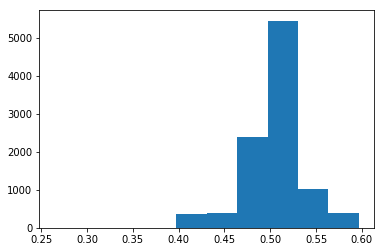

Discriminator on real samples: tensor(0.5045)
tensor(0.5045)


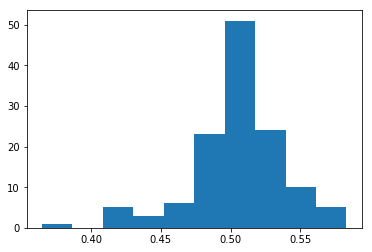

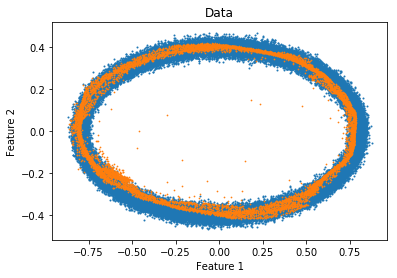

In [163]:
"""Plot generated samples from latent space"""

num_samples_to_generate = 10000

model.eval()

# seed = 42
# rng = np.random.RandomState(seed)
# Sample latent vectors
z = sample_latent_space(num_samples_to_generate)
z = torch.from_numpy(z).float()
x = model.generator(z)
y = model.discriminator(x)
print("Discriminator on fake samples:", torch.mean(y))
plt.hist(y.data.numpy())
plt.show()

y = model.discriminator(next(iter(train_loader))[0])
print("Discriminator on real samples:", torch.mean(y))
print(torch.mean(y))
plt.hist(y.data.numpy())
plt.show()

x = x.data.numpy()

# Plot data
plt.clf()
plt.scatter(data[:, 0], data[:, 1], s=1)
plt.scatter(x[:, 0], x[:, 1], s=.5)
plt.title("Data")
plt.xlabel("Feature 1")
plt.ylabel("Feature 2")
plt.show()


41042 6542


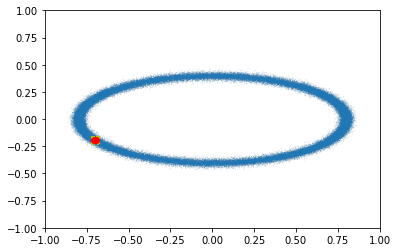

23192 78055


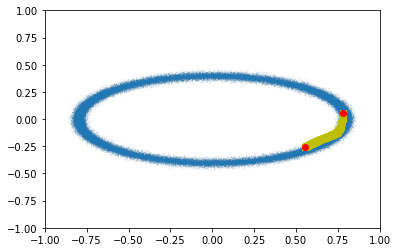

52971 14291


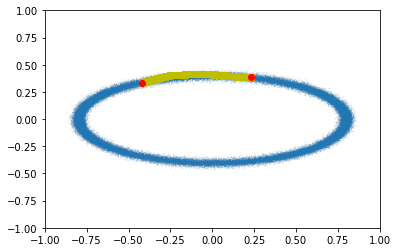

5706 62353


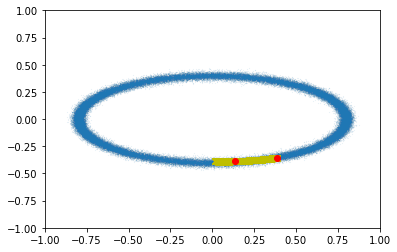

77106 11838


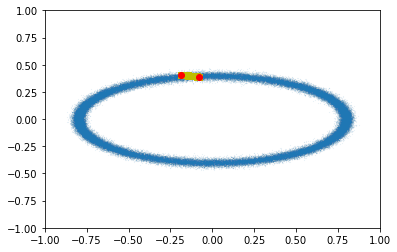

19651 36431


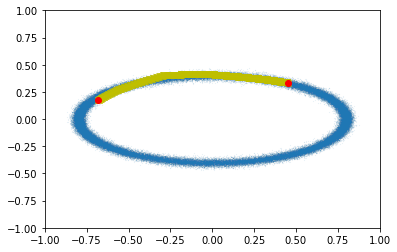

39853 35651


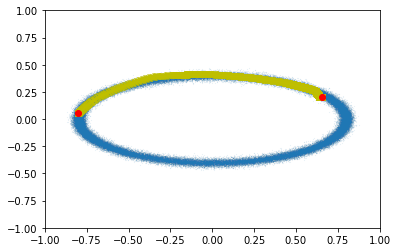

99285 31689


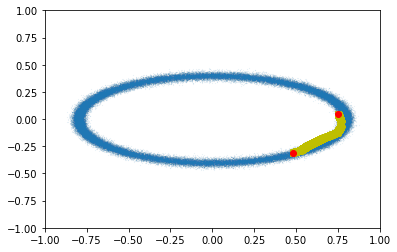

83871 72355


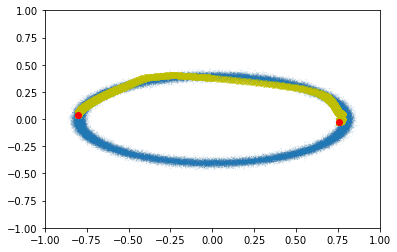

18970 67085


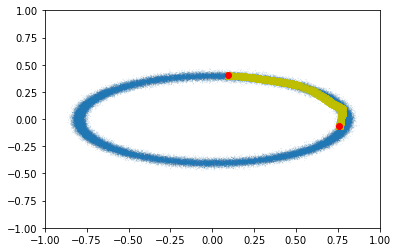

In [164]:
"""Interpolate between data points"""

model.eval()
for i in range(10):
    # seed = 46
    # rng = np.random.RandomState(seed)
    idx1, idx2 = rng.choice(np.arange(num_samples), size=2, replace=False)
    print(idx1, idx2)
    z = sample_latent_space_torch(2)
    w = Variable(torch.linspace(0, 1, 1000))
    z = z[0, ...] + (z[1, ...] - z[0, ...]) * w[:, None]
    x = model.generator(z)

    x = x.data.numpy()
    x1 = x[0, ...]
    x2 = x[-1, ...]

    plt.figure()
    plt.scatter(data[:, 0], data[:, 1], s=0.001)
    plt.plot(x[:, 0], x[:, 1], 'xy')
#     plt.plot(data[[idx1, idx2], 0], data[[idx1, idx2], 1], 'x')
    plt.plot([x1[0], x2[0]], [x1[1], x2[1]], 'or')
    plt.xlim([-1, 1])
    plt.ylim([-1, 1])
    plt.show()
